# MSSDS 434 FX_RL Learning Project

### Project overview
#### The application will follow this trajectory:
- User uses front end (VueJS or React) to select trading pair and set certain model criteria.
- Front end tells flask backend what the model parameters will be based on user selection.
- Flask backend triggers a callout to a Financial Data API (Quandl, IEX, IBKR, Yahoo, Google)
- Data is loaded into your classes to train a model based on the user inputs in step 1.
- The model trains on each hour up to the penultimate hour (h - 1), when it is then tested on on the last hour of data. 
- Results are fed back into Flask and through to the front end to display results.
- The user is given the option of productionalizing the model with the connected trading account using the current incoming data from whichever real-time financial data api has been chosen.
- The results of the productionalized model are published in real time.

#### Things that must be configurable via REST API
- Currency Pair
- Which side of the currency pair (right,left)
- Amount of hist data to train on: (1d,5d,1mo,3mo,6mo,1y,2y,5y,10y,ytd,max)
   - Window Size must infer this same value
- Price prediction in time interval window
- Return buy or sell command



### Imports

In [6]:
import gym
import gym_anytrading
import yfinance as yf
import pandas as pd
import os
import datetime
import matplotlib.pyplot as plt

In [7]:
#set alphavantage api-key
os.environ['ALPHAVANTAGE_API_KEY'] = '95O0QW8Y4UM8U9WA'
os.environ['WINDOW_SIZE'] = "15"
os.environ['HISTORICAL_PERIOD'] = "7d"
os.environ['HISTORICAL_INTERVAL'] = "1m"

In [8]:
curr_pairs = {
"EUR/USD":"EURUSD=X",
"USD/JPY":"JPY=X",
"GBP/USD":"GBPUSD=X",
"AUD/USD":"AUDUSD=X",
"NZD/USD":"NZDUSD=X",
"EUR/JPY":"EURJPY=X",
"GBP/JPY":"GBPJPY=X",
"EUR/GBP":"EURGBP=X",
"EUR/CAD":"EURCAD=X",
"EUR/SEK":"EURSEK=X",
"EUR/CHF":"EURCHF=X",
"EUR/HUF":"EURHUF=X",
"EUR/JPY":"EURJPY=X",
"USD/CNY":"CNY=X",
"USD/HKD":"HKD=X",
"USD/SGD":"SGD=X",
"USD/INR":"INR=X",
"USD/MXN":"MXN=X",
"USD/PHP":"PHP=X",
"USD/IDR":"IDR=X",
"USD/THB":"THB=X",
"USD/MYR":"MYR=X",
"USD/ZAR":"ZAR=X",
"USD/RUB":"RUB=X"
}

curr_list = list()
for key in curr_pairs:
    curr_list.append(key)
    

In [9]:
# yfinance:
curr = yf.Ticker("EURUSD=X")
# This will be a configurable call in custom function
df = curr.history(period="7d", interval="1m")
df = df[["Open","High","Low","Close"]]
df.index.rename('Time', inplace=True)
df.reset_index(inplace=True)
df['Time'] = df['Time'].dt.tz_localize(None)
df.set_index('Time', inplace=True)
# print("df.shape", df.shape)
# print("\nhead")
# print(df.head(10))
# print("\ntail")
# print(df.tail(10))
# print("\ndf start Time: {}".format(str(min(df.index))))
# print("\ndf end Time: {}".format(str(max(df.index))))

In [53]:
start_window = 1
end_window = 1000
results_dict = dict()

x = 1
env = gym.make('forex-v0',
                 df = df,
                 window_size = x,
                 frame_bound = (x, df.shape[0]),
                 unit_side = 'right'
        )

#     print("custom env information:")
#     print("> shape:", custom_env.shape)
#     print("> df.shape:", custom_env.df.shape)
#     print("> prices.shape:", custom_env.prices.shape)
#     print("> signal_features.shape:", custom_env.signal_features.shape)
#     print("> max_possible_profit:", custom_env.max_possible_profit())

results_dict[x] = env.max_possible_profit()
results_dict

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


{1: 0.9207753737591067}

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


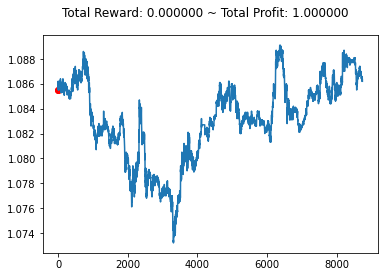

{'total_reward': 0.0, 'total_profit': 0.9997236805747445, 'position': 1}


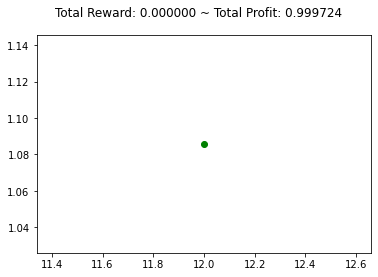

{'total_reward': 0.0, 'total_profit': 0.9994474375019136, 'position': 1}


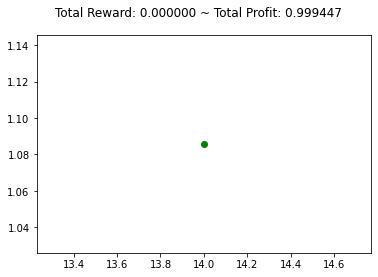

{'total_reward': -2.000000000002, 'total_profit': 0.9991712198775464, 'position': 1}


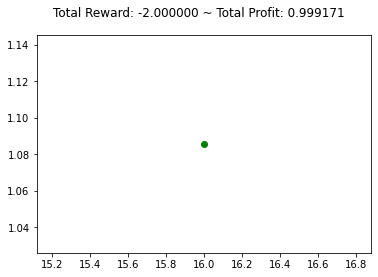

{'total_reward': 0.0, 'total_profit': 0.9991712198775464, 'position': 0}


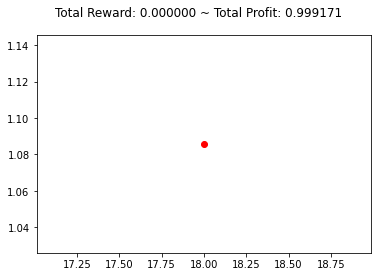

{'total_reward': 0.0, 'total_profit': 0.998895129460338, 'position': 0}


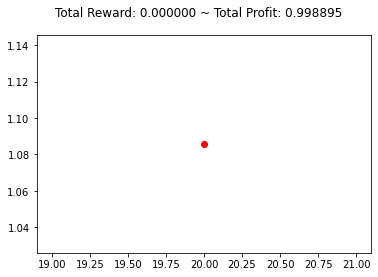

{'total_reward': 0.0, 'total_profit': 0.9986191153322749, 'position': 0}


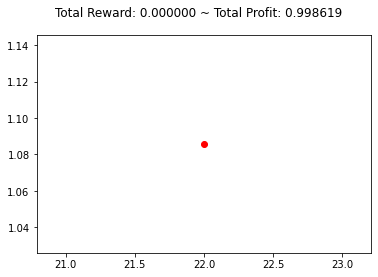

{'total_reward': -0.9999999999998899, 'total_profit': 0.9982512320700416, 'position': 1}


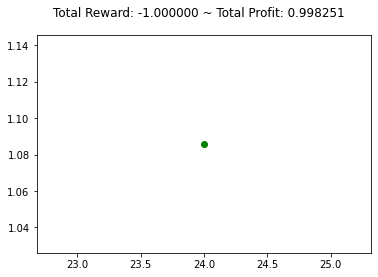

{'total_reward': -6.999999999999229, 'total_profit': 0.9975160074469005, 'position': 1}


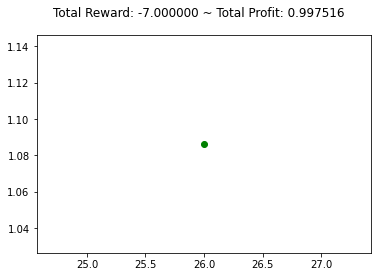

{'total_reward': -10.999999999998789, 'total_profit': 0.9972403997822901, 'position': 1}


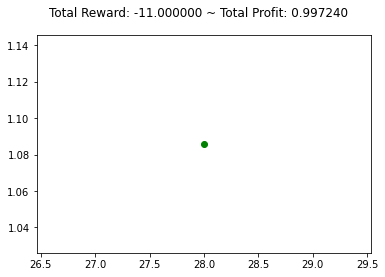

{'total_reward': -10.999999999998789, 'total_profit': 0.9972403997822901, 'position': 1}


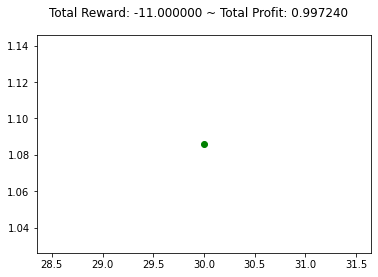

{'total_reward': -10.999999999998789, 'total_profit': 0.9972403997822901, 'position': 0}


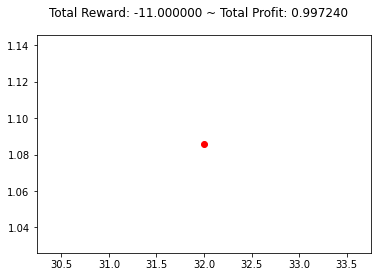

{'total_reward': -9.999999999998899, 'total_profit': 0.9969648682664172, 'position': 0}


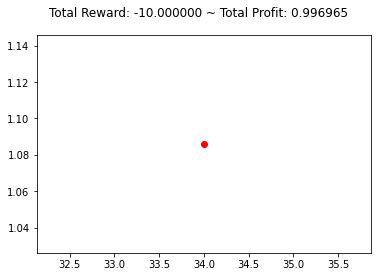

{'total_reward': -8.999999999999009, 'total_profit': 0.9967812313409675, 'position': 1}


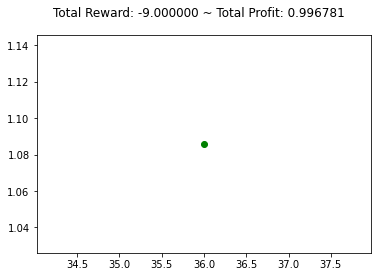

{'total_reward': -6.999999999999229, 'total_profit': 0.9965976282407022, 'position': 1}


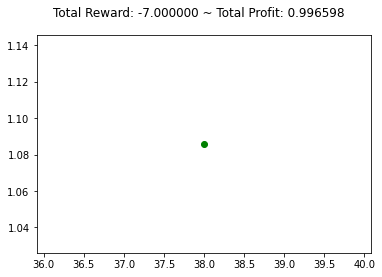

{'total_reward': -6.999999999999229, 'total_profit': 0.9965976282407022, 'position': 1}


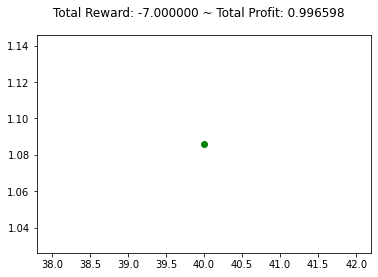

{'total_reward': -5.999999999999339, 'total_profit': 0.9965976282407022, 'position': 0}


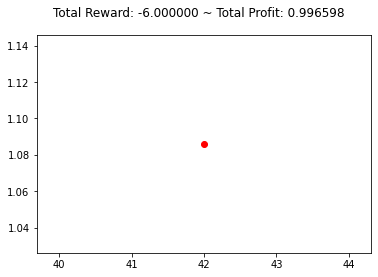

{'total_reward': -5.999999999999339, 'total_profit': 0.9963222996759428, 'position': 1}


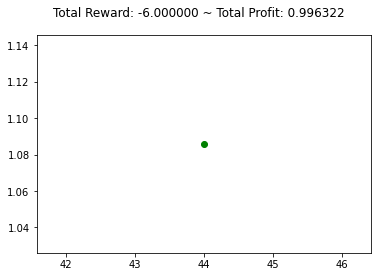

{'total_reward': -5.999999999999339, 'total_profit': 0.9963222996759428, 'position': 1}


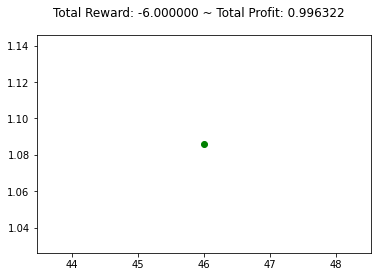

{'total_reward': -5.999999999999339, 'total_profit': 0.9960470471758022, 'position': 1}


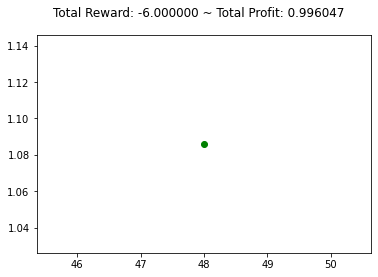

{'total_reward': -4.999999999999449, 'total_profit': 0.9960470471758022, 'position': 0}


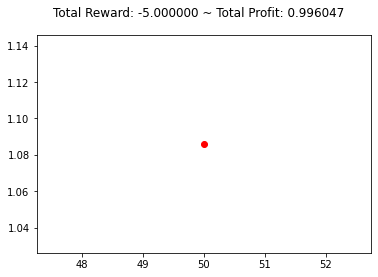

{'total_reward': -3.9999999999995595, 'total_profit': 0.9958635962047779, 'position': 1}


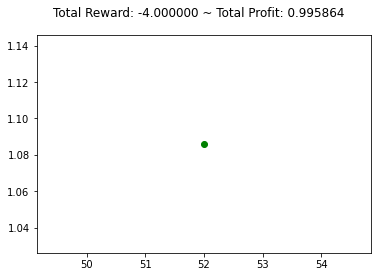

{'total_reward': -3.9999999999995595, 'total_profit': 0.9958635962047779, 'position': 1}


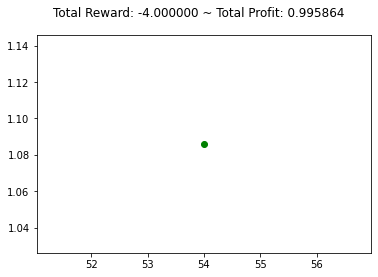

{'total_reward': -0.9999999999998899, 'total_profit': 0.9958635962047779, 'position': 0}


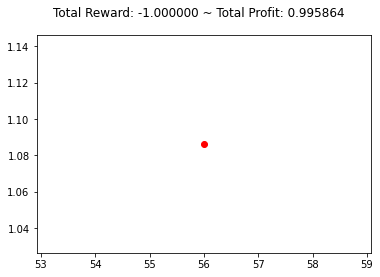

{'total_reward': 2.9999999999996696, 'total_profit': 0.9959553132425569, 'position': 1}


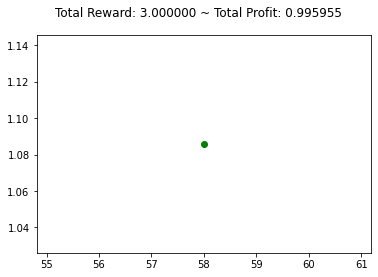

{'total_reward': 3.9999999999995595, 'total_profit': 0.9959553132425569, 'position': 0}


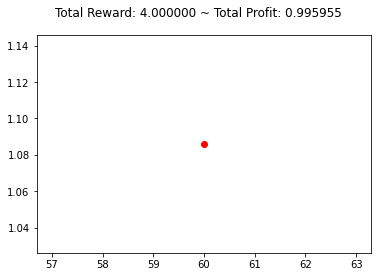

{'total_reward': 2.9999999999996696, 'total_profit': 0.9955884788730385, 'position': 1}


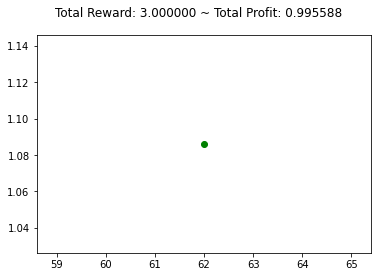

{'total_reward': 4.999999999999449, 'total_profit': 0.9955884788730385, 'position': 0}


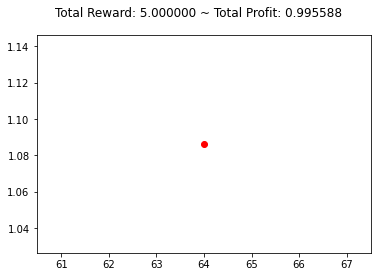

{'total_reward': 4.999999999999449, 'total_profit': 0.9953135050711035, 'position': 1}


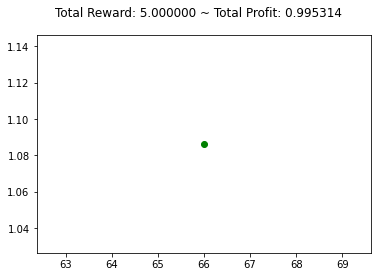

{'total_reward': 4.999999999999449, 'total_profit': 0.9953135050711035, 'position': 0}


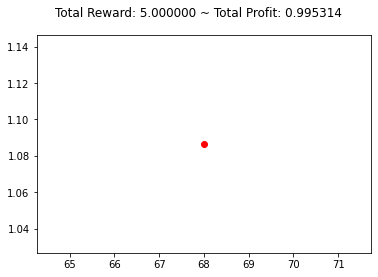

{'total_reward': 4.999999999999449, 'total_profit': 0.9953135050711035, 'position': 0}


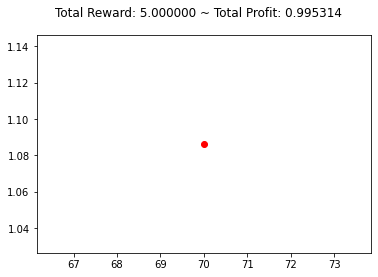

{'total_reward': 4.999999999999449, 'total_profit': 0.995038607214796, 'position': 1}


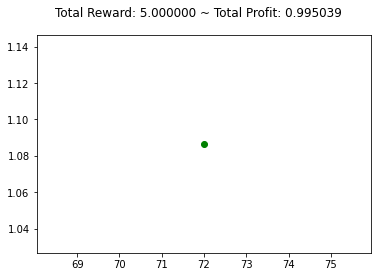

{'total_reward': 4.999999999999449, 'total_profit': 0.9947637852831404, 'position': 1}


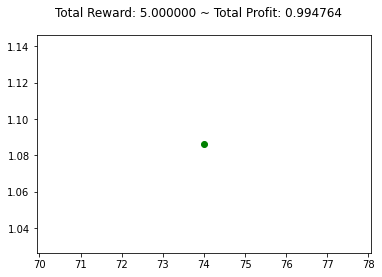

{'total_reward': 4.999999999999449, 'total_profit': 0.9944890392551667, 'position': 1}


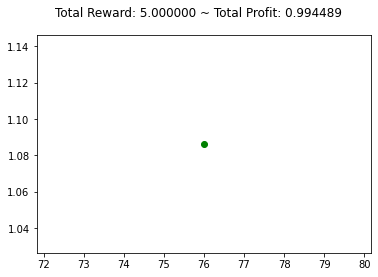

{'total_reward': 4.999999999999449, 'total_profit': 0.9944890392551667, 'position': 1}


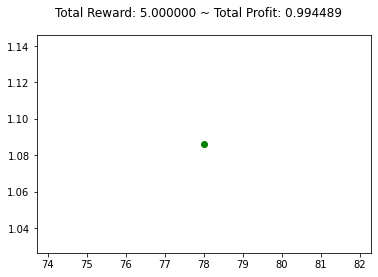

{'total_reward': 4.999999999999449, 'total_profit': 0.9944890392551667, 'position': 1}


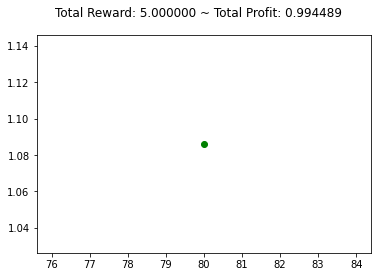

{'total_reward': 2.9999999999996696, 'total_profit': 0.9943058583674793, 'position': 1}


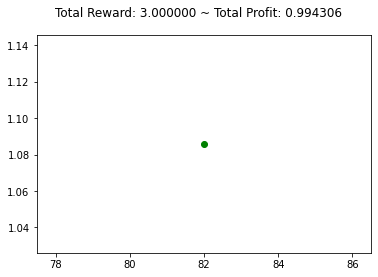

{'total_reward': 3.9999999999995595, 'total_profit': 0.9943058583674793, 'position': 0}


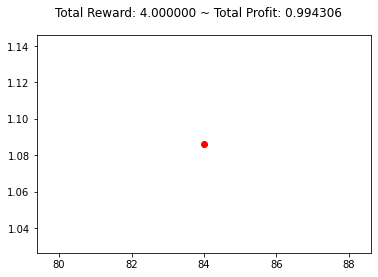

{'total_reward': 4.999999999999449, 'total_profit': 0.9941227112209758, 'position': 1}


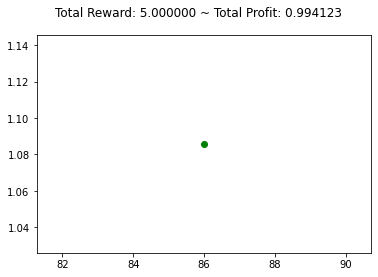

{'total_reward': 3.9999999999995595, 'total_profit': 0.9941227112209758, 'position': 0}


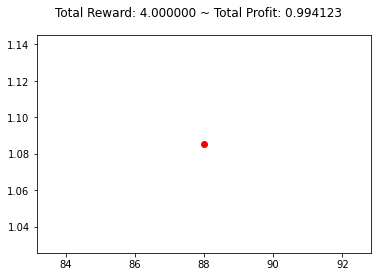

{'total_reward': 8.00000000000134, 'total_profit': 0.9942143101071108, 'position': 0}


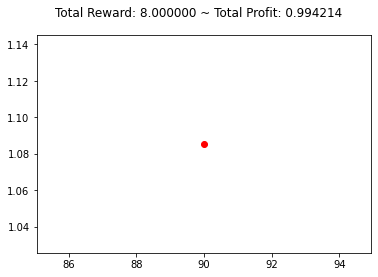

{'total_reward': 7.0000000000014495, 'total_profit': 0.9938479145625717, 'position': 1}


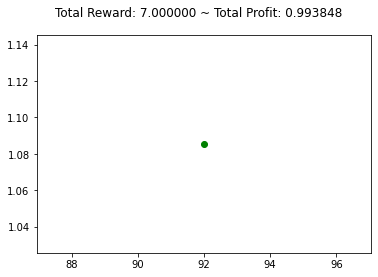

{'total_reward': 7.0000000000014495, 'total_profit': 0.9938479145625717, 'position': 1}


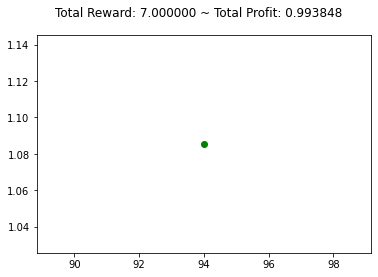

{'total_reward': 9.00000000000123, 'total_profit': 0.9936647843037617, 'position': 1}


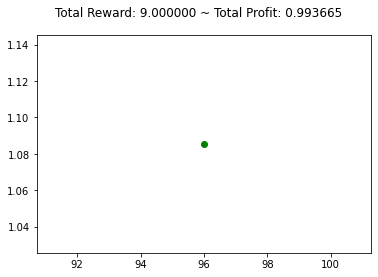

{'total_reward': 8.00000000000134, 'total_profit': 0.9936647843037617, 'position': 0}


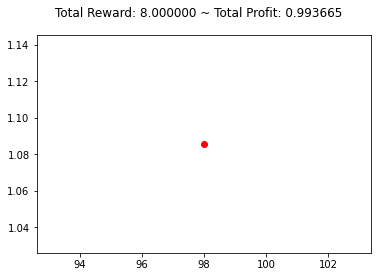

{'total_reward': 8.00000000000134, 'total_profit': 0.9932985912747204, 'position': 0}


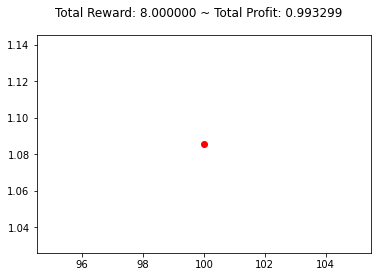

{'total_reward': 10.000000000001119, 'total_profit': 0.9932070683233454, 'position': 1}


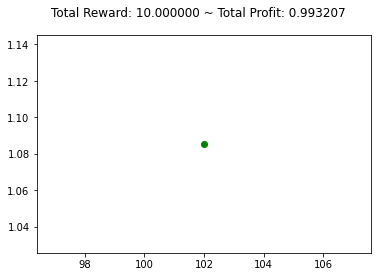

{'total_reward': 10.000000000001119, 'total_profit': 0.9929325247681101, 'position': 1}


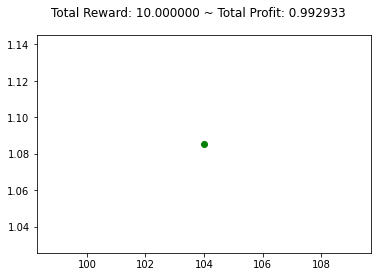

{'total_reward': 11.000000000001009, 'total_profit': 0.9926580823897884, 'position': 1}


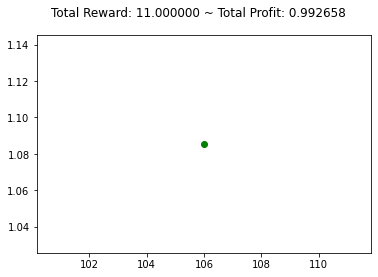

{'total_reward': 12.000000000000899, 'total_profit': 0.9926580823897884, 'position': 0}


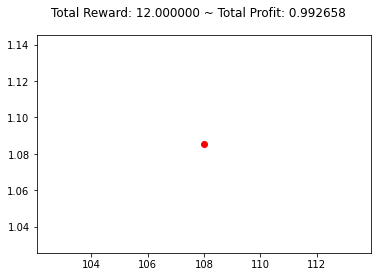

{'total_reward': 14.000000000000679, 'total_profit': 0.9925666184551721, 'position': 1}


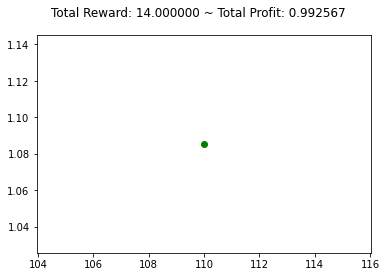

{'total_reward': 14.000000000000679, 'total_profit': 0.9925666184551721, 'position': 0}


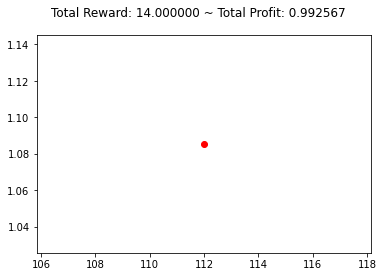

{'total_reward': 14.000000000000679, 'total_profit': 0.9922008301306999, 'position': 0}


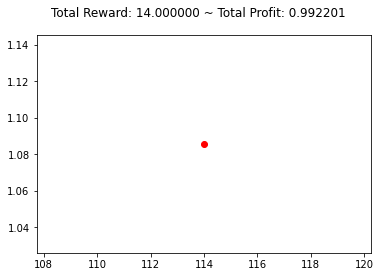

{'total_reward': 10.999999999998789, 'total_profit': 0.9916525519044348, 'position': 1}


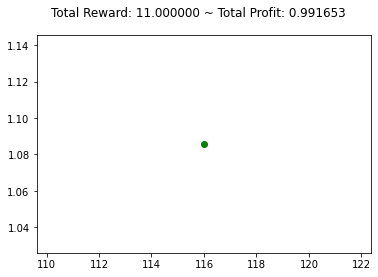

{'total_reward': 10.999999999998789, 'total_profit': 0.9916525519044348, 'position': 0}


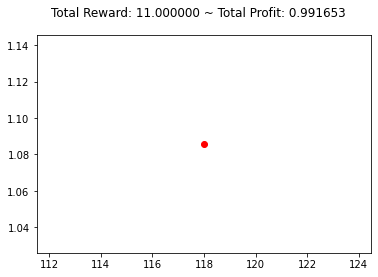

{'total_reward': 11.999999999998678, 'total_profit': 0.9914698766623046, 'position': 1}


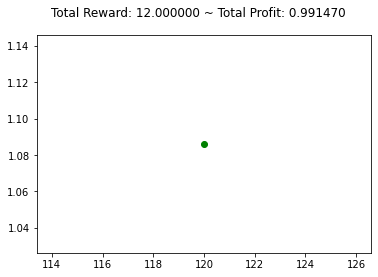

{'total_reward': 14.999999999998348, 'total_profit': 0.9911959899560443, 'position': 1}


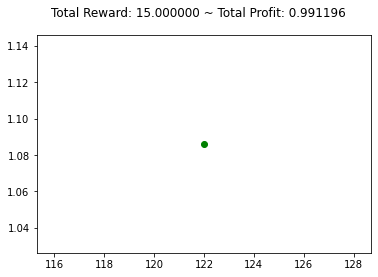

{'total_reward': 14.999999999998348, 'total_profit': 0.9911959899560443, 'position': 1}


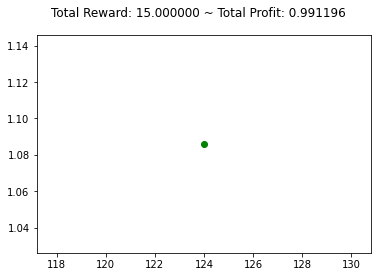

{'total_reward': 14.999999999998348, 'total_profit': 0.9911959899560443, 'position': 1}


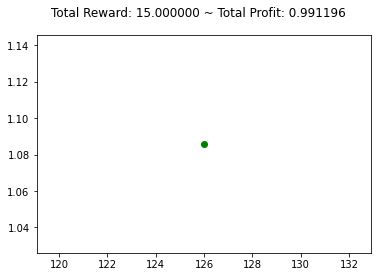

{'total_reward': 13.999999999998458, 'total_profit': 0.9911959899560443, 'position': 0}


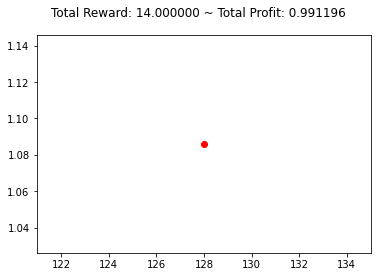

{'total_reward': 13.999999999998458, 'total_profit': 0.9909221536939696, 'position': 0}


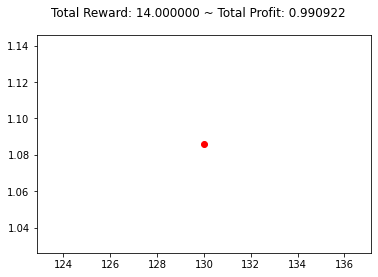

{'total_reward': 13.999999999998458, 'total_profit': 0.9909221536939696, 'position': 0}


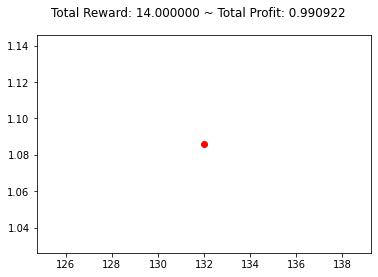

{'total_reward': 13.999999999998458, 'total_profit': 0.9906483930842375, 'position': 1}


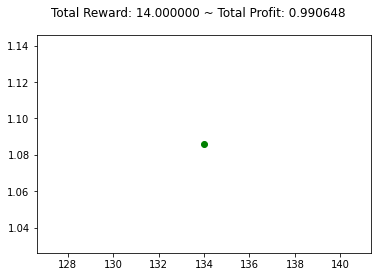

{'total_reward': 13.999999999998458, 'total_profit': 0.9906483930842375, 'position': 1}


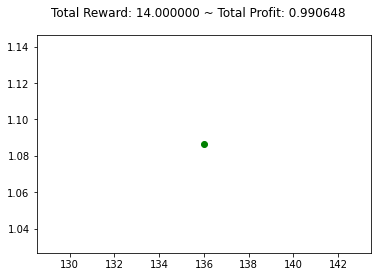

{'total_reward': 16.999999999998128, 'total_profit': 0.9906483930842375, 'position': 0}


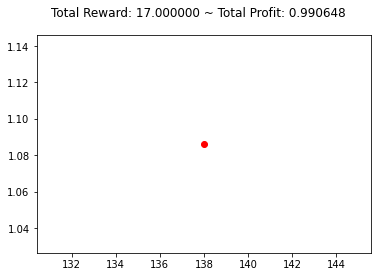

{'total_reward': 14.999999999998348, 'total_profit': 0.9901924613863894, 'position': 1}


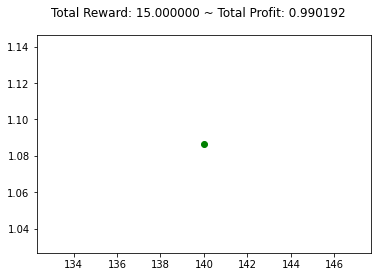

{'total_reward': 14.999999999998348, 'total_profit': 0.9901924613863894, 'position': 1}


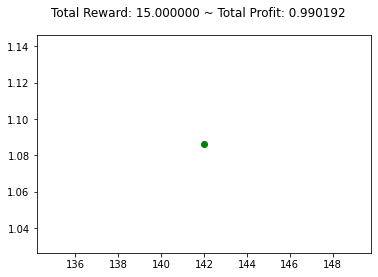

{'total_reward': 14.999999999998348, 'total_profit': 0.9901924613863894, 'position': 1}


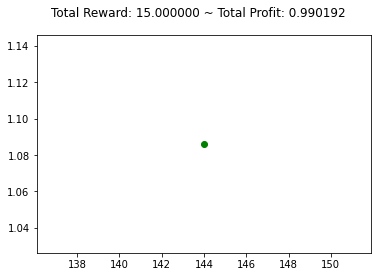

{'total_reward': 10.999999999998789, 'total_profit': 0.9901924613863894, 'position': 0}


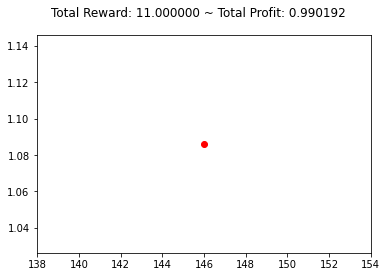

{'total_reward': 11.999999999998678, 'total_profit': 0.9900100887072503, 'position': 1}


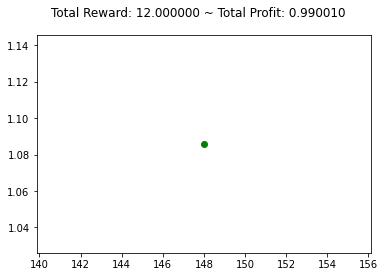

{'total_reward': 9.999999999998899, 'total_profit': 0.9900100887072503, 'position': 0}


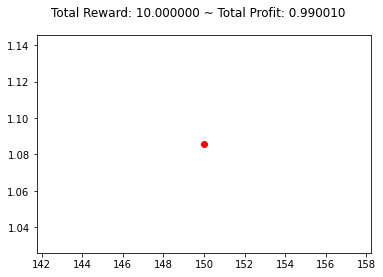

{'total_reward': 1.9999999999975593, 'total_profit': 0.989463121807412, 'position': 0}


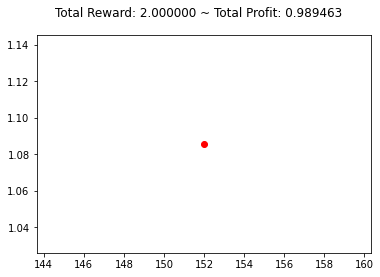

{'total_reward': 1.9999999999975593, 'total_profit': 0.989463121807412, 'position': 0}


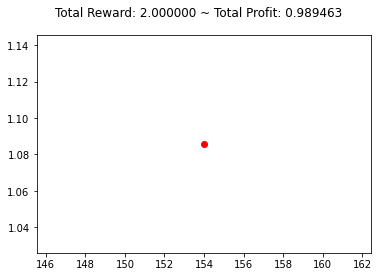

{'total_reward': -4.440892098500626e-12, 'total_profit': 0.9890074420055295, 'position': 0}


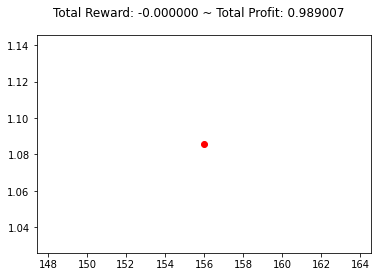

{'total_reward': -4.440892098500626e-12, 'total_profit': 0.988734160037581, 'position': 0}


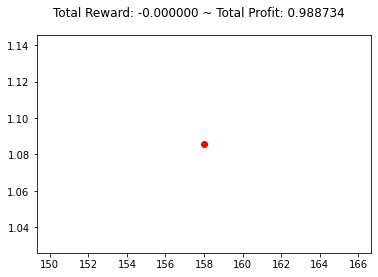

{'total_reward': 1.9999999999975593, 'total_profit': 0.9886430744401571, 'position': 0}


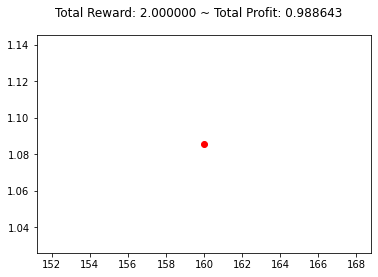

{'total_reward': 1.9999999999975593, 'total_profit': 0.9883698428212424, 'position': 0}


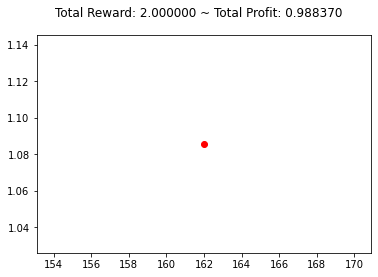

{'total_reward': -4.440892098500626e-12, 'total_profit': 0.9879146665097284, 'position': 0}


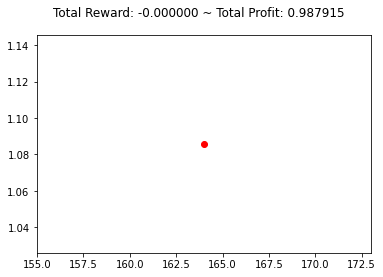

{'total_reward': 0.9999999999976694, 'total_profit': 0.9879146665097286, 'position': 0}


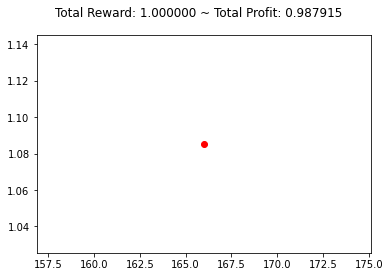

{'total_reward': 0.9999999999976694, 'total_profit': 0.9879146665097286, 'position': 0}


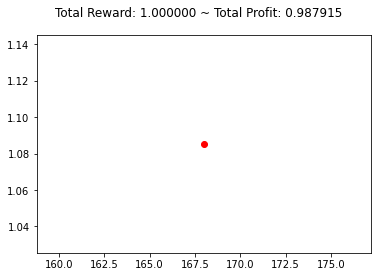

{'total_reward': -2.220446049250313e-12, 'total_profit': 0.9874595740707616, 'position': 0}


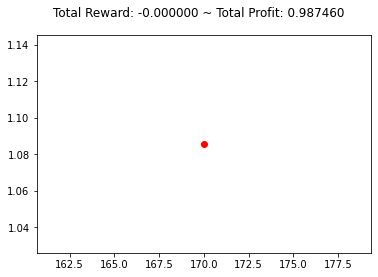

{'total_reward': 0.9999999999976694, 'total_profit': 0.9872776209522668, 'position': 1}


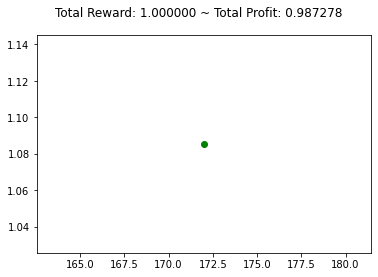

{'total_reward': 0.9999999999976694, 'total_profit': 0.9872776209522668, 'position': 1}


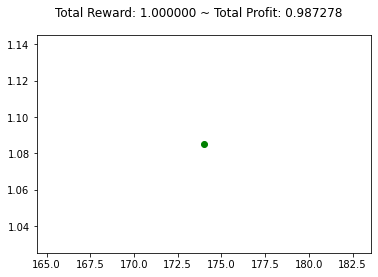

{'total_reward': 0.9999999999976694, 'total_profit': 0.9872776209522668, 'position': 1}


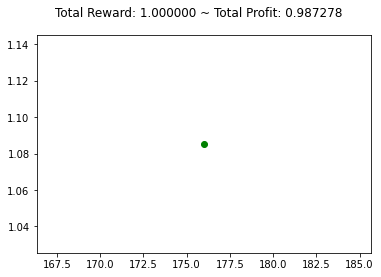

{'total_reward': -2.000000000002, 'total_profit': 0.9872776209522668, 'position': 0}


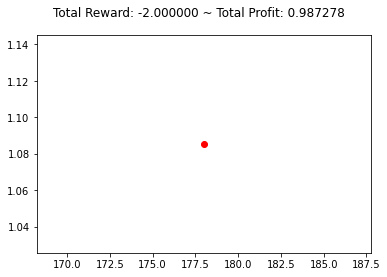

{'total_reward': -2.000000000002, 'total_profit': 0.9872776209522668, 'position': 0}


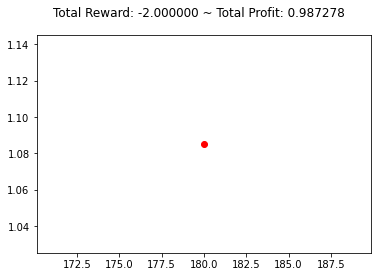

{'total_reward': -4.00000000000178, 'total_profit': 0.9868227800691228, 'position': 1}


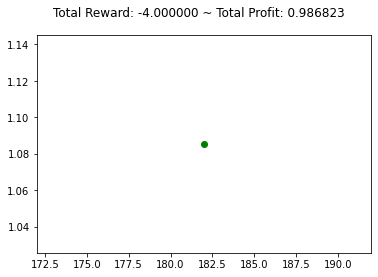

{'total_reward': -3.00000000000189, 'total_profit': 0.9868227800691228, 'position': 0}


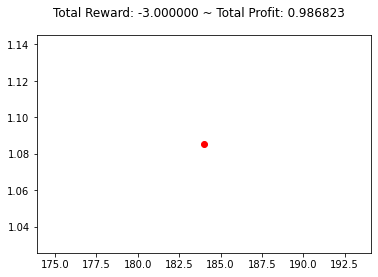

{'total_reward': -4.00000000000178, 'total_profit': 0.9864591420110597, 'position': 1}


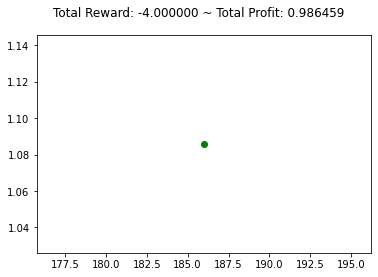

{'total_reward': 0.0, 'total_profit': 0.9861866143910181, 'position': 1}


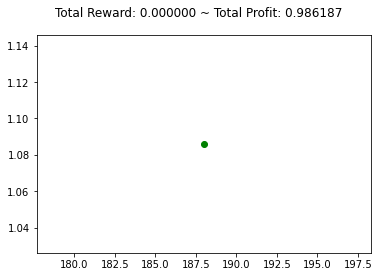

{'total_reward': -4.00000000000178, 'total_profit': 0.9861866143910181, 'position': 0}


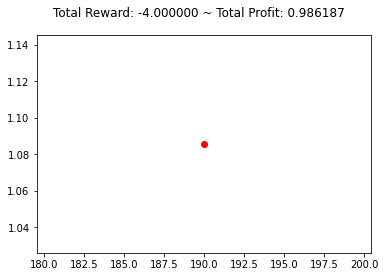

{'total_reward': -6.00000000000378, 'total_profit': 0.985732443526879, 'position': 1}


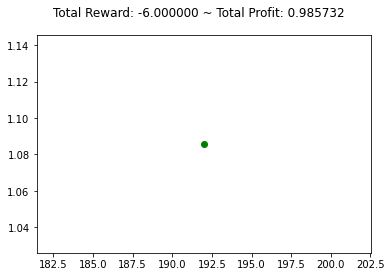

{'total_reward': -3.0000000000041105, 'total_profit': 0.985732443526879, 'position': 0}


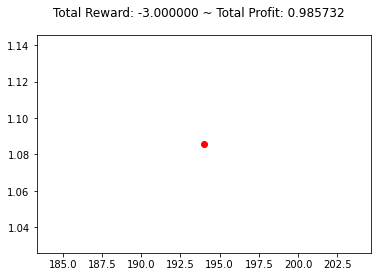

{'total_reward': -2.0000000000042206, 'total_profit': 0.9855508922894674, 'position': 1}


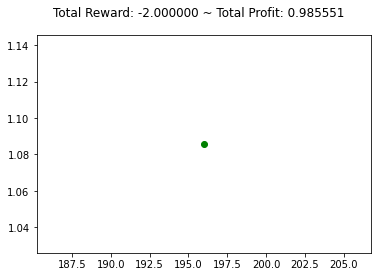

{'total_reward': -2.0000000000042206, 'total_profit': 0.9855508922894674, 'position': 1}


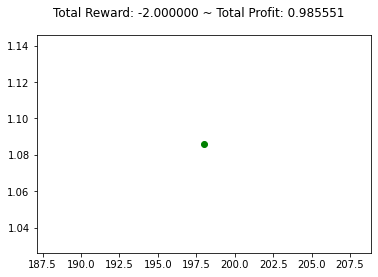

{'total_reward': -5.00000000000389, 'total_profit': 0.9851878232556528, 'position': 1}


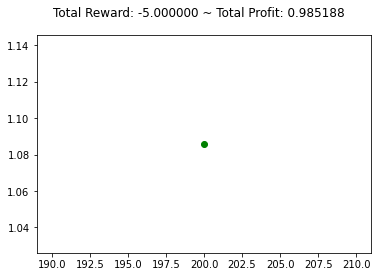

{'total_reward': -6.00000000000378, 'total_profit': 0.9851878232556528, 'position': 0}


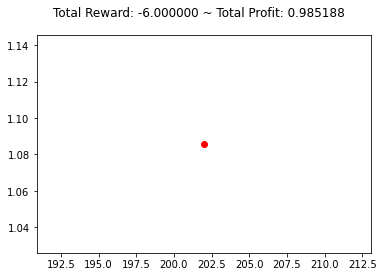

{'total_reward': -6.00000000000378, 'total_profit': 0.9851878232556528, 'position': 0}


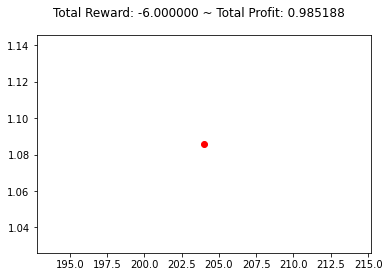

{'total_reward': -7.00000000000367, 'total_profit': 0.9848248879735545, 'position': 1}


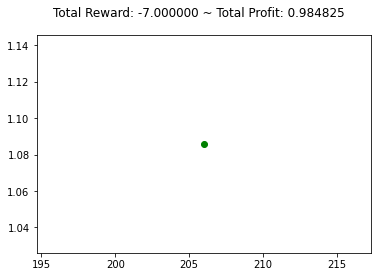

{'total_reward': -8.00000000000356, 'total_profit': 0.9848248879735545, 'position': 0}


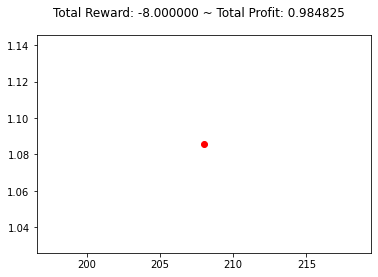

{'total_reward': -8.00000000000356, 'total_profit': 0.9845527617265323, 'position': 1}


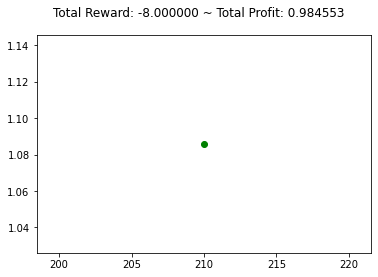

{'total_reward': -7.00000000000367, 'total_profit': 0.9845527617265323, 'position': 0}


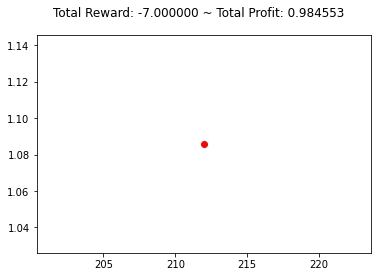

{'total_reward': -12.00000000000312, 'total_profit': 0.9840994685581499, 'position': 0}


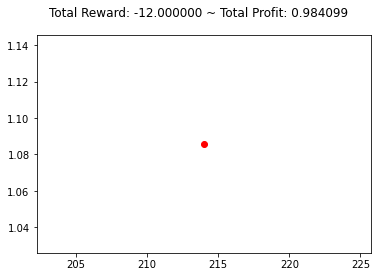

{'total_reward': -12.00000000000312, 'total_profit': 0.9838275427586036, 'position': 0}


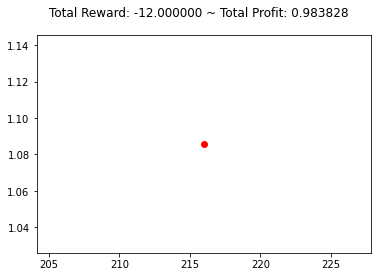

{'total_reward': -12.00000000000312, 'total_profit': 0.983555692097438, 'position': 1}


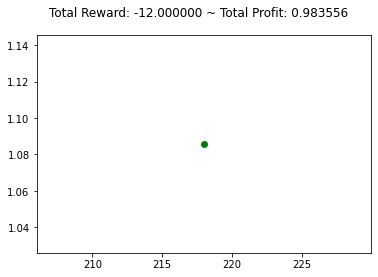

{'total_reward': -12.00000000000312, 'total_profit': 0.983555692097438, 'position': 0}


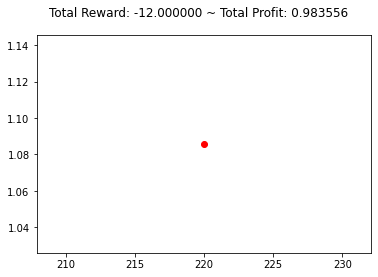

{'total_reward': -12.00000000000312, 'total_profit': 0.983555692097438, 'position': 0}


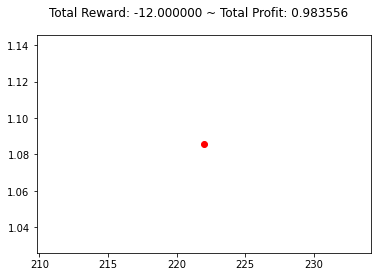

{'total_reward': -11.00000000000323, 'total_profit': 0.9831933580793509, 'position': 0}


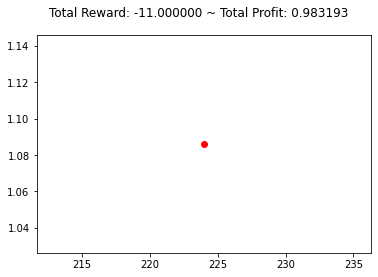

{'total_reward': -12.00000000000312, 'total_profit': 0.9830122744882138, 'position': 0}


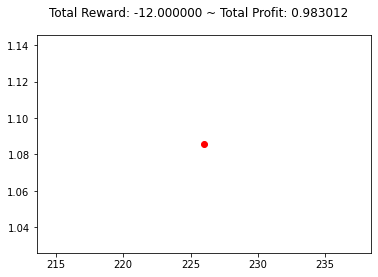

{'total_reward': -12.00000000000312, 'total_profit': 0.9827406491015082, 'position': 1}


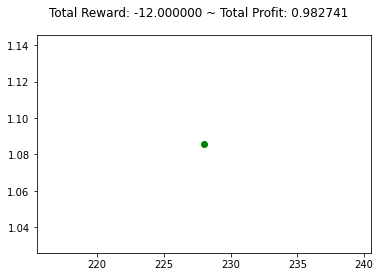

{'total_reward': -11.00000000000323, 'total_profit': 0.9827406491015082, 'position': 0}


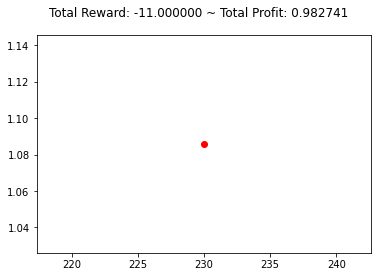

{'total_reward': -10.00000000000334, 'total_profit': 0.9825596155472848, 'position': 1}


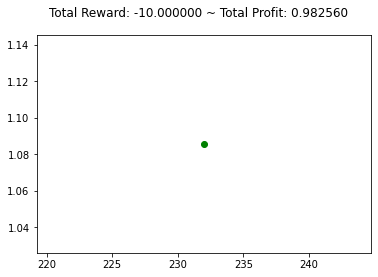

{'total_reward': -10.00000000000334, 'total_profit': 0.9825596155472848, 'position': 1}


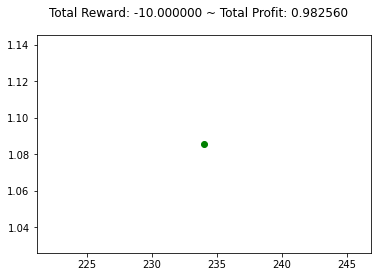

{'total_reward': -12.00000000000534, 'total_profit': 0.9825596155472848, 'position': 0}


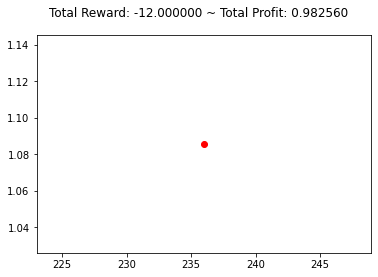

{'total_reward': -8.00000000000356, 'total_profit': 0.9823785653140902, 'position': 0}


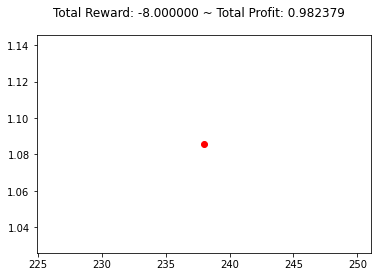

{'total_reward': -8.00000000000356, 'total_profit': 0.9821071150335392, 'position': 0}


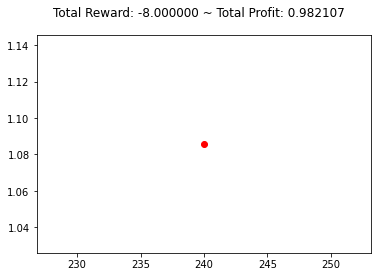

{'total_reward': -6.00000000000156, 'total_profit': 0.982016639942334, 'position': 1}


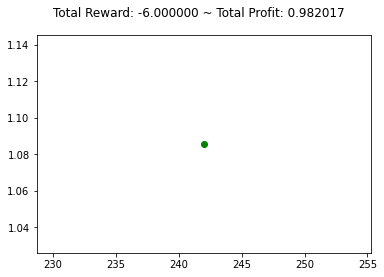

{'total_reward': -6.00000000000156, 'total_profit': 0.982016639942334, 'position': 0}


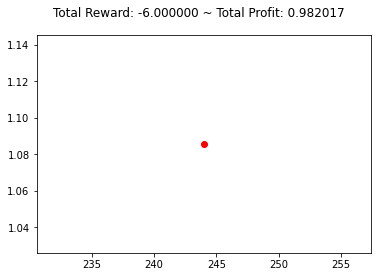

{'total_reward': -6.00000000000156, 'total_profit': 0.9817452396733495, 'position': 1}


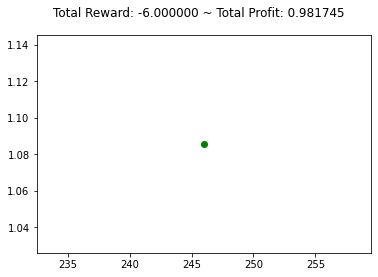

{'total_reward': -6.00000000000156, 'total_profit': 0.9817452396733495, 'position': 0}


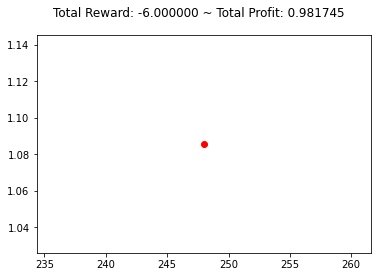

{'total_reward': -8.00000000000356, 'total_profit': 0.9812931142060595, 'position': 1}


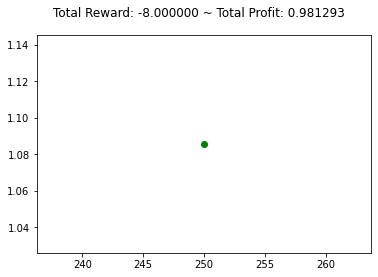

{'total_reward': -10.00000000000556, 'total_profit': 0.9812931142060595, 'position': 0}


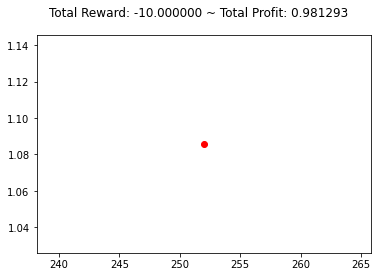

{'total_reward': -12.00000000000756, 'total_profit': 0.9808411969571847, 'position': 0}


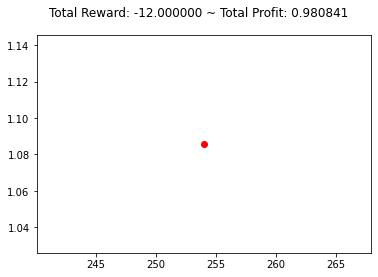

{'total_reward': -12.00000000000756, 'total_profit': 0.9808411969571847, 'position': 0}


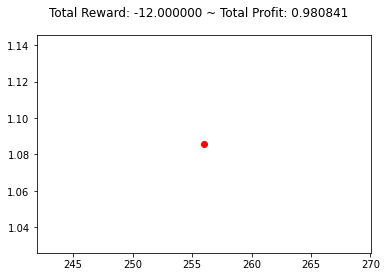

{'total_reward': -9.00000000000567, 'total_profit': 0.9808411969571849, 'position': 1}


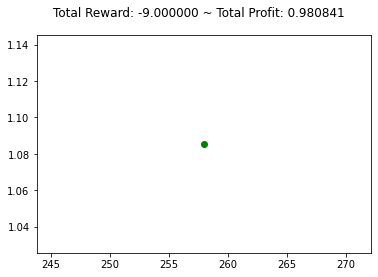

{'total_reward': -9.00000000000567, 'total_profit': 0.9808411969571849, 'position': 1}


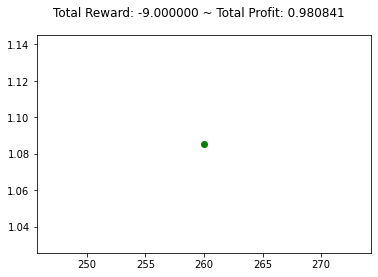

{'total_reward': -11.00000000000545, 'total_profit': 0.9808411969571849, 'position': 0}


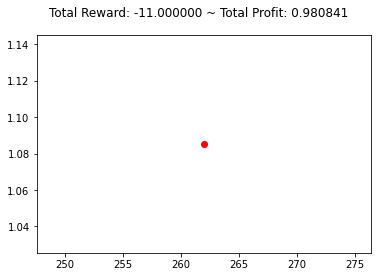

{'total_reward': -11.00000000000545, 'total_profit': 0.9805700466078602, 'position': 1}


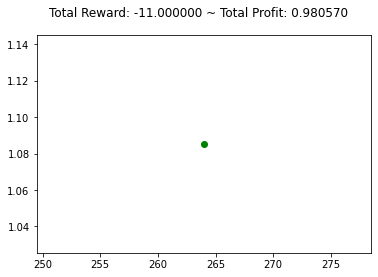

{'total_reward': -11.00000000000545, 'total_profit': 0.9805700466078602, 'position': 0}


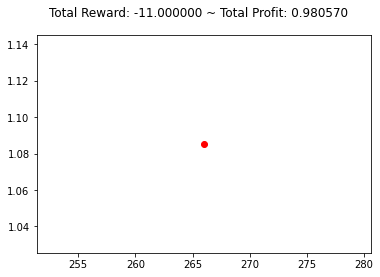

{'total_reward': -11.00000000000545, 'total_profit': 0.9805700466078602, 'position': 0}


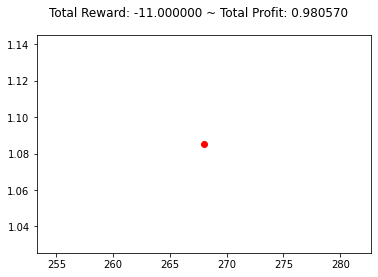

{'total_reward': -10.00000000000556, 'total_profit': 0.980298971217165, 'position': 0}


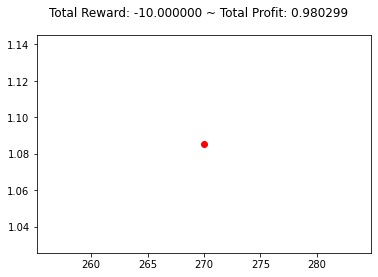

{'total_reward': -10.00000000000556, 'total_profit': 0.980298971217165, 'position': 0}


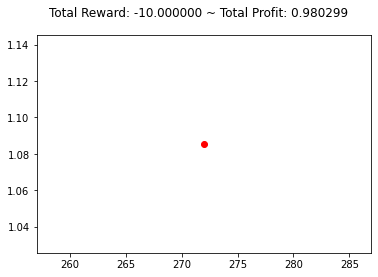

{'total_reward': -10.00000000000556, 'total_profit': 0.980298971217165, 'position': 0}


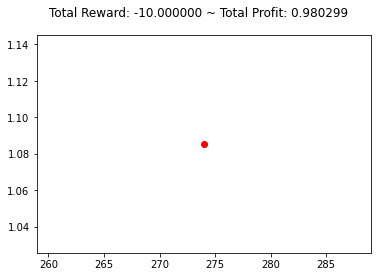

{'total_reward': -11.00000000000545, 'total_profit': 0.9799377038609031, 'position': 1}


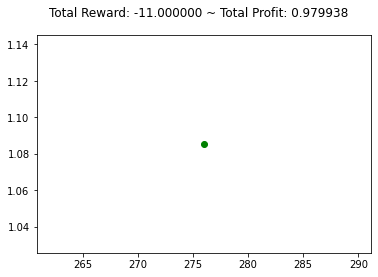

{'total_reward': -11.00000000000545, 'total_profit': 0.9799377038609031, 'position': 1}


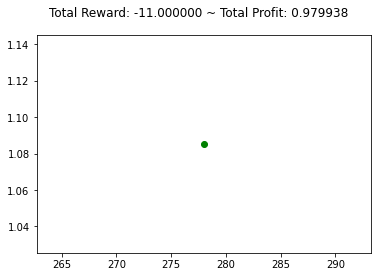

{'total_reward': -13.00000000000523, 'total_profit': 0.9799377038609031, 'position': 0}


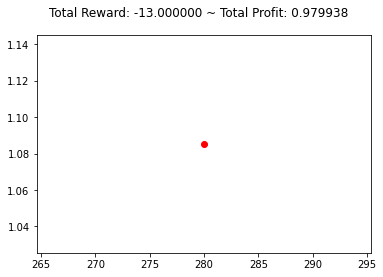

{'total_reward': -12.00000000000534, 'total_profit': 0.9796668032792976, 'position': 0}


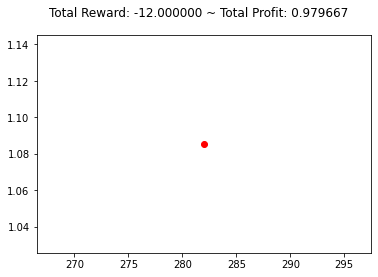

{'total_reward': -11.00000000000545, 'total_profit': 0.9794862528179487, 'position': 1}


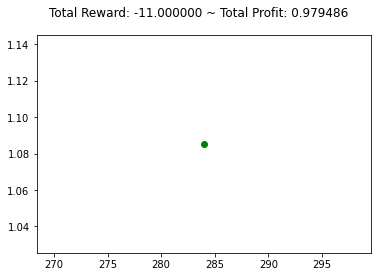

{'total_reward': -11.00000000000545, 'total_profit': 0.9792154770385113, 'position': 1}


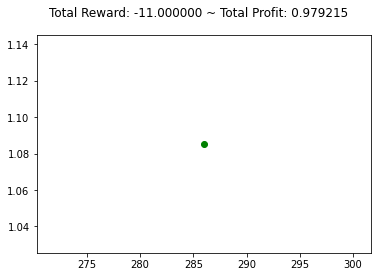

{'total_reward': -11.00000000000545, 'total_profit': 0.9792154770385113, 'position': 0}


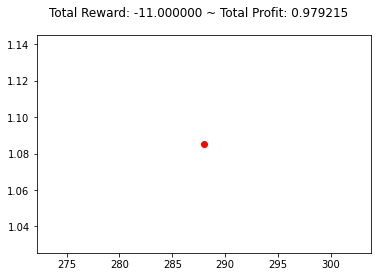

{'total_reward': -13.00000000000523, 'total_profit': 0.9788545757293661, 'position': 0}


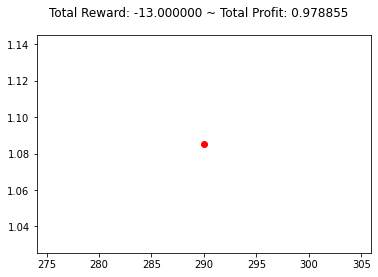

{'total_reward': -13.00000000000523, 'total_profit': 0.9785839745749993, 'position': 0}


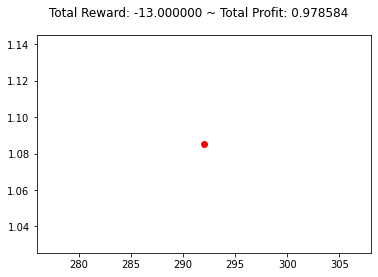

{'total_reward': -13.00000000000523, 'total_profit': 0.9785839745749993, 'position': 0}


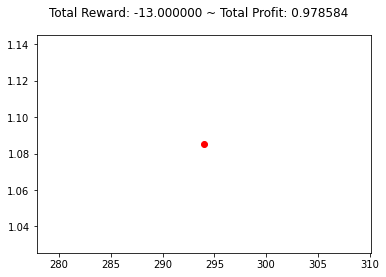

{'total_reward': -14.00000000000512, 'total_profit': 0.978223306013468, 'position': 0}


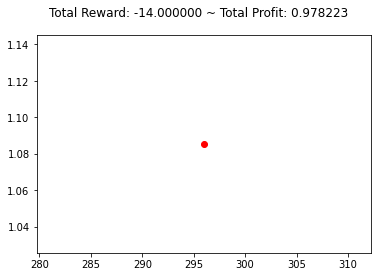

{'total_reward': -13.00000000000523, 'total_profit': 0.9780430215855259, 'position': 1}


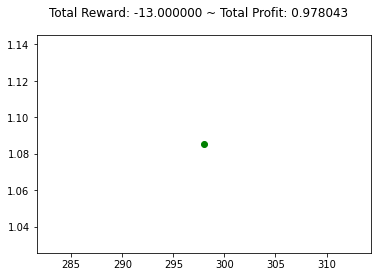

{'total_reward': -14.00000000000512, 'total_profit': 0.9776825523985414, 'position': 1}


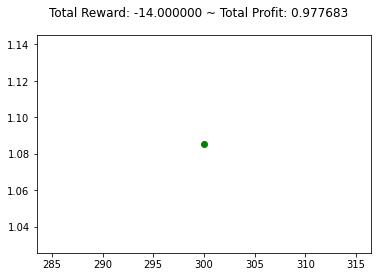

{'total_reward': -14.00000000000512, 'total_profit': 0.9776825523985414, 'position': 1}


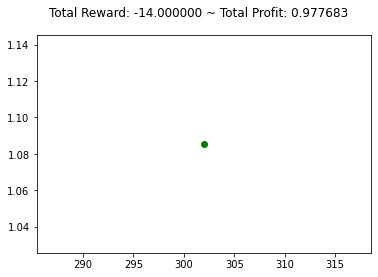

{'total_reward': -13.00000000000523, 'total_profit': 0.9776825523985414, 'position': 0}


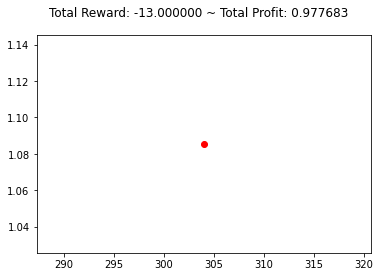

{'total_reward': -12.00000000000534, 'total_profit': 0.9775023842326152, 'position': 0}


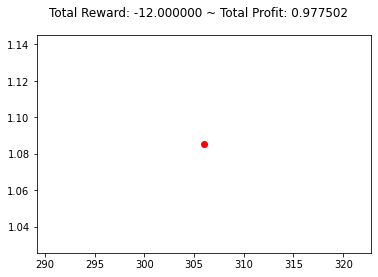

{'total_reward': -12.00000000000534, 'total_profit': 0.9772321817860384, 'position': 1}


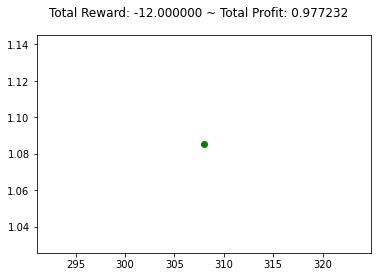

{'total_reward': -11.00000000000545, 'total_profit': 0.9772321817860384, 'position': 0}


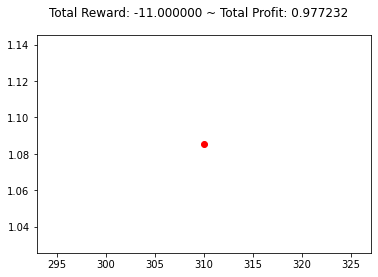

{'total_reward': -10.00000000000556, 'total_profit': 0.9769620789165564, 'position': 0}


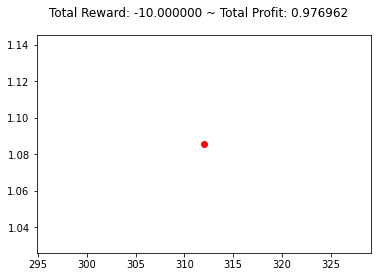

{'total_reward': -8.00000000000578, 'total_profit': 0.9768720612183239, 'position': 1}


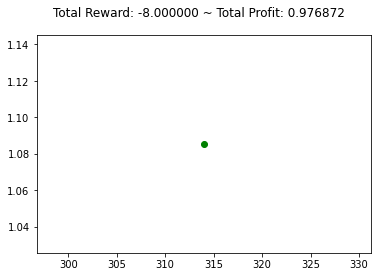

{'total_reward': -6.0000000000060005, 'total_profit': 0.9766920424103965, 'position': 1}


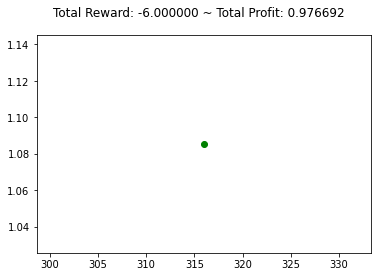

{'total_reward': -6.0000000000060005, 'total_profit': 0.9766920424103965, 'position': 0}


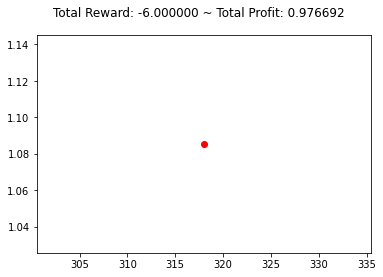

{'total_reward': -4.000000000006221, 'total_profit': 0.9766020330064329, 'position': 1}


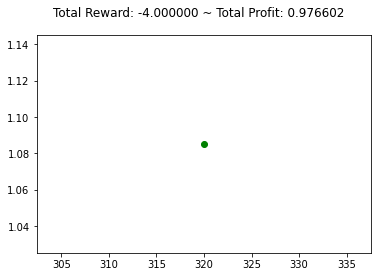

{'total_reward': -4.000000000006221, 'total_profit': 0.9766020330064329, 'position': 0}


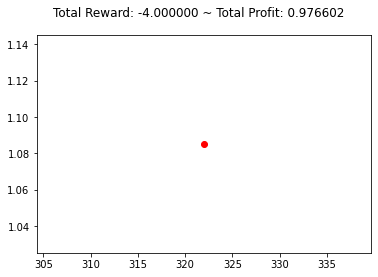

{'total_reward': 0.9999999999932285, 'total_profit': 0.9766020330064329, 'position': 0}


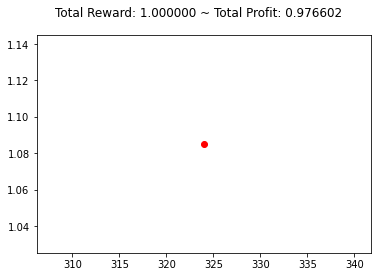

{'total_reward': 0.9999999999932285, 'total_profit': 0.9766020330064329, 'position': 0}


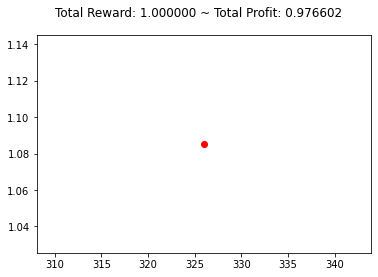

{'total_reward': 0.9999999999932285, 'total_profit': 0.9766020330064329, 'position': 0}


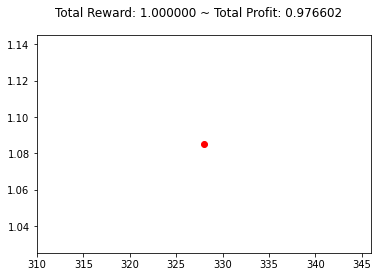

{'total_reward': -6.661338147750939e-12, 'total_profit': 0.9762420285707103, 'position': 0}


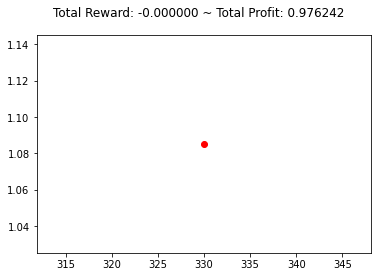

{'total_reward': -1.0000000000065512, 'total_profit': 0.9759721247751421, 'position': 0}


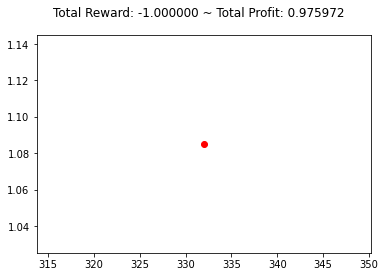

{'total_reward': 0.9999999999932285, 'total_profit': 0.9758821568432859, 'position': 1}


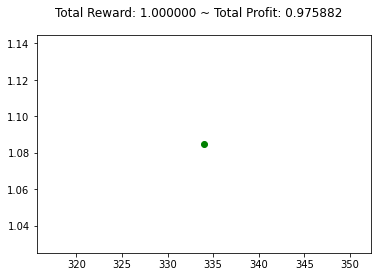

{'total_reward': 0.9999999999932285, 'total_profit': 0.9758821568432859, 'position': 0}


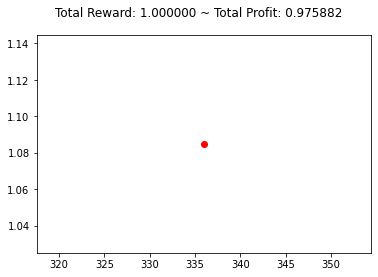

{'total_reward': -3.000000000006331, 'total_profit': 0.9752526714859415, 'position': 1}


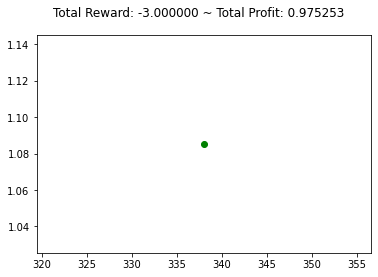

{'total_reward': -3.000000000006331, 'total_profit': 0.9752526714859415, 'position': 1}


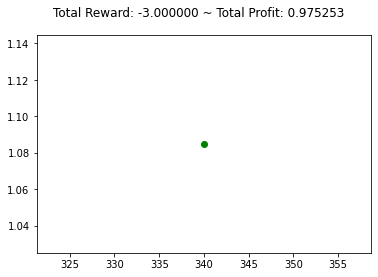

{'total_reward': -7.00000000000589, 'total_profit': 0.9748033291197943, 'position': 1}


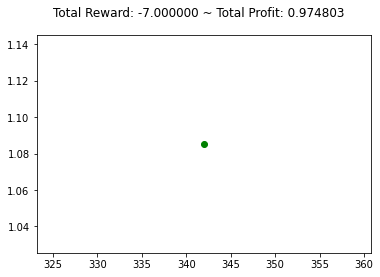

{'total_reward': -8.00000000000578, 'total_profit': 0.9745338230846493, 'position': 1}


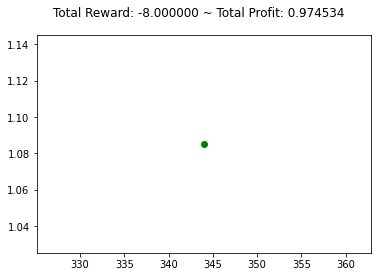

{'total_reward': -8.00000000000578, 'total_profit': 0.9745338230846493, 'position': 1}


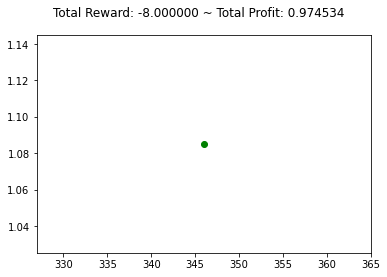

{'total_reward': -9.00000000000567, 'total_profit': 0.9745338230846493, 'position': 0}


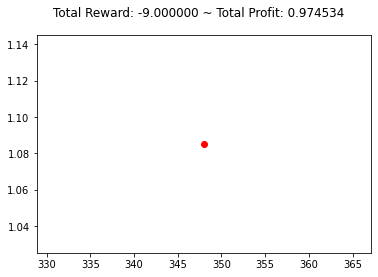

{'total_reward': -9.00000000000567, 'total_profit': 0.9742643667280361, 'position': 0}


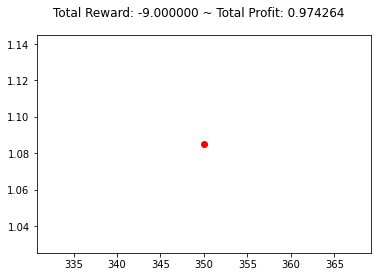

{'total_reward': -10.00000000000556, 'total_profit': 0.973905224025344, 'position': 1}


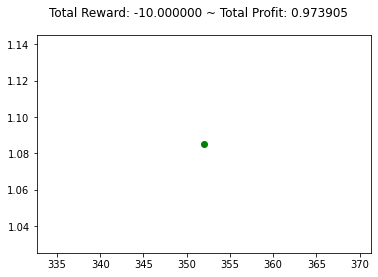

{'total_reward': -8.00000000000578, 'total_profit': 0.9737257188693168, 'position': 1}


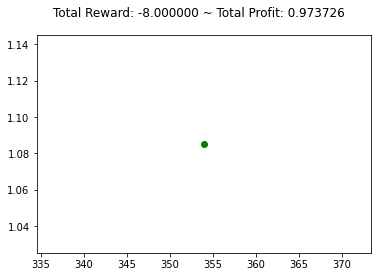

{'total_reward': -8.00000000000578, 'total_profit': 0.9737257188693168, 'position': 1}


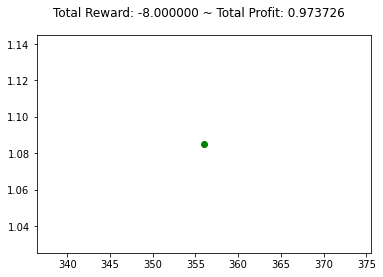

{'total_reward': -11.00000000000545, 'total_profit': 0.9737257188693168, 'position': 0}


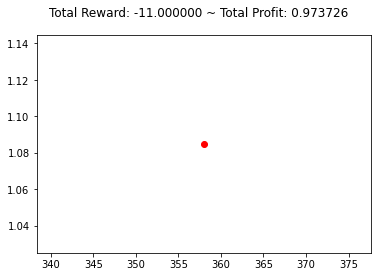

{'total_reward': -13.00000000000523, 'total_profit': 0.973276997339884, 'position': 1}


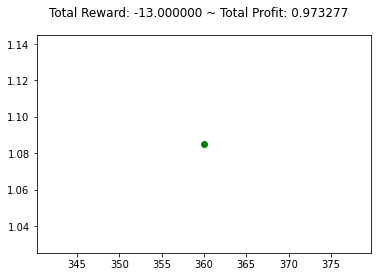

{'total_reward': -12.00000000000534, 'total_profit': 0.973276997339884, 'position': 0}


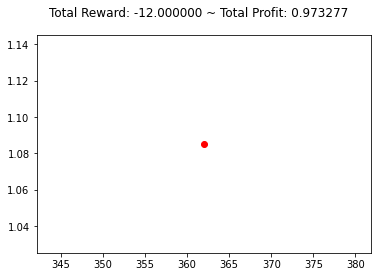

{'total_reward': -13.00000000000523, 'total_profit': 0.9729182516718634, 'position': 1}


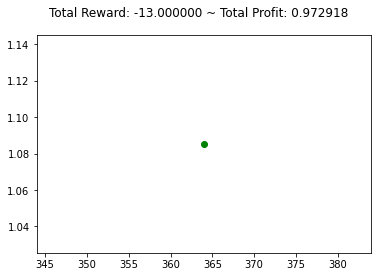

{'total_reward': -13.00000000000523, 'total_profit': 0.9726492915949178, 'position': 1}


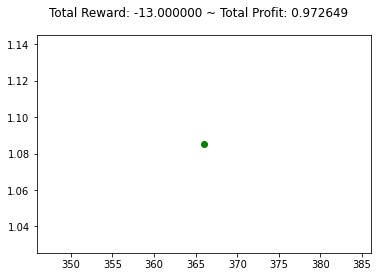

{'total_reward': -15.00000000000501, 'total_profit': 0.9722907772965047, 'position': 1}


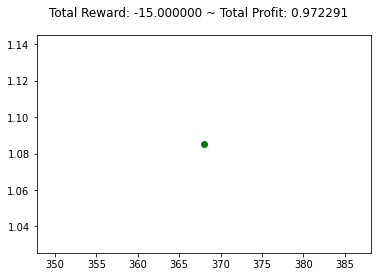

{'total_reward': -14.00000000000512, 'total_profit': 0.9722907772965047, 'position': 0}


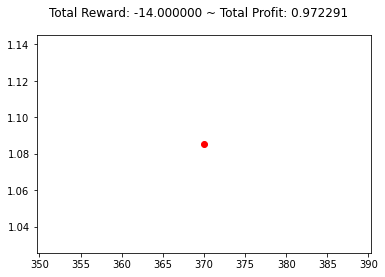

{'total_reward': -14.00000000000512, 'total_profit': 0.9720220154489153, 'position': 1}


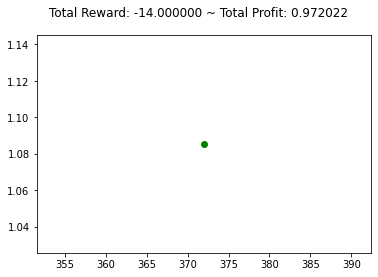

{'total_reward': -16.0000000000049, 'total_profit': 0.9720220154489153, 'position': 0}


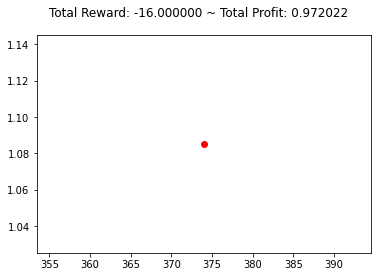

{'total_reward': -17.00000000000479, 'total_profit': 0.9716637323617614, 'position': 1}


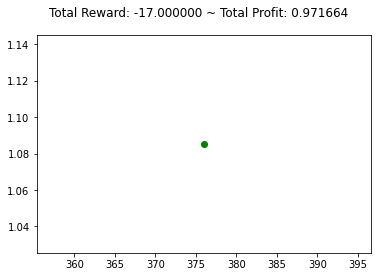

{'total_reward': -16.0000000000049, 'total_profit': 0.9716637323617614, 'position': 0}


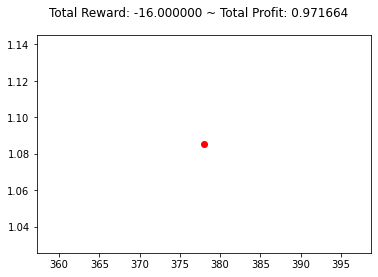

{'total_reward': -18.00000000000468, 'total_profit': 0.9713056473304874, 'position': 0}


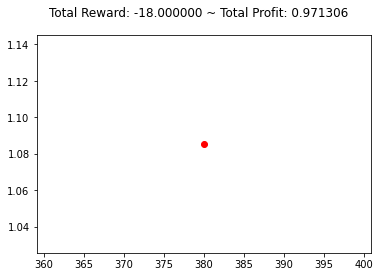

{'total_reward': -18.00000000000468, 'total_profit': 0.9713056473304874, 'position': 0}


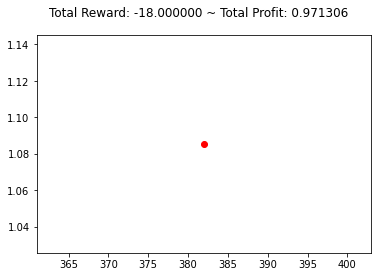

{'total_reward': -18.00000000000468, 'total_profit': 0.9713056473304874, 'position': 0}


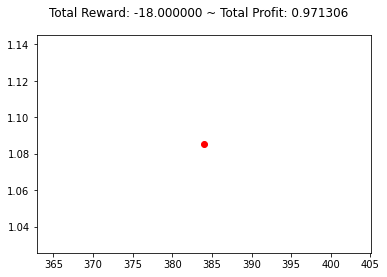

{'total_reward': -19.00000000000457, 'total_profit': 0.9709476942634779, 'position': 1}


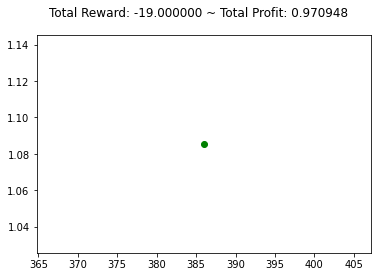

{'total_reward': -18.00000000000468, 'total_profit': 0.9709476942634779, 'position': 0}


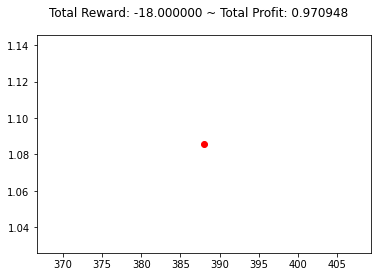

{'total_reward': -18.00000000000468, 'total_profit': 0.9706793531227327, 'position': 1}


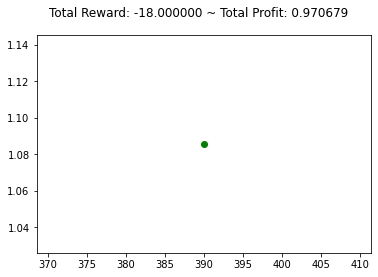

{'total_reward': -14.000000000000679, 'total_profit': 0.9705899307963282, 'position': 1}


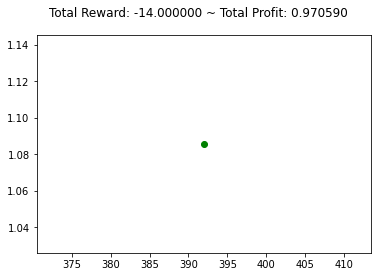

{'total_reward': -14.000000000000679, 'total_profit': 0.9705899307963282, 'position': 1}


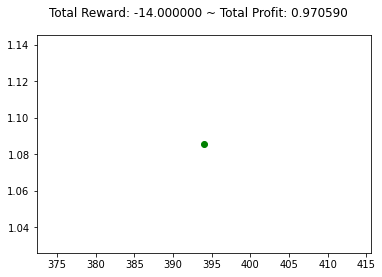

{'total_reward': -9.999999999996678, 'total_profit': 0.9705005167078166, 'position': 1}


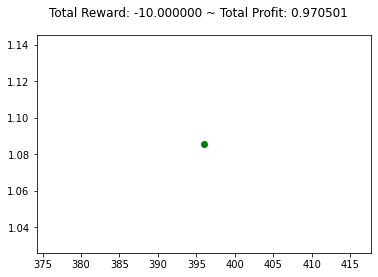

{'total_reward': -6.999999999994788, 'total_profit': 0.9705005167078166, 'position': 0}


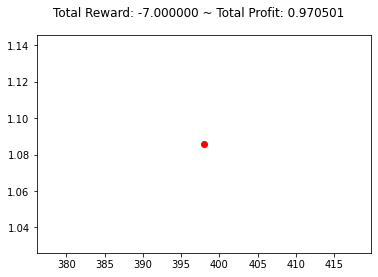

{'total_reward': -12.999999999994127, 'total_profit': 0.9696965306391154, 'position': 1}


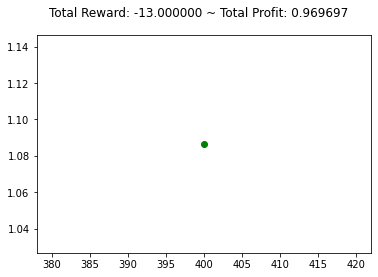

{'total_reward': -17.999999999991356, 'total_profit': 0.9696071988537045, 'position': 1}


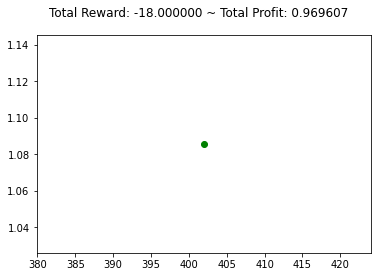

{'total_reward': -17.999999999991356, 'total_profit': 0.9696071988537045, 'position': 0}


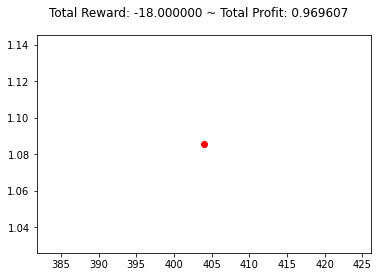

{'total_reward': -16.999999999991466, 'total_profit': 0.969428535282882, 'position': 0}


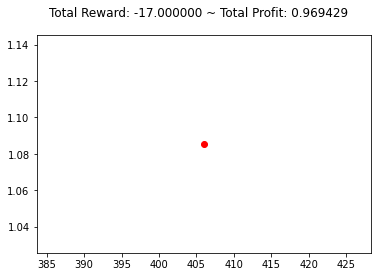

{'total_reward': -20.999999999993246, 'total_profit': 0.9688035583306827, 'position': 1}


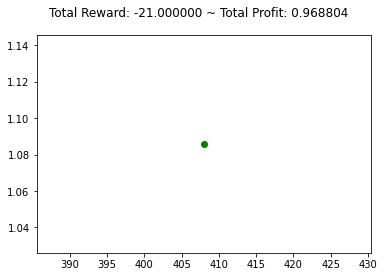

{'total_reward': -18.999999999993467, 'total_profit': 0.9688035583306827, 'position': 0}


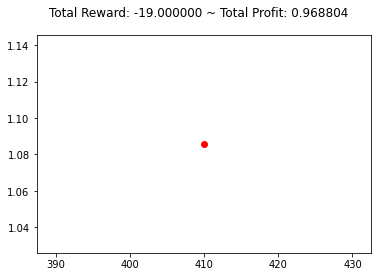

{'total_reward': -20.999999999993246, 'total_profit': 0.9685359330383262, 'position': 0}


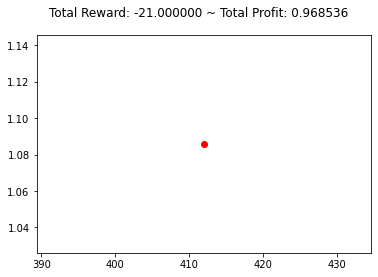

{'total_reward': -20.999999999993246, 'total_profit': 0.9685359330383262, 'position': 0}


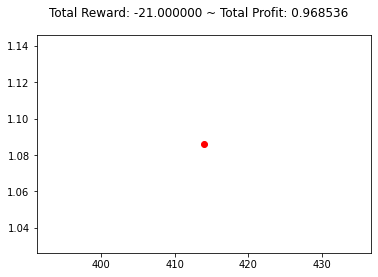

{'total_reward': -20.999999999993246, 'total_profit': 0.9685359330383262, 'position': 0}


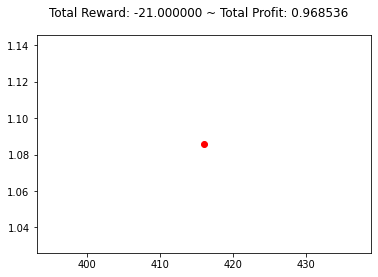

{'total_reward': -16.999999999991466, 'total_profit': 0.9686251661259473, 'position': 1}


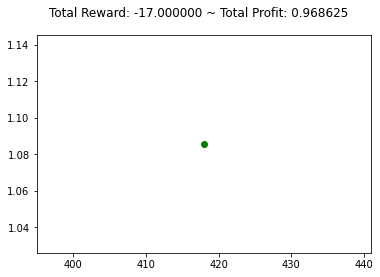

{'total_reward': -12.999999999989686, 'total_profit': 0.9686251661259473, 'position': 0}


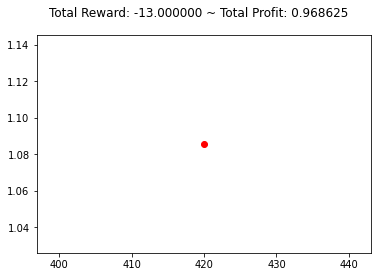

{'total_reward': -12.999999999989686, 'total_profit': 0.9686251661259473, 'position': 0}


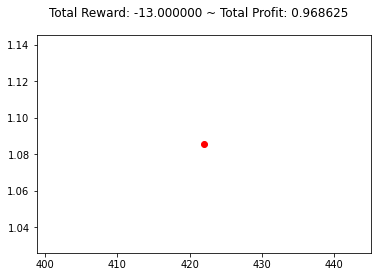

{'total_reward': -11.999999999989797, 'total_profit': 0.9684467328264859, 'position': 1}


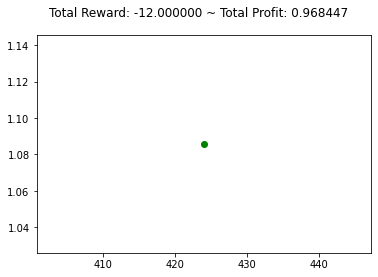

{'total_reward': -10.999999999989907, 'total_profit': 0.9684467328264859, 'position': 0}


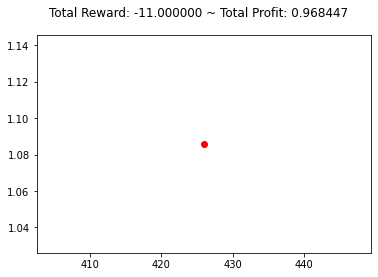

{'total_reward': -7.999999999988017, 'total_profit': 0.9684467328264861, 'position': 1}


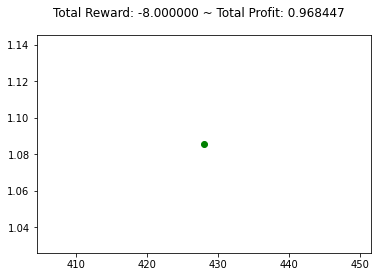

{'total_reward': -7.999999999988017, 'total_profit': 0.9684467328264861, 'position': 1}


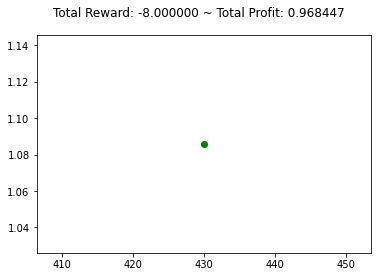

{'total_reward': -2.999999999986347, 'total_profit': 0.9681792061047109, 'position': 1}


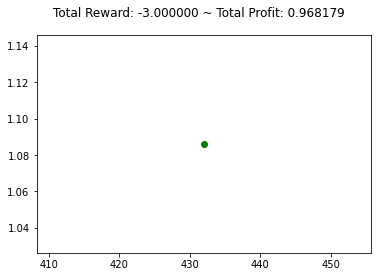

{'total_reward': 1.0000000000132125, 'total_profit': 0.9679118517584007, 'position': 1}


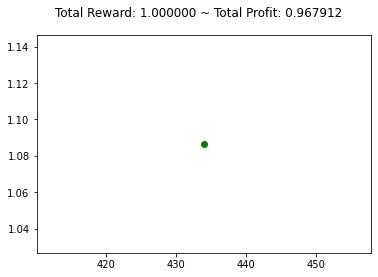

{'total_reward': 1.0000000000132125, 'total_profit': 0.9679118517584007, 'position': 1}


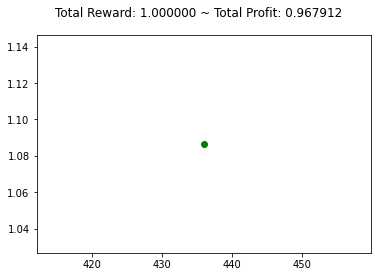

{'total_reward': 1.3322676295501878e-11, 'total_profit': 0.9675555105336392, 'position': 1}


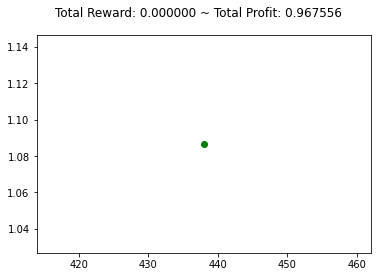

{'total_reward': -0.9999999999865672, 'total_profit': 0.9675555105336392, 'position': 0}


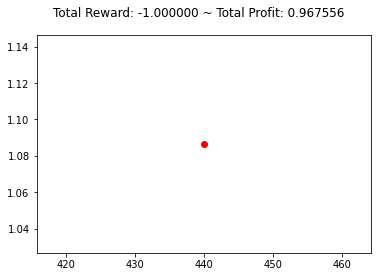

{'total_reward': -2.999999999986347, 'total_profit': 0.9671102889661197, 'position': 1}


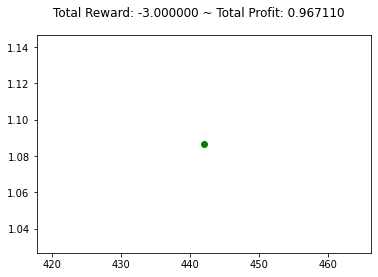

{'total_reward': -2.999999999986347, 'total_profit': 0.9671102889661197, 'position': 1}


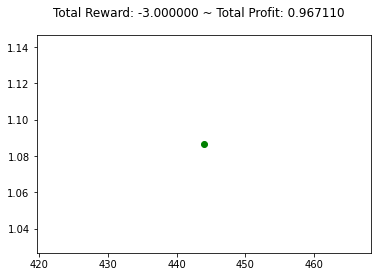

{'total_reward': -3.999999999986237, 'total_profit': 0.9671102889661197, 'position': 0}


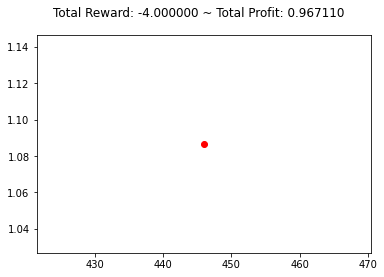

{'total_reward': -0.9999999999865672, 'total_profit': 0.9671102889661198, 'position': 1}


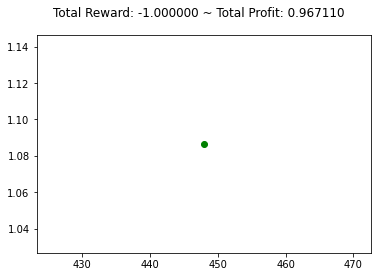

{'total_reward': -0.9999999999865672, 'total_profit': 0.9671102889661198, 'position': 1}


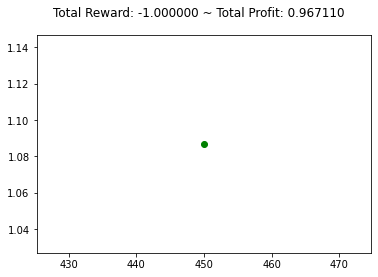

{'total_reward': 7.000000000012552, 'total_profit': 0.9667544720827621, 'position': 1}


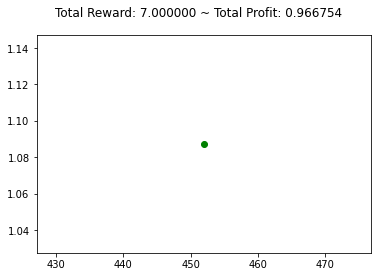

{'total_reward': 6.000000000012662, 'total_profit': 0.9667544720827621, 'position': 0}


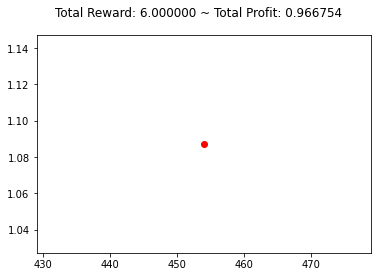

{'total_reward': 7.000000000012552, 'total_profit': 0.9665765963749273, 'position': 1}


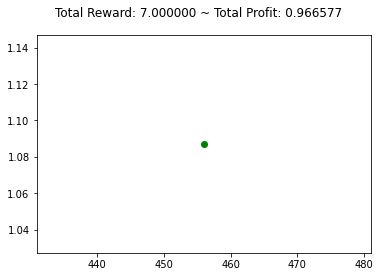

{'total_reward': 4.000000000012882, 'total_profit': 0.9663097582605329, 'position': 1}


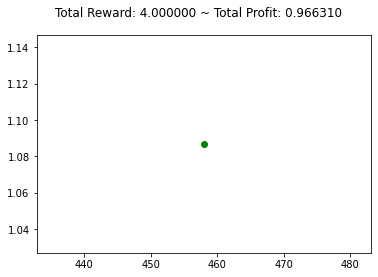

{'total_reward': 2.0000000000131024, 'total_profit': 0.965954072327613, 'position': 1}


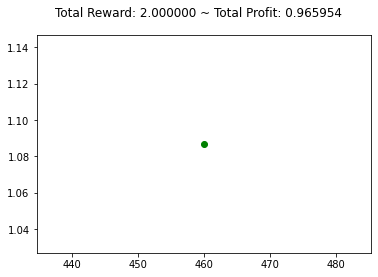

{'total_reward': 1.0000000000132125, 'total_profit': 0.965954072327613, 'position': 0}


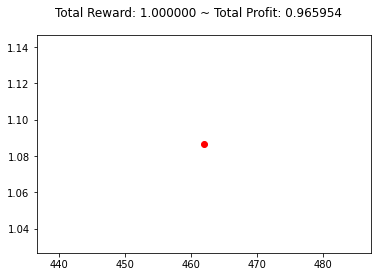

{'total_reward': 5.000000000012772, 'total_profit': 0.9655985173180143, 'position': 0}


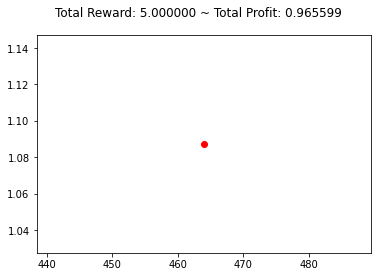

{'total_reward': 5.000000000012772, 'total_profit': 0.9655985173180143, 'position': 0}


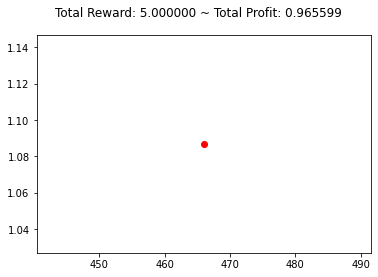

{'total_reward': 5.000000000012772, 'total_profit': 0.9655985173180143, 'position': 0}


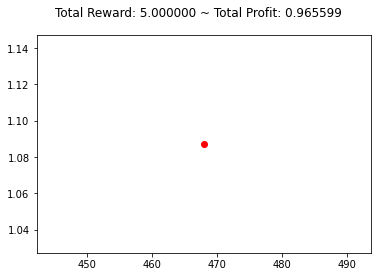

{'total_reward': 10.000000000012221, 'total_profit': 0.9657762293852485, 'position': 1}


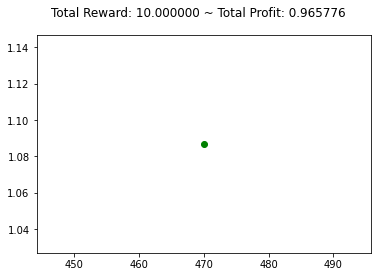

{'total_reward': 12.000000000012001, 'total_profit': 0.9655984846112751, 'position': 1}


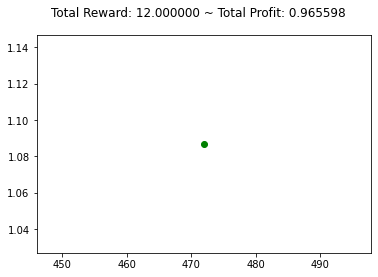

{'total_reward': 12.000000000012001, 'total_profit': 0.9655984846112751, 'position': 1}


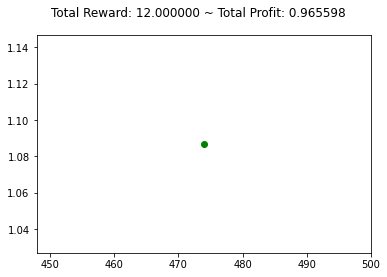

{'total_reward': 14.00000000001178, 'total_profit': 0.9656873897290922, 'position': 1}


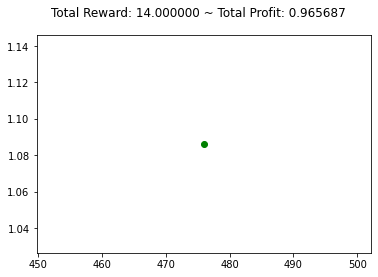

{'total_reward': 18.00000000001134, 'total_profit': 0.9654207480200092, 'position': 1}


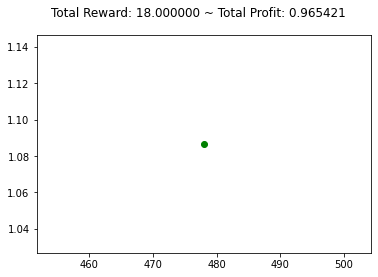

{'total_reward': 15.00000000001167, 'total_profit': 0.9654207480200092, 'position': 0}


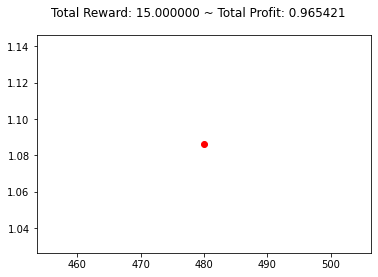

{'total_reward': 15.00000000001167, 'total_profit': 0.9652429705136986, 'position': 0}


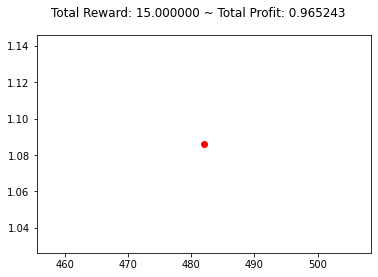

{'total_reward': 14.00000000001178, 'total_profit': 0.9648874809747928, 'position': 1}


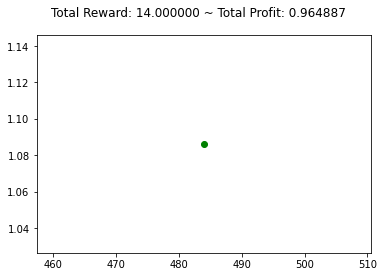

{'total_reward': 13.000000000011891, 'total_profit': 0.9644434053668333, 'position': 1}


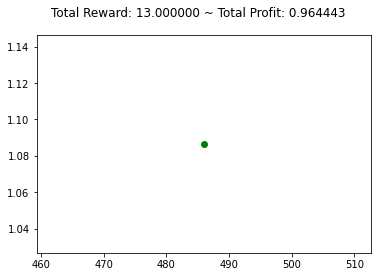

{'total_reward': 14.00000000001178, 'total_profit': 0.9644434053668333, 'position': 0}


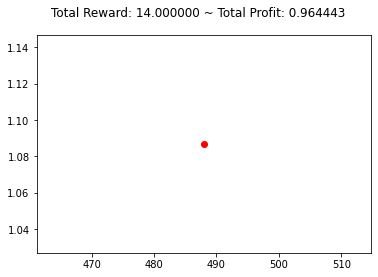

{'total_reward': 14.00000000001178, 'total_profit': 0.9644434053668333, 'position': 0}


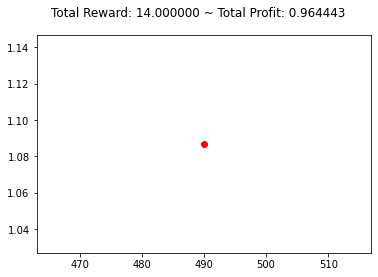

{'total_reward': 10.000000000012221, 'total_profit': 0.9639109559343526, 'position': 0}


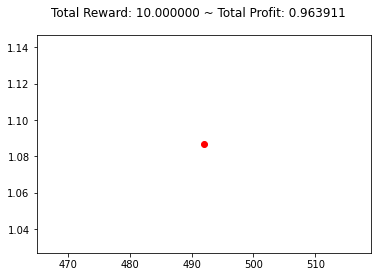

{'total_reward': 9.000000000012331, 'total_profit': 0.9635561856156429, 'position': 0}


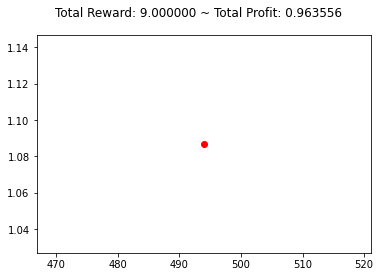

{'total_reward': 6.000000000012662, 'total_profit': 0.9630243728004747, 'position': 1}


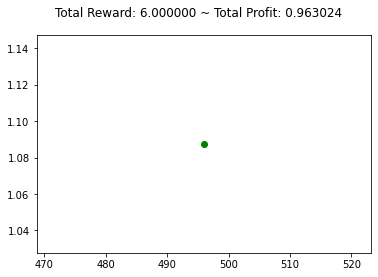

{'total_reward': 7.000000000012552, 'total_profit': 0.9630243728004747, 'position': 0}


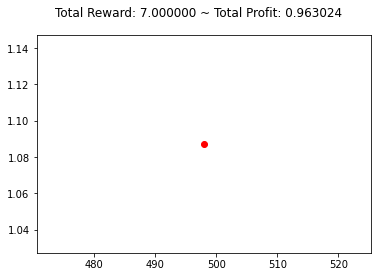

{'total_reward': 9.000000000012331, 'total_profit': 0.962935778101965, 'position': 1}


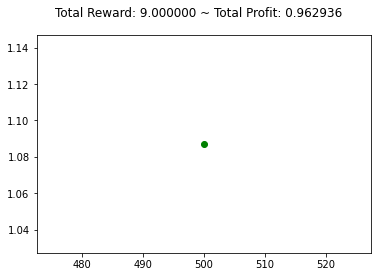

{'total_reward': 9.000000000012331, 'total_profit': 0.962935778101965, 'position': 0}


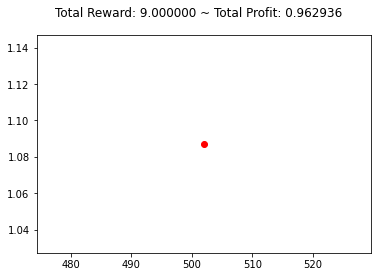

{'total_reward': 9.000000000012331, 'total_profit': 0.9626700184575947, 'position': 1}


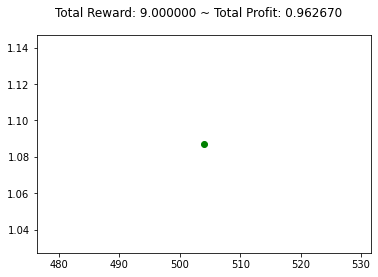

{'total_reward': 9.000000000012331, 'total_profit': 0.9626700184575947, 'position': 1}


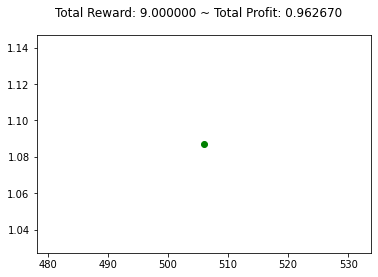

{'total_reward': 9.000000000012331, 'total_profit': 0.9626700184575947, 'position': 0}


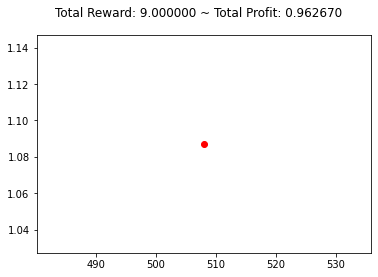

{'total_reward': 2.0000000000131024, 'total_profit': 0.9623158026472892, 'position': 0}


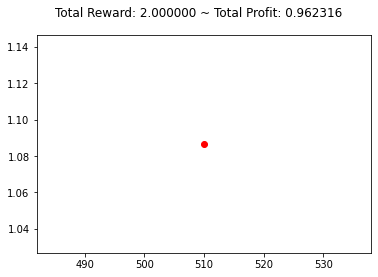

{'total_reward': 2.0000000000131024, 'total_profit': 0.9623158026472892, 'position': 0}


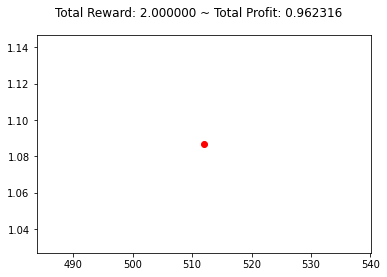

{'total_reward': 1.0000000000132125, 'total_profit': 0.961961554238437, 'position': 1}


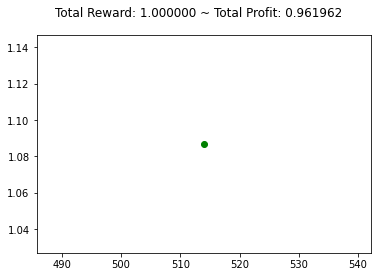

{'total_reward': -0.9999999999865672, 'total_profit': 0.9615189881939769, 'position': 1}


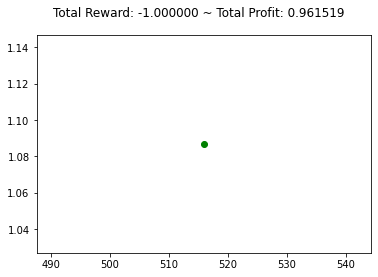

{'total_reward': -0.9999999999865672, 'total_profit': 0.9615189881939769, 'position': 1}


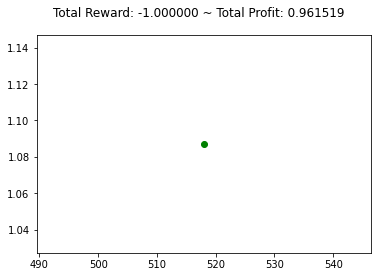

{'total_reward': -2.999999999986347, 'total_profit': 0.9615189881939769, 'position': 0}


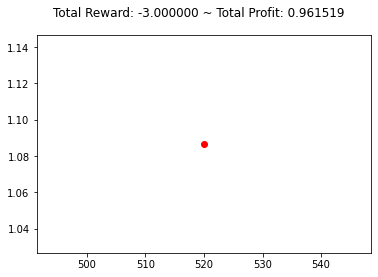

{'total_reward': -2.999999999986347, 'total_profit': 0.9612535218802845, 'position': 1}


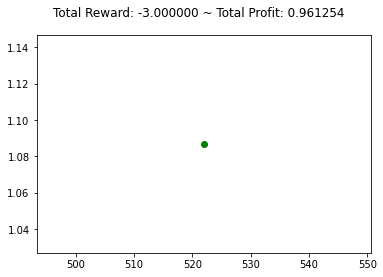

{'total_reward': -4.999999999986127, 'total_profit': 0.9612535218802845, 'position': 0}


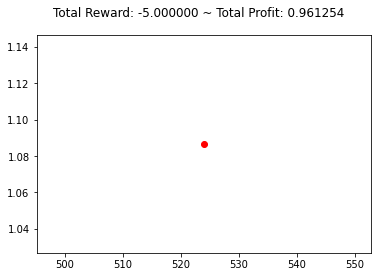

{'total_reward': -11.999999999985356, 'total_profit': 0.9606343854565486, 'position': 0}


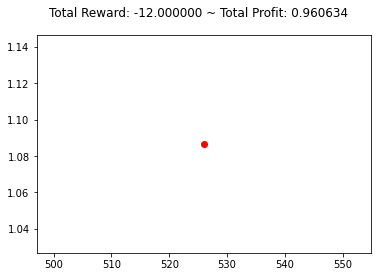

{'total_reward': -9.999999999985576, 'total_profit': 0.9603691389626351, 'position': 0}


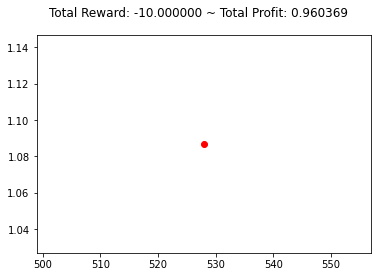

{'total_reward': -6.999999999985906, 'total_profit': 0.9602807478775948, 'position': 0}


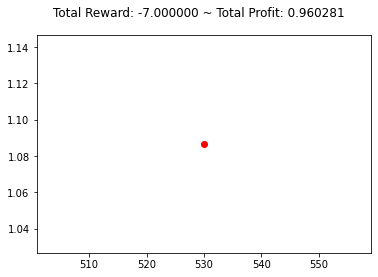

{'total_reward': -5.9999999999860165, 'total_profit': 0.9601039819783076, 'position': 0}


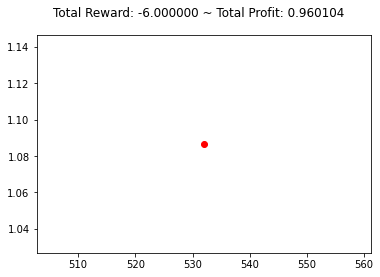

{'total_reward': -1.999999999986457, 'total_profit': 0.9601923812032388, 'position': 1}


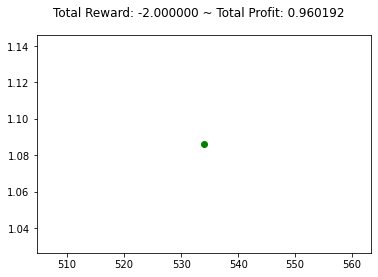

{'total_reward': -5.9999999999860165, 'total_profit': 0.9601923812032388, 'position': 0}


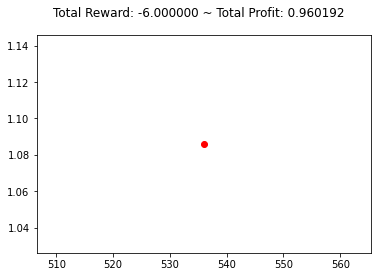

{'total_reward': -5.9999999999860165, 'total_profit': 0.9601923812032388, 'position': 0}


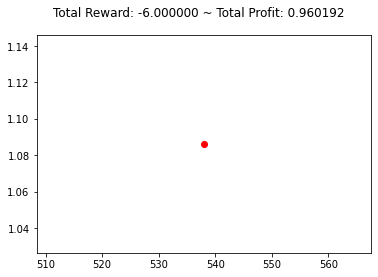

{'total_reward': -14.999999999985025, 'total_profit': 0.959131981003125, 'position': 1}


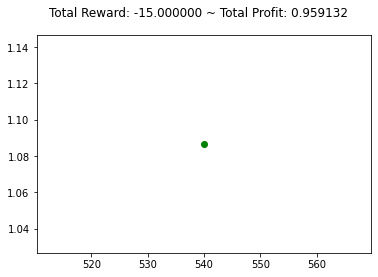

{'total_reward': -14.999999999985025, 'total_profit': 0.9588671737195792, 'position': 1}


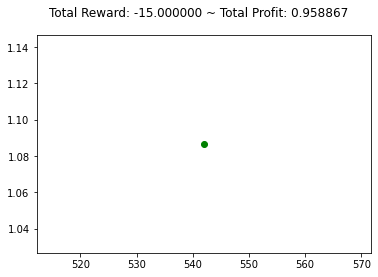

{'total_reward': -14.999999999985025, 'total_profit': 0.9588671737195792, 'position': 1}


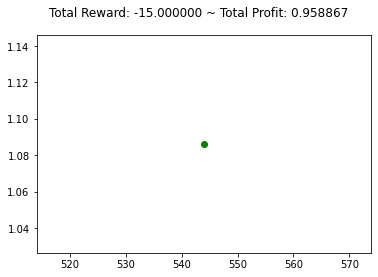

{'total_reward': -14.999999999985025, 'total_profit': 0.9588671737195792, 'position': 1}


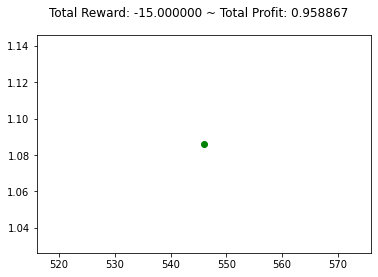

{'total_reward': -14.999999999985025, 'total_profit': 0.9588671737195792, 'position': 1}


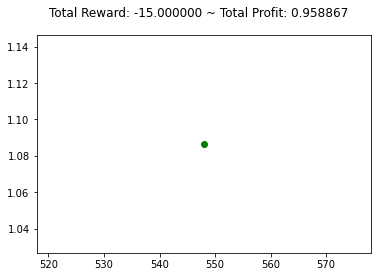

{'total_reward': -14.999999999985025, 'total_profit': 0.9588671737195792, 'position': 1}


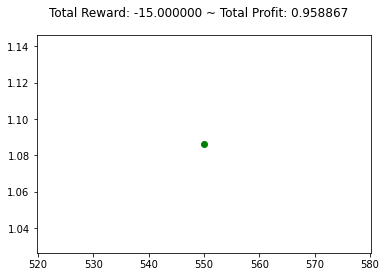

{'total_reward': -14.999999999985025, 'total_profit': 0.9588671737195792, 'position': 1}


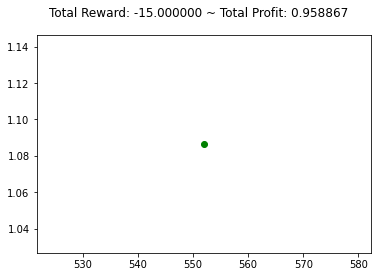

{'total_reward': -13.999999999985135, 'total_profit': 0.9588671737195791, 'position': 1}


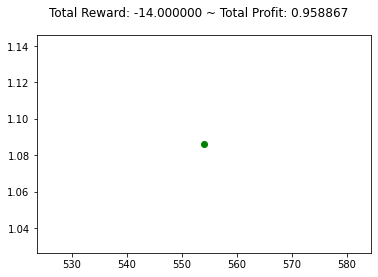

{'total_reward': -13.999999999985135, 'total_profit': 0.9588671737195791, 'position': 1}


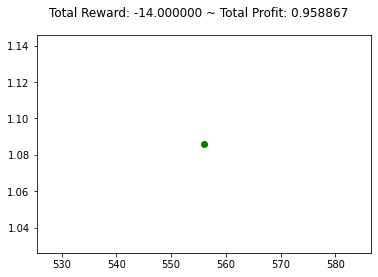

{'total_reward': -14.999999999985025, 'total_profit': 0.9588671737195791, 'position': 0}


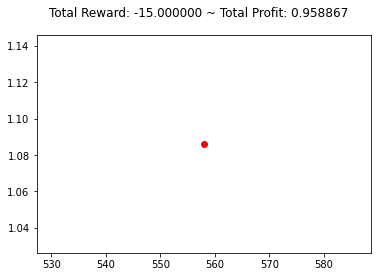

{'total_reward': -13.999999999985135, 'total_profit': 0.9586905705012866, 'position': 1}


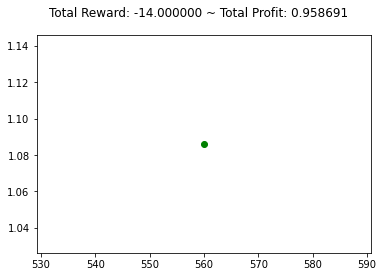

{'total_reward': -15.999999999984915, 'total_profit': 0.9586905705012866, 'position': 0}


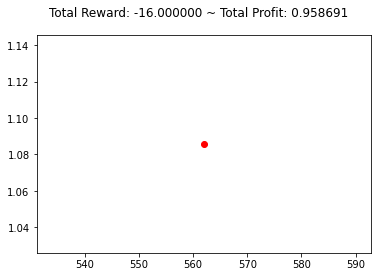

{'total_reward': -16.999999999984805, 'total_profit': 0.9583373965943052, 'position': 1}


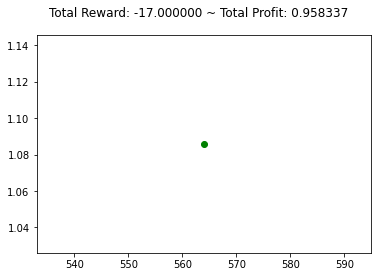

{'total_reward': -15.999999999984915, 'total_profit': 0.9583373965943052, 'position': 0}


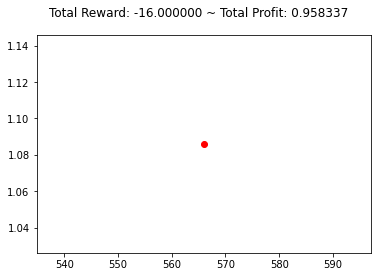

{'total_reward': -23.999999999984034, 'total_profit': 0.9576316989532195, 'position': 0}


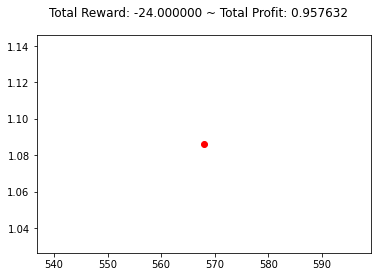

{'total_reward': -22.999999999984144, 'total_profit': 0.9574553395243147, 'position': 0}


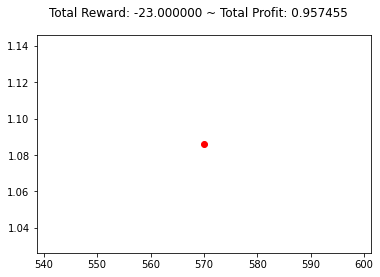

{'total_reward': -22.999999999984144, 'total_profit': 0.9571908490990318, 'position': 1}


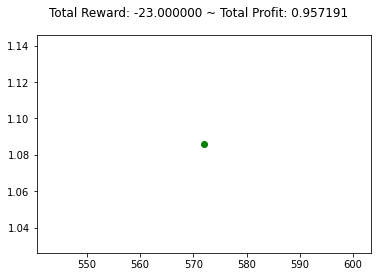

{'total_reward': -22.999999999984144, 'total_profit': 0.9571908490990318, 'position': 1}


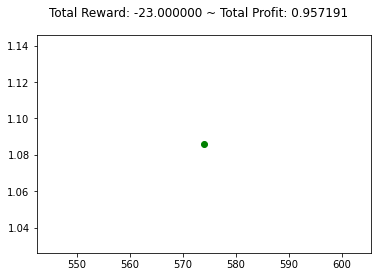

{'total_reward': -18.999999999984585, 'total_profit': 0.9571908490990318, 'position': 0}


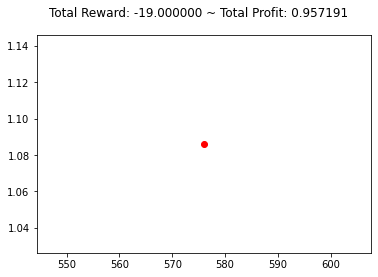

{'total_reward': -15.999999999984915, 'total_profit': 0.9571908490990318, 'position': 0}


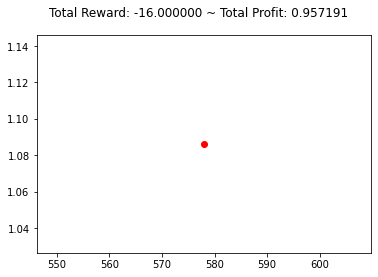

{'total_reward': -15.999999999984915, 'total_profit': 0.9571908490990318, 'position': 0}


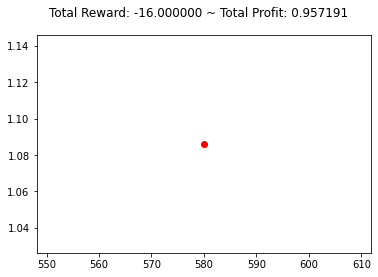

{'total_reward': -15.999999999984915, 'total_profit': 0.9571908490990318, 'position': 0}


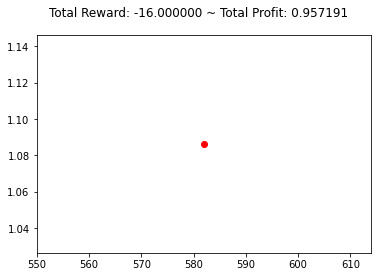

{'total_reward': -16.999999999984805, 'total_profit': 0.9568383575324331, 'position': 1}


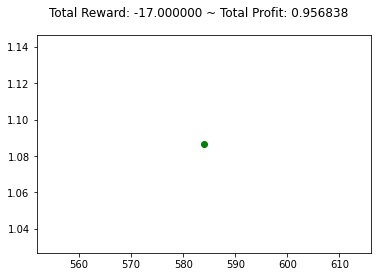

{'total_reward': -14.999999999985025, 'total_profit': 0.9568383575324331, 'position': 0}


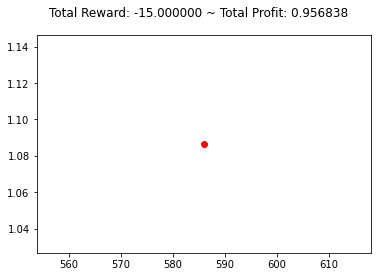

{'total_reward': -14.999999999985025, 'total_profit': 0.9568383575324331, 'position': 0}


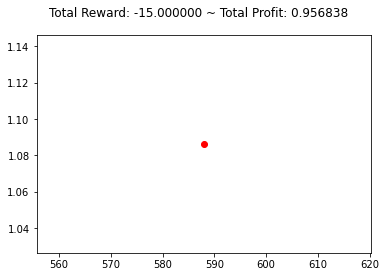

{'total_reward': -14.999999999985025, 'total_profit': 0.9568383575324331, 'position': 0}


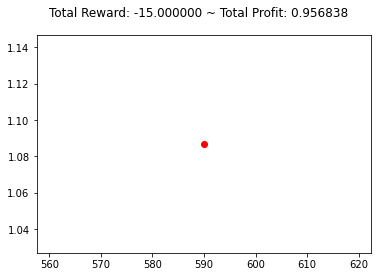

{'total_reward': -12.999999999985246, 'total_profit': 0.9567502670925939, 'position': 0}


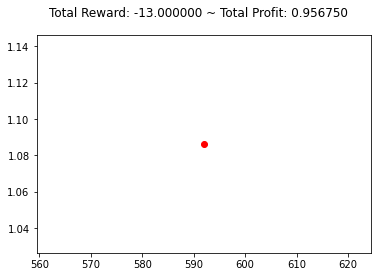

{'total_reward': -16.999999999984805, 'total_profit': 0.9561339177580047, 'position': 1}


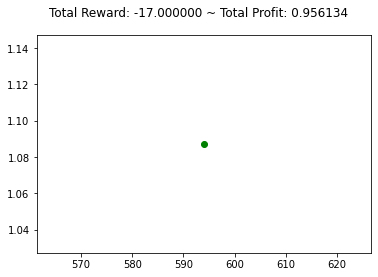

{'total_reward': -13.999999999985135, 'total_profit': 0.9559579475881772, 'position': 1}


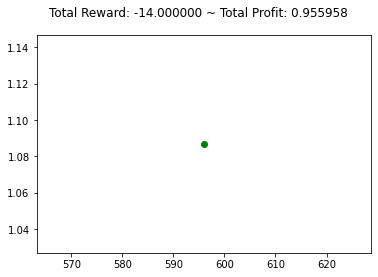

{'total_reward': -13.999999999985135, 'total_profit': 0.9559579475881772, 'position': 1}


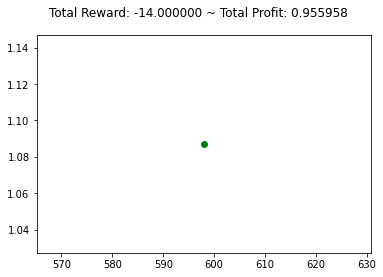

{'total_reward': -10.999999999985466, 'total_profit': 0.9559579475881772, 'position': 0}


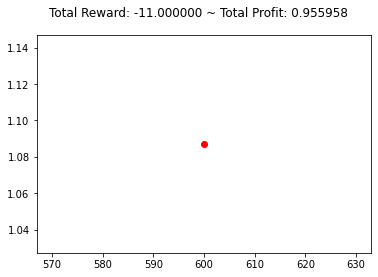

{'total_reward': -11.999999999985356, 'total_profit': 0.9556062014939491, 'position': 1}


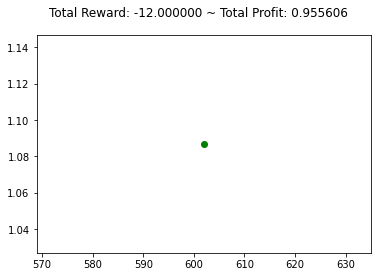

{'total_reward': -12.999999999985246, 'total_profit': 0.9556062014939491, 'position': 0}


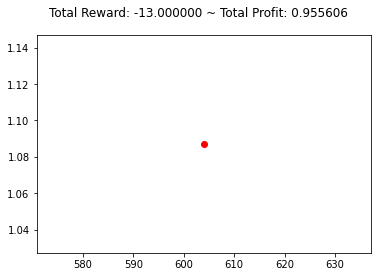

{'total_reward': -12.999999999985246, 'total_profit': 0.9553424647318074, 'position': 1}


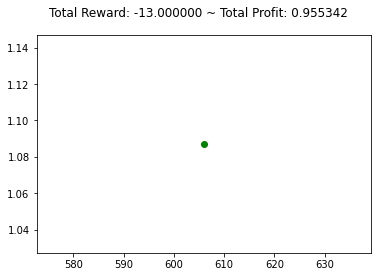

{'total_reward': -11.999999999985356, 'total_profit': 0.9553424647318074, 'position': 0}


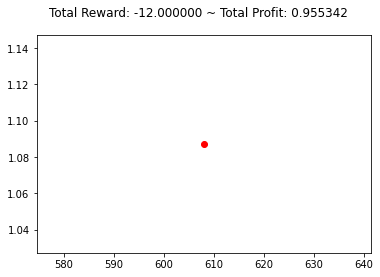

{'total_reward': -11.999999999985356, 'total_profit': 0.9550788250119844, 'position': 1}


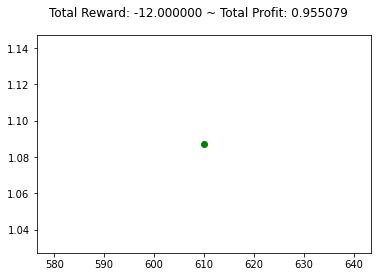

{'total_reward': -11.999999999985356, 'total_profit': 0.9550788250119844, 'position': 1}


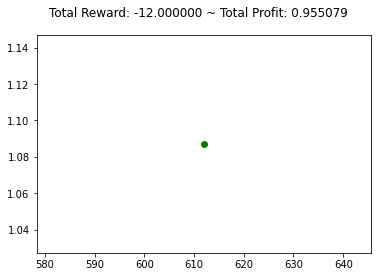

{'total_reward': -11.999999999985356, 'total_profit': 0.9550788250119844, 'position': 0}


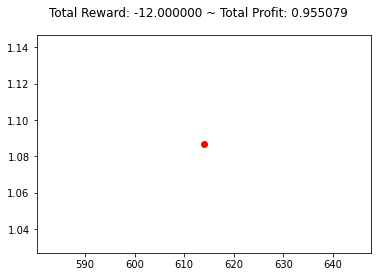

{'total_reward': -13.999999999985135, 'total_profit': 0.9549030975372812, 'position': 0}


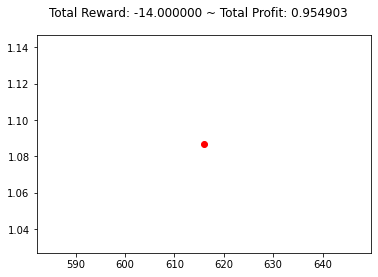

{'total_reward': -12.999999999985246, 'total_profit': 0.9547273377181136, 'position': 1}


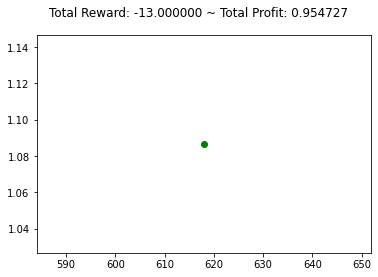

{'total_reward': -12.999999999985246, 'total_profit': 0.9547273377181136, 'position': 0}


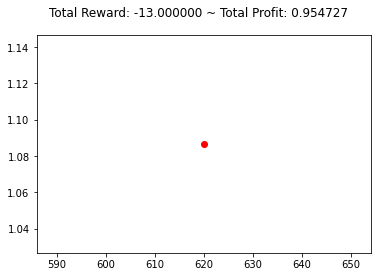

{'total_reward': -12.999999999985246, 'total_profit': 0.9547273377181136, 'position': 0}


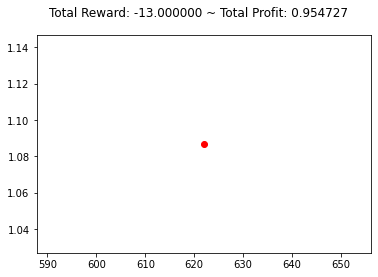

{'total_reward': -12.999999999985246, 'total_profit': 0.9544637465149889, 'position': 1}


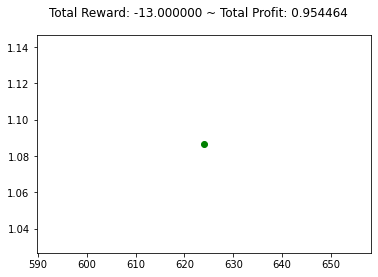

{'total_reward': -13.999999999985135, 'total_profit': 0.9544637465149889, 'position': 0}


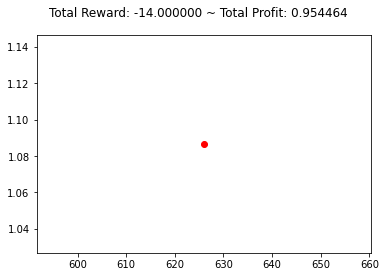

{'total_reward': -13.999999999985135, 'total_profit': 0.9541123886108789, 'position': 0}


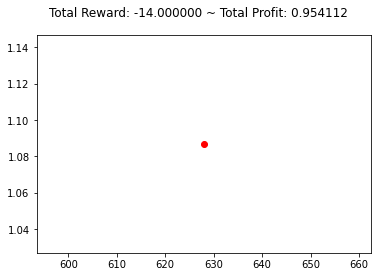

{'total_reward': -12.999999999985246, 'total_profit': 0.9539367743298904, 'position': 1}


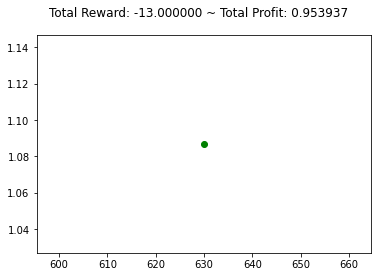

{'total_reward': -12.999999999985246, 'total_profit': 0.9539367743298904, 'position': 0}


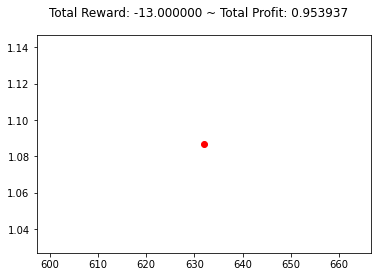

{'total_reward': -12.999999999985246, 'total_profit': 0.9539367743298904, 'position': 0}


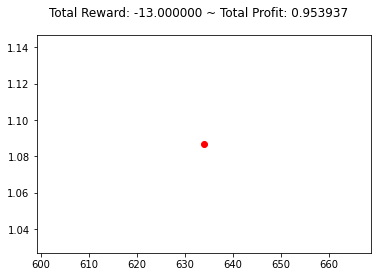

{'total_reward': -14.999999999985025, 'total_profit': 0.9535856427298794, 'position': 0}


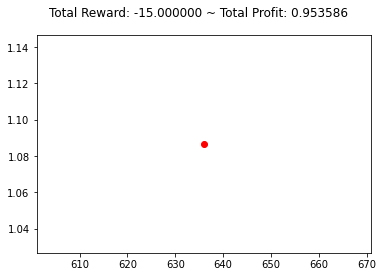

{'total_reward': -13.999999999985135, 'total_profit': 0.9533223667379606, 'position': 0}


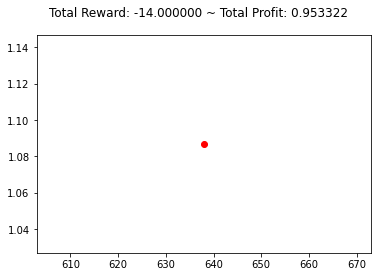

{'total_reward': -14.999999999985025, 'total_profit': 0.9529714935812664, 'position': 0}


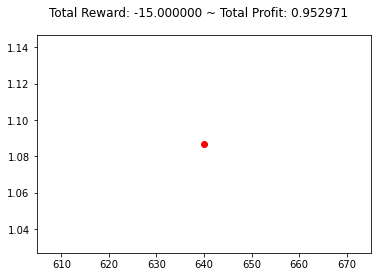

{'total_reward': -18.999999999984585, 'total_profit': 0.9525331442281932, 'position': 0}


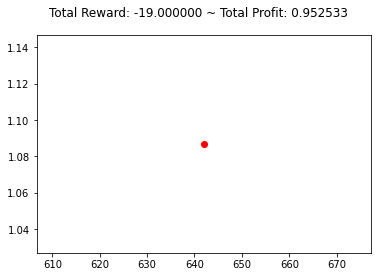

{'total_reward': -19.999999999984475, 'total_profit': 0.9522702072174567, 'position': 0}


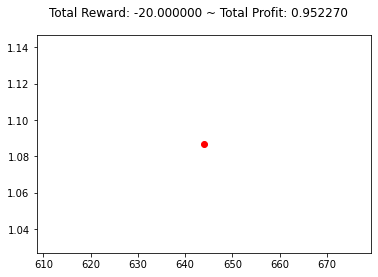

{'total_reward': -19.999999999984475, 'total_profit': 0.9520073185985507, 'position': 1}


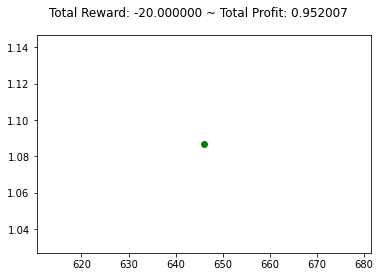

{'total_reward': -19.999999999984475, 'total_profit': 0.9520073185985507, 'position': 0}


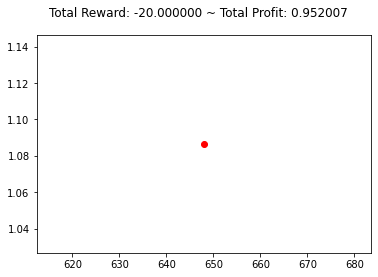

{'total_reward': -17.999999999984695, 'total_profit': 0.9519196971242204, 'position': 1}


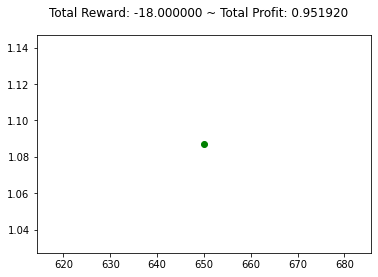

{'total_reward': -20.999999999984365, 'total_profit': 0.9519196971242204, 'position': 0}


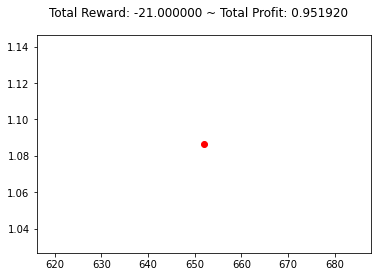

{'total_reward': -23.999999999984034, 'total_profit': 0.9513940166656153, 'position': 1}


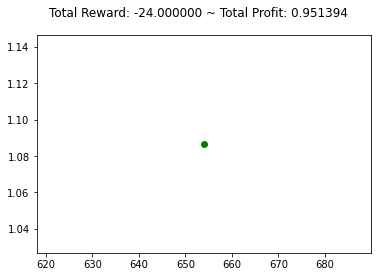

{'total_reward': -24.999999999983924, 'total_profit': 0.9513940166656153, 'position': 0}


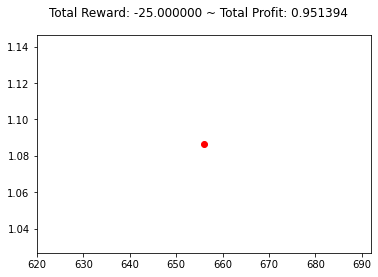

{'total_reward': -26.999999999983704, 'total_profit': 0.9509562318245213, 'position': 1}


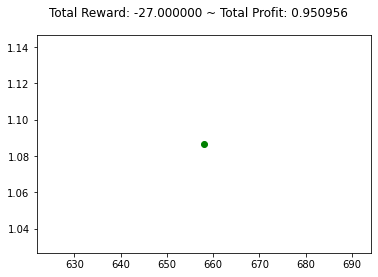

{'total_reward': -31.999999999983153, 'total_profit': 0.9509562318245213, 'position': 0}


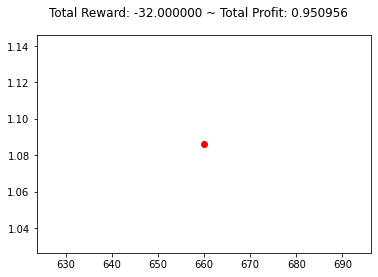

{'total_reward': -36.9999999999826, 'total_profit': 0.950431035083823, 'position': 0}


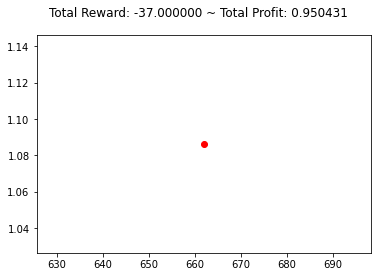

{'total_reward': -42.99999999998194, 'total_profit': 0.9498187566699093, 'position': 0}


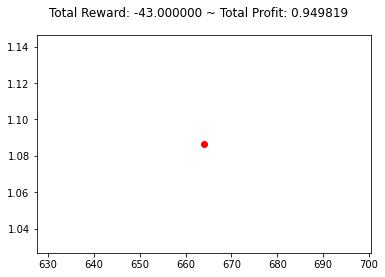

{'total_reward': -39.999999999982265, 'total_profit': 0.9498187566699093, 'position': 1}


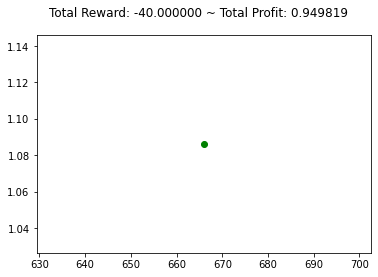

{'total_reward': -40.99999999998216, 'total_profit': 0.949381616225934, 'position': 1}


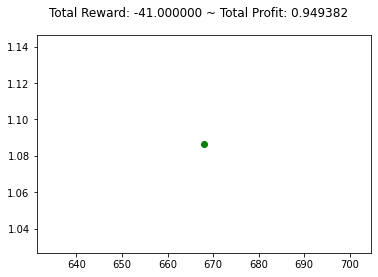

{'total_reward': -40.99999999998216, 'total_profit': 0.949381616225934, 'position': 1}


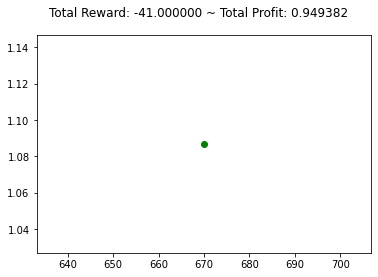

{'total_reward': -42.99999999998194, 'total_profit': 0.949381616225934, 'position': 0}


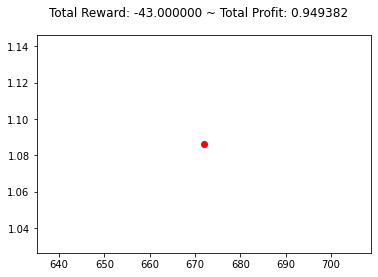

{'total_reward': -42.99999999998194, 'total_profit': 0.949119404400425, 'position': 1}


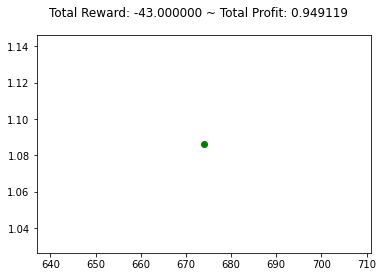

{'total_reward': -42.99999999998194, 'total_profit': 0.949119404400425, 'position': 1}


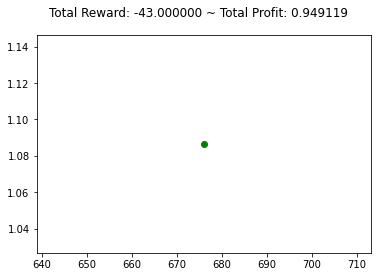

{'total_reward': -40.99999999998216, 'total_profit': 0.949119404400425, 'position': 0}


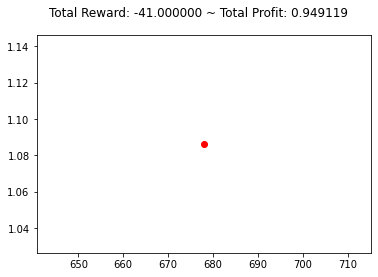

{'total_reward': -40.999999999982165, 'total_profit': 0.9487699817020723, 'position': 0}


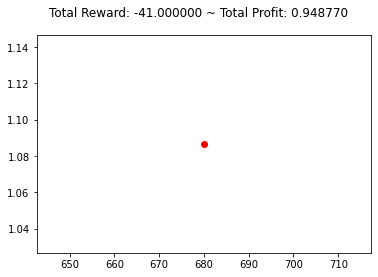

{'total_reward': -38.99999999998239, 'total_profit': 0.9485953346736872, 'position': 0}


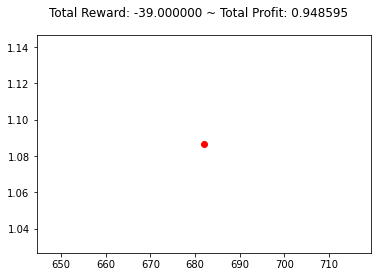

{'total_reward': -38.99999999998239, 'total_profit': 0.9485953346736872, 'position': 0}


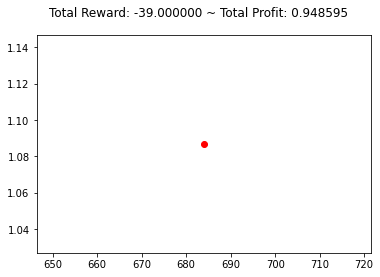

{'total_reward': -38.99999999998239, 'total_profit': 0.9485953346736872, 'position': 0}


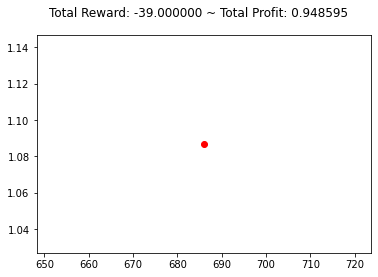

{'total_reward': -38.99999999998239, 'total_profit': 0.9485953346736872, 'position': 0}


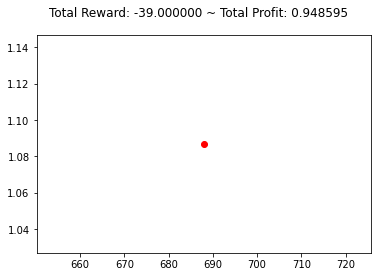

{'total_reward': -39.99999999998228, 'total_profit': 0.9482461691874726, 'position': 1}


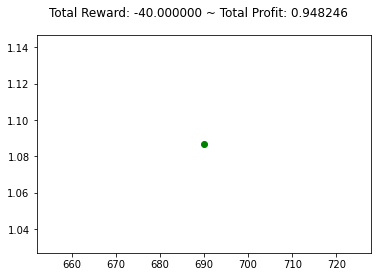

{'total_reward': -39.99999999998228, 'total_profit': 0.9482461691874726, 'position': 0}


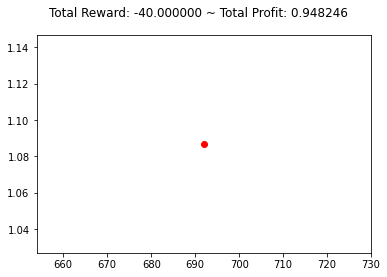

{'total_reward': -38.99999999998239, 'total_profit': 0.9480716346450122, 'position': 1}


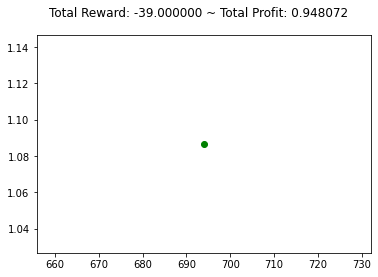

{'total_reward': -38.99999999998239, 'total_profit': 0.9480716346450122, 'position': 1}


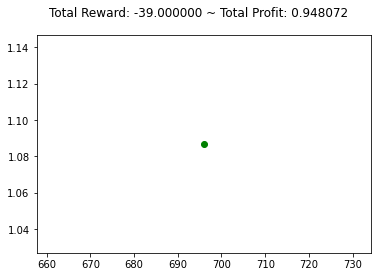

{'total_reward': -33.99999999998295, 'total_profit': 0.9480716346450122, 'position': 0}


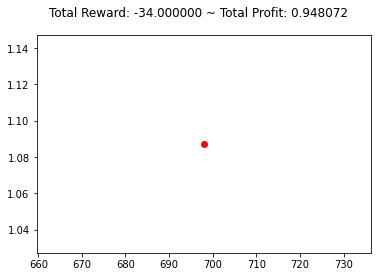

{'total_reward': -35.99999999998273, 'total_profit': 0.9476356594612336, 'position': 1}


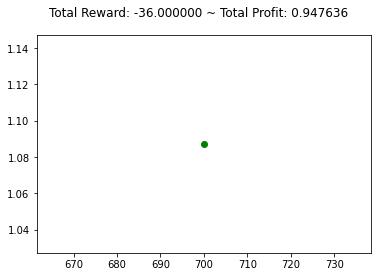

{'total_reward': -35.99999999998273, 'total_profit': 0.9476356594612336, 'position': 1}


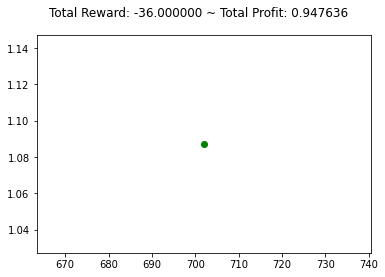

{'total_reward': -35.99999999998273, 'total_profit': 0.9476356594612336, 'position': 1}


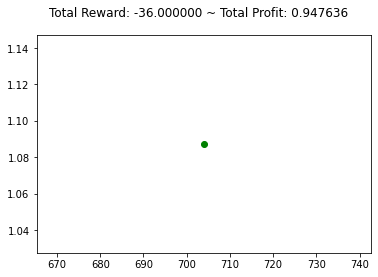

{'total_reward': -35.99999999998273, 'total_profit': 0.9476356594612336, 'position': 1}


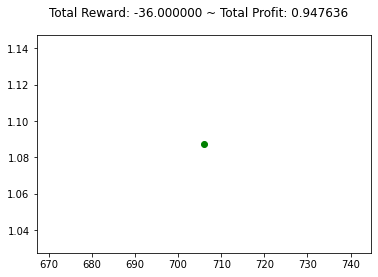

{'total_reward': -35.99999999998273, 'total_profit': 0.9476356594612336, 'position': 0}


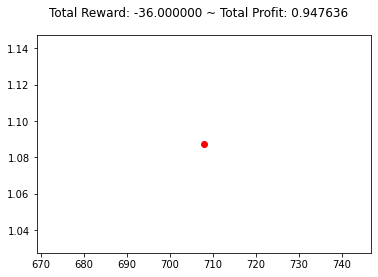

{'total_reward': -35.99999999998273, 'total_profit': 0.9476356594612336, 'position': 0}


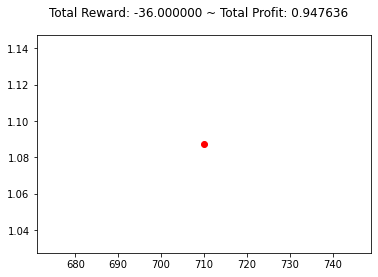

{'total_reward': -35.99999999998273, 'total_profit': 0.9476356594612336, 'position': 0}


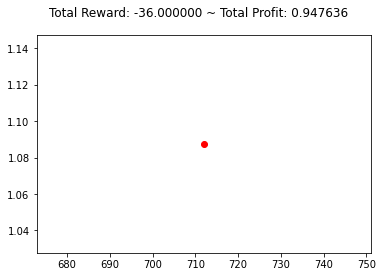

{'total_reward': -36.99999999998262, 'total_profit': 0.9472870717623332, 'position': 1}


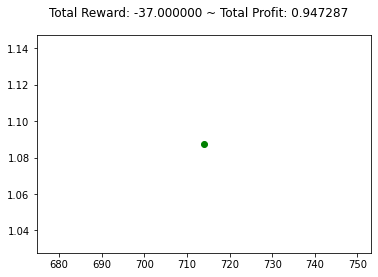

{'total_reward': -36.99999999998262, 'total_profit': 0.9472870717623332, 'position': 1}


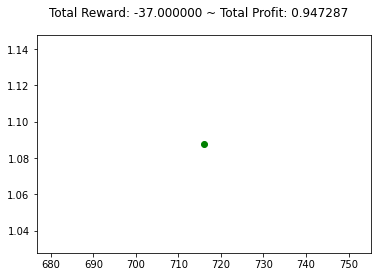

{'total_reward': -35.999999999982734, 'total_profit': 0.9472870717623332, 'position': 0}


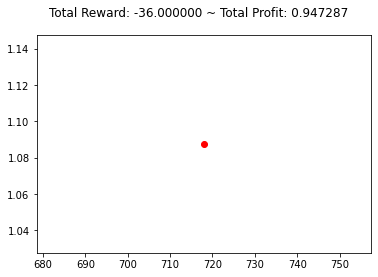

{'total_reward': -32.99999999998306, 'total_profit': 0.9472870717623332, 'position': 0}


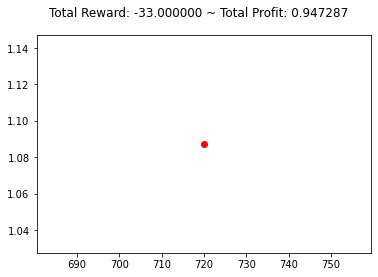

{'total_reward': -32.99999999998306, 'total_profit': 0.947025679082487, 'position': 1}


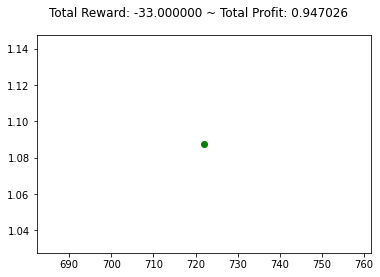

{'total_reward': -23.999999999984052, 'total_profit': 0.9471127779217293, 'position': 1}


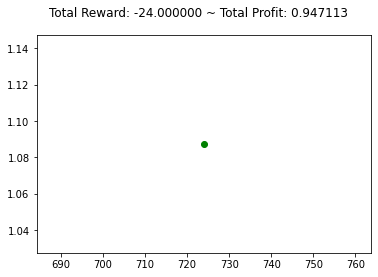

{'total_reward': -23.999999999984052, 'total_profit': 0.9471127779217293, 'position': 1}


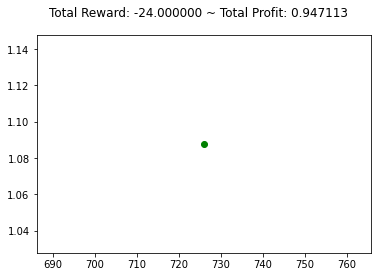

{'total_reward': -23.999999999984052, 'total_profit': 0.9471127779217293, 'position': 1}


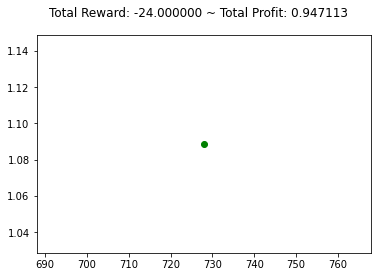

{'total_reward': -11.999999999983153, 'total_profit': 0.9471127779217293, 'position': 0}


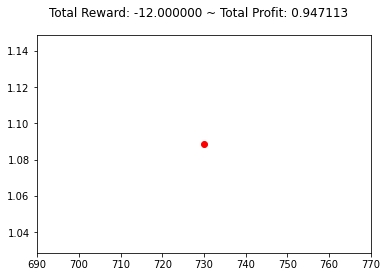

{'total_reward': -9.999999999983373, 'total_profit': 0.9470257511112983, 'position': 1}


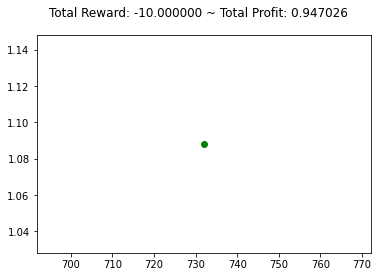

{'total_reward': -12.999999999983043, 'total_profit': 0.9470257511112983, 'position': 0}


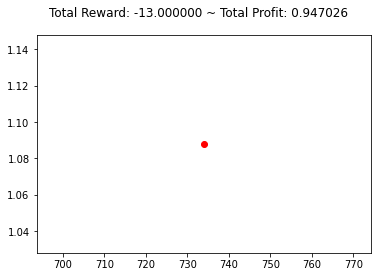

{'total_reward': -12.999999999983043, 'total_profit': 0.9470257511112983, 'position': 0}


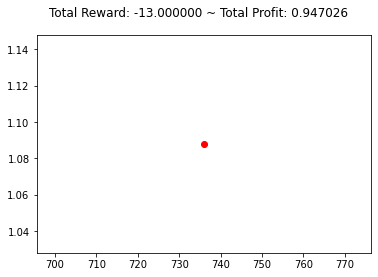

{'total_reward': -10.999999999983263, 'total_profit': 0.9469386922998336, 'position': 1}


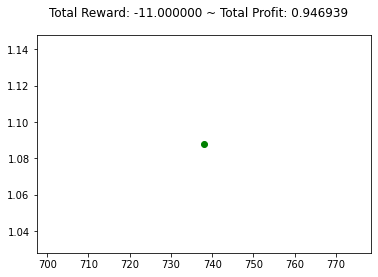

{'total_reward': -14.999999999985043, 'total_profit': 0.9469386922998336, 'position': 0}


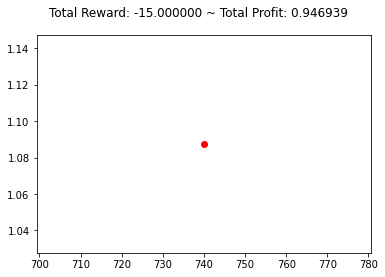

{'total_reward': -14.999999999985043, 'total_profit': 0.9469386922998336, 'position': 0}


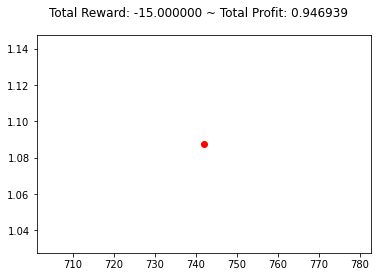

{'total_reward': -13.999999999985153, 'total_profit': 0.9465903930107118, 'position': 0}


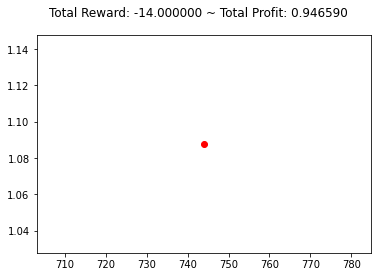

{'total_reward': -12.999999999983043, 'total_profit': 0.9463293126412136, 'position': 0}


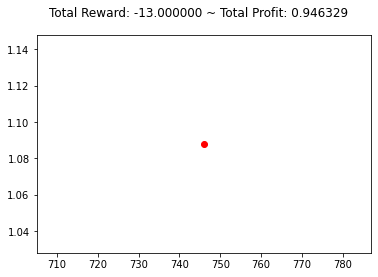

{'total_reward': -12.999999999983043, 'total_profit': 0.9463293126412136, 'position': 0}


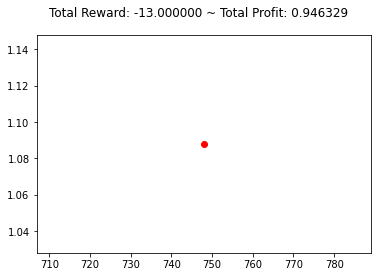

{'total_reward': -11.999999999983153, 'total_profit': 0.9458944186556248, 'position': 0}


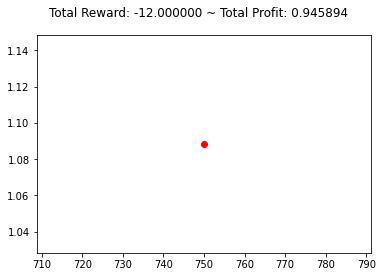

{'total_reward': -11.999999999983153, 'total_profit': 0.9456336740763759, 'position': 0}


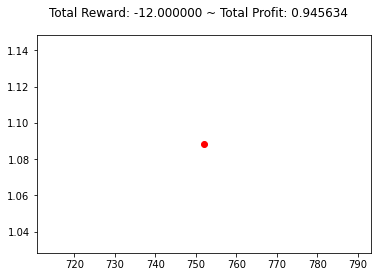

{'total_reward': -3.999999999984034, 'total_profit': 0.9456336740763758, 'position': 0}


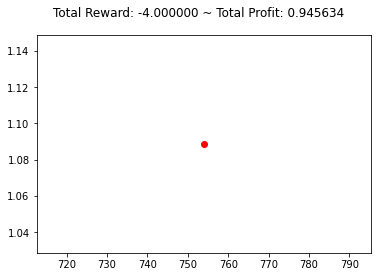

{'total_reward': -3.999999999984034, 'total_profit': 0.9456336740763758, 'position': 0}


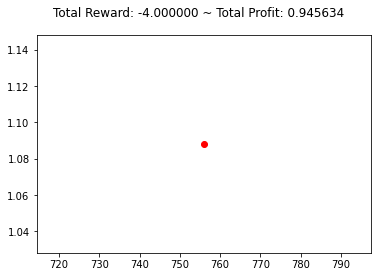

{'total_reward': 3.000000000015195, 'total_profit': 0.9459813974351096, 'position': 1}


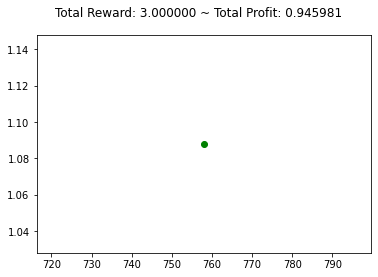

{'total_reward': 2.0000000000130846, 'total_profit': 0.9459813974351096, 'position': 0}


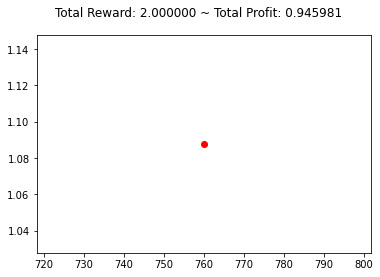

{'total_reward': 2.0000000000130846, 'total_profit': 0.9459813974351096, 'position': 0}


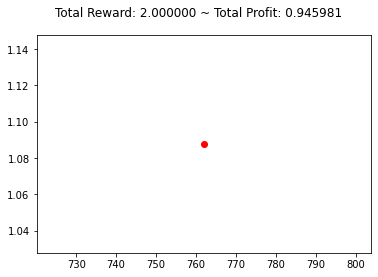

{'total_reward': 4.000000000012864, 'total_profit': 0.9458944106399431, 'position': 1}


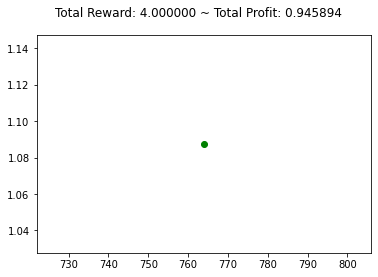

{'total_reward': -0.999999999986585, 'total_profit': 0.9454594766641108, 'position': 1}


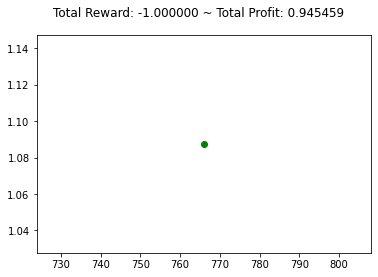

{'total_reward': 3.000000000015195, 'total_profit': 0.9454594766641108, 'position': 0}


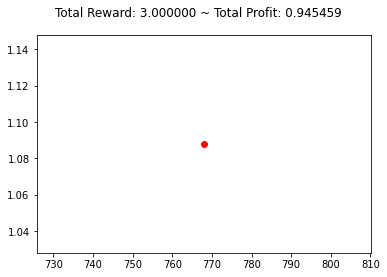

{'total_reward': 4.000000000015085, 'total_profit': 0.9451987321862663, 'position': 0}


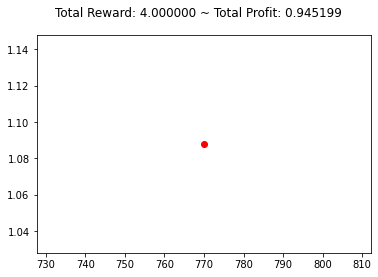

{'total_reward': 3.000000000015195, 'total_profit': 0.9448512326523743, 'position': 1}


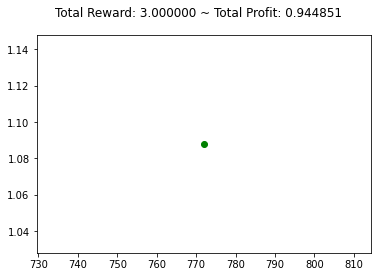

{'total_reward': 2.0000000000175255, 'total_profit': 0.9446774988594807, 'position': 1}


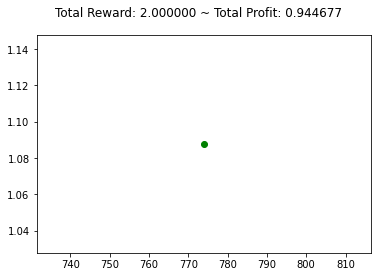

{'total_reward': 1.7745804825608502e-11, 'total_profit': 0.9446774988594807, 'position': 0}


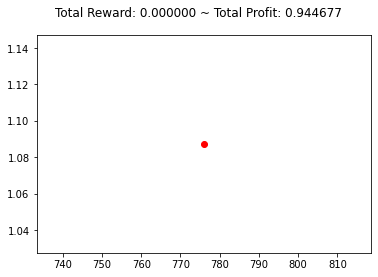

{'total_reward': 2.0000000000175255, 'total_profit': 0.9445906159845742, 'position': 0}


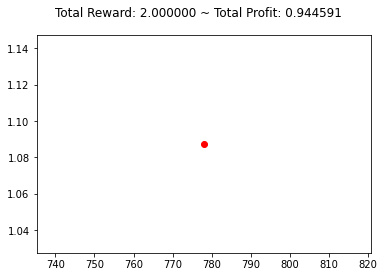

{'total_reward': 2.0000000000175255, 'total_profit': 0.9445906159845742, 'position': 0}


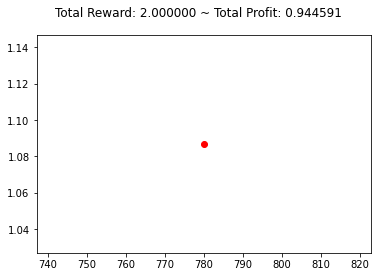

{'total_reward': 8.000000000016865, 'total_profit': 0.9448513845359641, 'position': 1}


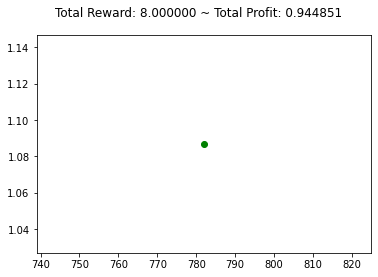

{'total_reward': 8.000000000016865, 'total_profit': 0.9448513845359641, 'position': 1}


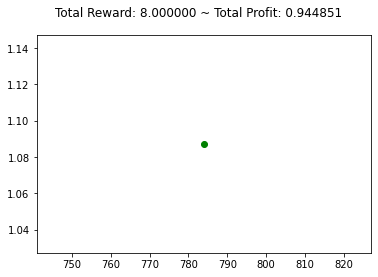

{'total_reward': 12.000000000016424, 'total_profit': 0.9445906399721145, 'position': 1}


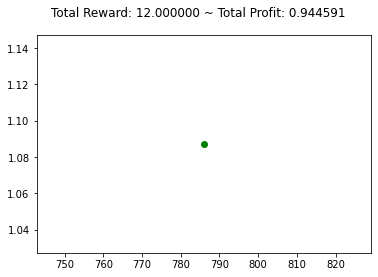

{'total_reward': 15.000000000016094, 'total_profit': 0.9445906399721145, 'position': 1}


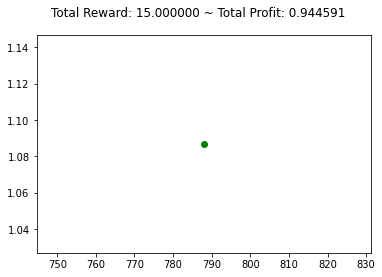

{'total_reward': 15.000000000016094, 'total_profit': 0.9445906399721145, 'position': 0}


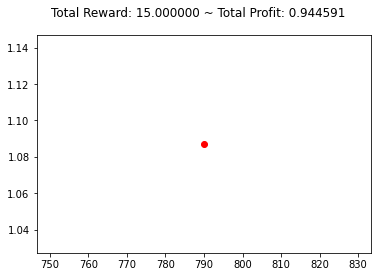

{'total_reward': 12.000000000016424, 'total_profit': 0.9440692947564183, 'position': 1}


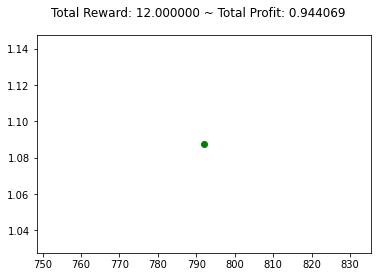

{'total_reward': 12.000000000016424, 'total_profit': 0.9440692947564183, 'position': 1}


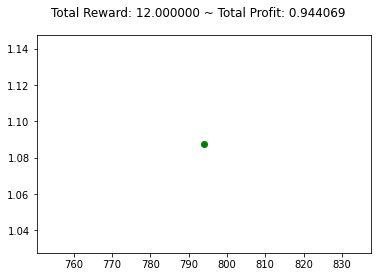

{'total_reward': 12.000000000016424, 'total_profit': 0.9440692947564183, 'position': 1}


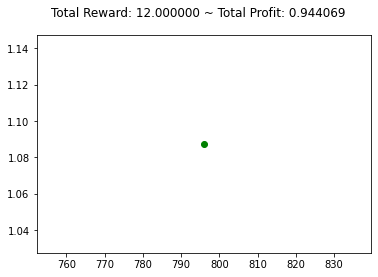

{'total_reward': 16.000000000015984, 'total_profit': 0.9438088618475201, 'position': 1}


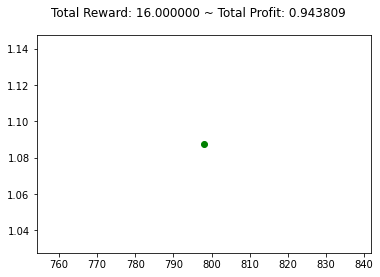

{'total_reward': 16.000000000015984, 'total_profit': 0.9438088618475201, 'position': 1}


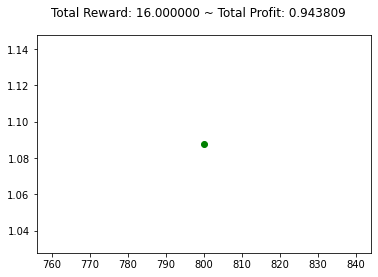

{'total_reward': 18.000000000017984, 'total_profit': 0.9434618414001086, 'position': 1}


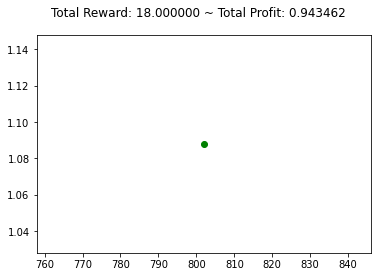

{'total_reward': 18.000000000017984, 'total_profit': 0.9434618414001086, 'position': 1}


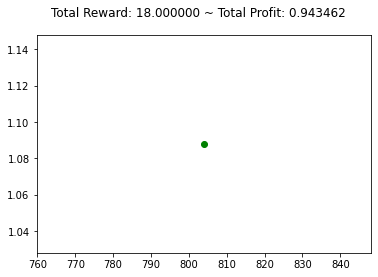

{'total_reward': 18.000000000017984, 'total_profit': 0.9434618414001086, 'position': 1}


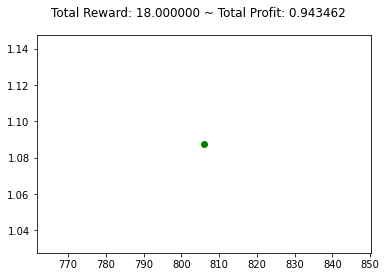

{'total_reward': 18.000000000017984, 'total_profit': 0.9434618414001086, 'position': 1}


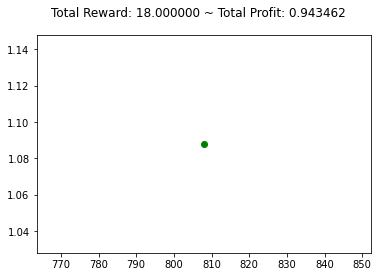

{'total_reward': 14.000000000016204, 'total_profit': 0.9434618414001086, 'position': 0}


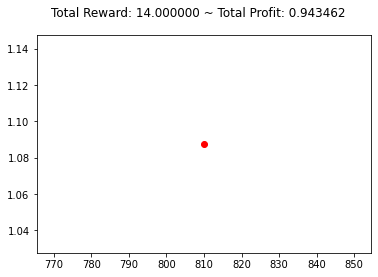

{'total_reward': 17.000000000015874, 'total_profit': 0.9434618414001086, 'position': 1}


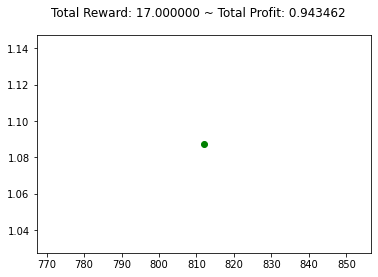

{'total_reward': 19.000000000015653, 'total_profit': 0.9434618414001086, 'position': 0}


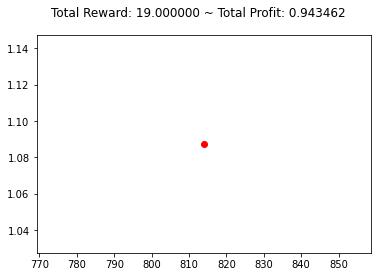

{'total_reward': 19.000000000015653, 'total_profit': 0.9432015521299044, 'position': 1}


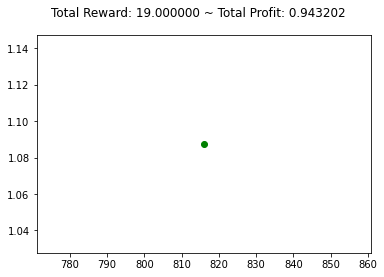

{'total_reward': 18.000000000015763, 'total_profit': 0.9427679759820099, 'position': 1}


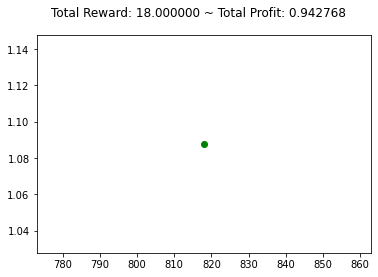

{'total_reward': 17.000000000013653, 'total_profit': 0.9424213063824576, 'position': 1}


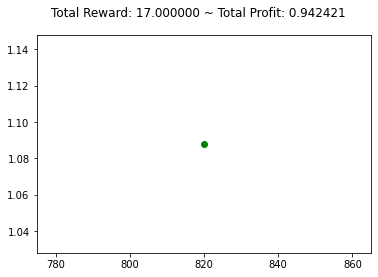

{'total_reward': 16.000000000011543, 'total_profit': 0.9424213063824576, 'position': 0}


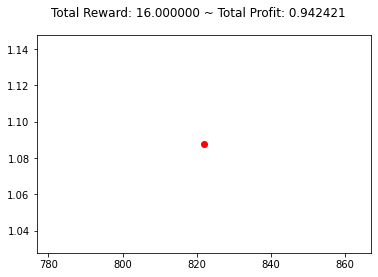

{'total_reward': 15.000000000009432, 'total_profit': 0.9420747642583969, 'position': 1}


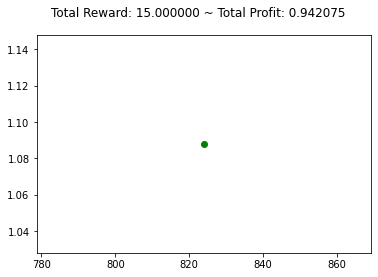

{'total_reward': 14.000000000007322, 'total_profit': 0.9420747642583969, 'position': 0}


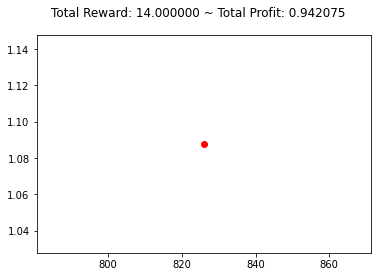

{'total_reward': 17.00000000000699, 'total_profit': 0.9420747642583968, 'position': 1}


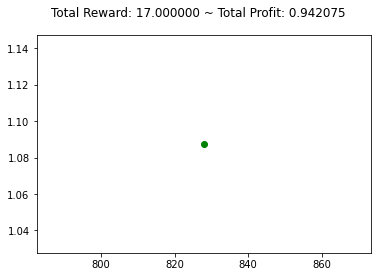

{'total_reward': 16.000000000007102, 'total_profit': 0.9420747642583968, 'position': 0}


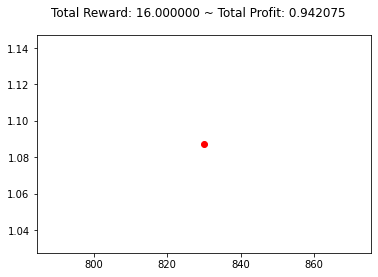

{'total_reward': 19.00000000000677, 'total_profit': 0.9420747642583966, 'position': 1}


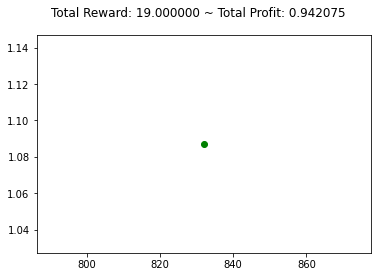

{'total_reward': 16.000000000007102, 'total_profit': 0.9420747642583966, 'position': 0}


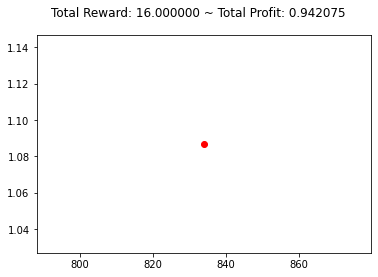

{'total_reward': 19.00000000000677, 'total_profit': 0.941901365627022, 'position': 0}


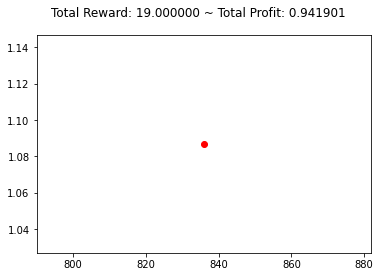

{'total_reward': 20.00000000000666, 'total_profit': 0.9417280148649669, 'position': 1}


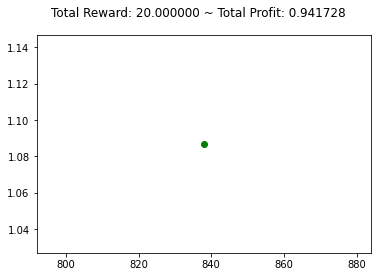

{'total_reward': 17.00000000000699, 'total_profit': 0.9414679647872244, 'position': 1}


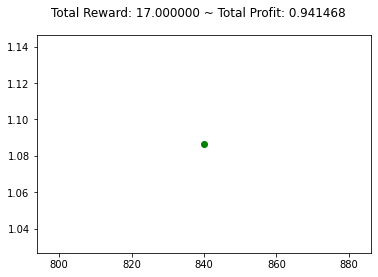

{'total_reward': 18.00000000000688, 'total_profit': 0.9414679647872244, 'position': 0}


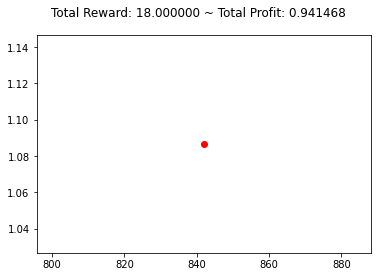

{'total_reward': 19.00000000000677, 'total_profit': 0.941294645942455, 'position': 0}


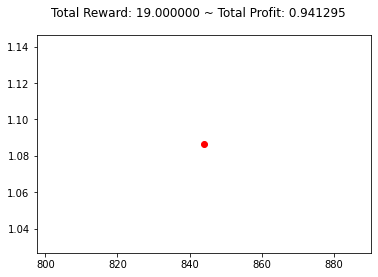

{'total_reward': 19.00000000000677, 'total_profit': 0.941294645942455, 'position': 0}


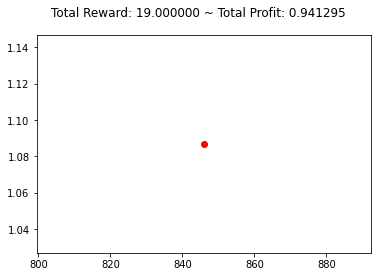

{'total_reward': 17.00000000000699, 'total_profit': 0.9407749286446125, 'position': 0}


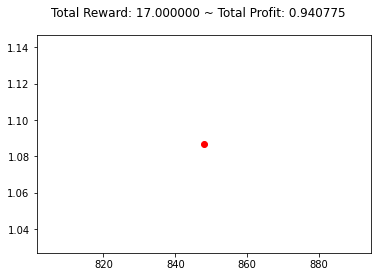

{'total_reward': 11.000000000007653, 'total_profit': 0.9399962846904283, 'position': 1}


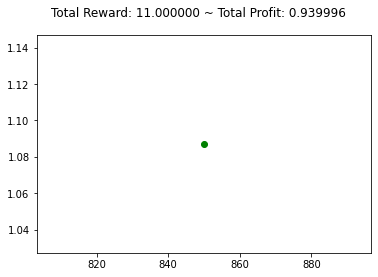

{'total_reward': 8.000000000007983, 'total_profit': 0.9397368799572784, 'position': 1}


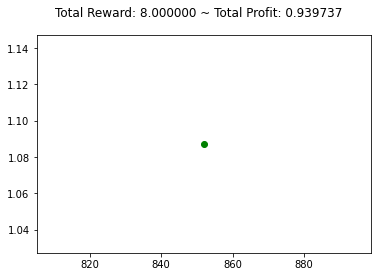

{'total_reward': 10.000000000007763, 'total_profit': 0.9395639911926833, 'position': 1}


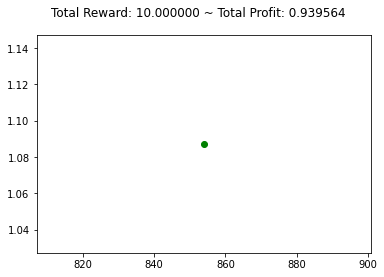

{'total_reward': 9.000000000007873, 'total_profit': 0.9393046819034858, 'position': 1}


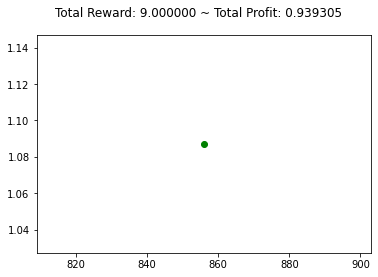

{'total_reward': 12.000000000007542, 'total_profit': 0.9393046819034858, 'position': 0}


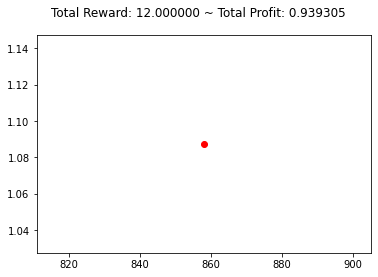

{'total_reward': 12.000000000007542, 'total_profit': 0.9390455157077983, 'position': 1}


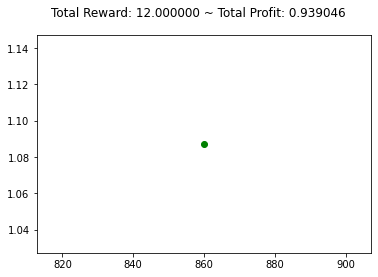

{'total_reward': 11.000000000007653, 'total_profit': 0.9388727382440065, 'position': 1}


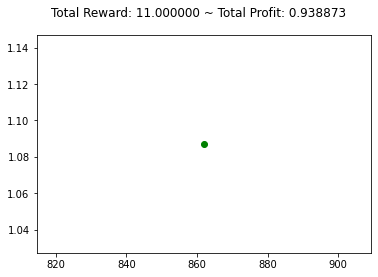

{'total_reward': 13.000000000007432, 'total_profit': 0.9386999925699966, 'position': 1}


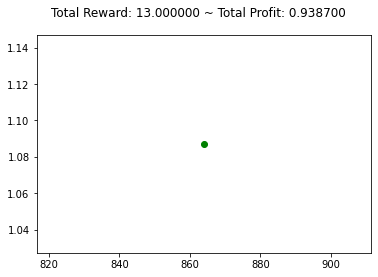

{'total_reward': 9.000000000007873, 'total_profit': 0.9386999925699966, 'position': 0}


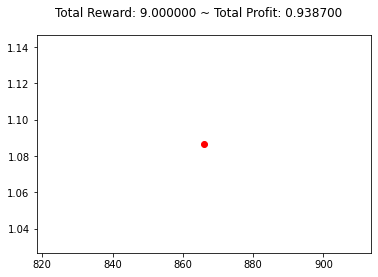

{'total_reward': 11.000000000007653, 'total_profit': 0.9386135879315053, 'position': 1}


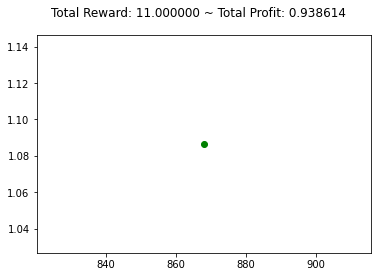

{'total_reward': 13.000000000007432, 'total_profit': 0.9386135879315053, 'position': 0}


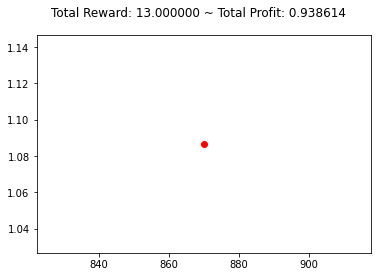

{'total_reward': 10.000000000007763, 'total_profit': 0.9381817634983385, 'position': 0}


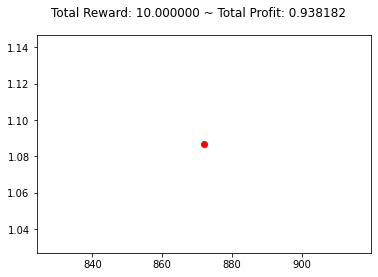

{'total_reward': 14.000000000007322, 'total_profit': 0.9380954145095213, 'position': 0}


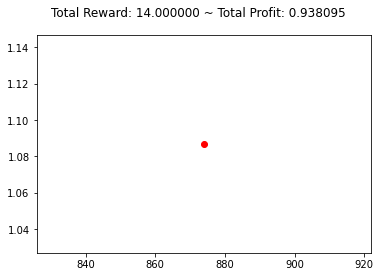

{'total_reward': 14.000000000007322, 'total_profit': 0.9380954145095213, 'position': 0}


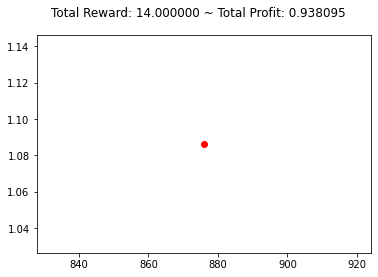

{'total_reward': 19.00000000000677, 'total_profit': 0.9382681442857153, 'position': 1}


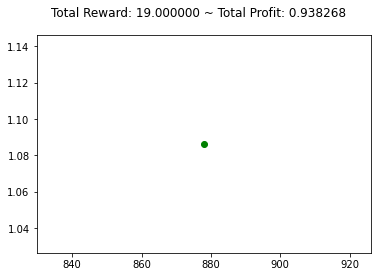

{'total_reward': 16.000000000007102, 'total_profit': 0.9380089303219197, 'position': 1}


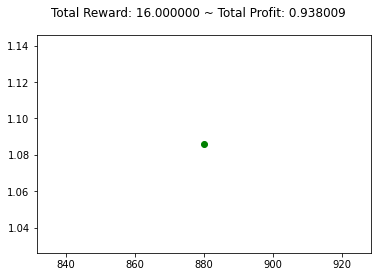

{'total_reward': 12.000000000005322, 'total_profit': 0.9380089303219197, 'position': 0}


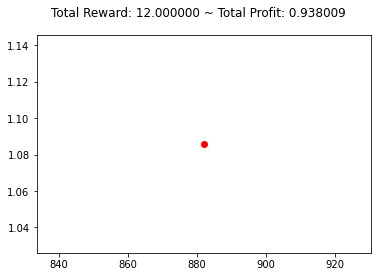

{'total_reward': 9.000000000003432, 'total_profit': 0.9374042648359399, 'position': 0}


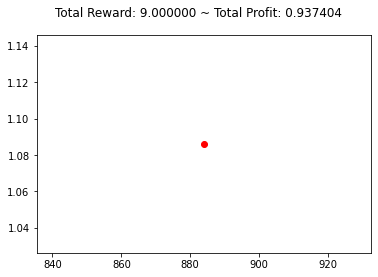

{'total_reward': 10.000000000003322, 'total_profit': 0.937231614635215, 'position': 1}


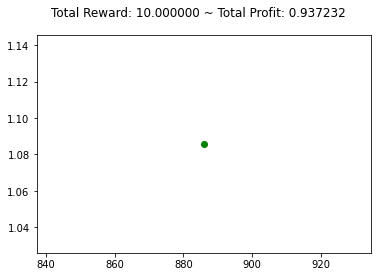

{'total_reward': 10.000000000003322, 'total_profit': 0.937231614635215, 'position': 1}


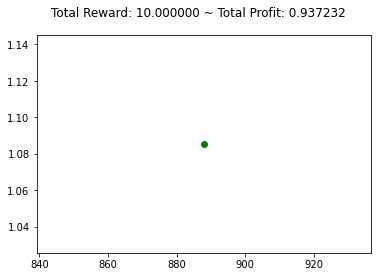

{'total_reward': 6.000000000001542, 'total_profit': 0.937231614635215, 'position': 0}


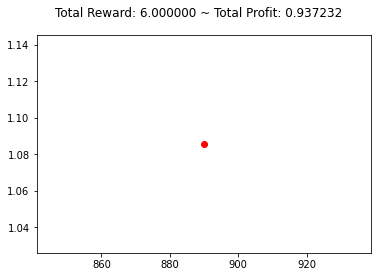

{'total_reward': 6.000000000001542, 'total_profit': 0.937231614635215, 'position': 0}


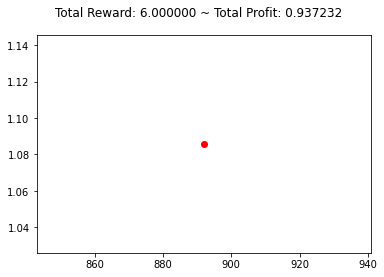

{'total_reward': 4.999999999999432, 'total_profit': 0.9367999891334026, 'position': 0}


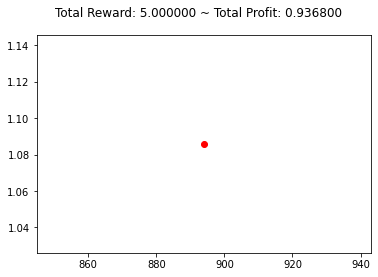

{'total_reward': 8.000000000001322, 'total_profit': 0.9367999891334027, 'position': 1}


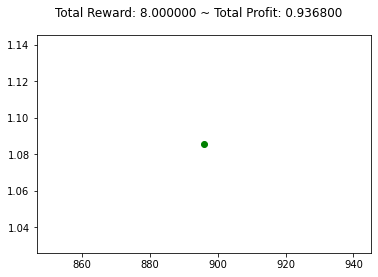

{'total_reward': 8.000000000001322, 'total_profit': 0.9367999891334027, 'position': 1}


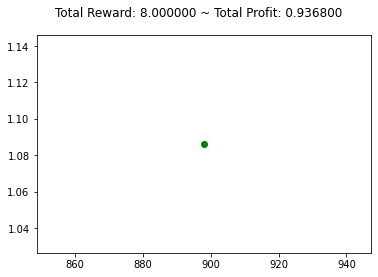

{'total_reward': 11.000000000003212, 'total_profit': 0.9367999891334027, 'position': 0}


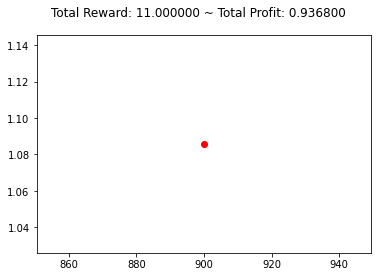

{'total_reward': 11.000000000003212, 'total_profit': 0.9367999891334027, 'position': 0}


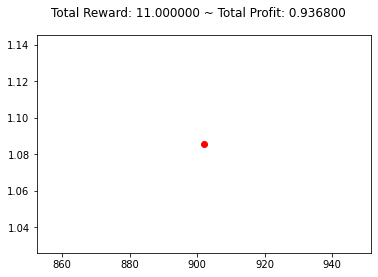

{'total_reward': 12.000000000003102, 'total_profit': 0.9366274184436848, 'position': 1}


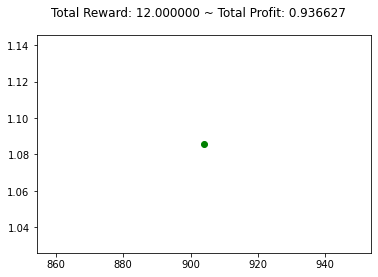

{'total_reward': 6.000000000001542, 'total_profit': 0.9366274184436848, 'position': 0}


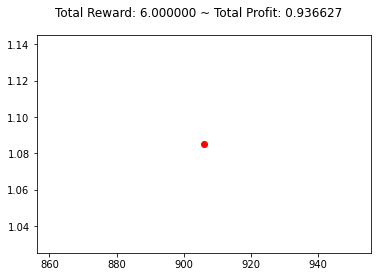

{'total_reward': 7.000000000001432, 'total_profit': 0.9364547682283034, 'position': 1}


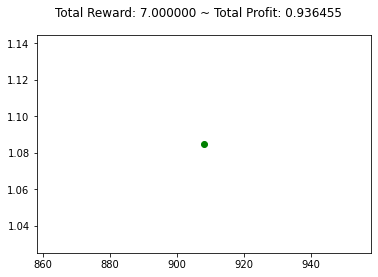

{'total_reward': 2.0000000000019824, 'total_profit': 0.9364547682283034, 'position': 0}


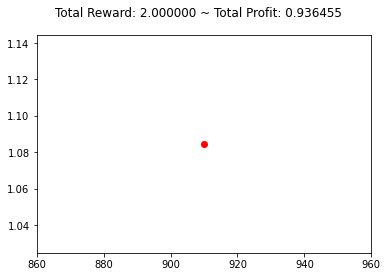

{'total_reward': 3.0000000000018723, 'total_profit': 0.9362820543278555, 'position': 1}


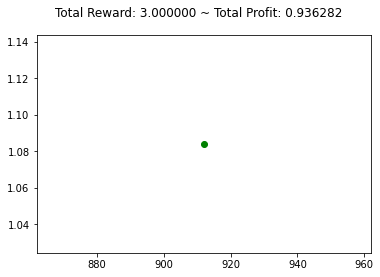

{'total_reward': 2.2026824808563106e-12, 'total_profit': 0.9362820543278555, 'position': 0}


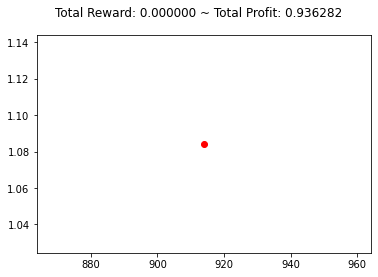

{'total_reward': 2.0000000000019824, 'total_profit': 0.9361093085613743, 'position': 0}


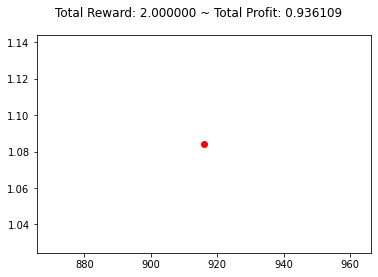

{'total_reward': 2.0000000000019824, 'total_profit': 0.9361093085613743, 'position': 0}


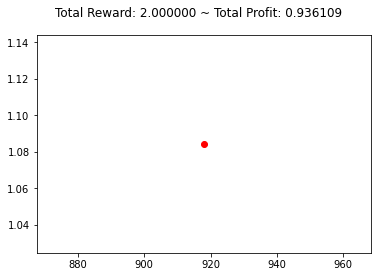

{'total_reward': -0.9999999999976872, 'total_profit': 0.9355913580033359, 'position': 1}


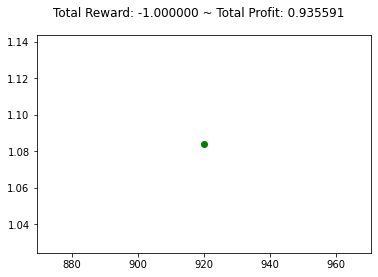

{'total_reward': -4.999999999997247, 'total_profit': 0.9355913580033359, 'position': 0}


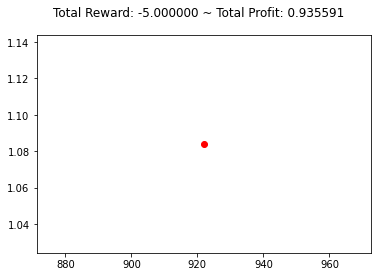

{'total_reward': -2.999999999997467, 'total_profit': 0.9355050329103296, 'position': 1}


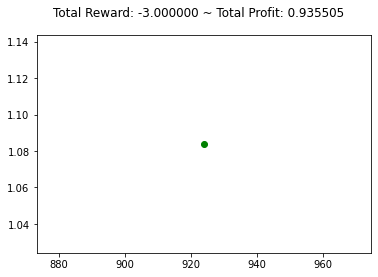

{'total_reward': -5.999999999999357, 'total_profit': 0.9355050329103296, 'position': 0}


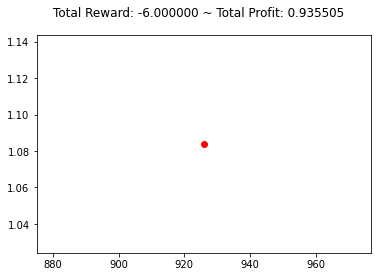

{'total_reward': -14.000000000000696, 'total_profit': 0.9346421800852878, 'position': 0}


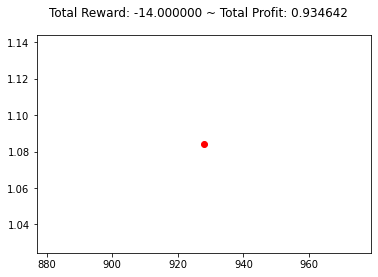

{'total_reward': -14.000000000000696, 'total_profit': 0.9346421800852878, 'position': 0}


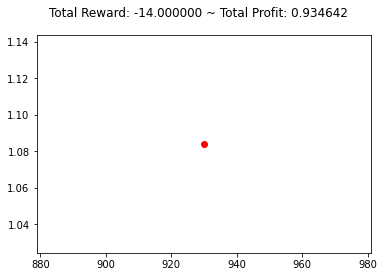

{'total_reward': -6.999999999999247, 'total_profit': 0.934987257500863, 'position': 1}


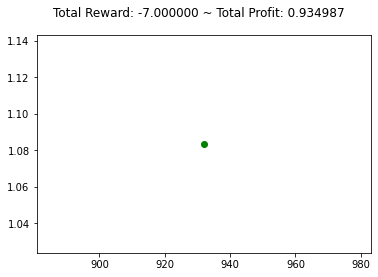

{'total_reward': -7.999999999999137, 'total_profit': 0.9346420845400875, 'position': 1}


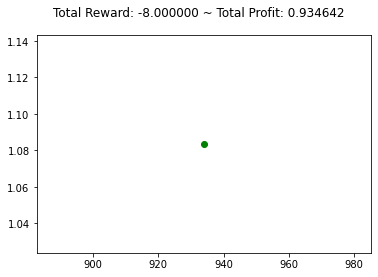

{'total_reward': -2.999999999997467, 'total_profit': 0.9346420845400875, 'position': 0}


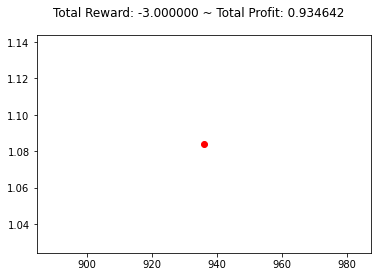

{'total_reward': -2.999999999997467, 'total_profit': 0.9346420845400875, 'position': 0}


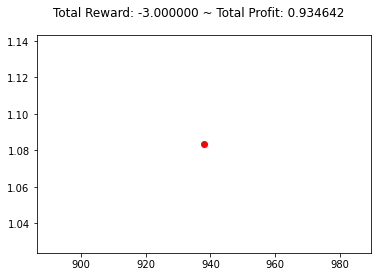

{'total_reward': -2.999999999997467, 'total_profit': 0.9346420845400875, 'position': 0}


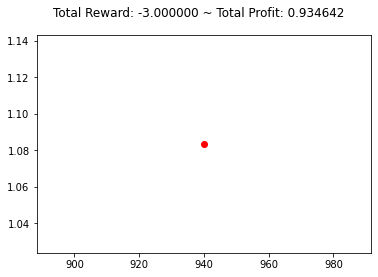

{'total_reward': 2.2026824808563106e-12, 'total_profit': 0.9346420845400875, 'position': 1}


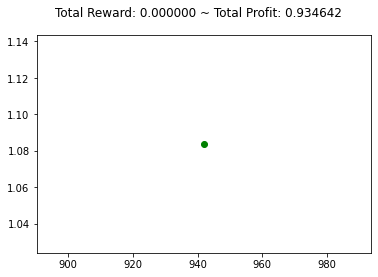

{'total_reward': -6.999999999999247, 'total_profit': 0.9346420845400875, 'position': 0}


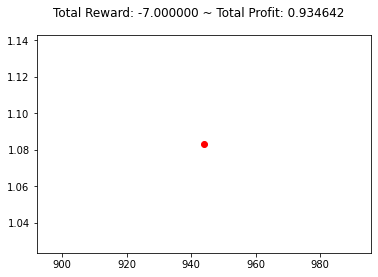

{'total_reward': -6.999999999999247, 'total_profit': 0.9346420845400875, 'position': 0}


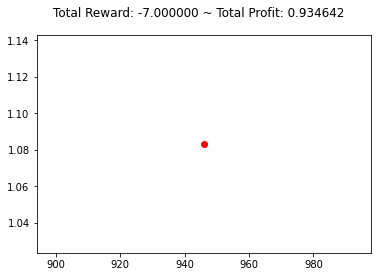

{'total_reward': -4.999999999999467, 'total_profit': 0.9345557673915337, 'position': 1}


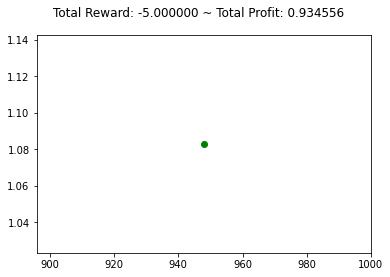

{'total_reward': -8.999999999999027, 'total_profit': 0.9341242215070714, 'position': 1}


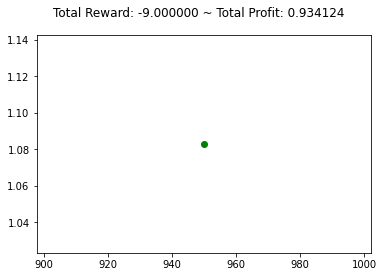

{'total_reward': -6.999999999999247, 'total_profit': 0.9341242215070714, 'position': 0}


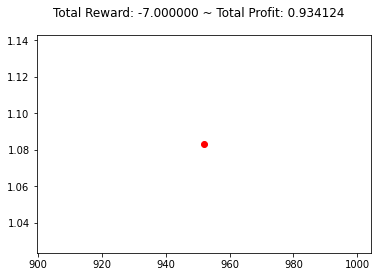

{'total_reward': -1.9999999999997975, 'total_profit': 0.9340379521848046, 'position': 0}


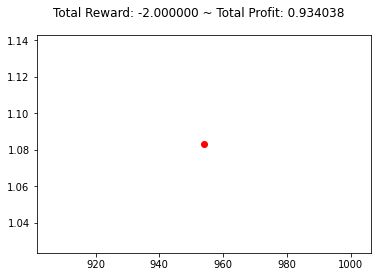

{'total_reward': -1.9999999999997975, 'total_profit': 0.9340379521848046, 'position': 0}


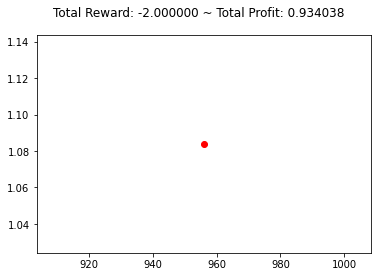

{'total_reward': -1.9999999999997975, 'total_profit': 0.9340379521848046, 'position': 0}


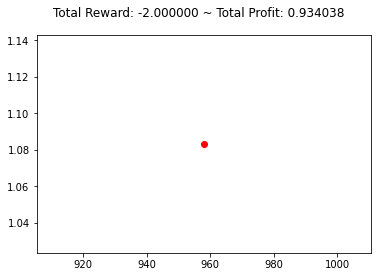

{'total_reward': -0.9999999999999076, 'total_profit': 0.9338654613349089, 'position': 1}


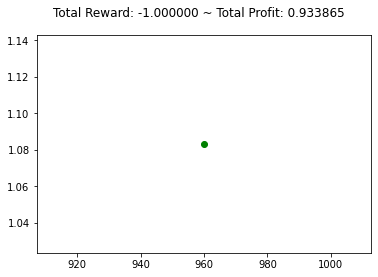

{'total_reward': -3.9999999999995772, 'total_profit': 0.9333482276260554, 'position': 1}


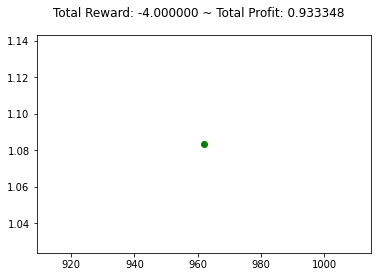

{'total_reward': -1.9999999999997975, 'total_profit': 0.9333482276260554, 'position': 0}


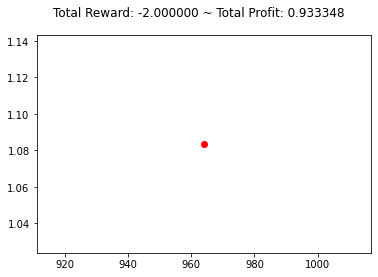

{'total_reward': -1.9999999999997975, 'total_profit': 0.9333482276260554, 'position': 0}


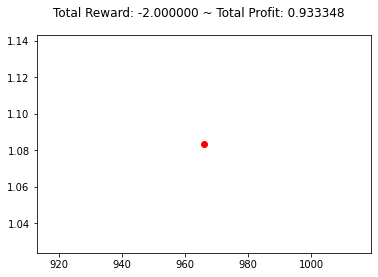

{'total_reward': -1.7763568394002505e-14, 'total_profit': 0.9332620697540324, 'position': 1}


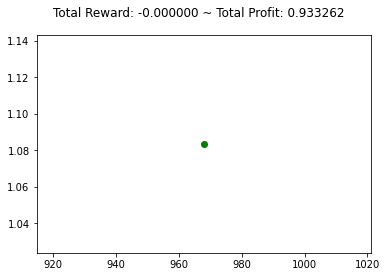

{'total_reward': 1.999999999999762, 'total_profit': 0.9332620697540324, 'position': 0}


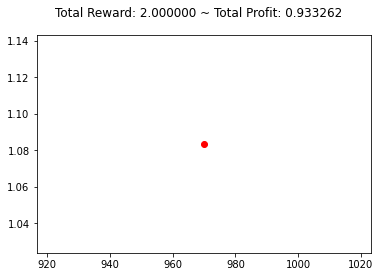

{'total_reward': 1.999999999999762, 'total_profit': 0.9330036677042619, 'position': 1}


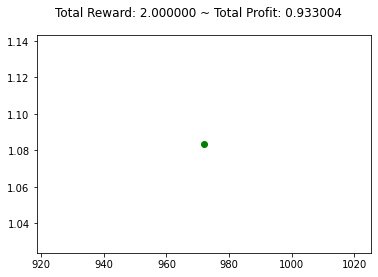

{'total_reward': 0.9999999999998721, 'total_profit': 0.9330036677042619, 'position': 0}


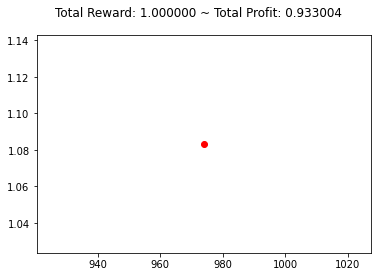

{'total_reward': 4.999999999999432, 'total_profit': 0.9329175336876718, 'position': 0}


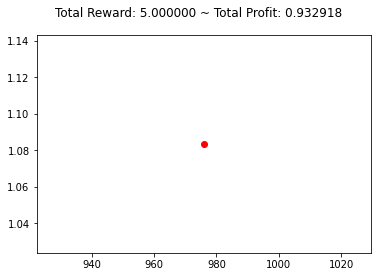

{'total_reward': 7.999999999999101, 'total_profit': 0.9329175336876718, 'position': 1}


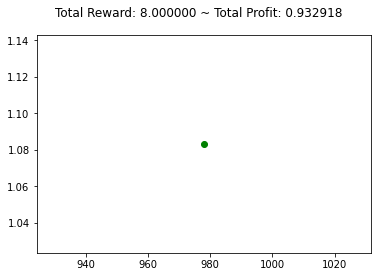

{'total_reward': 7.999999999999101, 'total_profit': 0.9329175336876718, 'position': 1}


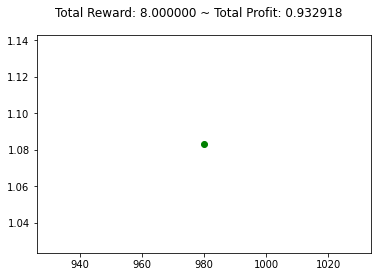

{'total_reward': 9.999999999998881, 'total_profit': 0.9329175336876718, 'position': 0}


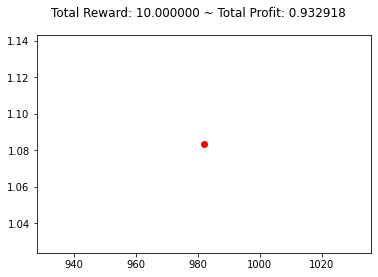

{'total_reward': 9.999999999998881, 'total_profit': 0.9329175336876718, 'position': 0}


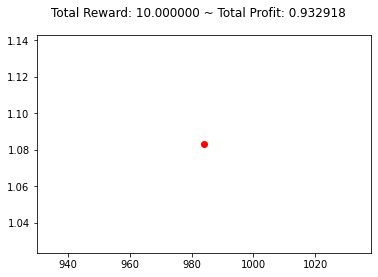

{'total_reward': 12.99999999999855, 'total_profit': 0.9329175336876719, 'position': 1}


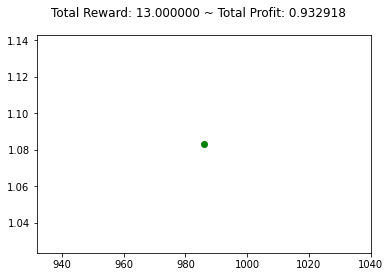

{'total_reward': 13.99999999999844, 'total_profit': 0.9329175336876719, 'position': 0}


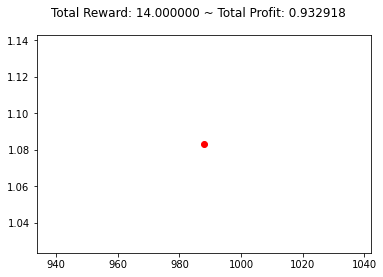

{'total_reward': 11.99999999999866, 'total_profit': 0.932486943115491, 'position': 1}


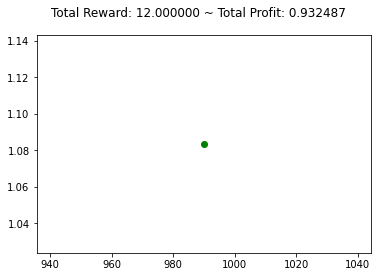

{'total_reward': 11.99999999999866, 'total_profit': 0.932486943115491, 'position': 0}


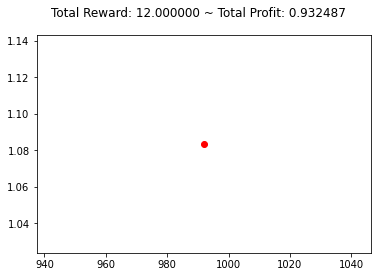

{'total_reward': 11.99999999999866, 'total_profit': 0.932486943115491, 'position': 0}


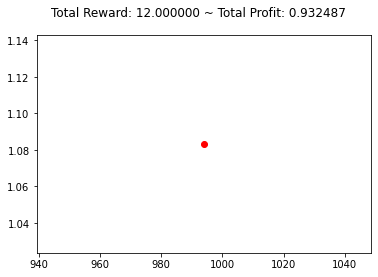

{'total_reward': 11.99999999999866, 'total_profit': 0.932486943115491, 'position': 0}


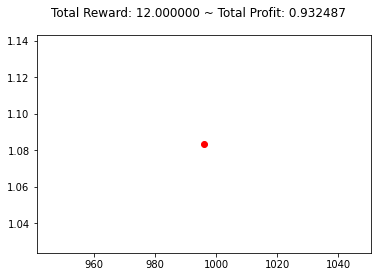

{'total_reward': 10.99999999999877, 'total_profit': 0.932142661430752, 'position': 1}


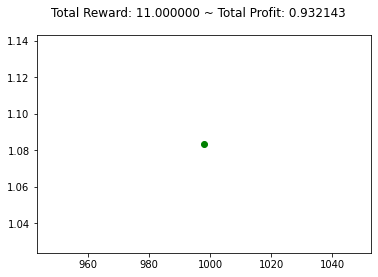

{'total_reward': 10.99999999999877, 'total_profit': 0.9319705523721422, 'position': 1}


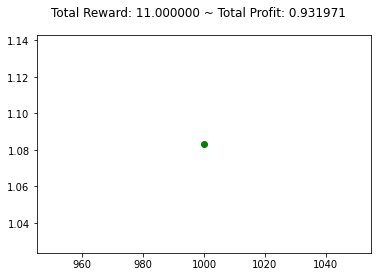

{'total_reward': 10.99999999999877, 'total_profit': 0.9319705523721422, 'position': 1}


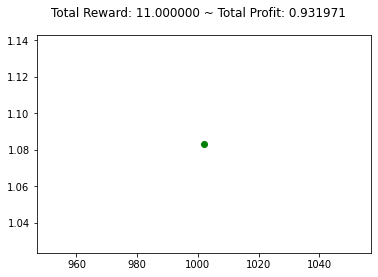

{'total_reward': 10.99999999999877, 'total_profit': 0.9319705523721422, 'position': 1}


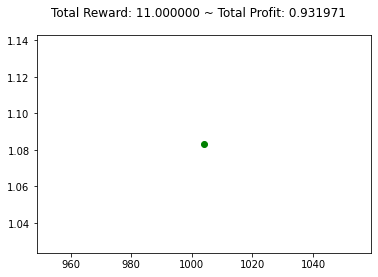

{'total_reward': 9.999999999998881, 'total_profit': 0.9319705523721422, 'position': 0}


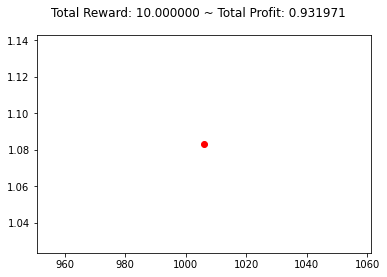

{'total_reward': 9.999999999998881, 'total_profit': 0.9317124126198464, 'position': 1}


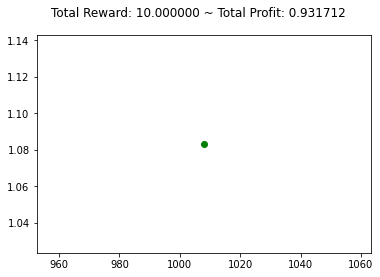

{'total_reward': 8.999999999998991, 'total_profit': 0.9317124126198464, 'position': 0}


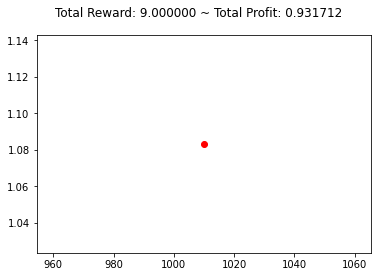

{'total_reward': 8.999999999998991, 'total_profit': 0.9314543205387883, 'position': 1}


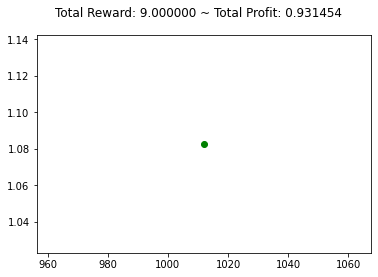

{'total_reward': 8.999999999998991, 'total_profit': 0.9314543205387883, 'position': 1}


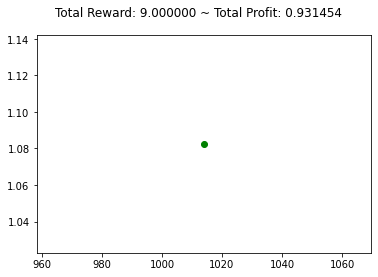

{'total_reward': 4.999999999999432, 'total_profit': 0.9314543205387883, 'position': 0}


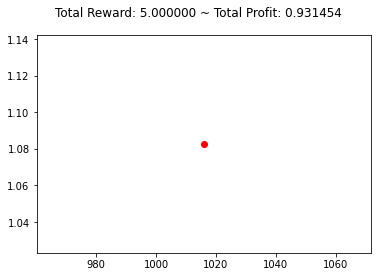

{'total_reward': 4.999999999999432, 'total_profit': 0.9314543205387883, 'position': 0}


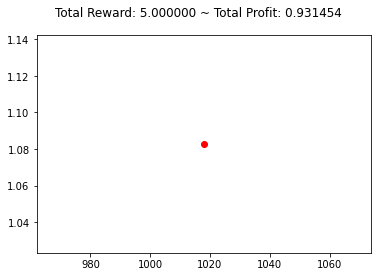

{'total_reward': 4.999999999999432, 'total_profit': 0.9311962046177079, 'position': 1}


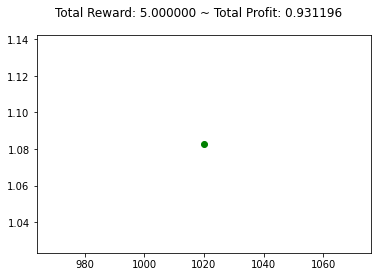

{'total_reward': 4.999999999999432, 'total_profit': 0.9311962046177079, 'position': 0}


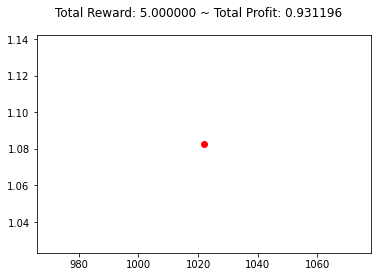

{'total_reward': 4.999999999999432, 'total_profit': 0.9311962046177079, 'position': 0}


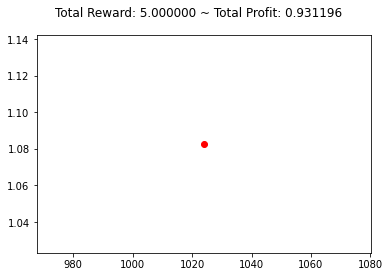

{'total_reward': 5.999999999999321, 'total_profit': 0.9310241591295569, 'position': 1}


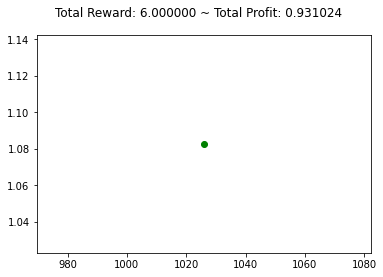

{'total_reward': 6.999999999999211, 'total_profit': 0.9310241591295569, 'position': 0}


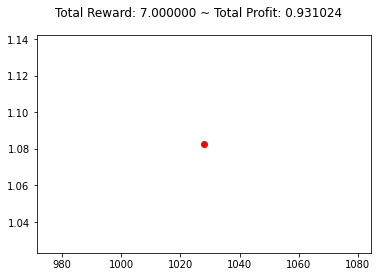

{'total_reward': 7.999999999999101, 'total_profit': 0.9308521454281012, 'position': 1}


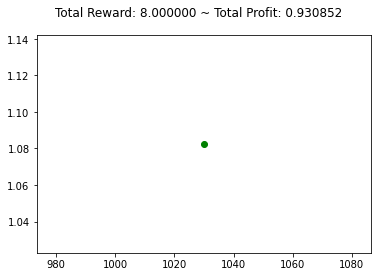

{'total_reward': 0.9999999999998721, 'total_profit': 0.9308521454281012, 'position': 0}


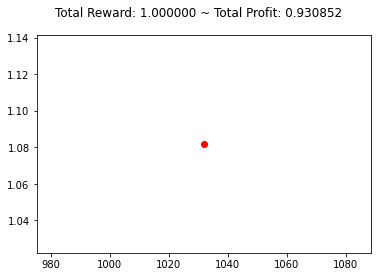

{'total_reward': 0.9999999999998721, 'total_profit': 0.9308521454281012, 'position': 0}


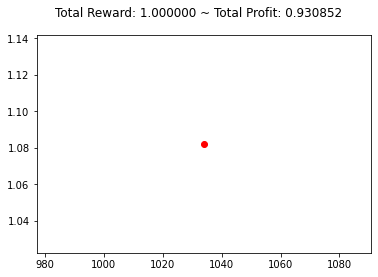

{'total_reward': -1.9999999999997975, 'total_profit': 0.930336008946023, 'position': 1}


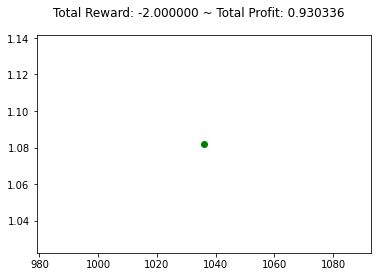

{'total_reward': -2.9999999999996874, 'total_profit': 0.930336008946023, 'position': 0}


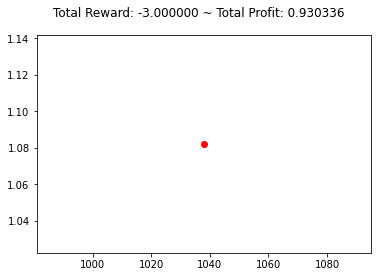

{'total_reward': -1.9999999999997975, 'total_profit': 0.9300780599601784, 'position': 0}


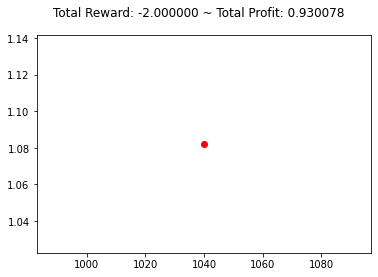

{'total_reward': -1.9999999999997975, 'total_profit': 0.9300780599601784, 'position': 0}


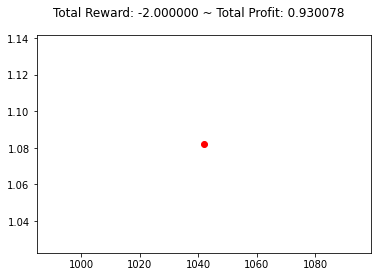

{'total_reward': -1.7763568394002505e-14, 'total_profit': 0.9299061416496497, 'position': 0}


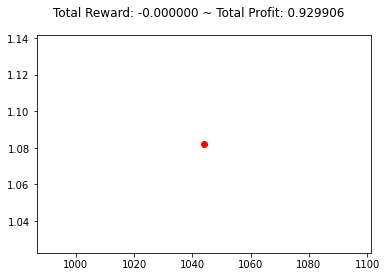

{'total_reward': -1.7763568394002505e-14, 'total_profit': 0.9296483356774706, 'position': 1}


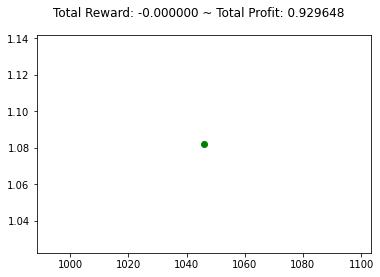

{'total_reward': -1.7763568394002505e-14, 'total_profit': 0.9294764809153526, 'position': 1}


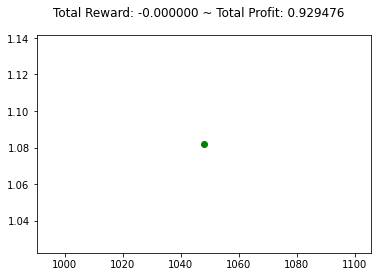

{'total_reward': -1.7763568394002505e-14, 'total_profit': 0.9292187464257744, 'position': 1}


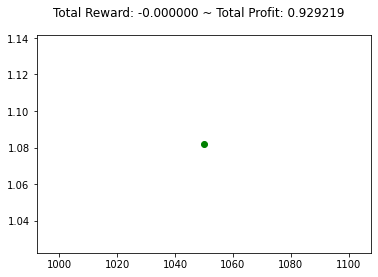

{'total_reward': -1.7763568394002505e-14, 'total_profit': 0.9288752592262823, 'position': 1}


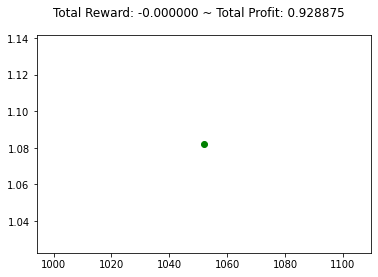

{'total_reward': -1.7763568394002505e-14, 'total_profit': 0.9288752592262823, 'position': 1}


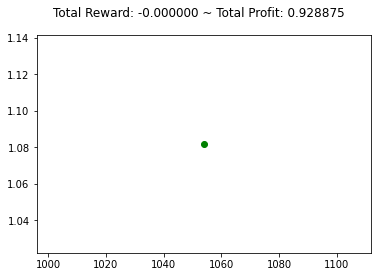

{'total_reward': -7.999999999999137, 'total_profit': 0.9281886656686912, 'position': 1}


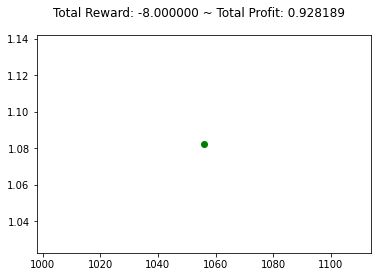

{'total_reward': -12.999999999998586, 'total_profit': 0.9281886656686912, 'position': 0}


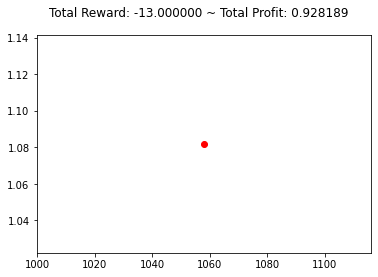

{'total_reward': -11.999999999998696, 'total_profit': 0.9280170490160761, 'position': 1}


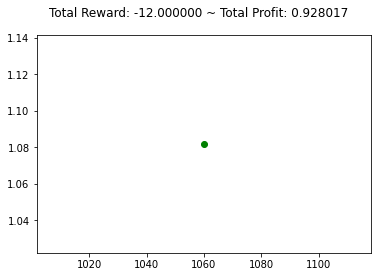

{'total_reward': -10.999999999998806, 'total_profit': 0.9280170490160761, 'position': 0}


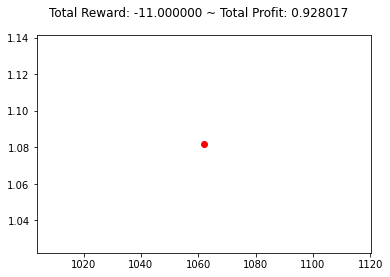

{'total_reward': -10.999999999998806, 'total_profit': 0.9280170490160761, 'position': 0}


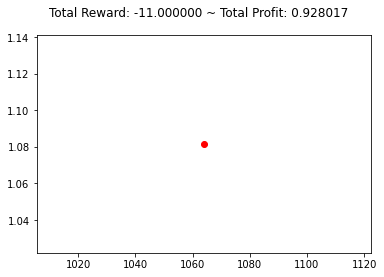

{'total_reward': -5.999999999994916, 'total_profit': 0.9280170490160763, 'position': 0}


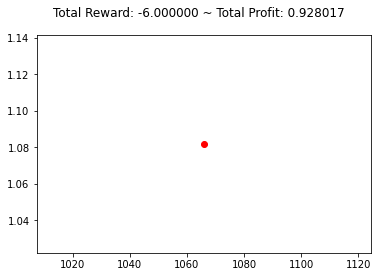

{'total_reward': -6.999999999994806, 'total_profit': 0.9276739108947911, 'position': 0}


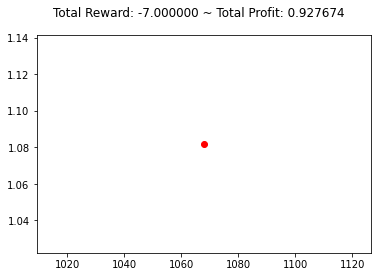

{'total_reward': -7.999999999994696, 'total_profit': 0.9273309313547616, 'position': 1}


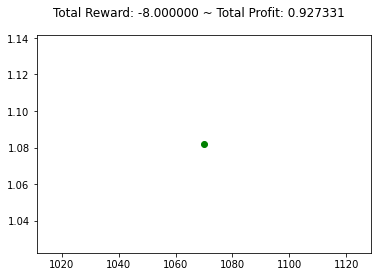

{'total_reward': -11.999999999994255, 'total_profit': 0.9268167473063255, 'position': 1}


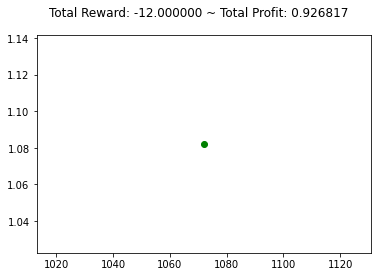

{'total_reward': -13.999999999994035, 'total_profit': 0.9268167473063255, 'position': 0}


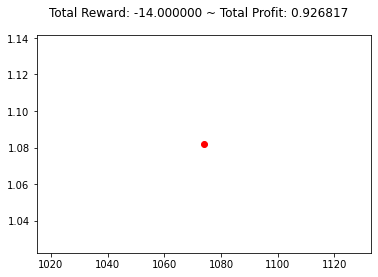

{'total_reward': -13.999999999994035, 'total_profit': 0.9268167473063255, 'position': 0}


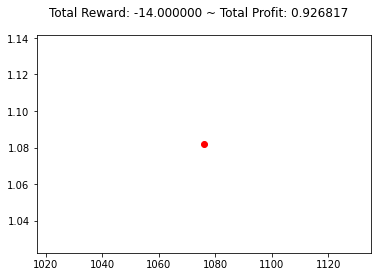

{'total_reward': -12.999999999994145, 'total_profit': 0.92664540015393, 'position': 1}


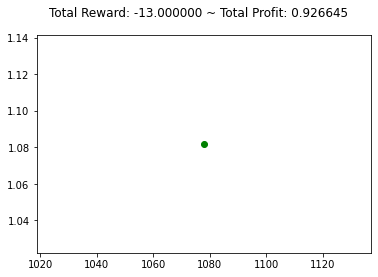

{'total_reward': -15.999999999996035, 'total_profit': 0.92664540015393, 'position': 0}


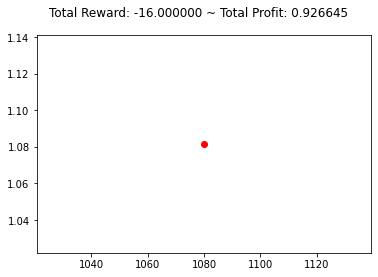

{'total_reward': -15.999999999996035, 'total_profit': 0.9263883556601288, 'position': 1}


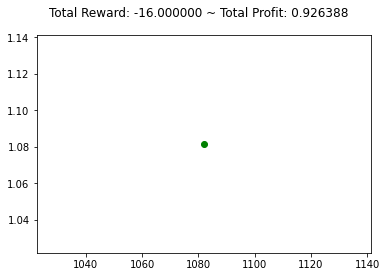

{'total_reward': -17.999999999995815, 'total_profit': 0.9263883556601288, 'position': 0}


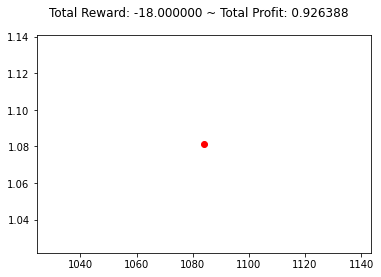

{'total_reward': -17.999999999995815, 'total_profit': 0.9263883556601288, 'position': 0}


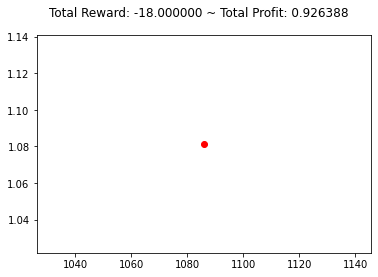

{'total_reward': -17.999999999995815, 'total_profit': 0.9261313349381293, 'position': 1}


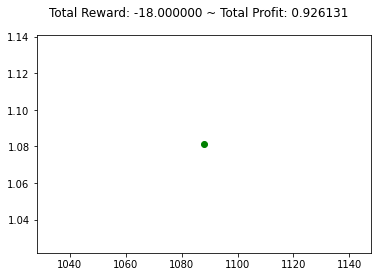

{'total_reward': -17.999999999995815, 'total_profit': 0.9261313349381293, 'position': 1}


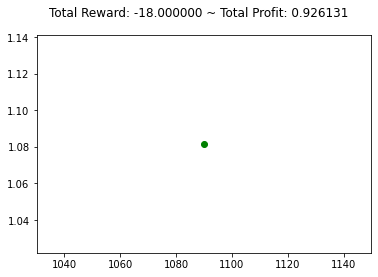

{'total_reward': -17.999999999995815, 'total_profit': 0.9261313349381293, 'position': 0}


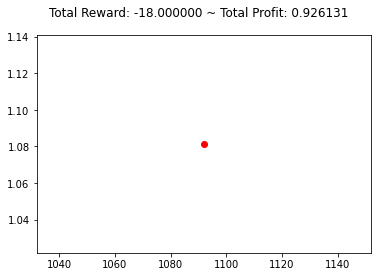

{'total_reward': -17.999999999995815, 'total_profit': 0.9261313349381293, 'position': 0}


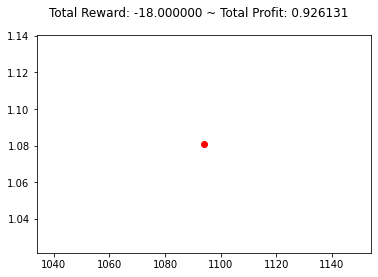

{'total_reward': -11.999999999996476, 'total_profit': 0.9263884270085293, 'position': 1}


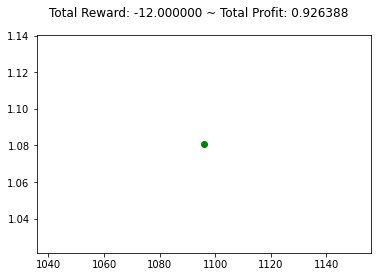

{'total_reward': -9.999999999996696, 'total_profit': 0.9259600591055381, 'position': 1}


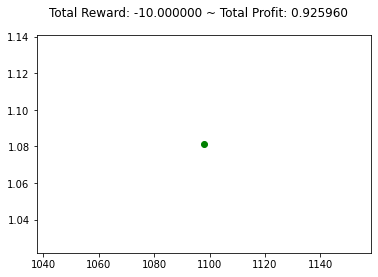

{'total_reward': -9.999999999996696, 'total_profit': 0.9259600591055381, 'position': 1}


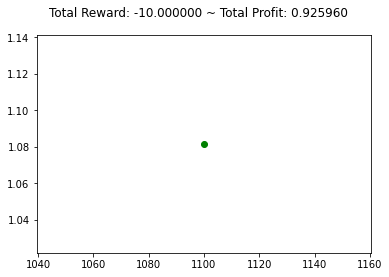

{'total_reward': -7.999999999996916, 'total_profit': 0.9257887911763593, 'position': 1}


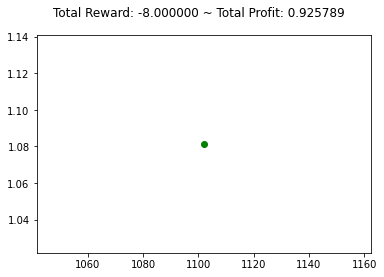

{'total_reward': -6.999999999997026, 'total_profit': 0.9257887911763593, 'position': 0}


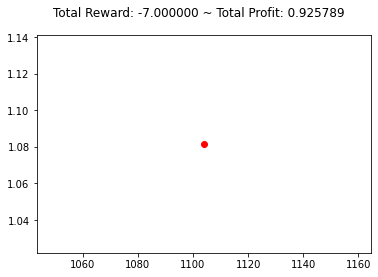

{'total_reward': -5.9999999999971365, 'total_profit': 0.9256175549253325, 'position': 1}


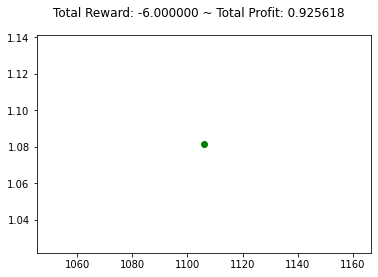

{'total_reward': -4.999999999997247, 'total_profit': 0.9256175549253325, 'position': 0}


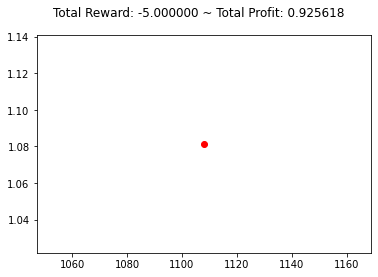

{'total_reward': -2.999999999997467, 'total_profit': 0.9255319447186245, 'position': 1}


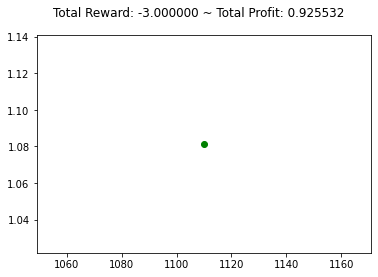

{'total_reward': -1.999999999997577, 'total_profit': 0.9255319447186245, 'position': 0}


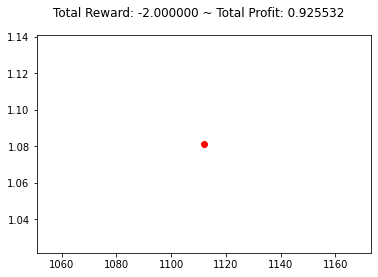

{'total_reward': -1.999999999997577, 'total_profit': 0.9255319447186245, 'position': 0}


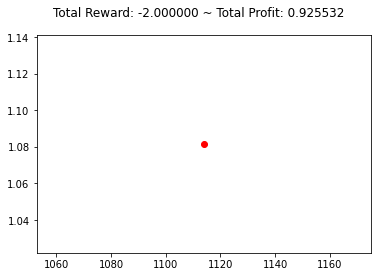

{'total_reward': -2.999999999997467, 'total_profit': 0.9251895988910978, 'position': 1}


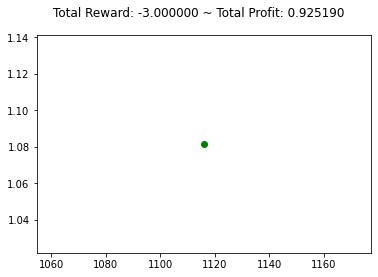

{'total_reward': -1.999999999997577, 'total_profit': 0.9249329582256632, 'position': 1}


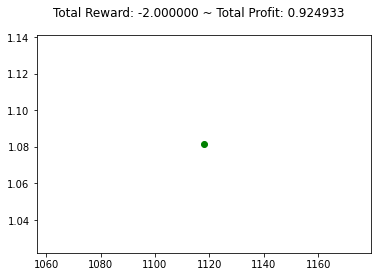

{'total_reward': 4.423128530106624e-12, 'total_profit': 0.9249329582256632, 'position': 0}


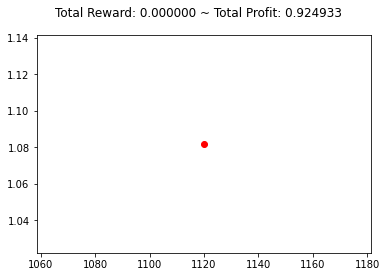

{'total_reward': 4.423128530106624e-12, 'total_profit': 0.9249329582256632, 'position': 0}


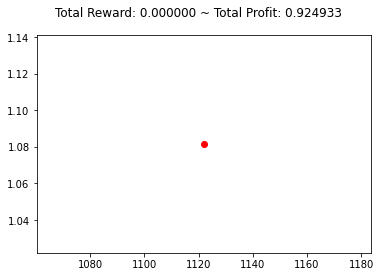

{'total_reward': 4.423128530106624e-12, 'total_profit': 0.9249329582256632, 'position': 0}


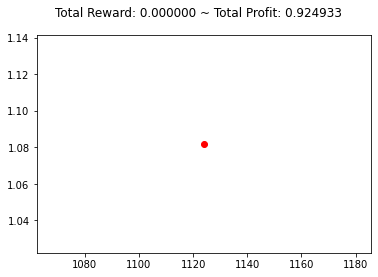

{'total_reward': -0.9999999999954667, 'total_profit': 0.9245909604596342, 'position': 1}


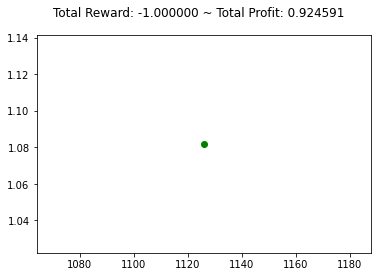

{'total_reward': -0.9999999999954667, 'total_profit': 0.924334556976423, 'position': 1}


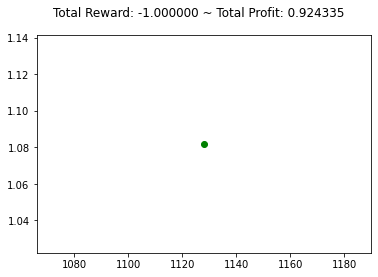

{'total_reward': -0.9999999999954667, 'total_profit': 0.9240782245978938, 'position': 1}


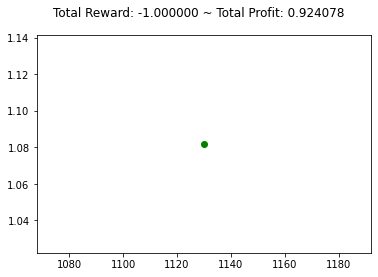

{'total_reward': -0.9999999999954667, 'total_profit': 0.9240782245978938, 'position': 1}


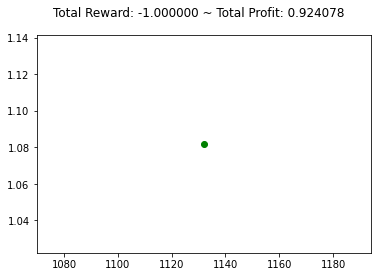

{'total_reward': -0.9999999999954667, 'total_profit': 0.9240782245978938, 'position': 1}


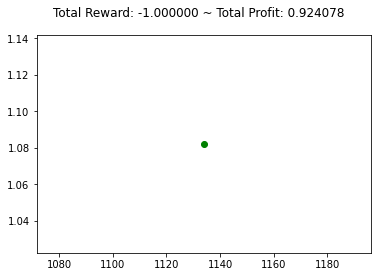

{'total_reward': 1.000000000004313, 'total_profit': 0.9239073837355167, 'position': 1}


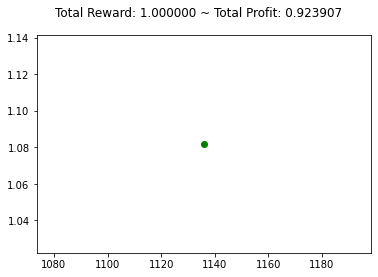

{'total_reward': 4.423128530106624e-12, 'total_profit': 0.9235657967556719, 'position': 1}


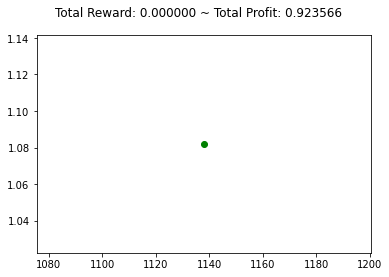

{'total_reward': 4.423128530106624e-12, 'total_profit': 0.9235657967556719, 'position': 0}


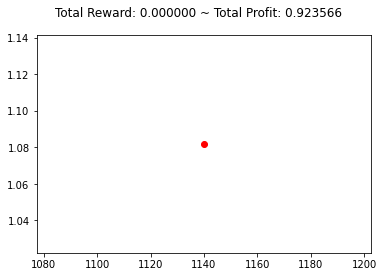

{'total_reward': 1.000000000004313, 'total_profit': 0.923395050629446, 'position': 0}


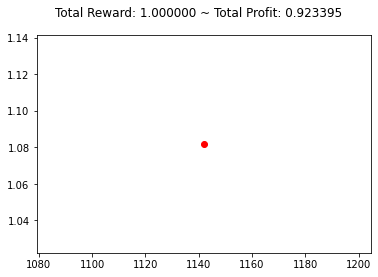

{'total_reward': 1.000000000004313, 'total_profit': 0.9231389787906692, 'position': 1}


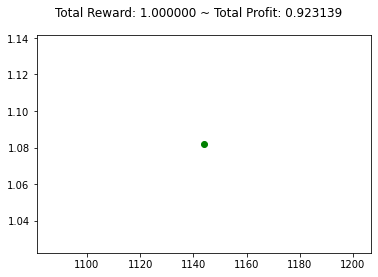

{'total_reward': 1.000000000004313, 'total_profit': 0.9231389787906692, 'position': 0}


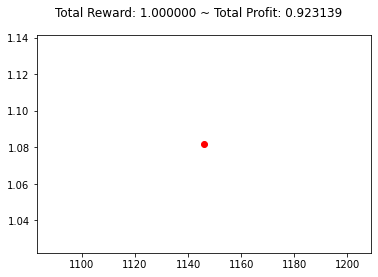

{'total_reward': 1.000000000004313, 'total_profit': 0.9228829779646042, 'position': 1}


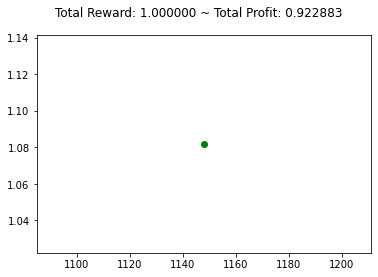

{'total_reward': 1.000000000004313, 'total_profit': 0.9228829779646042, 'position': 1}


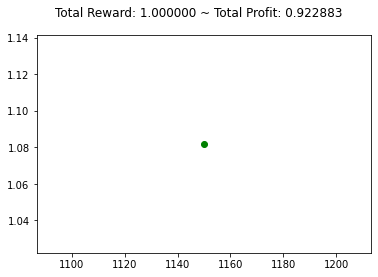

{'total_reward': 1.000000000004313, 'total_profit': 0.9228829779646042, 'position': 1}


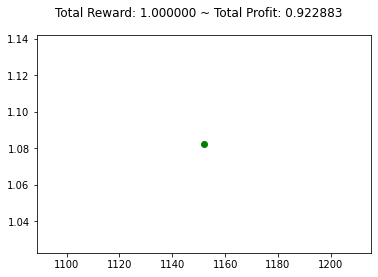

{'total_reward': 1.000000000004313, 'total_profit': 0.9228829779646042, 'position': 1}


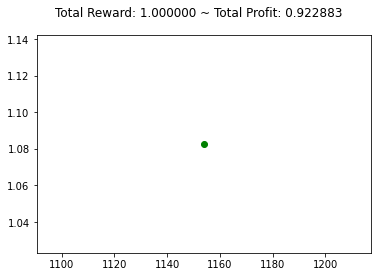

{'total_reward': 3.0000000000040927, 'total_profit': 0.9228829779646042, 'position': 0}


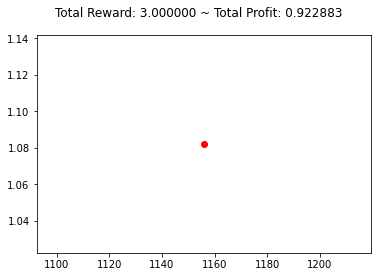

{'total_reward': 3.0000000000040927, 'total_profit': 0.9226270954383663, 'position': 1}


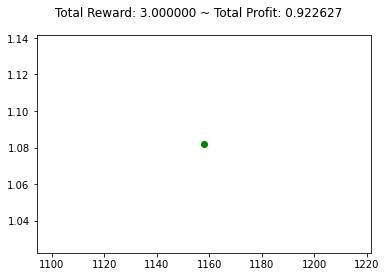

{'total_reward': 4.000000000003983, 'total_profit': 0.9226270954383663, 'position': 0}


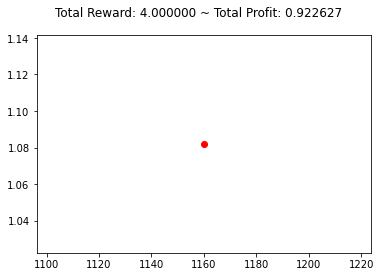

{'total_reward': 4.000000000003983, 'total_profit': 0.9226270954383663, 'position': 0}


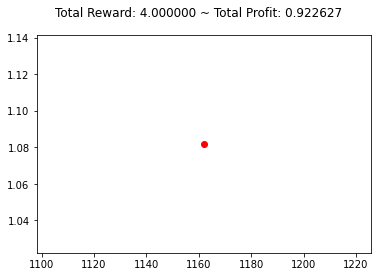

{'total_reward': 4.000000000003983, 'total_profit': 0.9226270954383663, 'position': 0}


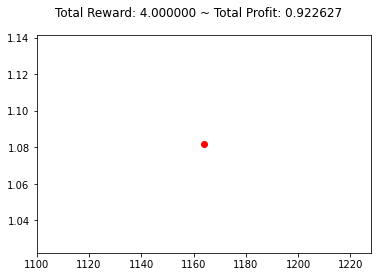

{'total_reward': 7.000000000003652, 'total_profit': 0.9226270954383663, 'position': 1}


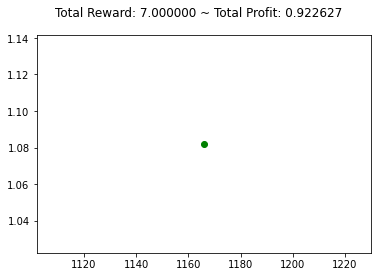

{'total_reward': 9.000000000003432, 'total_profit': 0.9224565228564772, 'position': 1}


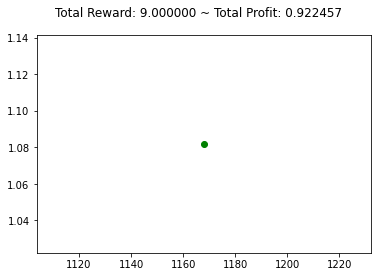

{'total_reward': 9.000000000003432, 'total_profit': 0.9224565228564772, 'position': 1}


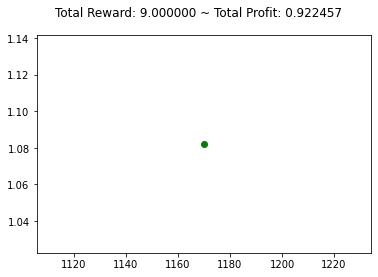

{'total_reward': 14.000000000002881, 'total_profit': 0.9224565228564772, 'position': 0}


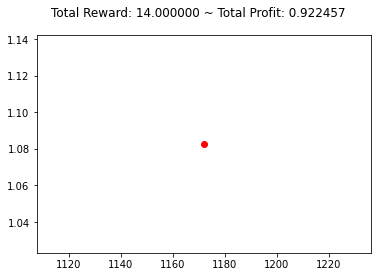

{'total_reward': 11.000000000003212, 'total_profit': 0.921860125363174, 'position': 0}


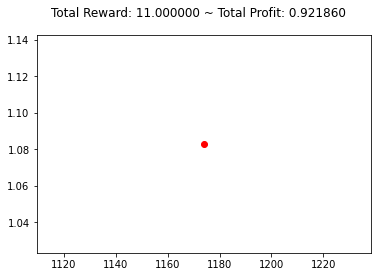

{'total_reward': 14.000000000002881, 'total_profit': 0.921860125363174, 'position': 0}


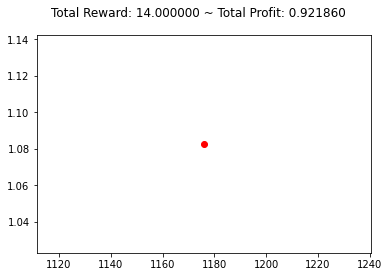

{'total_reward': 13.000000000002991, 'total_profit': 0.9215195156734037, 'position': 1}


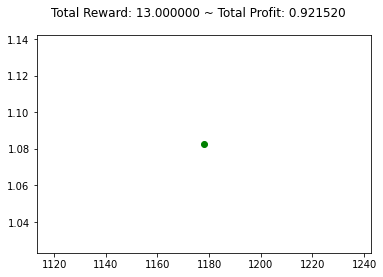

{'total_reward': 13.000000000002991, 'total_profit': 0.9215195156734037, 'position': 1}


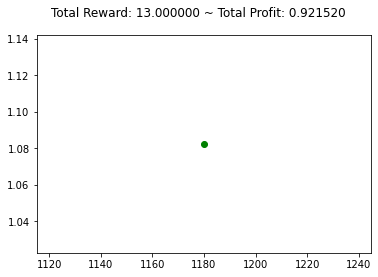

{'total_reward': 11.000000000003212, 'total_profit': 0.9215195156734037, 'position': 0}


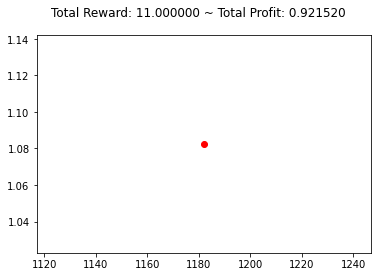

{'total_reward': 10.000000000003322, 'total_profit': 0.921349226563975, 'position': 0}


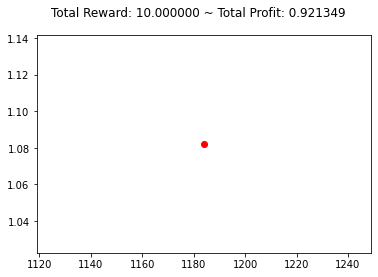

{'total_reward': 8.000000000003542, 'total_profit': 0.9209235824604161, 'position': 1}


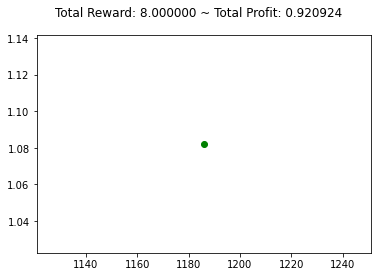

{'total_reward': 6.000000000003762, 'total_profit': 0.920668266801292, 'position': 1}


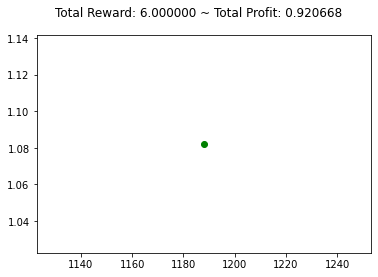

{'total_reward': 6.000000000003762, 'total_profit': 0.920668266801292, 'position': 1}


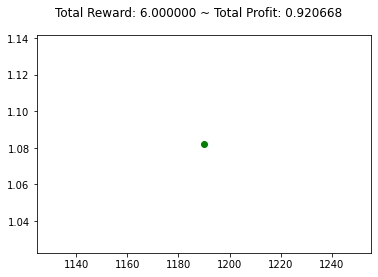

{'total_reward': 6.000000000003762, 'total_profit': 0.920668266801292, 'position': 1}


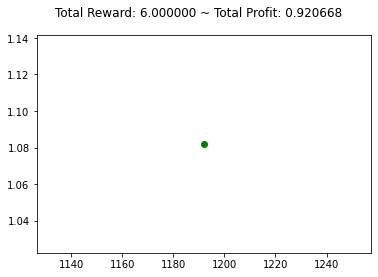

{'total_reward': 3.0000000000040927, 'total_profit': 0.920412951142168, 'position': 1}


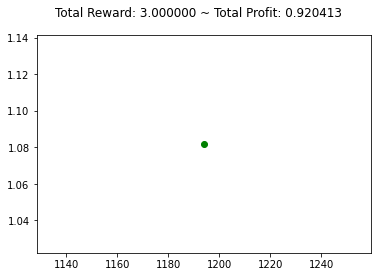

{'total_reward': 3.0000000000040927, 'total_profit': 0.920412951142168, 'position': 0}


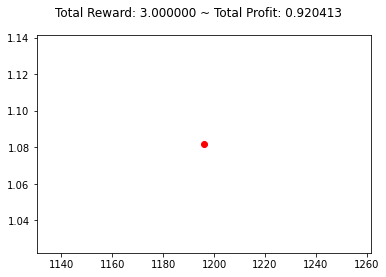

{'total_reward': 3.0000000000040927, 'total_profit': 0.9201577062860554, 'position': 1}


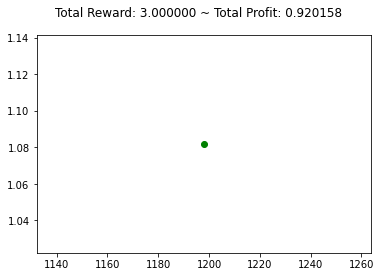

{'total_reward': 3.0000000000040927, 'total_profit': 0.9201577062860554, 'position': 1}


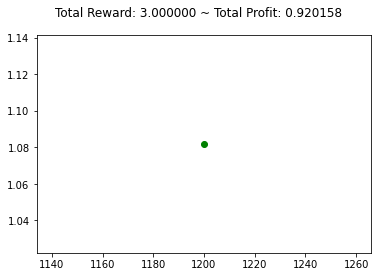

{'total_reward': 3.0000000000040927, 'total_profit': 0.9201577062860554, 'position': 0}


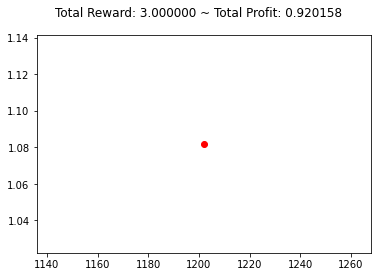

{'total_reward': 1.000000000004313, 'total_profit': 0.9197324947766812, 'position': 1}


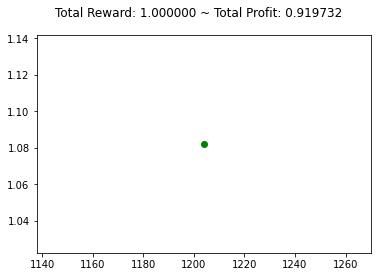

{'total_reward': 4.423128530106624e-12, 'total_profit': 0.9197324947766812, 'position': 0}


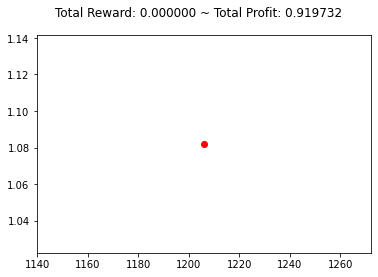

{'total_reward': 4.423128530106624e-12, 'total_profit': 0.9197324947766812, 'position': 0}


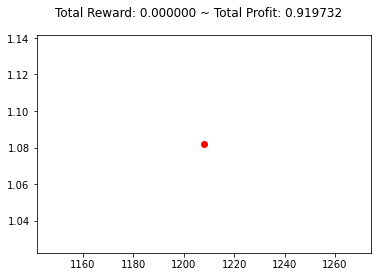

{'total_reward': 1.000000000004313, 'total_profit': 0.9194774621965601, 'position': 0}


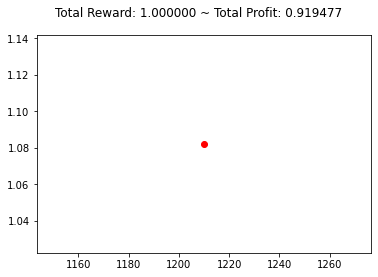

{'total_reward': 1.000000000004313, 'total_profit': 0.9192225238983541, 'position': 1}


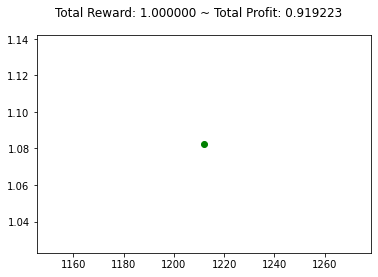

{'total_reward': 1.000000000004313, 'total_profit': 0.9192225238983541, 'position': 0}


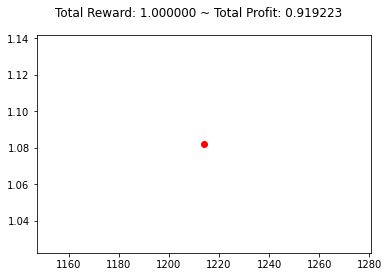

{'total_reward': -1.9999999999953566, 'total_profit': 0.9187129299647507, 'position': 1}


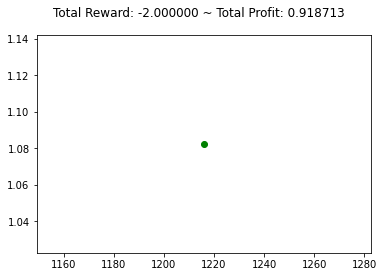

{'total_reward': -0.9999999999954667, 'total_profit': 0.9187129299647507, 'position': 0}


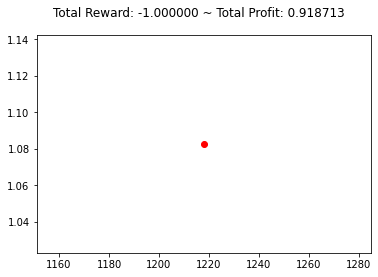

{'total_reward': -0.9999999999954667, 'total_profit': 0.9184582977779535, 'position': 1}


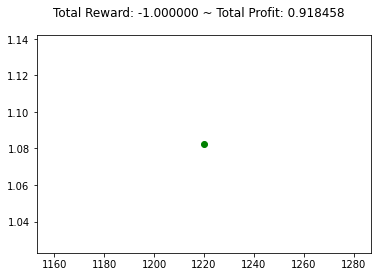

{'total_reward': -0.9999999999954667, 'total_profit': 0.9184582977779535, 'position': 1}


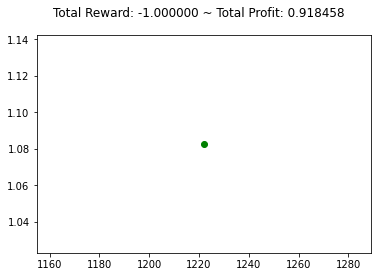

{'total_reward': 4.423128530106624e-12, 'total_profit': 0.9182037596815716, 'position': 1}


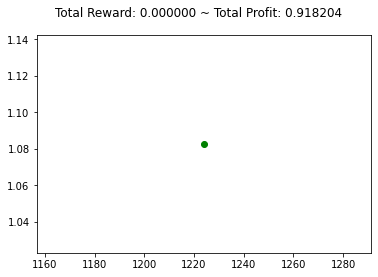

{'total_reward': 1.000000000004313, 'total_profit': 0.9182037596815716, 'position': 0}


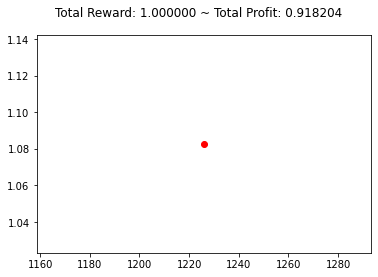

{'total_reward': 2.000000000004203, 'total_profit': 0.9180341146451408, 'position': 0}


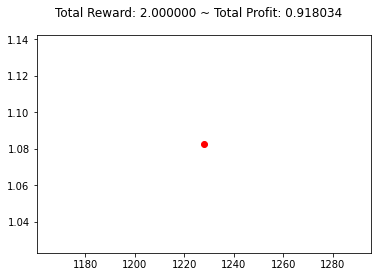

{'total_reward': 3.0000000000040927, 'total_profit': 0.9178644852817549, 'position': 1}


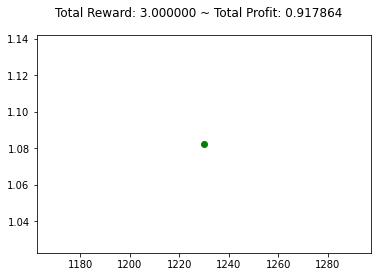

{'total_reward': 3.0000000000040927, 'total_profit': 0.9178644852817549, 'position': 0}


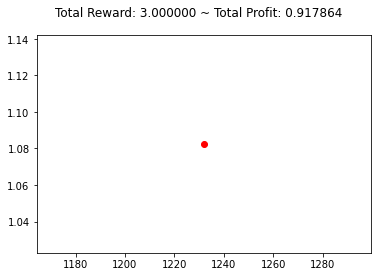

{'total_reward': 2.000000000004203, 'total_profit': 0.9175253205758772, 'position': 1}


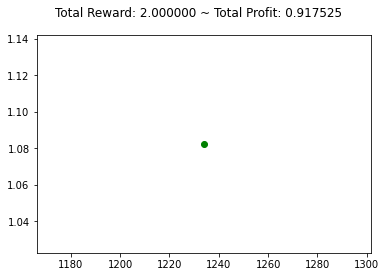

{'total_reward': -1.9999999999953566, 'total_profit': 0.9175253205758772, 'position': 0}


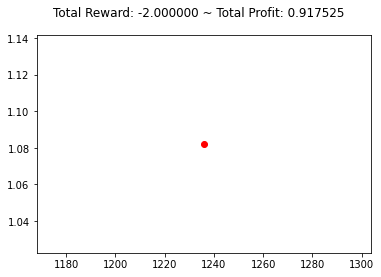

{'total_reward': -1.9999999999953566, 'total_profit': 0.9175253205758772, 'position': 0}


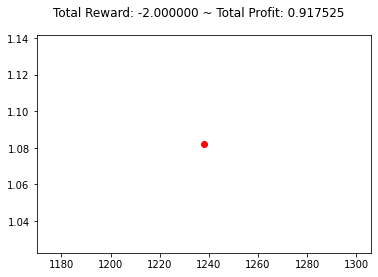

{'total_reward': -1.9999999999953566, 'total_profit': 0.9175253205758772, 'position': 0}


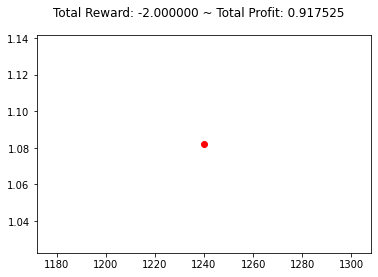

{'total_reward': -1.9999999999953566, 'total_profit': 0.9172709470464689, 'position': 1}


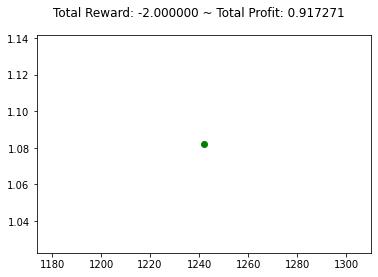

{'total_reward': -2.9999999999952465, 'total_profit': 0.9172709470464689, 'position': 0}


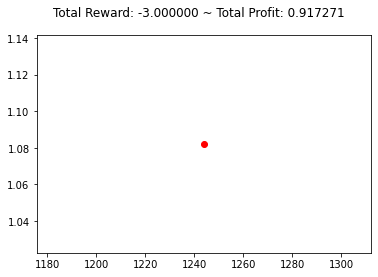

{'total_reward': -2.9999999999952465, 'total_profit': 0.9172709470464689, 'position': 0}


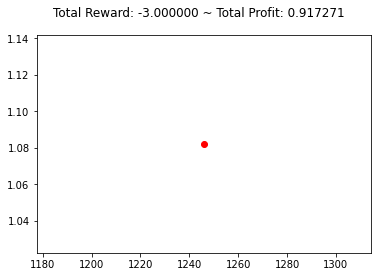

{'total_reward': -2.9999999999952465, 'total_profit': 0.9172709470464689, 'position': 0}


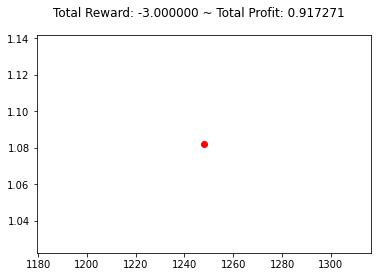

{'total_reward': -3.9999999999951363, 'total_profit': 0.9169318763701743, 'position': 1}


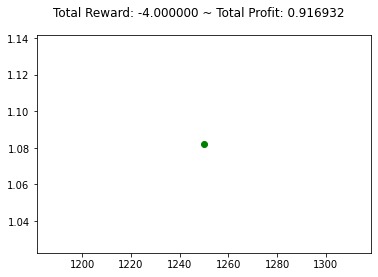

{'total_reward': -3.9999999999951363, 'total_profit': 0.9169318763701743, 'position': 1}


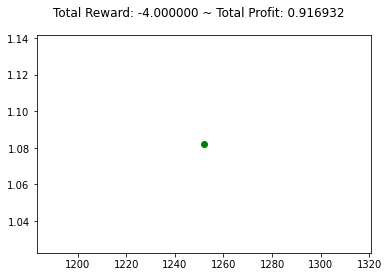

{'total_reward': -2.9999999999952465, 'total_profit': 0.916762388038128, 'position': 1}


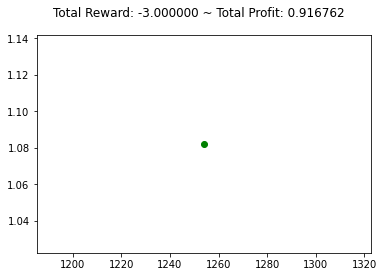

{'total_reward': 1.000000000004313, 'total_profit': 0.916762388038128, 'position': 0}


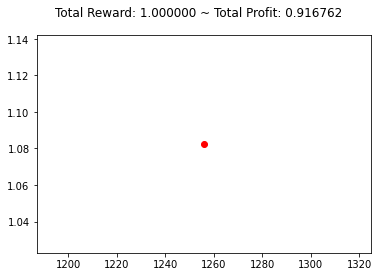

{'total_reward': 1.000000000004313, 'total_profit': 0.916762388038128, 'position': 0}


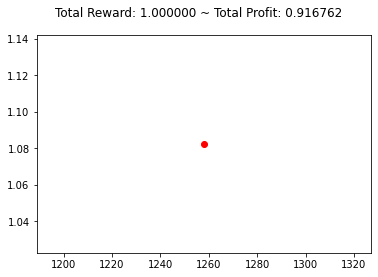

{'total_reward': 1.000000000004313, 'total_profit': 0.916762388038128, 'position': 0}


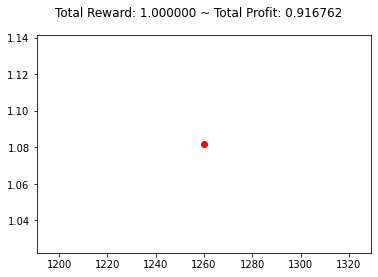

{'total_reward': 4.000000000003983, 'total_profit': 0.916762388038128, 'position': 1}


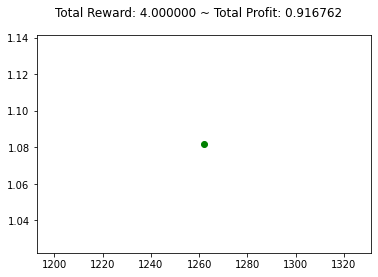

{'total_reward': 3.0000000000040927, 'total_profit': 0.916762388038128, 'position': 0}


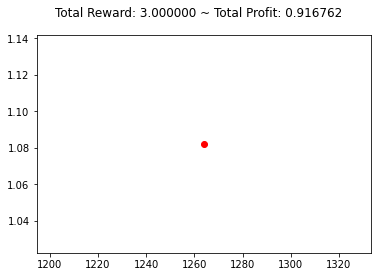

{'total_reward': 2.000000000004203, 'total_profit': 0.9164235053514862, 'position': 1}


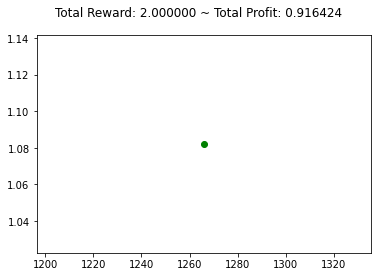

{'total_reward': 2.000000000004203, 'total_profit': 0.9164235053514862, 'position': 0}


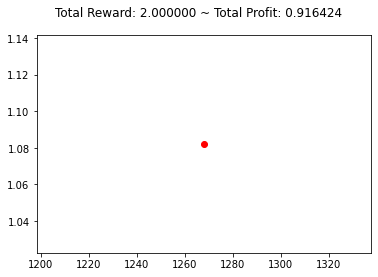

{'total_reward': -4.999999999995026, 'total_profit': 0.9157463034262312, 'position': 0}


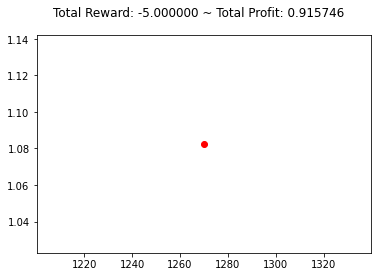

{'total_reward': -4.999999999995026, 'total_profit': 0.9157463034262312, 'position': 0}


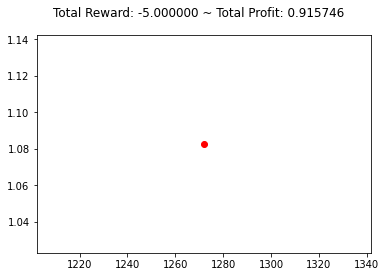

{'total_reward': -4.999999999995026, 'total_profit': 0.9157463034262312, 'position': 0}


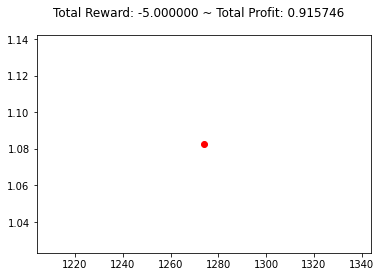

{'total_reward': -4.999999999995026, 'total_profit': 0.9157463034262312, 'position': 0}


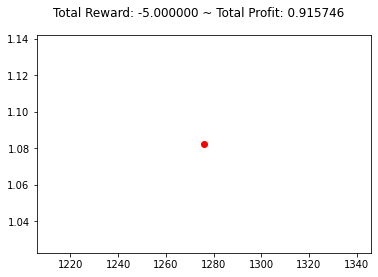

{'total_reward': -4.999999999995026, 'total_profit': 0.9154924934751707, 'position': 1}


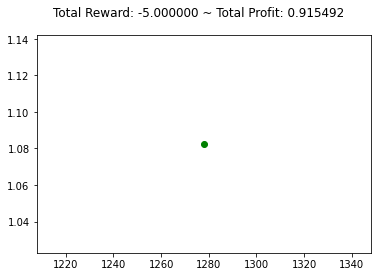

{'total_reward': -4.999999999995026, 'total_profit': 0.9154924934751707, 'position': 0}


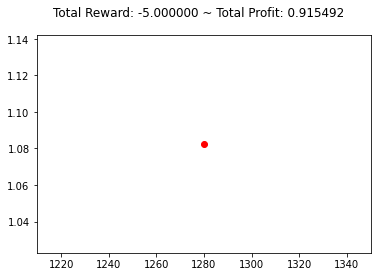

{'total_reward': -4.999999999995026, 'total_profit': 0.9154924934751707, 'position': 0}


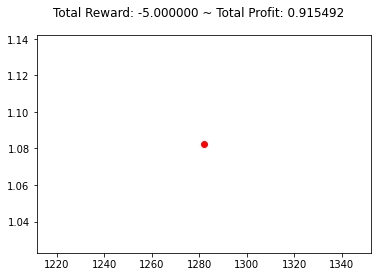

{'total_reward': -4.999999999995026, 'total_profit': 0.915238753870549, 'position': 1}


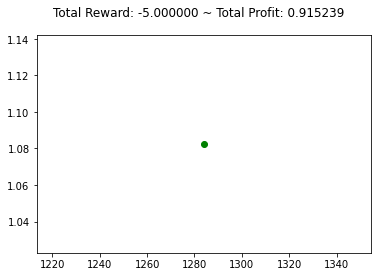

{'total_reward': -3.9999999999951363, 'total_profit': 0.915238753870549, 'position': 0}


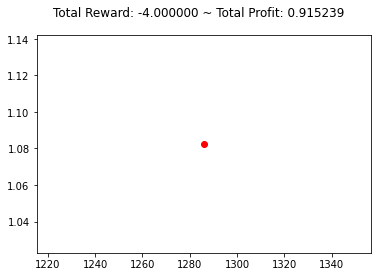

{'total_reward': -3.9999999999951363, 'total_profit': 0.915238753870549, 'position': 0}


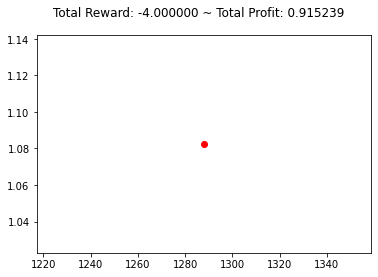

{'total_reward': -2.9999999999952465, 'total_profit': 0.9150696410187621, 'position': 1}


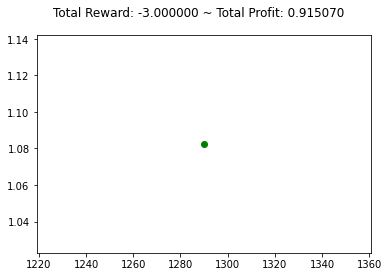

{'total_reward': -2.9999999999952465, 'total_profit': 0.9150696410187621, 'position': 0}


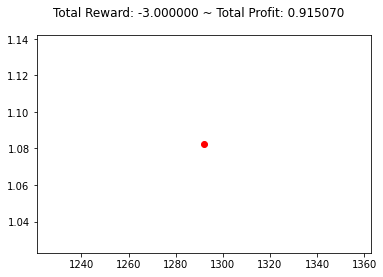

{'total_reward': -2.9999999999952465, 'total_profit': 0.9150696410187621, 'position': 0}


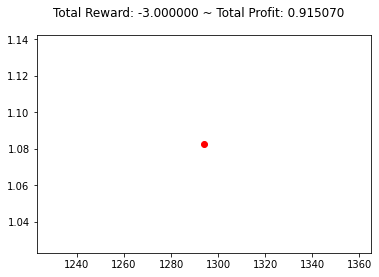

{'total_reward': -2.9999999999952465, 'total_profit': 0.9148160186127148, 'position': 1}


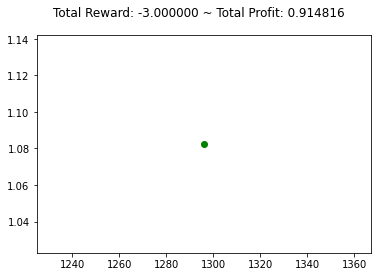

{'total_reward': -1.9999999999953566, 'total_profit': 0.9148160186127148, 'position': 0}


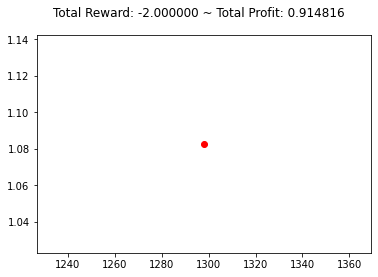

{'total_reward': -1.9999999999953566, 'total_profit': 0.9145624899239538, 'position': 1}


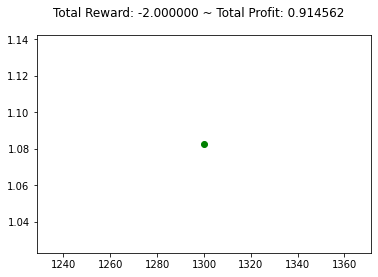

{'total_reward': 4.423128530106624e-12, 'total_profit': 0.9143090783168816, 'position': 1}


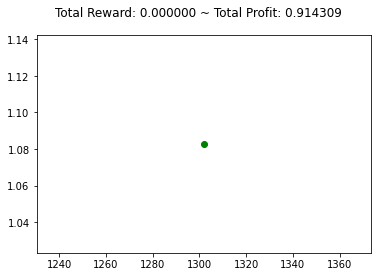

{'total_reward': -3.9999999999951363, 'total_profit': 0.9138868426660472, 'position': 1}


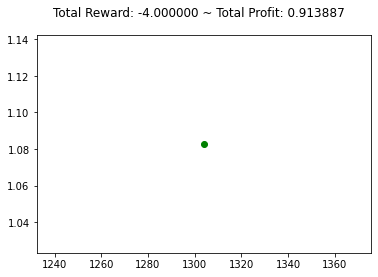

{'total_reward': -4.999999999995026, 'total_profit': 0.9138868426660472, 'position': 0}


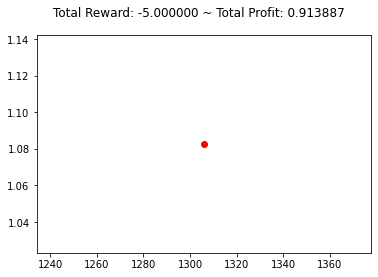

{'total_reward': -8.999999999994586, 'total_profit': 0.91329614941594, 'position': 1}


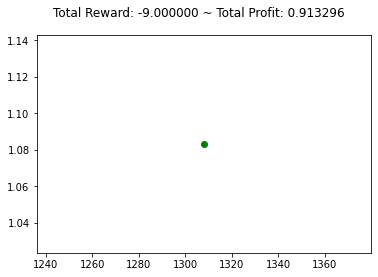

{'total_reward': -8.999999999994586, 'total_profit': 0.91329614941594, 'position': 1}


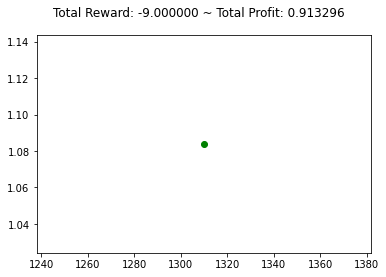

{'total_reward': -14.999999999993925, 'total_profit': 0.9128744204958181, 'position': 1}


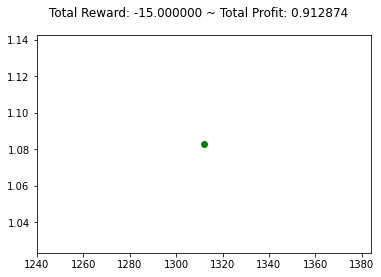

{'total_reward': -16.999999999993705, 'total_profit': 0.9128744204958181, 'position': 0}


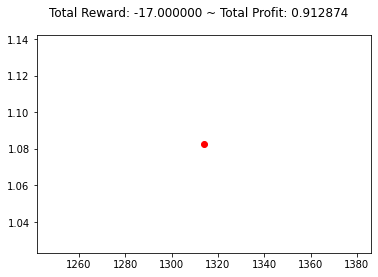

{'total_reward': -16.999999999993705, 'total_profit': 0.9126214532630925, 'position': 1}


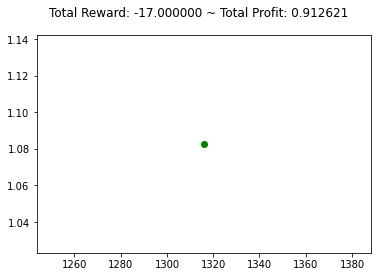

{'total_reward': -13.999999999994035, 'total_profit': 0.9125371464313823, 'position': 1}


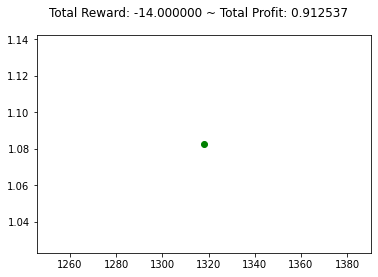

{'total_reward': -13.999999999994035, 'total_profit': 0.9125371464313823, 'position': 1}


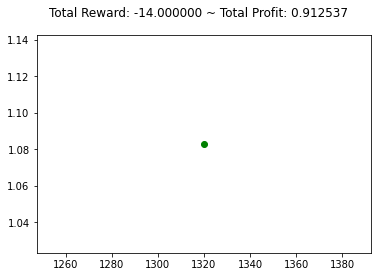

{'total_reward': -13.999999999994035, 'total_profit': 0.9125371464313823, 'position': 0}


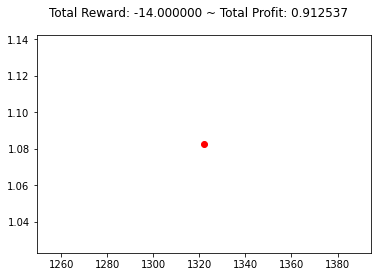

{'total_reward': -13.999999999994035, 'total_profit': 0.9125371464313823, 'position': 0}


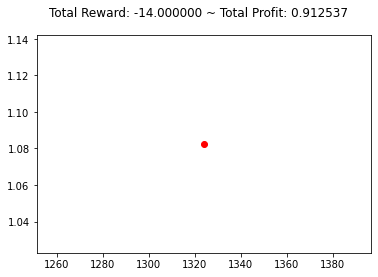

{'total_reward': -12.999999999994145, 'total_profit': 0.9122842493007316, 'position': 0}


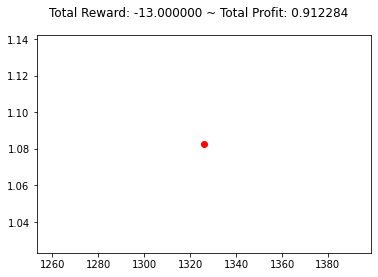

{'total_reward': -12.999999999994145, 'total_profit': 0.9120314456107351, 'position': 1}


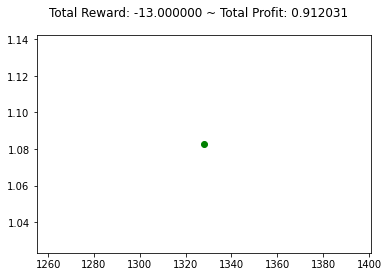

{'total_reward': -10.999999999994365, 'total_profit': 0.911862956520469, 'position': 1}


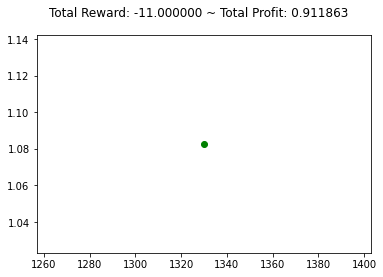

{'total_reward': -8.999999999994586, 'total_profit': 0.911862956520469, 'position': 0}


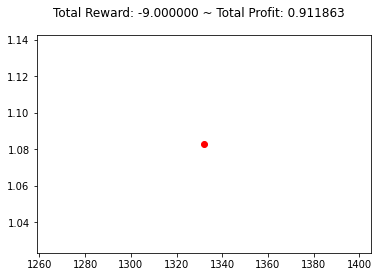

{'total_reward': -5.999999999994916, 'total_profit': 0.9117787275387103, 'position': 0}


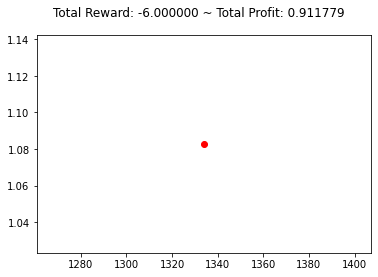

{'total_reward': -5.999999999994916, 'total_profit': 0.9117787275387103, 'position': 0}


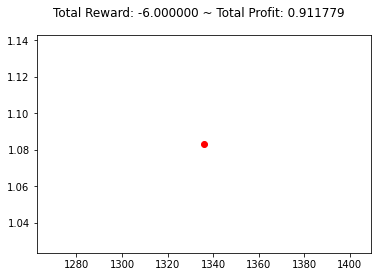

{'total_reward': -9.999999999994476, 'total_profit': 0.9115260872706198, 'position': 0}


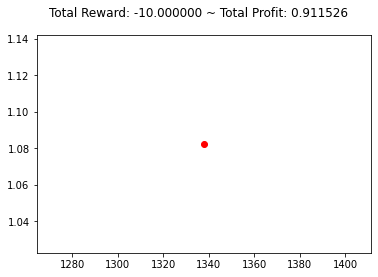

{'total_reward': -10.999999999994365, 'total_profit': 0.9111050590547904, 'position': 0}


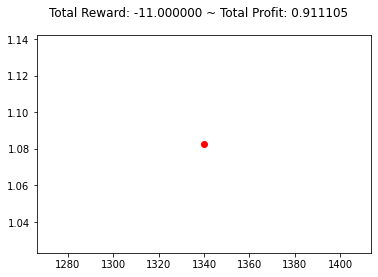

{'total_reward': -5.999999999994916, 'total_profit': 0.9111050590547904, 'position': 0}


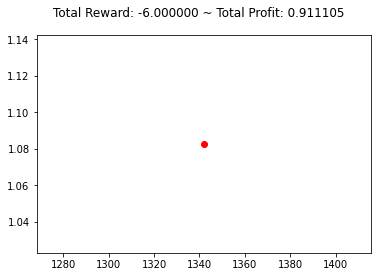

{'total_reward': -4.999999999995026, 'total_profit': 0.9109367100047064, 'position': 1}


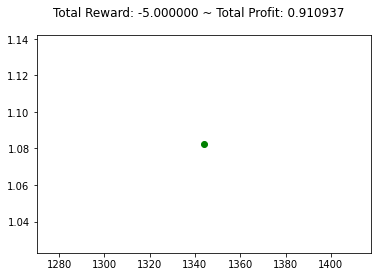

{'total_reward': -2.9999999999952465, 'total_profit': 0.9109367100047064, 'position': 0}


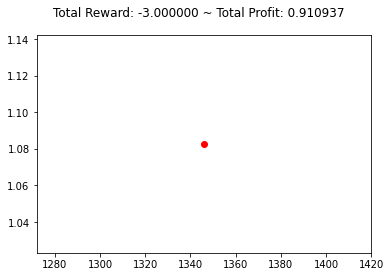

{'total_reward': -2.9999999999952465, 'total_profit': 0.910684279732213, 'position': 1}


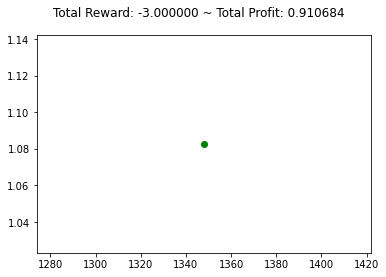

{'total_reward': -2.9999999999952465, 'total_profit': 0.910684279732213, 'position': 0}


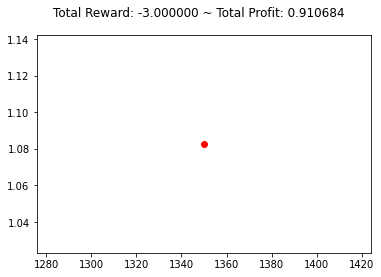

{'total_reward': -3.9999999999951363, 'total_profit': 0.9103478303816147, 'position': 1}


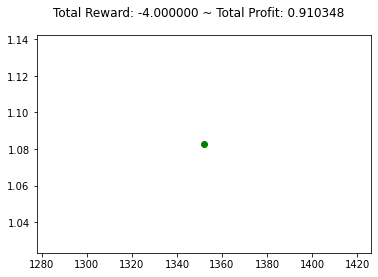

{'total_reward': 1.000000000004313, 'total_profit': 0.9103478303816147, 'position': 0}


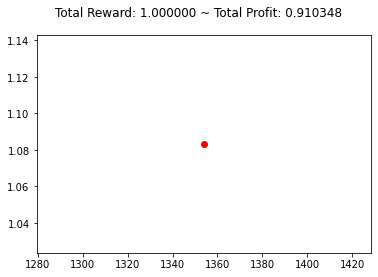

{'total_reward': 9.000000000003432, 'total_profit': 0.910768353215309, 'position': 1}


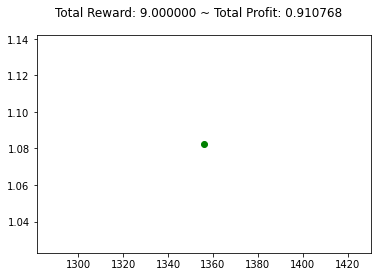

{'total_reward': 11.000000000003212, 'total_profit': 0.910768353215309, 'position': 0}


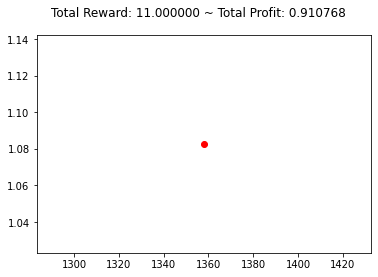

{'total_reward': 12.000000000003102, 'total_profit': 0.9106000819260314, 'position': 1}


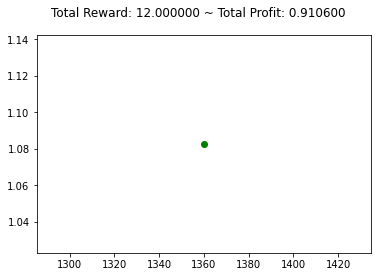

{'total_reward': 12.000000000003102, 'total_profit': 0.9102636636820391, 'position': 1}


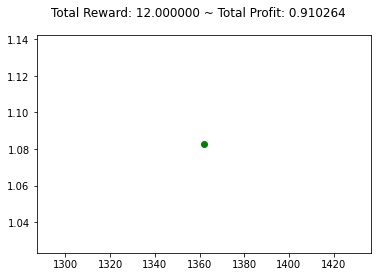

{'total_reward': 12.000000000003102, 'total_profit': 0.9102636636820391, 'position': 1}


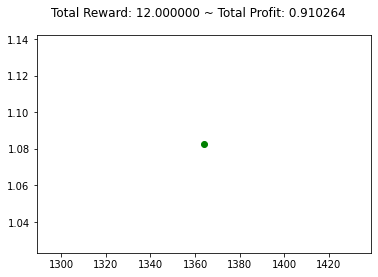

{'total_reward': 12.000000000003102, 'total_profit': 0.9102636636820391, 'position': 1}


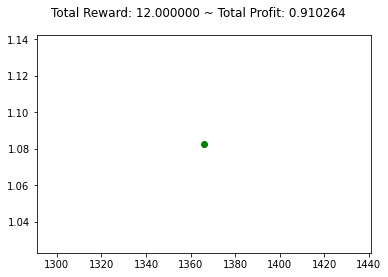

{'total_reward': 11.000000000003212, 'total_profit': 0.9102636636820391, 'position': 0}


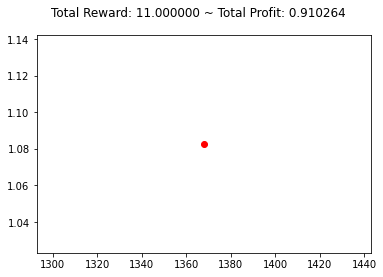

{'total_reward': 11.000000000003212, 'total_profit': 0.9100114199178562, 'position': 1}


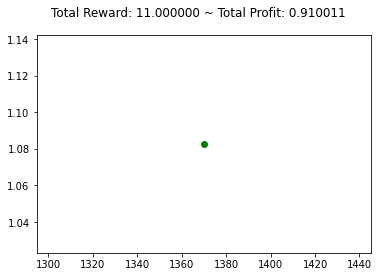

{'total_reward': 12.000000000003102, 'total_profit': 0.9100114199178562, 'position': 0}


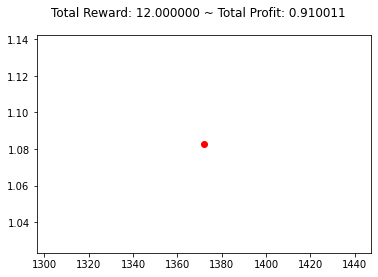

{'total_reward': 12.000000000003102, 'total_profit': 0.9097592693443128, 'position': 1}


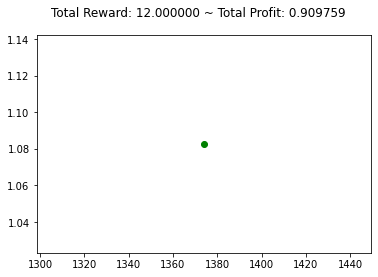

{'total_reward': 10.000000000003322, 'total_profit': 0.9097592693443128, 'position': 0}


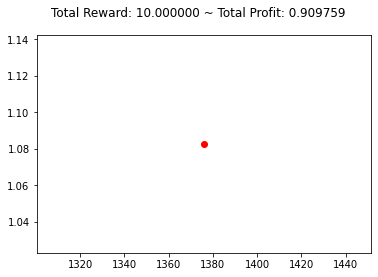

{'total_reward': 10.000000000003322, 'total_profit': 0.9095071420641251, 'position': 1}


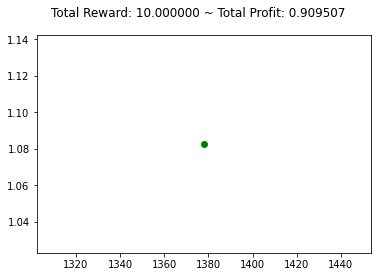

{'total_reward': 9.000000000003432, 'total_profit': 0.9092550613706484, 'position': 1}


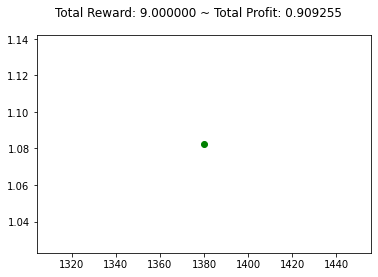

{'total_reward': 8.000000000003542, 'total_profit': 0.9089190779761466, 'position': 1}


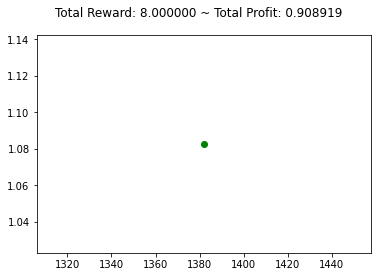

{'total_reward': 7.000000000003652, 'total_profit': 0.9089190779761466, 'position': 0}


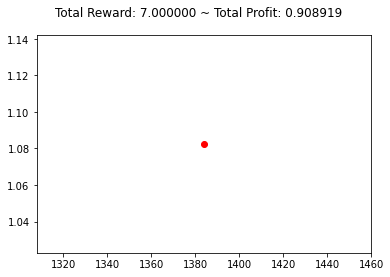

{'total_reward': 7.000000000003652, 'total_profit': 0.9086671602716078, 'position': 1}


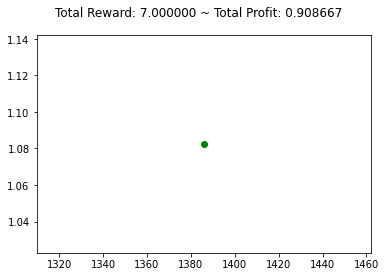

{'total_reward': 12.000000000003102, 'total_profit': 0.9085832187325527, 'position': 1}


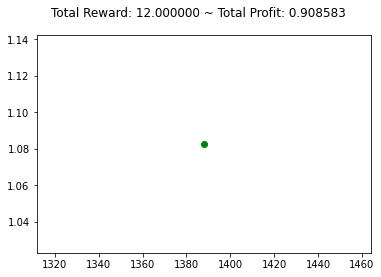

{'total_reward': 12.000000000003102, 'total_profit': 0.9083314173786314, 'position': 1}


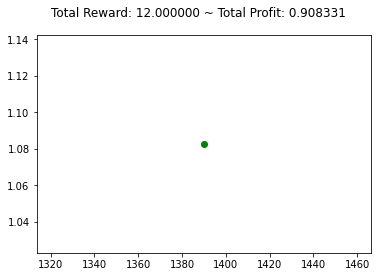

{'total_reward': 12.000000000003102, 'total_profit': 0.9083314173786314, 'position': 0}


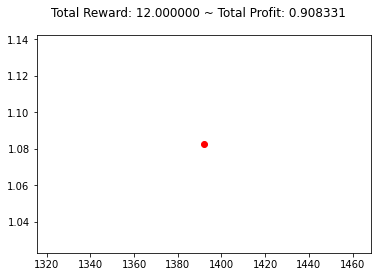

{'total_reward': 12.000000000003102, 'total_profit': 0.9083314173786314, 'position': 0}


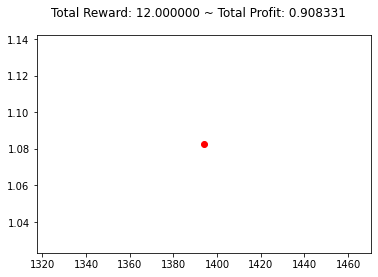

{'total_reward': 7.000000000003652, 'total_profit': 0.9076604431090998, 'position': 1}


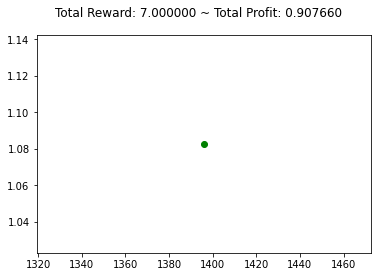

{'total_reward': 2.000000000004203, 'total_profit': 0.9074088974897624, 'position': 1}


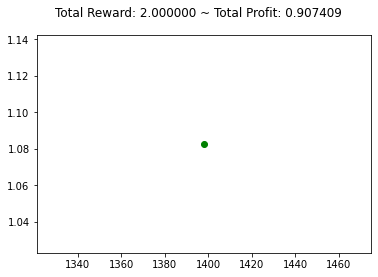

{'total_reward': 4.000000000003983, 'total_profit': 0.9074088974897624, 'position': 0}


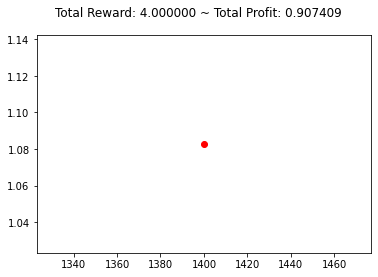

{'total_reward': 6.000000000003762, 'total_profit': 0.9073250721874538, 'position': 1}


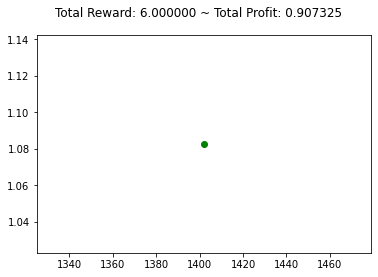

{'total_reward': 6.000000000003762, 'total_profit': 0.9073250721874538, 'position': 0}


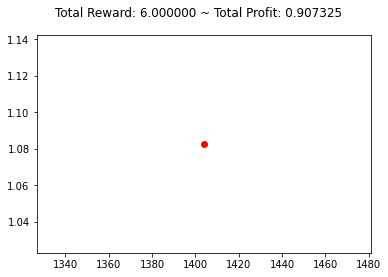

{'total_reward': 6.000000000003762, 'total_profit': 0.907073619511559, 'position': 0}


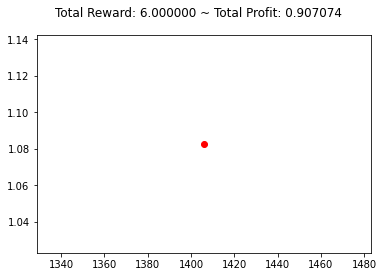

{'total_reward': 6.000000000003762, 'total_profit': 0.907073619511559, 'position': 0}


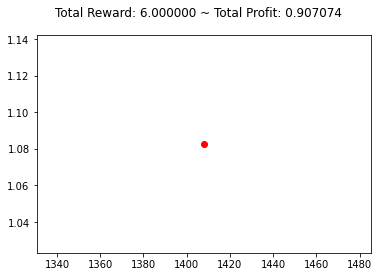

{'total_reward': 4.000000000003983, 'total_profit': 0.9066547252566816, 'position': 1}


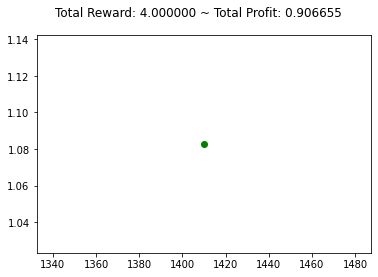

{'total_reward': 3.0000000000040927, 'total_profit': 0.9066547252566816, 'position': 0}


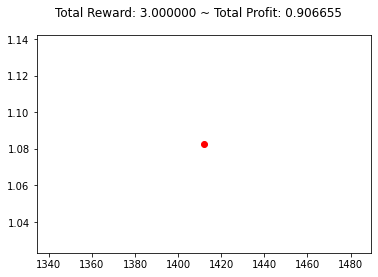

{'total_reward': 3.0000000000040927, 'total_profit': 0.9064034815678057, 'position': 1}


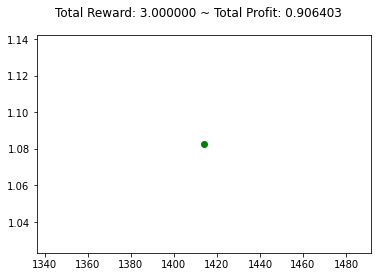

{'total_reward': 3.0000000000040927, 'total_profit': 0.9064034815678057, 'position': 0}


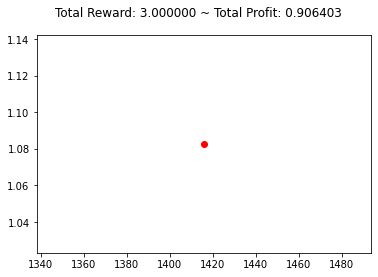

{'total_reward': 3.0000000000040927, 'total_profit': 0.9061523075012342, 'position': 1}


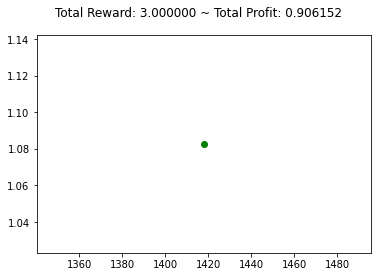

{'total_reward': 2.000000000004203, 'total_profit': 0.9061523075012342, 'position': 0}


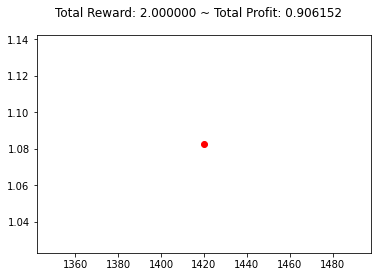

{'total_reward': 2.000000000004203, 'total_profit': 0.9059011798409567, 'position': 0}


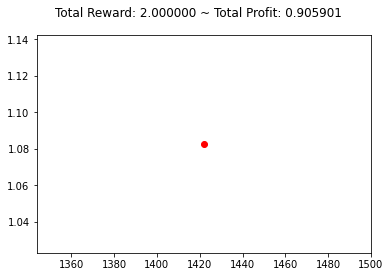

{'total_reward': 2.000000000004203, 'total_profit': 0.9059011798409567, 'position': 0}


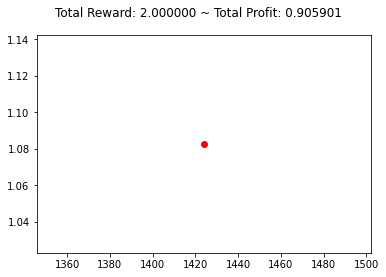

{'total_reward': 2.000000000004203, 'total_profit': 0.9057337923354429, 'position': 0}


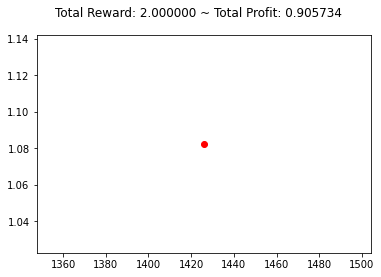

{'total_reward': 4.000000000003983, 'total_profit': 0.9054827342760319, 'position': 0}


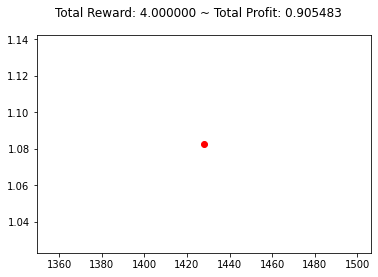

{'total_reward': 5.0000000000038725, 'total_profit': 0.9053154240886194, 'position': 0}


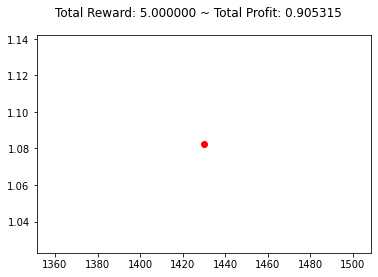

{'total_reward': 5.0000000000038725, 'total_profit': 0.905064505179504, 'position': 0}


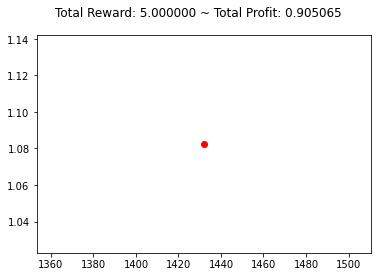

{'total_reward': 6.000000000003762, 'total_profit': 0.9048972568185727, 'position': 0}


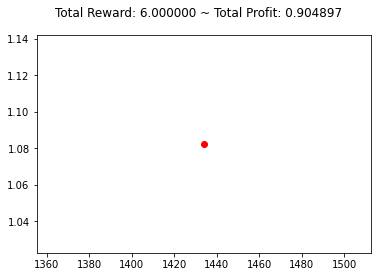

{'total_reward': 6.000000000003762, 'total_profit': 0.9048972568185727, 'position': 0}


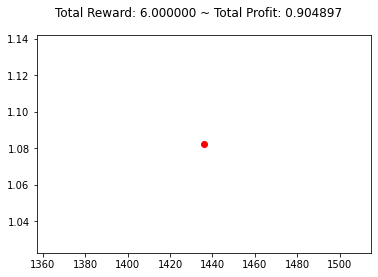

{'total_reward': 6.000000000003762, 'total_profit': 0.9046464306363261, 'position': 0}


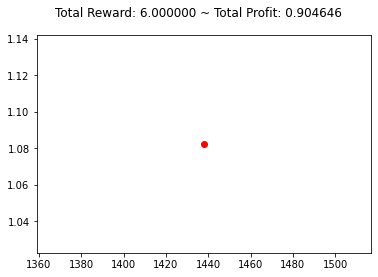

{'total_reward': 6.000000000003762, 'total_profit': 0.9043956739799546, 'position': 0}


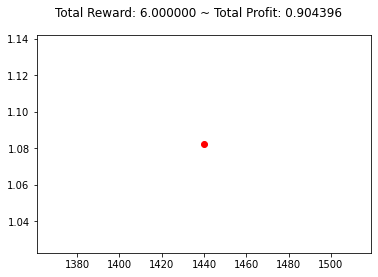

{'total_reward': 5.0000000000038725, 'total_profit': 0.9040614553273382, 'position': 1}


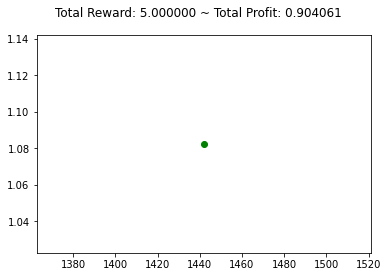

{'total_reward': 4.000000000003983, 'total_profit': 0.9040614553273382, 'position': 0}


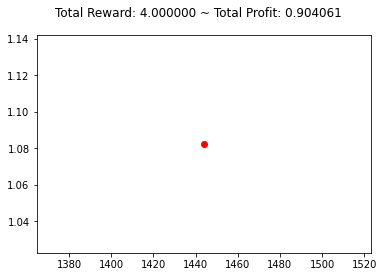

{'total_reward': 4.000000000003983, 'total_profit': 0.9038108608187932, 'position': 1}


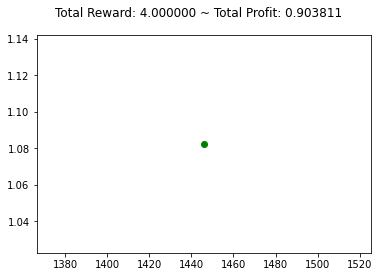

{'total_reward': 2.000000000004203, 'total_profit': 0.9038108608187932, 'position': 0}


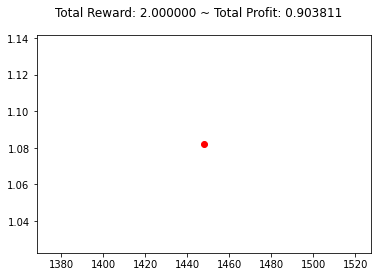

{'total_reward': 4.423128530106624e-12, 'total_profit': 0.9033933190739819, 'position': 1}


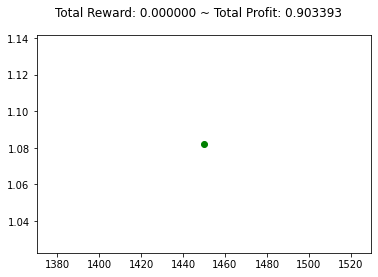

{'total_reward': -2.9999999999952465, 'total_profit': 0.9033933190739819, 'position': 0}


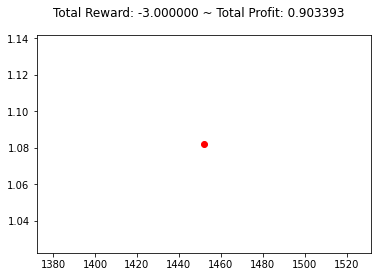

{'total_reward': 4.423128530106624e-12, 'total_profit': 0.9033098107250197, 'position': 0}


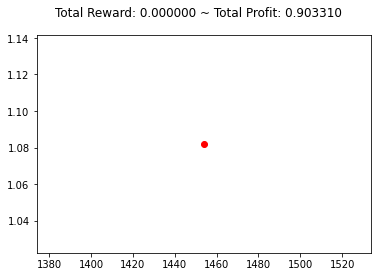

{'total_reward': 4.423128530106624e-12, 'total_profit': 0.9033098107250197, 'position': 0}


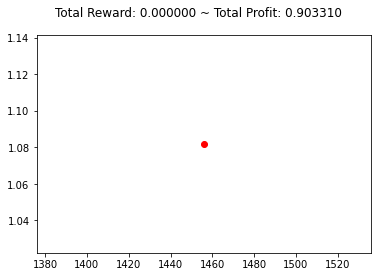

{'total_reward': -5.9999999999971365, 'total_profit': 0.9029758699447147, 'position': 0}


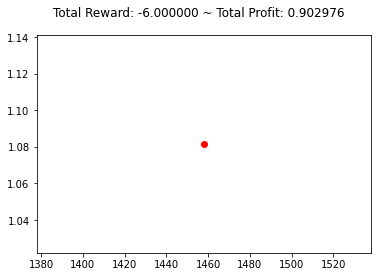

{'total_reward': -5.9999999999971365, 'total_profit': 0.9029758699447147, 'position': 0}


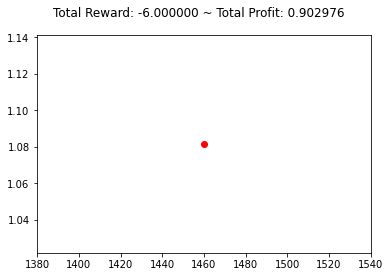

{'total_reward': -5.9999999999971365, 'total_profit': 0.9027253912013181, 'position': 1}


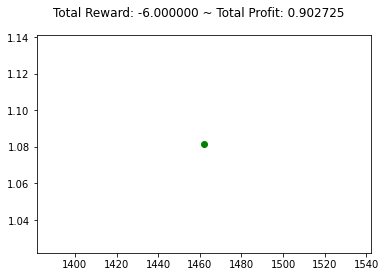

{'total_reward': -5.9999999999971365, 'total_profit': 0.9027253912013181, 'position': 1}


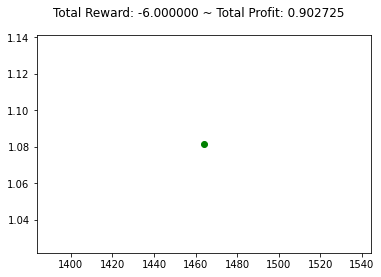

{'total_reward': -7.999999999996916, 'total_profit': 0.9027253912013181, 'position': 0}


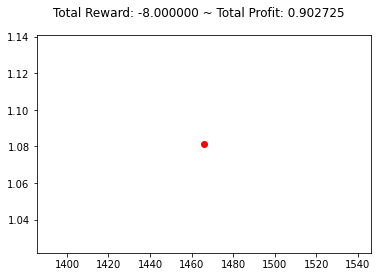

{'total_reward': -6.999999999997026, 'total_profit': 0.9025584053723871, 'position': 1}


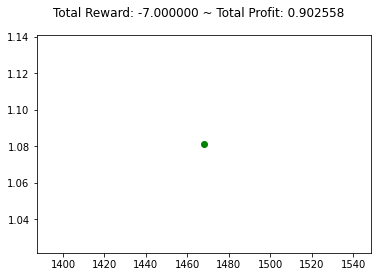

{'total_reward': -5.9999999999971365, 'total_profit': 0.9025584053723871, 'position': 0}


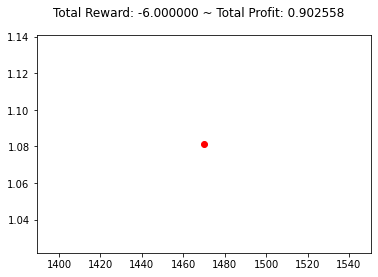

{'total_reward': -4.999999999997247, 'total_profit': 0.9023914504324366, 'position': 1}


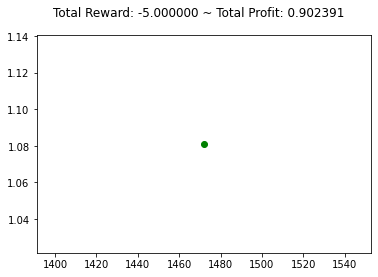

{'total_reward': -6.999999999997026, 'total_profit': 0.9021410180225109, 'position': 1}


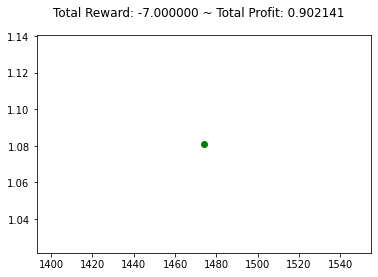

{'total_reward': -6.999999999997026, 'total_profit': 0.9021410180225109, 'position': 1}


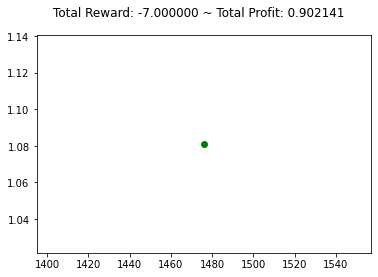

{'total_reward': -6.999999999997026, 'total_profit': 0.9018906551127914, 'position': 1}


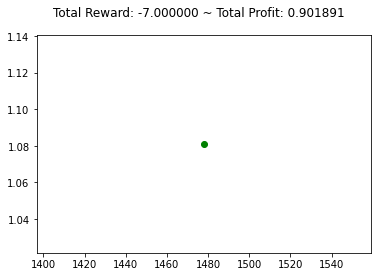

{'total_reward': -6.999999999997026, 'total_profit': 0.9018906551127914, 'position': 1}


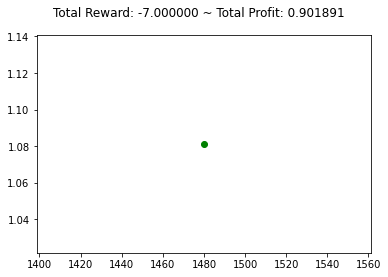

{'total_reward': -7.999999999996916, 'total_profit': 0.9015569614100396, 'position': 1}


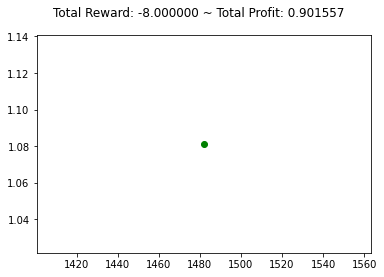

{'total_reward': -6.999999999997026, 'total_profit': 0.9015569614100396, 'position': 0}


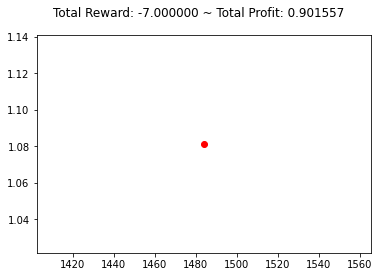

{'total_reward': -6.999999999997026, 'total_profit': 0.9015569614100396, 'position': 0}


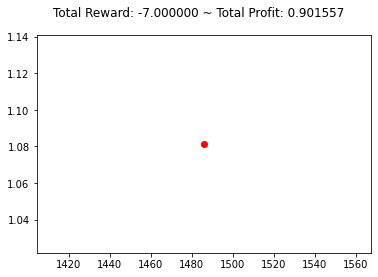

{'total_reward': -9.999999999996696, 'total_profit': 0.9010567911124474, 'position': 1}


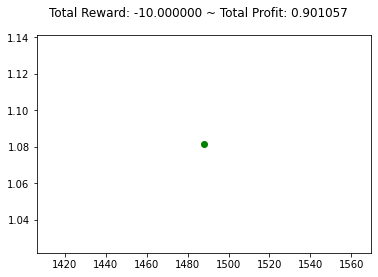

{'total_reward': -10.999999999996586, 'total_profit': 0.9010567911124474, 'position': 0}


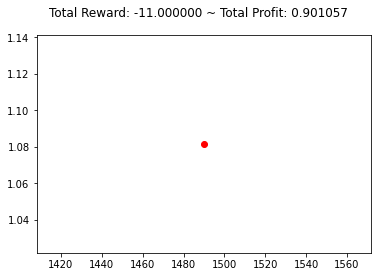

{'total_reward': -9.999999999996696, 'total_profit': 0.9008901293550975, 'position': 1}


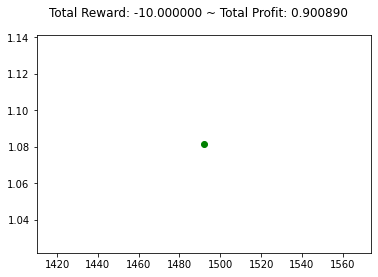

{'total_reward': -8.999999999996806, 'total_profit': 0.90064020607157, 'position': 1}


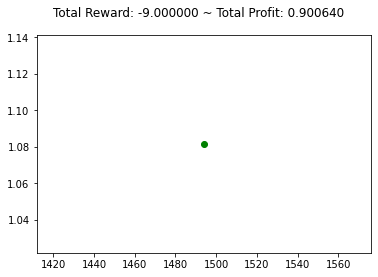

{'total_reward': -9.999999999996696, 'total_profit': 0.9004735905492184, 'position': 1}


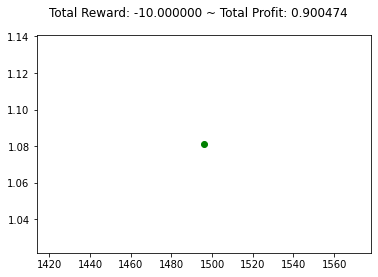

{'total_reward': -9.999999999996696, 'total_profit': 0.9004735905492184, 'position': 1}


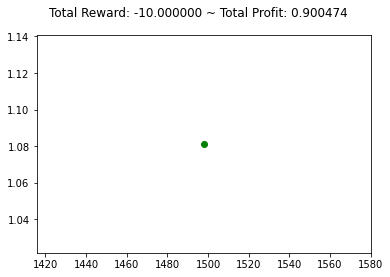

{'total_reward': -7.999999999996916, 'total_profit': 0.9004735905492184, 'position': 0}


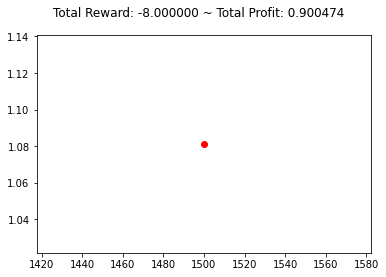

{'total_reward': -7.999999999996916, 'total_profit': 0.9004735905492184, 'position': 0}


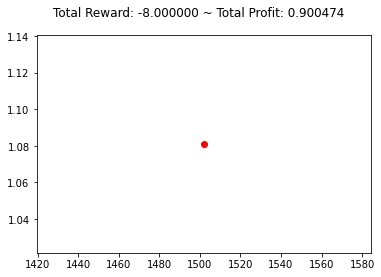

{'total_reward': -7.999999999996916, 'total_profit': 0.9004735905492184, 'position': 0}


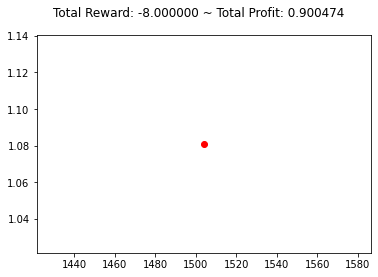

{'total_reward': -4.999999999997247, 'total_profit': 0.9004735905492184, 'position': 1}


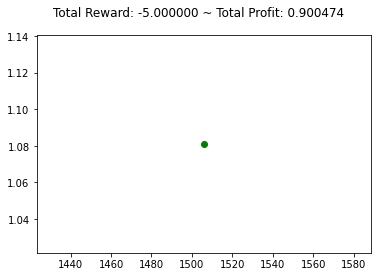

{'total_reward': -4.999999999997247, 'total_profit': 0.9004735905492184, 'position': 0}


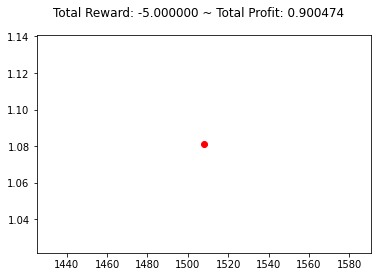

{'total_reward': -8.999999999996806, 'total_profit': 0.8998907058503239, 'position': 0}


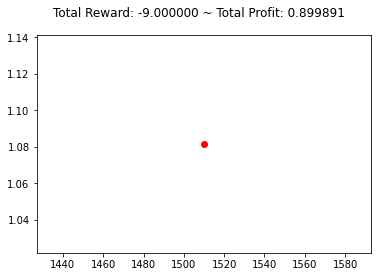

{'total_reward': -6.999999999997026, 'total_profit': 0.8998074751154136, 'position': 1}


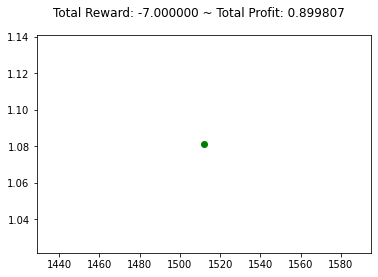

{'total_reward': -5.9999999999971365, 'total_profit': 0.8998074751154136, 'position': 0}


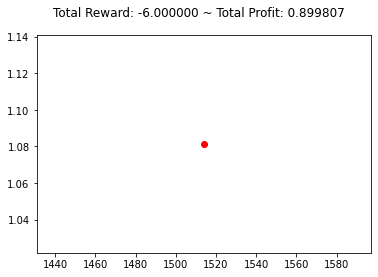

{'total_reward': -5.9999999999971365, 'total_profit': 0.8995578290943884, 'position': 0}


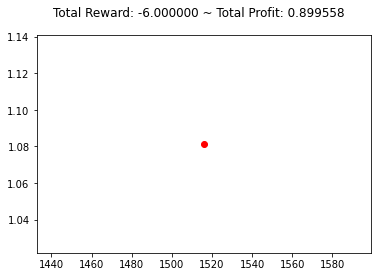

{'total_reward': -6.999999999997026, 'total_profit': 0.899225090855404, 'position': 1}


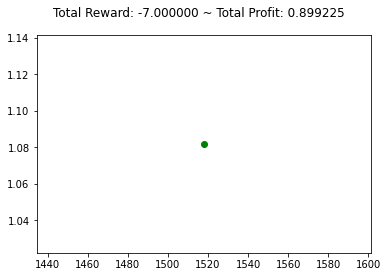

{'total_reward': -5.999999999994916, 'total_profit': 0.8988095140503133, 'position': 1}


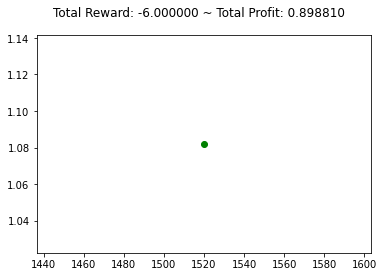

{'total_reward': -12.999999999998586, 'total_profit': 0.898311006277684, 'position': 1}


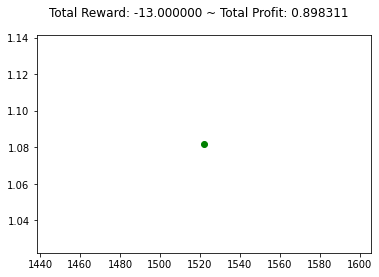

{'total_reward': -16.000000000000476, 'total_profit': 0.898311006277684, 'position': 0}


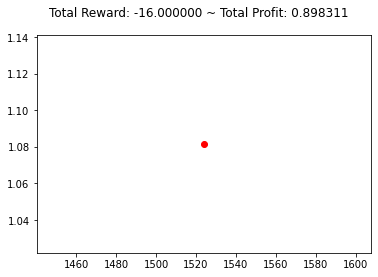

{'total_reward': -18.000000000002476, 'total_profit': 0.897895775157097, 'position': 1}


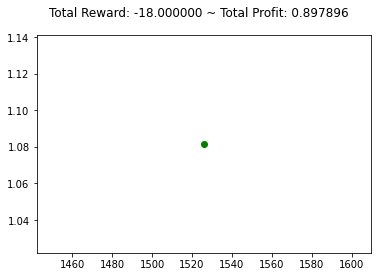

{'total_reward': -11.000000000001027, 'total_profit': 0.8980618368872908, 'position': 1}


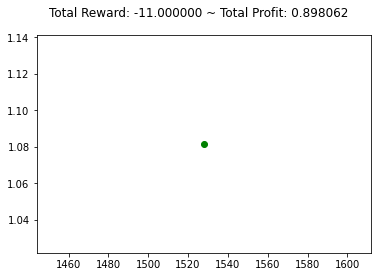

{'total_reward': -10.000000000001137, 'total_profit': 0.8978957290842968, 'position': 1}


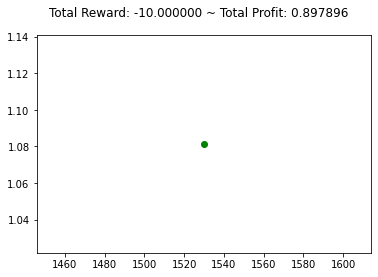

{'total_reward': -9.000000000001247, 'total_profit': 0.8978957290842968, 'position': 0}


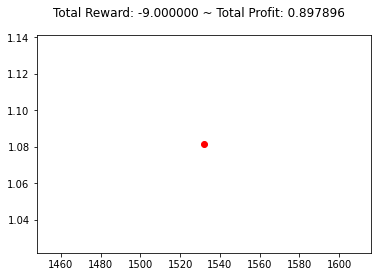

{'total_reward': -9.000000000001247, 'total_profit': 0.8976466365017878, 'position': 1}


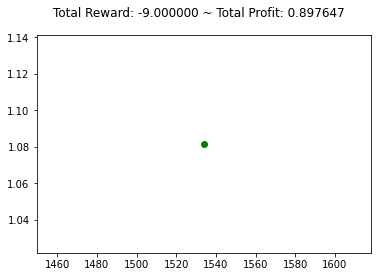

{'total_reward': -11.000000000001027, 'total_profit': 0.8976466365017878, 'position': 0}


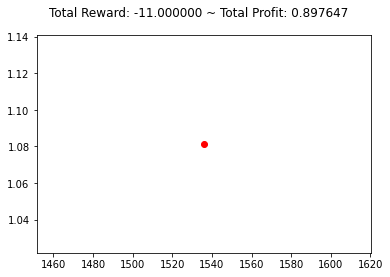

{'total_reward': -13.000000000000806, 'total_profit': 0.8972315973689499, 'position': 1}


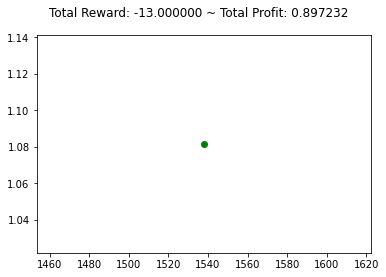

{'total_reward': -13.000000000000806, 'total_profit': 0.8969826890286403, 'position': 1}


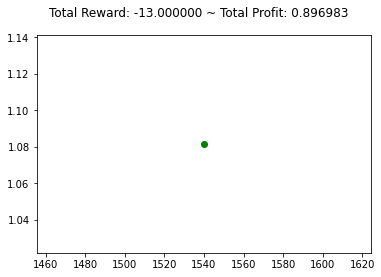

{'total_reward': -13.000000000000806, 'total_profit': 0.8969826890286403, 'position': 0}


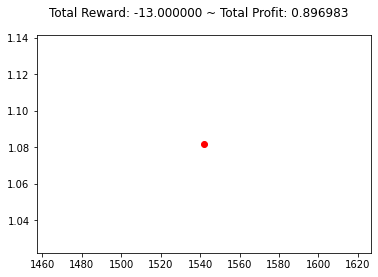

{'total_reward': -18.000000000002476, 'total_profit': 0.8964022787103558, 'position': 0}


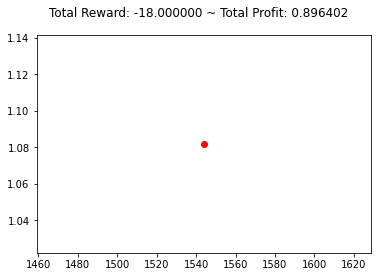

{'total_reward': -21.000000000002146, 'total_profit': 0.8959051979643058, 'position': 1}


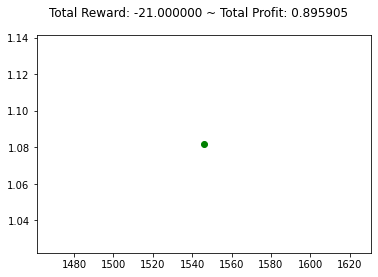

{'total_reward': -24.000000000001815, 'total_profit': 0.8959051979643058, 'position': 0}


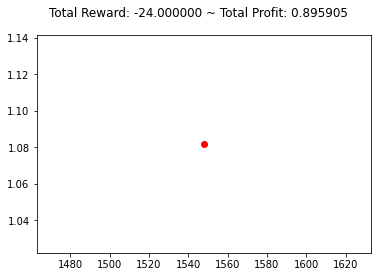

{'total_reward': -23.000000000001926, 'total_profit': 0.8956567265217715, 'position': 0}


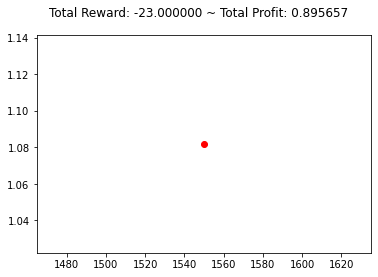

{'total_reward': -23.000000000001926, 'total_profit': 0.8954083469525753, 'position': 1}


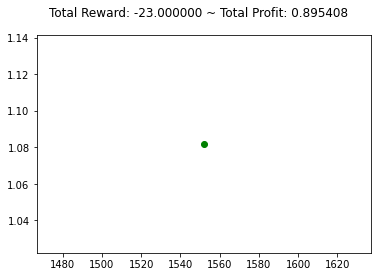

{'total_reward': -22.000000000002036, 'total_profit': 0.8954083469525753, 'position': 0}


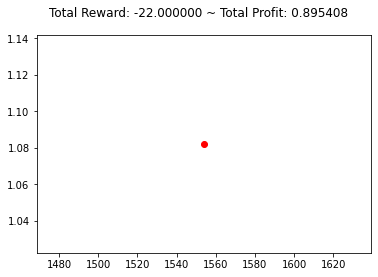

{'total_reward': -20.000000000002256, 'total_profit': 0.8951600592142578, 'position': 0}


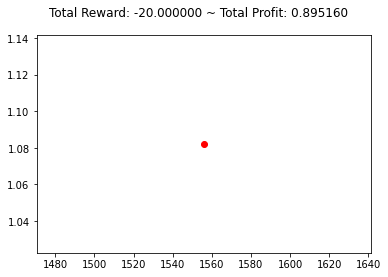

{'total_reward': -17.000000000002586, 'total_profit': 0.8950773195840503, 'position': 0}


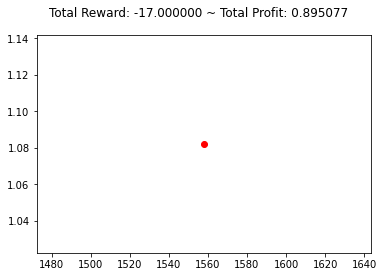

{'total_reward': -17.000000000002586, 'total_profit': 0.8948291465749236, 'position': 1}


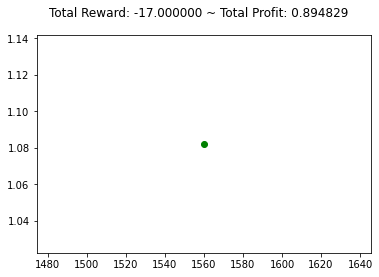

{'total_reward': -17.000000000002586, 'total_profit': 0.8948291465749236, 'position': 1}


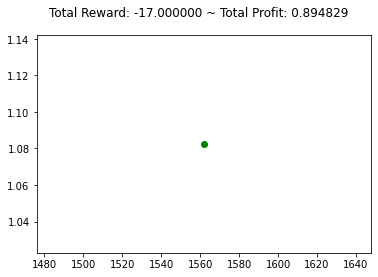

{'total_reward': -17.000000000002586, 'total_profit': 0.8948291465749236, 'position': 1}


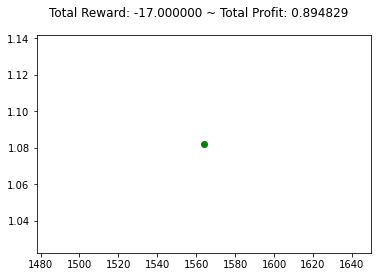

{'total_reward': -9.000000000003467, 'total_profit': 0.8949118479747918, 'position': 1}


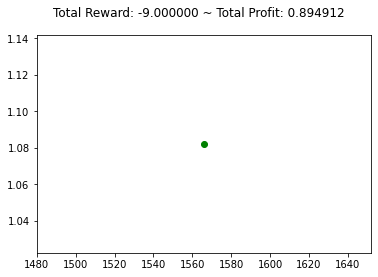

{'total_reward': -9.000000000003467, 'total_profit': 0.8949118479747918, 'position': 1}


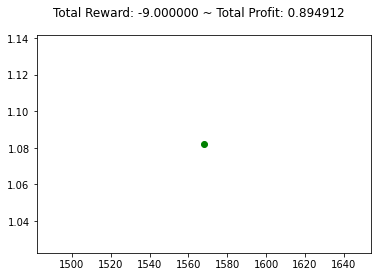

{'total_reward': -9.000000000003467, 'total_profit': 0.8949118479747918, 'position': 0}


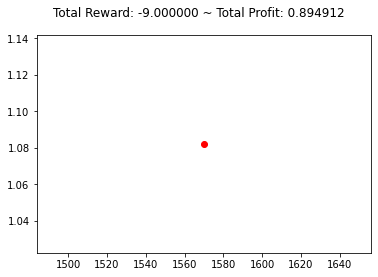

{'total_reward': -9.000000000003467, 'total_profit': 0.8946637208450392, 'position': 1}


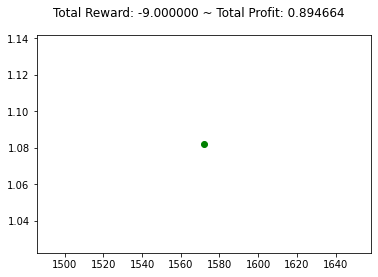

{'total_reward': -6.000000000003798, 'total_profit': 0.8946637208450392, 'position': 0}


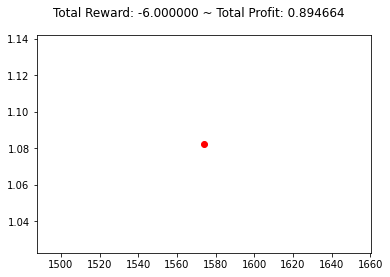

{'total_reward': -7.000000000003688, 'total_profit': 0.8942504812511154, 'position': 0}


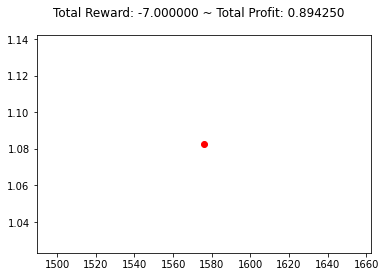

{'total_reward': 0.9999999999954312, 'total_profit': 0.8944157618132171, 'position': 0}


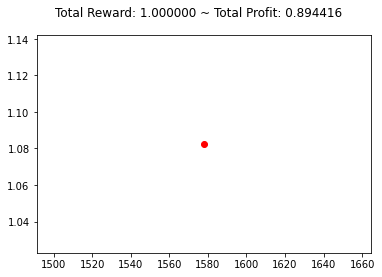

{'total_reward': 3.999999999995101, 'total_profit': 0.8944157618132171, 'position': 1}


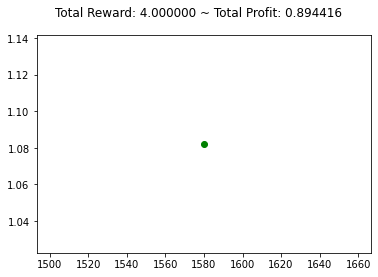

{'total_reward': 3.999999999995101, 'total_profit': 0.8944157618132171, 'position': 0}


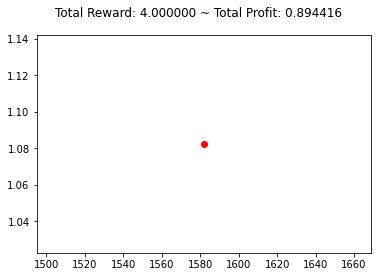

{'total_reward': 1.999999999995321, 'total_profit': 0.894002560407963, 'position': 1}


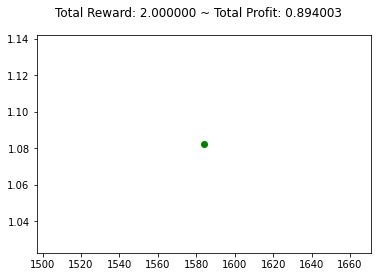

{'total_reward': -2.0000000000042384, 'total_profit': 0.8935895498931299, 'position': 1}


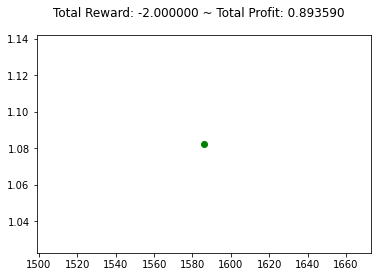

{'total_reward': -2.0000000000042384, 'total_profit': 0.8933418580655701, 'position': 1}


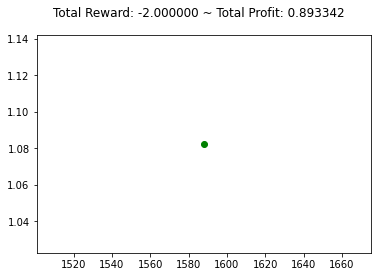

{'total_reward': -2.0000000000042384, 'total_profit': 0.8933418580655701, 'position': 0}


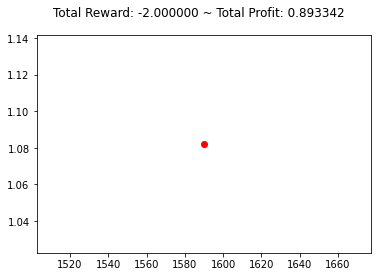

{'total_reward': -2.0000000000042384, 'total_profit': 0.8933418580655701, 'position': 0}


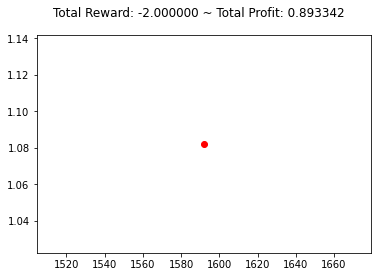

{'total_reward': 0.9999999999954312, 'total_profit': 0.8933418580655701, 'position': 1}


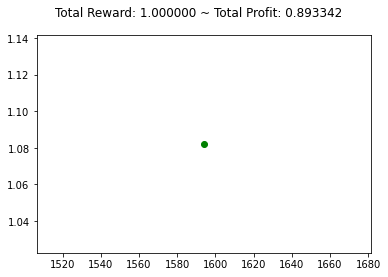

{'total_reward': 0.9999999999954312, 'total_profit': 0.8933418580655701, 'position': 1}


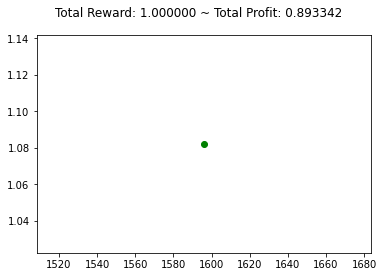

{'total_reward': 1.999999999995321, 'total_profit': 0.8931767149177624, 'position': 1}


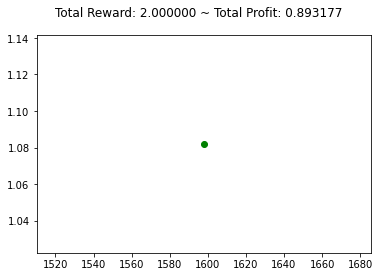

{'total_reward': 1.999999999995321, 'total_profit': 0.8931767149177624, 'position': 1}


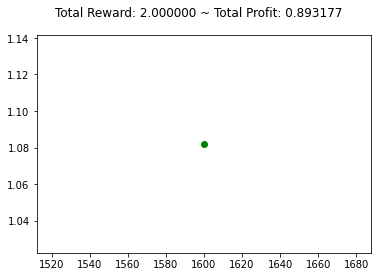

{'total_reward': 1.999999999995321, 'total_profit': 0.8931767149177624, 'position': 0}


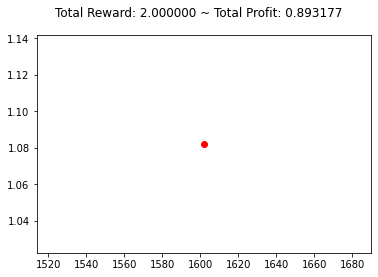

{'total_reward': 3.999999999995101, 'total_profit': 0.8930115870355443, 'position': 0}


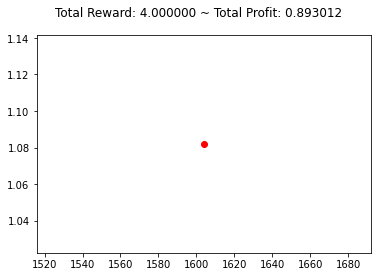

{'total_reward': 3.999999999995101, 'total_profit': 0.8930115870355443, 'position': 0}


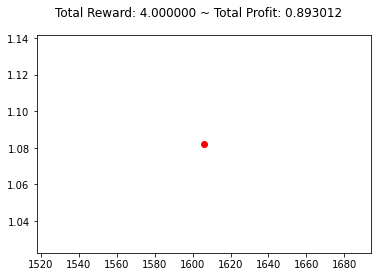

{'total_reward': 3.999999999995101, 'total_profit': 0.8930115870355443, 'position': 0}


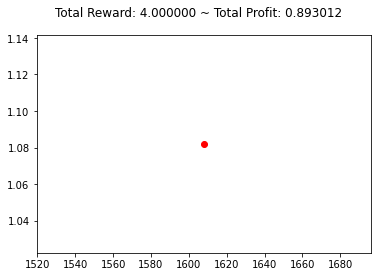

{'total_reward': -6.000000000003798, 'total_profit': 0.8923515636896201, 'position': 0}


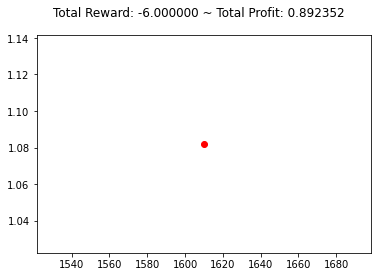

{'total_reward': -6.000000000003798, 'total_profit': 0.8921041235665895, 'position': 1}


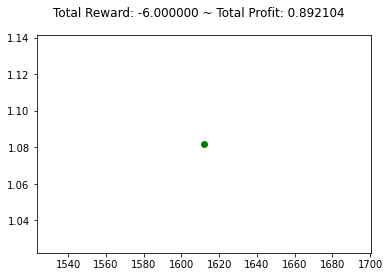

{'total_reward': -8.000000000003578, 'total_profit': 0.8921041235665895, 'position': 0}


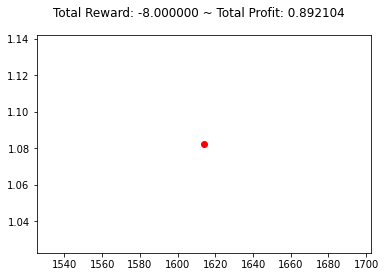

{'total_reward': -6.000000000001577, 'total_profit': 0.892021635899131, 'position': 1}


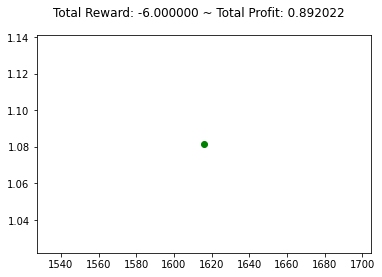

{'total_reward': -6.000000000001577, 'total_profit': 0.892021635899131, 'position': 1}


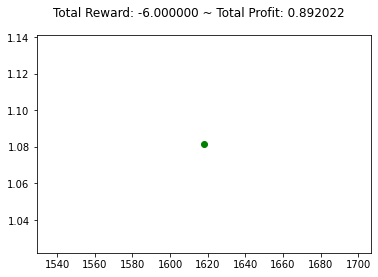

{'total_reward': -6.000000000001577, 'total_profit': 0.892021635899131, 'position': 0}


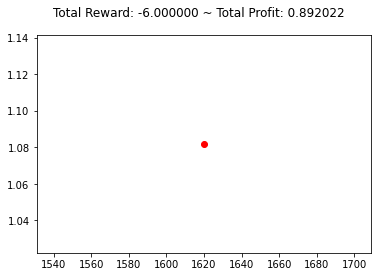

{'total_reward': -6.000000000001577, 'total_profit': 0.892021635899131, 'position': 0}


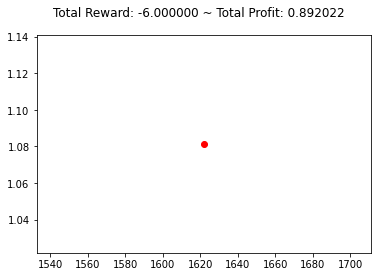

{'total_reward': -5.0000000000016875, 'total_profit': 0.8919391406031077, 'position': 0}


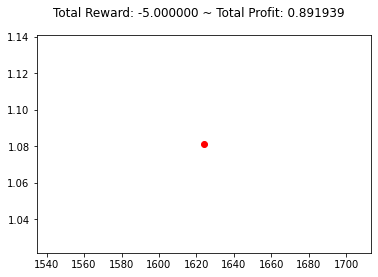

{'total_reward': -6.000000000001577, 'total_profit': 0.8916091899360947, 'position': 1}


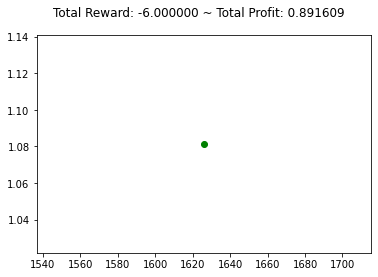

{'total_reward': -6.000000000001577, 'total_profit': 0.8916091899360947, 'position': 1}


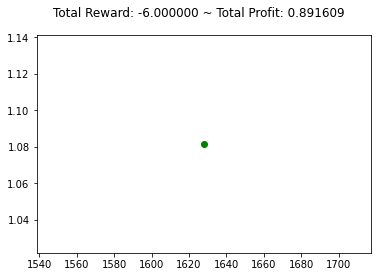

{'total_reward': -5.0000000000016875, 'total_profit': 0.8913618413537192, 'position': 1}


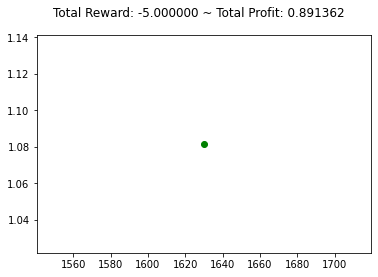

{'total_reward': -4.000000000001798, 'total_profit': 0.8913618413537192, 'position': 0}


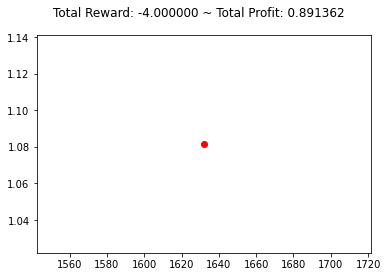

{'total_reward': -6.000000000003798, 'total_profit': 0.8909498223829537, 'position': 1}


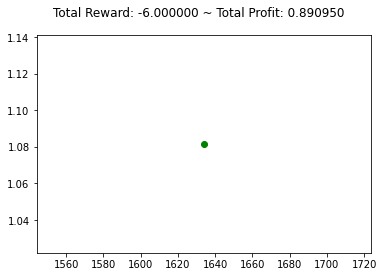

{'total_reward': -9.000000000005688, 'total_profit': 0.8907026567211127, 'position': 1}


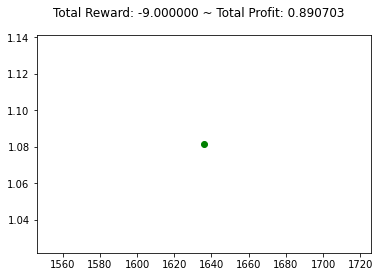

{'total_reward': -9.000000000005688, 'total_profit': 0.8907026567211127, 'position': 1}


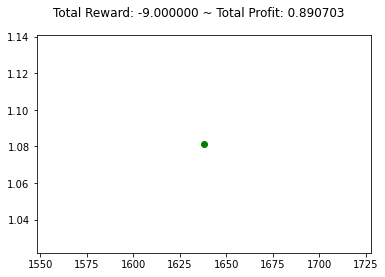

{'total_reward': -9.000000000005688, 'total_profit': 0.8907026567211127, 'position': 1}


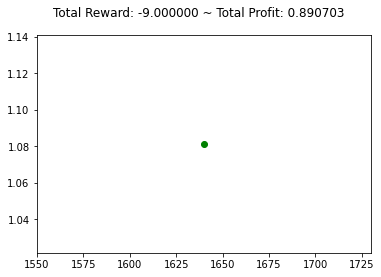

{'total_reward': -10.000000000005578, 'total_profit': 0.8907026567211127, 'position': 0}


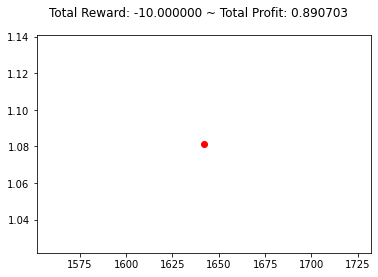

{'total_reward': -11.000000000005468, 'total_profit': 0.8903731939296494, 'position': 1}


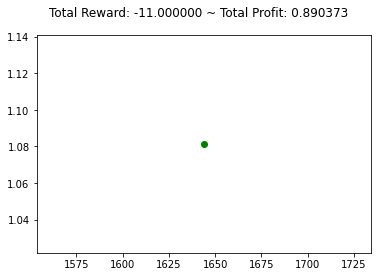

{'total_reward': -12.000000000005357, 'total_profit': 0.8903731939296494, 'position': 0}


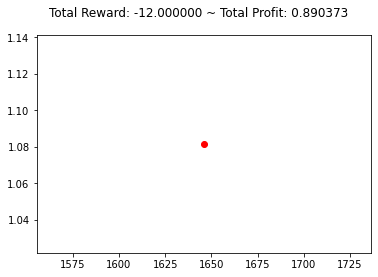

{'total_reward': -12.000000000005357, 'total_profit': 0.8903731939296494, 'position': 0}


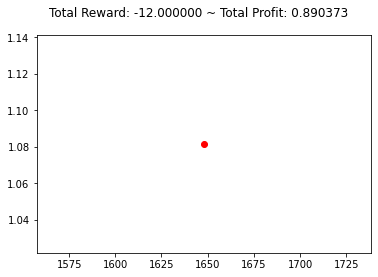

{'total_reward': -16.000000000007137, 'total_profit': 0.8897970071535092, 'position': 1}


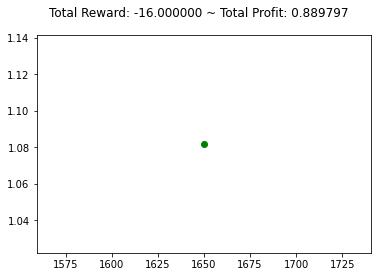

{'total_reward': -16.000000000007137, 'total_profit': 0.8897970071535092, 'position': 1}


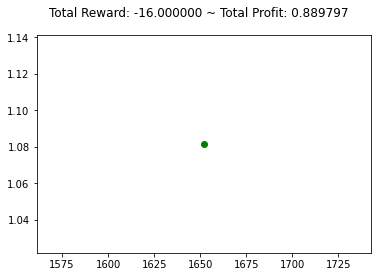

{'total_reward': -13.000000000005247, 'total_profit': 0.8897970071535094, 'position': 1}


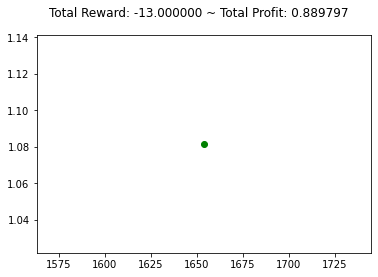

{'total_reward': -13.000000000005247, 'total_profit': 0.8897970071535094, 'position': 1}


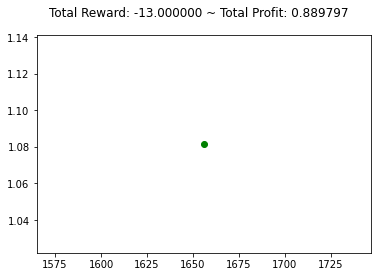

{'total_reward': -11.000000000005468, 'total_profit': 0.8896324432535365, 'position': 1}


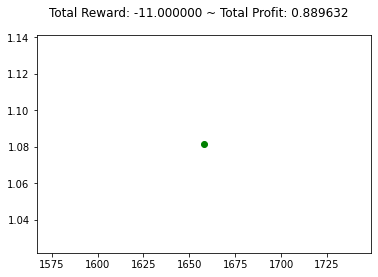

{'total_reward': -13.000000000005247, 'total_profit': 0.8896324432535365, 'position': 0}


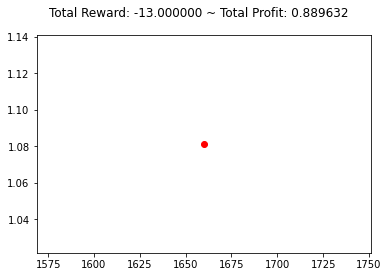

{'total_reward': -13.000000000005247, 'total_profit': 0.8893855974035773, 'position': 1}


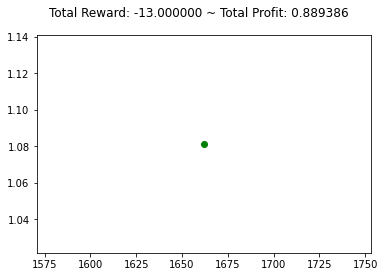

{'total_reward': -13.000000000005247, 'total_profit': 0.8893855974035773, 'position': 0}


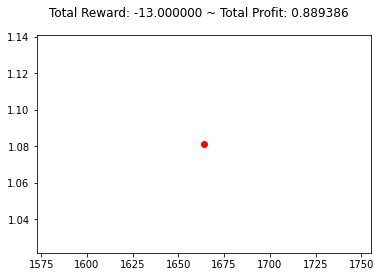

{'total_reward': -13.000000000005247, 'total_profit': 0.8891388200458071, 'position': 1}


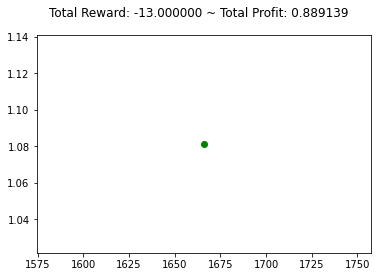

{'total_reward': -13.000000000005247, 'total_profit': 0.8891388200458071, 'position': 1}


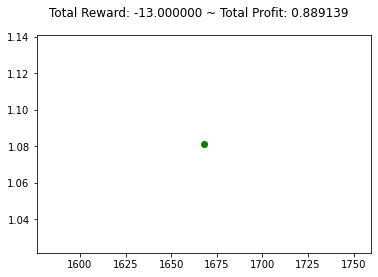

{'total_reward': -13.000000000005247, 'total_profit': 0.8891388200458071, 'position': 1}


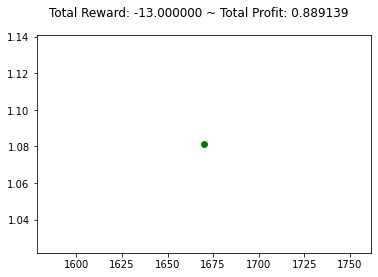

{'total_reward': -12.000000000005357, 'total_profit': 0.8891388200458071, 'position': 0}


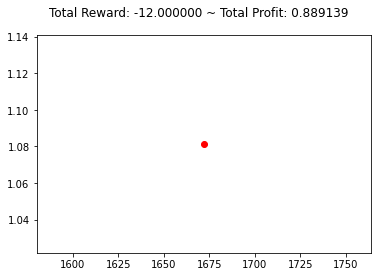

{'total_reward': -14.000000000005137, 'total_profit': 0.8887277526301596, 'position': 1}


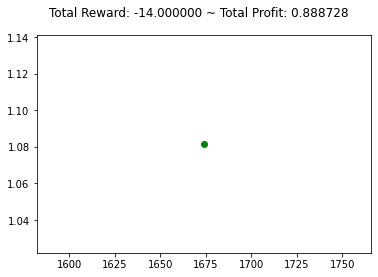

{'total_reward': -15.000000000005027, 'total_profit': 0.8887277526301596, 'position': 0}


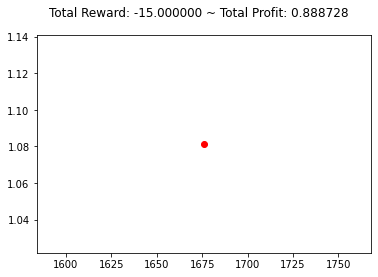

{'total_reward': -14.000000000005137, 'total_profit': 0.8885633712831458, 'position': 1}


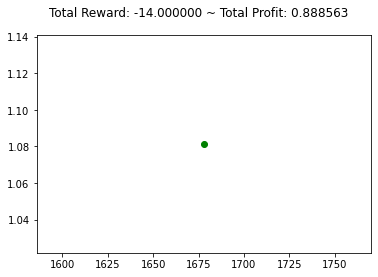

{'total_reward': -14.000000000005137, 'total_profit': 0.8883168448692136, 'position': 1}


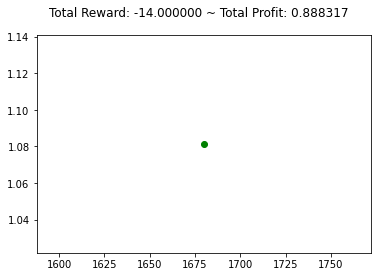

{'total_reward': -14.000000000005137, 'total_profit': 0.8883168448692136, 'position': 1}


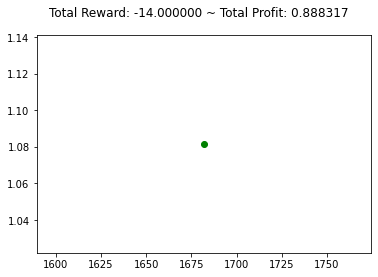

{'total_reward': -11.000000000005468, 'total_profit': 0.8881525547185072, 'position': 1}


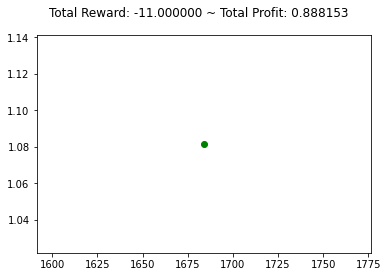

{'total_reward': -12.000000000005357, 'total_profit': 0.8878240655628092, 'position': 1}


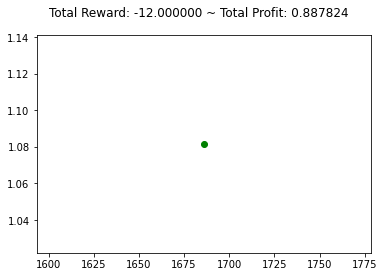

{'total_reward': -13.000000000005247, 'total_profit': 0.8878240655628092, 'position': 0}


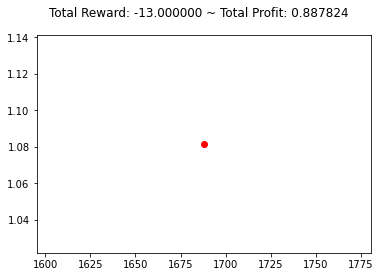

{'total_reward': -12.000000000005357, 'total_profit': 0.8876598513640553, 'position': 1}


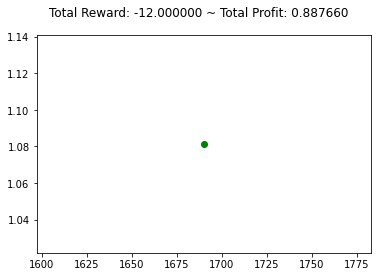

{'total_reward': -12.000000000005357, 'total_profit': 0.8874135756261388, 'position': 1}


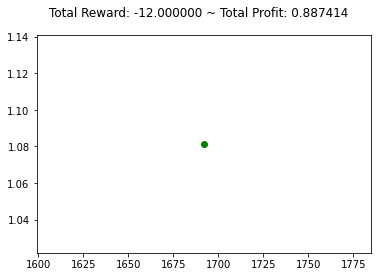

{'total_reward': -13.000000000005247, 'total_profit': 0.8870853294357832, 'position': 1}


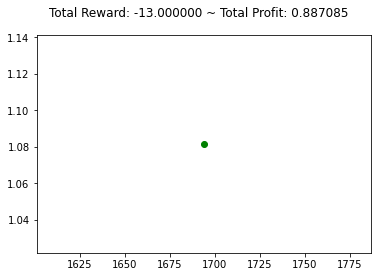

{'total_reward': -14.000000000005137, 'total_profit': 0.8870853294357832, 'position': 0}


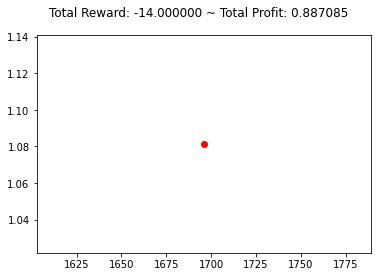

{'total_reward': -14.000000000005137, 'total_profit': 0.8868392130954238, 'position': 1}


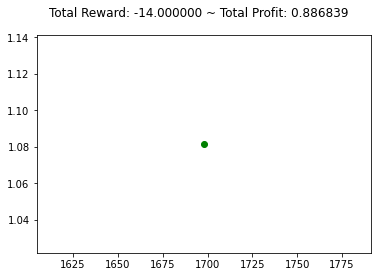

{'total_reward': -14.000000000005137, 'total_profit': 0.8868392130954238, 'position': 0}


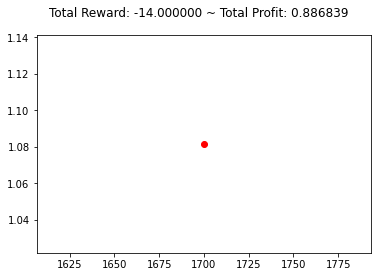

{'total_reward': -13.000000000005247, 'total_profit': 0.8866751658861942, 'position': 1}


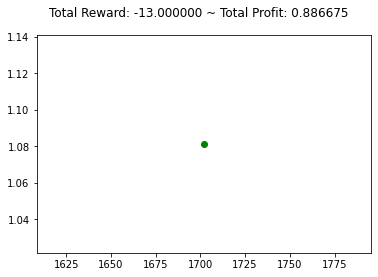

{'total_reward': -9.000000000005688, 'total_profit': 0.8865931574542772, 'position': 1}


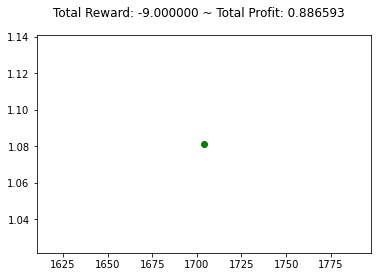

{'total_reward': -9.000000000005688, 'total_profit': 0.8865931574542772, 'position': 1}


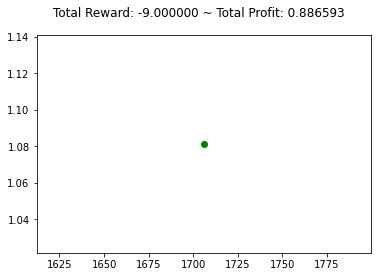

{'total_reward': -9.000000000005688, 'total_profit': 0.8865931574542772, 'position': 0}


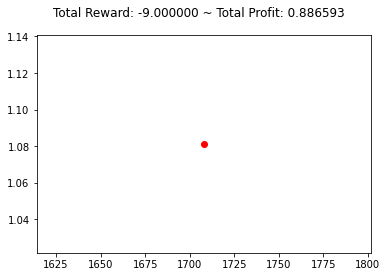

{'total_reward': -9.000000000005688, 'total_profit': 0.8863471549133632, 'position': 1}


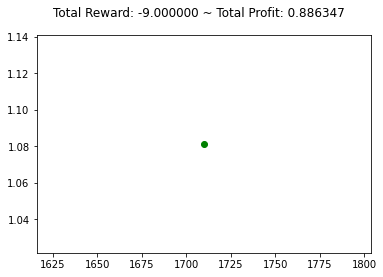

{'total_reward': -9.000000000005688, 'total_profit': 0.8863471549133632, 'position': 1}


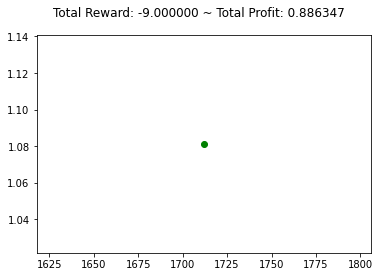

{'total_reward': -9.000000000005688, 'total_profit': 0.8863471549133632, 'position': 1}


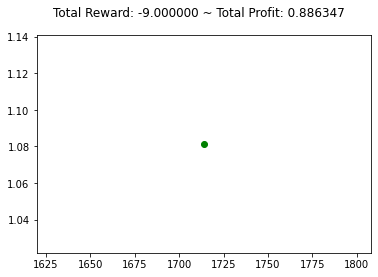

{'total_reward': -8.000000000005798, 'total_profit': 0.8863471549133632, 'position': 0}


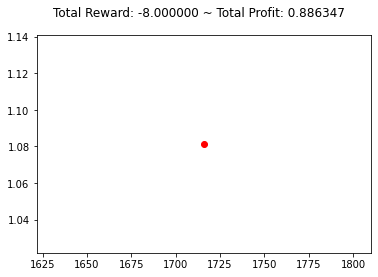

{'total_reward': -8.000000000005798, 'total_profit': 0.8861012433749613, 'position': 1}


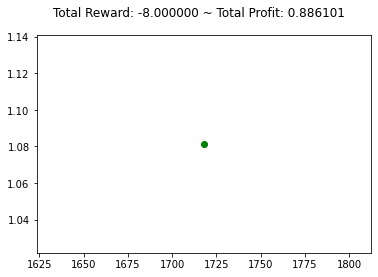

{'total_reward': -9.000000000005688, 'total_profit': 0.8858553773251903, 'position': 1}


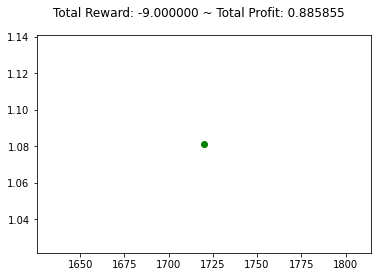

{'total_reward': -6.000000000006018, 'total_profit': 0.8858553773251903, 'position': 0}


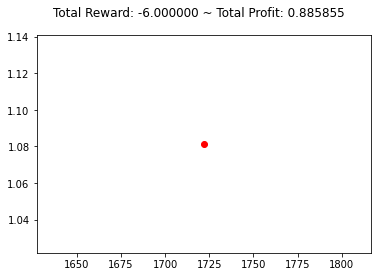

{'total_reward': -4.000000000006239, 'total_profit': 0.8857734522926068, 'position': 0}


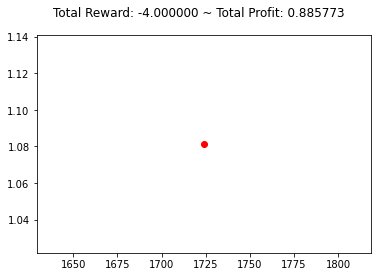

{'total_reward': -2.000000000006459, 'total_profit': 0.8855276999244502, 'position': 0}


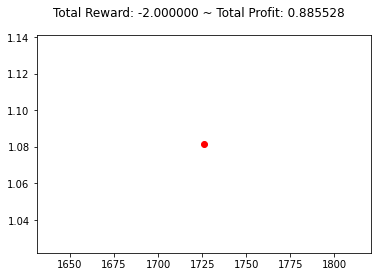

{'total_reward': -2.000000000006459, 'total_profit': 0.8855276999244502, 'position': 0}


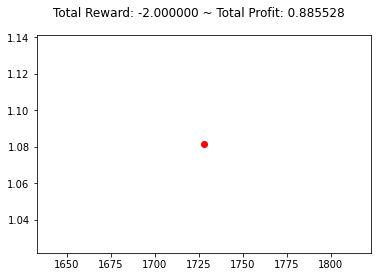

{'total_reward': -4.458655666894629e-12, 'total_profit': 0.8852820611727376, 'position': 0}


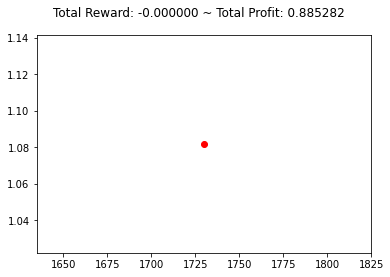

{'total_reward': -4.458655666894629e-12, 'total_profit': 0.8850365359639442, 'position': 1}


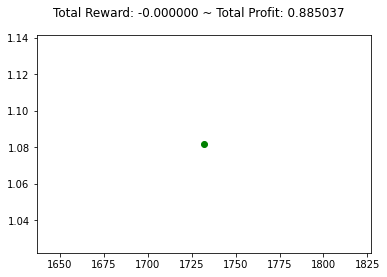

{'total_reward': 2.999999999995211, 'total_profit': 0.8850365359639442, 'position': 0}


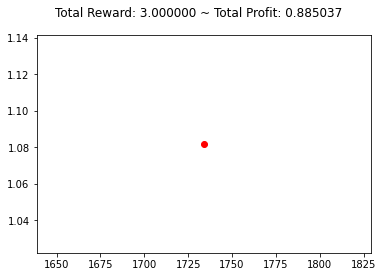

{'total_reward': 5.9999999999948805, 'total_profit': 0.8850365359639442, 'position': 1}


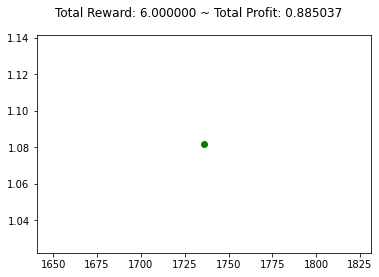

{'total_reward': 5.9999999999948805, 'total_profit': 0.8850365359639442, 'position': 1}


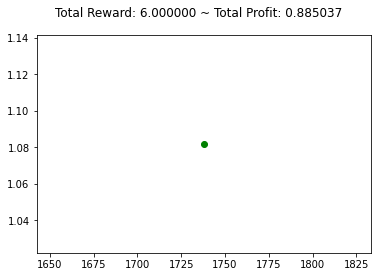

{'total_reward': 5.9999999999948805, 'total_profit': 0.8850365359639442, 'position': 1}


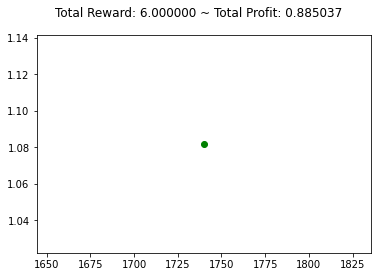

{'total_reward': 5.9999999999948805, 'total_profit': 0.8850365359639442, 'position': 1}


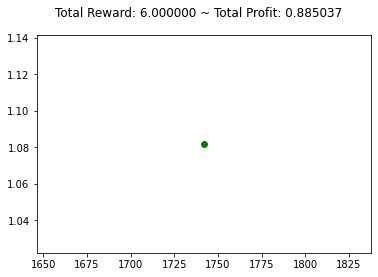

{'total_reward': 3.9999999999928804, 'total_profit': 0.8847910334574355, 'position': 1}


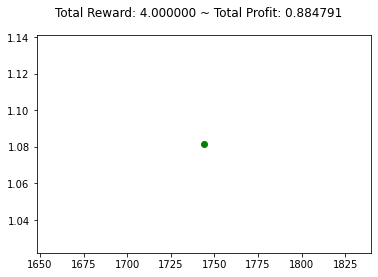

{'total_reward': 5.9999999999948805, 'total_profit': 0.8847910334574355, 'position': 0}


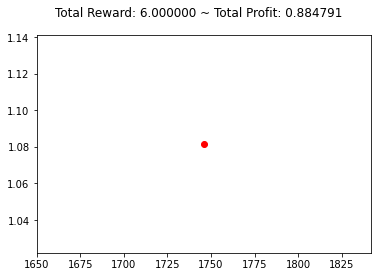

{'total_reward': 5.9999999999948805, 'total_profit': 0.8845456444308688, 'position': 1}


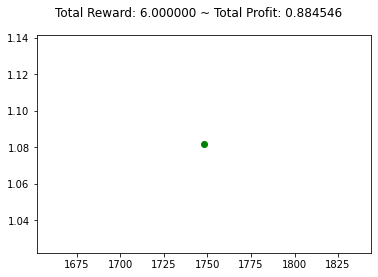

{'total_reward': 1.9999999999908802, 'total_profit': 0.8841367761474117, 'position': 1}


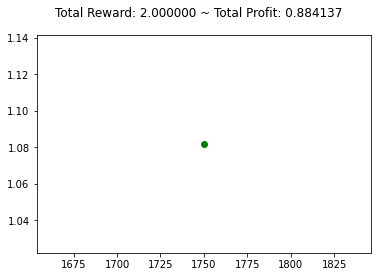

{'total_reward': 1.9999999999908802, 'total_profit': 0.8841367761474117, 'position': 0}


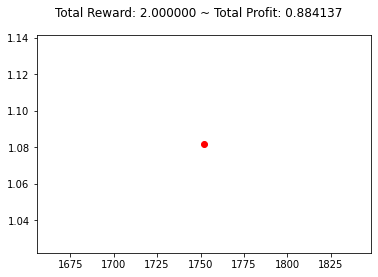

{'total_reward': 3.9999999999928804, 'total_profit': 0.8840550251741204, 'position': 1}


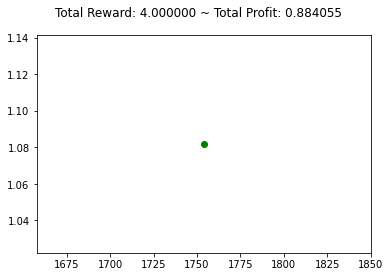

{'total_reward': 6.99999999999477, 'total_profit': 0.883809862937522, 'position': 1}


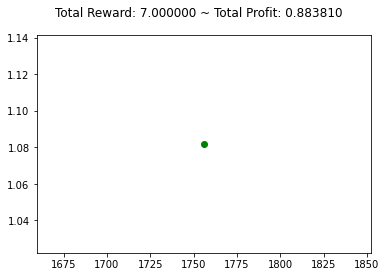

{'total_reward': 6.99999999999477, 'total_profit': 0.883809862937522, 'position': 0}


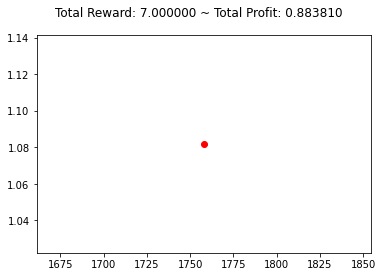

{'total_reward': 6.99999999999477, 'total_profit': 0.883809862937522, 'position': 0}


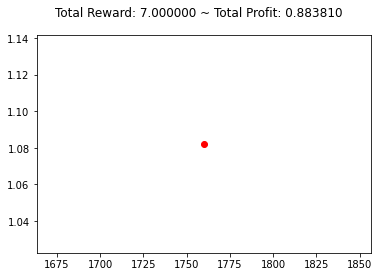

{'total_reward': 5.9999999999948805, 'total_profit': 0.8834831008105463, 'position': 1}


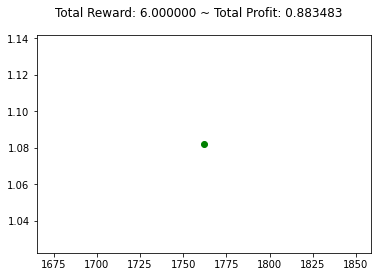

{'total_reward': 5.9999999999948805, 'total_profit': 0.8834831008105463, 'position': 1}


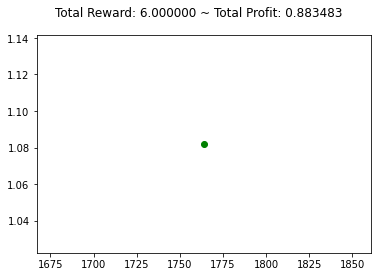

{'total_reward': 5.9999999999948805, 'total_profit': 0.8834831008105463, 'position': 0}


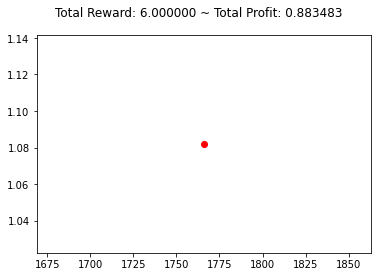

{'total_reward': 5.9999999999948805, 'total_profit': 0.8834831008105463, 'position': 0}


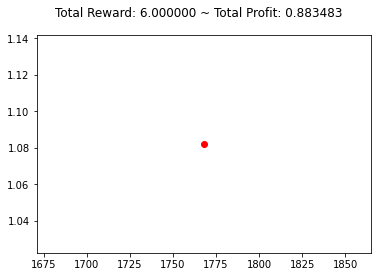

{'total_reward': 6.99999999999477, 'total_profit': 0.8833197650551736, 'position': 1}


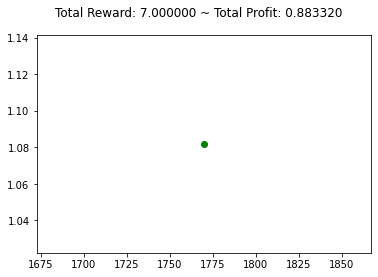

{'total_reward': 7.99999999999466, 'total_profit': 0.8833197650551736, 'position': 0}


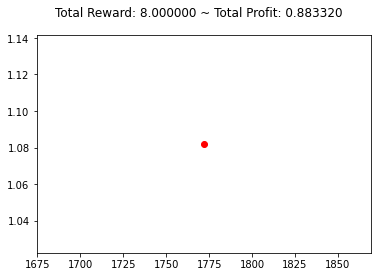

{'total_reward': 7.99999999999466, 'total_profit': 0.8830748293591605, 'position': 1}


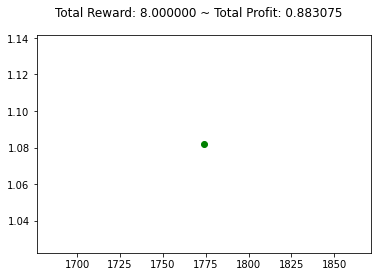

{'total_reward': 6.99999999999477, 'total_profit': 0.882748369163464, 'position': 1}


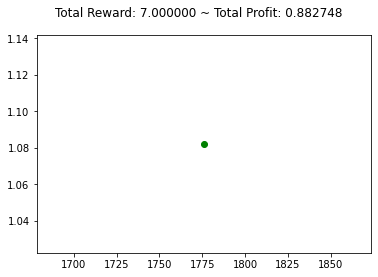

{'total_reward': 9.99999999999444, 'total_profit': 0.882748369163464, 'position': 0}


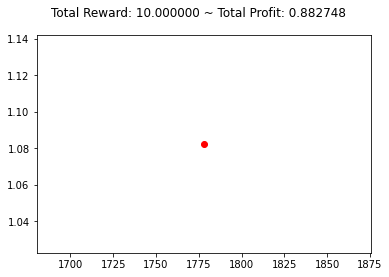

{'total_reward': 9.99999999999444, 'total_profit': 0.882748369163464, 'position': 0}


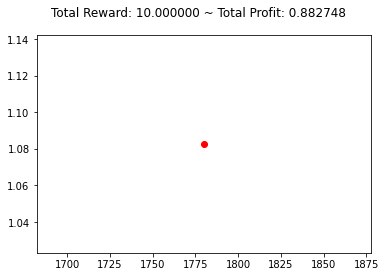

{'total_reward': 9.99999999999444, 'total_profit': 0.882748369163464, 'position': 0}


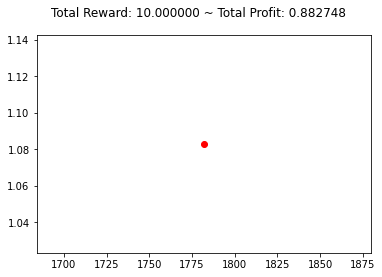

{'total_reward': 5.9999999999948805, 'total_profit': 0.8821776442549811, 'position': 1}


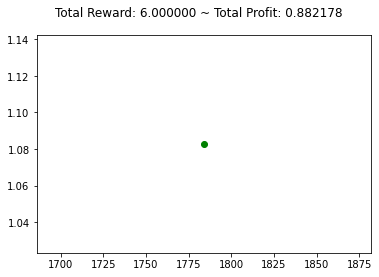

{'total_reward': 5.9999999999948805, 'total_profit': 0.8821776442549811, 'position': 0}


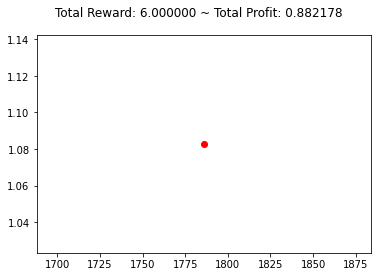

{'total_reward': 2.999999999995211, 'total_profit': 0.8816889031778317, 'position': 1}


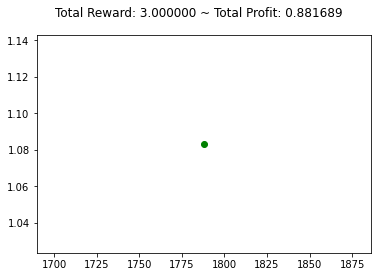

{'total_reward': 2.999999999995211, 'total_profit': 0.8816889031778317, 'position': 0}


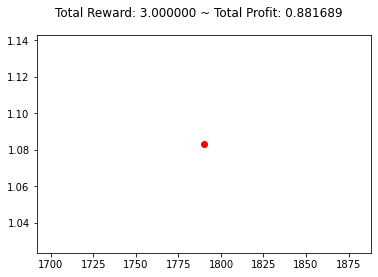

{'total_reward': 1.999999999995321, 'total_profit': 0.8813632863730388, 'position': 1}


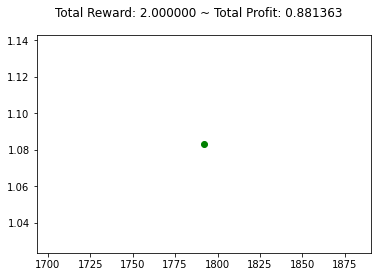

{'total_reward': 1.999999999995321, 'total_profit': 0.8813632863730388, 'position': 0}


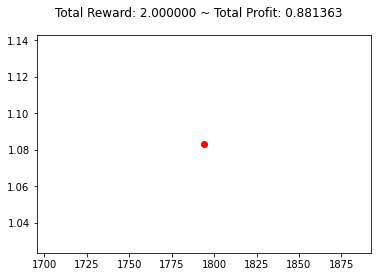

{'total_reward': -1.0000000000043485, 'total_profit': 0.8808751767442555, 'position': 1}


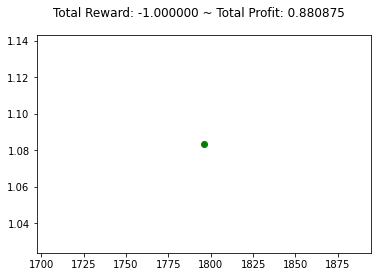

{'total_reward': -3.0000000000041283, 'total_profit': 0.8808751767442555, 'position': 0}


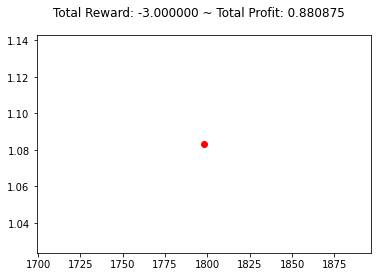

{'total_reward': -4.000000000004018, 'total_profit': 0.8806312120535029, 'position': 0}


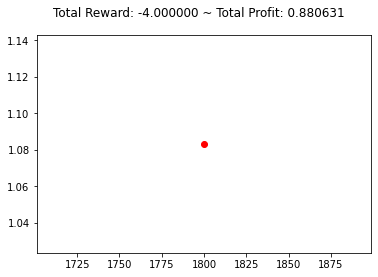

{'total_reward': -1.0000000000043485, 'total_profit': 0.8806312120535029, 'position': 1}


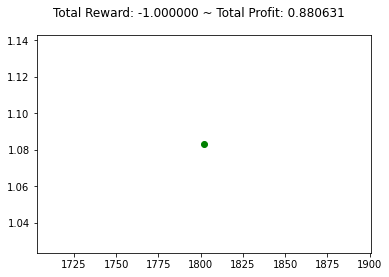

{'total_reward': -1.0000000000043485, 'total_profit': 0.8806312120535029, 'position': 1}


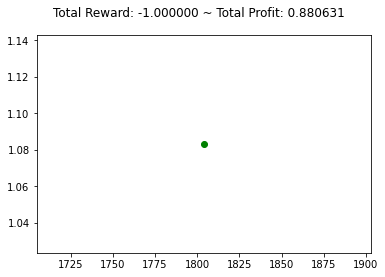

{'total_reward': 0.9999999999954312, 'total_profit': 0.8803872698894992, 'position': 1}


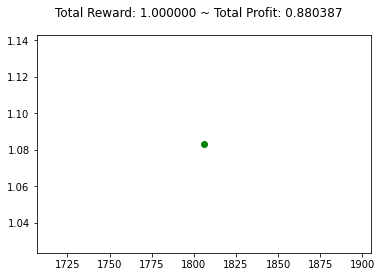

{'total_reward': 0.9999999999954312, 'total_profit': 0.8803872698894992, 'position': 1}


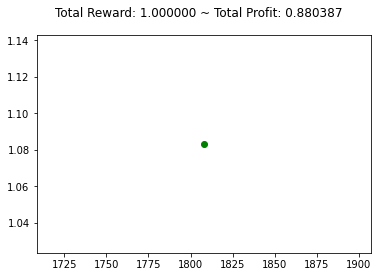

{'total_reward': -1.0000000000043485, 'total_profit': 0.8801433502543249, 'position': 1}


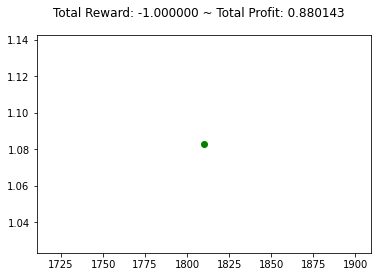

{'total_reward': -2.0000000000042384, 'total_profit': 0.8801433502543249, 'position': 0}


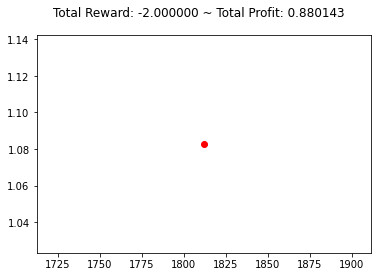

{'total_reward': -3.0000000000041283, 'total_profit': 0.8798182141810873, 'position': 0}


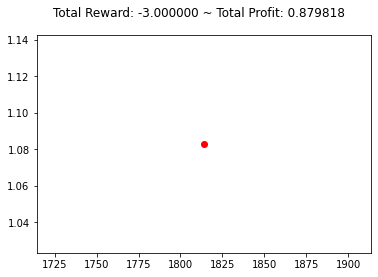

{'total_reward': -3.0000000000041283, 'total_profit': 0.8798182141810873, 'position': 0}


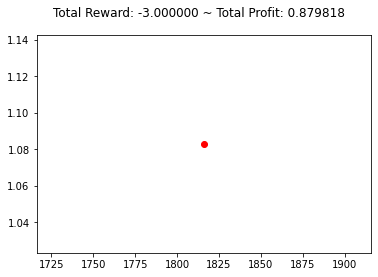

{'total_reward': -7.000000000003688, 'total_profit': 0.8792496462804903, 'position': 1}


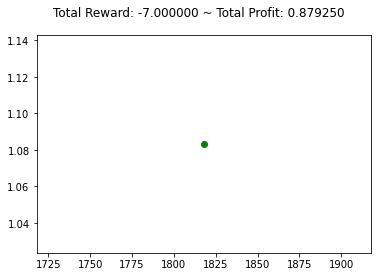

{'total_reward': -7.000000000003688, 'total_profit': 0.8792496462804903, 'position': 1}


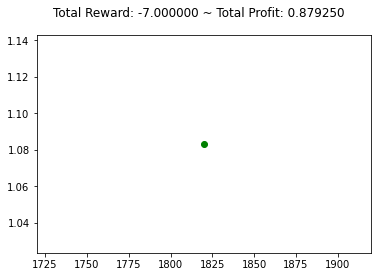

{'total_reward': -8.000000000003578, 'total_profit': 0.8790061093089419, 'position': 1}


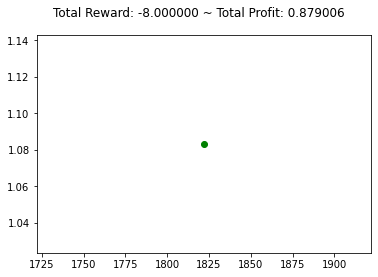

{'total_reward': -8.000000000003578, 'total_profit': 0.8790061093089419, 'position': 1}


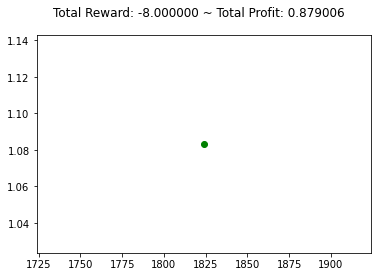

{'total_reward': -7.000000000003688, 'total_profit': 0.8787626622698054, 'position': 1}


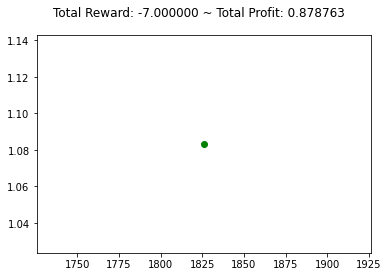

{'total_reward': -5.000000000003908, 'total_profit': 0.8787626622698054, 'position': 0}


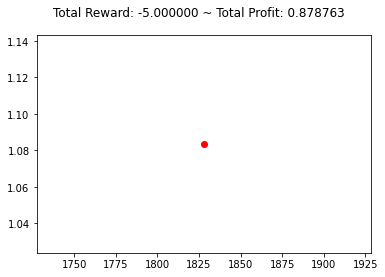

{'total_reward': -5.000000000003908, 'total_profit': 0.8787626622698054, 'position': 0}


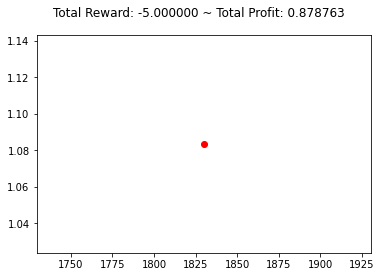

{'total_reward': -5.000000000003908, 'total_profit': 0.8785193275839267, 'position': 1}


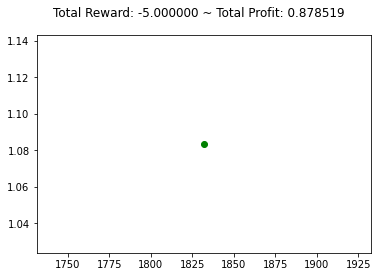

{'total_reward': -5.000000000003908, 'total_profit': 0.8785193275839267, 'position': 1}


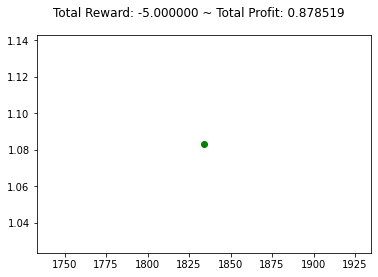

{'total_reward': -8.000000000003578, 'total_profit': 0.8785193275839267, 'position': 0}


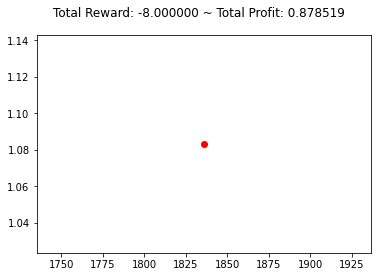

{'total_reward': -8.000000000003578, 'total_profit': 0.8782759928980481, 'position': 1}


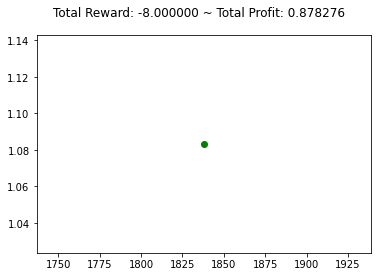

{'total_reward': -9.000000000003467, 'total_profit': 0.8782759928980481, 'position': 0}


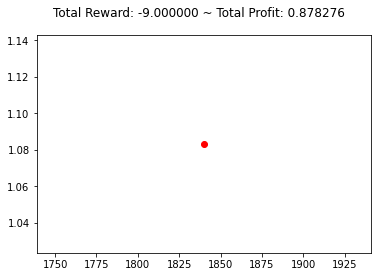

{'total_reward': -11.000000000003247, 'total_profit': 0.8778705848511048, 'position': 1}


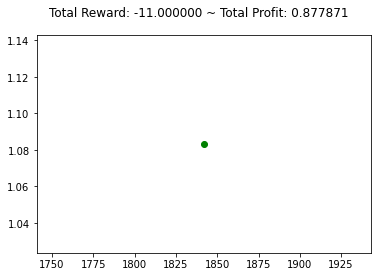

{'total_reward': -8.000000000003578, 'total_profit': 0.8776275196222582, 'position': 1}


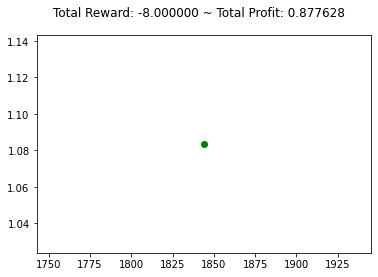

{'total_reward': -3.9999999999995772, 'total_profit': 0.8775465203126485, 'position': 1}


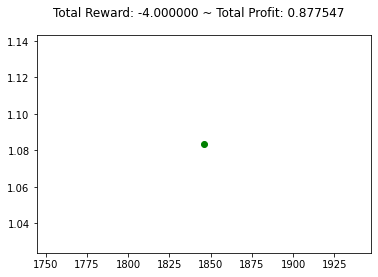

{'total_reward': -5.999999999999357, 'total_profit': 0.8775465203126485, 'position': 0}


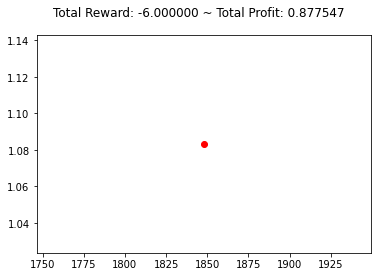

{'total_reward': -4.999999999999467, 'total_profit': 0.8773844917823101, 'position': 1}


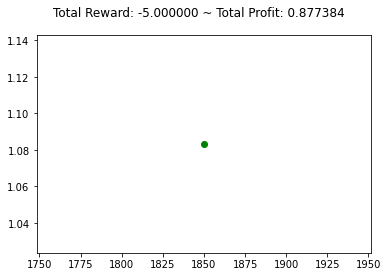

{'total_reward': -4.999999999999467, 'total_profit': 0.8773844917823101, 'position': 0}


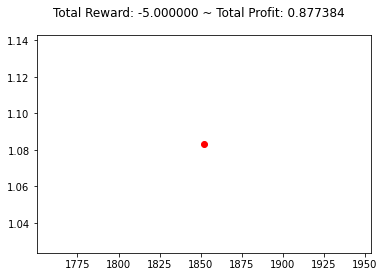

{'total_reward': -4.999999999999467, 'total_profit': 0.8771414938617649, 'position': 1}


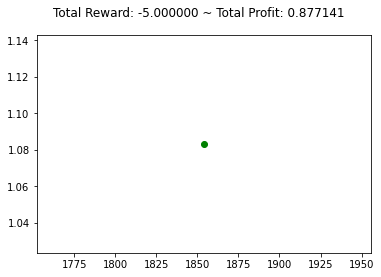

{'total_reward': -5.999999999999357, 'total_profit': 0.8771414938617649, 'position': 0}


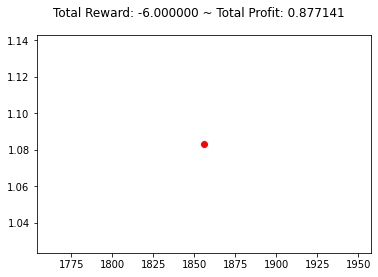

{'total_reward': -5.999999999999357, 'total_profit': 0.8771414938617649, 'position': 0}


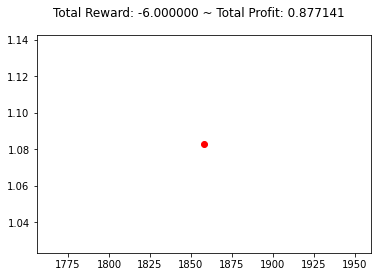

{'total_reward': -1.9999999999997975, 'total_profit': 0.8772225081310787, 'position': 1}


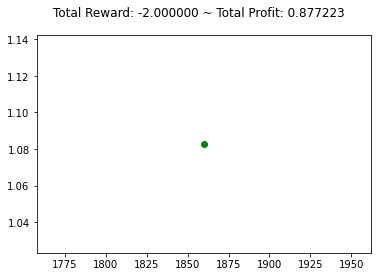

{'total_reward': -1.9999999999997975, 'total_profit': 0.8772225081310787, 'position': 1}


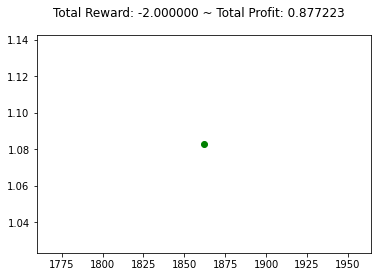

{'total_reward': 1.999999999999762, 'total_profit': 0.8772225081310787, 'position': 0}


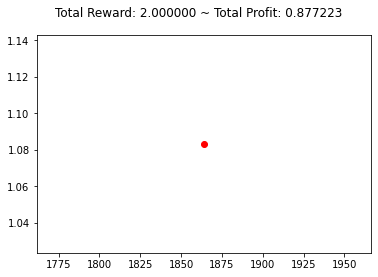

{'total_reward': 1.999999999999762, 'total_profit': 0.8769795326417986, 'position': 1}


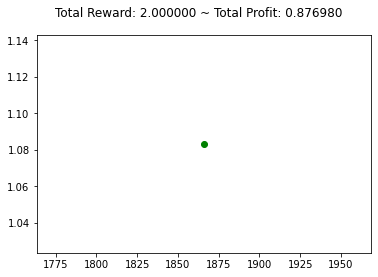

{'total_reward': 1.999999999999762, 'total_profit': 0.8769795326417986, 'position': 0}


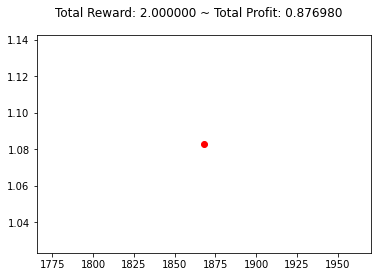

{'total_reward': -1.7763568394002505e-14, 'total_profit': 0.8768175788961584, 'position': 0}


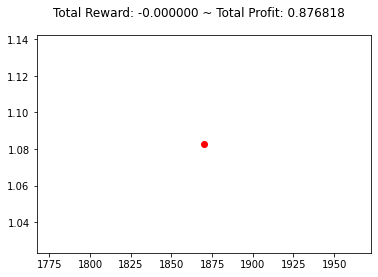

{'total_reward': -0.9999999999999076, 'total_profit': 0.8765746258402161, 'position': 0}


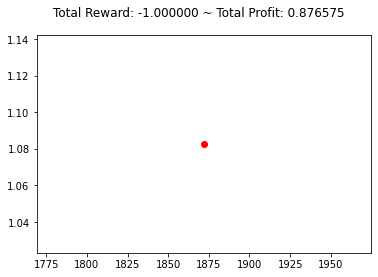

{'total_reward': -1.7763568394002505e-14, 'total_profit': 0.8763317176675282, 'position': 0}


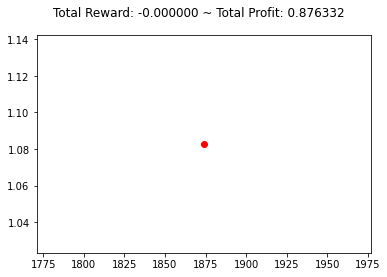

{'total_reward': -1.9999999999997975, 'total_profit': 0.876007989659524, 'position': 0}


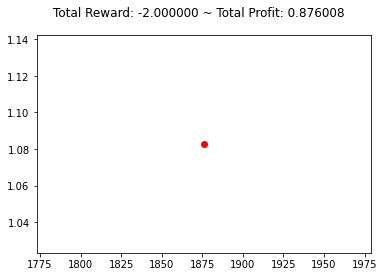

{'total_reward': -0.9999999999999076, 'total_profit': 0.8758461555583491, 'position': 0}


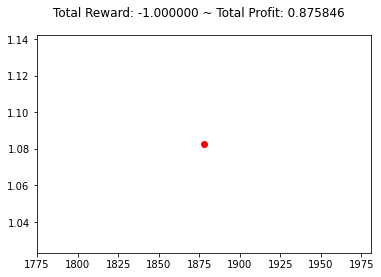

{'total_reward': -0.9999999999999076, 'total_profit': 0.8756034492525413, 'position': 0}


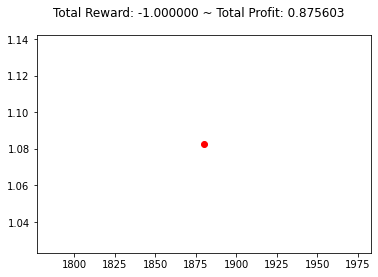

{'total_reward': 3.9999999999995417, 'total_profit': 0.8757652833620049, 'position': 1}


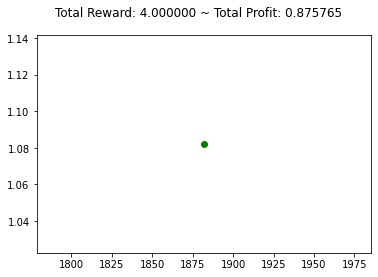

{'total_reward': 3.9999999999995417, 'total_profit': 0.8757652833620049, 'position': 1}


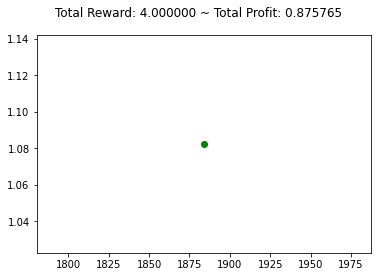

{'total_reward': 2.999999999999652, 'total_profit': 0.8757652833620049, 'position': 0}


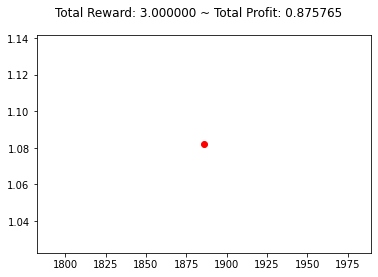

{'total_reward': 2.999999999999652, 'total_profit': 0.8757652833620049, 'position': 0}


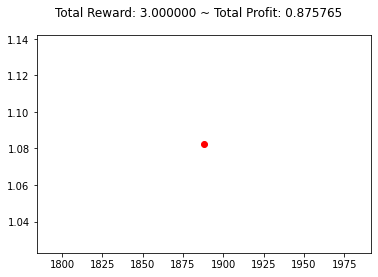

{'total_reward': 3.9999999999995417, 'total_profit': 0.8756033894192445, 'position': 0}


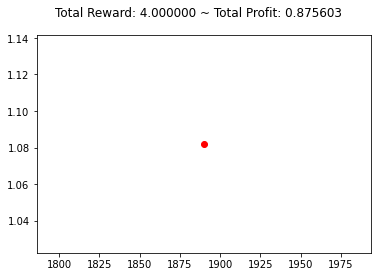

{'total_reward': 3.9999999999995417, 'total_profit': 0.8753605933966678, 'position': 1}


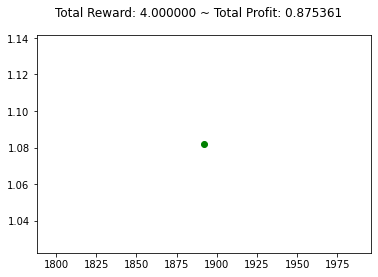

{'total_reward': 3.9999999999995417, 'total_profit': 0.8753605933966678, 'position': 0}


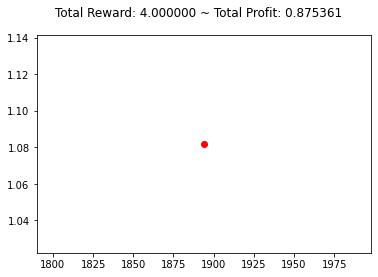

{'total_reward': 2.999999999999652, 'total_profit': 0.8750369850442107, 'position': 1}


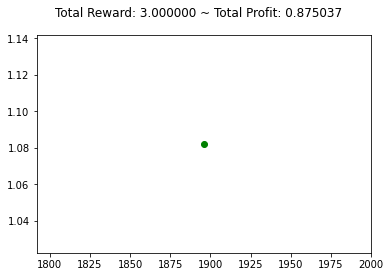

{'total_reward': 2.999999999999652, 'total_profit': 0.8750369850442107, 'position': 0}


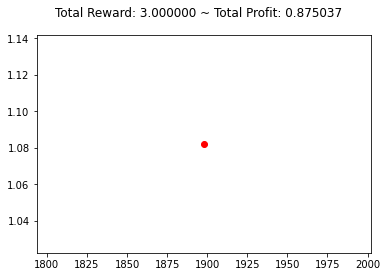

{'total_reward': 4.999999999999432, 'total_profit': 0.8748752257346545, 'position': 0}


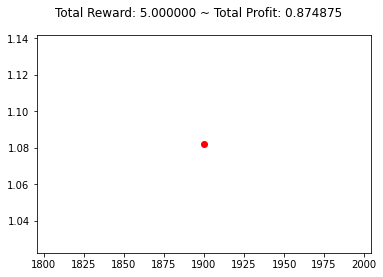

{'total_reward': 9.000000000001211, 'total_profit': 0.8750370149580915, 'position': 0}


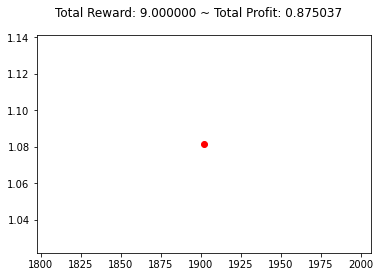

{'total_reward': 10.000000000001101, 'total_profit': 0.8748751658847616, 'position': 1}


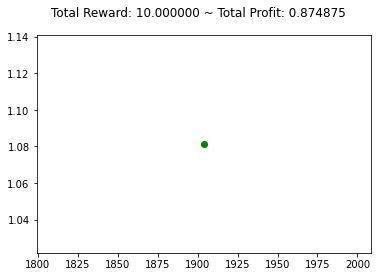

{'total_reward': 9.000000000001211, 'total_profit': 0.8748751658847616, 'position': 0}


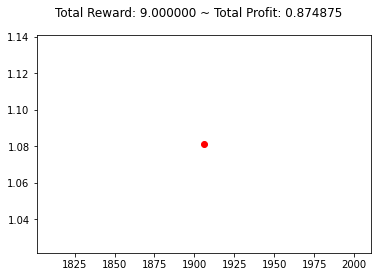

{'total_reward': 8.000000000001322, 'total_profit': 0.8745515276101349, 'position': 1}


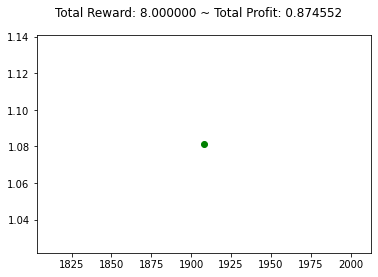

{'total_reward': 7.000000000001432, 'total_profit': 0.8744706105553968, 'position': 1}


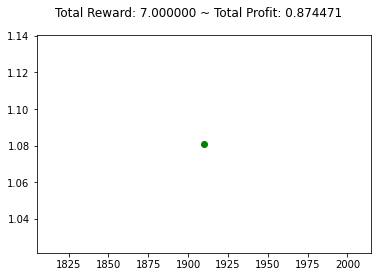

{'total_reward': 7.000000000001432, 'total_profit': 0.8744706105553968, 'position': 1}


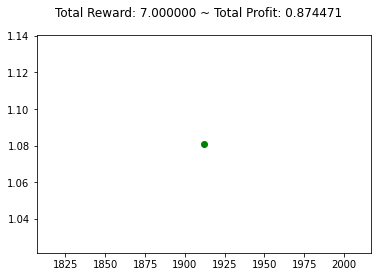

{'total_reward': 7.000000000001432, 'total_profit': 0.8744706105553968, 'position': 0}


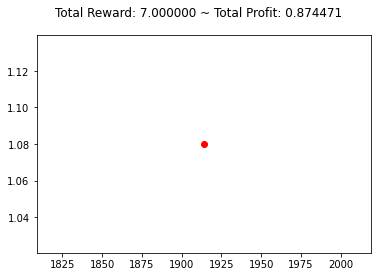

{'total_reward': 15.00000000000055, 'total_profit': 0.8748754580602834, 'position': 1}


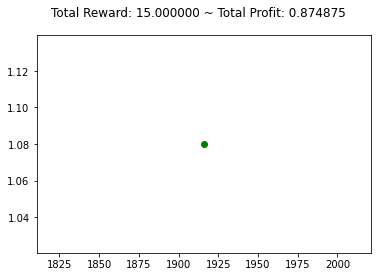

{'total_reward': 15.00000000000055, 'total_profit': 0.8748754580602834, 'position': 0}


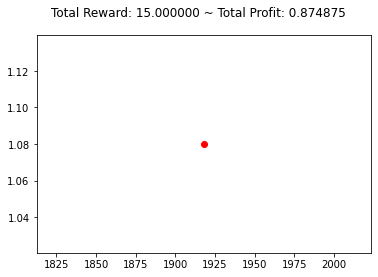

{'total_reward': 19.00000000000233, 'total_profit': 0.8749564950608449, 'position': 1}


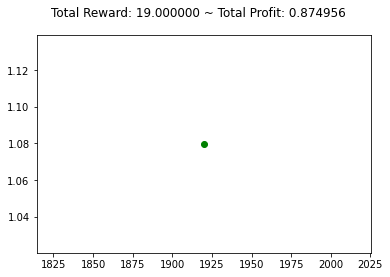

{'total_reward': 14.000000000002881, 'total_profit': 0.8749564950608449, 'position': 0}


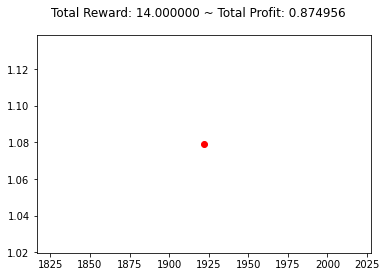

{'total_reward': 16.00000000000266, 'total_profit': 0.8748753979716745, 'position': 1}


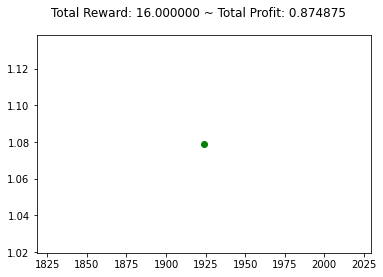

{'total_reward': 23.00000000000189, 'total_profit': 0.8748753979716745, 'position': 0}


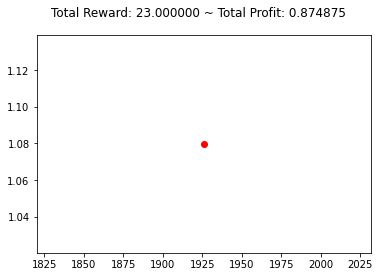

{'total_reward': 18.99999999999789, 'total_profit': 0.8744702880448492, 'position': 0}


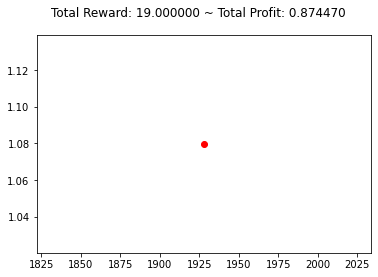

{'total_reward': 17.99999999999578, 'total_profit': 0.8741463201693114, 'position': 1}


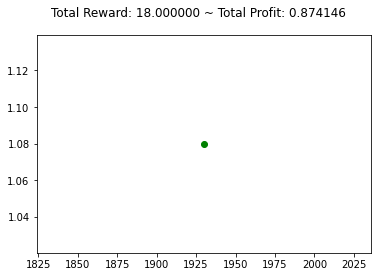

{'total_reward': 19.99999999999334, 'total_profit': 0.8741463201693114, 'position': 1}


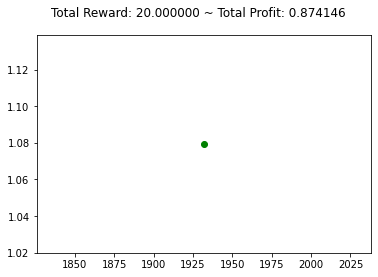

{'total_reward': 19.99999999999334, 'total_profit': 0.8741463201693114, 'position': 1}


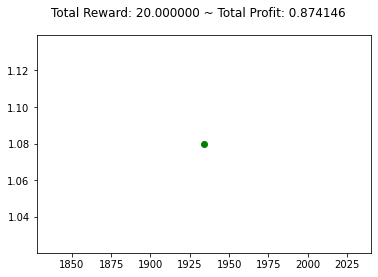

{'total_reward': 22.99999999999301, 'total_profit': 0.8741463201693114, 'position': 0}


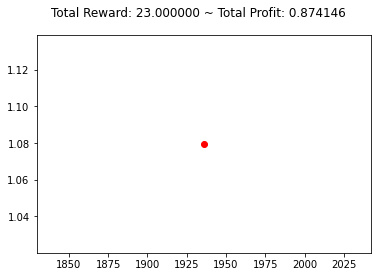

{'total_reward': 18.99999999999345, 'total_profit': 0.8739034117809724, 'position': 0}


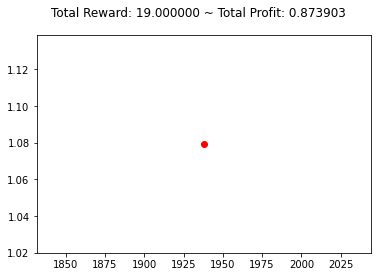

{'total_reward': 21.99999999999312, 'total_profit': 0.8739034117809724, 'position': 1}


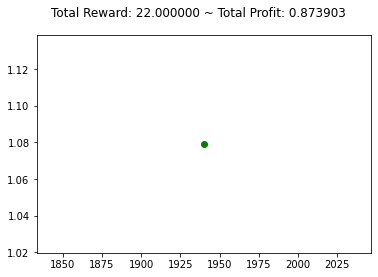

{'total_reward': 26.999999999992568, 'total_profit': 0.8739034117809724, 'position': 0}


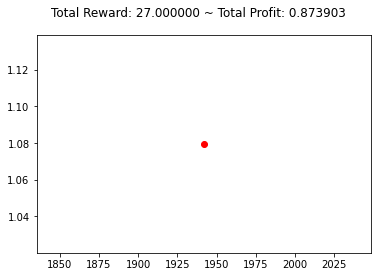

{'total_reward': 29.999999999992237, 'total_profit': 0.8739034117809724, 'position': 1}


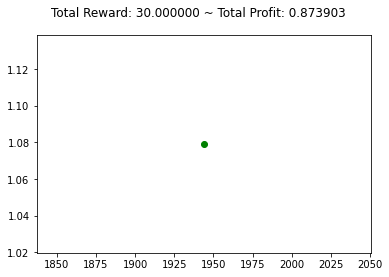

{'total_reward': 30.999999999992127, 'total_profit': 0.8739034117809724, 'position': 0}


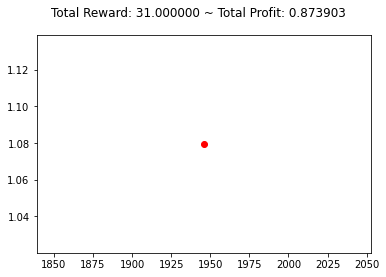

{'total_reward': 25.999999999990457, 'total_profit': 0.8732558960549143, 'position': 1}


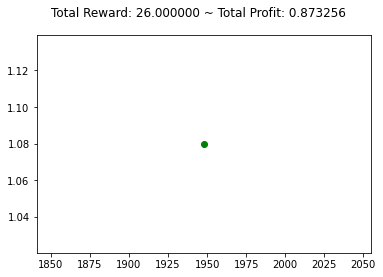

{'total_reward': 19.999999999988898, 'total_profit': 0.8732558960549143, 'position': 0}


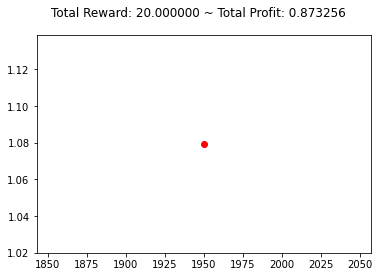

{'total_reward': 14.999999999989448, 'total_profit': 0.872608800170472, 'position': 0}


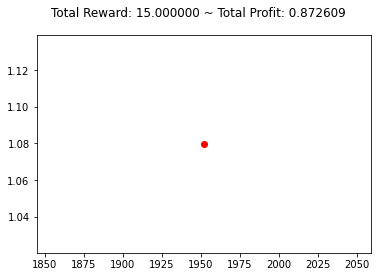

{'total_reward': 11.999999999987558, 'total_profit': 0.87212397261227, 'position': 1}


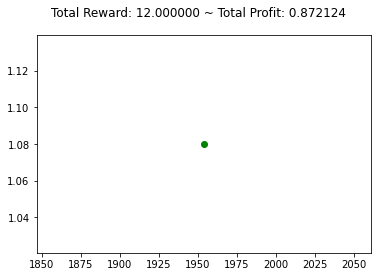

{'total_reward': 11.999999999987558, 'total_profit': 0.87212397261227, 'position': 1}


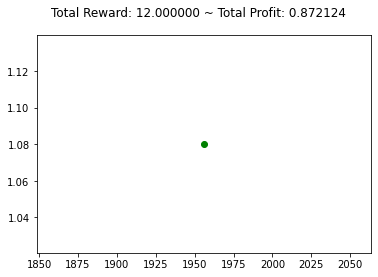

{'total_reward': 15.999999999987118, 'total_profit': 0.87212397261227, 'position': 0}


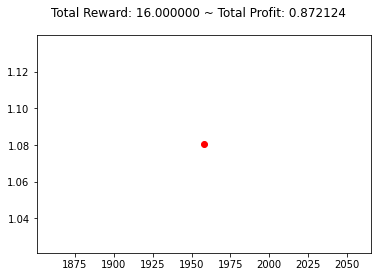

{'total_reward': 15.999999999987118, 'total_profit': 0.8718817832280401, 'position': 1}


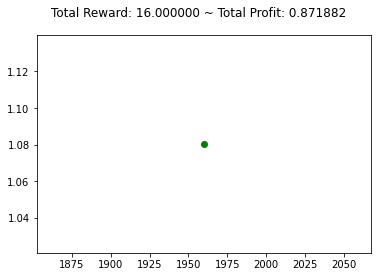

{'total_reward': 11.999999999987558, 'total_profit': 0.8715588939462225, 'position': 1}


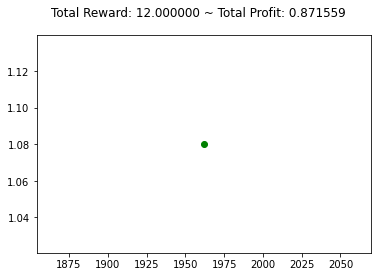

{'total_reward': 8.999999999987889, 'total_profit': 0.8715588939462225, 'position': 0}


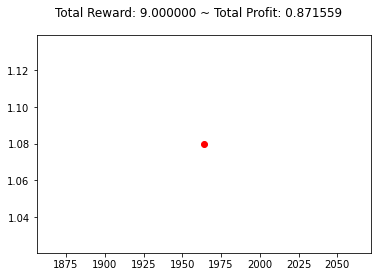

{'total_reward': 9.999999999987779, 'total_profit': 0.8713974493053137, 'position': 0}


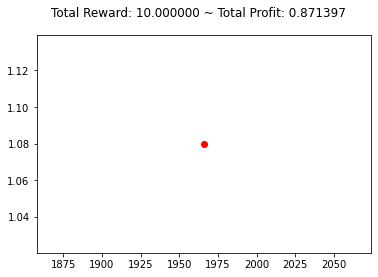

{'total_reward': 9.999999999987779, 'total_profit': 0.8713974493053137, 'position': 0}


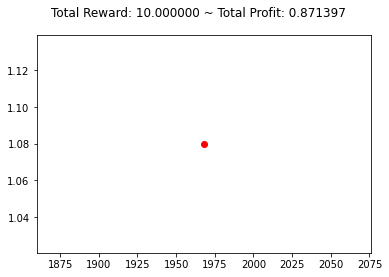

{'total_reward': 9.999999999987779, 'total_profit': 0.8713974493053137, 'position': 0}


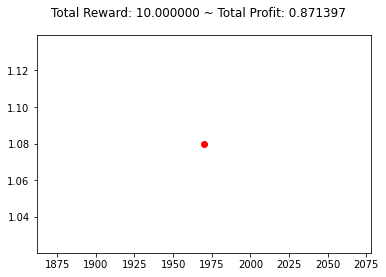

{'total_reward': 9.999999999987779, 'total_profit': 0.8713974493053137, 'position': 0}


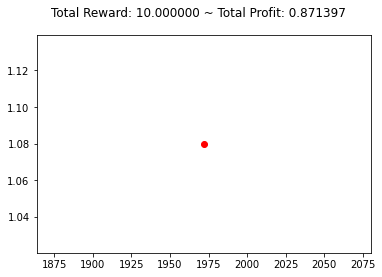

{'total_reward': 11.999999999987558, 'total_profit': 0.8710746497315759, 'position': 0}


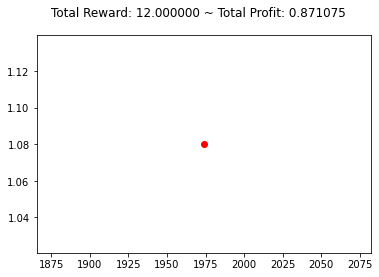

{'total_reward': 11.999999999987558, 'total_profit': 0.8710746497315759, 'position': 0}


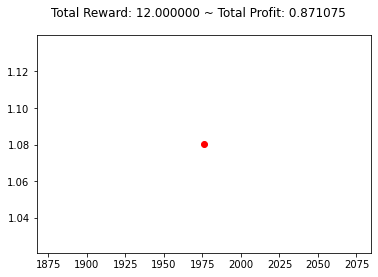

{'total_reward': 7.999999999987999, 'total_profit': 0.8706714864205829, 'position': 0}


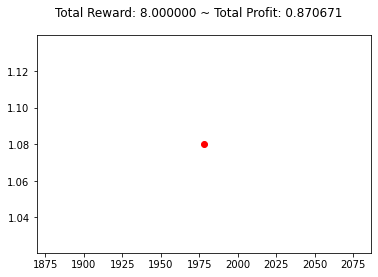

{'total_reward': 7.999999999987999, 'total_profit': 0.8706714864205829, 'position': 0}


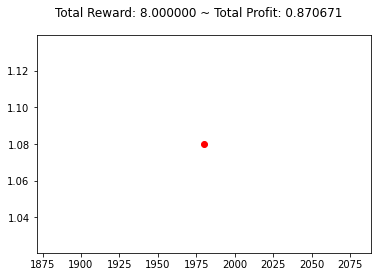

{'total_reward': 7.999999999987999, 'total_profit': 0.8704296556216512, 'position': 1}


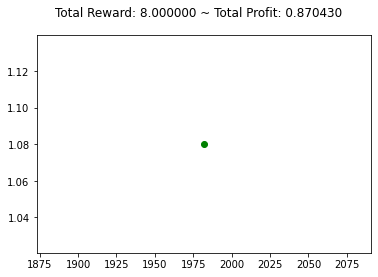

{'total_reward': 5.999999999988219, 'total_profit': 0.8704296556216512, 'position': 0}


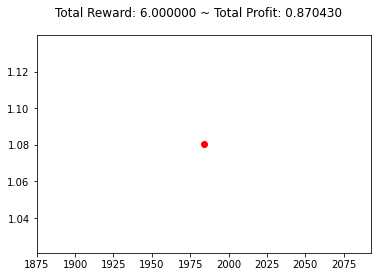

{'total_reward': 1.9999999999886597, 'total_profit': 0.8698656449219058, 'position': 0}


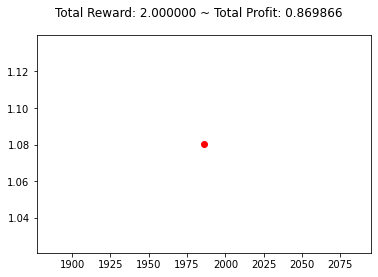

{'total_reward': 5.999999999988219, 'total_profit': 0.8697851092636406, 'position': 0}


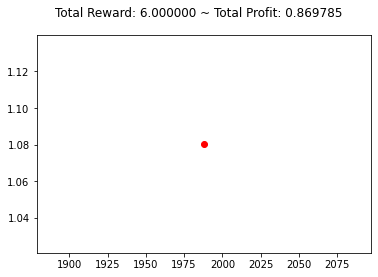

{'total_reward': 5.999999999988219, 'total_profit': 0.8695435693832564, 'position': 0}


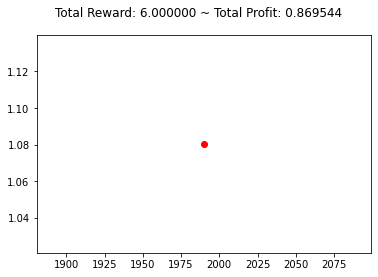

{'total_reward': 5.999999999988219, 'total_profit': 0.8695435693832564, 'position': 0}


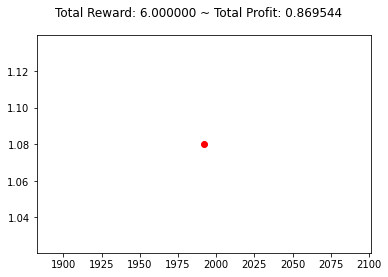

{'total_reward': 9.999999999987779, 'total_profit': 0.8696240901323428, 'position': 1}


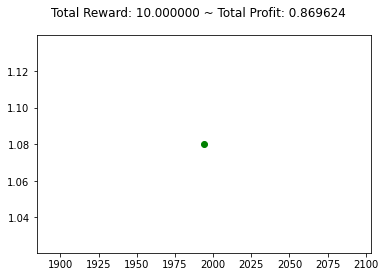

{'total_reward': 13.999999999987338, 'total_profit': 0.8696240901323428, 'position': 0}


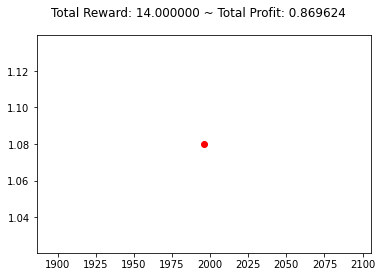

{'total_reward': 16.999999999984787, 'total_profit': 0.8697851614585388, 'position': 0}


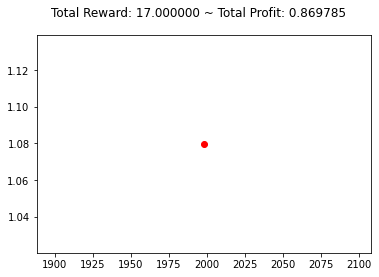

{'total_reward': 15.999999999982677, 'total_profit': 0.8694629292972128, 'position': 1}


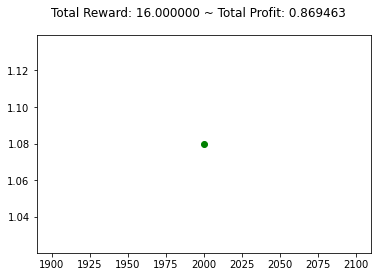

{'total_reward': 15.999999999982677, 'total_profit': 0.8694629292972128, 'position': 1}


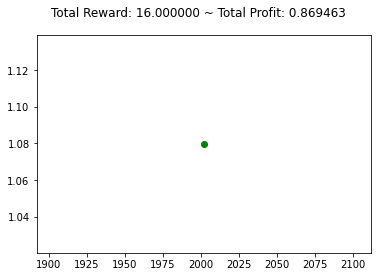

{'total_reward': 15.999999999982677, 'total_profit': 0.8694629292972128, 'position': 0}


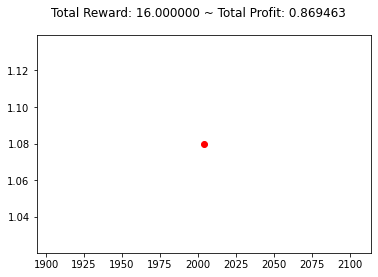

{'total_reward': 15.999999999982677, 'total_profit': 0.8692213447100228, 'position': 1}


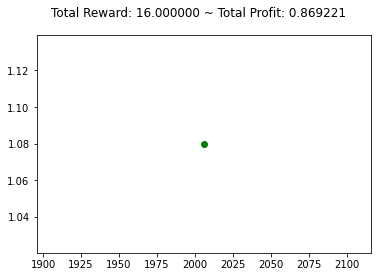

{'total_reward': 16.999999999982567, 'total_profit': 0.8692213447100228, 'position': 0}


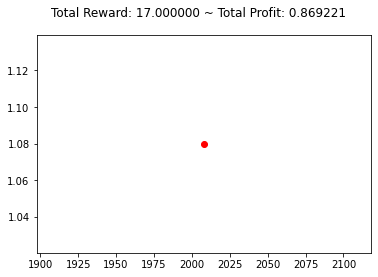

{'total_reward': 15.999999999982677, 'total_profit': 0.8688993810672003, 'position': 1}


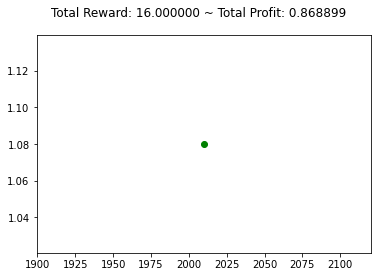

{'total_reward': 16.999999999982567, 'total_profit': 0.8688993810672003, 'position': 0}


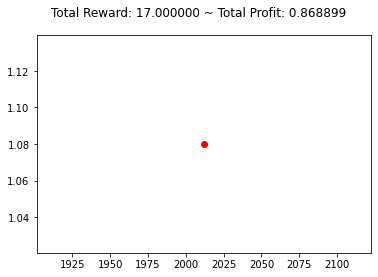

{'total_reward': 17.999999999982457, 'total_profit': 0.868738458874207, 'position': 1}


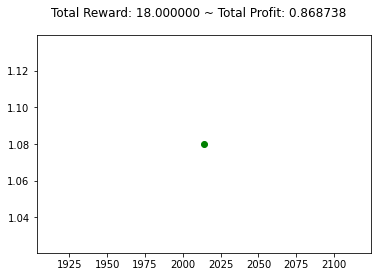

{'total_reward': 18.999999999982347, 'total_profit': 0.868738458874207, 'position': 0}


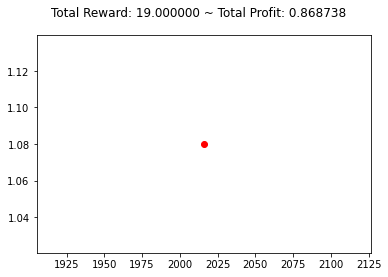

{'total_reward': 20.999999999982126, 'total_profit': 0.8685775664843793, 'position': 0}


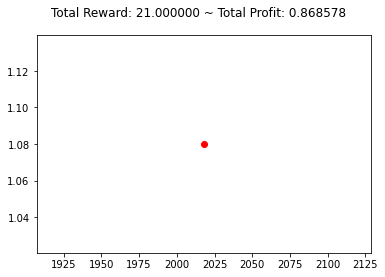

{'total_reward': 20.999999999982126, 'total_profit': 0.8685775664843793, 'position': 0}


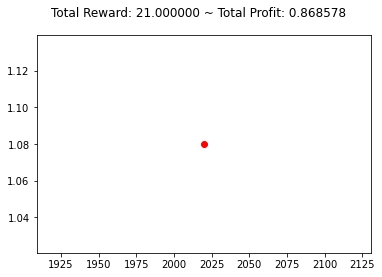

{'total_reward': 22.999999999984126, 'total_profit': 0.8686580201307749, 'position': 0}


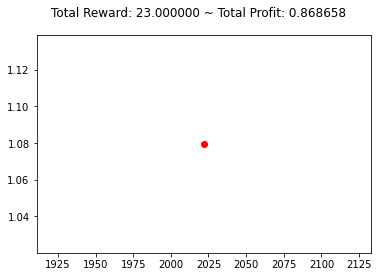

{'total_reward': 20.999999999984347, 'total_profit': 0.8684165921096157, 'position': 0}


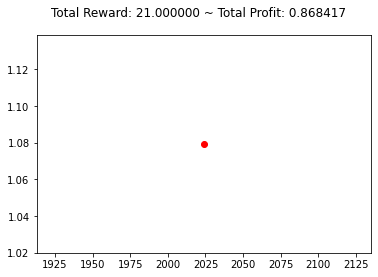

{'total_reward': 19.999999999984457, 'total_profit': 0.868094747731923, 'position': 1}


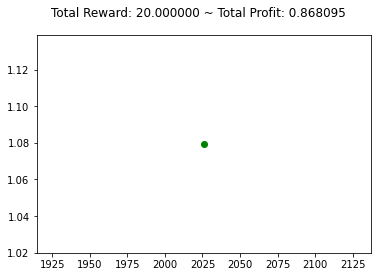

{'total_reward': 17.999999999984677, 'total_profit': 0.867853409186543, 'position': 1}


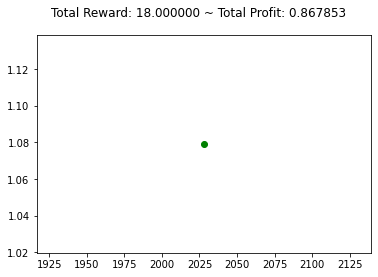

{'total_reward': 17.999999999984677, 'total_profit': 0.867853409186543, 'position': 1}


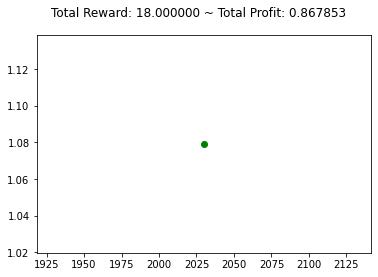

{'total_reward': 15.999999999984897, 'total_profit': 0.8676120930101078, 'position': 1}


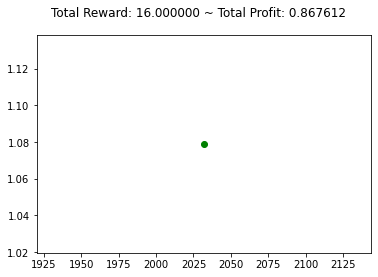

{'total_reward': 11.999999999985338, 'total_profit': 0.8676120930101078, 'position': 0}


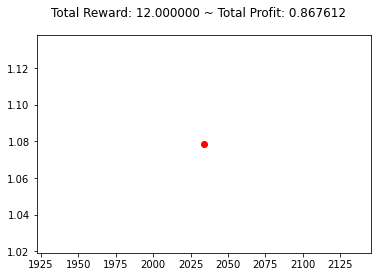

{'total_reward': 10.999999999985448, 'total_profit': 0.8672903381081942, 'position': 1}


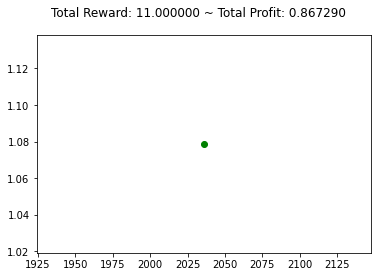

{'total_reward': 9.999999999985558, 'total_profit': 0.8670490890572602, 'position': 1}


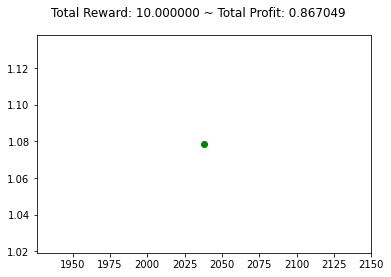

{'total_reward': 9.999999999985558, 'total_profit': 0.8670490890572602, 'position': 0}


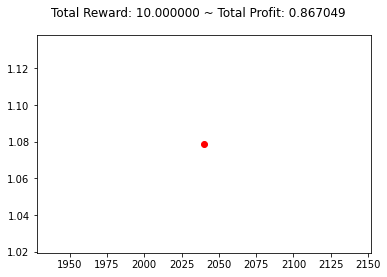

{'total_reward': 9.999999999985558, 'total_profit': 0.8670490890572602, 'position': 0}


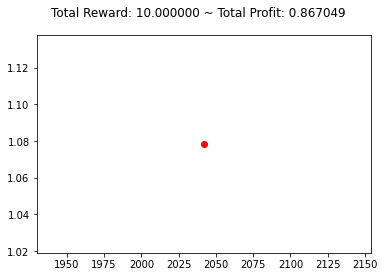

{'total_reward': 9.999999999985558, 'total_profit': 0.8670490890572602, 'position': 0}


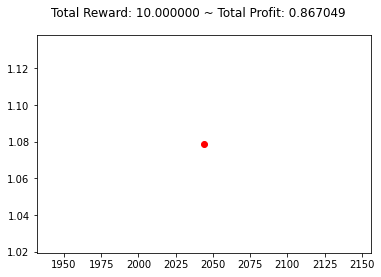

{'total_reward': 7.9999999999857785, 'total_profit': 0.8666471936790006, 'position': 0}


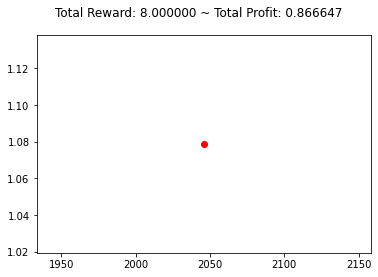

{'total_reward': 1.9999999999864393, 'total_profit': 0.8660850094184359, 'position': 0}


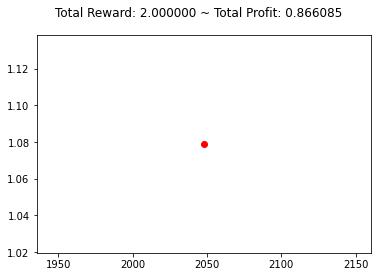

{'total_reward': 3.999999999986219, 'total_profit': 0.8660047197169973, 'position': 1}


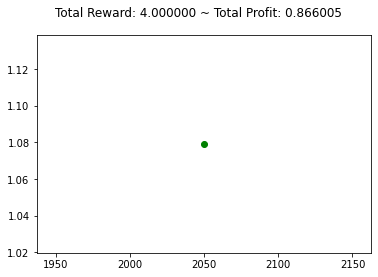

{'total_reward': 3.999999999986219, 'total_profit': 0.8660047197169973, 'position': 1}


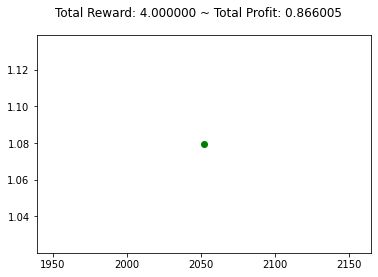

{'total_reward': 10.999999999985448, 'total_profit': 0.8660047197169973, 'position': 0}


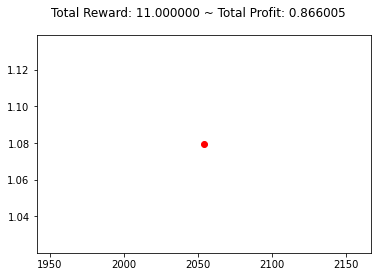

{'total_reward': 12.999999999985228, 'total_profit': 0.8660047197169973, 'position': 0}


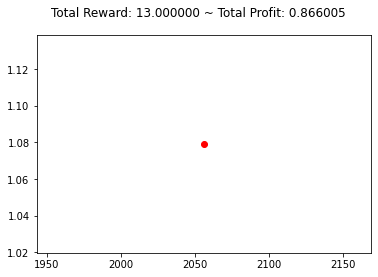

{'total_reward': 12.999999999985228, 'total_profit': 0.8660047197169973, 'position': 0}


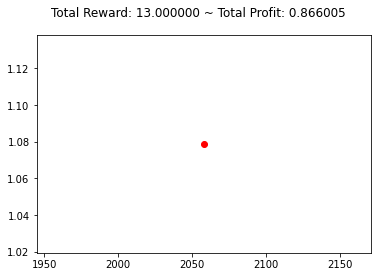

{'total_reward': 12.999999999985228, 'total_profit': 0.8660047197169973, 'position': 0}


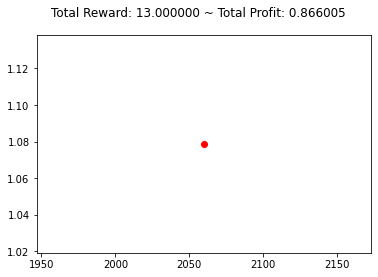

{'total_reward': 16.999999999984787, 'total_profit': 0.8660850094184359, 'position': 1}


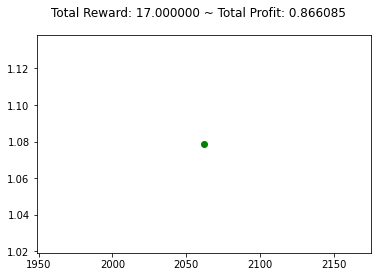

{'total_reward': 16.999999999984787, 'total_profit': 0.8660850094184359, 'position': 1}


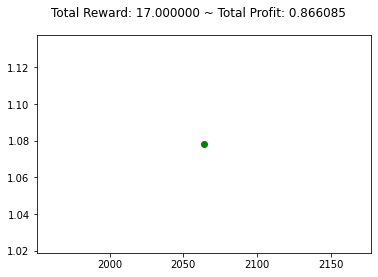

{'total_reward': 16.999999999984787, 'total_profit': 0.8660850094184359, 'position': 1}


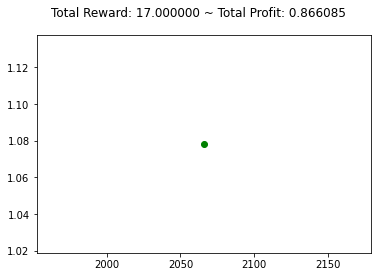

{'total_reward': 11.999999999985338, 'total_profit': 0.8660850094184359, 'position': 0}


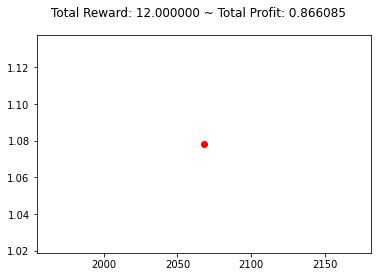

{'total_reward': 14.999999999985008, 'total_profit': 0.8660850094184359, 'position': 1}


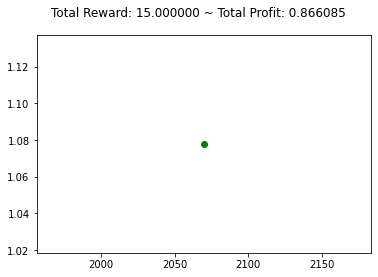

{'total_reward': 10.999999999983228, 'total_profit': 0.8660850094184359, 'position': 0}


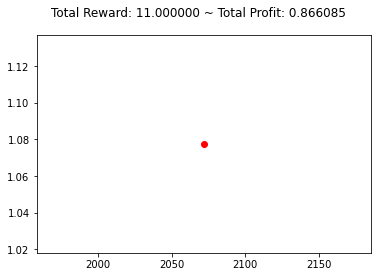

{'total_reward': 10.999999999983228, 'total_profit': 0.8660850094184359, 'position': 0}


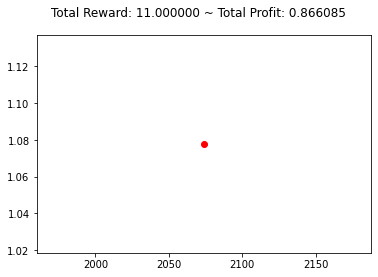

{'total_reward': 3.999999999981778, 'total_profit': 0.8652816655640453, 'position': 1}


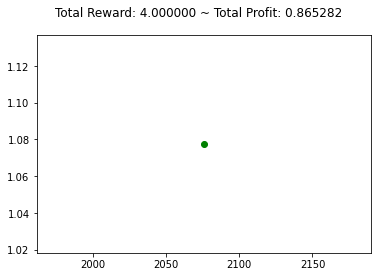

{'total_reward': -3.0000000000196714, 'total_profit': 0.865040729514603, 'position': 1}


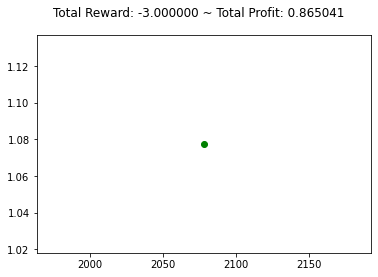

{'total_reward': -1.7781331962396507e-11, 'total_profit': 0.865040729514603, 'position': 0}


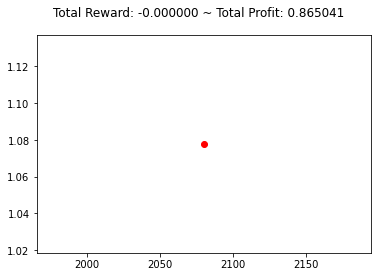

{'total_reward': -1.7781331962396507e-11, 'total_profit': 0.865040729514603, 'position': 0}


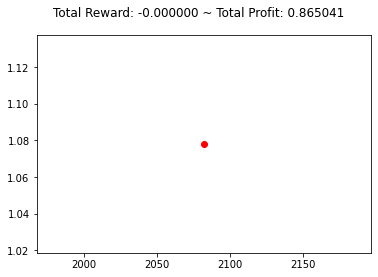

{'total_reward': -1.7781331962396507e-11, 'total_profit': 0.865040729514603, 'position': 0}


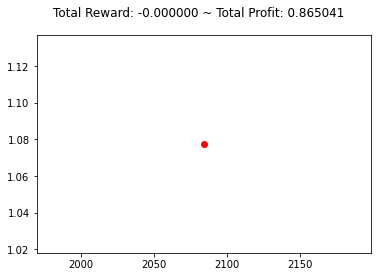

{'total_reward': 0.999999999984329, 'total_profit': 0.8648801800102389, 'position': 1}


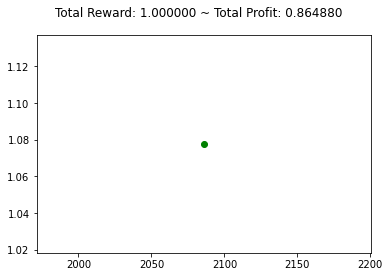

{'total_reward': 3.999999999986219, 'total_profit': 0.8646394674636176, 'position': 1}


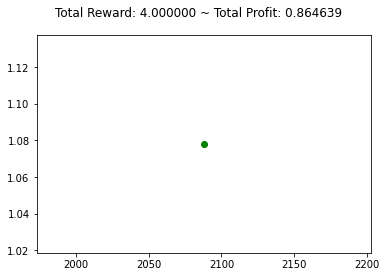

{'total_reward': 4.999999999986109, 'total_profit': 0.8644790222107945, 'position': 1}


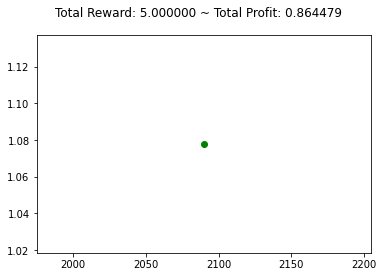

{'total_reward': 3.999999999986219, 'total_profit': 0.8644790222107945, 'position': 0}


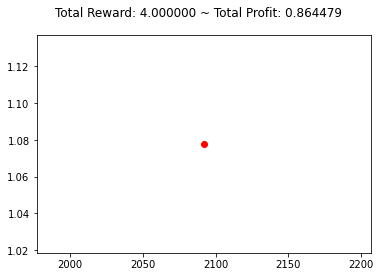

{'total_reward': 3.999999999986219, 'total_profit': 0.8644790222107945, 'position': 0}


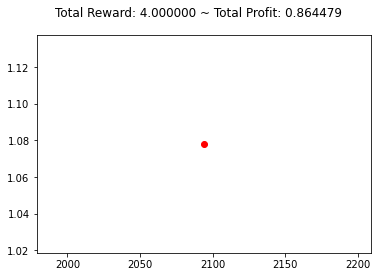

{'total_reward': 1.9999999999864393, 'total_profit': 0.864078020716124, 'position': 1}


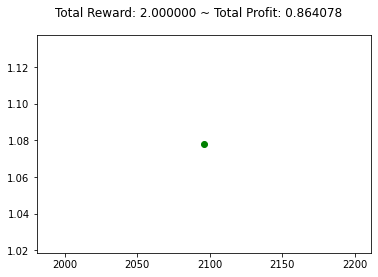

{'total_reward': -2.00000000001312, 'total_profit': 0.8635971313622334, 'position': 1}


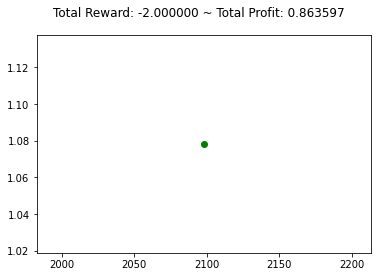

{'total_reward': -4.0000000000129, 'total_profit': 0.8635971313622334, 'position': 0}


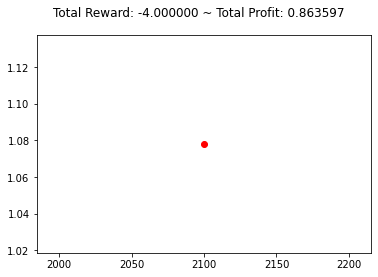

{'total_reward': -4.0000000000129, 'total_profit': 0.8635971313622334, 'position': 0}


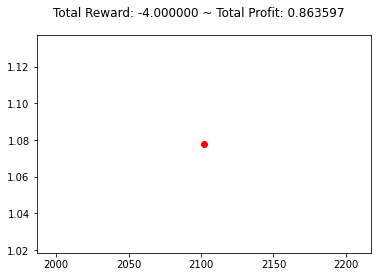

{'total_reward': -2.00000000001312, 'total_profit': 0.863516998010525, 'position': 1}


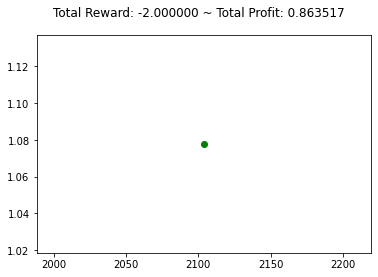

{'total_reward': 1.9999999999864393, 'total_profit': 0.8634368720944062, 'position': 1}


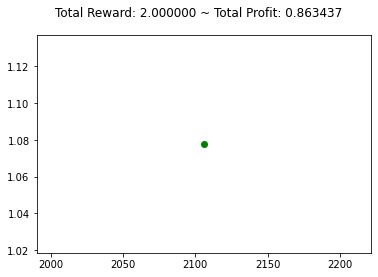

{'total_reward': 1.9999999999864393, 'total_profit': 0.8634368720944062, 'position': 1}


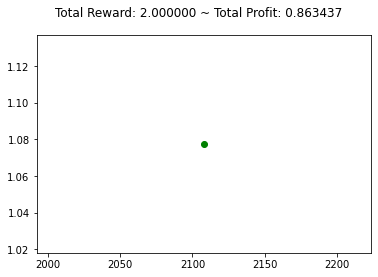

{'total_reward': -6.0000000000149, 'total_profit': 0.8634368720944062, 'position': 0}


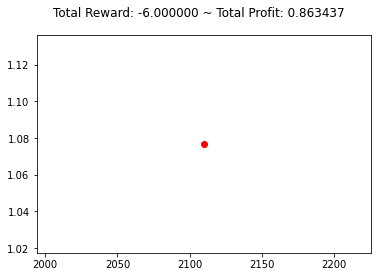

{'total_reward': -1.5560885913146194e-11, 'total_profit': 0.8635973025797452, 'position': 0}


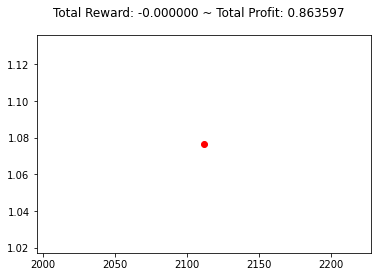

{'total_reward': -4.00000000001512, 'total_profit': 0.8633566344972798, 'position': 0}


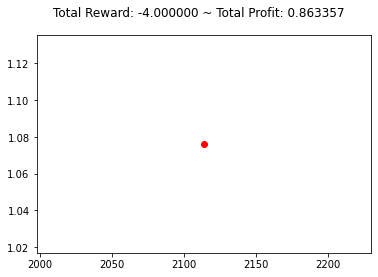

{'total_reward': -4.00000000001512, 'total_profit': 0.8633566344972798, 'position': 0}


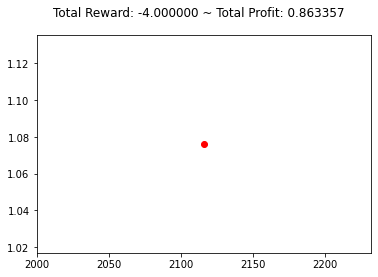

{'total_reward': -11.00000000001435, 'total_profit': 0.8625548545618256, 'position': 1}


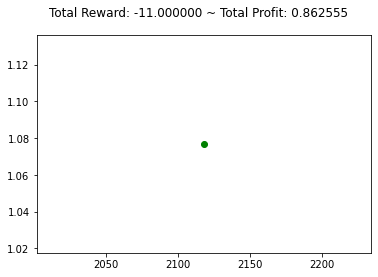

{'total_reward': -11.00000000001435, 'total_profit': 0.8625548545618256, 'position': 0}


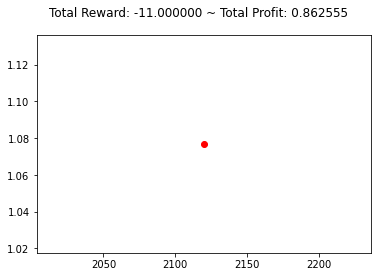

{'total_reward': -11.00000000001435, 'total_profit': 0.8623145439597002, 'position': 1}


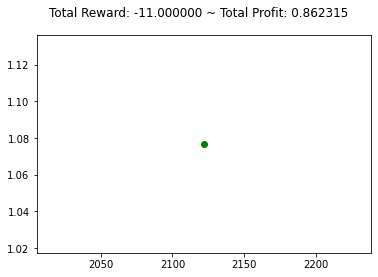

{'total_reward': -14.000000000014019, 'total_profit': 0.8623145439597002, 'position': 0}


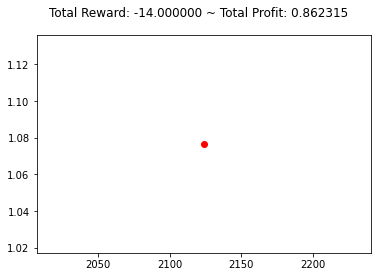

{'total_reward': -14.000000000014019, 'total_profit': 0.8623145439597002, 'position': 0}


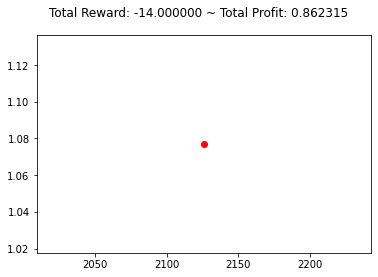

{'total_reward': -14.000000000014019, 'total_profit': 0.8623145439597002, 'position': 0}


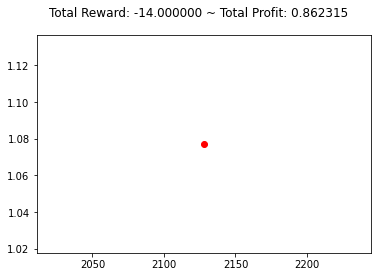

{'total_reward': -21.000000000013248, 'total_profit': 0.8615140291584008, 'position': 1}


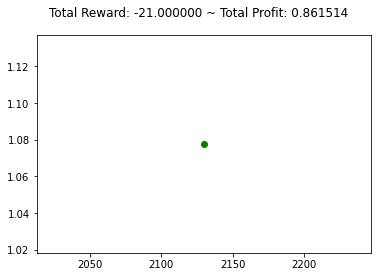

{'total_reward': -19.00000000001347, 'total_profit': 0.8615140291584008, 'position': 0}


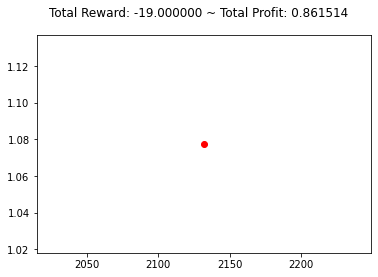

{'total_reward': -20.000000000011138, 'total_profit': 0.8611142917655099, 'position': 0}


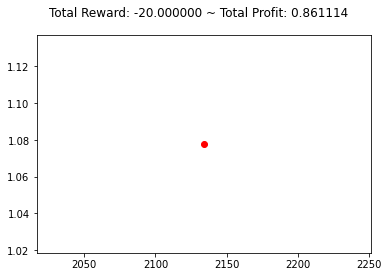

{'total_reward': -25.000000000010587, 'total_profit': 0.8604753644483032, 'position': 1}


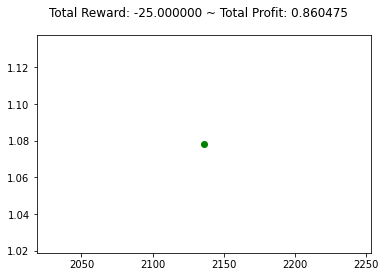

{'total_reward': -25.000000000010587, 'total_profit': 0.8604753644483032, 'position': 1}


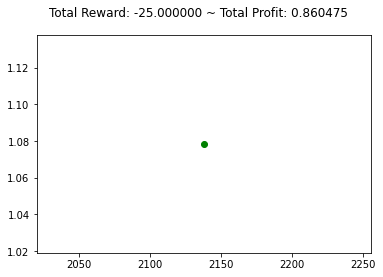

{'total_reward': -25.000000000010587, 'total_profit': 0.8602359444804545, 'position': 1}


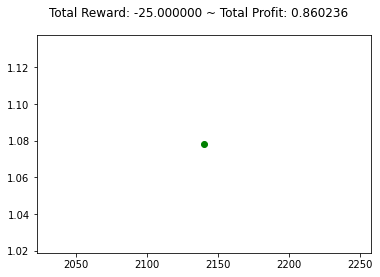

{'total_reward': -25.000000000010587, 'total_profit': 0.8602359444804545, 'position': 1}


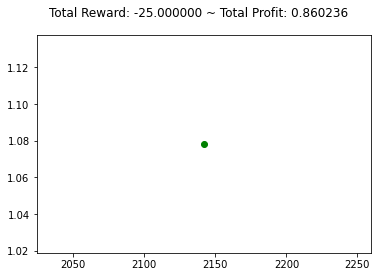

{'total_reward': -26.000000000010477, 'total_profit': 0.8602359444804545, 'position': 0}


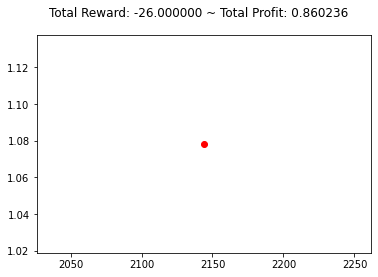

{'total_reward': -20.000000000011138, 'total_profit': 0.8599168066787553, 'position': 0}


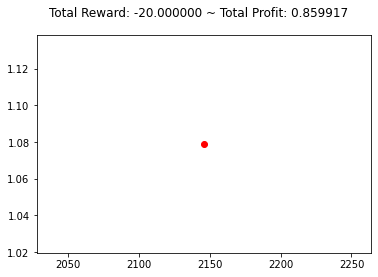

{'total_reward': -20.000000000011138, 'total_profit': 0.8599168066787553, 'position': 0}


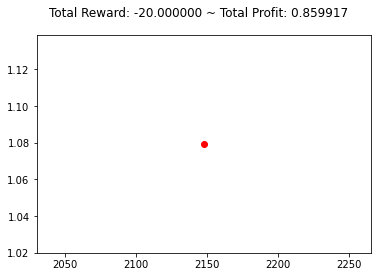

{'total_reward': -27.000000000010367, 'total_profit': 0.859279477194465, 'position': 0}


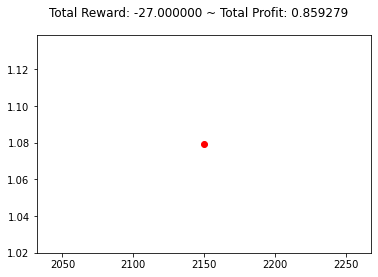

{'total_reward': -28.000000000010257, 'total_profit': 0.858961019128239, 'position': 1}


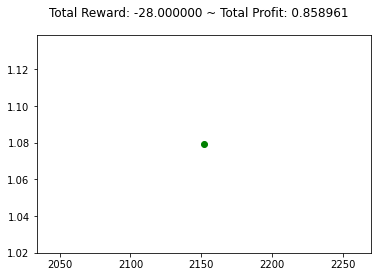

{'total_reward': -32.00000000000982, 'total_profit': 0.858961019128239, 'position': 0}


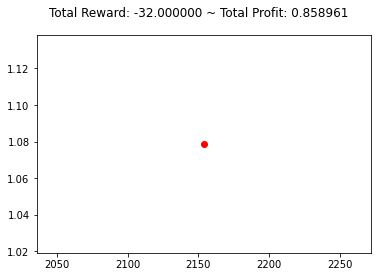

{'total_reward': -30.00000000001004, 'total_profit': 0.858961019128239, 'position': 0}


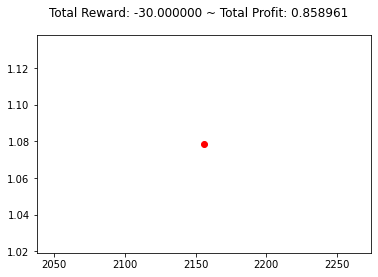

{'total_reward': -29.00000000001015, 'total_profit': 0.8588017162686084, 'position': 1}


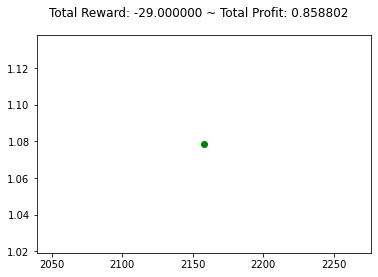

{'total_reward': -29.00000000001015, 'total_profit': 0.8588017162686084, 'position': 1}


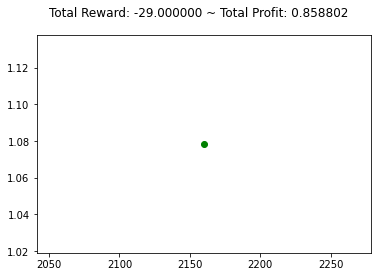

{'total_reward': -29.00000000001015, 'total_profit': 0.8588017162686084, 'position': 1}


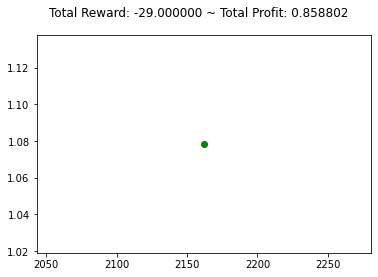

{'total_reward': -27.00000000001037, 'total_profit': 0.8588017162686084, 'position': 0}


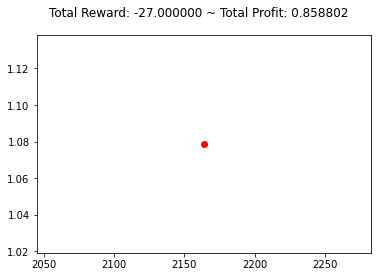

{'total_reward': -31.00000000000993, 'total_profit': 0.8585628505956243, 'position': 0}


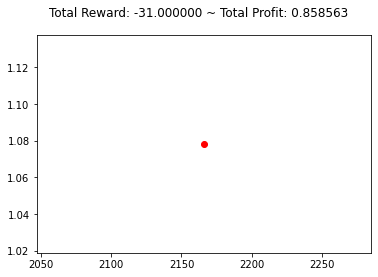

{'total_reward': -32.00000000000982, 'total_profit': 0.8582443630316456, 'position': 1}


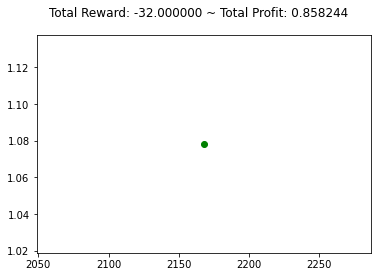

{'total_reward': -31.00000000000993, 'total_profit': 0.8582443630316456, 'position': 0}


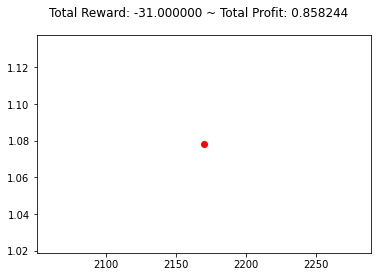

{'total_reward': -28.00000000001026, 'total_profit': 0.8582443630316456, 'position': 0}


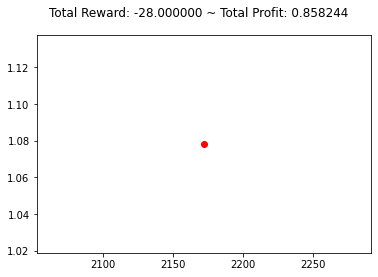

{'total_reward': -25.00000000001059, 'total_profit': 0.8582443630316456, 'position': 1}


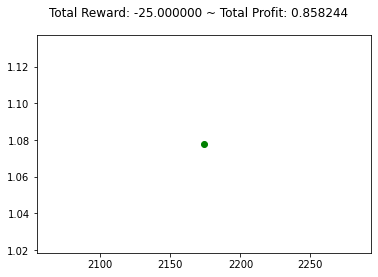

{'total_reward': -25.00000000001059, 'total_profit': 0.8582443630316456, 'position': 1}


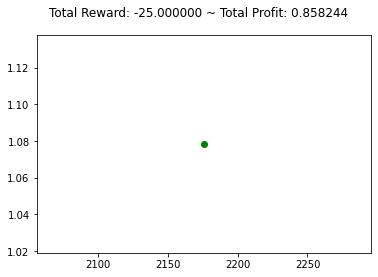

{'total_reward': -17.00000000000925, 'total_profit': 0.8584036511465366, 'position': 1}


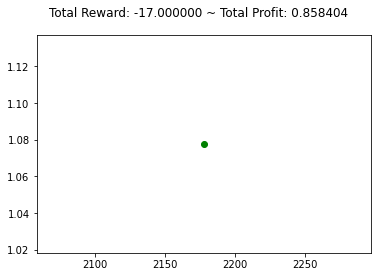

{'total_reward': -17.00000000000925, 'total_profit': 0.8584036511465366, 'position': 1}


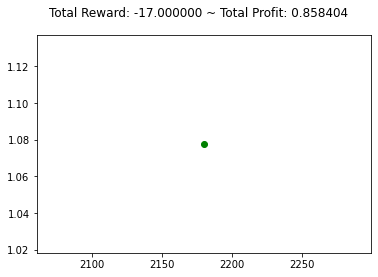

{'total_reward': -18.00000000000914, 'total_profit': 0.8584036511465366, 'position': 0}


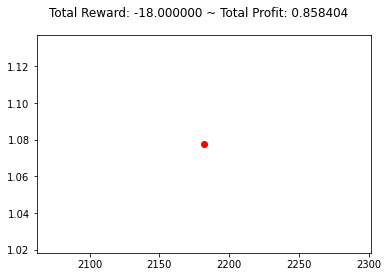

{'total_reward': -18.00000000000914, 'total_profit': 0.8584036511465366, 'position': 0}


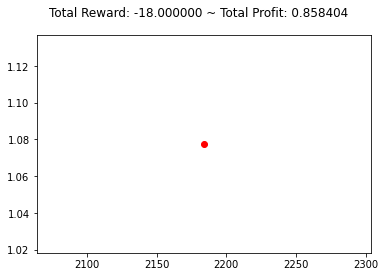

{'total_reward': -18.00000000000914, 'total_profit': 0.8581646524501617, 'position': 1}


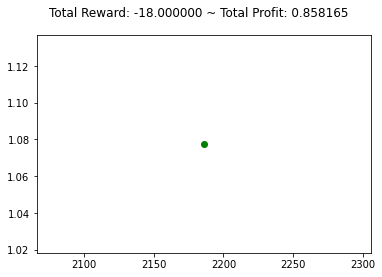

{'total_reward': -19.00000000000903, 'total_profit': 0.8581646524501617, 'position': 0}


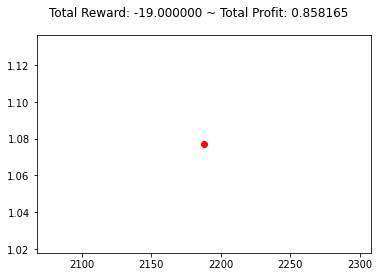

{'total_reward': -15.000000000009472, 'total_profit': 0.8582443334763873, 'position': 1}


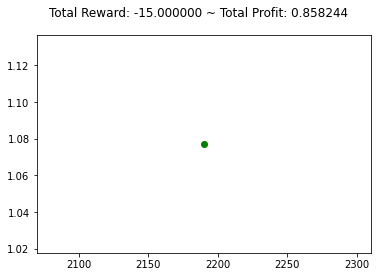

{'total_reward': -15.000000000009472, 'total_profit': 0.8582443334763873, 'position': 1}


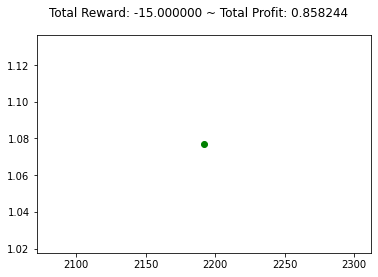

{'total_reward': -12.000000000009802, 'total_profit': 0.858084971423936, 'position': 1}


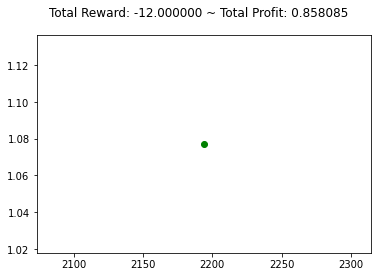

{'total_reward': -16.000000000011582, 'total_profit': 0.8574479964057128, 'position': 1}


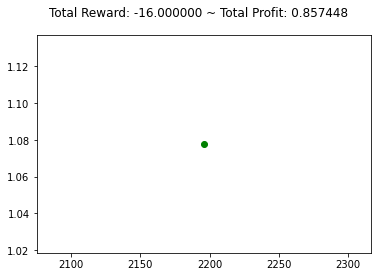

{'total_reward': -17.000000000013692, 'total_profit': 0.8574479964057128, 'position': 0}


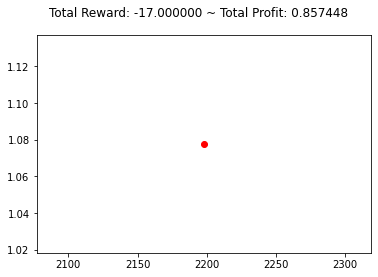

{'total_reward': -19.000000000015692, 'total_profit': 0.8570502194543276, 'position': 1}


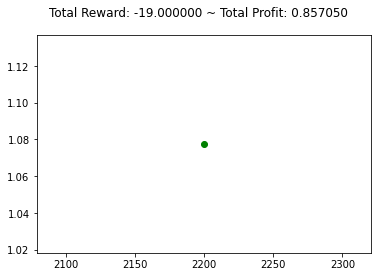

{'total_reward': -22.000000000017582, 'total_profit': 0.8570502194543276, 'position': 0}


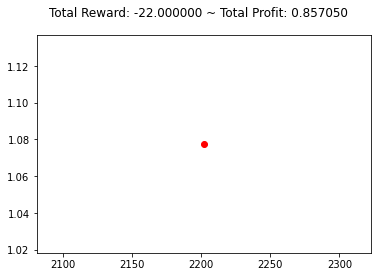

{'total_reward': -24.000000000019583, 'total_profit': 0.856652590142156, 'position': 1}


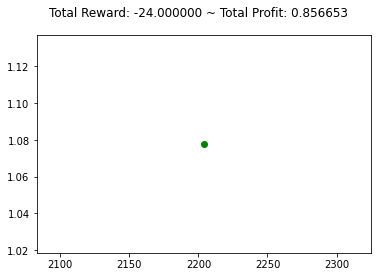

{'total_reward': -23.000000000019693, 'total_profit': 0.856652590142156, 'position': 0}


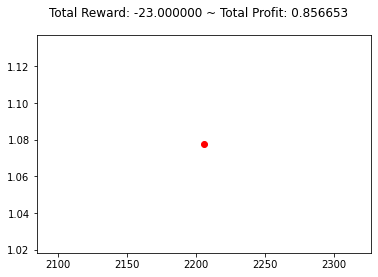

{'total_reward': -23.000000000019693, 'total_profit': 0.856652590142156, 'position': 0}


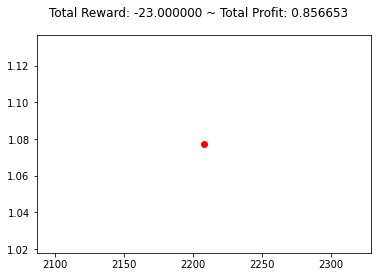

{'total_reward': -24.000000000019583, 'total_profit': 0.8563346932722637, 'position': 1}


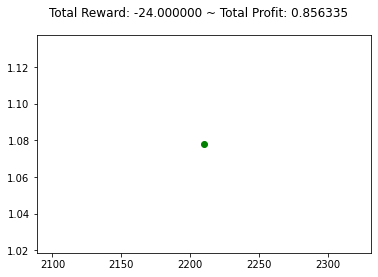

{'total_reward': -24.000000000019583, 'total_profit': 0.8563346932722637, 'position': 1}


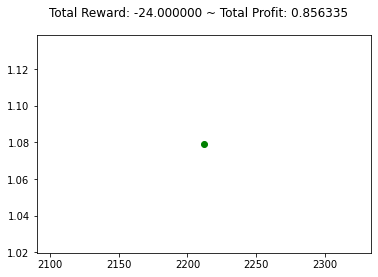

{'total_reward': -17.000000000020353, 'total_profit': 0.8563346932722637, 'position': 0}


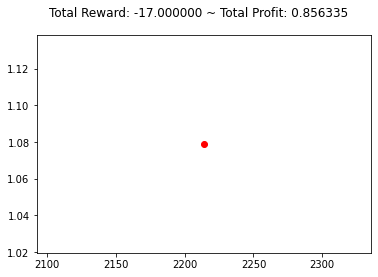

{'total_reward': -16.000000000020464, 'total_profit': 0.8560171500467989, 'position': 0}


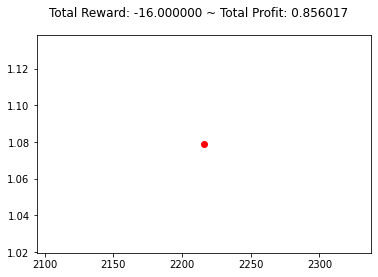

{'total_reward': -16.000000000020464, 'total_profit': 0.8560171500467989, 'position': 0}


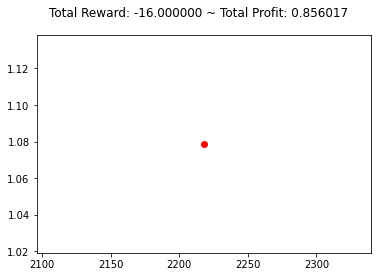

{'total_reward': -10.000000000021124, 'total_profit': 0.8559377936780174, 'position': 0}


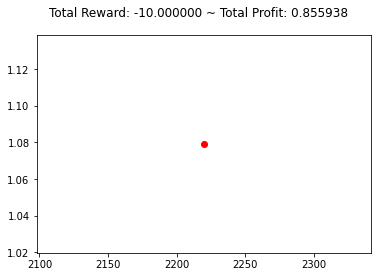

{'total_reward': -10.000000000021124, 'total_profit': 0.8556998348807757, 'position': 1}


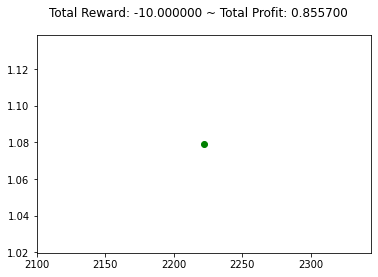

{'total_reward': -14.000000000020684, 'total_profit': 0.8554618540237587, 'position': 1}


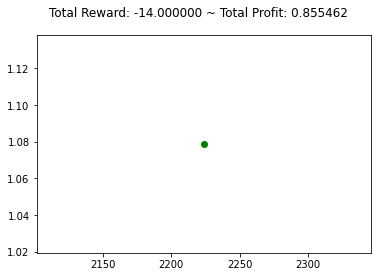

{'total_reward': -15.000000000020574, 'total_profit': 0.8554618540237587, 'position': 0}


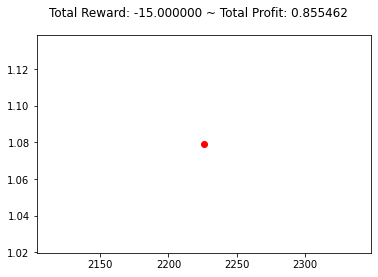

{'total_reward': -19.000000000020133, 'total_profit': 0.8549068741369964, 'position': 1}


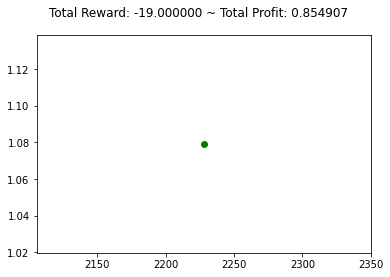

{'total_reward': -22.000000000019803, 'total_profit': 0.8549068741369964, 'position': 0}


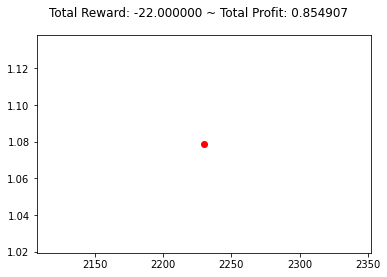

{'total_reward': -22.000000000019803, 'total_profit': 0.854827605998458, 'position': 0}


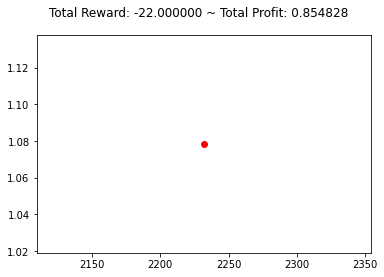

{'total_reward': -21.000000000019913, 'total_profit': 0.8546690403137986, 'position': 1}


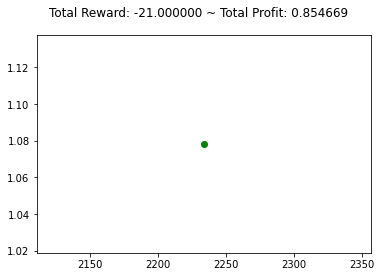

{'total_reward': -20.000000000020023, 'total_profit': 0.8544312579600065, 'position': 1}


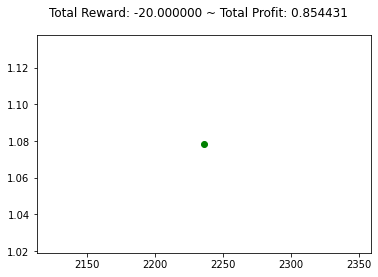

{'total_reward': -20.000000000020023, 'total_profit': 0.8539560899603995, 'position': 1}


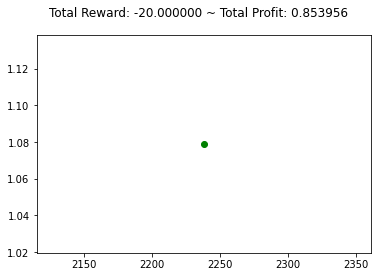

{'total_reward': -20.000000000020023, 'total_profit': 0.8539560899603995, 'position': 0}


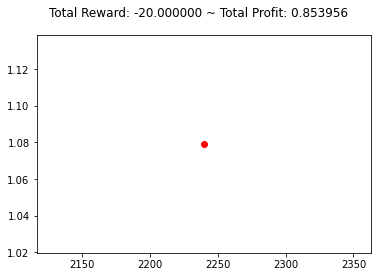

{'total_reward': -20.000000000020023, 'total_profit': 0.8539560899603995, 'position': 0}


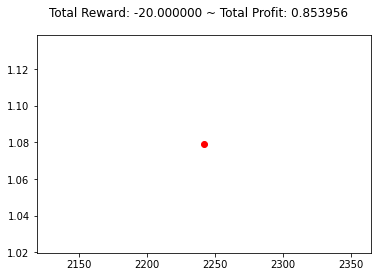

{'total_reward': -20.000000000020023, 'total_profit': 0.8539560899603995, 'position': 0}


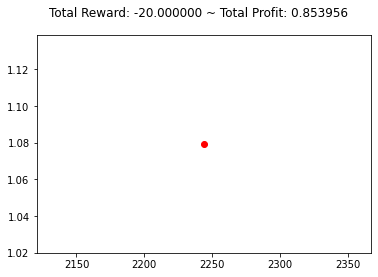

{'total_reward': -23.000000000019693, 'total_profit': 0.8534813182276565, 'position': 1}


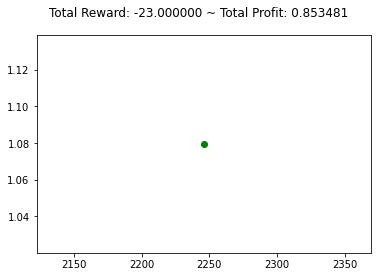

{'total_reward': -27.000000000019252, 'total_profit': 0.8530068983731665, 'position': 1}


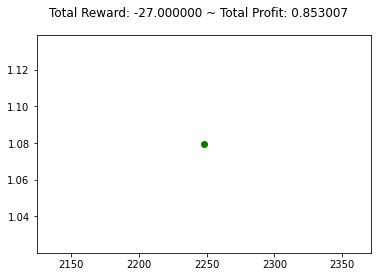

{'total_reward': -27.000000000019252, 'total_profit': 0.8530068983731665, 'position': 1}


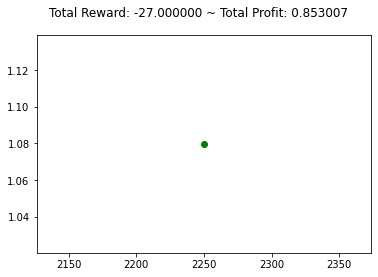

{'total_reward': -28.000000000019142, 'total_profit': 0.8530068983731665, 'position': 0}


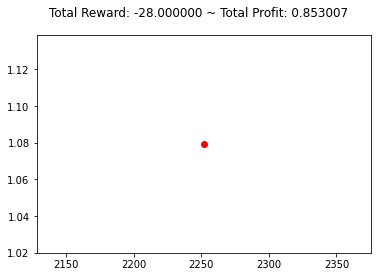

{'total_reward': -26.000000000017142, 'total_profit': 0.8526907942789018, 'position': 0}


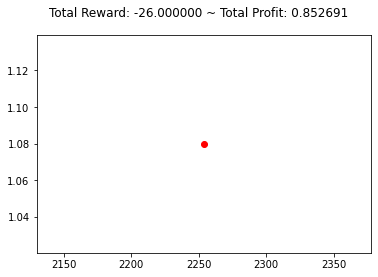

{'total_reward': -26.000000000017142, 'total_profit': 0.8526907942789018, 'position': 0}


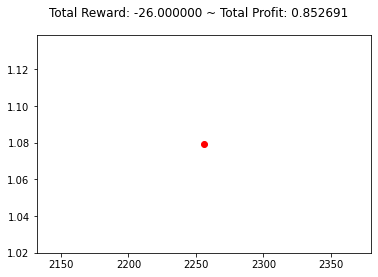

{'total_reward': -21.000000000015472, 'total_profit': 0.8528488170354399, 'position': 0}


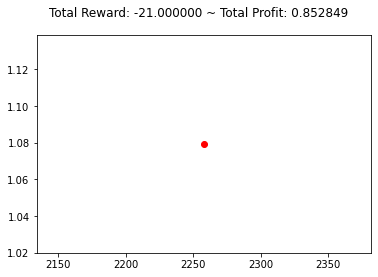

{'total_reward': -19.000000000015692, 'total_profit': 0.8527697763665766, 'position': 1}


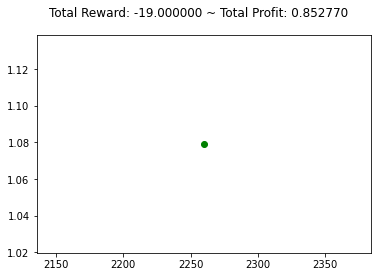

{'total_reward': -19.000000000015692, 'total_profit': 0.8527697763665766, 'position': 0}


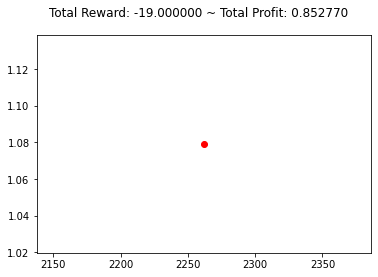

{'total_reward': -19.000000000015692, 'total_profit': 0.8525326763360762, 'position': 1}


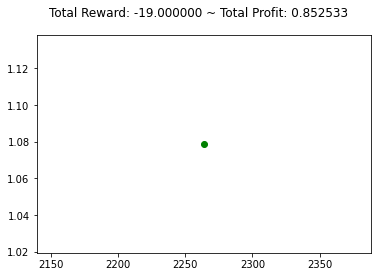

{'total_reward': -23.000000000015252, 'total_profit': 0.8525326763360762, 'position': 0}


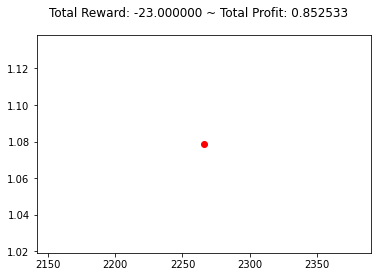

{'total_reward': -23.000000000015252, 'total_profit': 0.8522955543233738, 'position': 1}


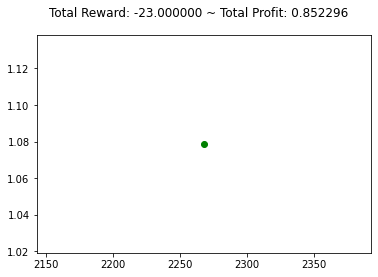

{'total_reward': -20.000000000015582, 'total_profit': 0.852216528309992, 'position': 1}


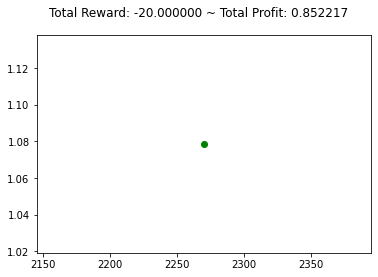

{'total_reward': -18.000000000015802, 'total_profit': 0.8520584909380291, 'position': 1}


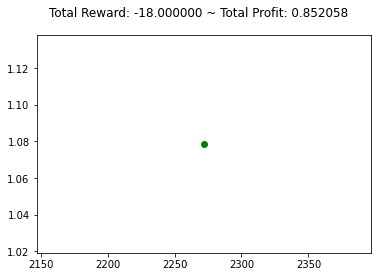

{'total_reward': -18.000000000015802, 'total_profit': 0.8520584909380291, 'position': 0}


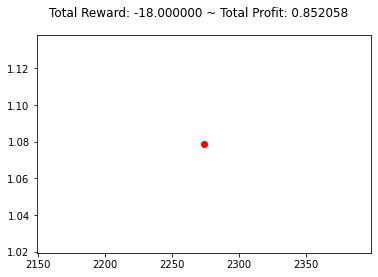

{'total_reward': -24.00000000001514, 'total_profit': 0.8513478499947947, 'position': 1}


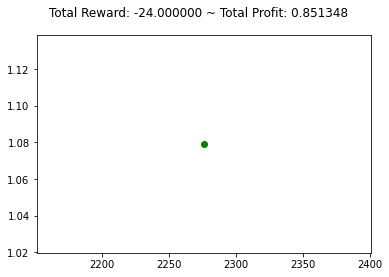

{'total_reward': -22.000000000015362, 'total_profit': 0.8513478499947947, 'position': 0}


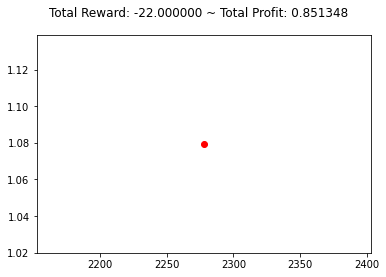

{'total_reward': -23.000000000015252, 'total_profit': 0.8510323607044502, 'position': 1}


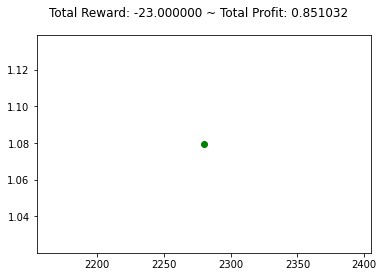

{'total_reward': -20.000000000015582, 'total_profit': 0.8510323607044502, 'position': 1}


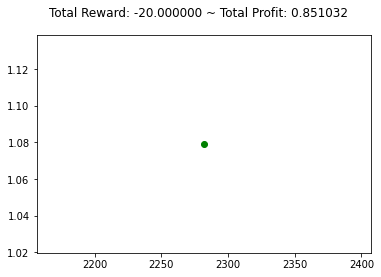

{'total_reward': -21.000000000015472, 'total_profit': 0.8510323607044502, 'position': 0}


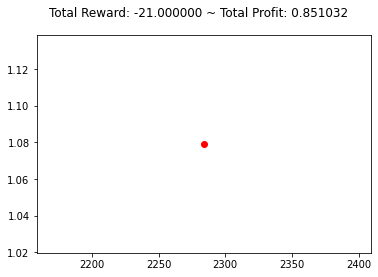

{'total_reward': -25.00000000001503, 'total_profit': 0.8504804590438118, 'position': 1}


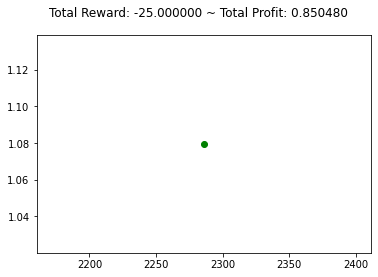

{'total_reward': -25.00000000001503, 'total_profit': 0.8504804590438118, 'position': 0}


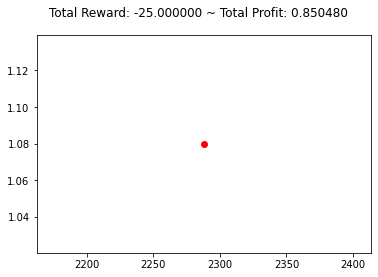

{'total_reward': -30.0000000000167, 'total_profit': 0.8498504151811993, 'position': 1}


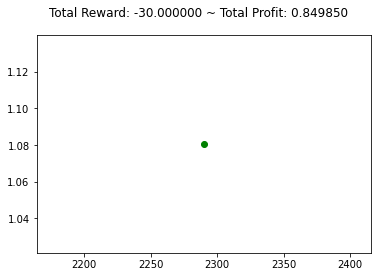

{'total_reward': -30.0000000000167, 'total_profit': 0.8498504151811993, 'position': 1}


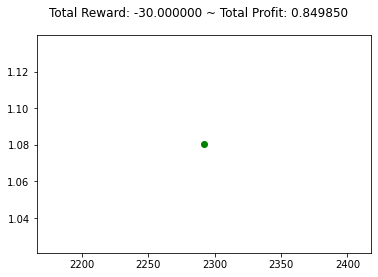

{'total_reward': -22.000000000017582, 'total_profit': 0.8498504151811993, 'position': 1}


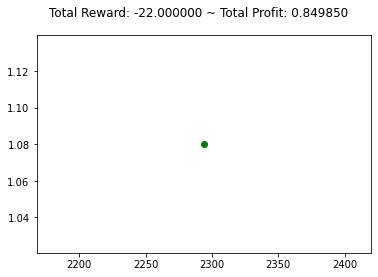

{'total_reward': -24.000000000017362, 'total_profit': 0.8498504151811993, 'position': 0}


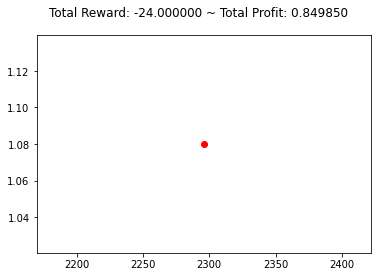

{'total_reward': -24.000000000017362, 'total_profit': 0.8498504151811993, 'position': 0}


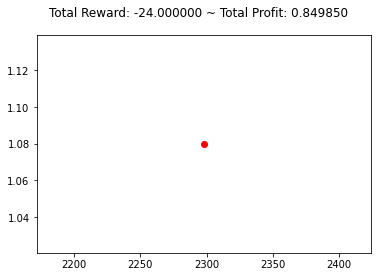

{'total_reward': -22.000000000017582, 'total_profit': 0.8497717034635758, 'position': 1}


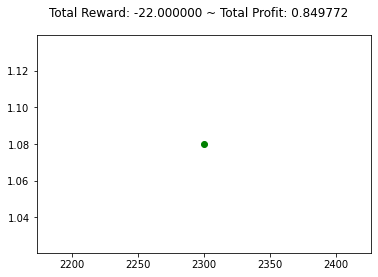

{'total_reward': -22.000000000017582, 'total_profit': 0.8497717034635758, 'position': 1}


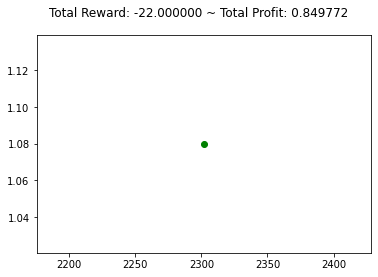

{'total_reward': -22.000000000017582, 'total_profit': 0.8495355901811463, 'position': 1}


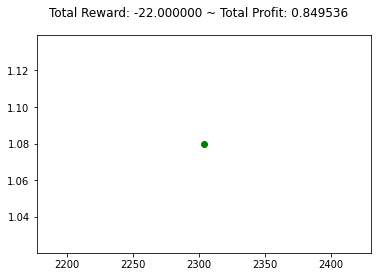

{'total_reward': -25.000000000019472, 'total_profit': 0.8495355901811463, 'position': 0}


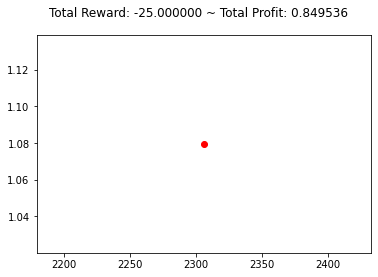

{'total_reward': -27.000000000019252, 'total_profit': 0.8491421409452343, 'position': 1}


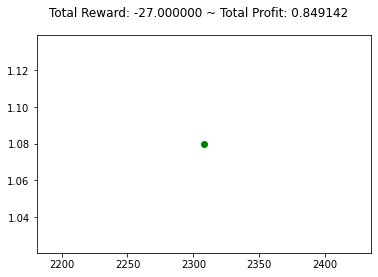

{'total_reward': -25.000000000017252, 'total_profit': 0.8491421409452343, 'position': 0}


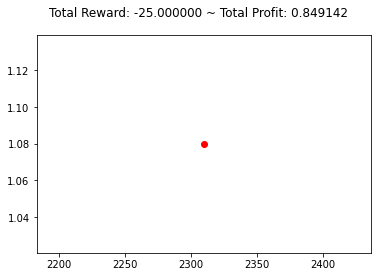

{'total_reward': -25.000000000017252, 'total_profit': 0.8491421409452343, 'position': 0}


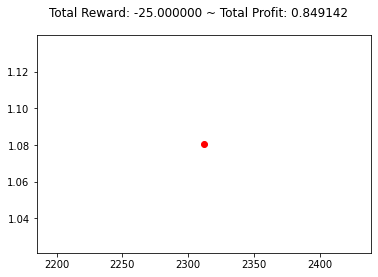

{'total_reward': -27.00000000001703, 'total_profit': 0.8487490195836856, 'position': 1}


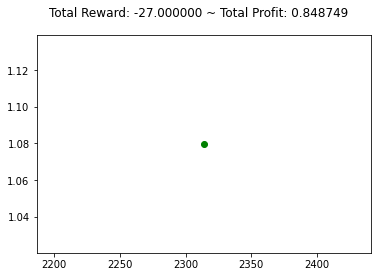

{'total_reward': -27.00000000001703, 'total_profit': 0.8487490195836856, 'position': 1}


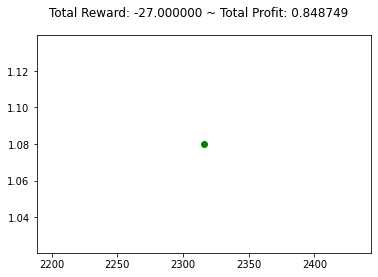

{'total_reward': -31.00000000001881, 'total_profit': 0.8487490195836856, 'position': 0}


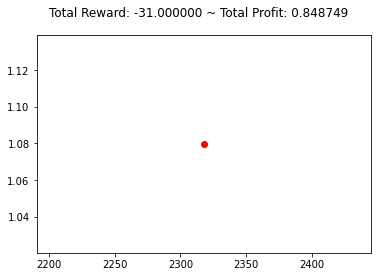

{'total_reward': -33.00000000002081, 'total_profit': 0.8483560074427411, 'position': 1}


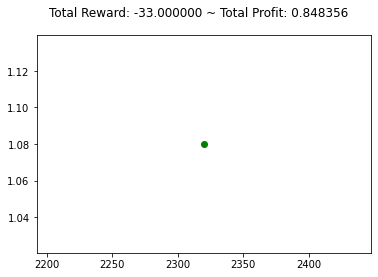

{'total_reward': -33.00000000002081, 'total_profit': 0.8483560074427411, 'position': 0}


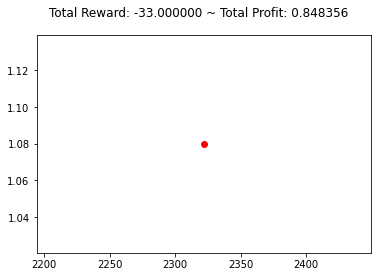

{'total_reward': -34.000000000020705, 'total_profit': 0.847963250031888, 'position': 0}


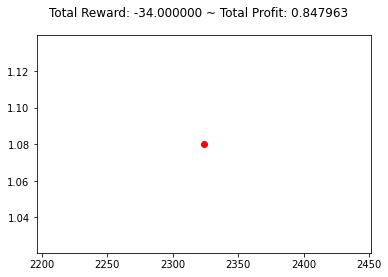

{'total_reward': -44.000000000019604, 'total_profit': 0.8469435920677391, 'position': 1}


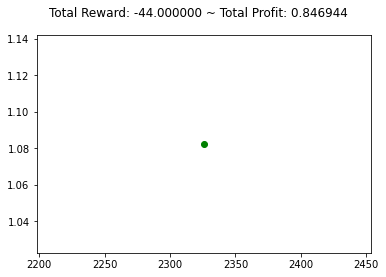

{'total_reward': -38.00000000001805, 'total_profit': 0.8469435920677391, 'position': 0}


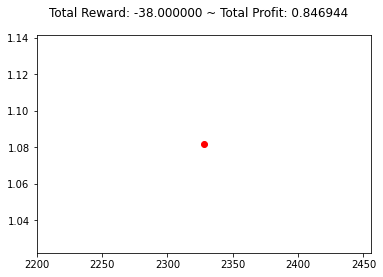

{'total_reward': -36.000000000016044, 'total_profit': 0.8468652801313483, 'position': 1}


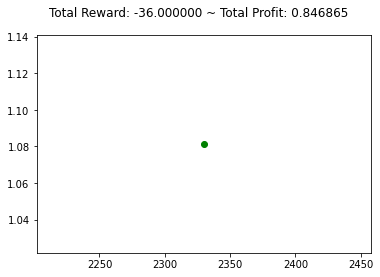

{'total_reward': -27.000000000014815, 'total_profit': 0.8468652801313483, 'position': 0}


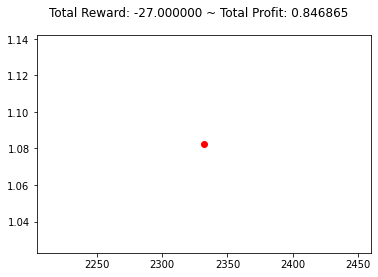

{'total_reward': -27.000000000014815, 'total_profit': 0.8463178053473698, 'position': 0}


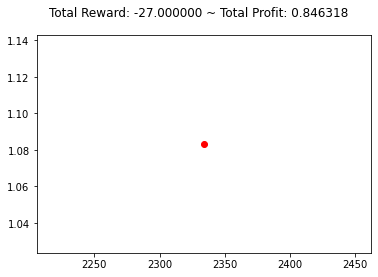

{'total_reward': -42.00000000001538, 'total_profit': 0.844913387490243, 'position': 1}


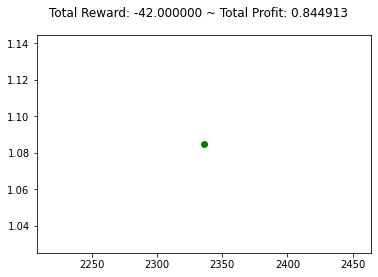

{'total_reward': -50.000000000014495, 'total_profit': 0.8446016400914828, 'position': 1}


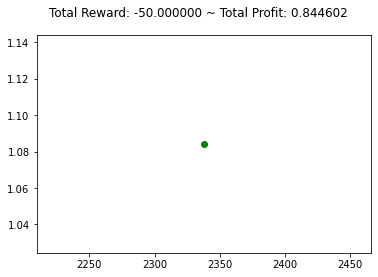

{'total_reward': -51.000000000012164, 'total_profit': 0.844601640091483, 'position': 1}


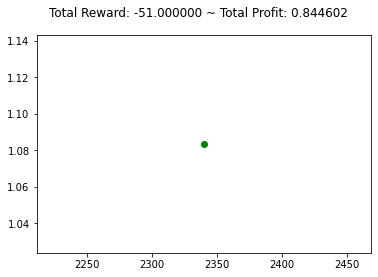

{'total_reward': -50.00000000001228, 'total_profit': 0.844601640091483, 'position': 0}


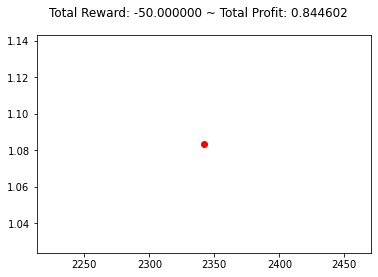

{'total_reward': -44.000000000010715, 'total_profit': 0.8445236744642245, 'position': 0}


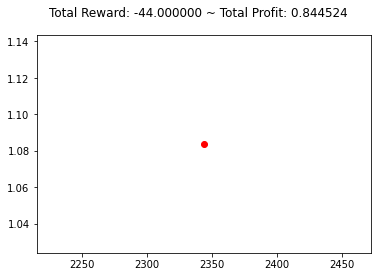

{'total_reward': -44.000000000010715, 'total_profit': 0.8445236744642245, 'position': 0}


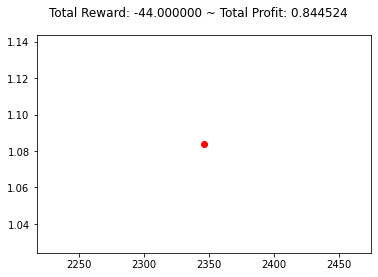

{'total_reward': -44.000000000010715, 'total_profit': 0.8445236744642245, 'position': 0}


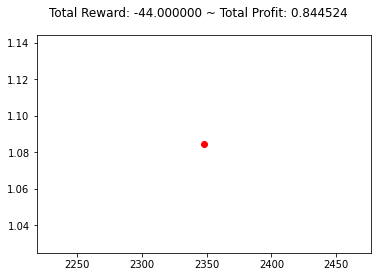

{'total_reward': -44.000000000010715, 'total_profit': 0.8445236744642245, 'position': 0}


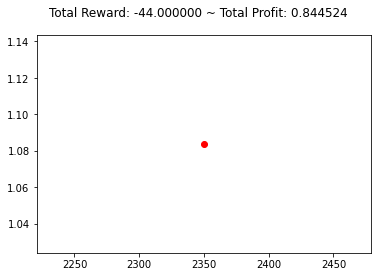

{'total_reward': -47.00000000001039, 'total_profit': 0.8440562259359233, 'position': 1}


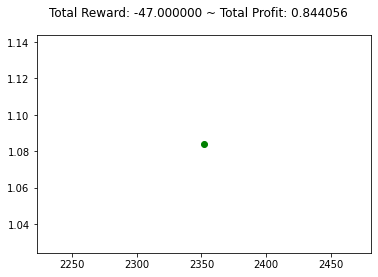

{'total_reward': -47.00000000001039, 'total_profit': 0.8440562259359233, 'position': 0}


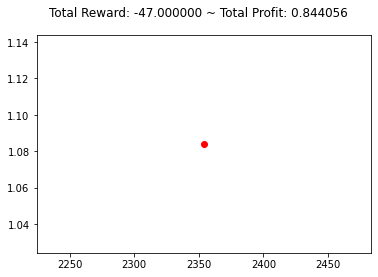

{'total_reward': -44.0000000000085, 'total_profit': 0.8442120277312047, 'position': 0}


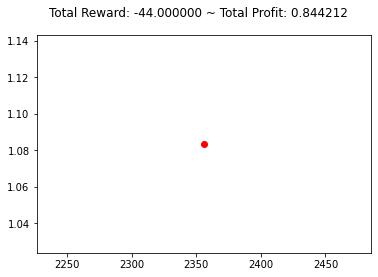

{'total_reward': -43.00000000000861, 'total_profit': 0.8441340836791569, 'position': 0}


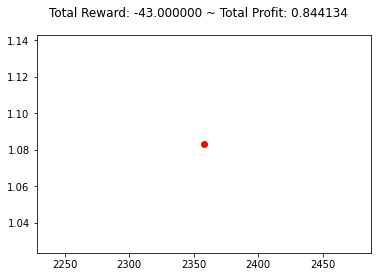

{'total_reward': -44.0000000000085, 'total_profit': 0.8438223362565074, 'position': 1}


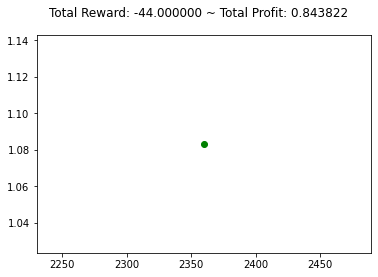

{'total_reward': -43.00000000000861, 'total_profit': 0.8438223362565074, 'position': 0}


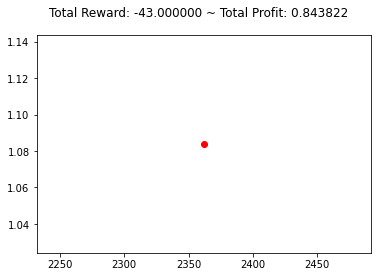

{'total_reward': -43.00000000000861, 'total_profit': 0.8435886336153728, 'position': 1}


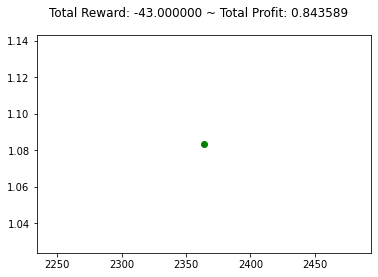

{'total_reward': -44.0000000000085, 'total_profit': 0.8435886336153728, 'position': 0}


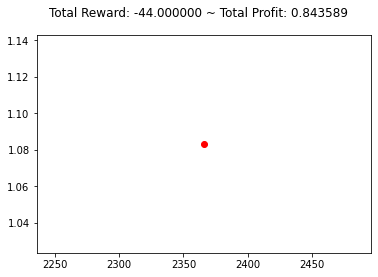

{'total_reward': -41.000000000008825, 'total_profit': 0.8435886336153728, 'position': 1}


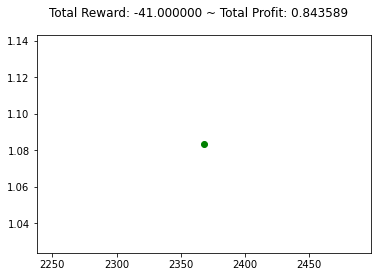

{'total_reward': -36.00000000000938, 'total_profit': 0.8435886336153728, 'position': 0}


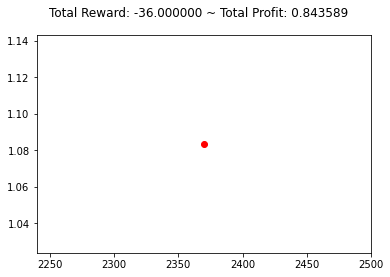

{'total_reward': -41.00000000001105, 'total_profit': 0.842965944090652, 'position': 1}


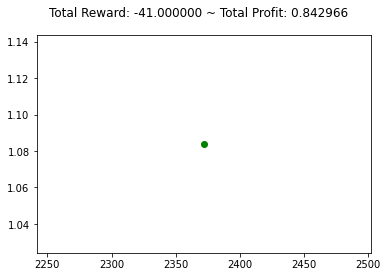

{'total_reward': -38.00000000000916, 'total_profit': 0.8429659440906521, 'position': 1}


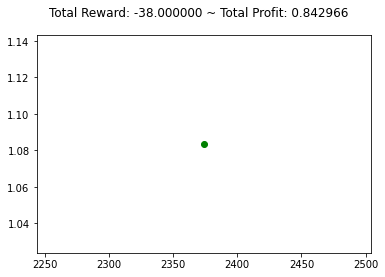

{'total_reward': -40.00000000000894, 'total_profit': 0.8429659440906521, 'position': 0}


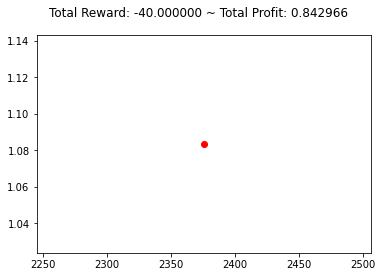

{'total_reward': -39.00000000000905, 'total_profit': 0.842810300452526, 'position': 1}


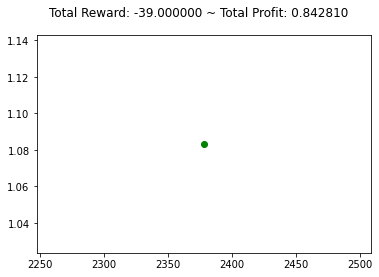

{'total_reward': -39.00000000001127, 'total_profit': 0.8423437142001993, 'position': 1}


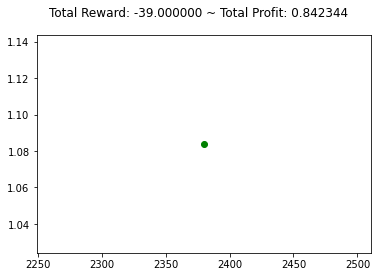

{'total_reward': -39.00000000001127, 'total_profit': 0.8423437142001993, 'position': 1}


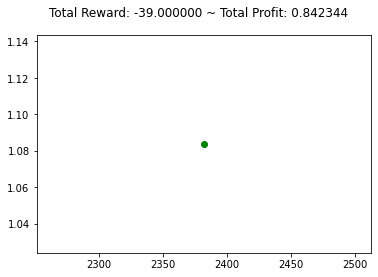

{'total_reward': -39.00000000001127, 'total_profit': 0.8423437142001993, 'position': 1}


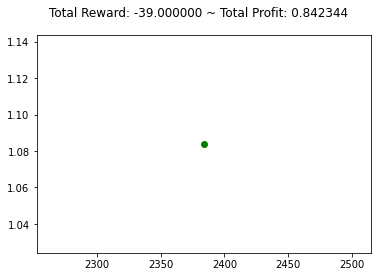

{'total_reward': -42.00000000001316, 'total_profit': 0.8423437142001993, 'position': 0}


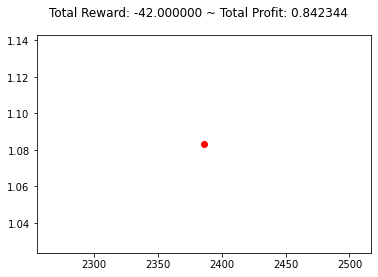

{'total_reward': -41.00000000001327, 'total_profit': 0.8422659570032824, 'position': 0}


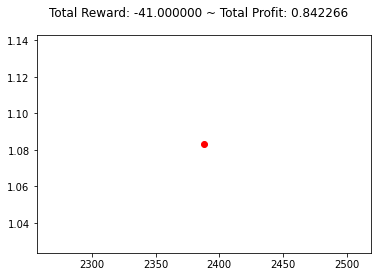

{'total_reward': -42.00000000001316, 'total_profit': 0.8419549569268481, 'position': 1}


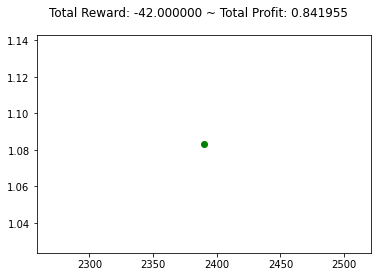

{'total_reward': -41.00000000001327, 'total_profit': 0.8419549569268481, 'position': 0}


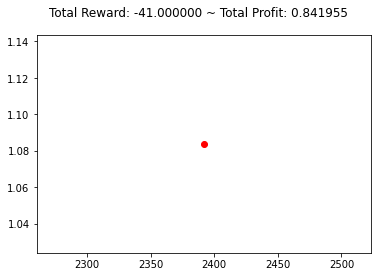

{'total_reward': -41.00000000001327, 'total_profit': 0.8419549569268481, 'position': 0}


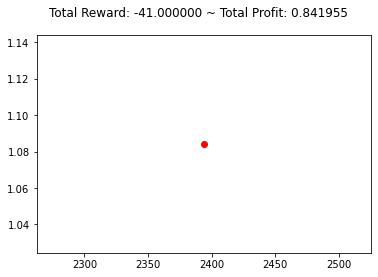

{'total_reward': -46.00000000001494, 'total_profit': 0.8413335306277969, 'position': 1}


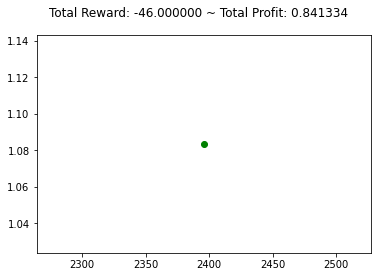

{'total_reward': -55.00000000001617, 'total_profit': 0.8413335306277969, 'position': 0}


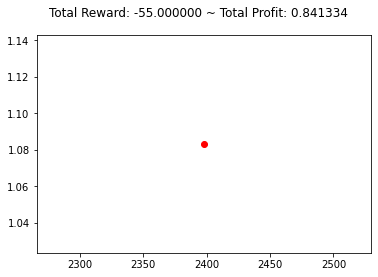

{'total_reward': -55.00000000001617, 'total_profit': 0.8413335306277969, 'position': 0}


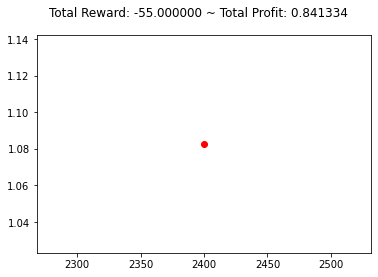

{'total_reward': -50.000000000016726, 'total_profit': 0.8414889733124394, 'position': 1}


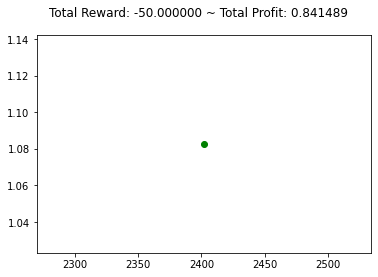

{'total_reward': -49.00000000001684, 'total_profit': 0.8414889733124394, 'position': 0}


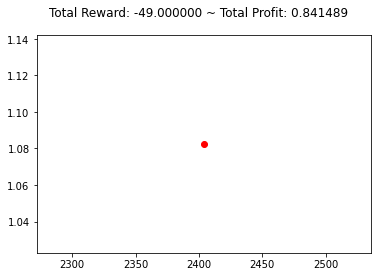

{'total_reward': -46.00000000001717, 'total_profit': 0.8414889733124394, 'position': 1}


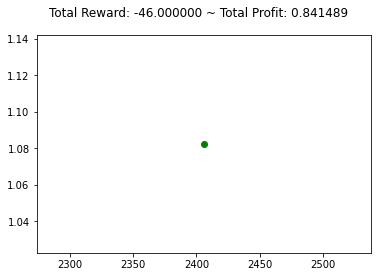

{'total_reward': -46.00000000001717, 'total_profit': 0.8414889733124394, 'position': 1}


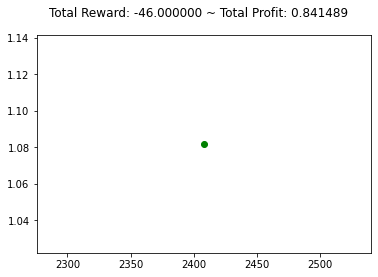

{'total_reward': -52.000000000016506, 'total_profit': 0.8414889733124394, 'position': 0}


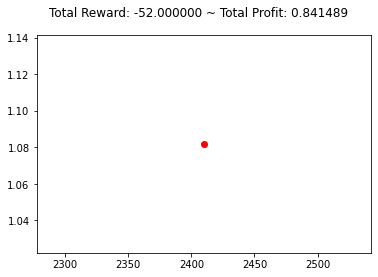

{'total_reward': -48.000000000012506, 'total_profit': 0.8414111657328454, 'position': 0}


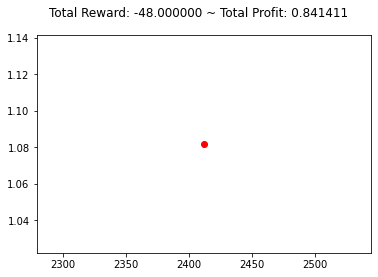

{'total_reward': -42.00000000001094, 'total_profit': 0.8416446532453049, 'position': 1}


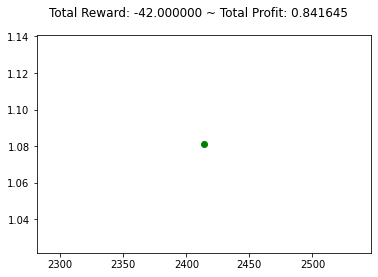

{'total_reward': -42.00000000001094, 'total_profit': 0.8416446532453049, 'position': 1}


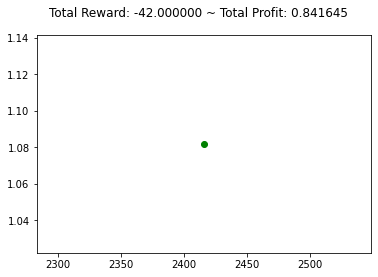

{'total_reward': -36.00000000000938, 'total_profit': 0.8416446532453049, 'position': 0}


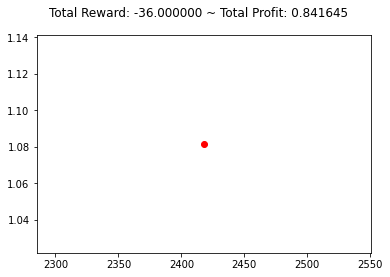

{'total_reward': -34.000000000007375, 'total_profit': 0.8415668312708949, 'position': 1}


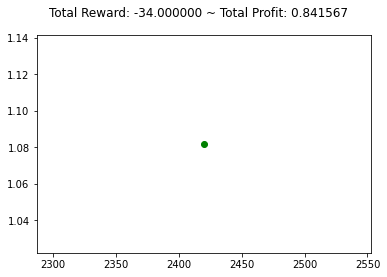

{'total_reward': -32.00000000000537, 'total_profit': 0.8415668312708949, 'position': 0}


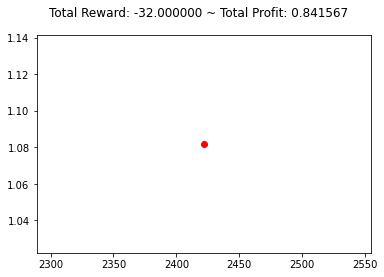

{'total_reward': -32.00000000000537, 'total_profit': 0.8413334300973891, 'position': 1}


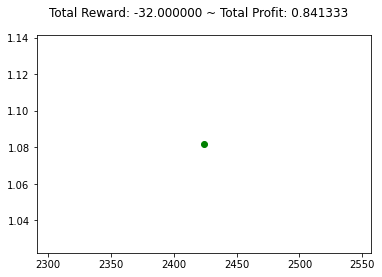

{'total_reward': -30.000000000005592, 'total_profit': 0.8413334300973891, 'position': 0}


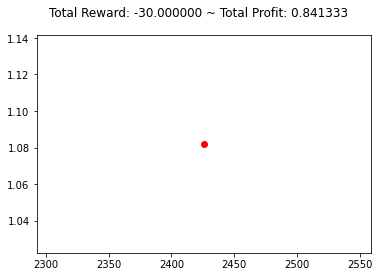

{'total_reward': -29.000000000005702, 'total_profit': 0.8411778868490813, 'position': 1}


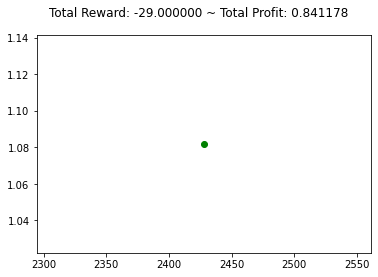

{'total_reward': -32.00000000000759, 'total_profit': 0.8411778868490813, 'position': 0}


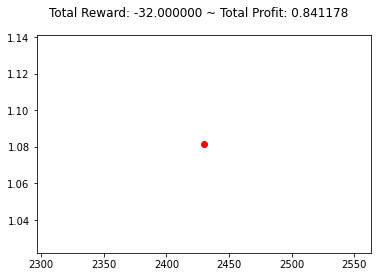

{'total_reward': -32.00000000000759, 'total_profit': 0.8411778868490813, 'position': 0}


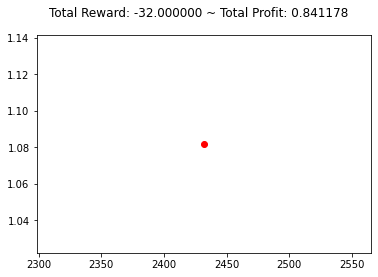

{'total_reward': -32.00000000000759, 'total_profit': 0.8409445504033535, 'position': 1}


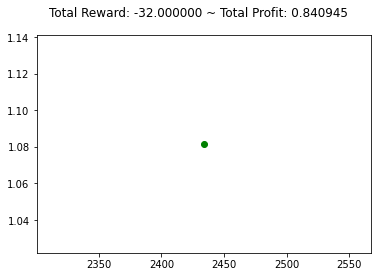

{'total_reward': -26.00000000000603, 'total_profit': 0.8409445504033535, 'position': 0}


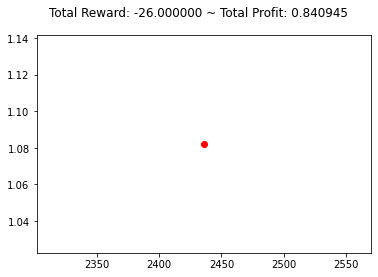

{'total_reward': -25.00000000000614, 'total_profit': 0.8407891077877521, 'position': 1}


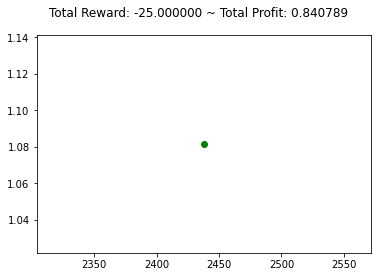

{'total_reward': -32.00000000000759, 'total_profit': 0.8407891077877521, 'position': 0}


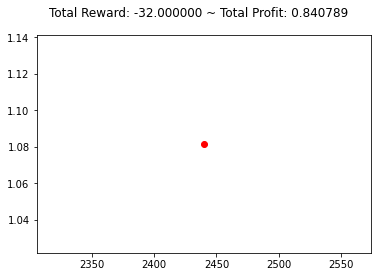

{'total_reward': -32.00000000000759, 'total_profit': 0.8407891077877521, 'position': 0}


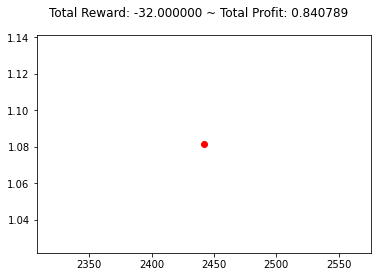

{'total_reward': -29.00000000000792, 'total_profit': 0.8406335789109878, 'position': 0}


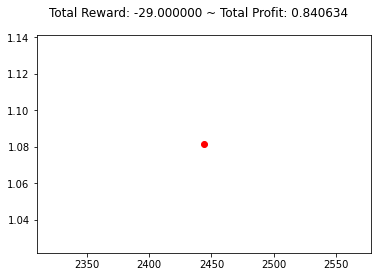

{'total_reward': -31.000000000009916, 'total_profit': 0.8401672942226761, 'position': 0}


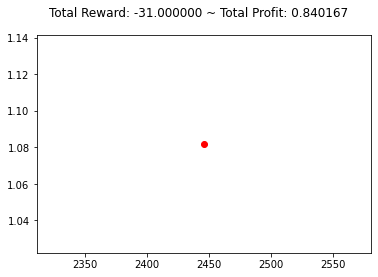

{'total_reward': -31.000000000009916, 'total_profit': 0.8401672942226761, 'position': 0}


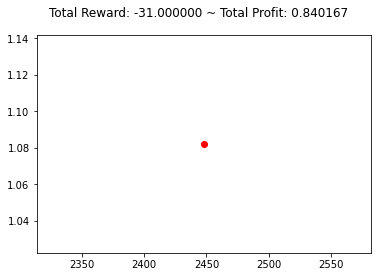

{'total_reward': -31.000000000009916, 'total_profit': 0.8399343027378667, 'position': 1}


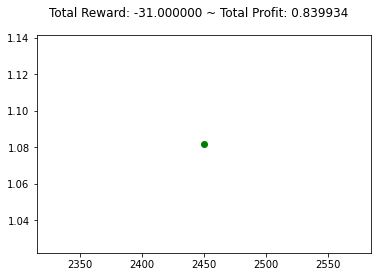

{'total_reward': -32.000000000009805, 'total_profit': 0.8397013543318195, 'position': 1}


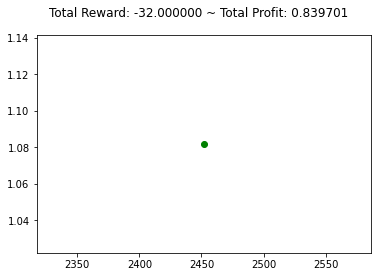

{'total_reward': -28.000000000010246, 'total_profit': 0.8397013543318195, 'position': 0}


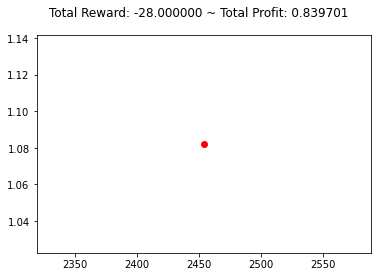

{'total_reward': -31.000000000009916, 'total_profit': 0.8394685566178379, 'position': 0}


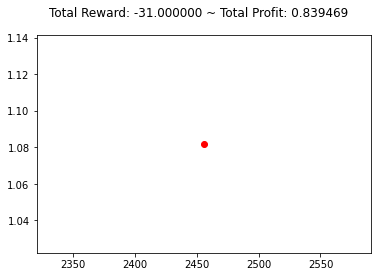

{'total_reward': -31.000000000009916, 'total_profit': 0.8394685566178379, 'position': 0}


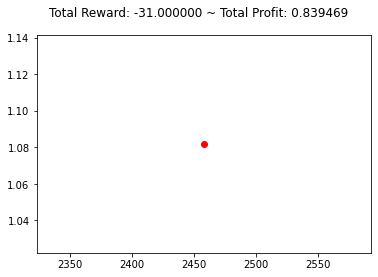

{'total_reward': -31.000000000009916, 'total_profit': 0.8394685566178379, 'position': 0}


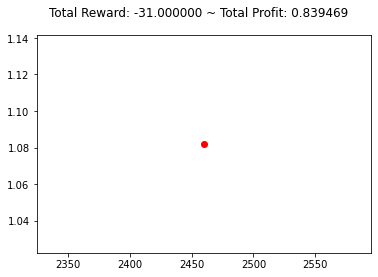

{'total_reward': -30.000000000010026, 'total_profit': 0.8393133437942052, 'position': 0}


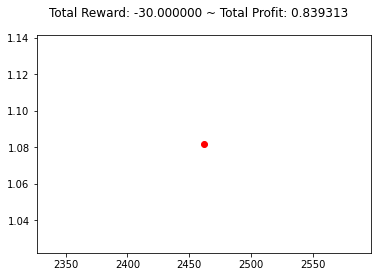

{'total_reward': -31.000000000009916, 'total_profit': 0.8390030042328097, 'position': 1}


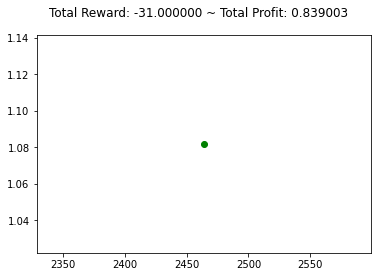

{'total_reward': -31.000000000009916, 'total_profit': 0.8390030042328097, 'position': 1}


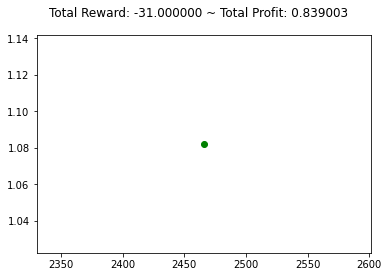

{'total_reward': -29.000000000010136, 'total_profit': 0.8390030042328097, 'position': 0}


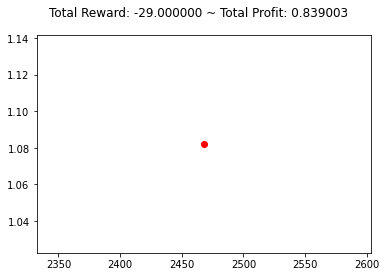

{'total_reward': -26.000000000010466, 'total_profit': 0.8390030042328097, 'position': 1}


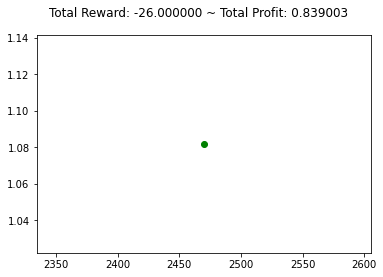

{'total_reward': -26.000000000010466, 'total_profit': 0.8390030042328097, 'position': 1}


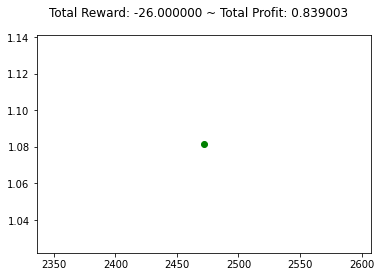

{'total_reward': -24.000000000008466, 'total_profit': 0.8389254265162835, 'position': 1}


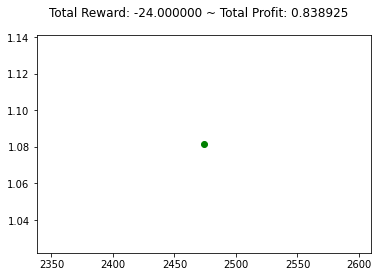

{'total_reward': -22.000000000006466, 'total_profit': 0.8386927579132005, 'position': 1}


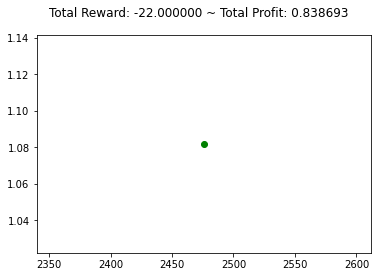

{'total_reward': -28.000000000010246, 'total_profit': 0.8381501154041522, 'position': 1}


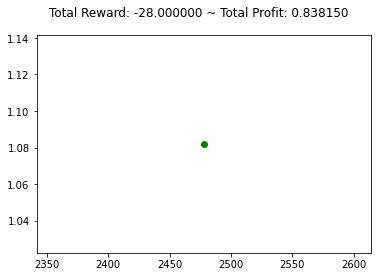

{'total_reward': -35.00000000001391, 'total_profit': 0.837685251224782, 'position': 1}


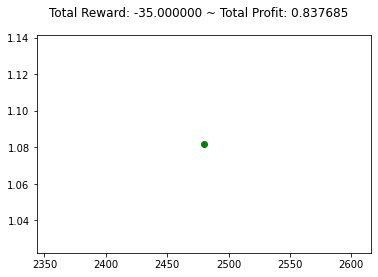

{'total_reward': -35.00000000001391, 'total_profit': 0.837685251224782, 'position': 1}


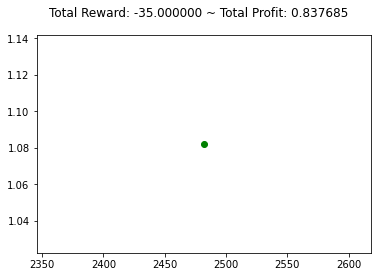

{'total_reward': -35.00000000001391, 'total_profit': 0.837685251224782, 'position': 0}


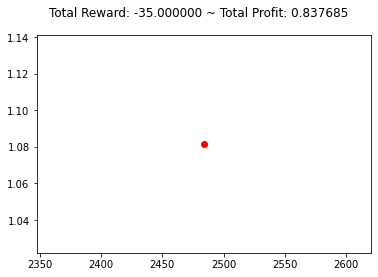

{'total_reward': -32.00000000001202, 'total_profit': 0.8376852512247821, 'position': 1}


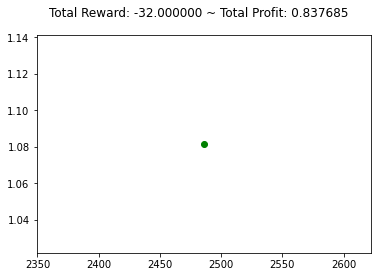

{'total_reward': -29.000000000012353, 'total_profit': 0.8378402632993981, 'position': 1}


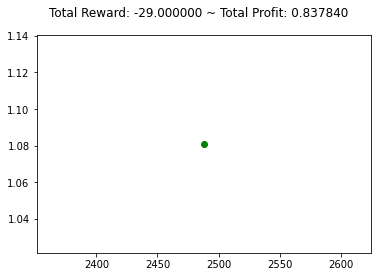

{'total_reward': -34.0000000000118, 'total_profit': 0.8378402632993981, 'position': 0}


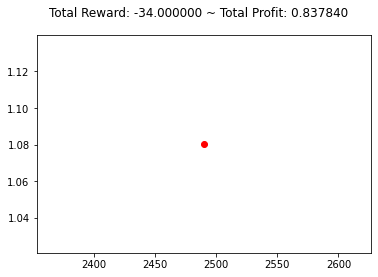

{'total_reward': -34.0000000000118, 'total_profit': 0.8376075945231417, 'position': 1}


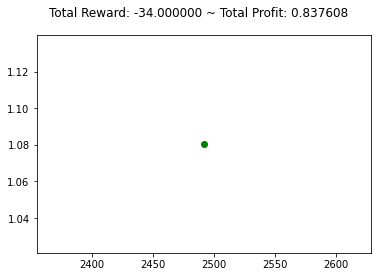

{'total_reward': -38.00000000001136, 'total_profit': 0.8376075945231417, 'position': 0}


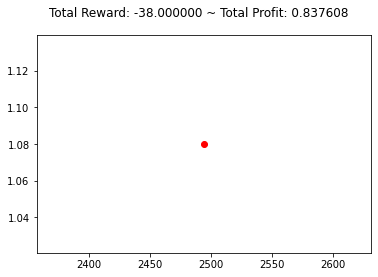

{'total_reward': -39.000000000011255, 'total_profit': 0.8372973694881332, 'position': 1}


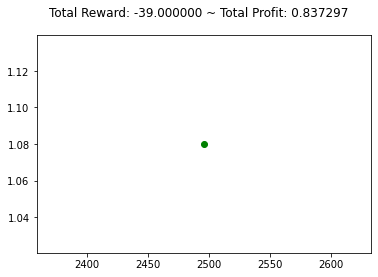

{'total_reward': -39.000000000011255, 'total_profit': 0.8372973694881332, 'position': 1}


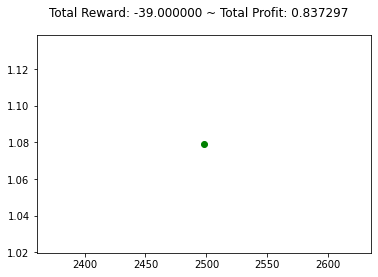

{'total_reward': -39.000000000011255, 'total_profit': 0.8372973694881332, 'position': 1}


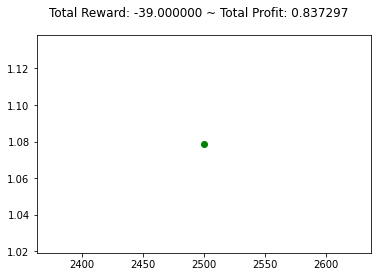

{'total_reward': -49.00000000001238, 'total_profit': 0.8372973694881332, 'position': 1}


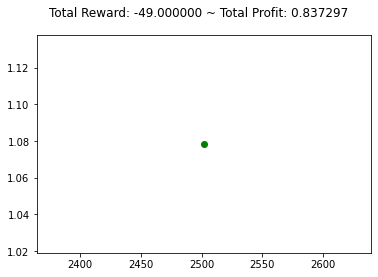

{'total_reward': -46.000000000012705, 'total_profit': 0.8372973694881332, 'position': 1}


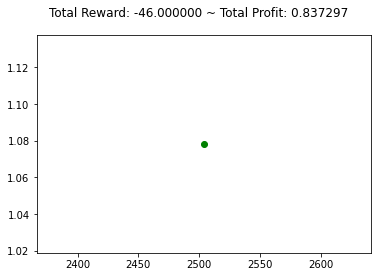

{'total_reward': -46.000000000012705, 'total_profit': 0.8372973694881332, 'position': 0}


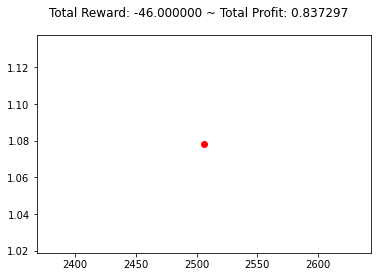

{'total_reward': -46.000000000012705, 'total_profit': 0.8372973694881332, 'position': 0}


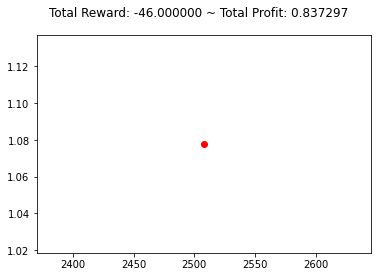

{'total_reward': -49.00000000001238, 'total_profit': 0.8370643769912902, 'position': 0}


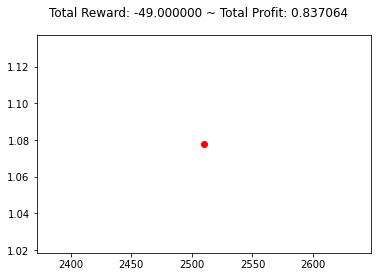

{'total_reward': -54.00000000001182, 'total_profit': 0.8364433517649219, 'position': 1}


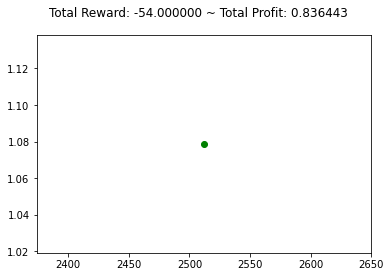

{'total_reward': -48.000000000012484, 'total_profit': 0.8364433517649219, 'position': 0}


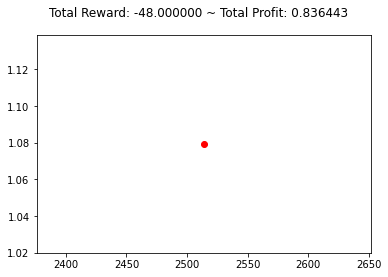

{'total_reward': -48.000000000012484, 'total_profit': 0.8364433517649219, 'position': 0}


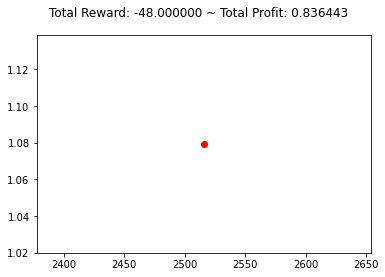

{'total_reward': -48.000000000012484, 'total_profit': 0.8362107695000879, 'position': 1}


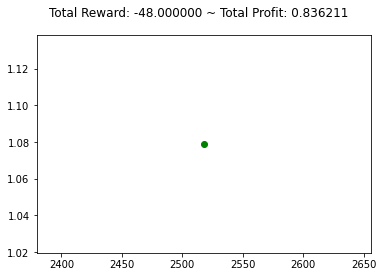

{'total_reward': -46.000000000012705, 'total_profit': 0.8362107695000879, 'position': 0}


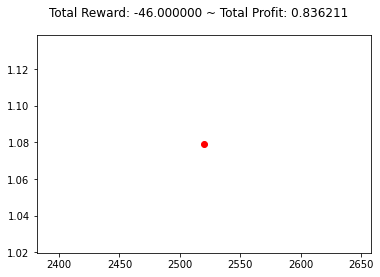

{'total_reward': -46.000000000012705, 'total_profit': 0.8362107695000879, 'position': 0}


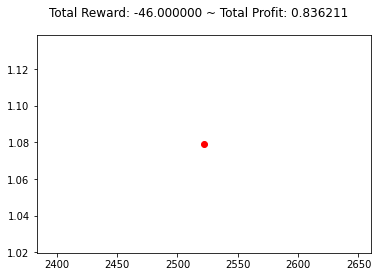

{'total_reward': -48.000000000012484, 'total_profit': 0.836133263635828, 'position': 0}


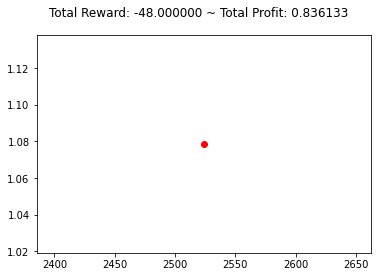

{'total_reward': -48.000000000012484, 'total_profit': 0.836133263635828, 'position': 0}


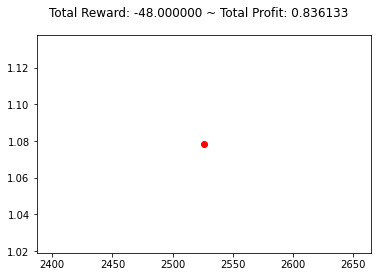

{'total_reward': -48.000000000012484, 'total_profit': 0.836133263635828, 'position': 0}


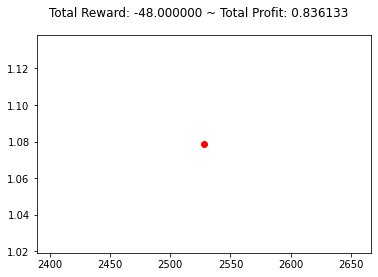

{'total_reward': -45.00000000001282, 'total_profit': 0.836133263635828, 'position': 1}


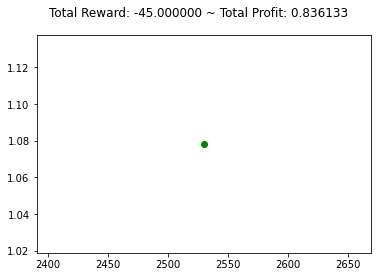

{'total_reward': -51.00000000001438, 'total_profit': 0.836133263635828, 'position': 0}


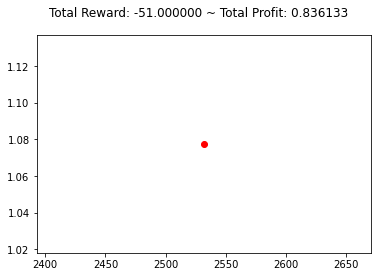

{'total_reward': -49.0000000000146, 'total_profit': 0.836055657058546, 'position': 1}


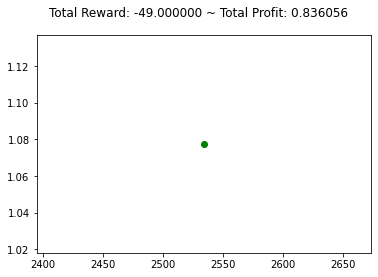

{'total_reward': -52.00000000001427, 'total_profit': 0.8359003862521465, 'position': 1}


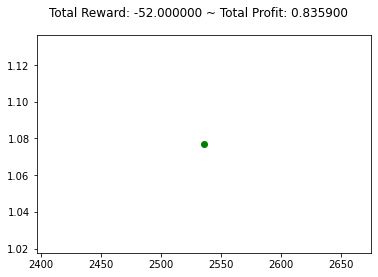

{'total_reward': -50.00000000001449, 'total_profit': 0.8359003862521465, 'position': 0}


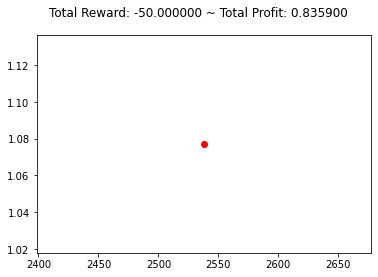

{'total_reward': -50.00000000001449, 'total_profit': 0.8356675665363581, 'position': 1}


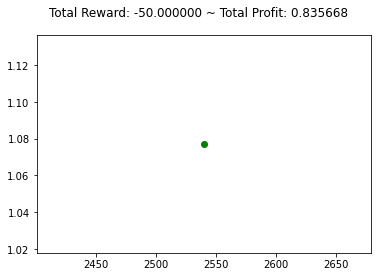

{'total_reward': -53.000000000014154, 'total_profit': 0.8356675665363581, 'position': 0}


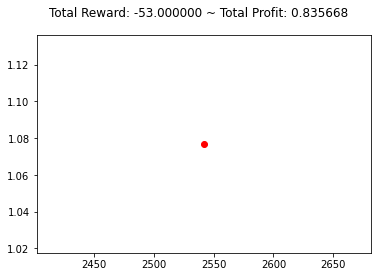

{'total_reward': -53.000000000014154, 'total_profit': 0.8356675665363581, 'position': 0}


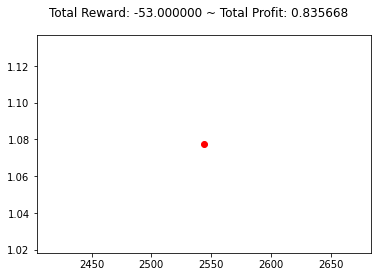

{'total_reward': -67.00000000001262, 'total_profit': 0.8348145280033311, 'position': 0}


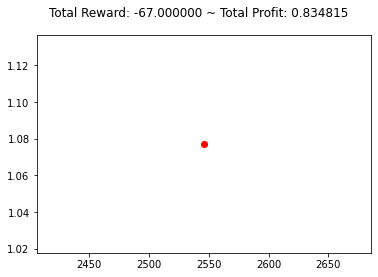

{'total_reward': -67.00000000001262, 'total_profit': 0.8348145280033311, 'position': 0}


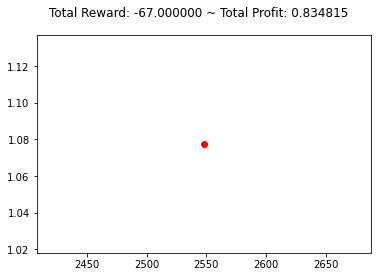

{'total_reward': -67.00000000001262, 'total_profit': 0.8348145280033311, 'position': 0}


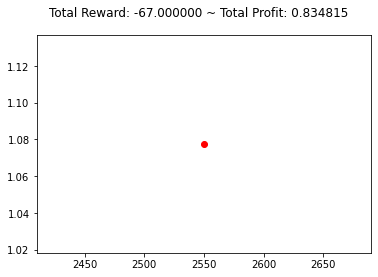

{'total_reward': -73.00000000001197, 'total_profit': 0.8341172998340634, 'position': 1}


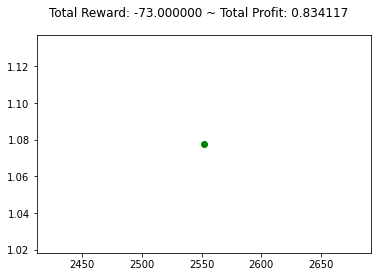

{'total_reward': -71.00000000000996, 'total_profit': 0.8341172998340634, 'position': 0}


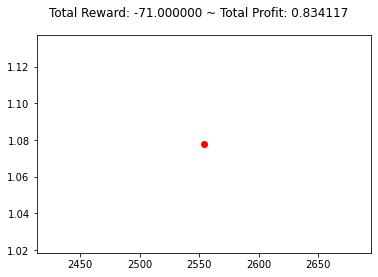

{'total_reward': -71.00000000000996, 'total_profit': 0.8338851276407527, 'position': 1}


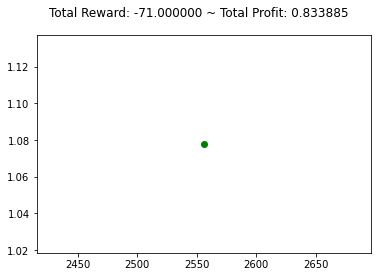

{'total_reward': -72.00000000000985, 'total_profit': 0.8338851276407527, 'position': 0}


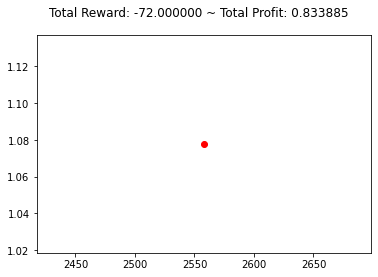

{'total_reward': -70.00000000000784, 'total_profit': 0.8338077369096494, 'position': 1}


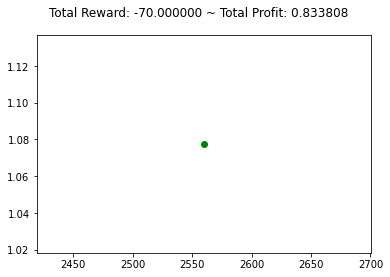

{'total_reward': -71.00000000000773, 'total_profit': 0.8338077369096494, 'position': 0}


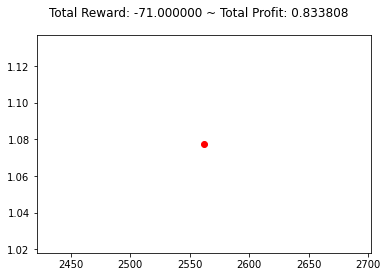

{'total_reward': -73.0000000000075, 'total_profit': 0.8334208550718109, 'position': 1}


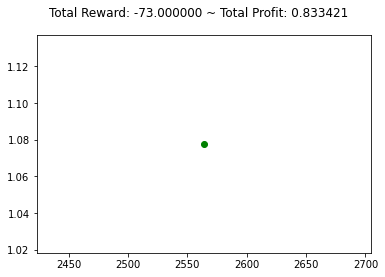

{'total_reward': -71.0000000000055, 'total_profit': 0.8334208550718109, 'position': 0}


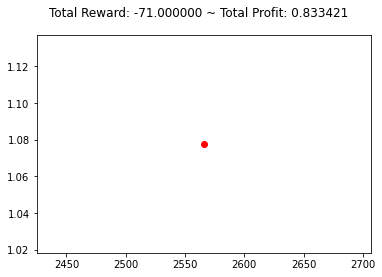

{'total_reward': -71.0000000000055, 'total_profit': 0.8334208550718109, 'position': 0}


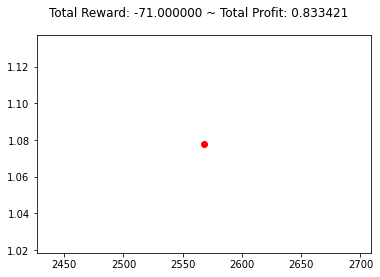

{'total_reward': -72.00000000000539, 'total_profit': 0.8331115793115096, 'position': 0}


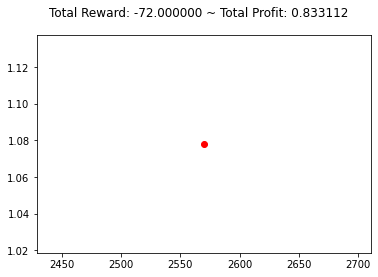

{'total_reward': -76.00000000000495, 'total_profit': 0.8325707482760668, 'position': 1}


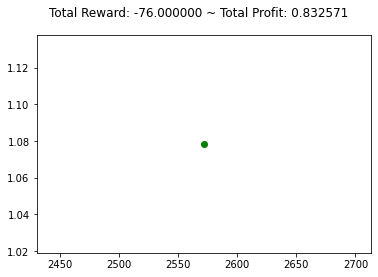

{'total_reward': -76.00000000000495, 'total_profit': 0.8325707482760668, 'position': 0}


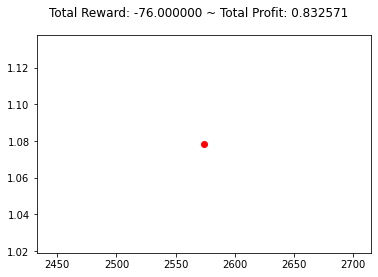

{'total_reward': -71.0000000000055, 'total_profit': 0.8327252427552422, 'position': 1}


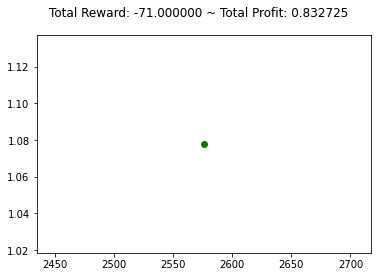

{'total_reward': -70.00000000000561, 'total_profit': 0.8327252427552422, 'position': 0}


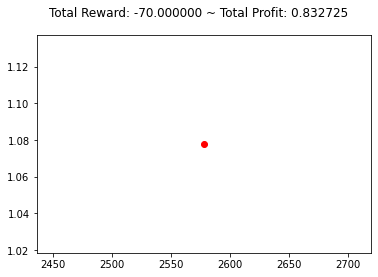

{'total_reward': -67.00000000000594, 'total_profit': 0.8324934795371083, 'position': 0}


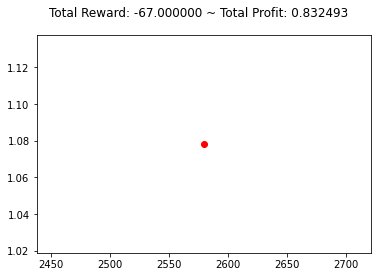

{'total_reward': -66.00000000000605, 'total_profit': 0.8322618452912717, 'position': 0}


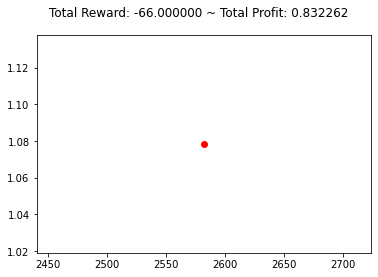

{'total_reward': -67.00000000000594, 'total_profit': 0.8319531428264011, 'position': 1}


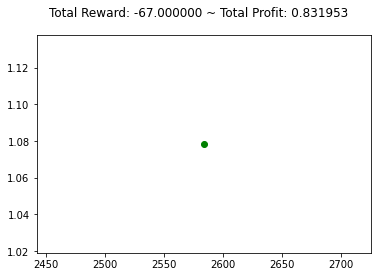

{'total_reward': -65.00000000000617, 'total_profit': 0.8319531428264011, 'position': 0}


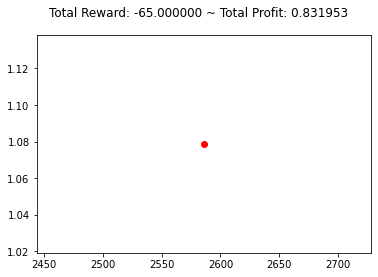

{'total_reward': -61.00000000000661, 'total_profit': 0.8320303041269785, 'position': 1}


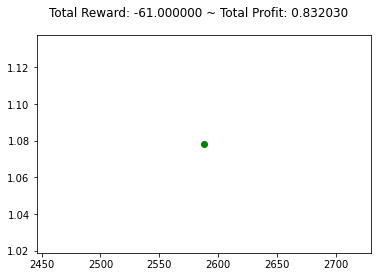

{'total_reward': -58.000000000006935, 'total_profit': 0.8318759815258235, 'position': 1}


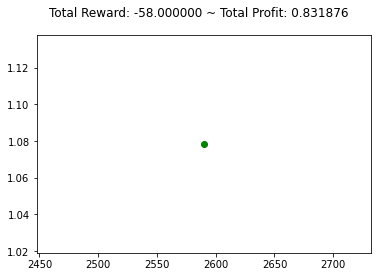

{'total_reward': -54.000000000007375, 'total_profit': 0.8318759815258235, 'position': 0}


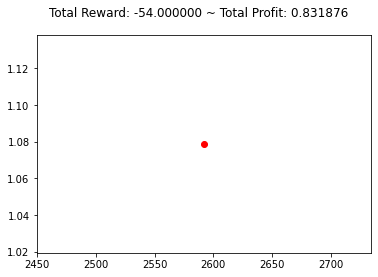

{'total_reward': -54.000000000007375, 'total_profit': 0.8318759815258235, 'position': 0}


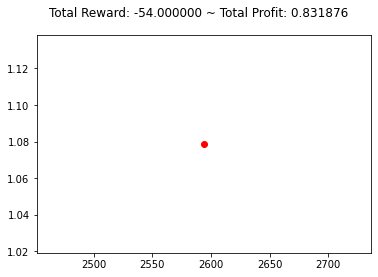

{'total_reward': -54.000000000007375, 'total_profit': 0.8316446263812441, 'position': 1}


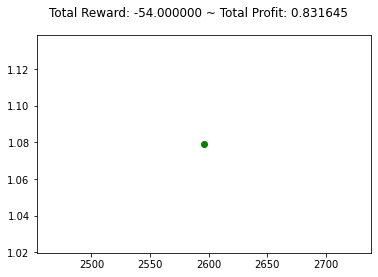

{'total_reward': -54.000000000007375, 'total_profit': 0.8316446263812441, 'position': 1}


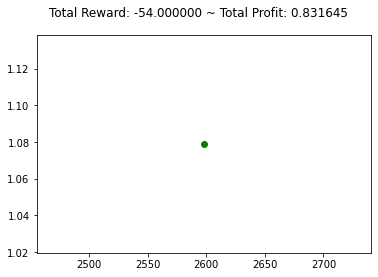

{'total_reward': -54.000000000007375, 'total_profit': 0.8316446263812441, 'position': 1}


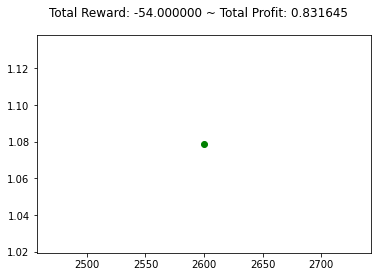

{'total_reward': -54.000000000007375, 'total_profit': 0.8316446263812441, 'position': 1}


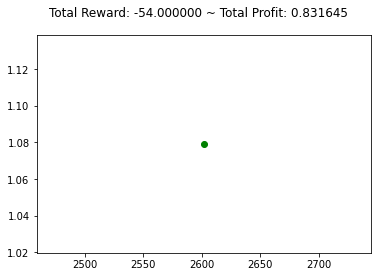

{'total_reward': -54.000000000007375, 'total_profit': 0.8316446263812441, 'position': 1}


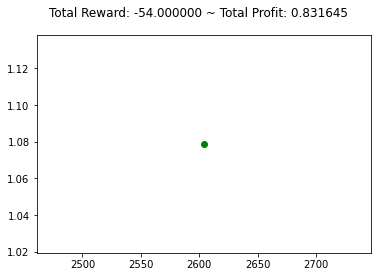

{'total_reward': -56.00000000000715, 'total_profit': 0.8313362386454951, 'position': 1}


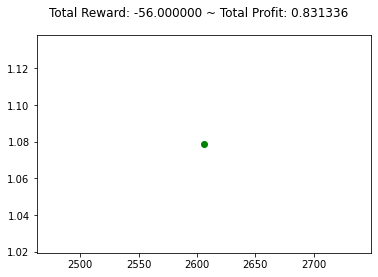

{'total_reward': -56.00000000000715, 'total_profit': 0.8313362386454951, 'position': 1}


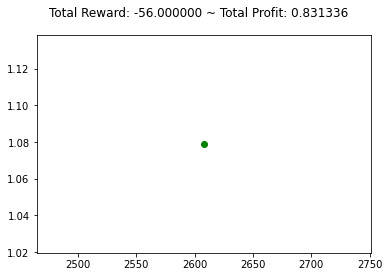

{'total_reward': -52.00000000000759, 'total_profit': 0.8313362386454951, 'position': 0}


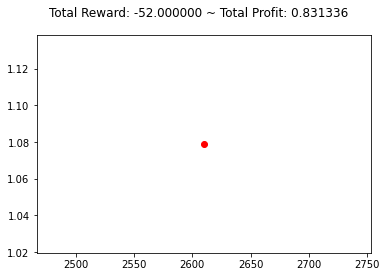

{'total_reward': -48.00000000000803, 'total_profit': 0.8314133069905999, 'position': 1}


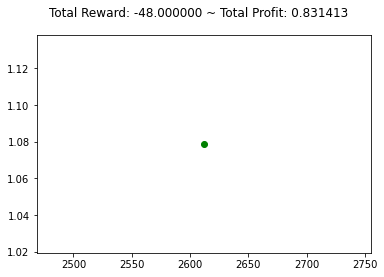

{'total_reward': -45.000000000008356, 'total_profit': 0.8311821448107137, 'position': 1}


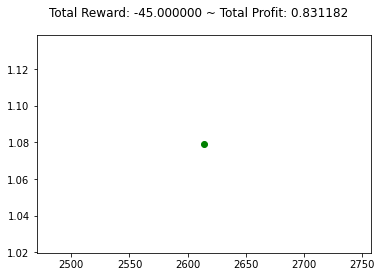

{'total_reward': -45.000000000008356, 'total_profit': 0.8311821448107137, 'position': 1}


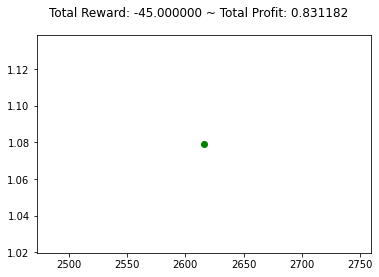

{'total_reward': -45.000000000008356, 'total_profit': 0.8311821448107137, 'position': 0}


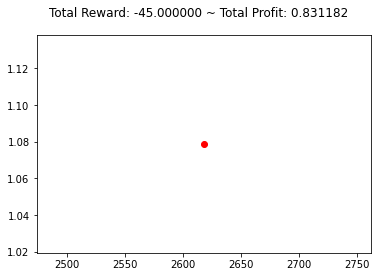

{'total_reward': -42.00000000000868, 'total_profit': 0.8311821448107137, 'position': 1}


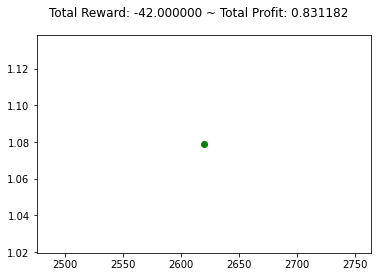

{'total_reward': -42.00000000000868, 'total_profit': 0.8311821448107137, 'position': 1}


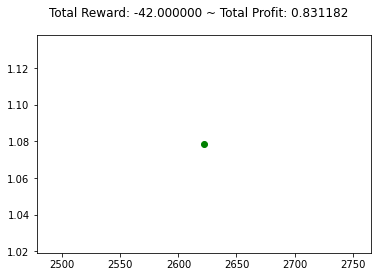

{'total_reward': -42.00000000000868, 'total_profit': 0.8311821448107137, 'position': 1}


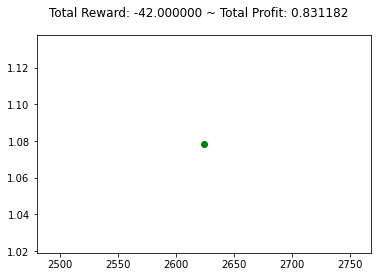

{'total_reward': -44.00000000000846, 'total_profit': 0.8309509397634784, 'position': 1}


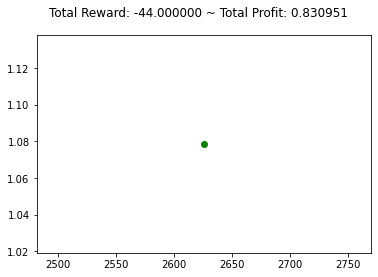

{'total_reward': -44.00000000000846, 'total_profit': 0.8309509397634784, 'position': 1}


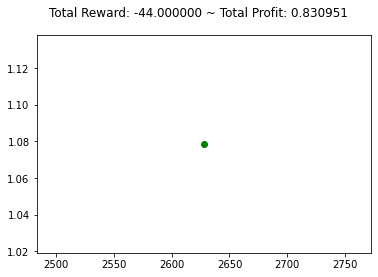

{'total_reward': -44.00000000000846, 'total_profit': 0.8305658480312681, 'position': 1}


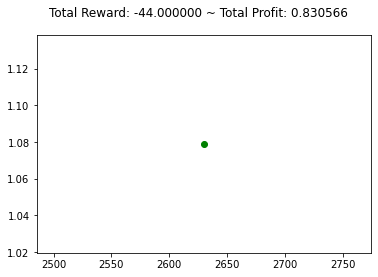

{'total_reward': -46.00000000000824, 'total_profit': 0.8303348572512464, 'position': 1}


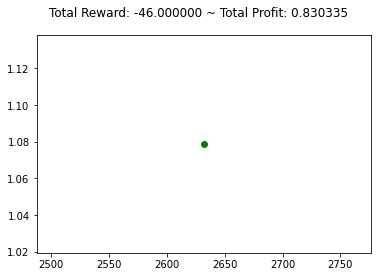

{'total_reward': -44.00000000000846, 'total_profit': 0.8303348572512464, 'position': 0}


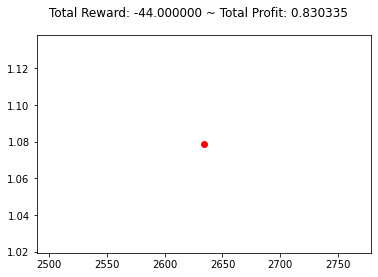

{'total_reward': -44.00000000000846, 'total_profit': 0.8303348572512464, 'position': 0}


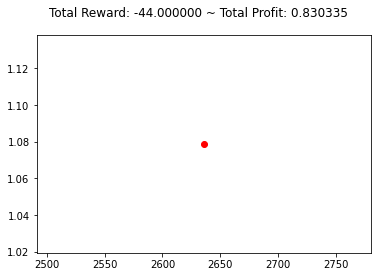

{'total_reward': -40.0000000000089, 'total_profit': 0.8304118470386597, 'position': 1}


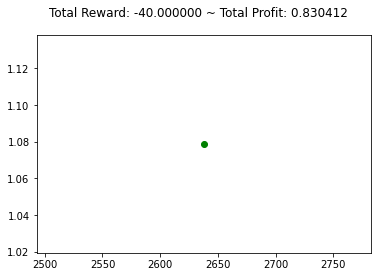

{'total_reward': -40.0000000000089, 'total_profit': 0.8304118470386597, 'position': 1}


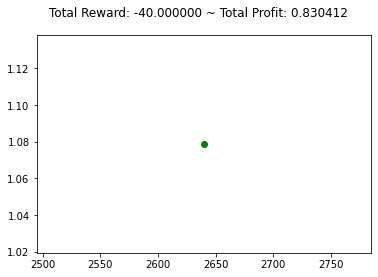

{'total_reward': -40.0000000000089, 'total_profit': 0.8304118470386597, 'position': 0}


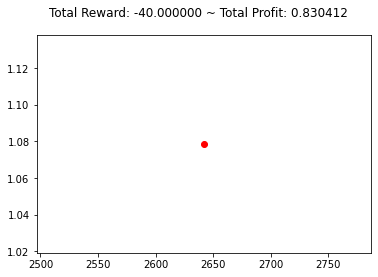

{'total_reward': -40.0000000000089, 'total_profit': 0.8301808562606239, 'position': 1}


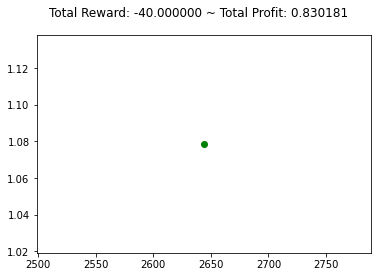

{'total_reward': -41.0000000000088, 'total_profit': 0.8301808562606239, 'position': 0}


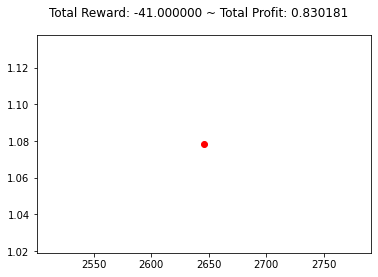

{'total_reward': -45.000000000008356, 'total_profit': 0.8297190888426612, 'position': 0}


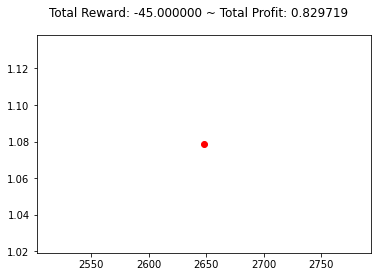

{'total_reward': -45.000000000008356, 'total_profit': 0.8294883121630277, 'position': 1}


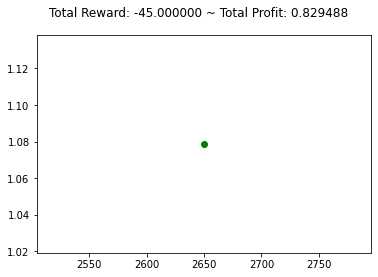

{'total_reward': -45.000000000008356, 'total_profit': 0.8294883121630277, 'position': 0}


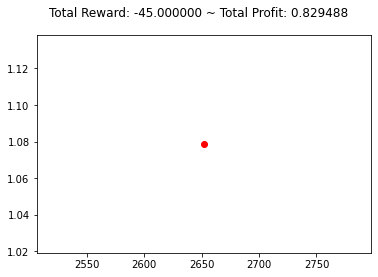

{'total_reward': -46.00000000000824, 'total_profit': 0.8291807240246526, 'position': 1}


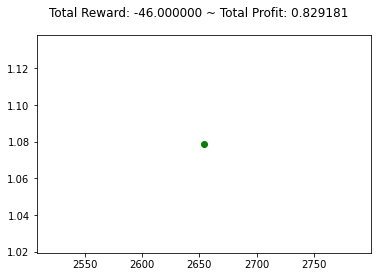

{'total_reward': -46.00000000000824, 'total_profit': 0.8291807240246526, 'position': 1}


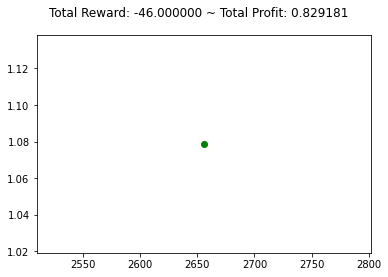

{'total_reward': -46.00000000000824, 'total_profit': 0.8291807240246526, 'position': 1}


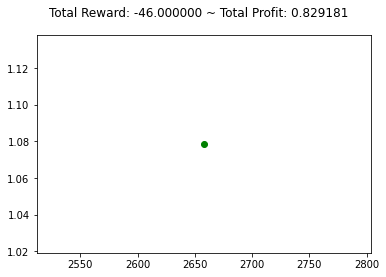

{'total_reward': -47.00000000000813, 'total_profit': 0.8290269442167845, 'position': 1}


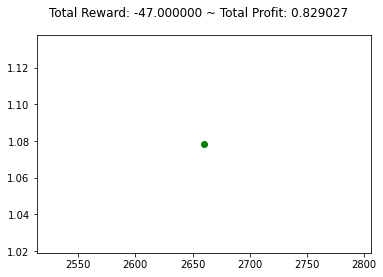

{'total_reward': -48.000000000008015, 'total_profit': 0.8290269442167845, 'position': 0}


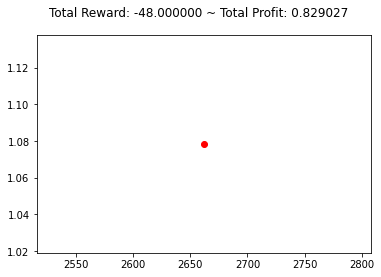

{'total_reward': -48.000000000008015, 'total_profit': 0.8290269442167845, 'position': 0}


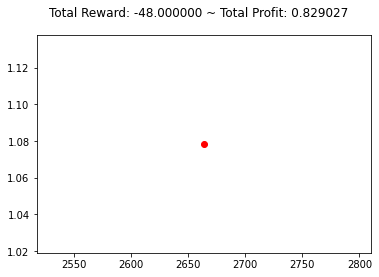

{'total_reward': -50.0000000000078, 'total_profit': 0.8288731644089165, 'position': 0}


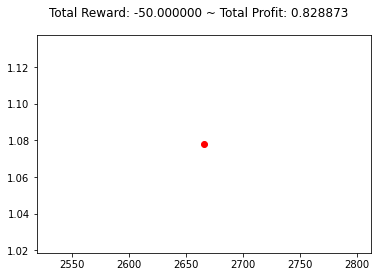

{'total_reward': -50.0000000000078, 'total_profit': 0.8288731644089165, 'position': 0}


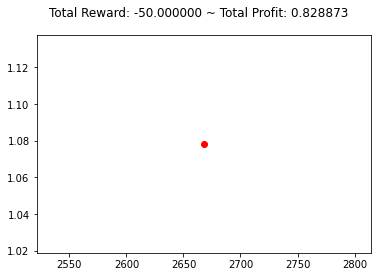

{'total_reward': -50.0000000000078, 'total_profit': 0.8286424732971968, 'position': 0}


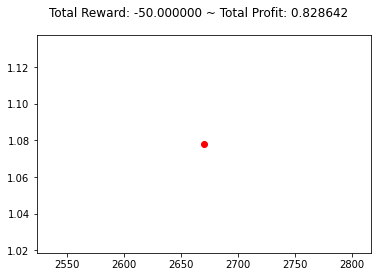

{'total_reward': -50.0000000000078, 'total_profit': 0.8286424732971968, 'position': 0}


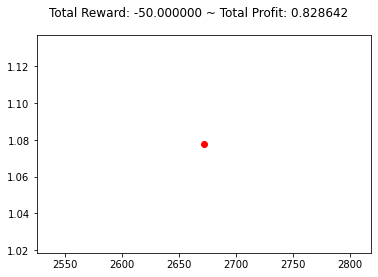

{'total_reward': -50.0000000000078, 'total_profit': 0.8286424732971968, 'position': 0}


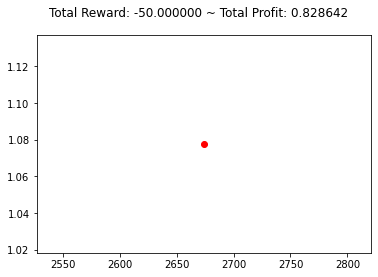

{'total_reward': -50.0000000000078, 'total_profit': 0.8286424732971968, 'position': 0}


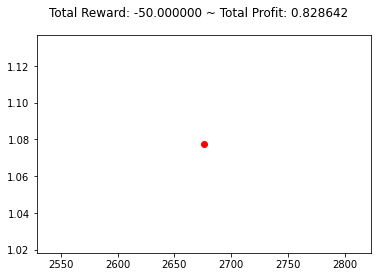

{'total_reward': -50.0000000000078, 'total_profit': 0.8286424732971968, 'position': 0}


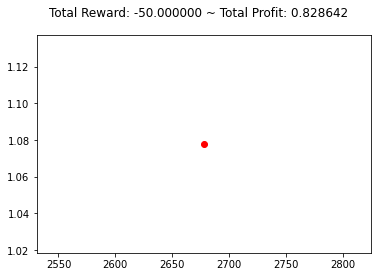

{'total_reward': -46.000000000006025, 'total_profit': 0.8287193774710528, 'position': 1}


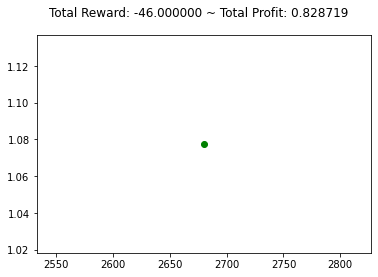

{'total_reward': -46.000000000006025, 'total_profit': 0.8287193774710528, 'position': 0}


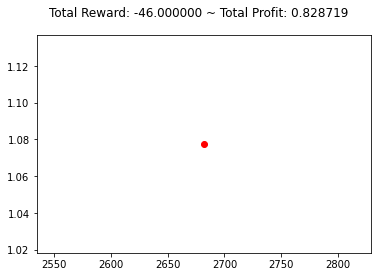

{'total_reward': -46.000000000006025, 'total_profit': 0.8284886435376503, 'position': 0}


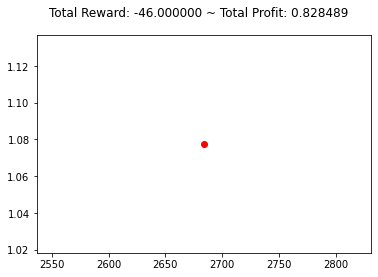

{'total_reward': -47.00000000000591, 'total_profit': 0.8281811124895665, 'position': 1}


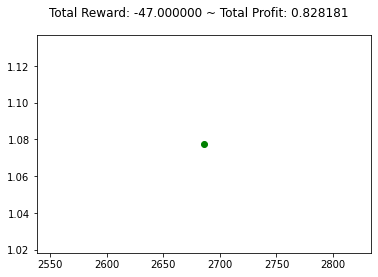

{'total_reward': -52.00000000000536, 'total_profit': 0.8281811124895665, 'position': 0}


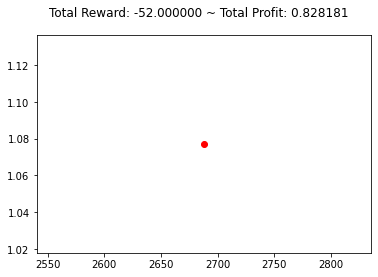

{'total_reward': -53.000000000005244, 'total_profit': 0.8278735814414828, 'position': 1}


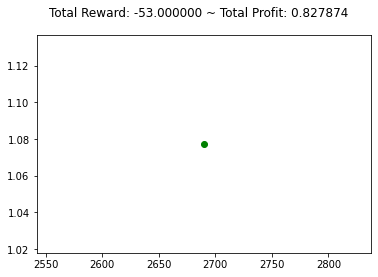

{'total_reward': -53.000000000005244, 'total_profit': 0.8278735814414828, 'position': 1}


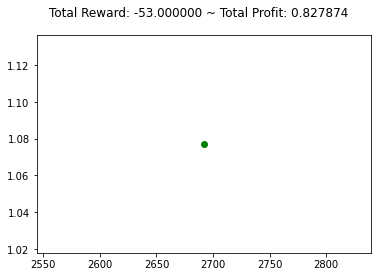

{'total_reward': -56.00000000000492, 'total_profit': 0.8275661360486906, 'position': 1}


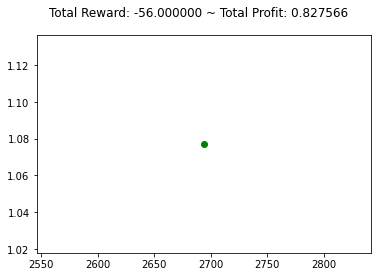

{'total_reward': -57.0000000000048, 'total_profit': 0.8273356162336353, 'position': 1}


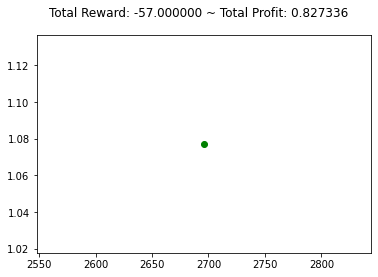

{'total_reward': -55.00000000000502, 'total_profit': 0.8271052034181228, 'position': 1}


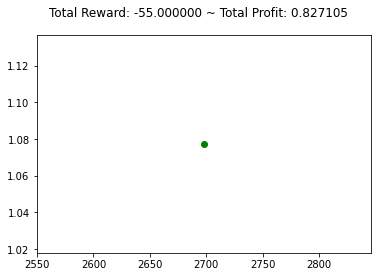

{'total_reward': -58.00000000000469, 'total_profit': 0.8271052034181228, 'position': 0}


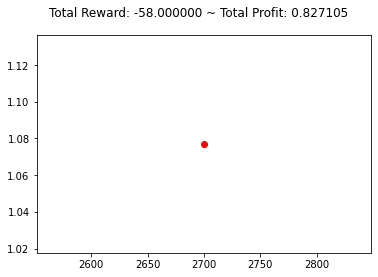

{'total_reward': -60.00000000000447, 'total_profit': 0.8267212533654731, 'position': 1}


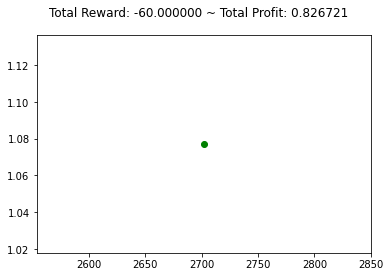

{'total_reward': -60.00000000000447, 'total_profit': 0.8267212533654731, 'position': 1}


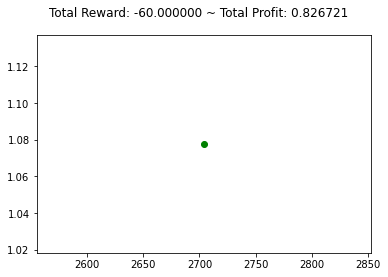

{'total_reward': -56.00000000000491, 'total_profit': 0.8267212533654731, 'position': 0}


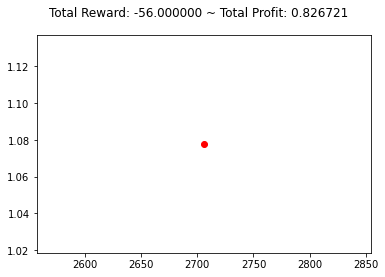

{'total_reward': -58.00000000000691, 'total_profit': 0.8263376952076529, 'position': 1}


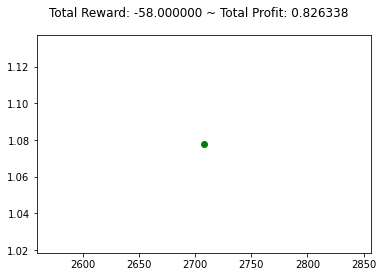

{'total_reward': -54.00000000000735, 'total_profit': 0.8263376952076529, 'position': 0}


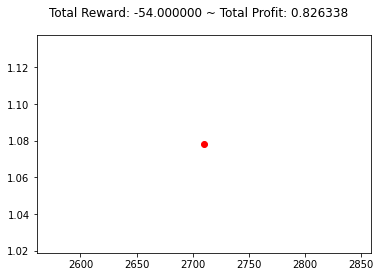

{'total_reward': -54.00000000000735, 'total_profit': 0.8263376952076529, 'position': 0}


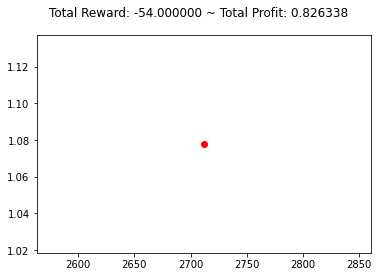

{'total_reward': -52.00000000000757, 'total_profit': 0.8262610333934579, 'position': 0}


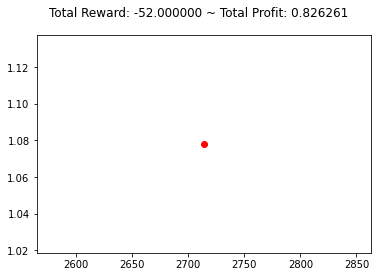

{'total_reward': -52.00000000000757, 'total_profit': 0.826031069287309, 'position': 1}


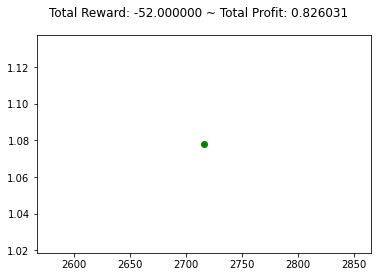

{'total_reward': -50.00000000000779, 'total_profit': 0.826031069287309, 'position': 0}


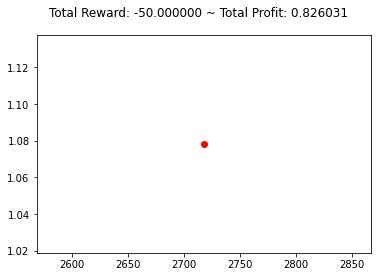

{'total_reward': -50.00000000000779, 'total_profit': 0.8258012118336533, 'position': 1}


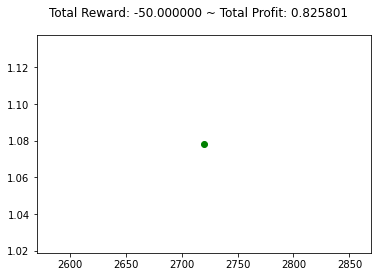

{'total_reward': -50.00000000000779, 'total_profit': 0.8258012118336533, 'position': 1}


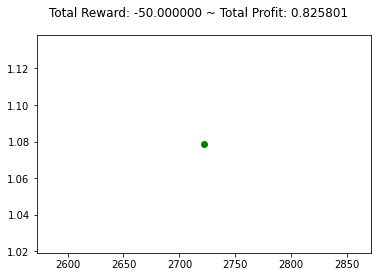

{'total_reward': -48.00000000000801, 'total_profit': 0.8258012118336533, 'position': 0}


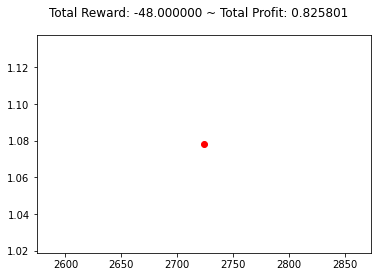

{'total_reward': -49.00000000001012, 'total_profit': 0.8258778238766845, 'position': 0}


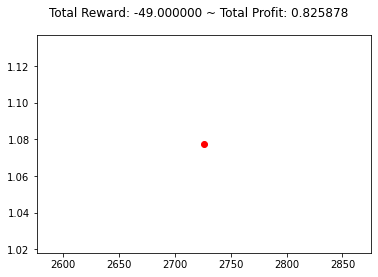

{'total_reward': -52.00000000001201, 'total_profit': 0.8251117745084656, 'position': 0}


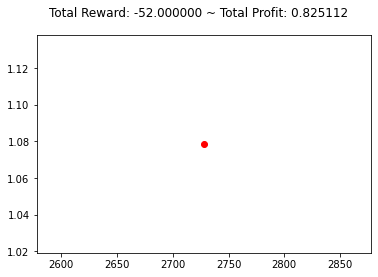

{'total_reward': -50.00000000001223, 'total_profit': 0.8250352548224313, 'position': 1}


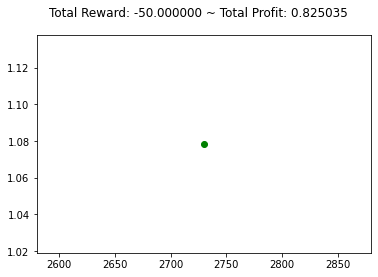

{'total_reward': -55.00000000001168, 'total_profit': 0.8250352548224313, 'position': 0}


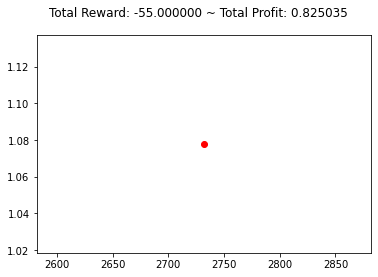

{'total_reward': -55.00000000001168, 'total_profit': 0.8250352548224313, 'position': 0}


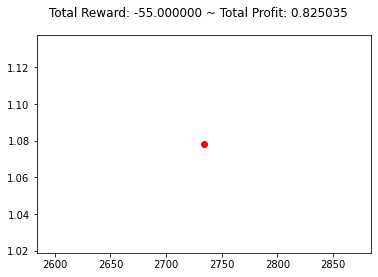

{'total_reward': -55.00000000001168, 'total_profit': 0.8250352548224313, 'position': 0}


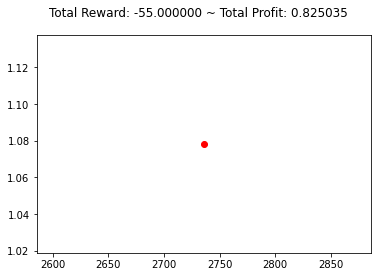

{'total_reward': -59.00000000001124, 'total_profit': 0.8244996170201909, 'position': 1}


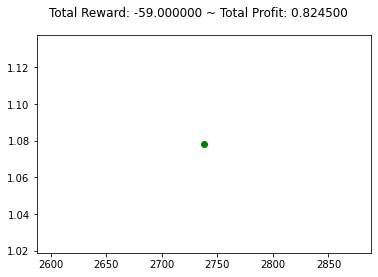

{'total_reward': -59.00000000001124, 'total_profit': 0.8244996170201909, 'position': 0}


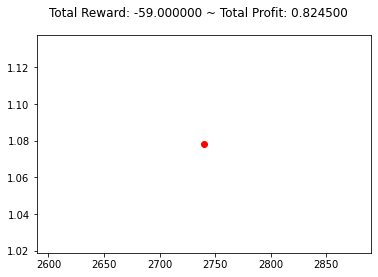

{'total_reward': -62.000000000010914, 'total_profit': 0.8240409246046027, 'position': 1}


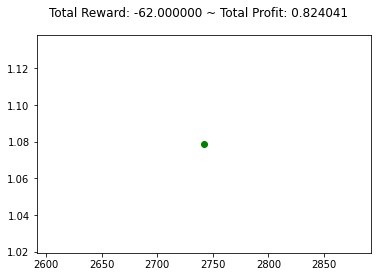

{'total_reward': -59.00000000001124, 'total_profit': 0.823888126361583, 'position': 1}


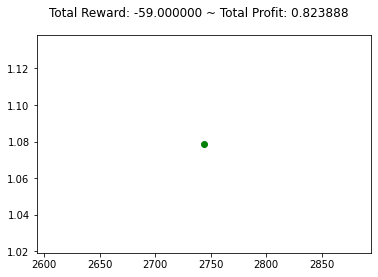

{'total_reward': -60.00000000001113, 'total_profit': 0.8237353139482729, 'position': 1}


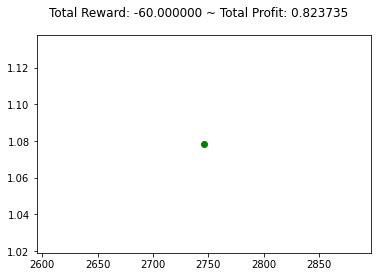

{'total_reward': -60.00000000001113, 'total_profit': 0.8237353139482729, 'position': 1}


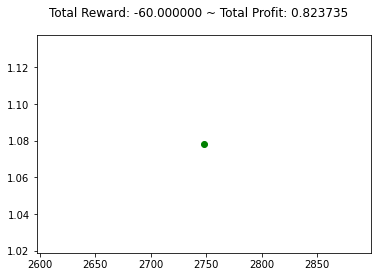

{'total_reward': -60.00000000001113, 'total_profit': 0.8237353139482729, 'position': 1}


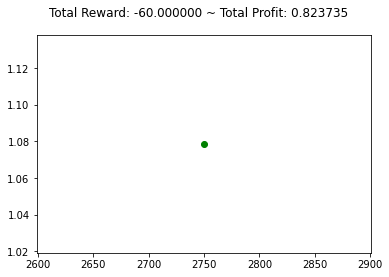

{'total_reward': -58.000000000011354, 'total_profit': 0.8235825298781723, 'position': 1}


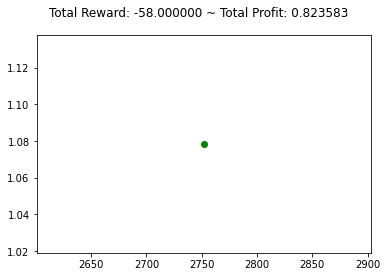

{'total_reward': -60.000000000011134, 'total_profit': 0.8235825298781723, 'position': 0}


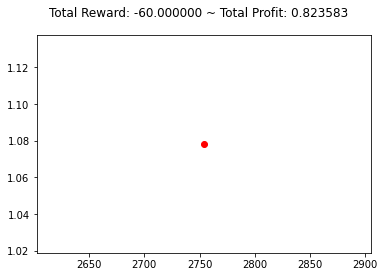

{'total_reward': -61.00000000001103, 'total_profit': 0.8232769900785514, 'position': 1}


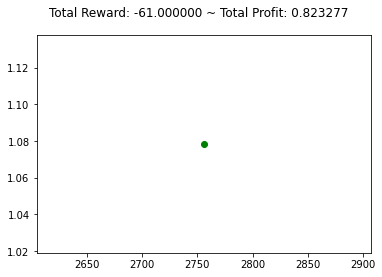

{'total_reward': -61.00000000001103, 'total_profit': 0.8232769900785514, 'position': 0}


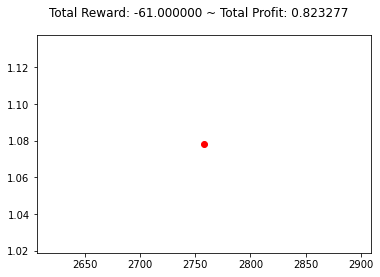

{'total_reward': -62.000000000010914, 'total_profit': 0.8229715919555509, 'position': 1}


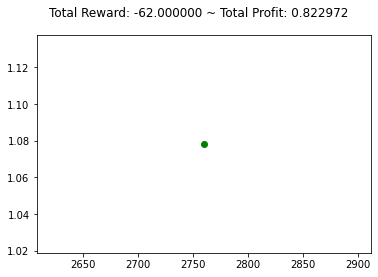

{'total_reward': -63.0000000000108, 'total_profit': 0.8229715919555509, 'position': 0}


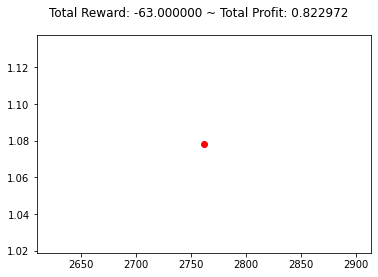

{'total_reward': -68.00000000001025, 'total_profit': 0.8223612486964758, 'position': 1}


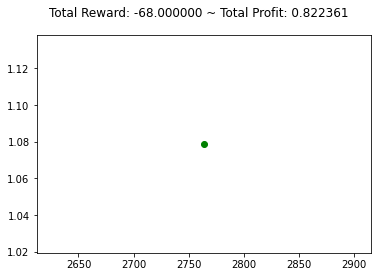

{'total_reward': -71.00000000000992, 'total_profit': 0.8221324760939082, 'position': 1}


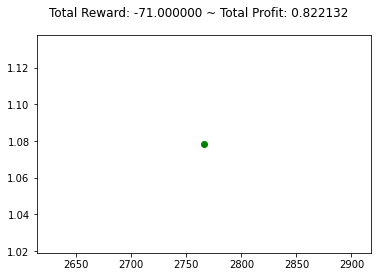

{'total_reward': -71.00000000000992, 'total_profit': 0.8221324760939082, 'position': 1}


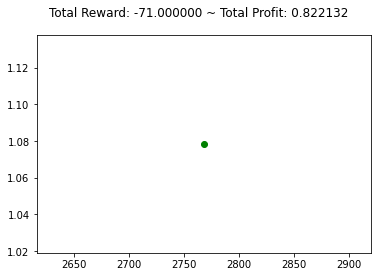

{'total_reward': -70.00000000001003, 'total_profit': 0.8221324760939082, 'position': 0}


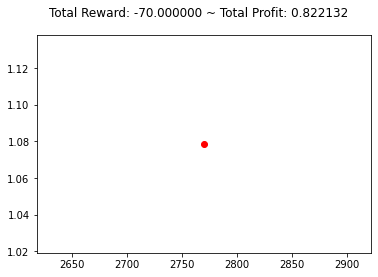

{'total_reward': -68.00000000001026, 'total_profit': 0.8220562327037483, 'position': 1}


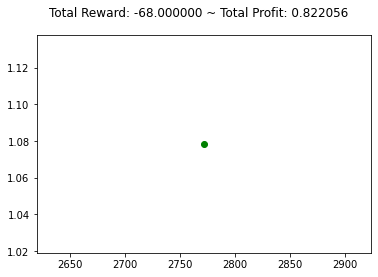

{'total_reward': -68.00000000001026, 'total_profit': 0.8220562327037483, 'position': 1}


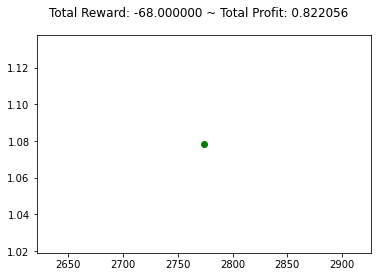

{'total_reward': -69.00000000001015, 'total_profit': 0.8220562327037483, 'position': 0}


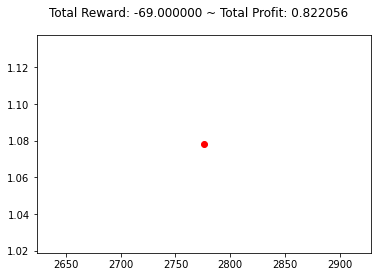

{'total_reward': -67.00000000001037, 'total_profit': 0.8218275025332686, 'position': 0}


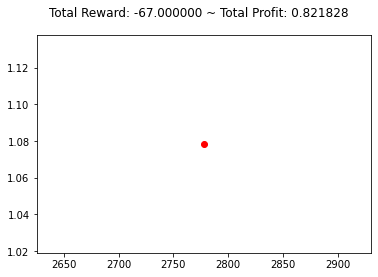

{'total_reward': -61.000000000011035, 'total_profit': 0.8220562539256976, 'position': 1}


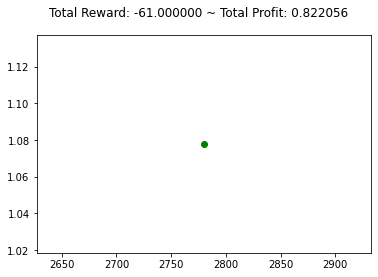

{'total_reward': -57.000000000011475, 'total_profit': 0.8220562539256976, 'position': 0}


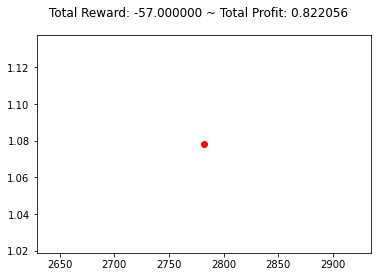

{'total_reward': -57.000000000011475, 'total_profit': 0.8220562539256976, 'position': 0}


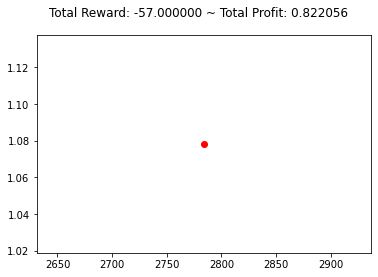

{'total_reward': -57.000000000011475, 'total_profit': 0.8218275237493132, 'position': 1}


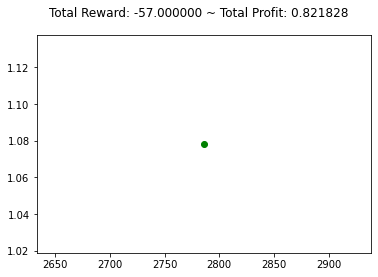

{'total_reward': -57.000000000011475, 'total_profit': 0.8218275237493132, 'position': 0}


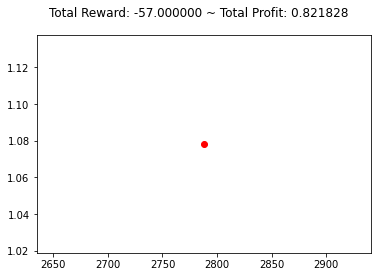

{'total_reward': -59.000000000011255, 'total_profit': 0.8215226633120511, 'position': 0}


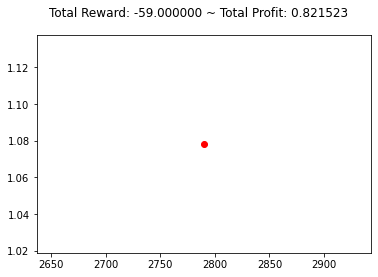

{'total_reward': -58.00000000001137, 'total_profit': 0.8213702613709859, 'position': 1}


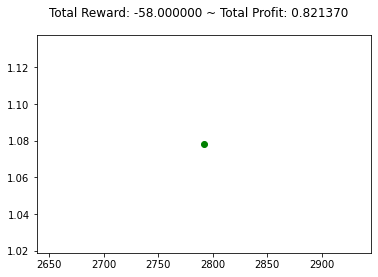

{'total_reward': -58.00000000001137, 'total_profit': 0.8213702613709859, 'position': 1}


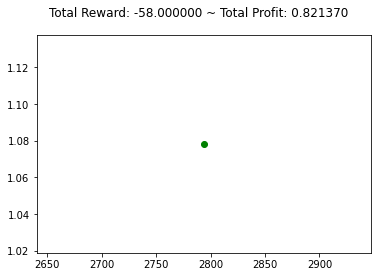

{'total_reward': -57.00000000001148, 'total_profit': 0.8211417220662082, 'position': 1}


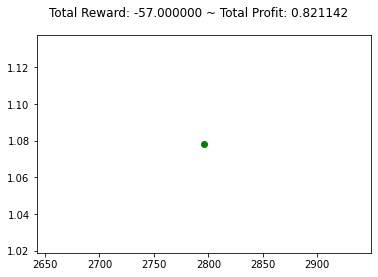

{'total_reward': -57.00000000001148, 'total_profit': 0.8211417220662082, 'position': 0}


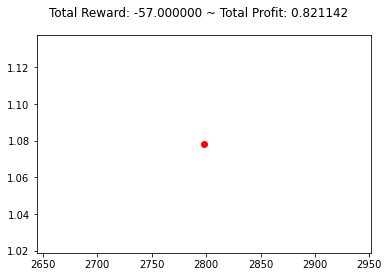

{'total_reward': -58.00000000001137, 'total_profit': 0.8209132463505525, 'position': 0}


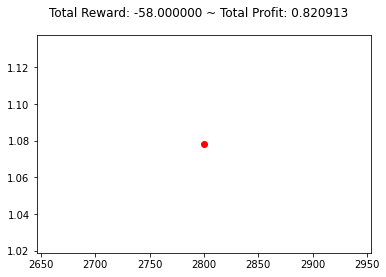

{'total_reward': -61.00000000001104, 'total_profit': 0.8204565067847047, 'position': 1}


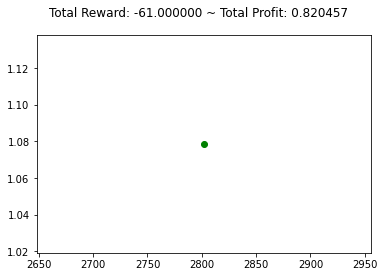

{'total_reward': -61.00000000001104, 'total_profit': 0.8204565067847047, 'position': 1}


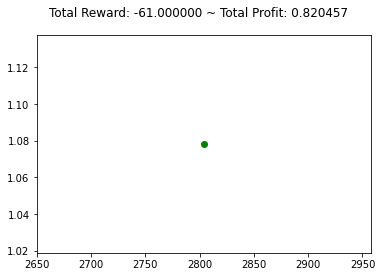

{'total_reward': -62.00000000001093, 'total_profit': 0.8203043026279875, 'position': 1}


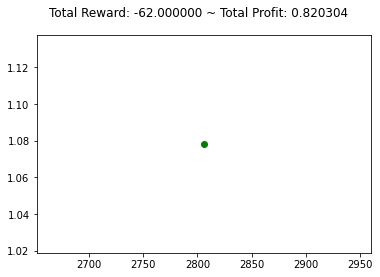

{'total_reward': -62.00000000001093, 'total_profit': 0.8203043026279875, 'position': 1}


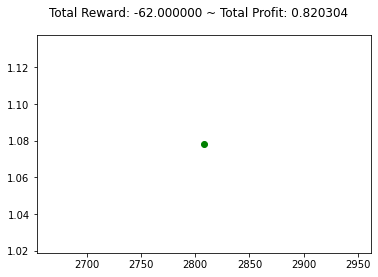

{'total_reward': -62.00000000001093, 'total_profit': 0.8203043026279875, 'position': 0}


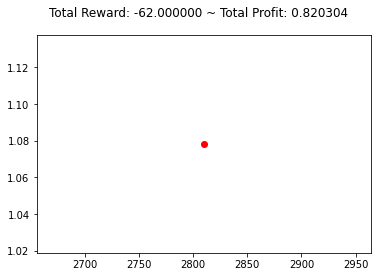

{'total_reward': -62.00000000001093, 'total_profit': 0.8200760387463546, 'position': 1}


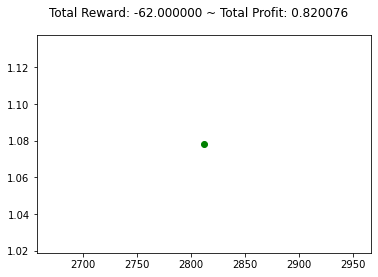

{'total_reward': -62.00000000001093, 'total_profit': 0.8200760387463546, 'position': 1}


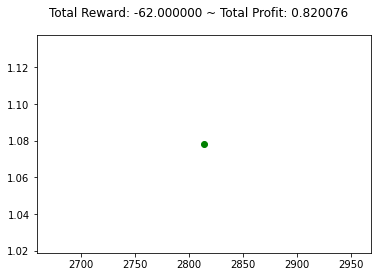

{'total_reward': -60.00000000001115, 'total_profit': 0.8200760387463546, 'position': 0}


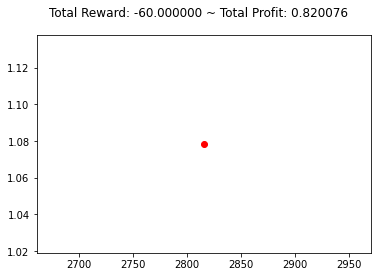

{'total_reward': -59.000000000011255, 'total_profit': 0.8199239192808109, 'position': 0}


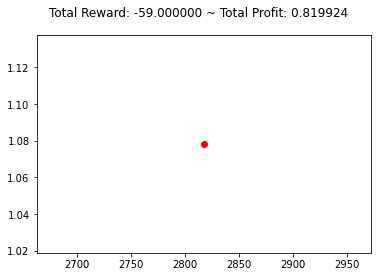

{'total_reward': -59.000000000011255, 'total_profit': 0.8196957824084455, 'position': 1}


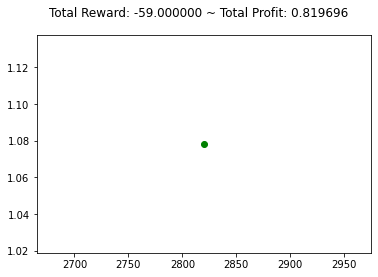

{'total_reward': -58.00000000001137, 'total_profit': 0.8196957824084455, 'position': 0}


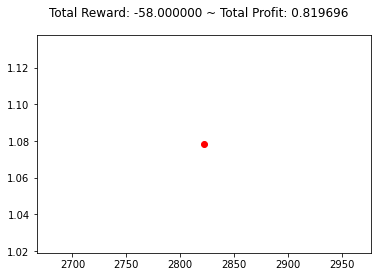

{'total_reward': -57.00000000001148, 'total_profit': 0.8195437334783011, 'position': 1}


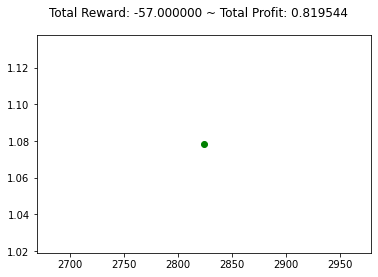

{'total_reward': -56.000000000011596, 'total_profit': 0.8195437334783011, 'position': 0}


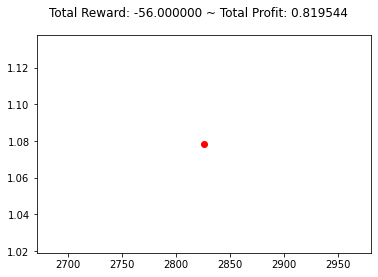

{'total_reward': -56.000000000011596, 'total_profit': 0.8195437334783011, 'position': 0}


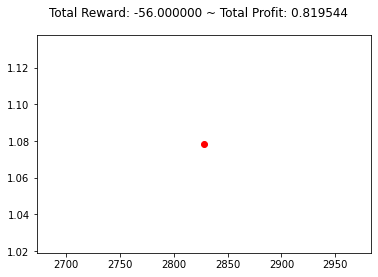

{'total_reward': -56.000000000011596, 'total_profit': 0.8193157235366861, 'position': 1}


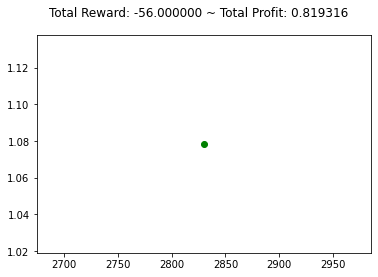

{'total_reward': -56.000000000011596, 'total_profit': 0.8193157235366861, 'position': 1}


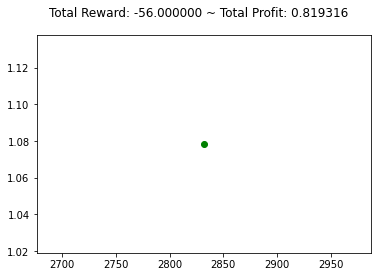

{'total_reward': -56.000000000011596, 'total_profit': 0.8193157235366861, 'position': 1}


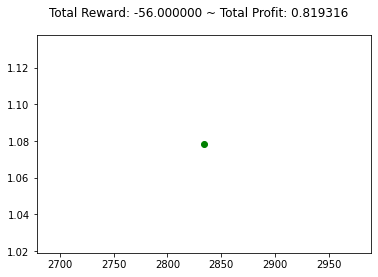

{'total_reward': -56.000000000011596, 'total_profit': 0.8193157235366861, 'position': 0}


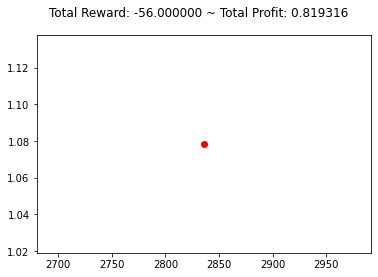

{'total_reward': -56.000000000011596, 'total_profit': 0.8190877770310189, 'position': 1}


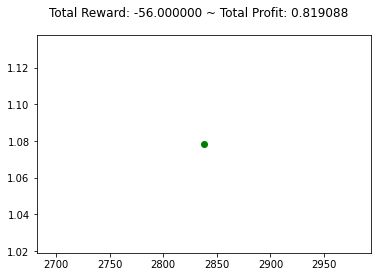

{'total_reward': -56.000000000011596, 'total_profit': 0.8190877770310189, 'position': 1}


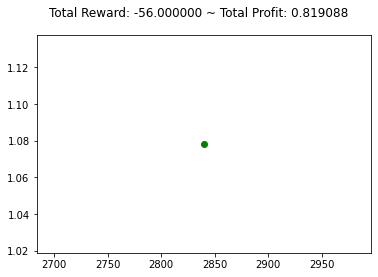

{'total_reward': -56.000000000011596, 'total_profit': 0.8190877770310189, 'position': 0}


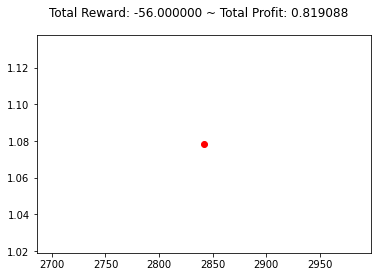

{'total_reward': -56.000000000011596, 'total_profit': 0.8188598939436506, 'position': 0}


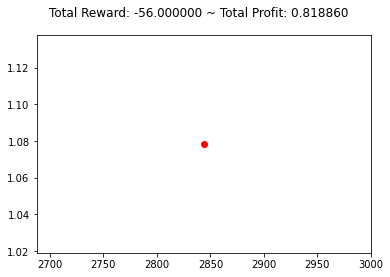

{'total_reward': -56.000000000011596, 'total_profit': 0.8188598939436506, 'position': 0}


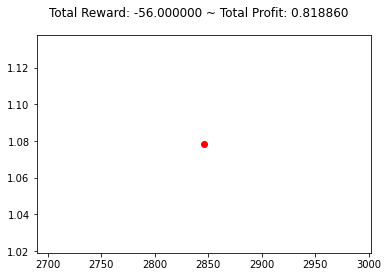

{'total_reward': -58.000000000011376, 'total_profit': 0.8184802648783082, 'position': 1}


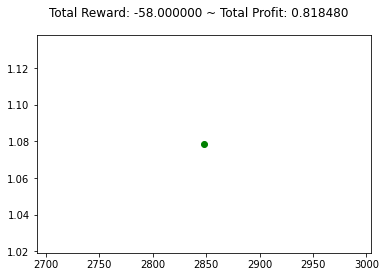

{'total_reward': -61.00000000001104, 'total_profit': 0.8182525296905291, 'position': 1}


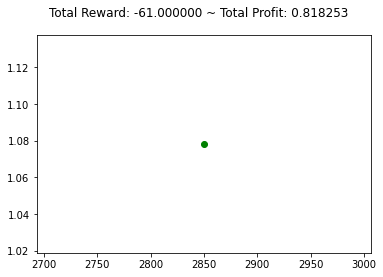

{'total_reward': -61.00000000001104, 'total_profit': 0.8180248578681333, 'position': 1}


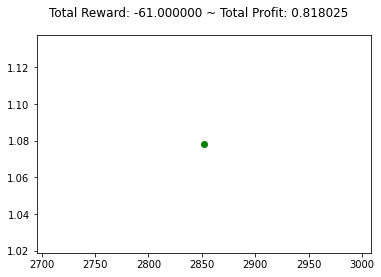

{'total_reward': -61.00000000001104, 'total_profit': 0.8180248578681333, 'position': 1}


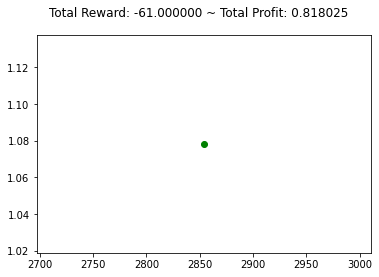

{'total_reward': -61.00000000001104, 'total_profit': 0.8180248578681333, 'position': 0}


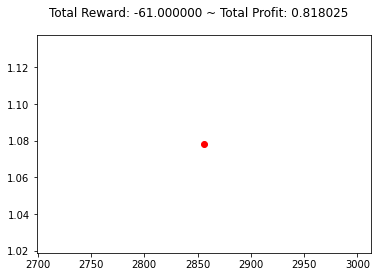

{'total_reward': -60.000000000011156, 'total_profit': 0.8178731048103709, 'position': 0}


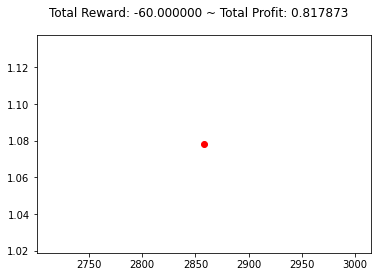

{'total_reward': -63.00000000001083, 'total_profit': 0.8174938628995806, 'position': 0}


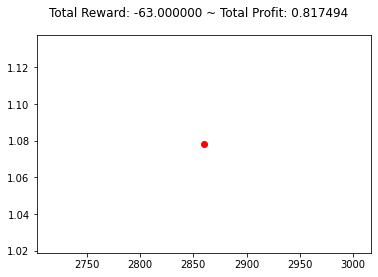

{'total_reward': -63.00000000001083, 'total_profit': 0.8172664021697811, 'position': 1}


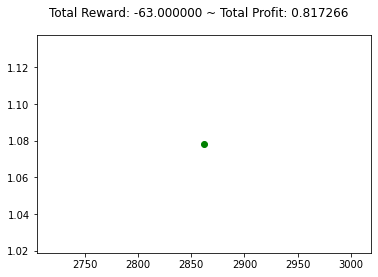

{'total_reward': -66.0000000000105, 'total_profit': 0.816811733795834, 'position': 1}


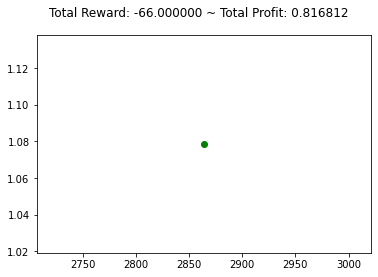

{'total_reward': -69.00000000001017, 'total_profit': 0.816811733795834, 'position': 0}


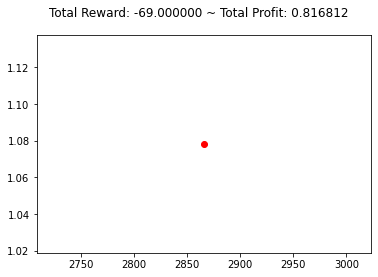

{'total_reward': -69.00000000001017, 'total_profit': 0.8165844628626688, 'position': 1}


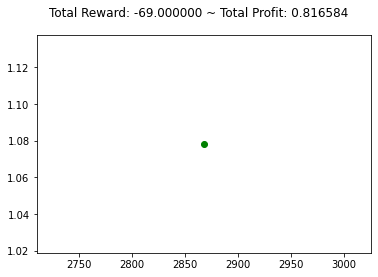

{'total_reward': -69.00000000001017, 'total_profit': 0.8165844628626688, 'position': 1}


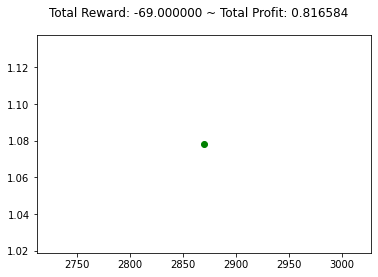

{'total_reward': -70.00000000001006, 'total_profit': 0.8165844628626688, 'position': 0}


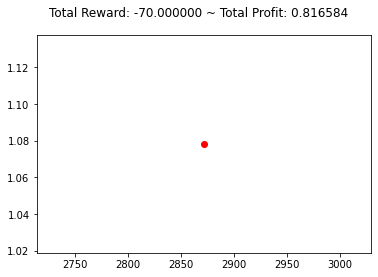

{'total_reward': -71.00000000000995, 'total_profit': 0.8162815192667265, 'position': 1}


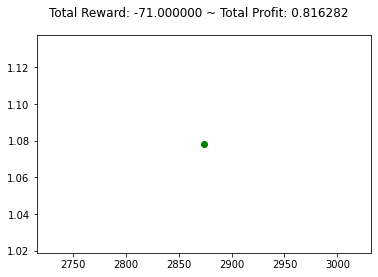

{'total_reward': -72.00000000000983, 'total_profit': 0.8162815192667265, 'position': 0}


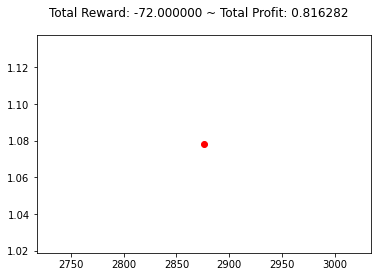

{'total_reward': -75.0000000000095, 'total_profit': 0.8160543747942471, 'position': 0}


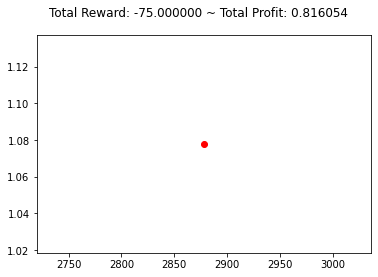

{'total_reward': -76.0000000000094, 'total_profit': 0.8157515435947688, 'position': 1}


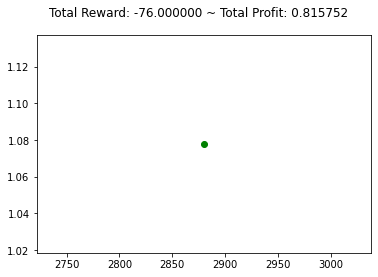

{'total_reward': -77.00000000000928, 'total_profit': 0.8155244834137719, 'position': 1}


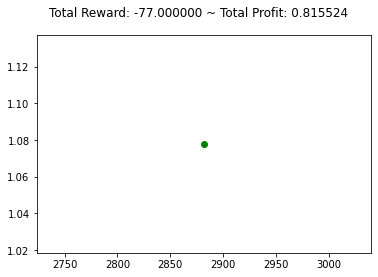

{'total_reward': -77.00000000000928, 'total_profit': 0.8155244834137719, 'position': 1}


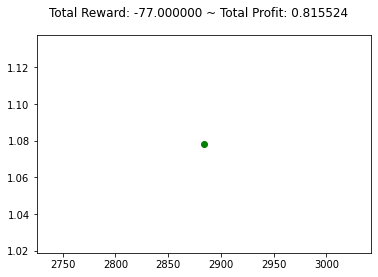

{'total_reward': -72.00000000000983, 'total_profit': 0.8155244834137719, 'position': 0}


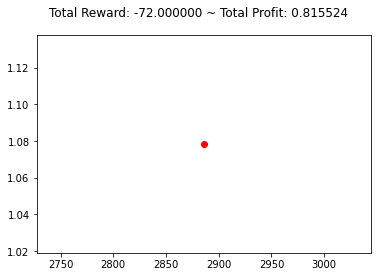

{'total_reward': -72.00000000000983, 'total_profit': 0.8155244834137719, 'position': 0}


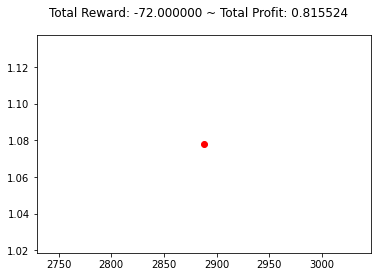

{'total_reward': -68.00000000001027, 'total_profit': 0.8156001420540366, 'position': 0}


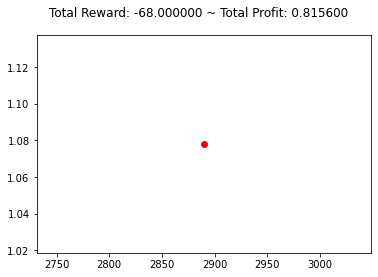

{'total_reward': -67.00000000001039, 'total_profit': 0.8154487966945907, 'position': 0}


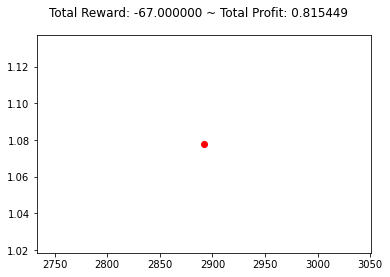

{'total_reward': -67.00000000001039, 'total_profit': 0.8152218207816121, 'position': 0}


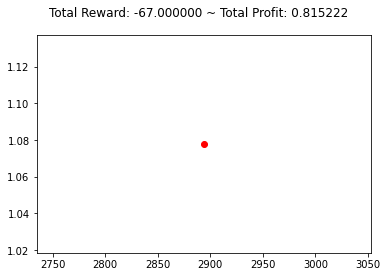

{'total_reward': -67.00000000001039, 'total_profit': 0.8152218207816121, 'position': 0}


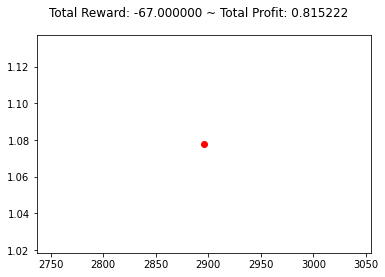

{'total_reward': -67.00000000001039, 'total_profit': 0.8152218207816121, 'position': 0}


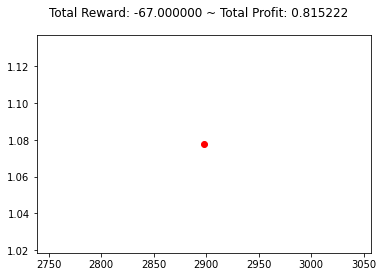

{'total_reward': -68.00000000001027, 'total_profit': 0.8149192985362159, 'position': 1}


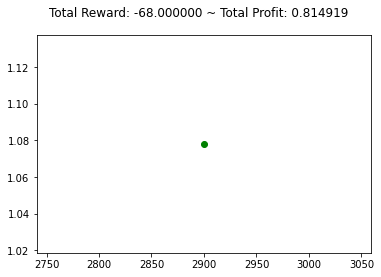

{'total_reward': -68.00000000001027, 'total_profit': 0.8149192985362159, 'position': 1}


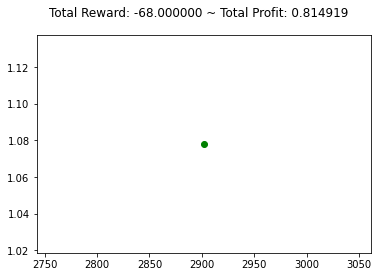

{'total_reward': -68.00000000001027, 'total_profit': 0.8149192985362159, 'position': 1}


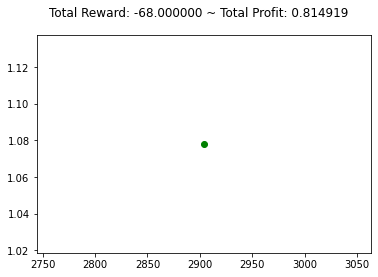

{'total_reward': -68.00000000001027, 'total_profit': 0.8149192985362159, 'position': 0}


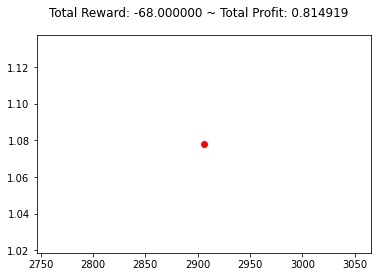

{'total_reward': -67.00000000001039, 'total_profit': 0.8147680795162612, 'position': 1}


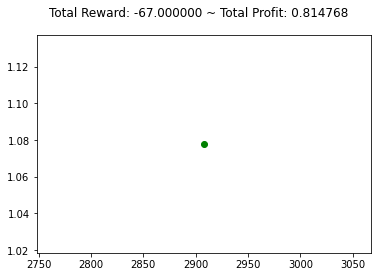

{'total_reward': -69.00000000001239, 'total_profit': 0.8147680795162612, 'position': 0}


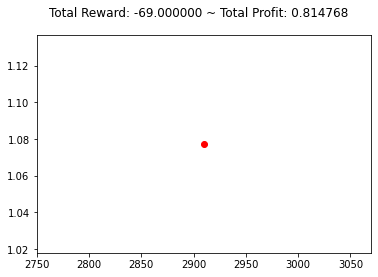

{'total_reward': -63.00000000001305, 'total_profit': 0.8149950344130624, 'position': 1}


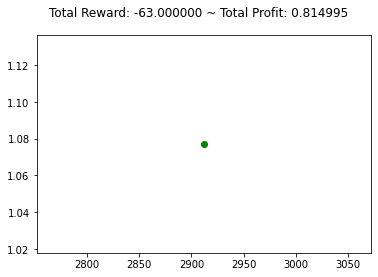

{'total_reward': -63.00000000001305, 'total_profit': 0.8149950344130624, 'position': 0}


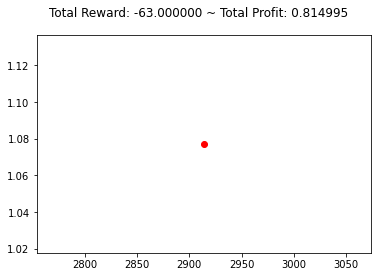

{'total_reward': -65.00000000001283, 'total_profit': 0.8146167411367846, 'position': 1}


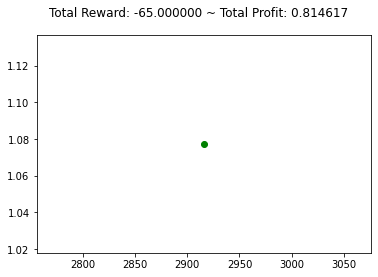

{'total_reward': -67.00000000001262, 'total_profit': 0.8146167411367846, 'position': 0}


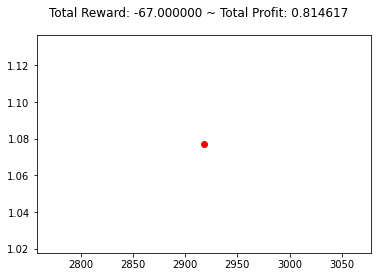

{'total_reward': -67.00000000001262, 'total_profit': 0.8146167411367846, 'position': 0}


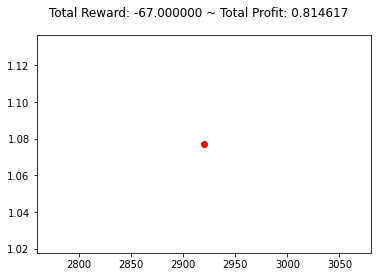

{'total_reward': -67.00000000001262, 'total_profit': 0.8144654519286619, 'position': 0}


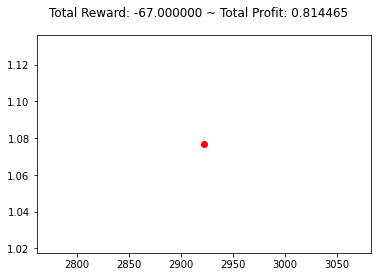

{'total_reward': -69.00000000001239, 'total_profit': 0.814087334262957, 'position': 1}


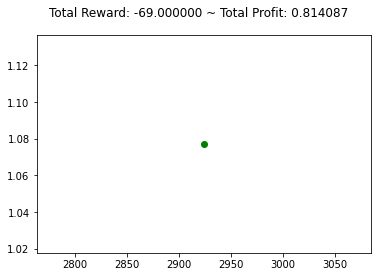

{'total_reward': -67.00000000001262, 'total_profit': 0.8140117317987796, 'position': 1}


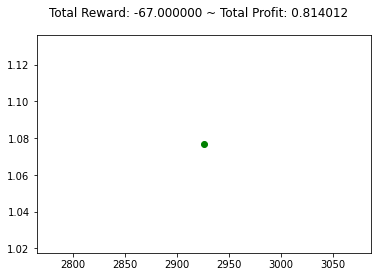

{'total_reward': -67.00000000001262, 'total_profit': 0.8140117317987796, 'position': 1}


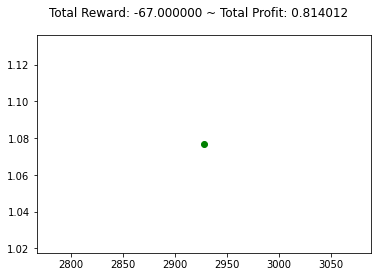

{'total_reward': -66.00000000001273, 'total_profit': 0.8140117317987796, 'position': 0}


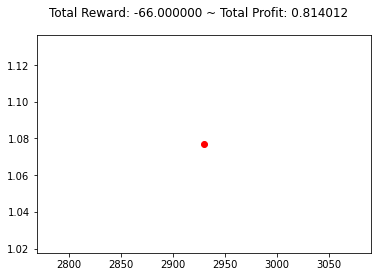

{'total_reward': -66.00000000001273, 'total_profit': 0.8140117317987796, 'position': 0}


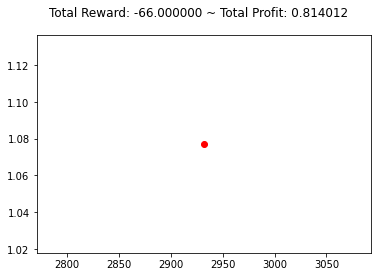

{'total_reward': -68.0000000000125, 'total_profit': 0.813633859859406, 'position': 1}


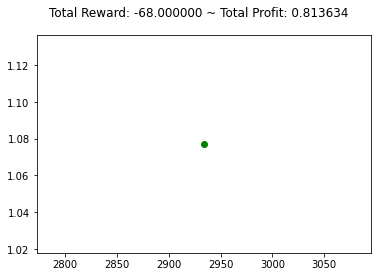

{'total_reward': -68.0000000000125, 'total_profit': 0.8134072419428172, 'position': 1}


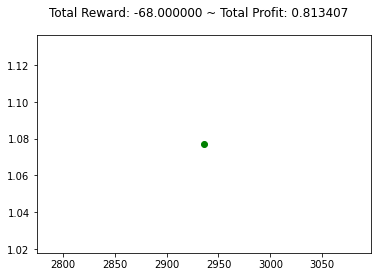

{'total_reward': -67.00000000001262, 'total_profit': 0.8134072419428172, 'position': 0}


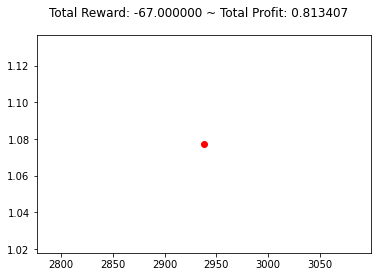

{'total_reward': -67.00000000001262, 'total_profit': 0.8134072419428172, 'position': 0}


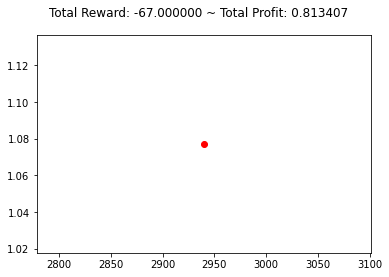

{'total_reward': -65.00000000001285, 'total_profit': 0.8133317166650138, 'position': 1}


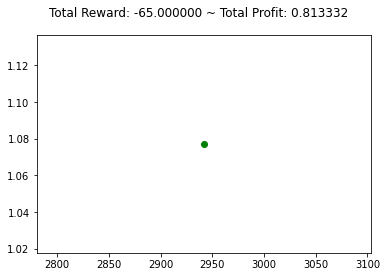

{'total_reward': -64.00000000001295, 'total_profit': 0.8133317166650138, 'position': 1}


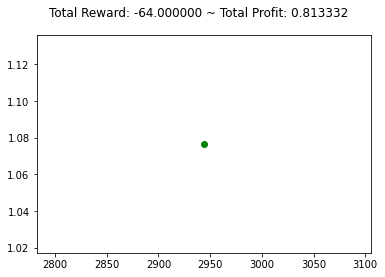

{'total_reward': -59.0000000000135, 'total_profit': 0.8133317166650138, 'position': 0}


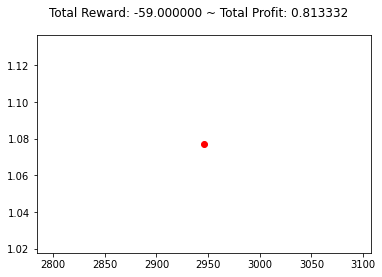

{'total_reward': -60.00000000001339, 'total_profit': 0.8130296716490766, 'position': 1}


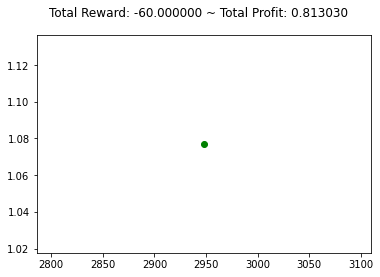

{'total_reward': -61.00000000001327, 'total_profit': 0.8130296716490766, 'position': 0}


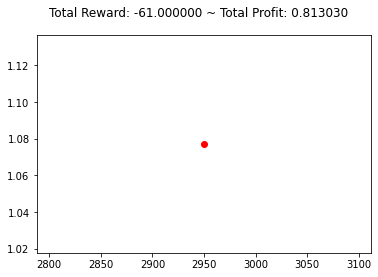

{'total_reward': -61.00000000001327, 'total_profit': 0.8130296716490766, 'position': 0}


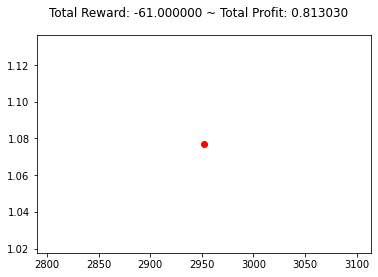

{'total_reward': -61.00000000001327, 'total_profit': 0.81280320098845, 'position': 1}


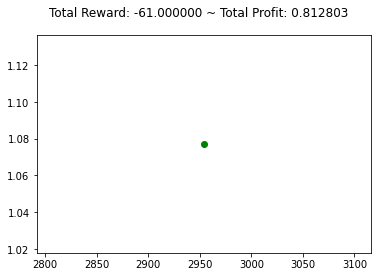

{'total_reward': -61.00000000001327, 'total_profit': 0.81280320098845, 'position': 1}


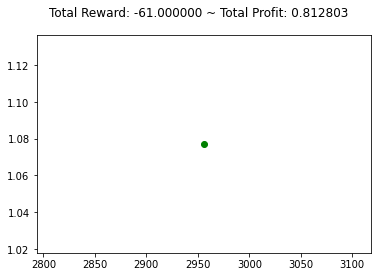

{'total_reward': -61.00000000001327, 'total_profit': 0.81280320098845, 'position': 1}


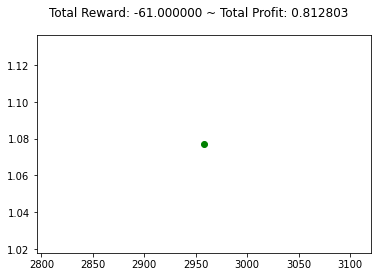

{'total_reward': -63.00000000001305, 'total_profit': 0.8124259250875085, 'position': 1}


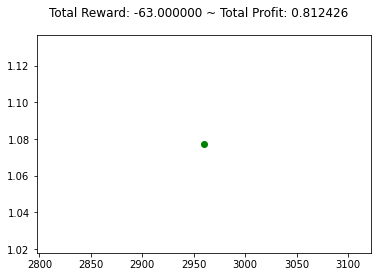

{'total_reward': -66.00000000001272, 'total_profit': 0.8124259250875085, 'position': 0}


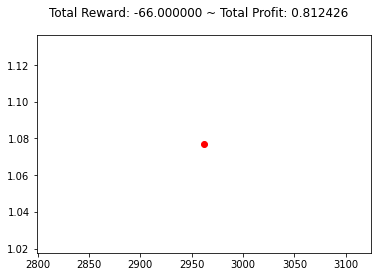

{'total_reward': -68.0000000000125, 'total_profit': 0.8120487892945982, 'position': 1}


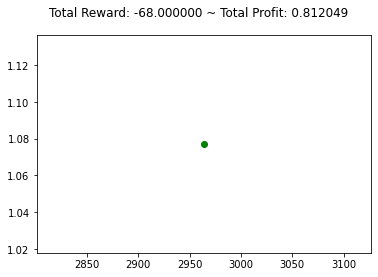

{'total_reward': -69.00000000001239, 'total_profit': 0.8120487892945982, 'position': 0}


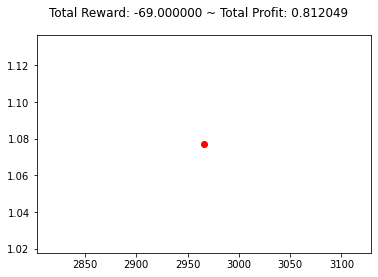

{'total_reward': -69.00000000001239, 'total_profit': 0.8120487892945982, 'position': 0}


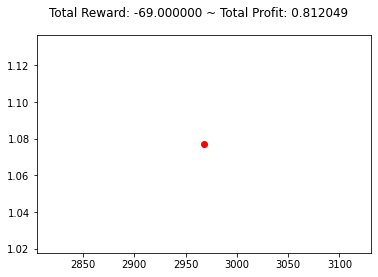

{'total_reward': -69.00000000001239, 'total_profit': 0.8118225918602543, 'position': 0}


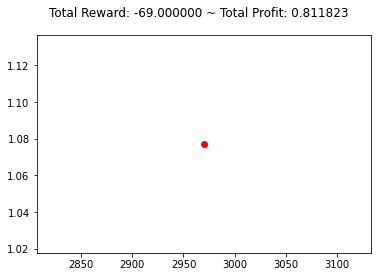

{'total_reward': -68.0000000000125, 'total_profit': 0.8116718215766885, 'position': 1}


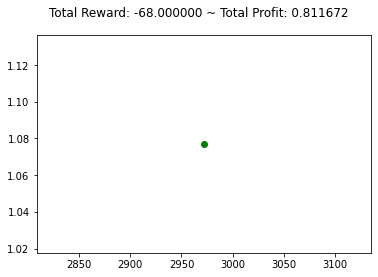

{'total_reward': -68.0000000000125, 'total_profit': 0.8116718215766885, 'position': 0}


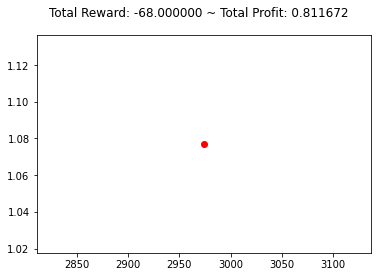

{'total_reward': -69.00000000001239, 'total_profit': 0.8113703650041438, 'position': 0}


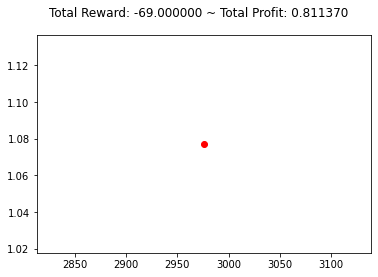

{'total_reward': -70.00000000001228, 'total_profit': 0.8110690483705892, 'position': 1}


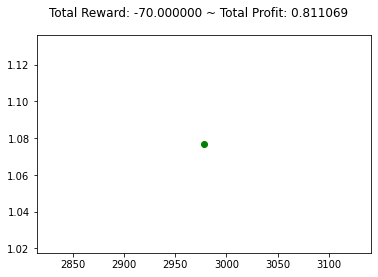

{'total_reward': -72.00000000001205, 'total_profit': 0.8108431028654253, 'position': 1}


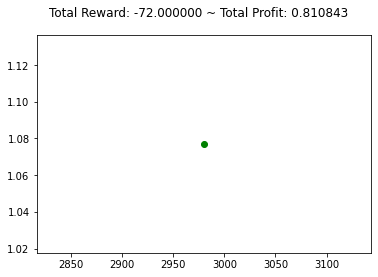

{'total_reward': -71.00000000001216, 'total_profit': 0.8106172412768834, 'position': 1}


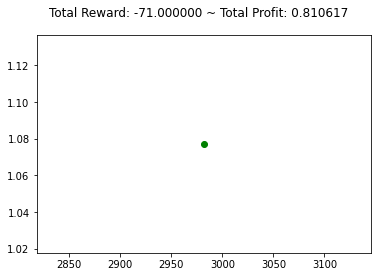

{'total_reward': -71.00000000001216, 'total_profit': 0.8103914426024331, 'position': 1}


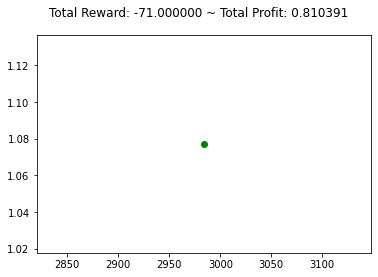

{'total_reward': -71.00000000001216, 'total_profit': 0.8103914426024331, 'position': 0}


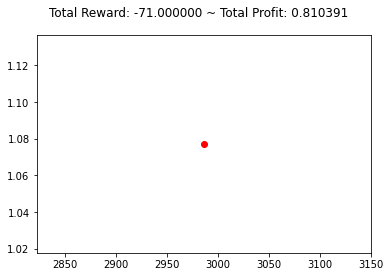

{'total_reward': -69.00000000001239, 'total_profit': 0.8101657068245494, 'position': 0}


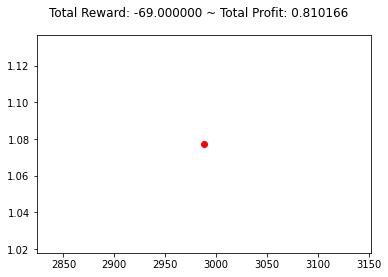

{'total_reward': -67.00000000001262, 'total_profit': 0.8100904825249371, 'position': 1}


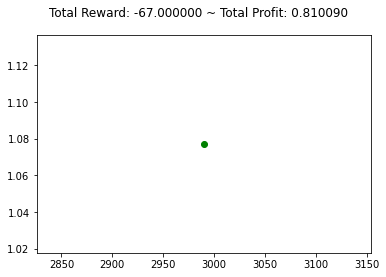

{'total_reward': -67.00000000001262, 'total_profit': 0.8100904825249371, 'position': 1}


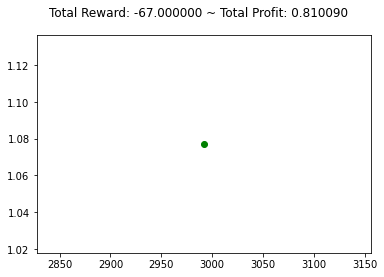

{'total_reward': -67.00000000001262, 'total_profit': 0.8100904825249371, 'position': 1}


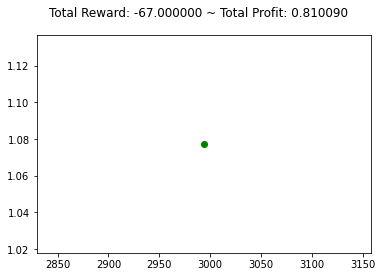

{'total_reward': -67.00000000001262, 'total_profit': 0.8100904825249371, 'position': 0}


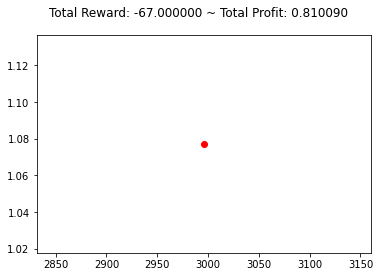

{'total_reward': -67.00000000001262, 'total_profit': 0.8098648305799441, 'position': 0}


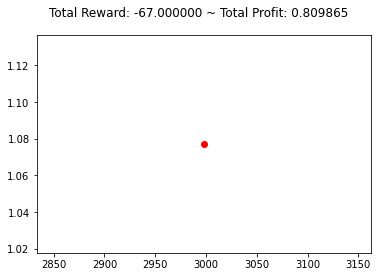

{'total_reward': -67.00000000001262, 'total_profit': 0.809639241490646, 'position': 0}


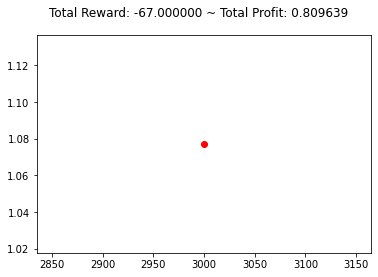

{'total_reward': -67.00000000001262, 'total_profit': 0.809639241490646, 'position': 0}


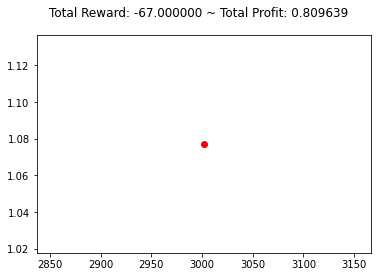

{'total_reward': -69.00000000001239, 'total_profit': 0.8092634341932591, 'position': 1}


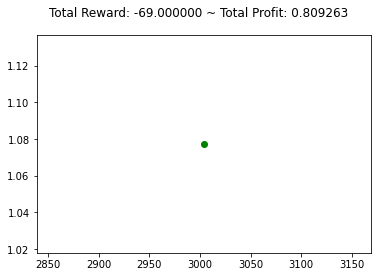

{'total_reward': -70.00000000001228, 'total_profit': 0.8092634341932591, 'position': 0}


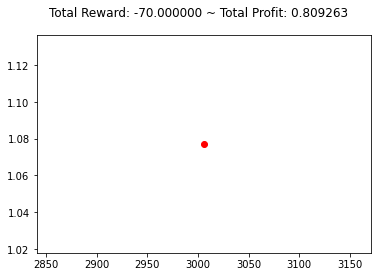

{'total_reward': -70.00000000001228, 'total_profit': 0.8090380335524106, 'position': 1}


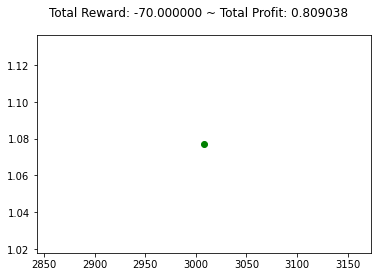

{'total_reward': -64.00000000001071, 'total_profit': 0.8090380335524106, 'position': 0}


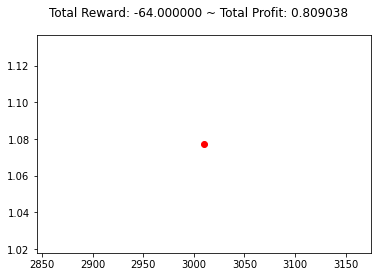

{'total_reward': -64.00000000001071, 'total_profit': 0.8090380335524106, 'position': 0}


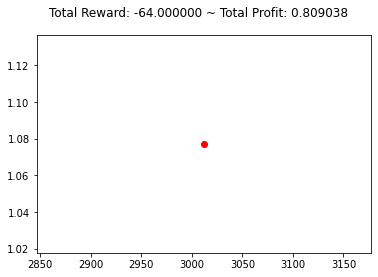

{'total_reward': -57.000000000009265, 'total_profit': 0.8093385119307032, 'position': 1}


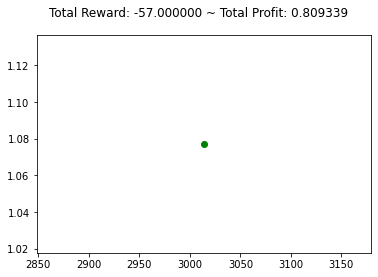

{'total_reward': -56.00000000000938, 'total_profit': 0.8093385119307032, 'position': 0}


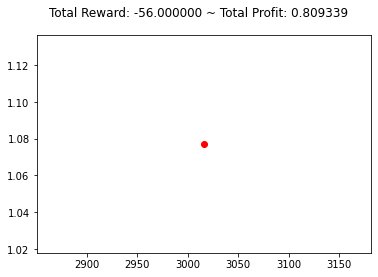

{'total_reward': -56.00000000000938, 'total_profit': 0.8091130903787775, 'position': 1}


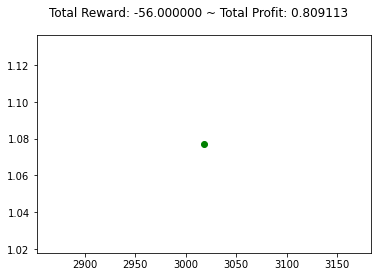

{'total_reward': -56.00000000000938, 'total_profit': 0.8091130903787775, 'position': 0}


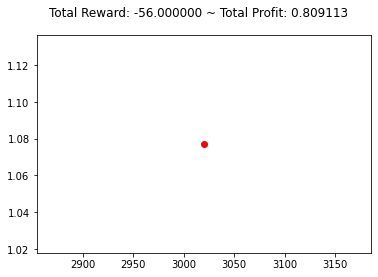

{'total_reward': -55.00000000000949, 'total_profit': 0.808962837251502, 'position': 0}


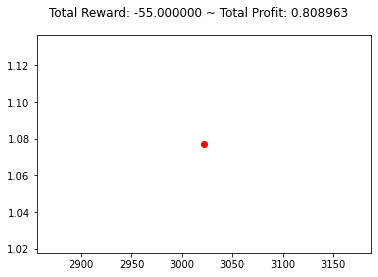

{'total_reward': -55.00000000000949, 'total_profit': 0.808962837251502, 'position': 0}


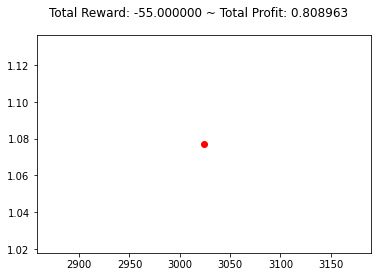

{'total_reward': -56.00000000000938, 'total_profit': 0.808662414695657, 'position': 0}


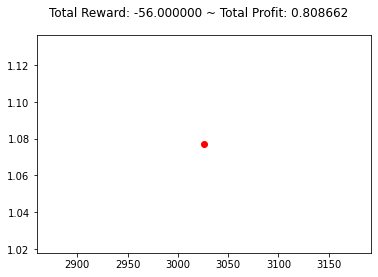

{'total_reward': -57.000000000009265, 'total_profit': 0.8083621315858556, 'position': 1}


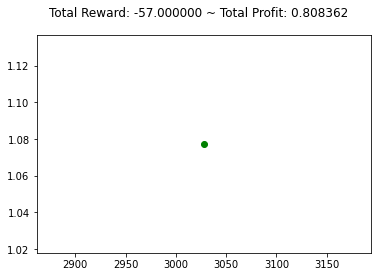

{'total_reward': -55.000000000009486, 'total_profit': 0.8083621315858556, 'position': 0}


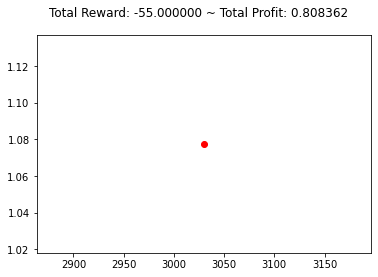

{'total_reward': -53.000000000009706, 'total_profit': 0.8082870886846686, 'position': 1}


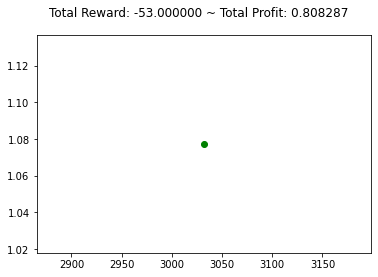

{'total_reward': -54.00000000000959, 'total_profit': 0.8082870886846686, 'position': 0}


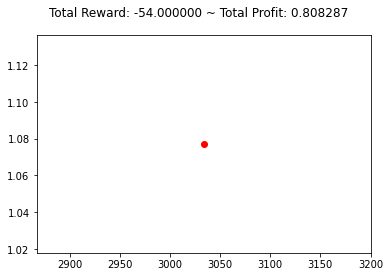

{'total_reward': -54.00000000000959, 'total_profit': 0.8080619599811077, 'position': 0}


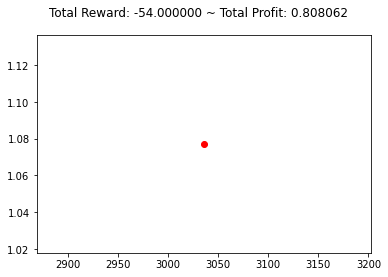

{'total_reward': -55.00000000000948, 'total_profit': 0.8077618998400082, 'position': 0}


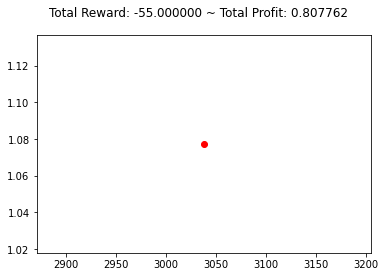

{'total_reward': -53.0000000000097, 'total_profit': 0.8075369383008771, 'position': 0}


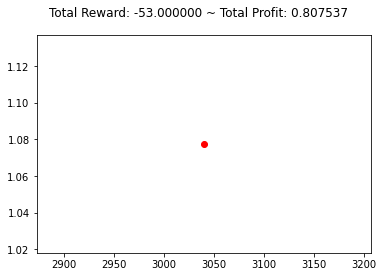

{'total_reward': -53.0000000000097, 'total_profit': 0.8075369383008771, 'position': 0}


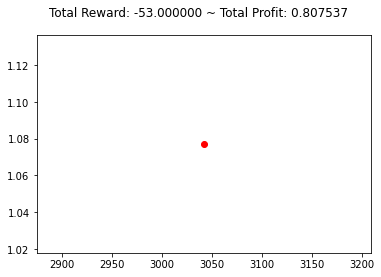

{'total_reward': -53.0000000000097, 'total_profit': 0.8075369383008771, 'position': 0}


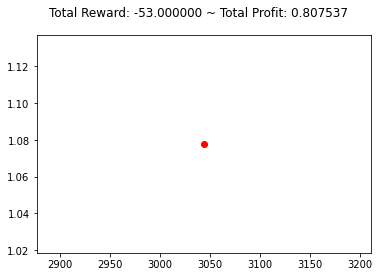

{'total_reward': -53.0000000000097, 'total_profit': 0.8075369383008771, 'position': 0}


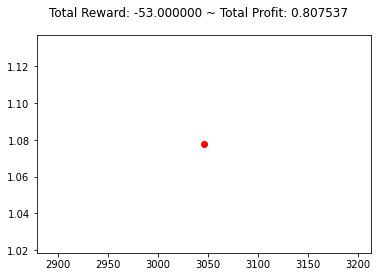

{'total_reward': -56.00000000001159, 'total_profit': 0.8070873492102391, 'position': 1}


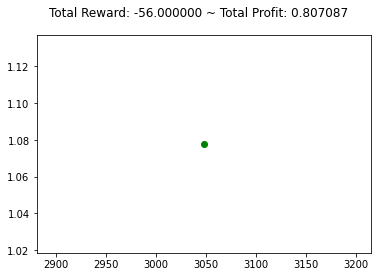

{'total_reward': -54.00000000001181, 'total_profit': 0.8070873492102391, 'position': 0}


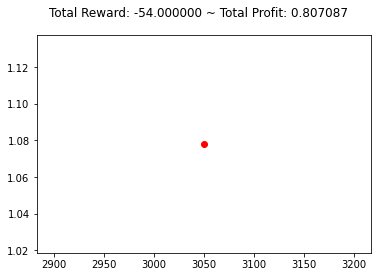

{'total_reward': -51.00000000000992, 'total_profit': 0.8070873492102392, 'position': 1}


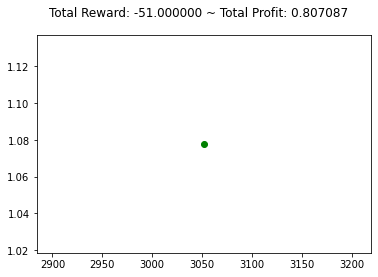

{'total_reward': -51.00000000000992, 'total_profit': 0.8070873492102392, 'position': 1}


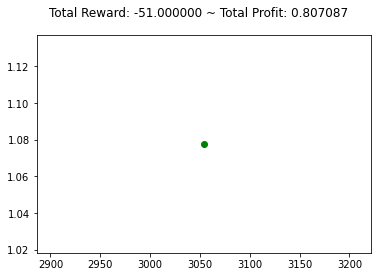

{'total_reward': -44.00000000000625, 'total_profit': 0.8071622529085419, 'position': 1}


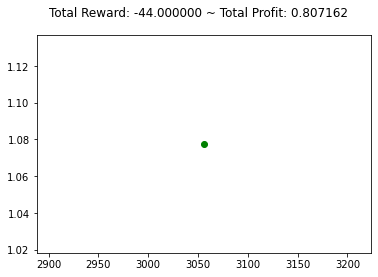

{'total_reward': -43.00000000000637, 'total_profit': 0.8071622529085419, 'position': 0}


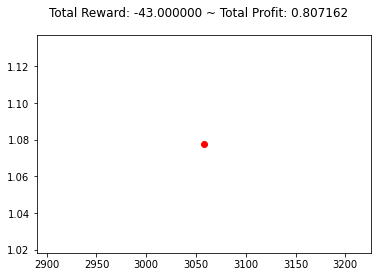

{'total_reward': -42.00000000000648, 'total_profit': 0.8070124316086982, 'position': 1}


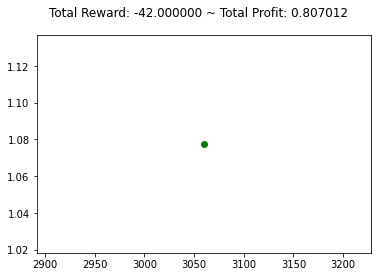

{'total_reward': -42.00000000000648, 'total_profit': 0.8070124316086982, 'position': 1}


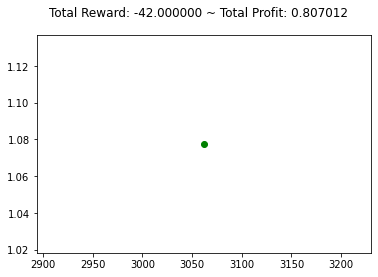

{'total_reward': -46.00000000000604, 'total_profit': 0.8067876579298544, 'position': 1}


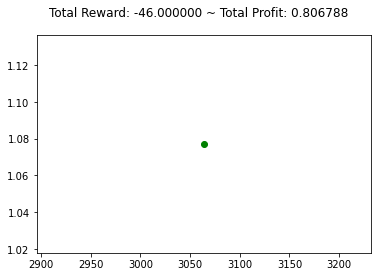

{'total_reward': -48.00000000000581, 'total_profit': 0.806488043165049, 'position': 1}


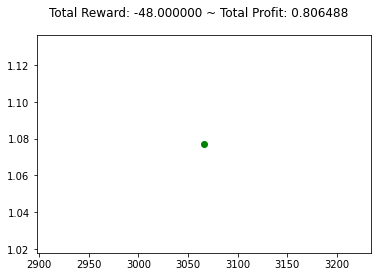

{'total_reward': -49.0000000000057, 'total_profit': 0.8061885674713375, 'position': 1}


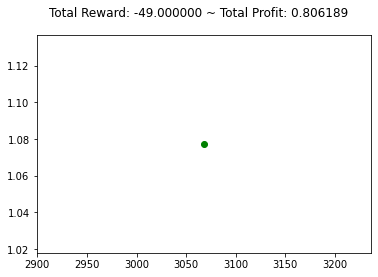

{'total_reward': -49.0000000000057, 'total_profit': 0.8061885674713375, 'position': 0}


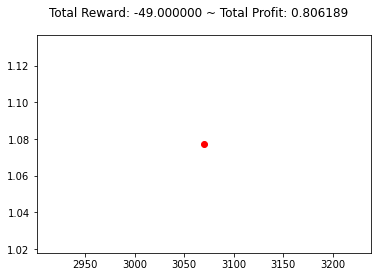

{'total_reward': -47.00000000000592, 'total_profit': 0.8059640441049789, 'position': 0}


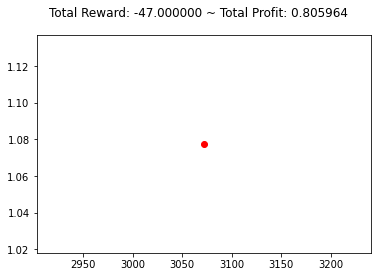

{'total_reward': -45.00000000000614, 'total_profit': 0.8058892238260981, 'position': 1}


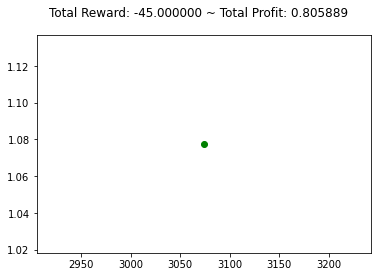

{'total_reward': -45.00000000000614, 'total_profit': 0.8058892238260981, 'position': 0}


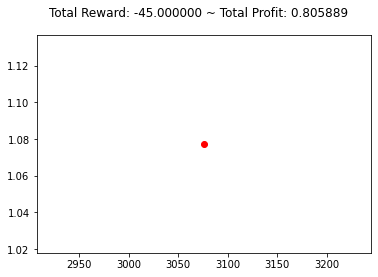

{'total_reward': -45.00000000000614, 'total_profit': 0.8056647838268892, 'position': 1}


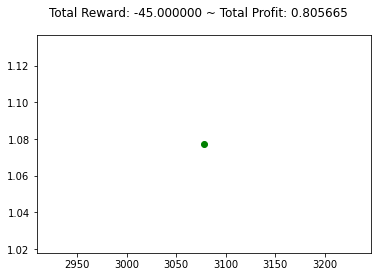

{'total_reward': -43.00000000000636, 'total_profit': 0.8056647838268892, 'position': 0}


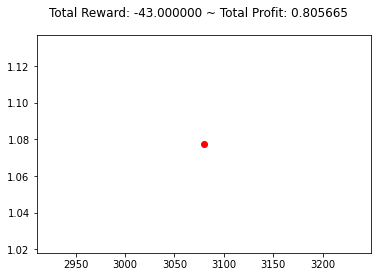

{'total_reward': -41.00000000000658, 'total_profit': 0.805589991329319, 'position': 1}


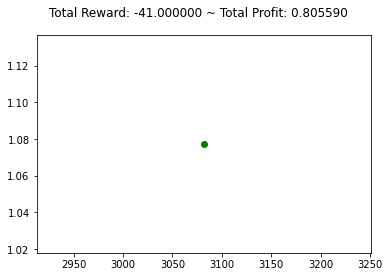

{'total_reward': -41.00000000000658, 'total_profit': 0.805589991329319, 'position': 1}


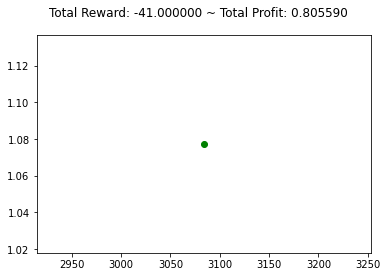

{'total_reward': -39.0000000000068, 'total_profit': 0.8053656763140983, 'position': 1}


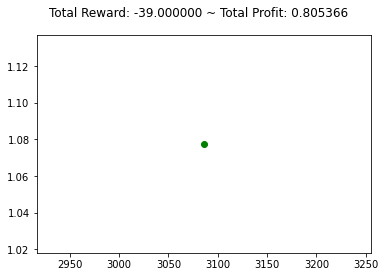

{'total_reward': -39.0000000000068, 'total_profit': 0.8053656763140983, 'position': 1}


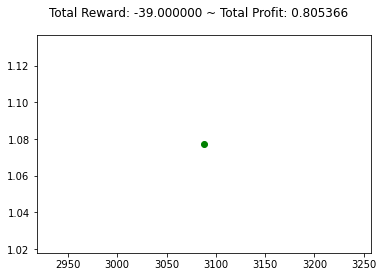

{'total_reward': -45.00000000000614, 'total_profit': 0.8048425174671979, 'position': 1}


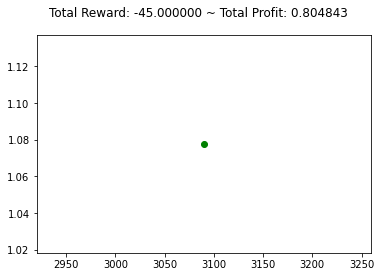

{'total_reward': -49.0000000000057, 'total_profit': 0.8048425174671979, 'position': 0}


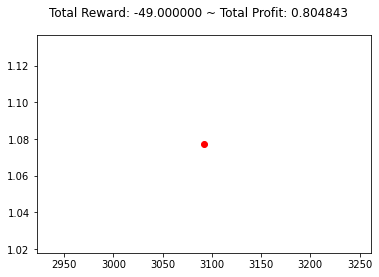

{'total_reward': -48.00000000000581, 'total_profit': 0.80469307126583, 'position': 1}


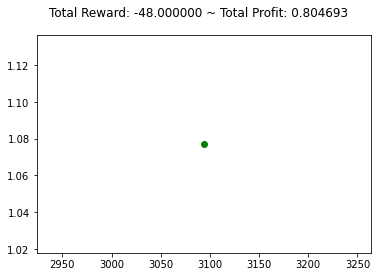

{'total_reward': -48.00000000000581, 'total_profit': 0.80469307126583, 'position': 1}


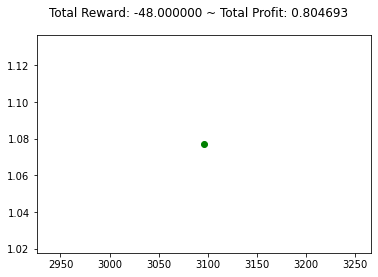

{'total_reward': -48.00000000000581, 'total_profit': 0.80469307126583, 'position': 0}


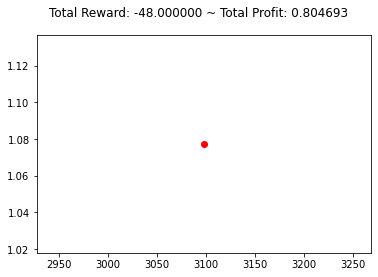

{'total_reward': -47.000000000005926, 'total_profit': 0.8044689435883815, 'position': 0}


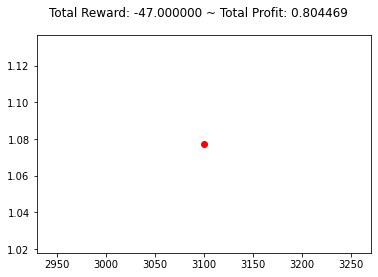

{'total_reward': -47.000000000005926, 'total_profit': 0.8043195667536236, 'position': 0}


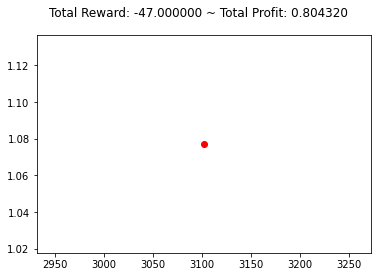

{'total_reward': -48.00000000000581, 'total_profit': 0.8040208685578187, 'position': 1}


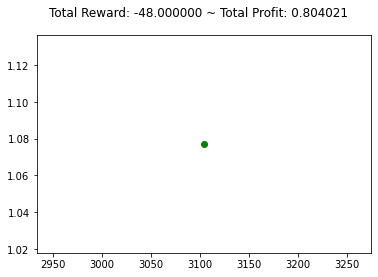

{'total_reward': -48.00000000000581, 'total_profit': 0.8040208685578187, 'position': 0}


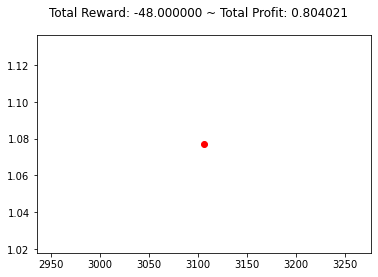

{'total_reward': -48.00000000000581, 'total_profit': 0.8037969281060804, 'position': 1}


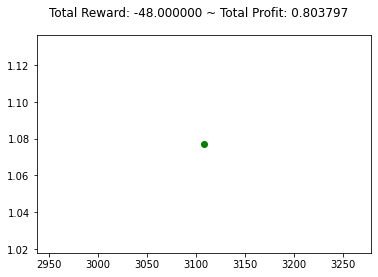

{'total_reward': -48.00000000000581, 'total_profit': 0.8037969281060804, 'position': 0}


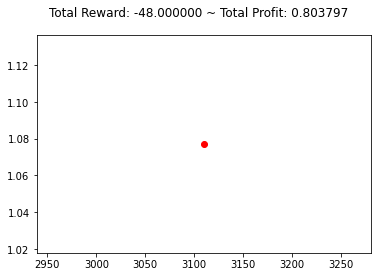

{'total_reward': -48.00000000000581, 'total_profit': 0.8037969281060804, 'position': 0}


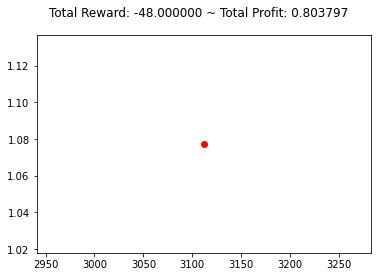

{'total_reward': -49.0000000000057, 'total_profit': 0.803498451712428, 'position': 0}


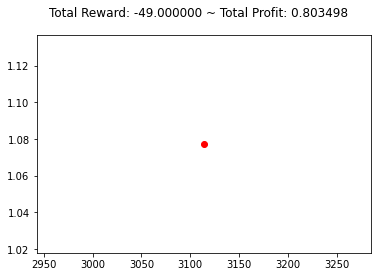

{'total_reward': -49.0000000000057, 'total_profit': 0.803498451712428, 'position': 0}


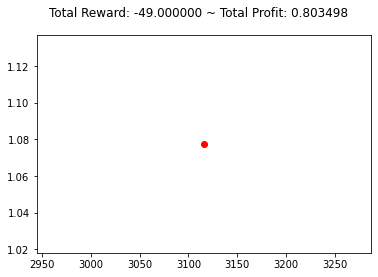

{'total_reward': -52.00000000000537, 'total_profit': 0.8030510279806159, 'position': 1}


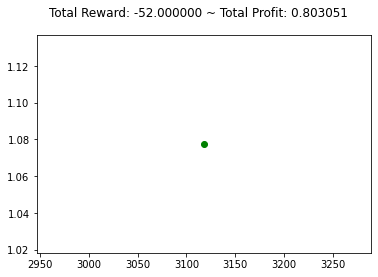

{'total_reward': -52.00000000000537, 'total_profit': 0.8028274406874426, 'position': 1}


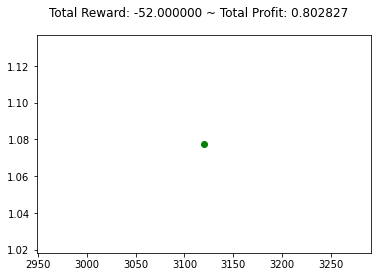

{'total_reward': -52.00000000000537, 'total_profit': 0.8028274406874426, 'position': 1}


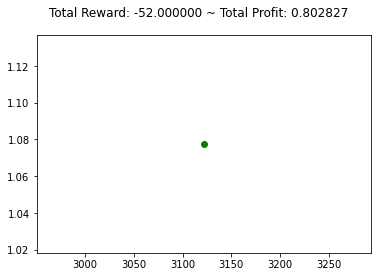

{'total_reward': -52.00000000000537, 'total_profit': 0.8028274406874426, 'position': 1}


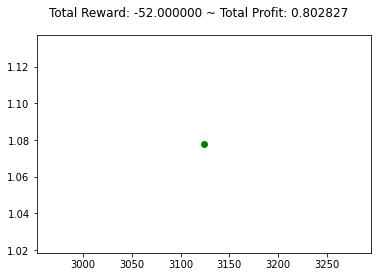

{'total_reward': -52.00000000000537, 'total_profit': 0.8028274406874426, 'position': 1}


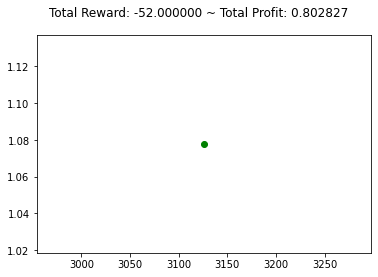

{'total_reward': -51.000000000005485, 'total_profit': 0.8026039363888103, 'position': 1}


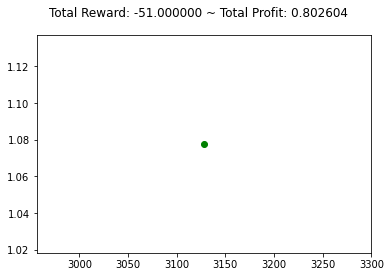

{'total_reward': -51.000000000005485, 'total_profit': 0.8026039363888103, 'position': 0}


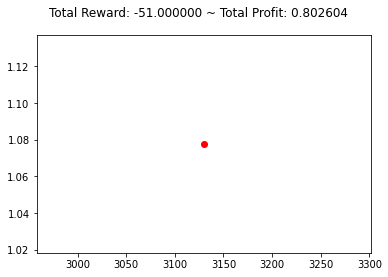

{'total_reward': -44.000000000004036, 'total_profit': 0.8024549611801999, 'position': 0}


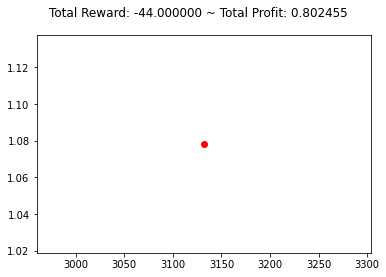

{'total_reward': -40.000000000004476, 'total_profit': 0.8025294211376258, 'position': 0}


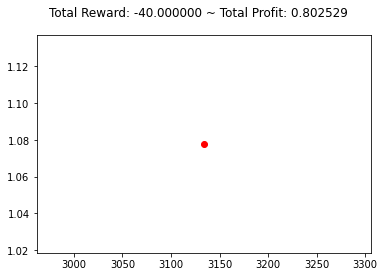

{'total_reward': -40.000000000004476, 'total_profit': 0.8023060205378845, 'position': 1}


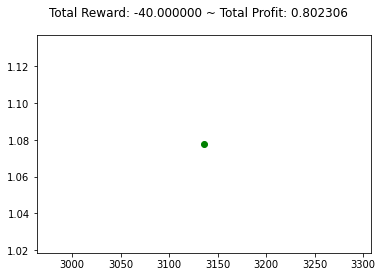

{'total_reward': -41.00000000000659, 'total_profit': 0.8023060205378845, 'position': 0}


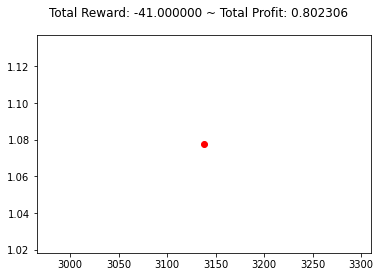

{'total_reward': -41.00000000000659, 'total_profit': 0.8023060205378845, 'position': 0}


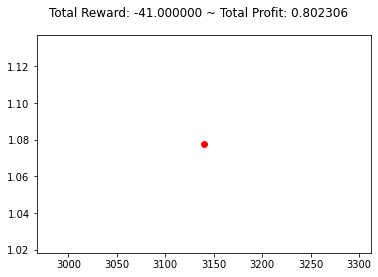

{'total_reward': -47.00000000000814, 'total_profit': 0.8016363160132284, 'position': 1}


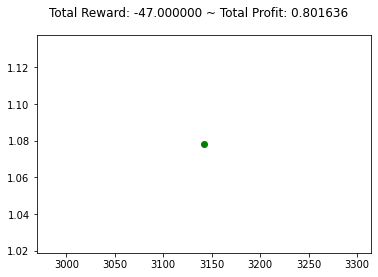

{'total_reward': -47.00000000000814, 'total_profit': 0.8016363160132284, 'position': 1}


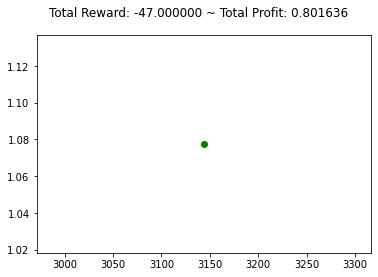

{'total_reward': -55.00000000000948, 'total_profit': 0.8016363160132284, 'position': 0}


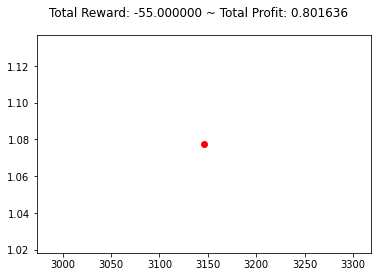

{'total_reward': -57.00000000000926, 'total_profit': 0.8012643615236158, 'position': 1}


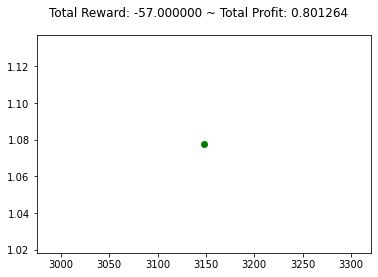

{'total_reward': -58.00000000000915, 'total_profit': 0.8012643615236158, 'position': 0}


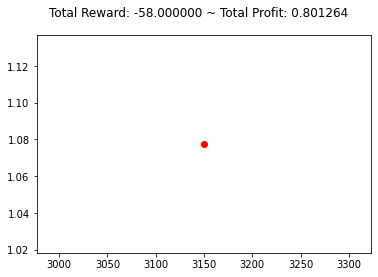

{'total_reward': -60.000000000008924, 'total_profit': 0.800966935999665, 'position': 0}


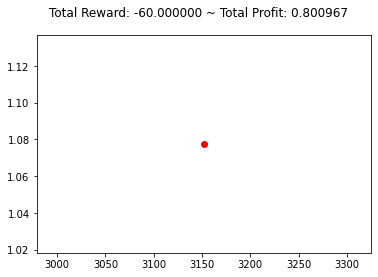

{'total_reward': -57.00000000000925, 'total_profit': 0.800966935999665, 'position': 1}


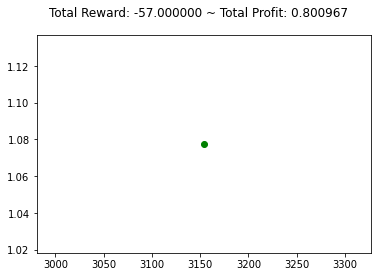

{'total_reward': -55.00000000000947, 'total_profit': 0.800966935999665, 'position': 0}


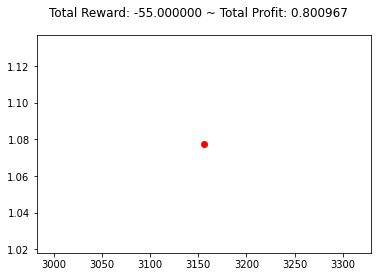

{'total_reward': -55.00000000000947, 'total_profit': 0.800966935999665, 'position': 0}


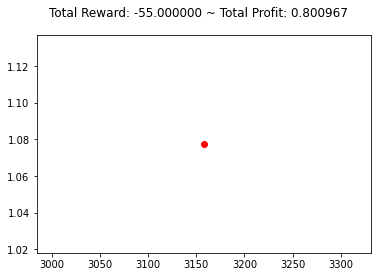

{'total_reward': -53.00000000000969, 'total_profit': 0.8008925796186772, 'position': 1}


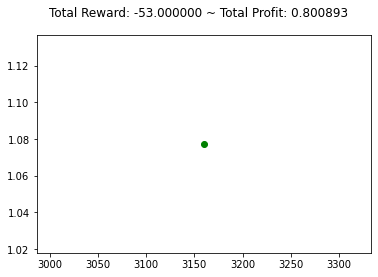

{'total_reward': -53.00000000000969, 'total_profit': 0.8008925796186772, 'position': 1}


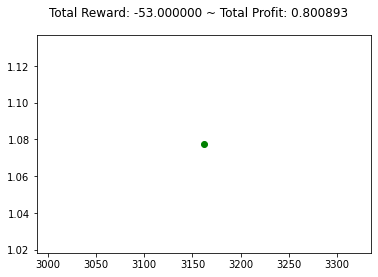

{'total_reward': -53.00000000000969, 'total_profit': 0.8006695311839523, 'position': 1}


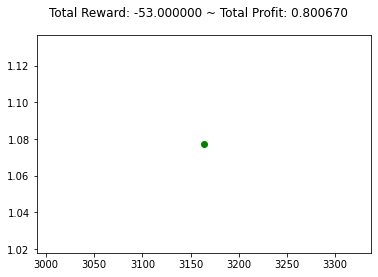

{'total_reward': -53.00000000000969, 'total_profit': 0.8006695311839523, 'position': 0}


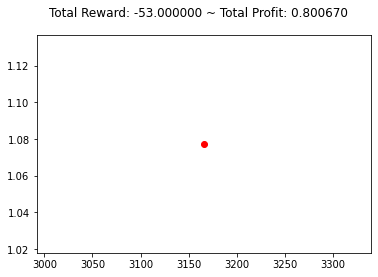

{'total_reward': -55.00000000000947, 'total_profit': 0.8002979563133454, 'position': 1}


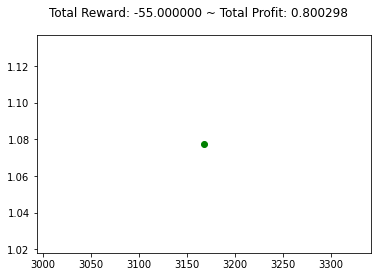

{'total_reward': -49.00000000001013, 'total_profit': 0.8003722505907603, 'position': 1}


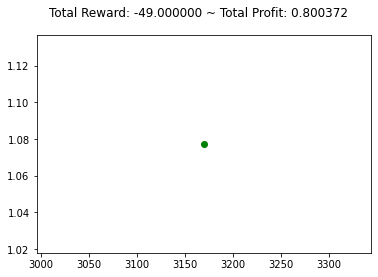

{'total_reward': -47.00000000001035, 'total_profit': 0.8003722505907603, 'position': 0}


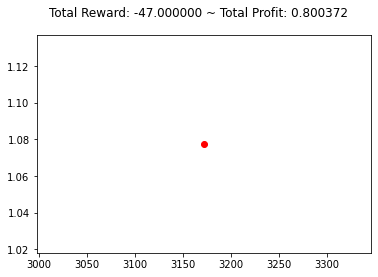

{'total_reward': -45.00000000001057, 'total_profit': 0.8002979494163646, 'position': 0}


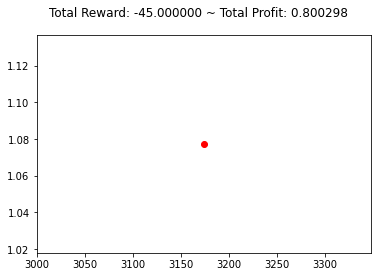

{'total_reward': -45.00000000001057, 'total_profit': 0.8000750665860407, 'position': 0}


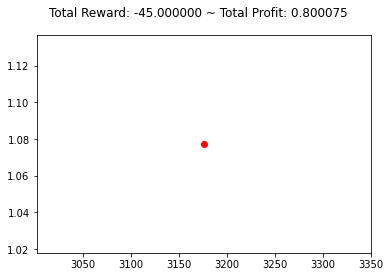

{'total_reward': -47.00000000001035, 'total_profit': 0.7997037675946791, 'position': 1}


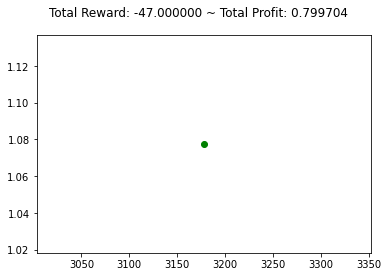

{'total_reward': -44.00000000001069, 'total_profit': 0.799555330700462, 'position': 1}


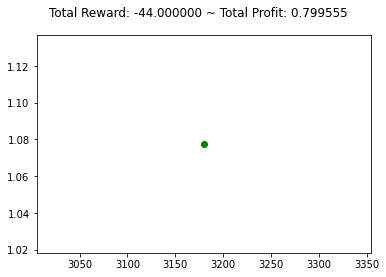

{'total_reward': -44.00000000001069, 'total_profit': 0.799555330700462, 'position': 1}


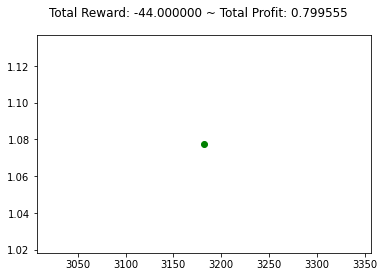

{'total_reward': -47.00000000001036, 'total_profit': 0.799555330700462, 'position': 0}


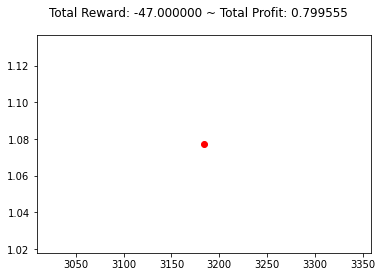

{'total_reward': -47.00000000001036, 'total_profit': 0.799555330700462, 'position': 0}


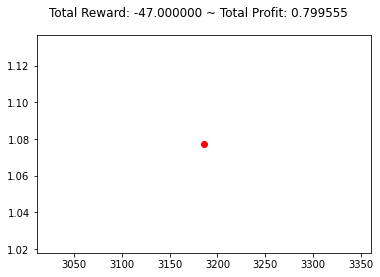

{'total_reward': -47.00000000001036, 'total_profit': 0.799555330700462, 'position': 0}


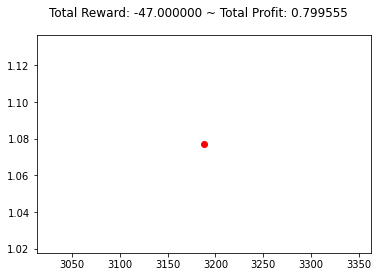

{'total_reward': -44.00000000001069, 'total_profit': 0.799555330700462, 'position': 1}


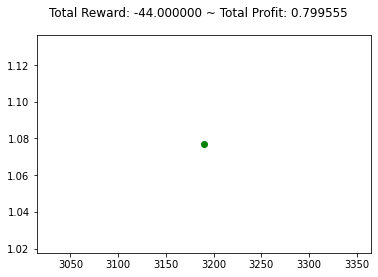

{'total_reward': -44.00000000001069, 'total_profit': 0.799555330700462, 'position': 0}


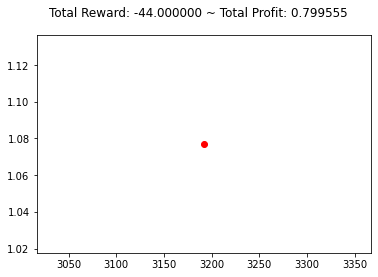

{'total_reward': -45.00000000001057, 'total_profit': 0.7992583742173792, 'position': 0}


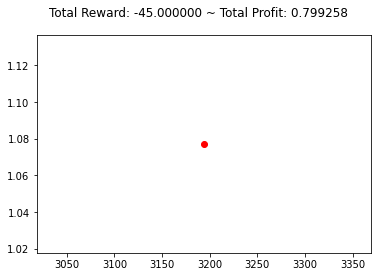

{'total_reward': -43.00000000001079, 'total_profit': 0.7990357395727504, 'position': 0}


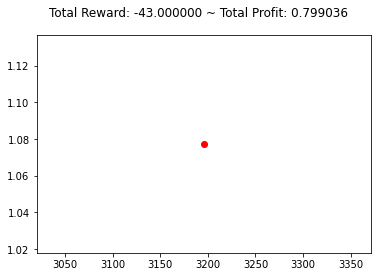

{'total_reward': -42.0000000000109, 'total_profit': 0.7988873715958545, 'position': 0}


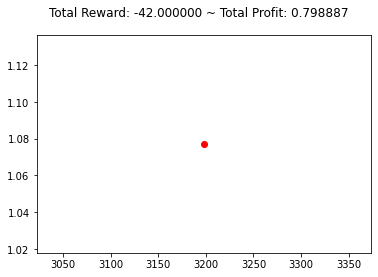

{'total_reward': -42.0000000000109, 'total_profit': 0.7988873715958545, 'position': 0}


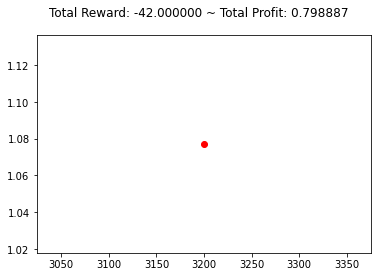

{'total_reward': -41.00000000001101, 'total_profit': 0.7987390173950011, 'position': 1}


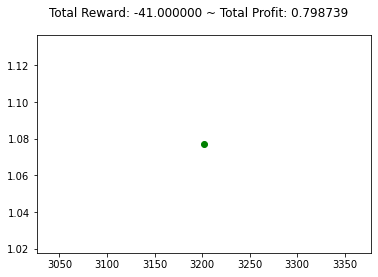

{'total_reward': -40.00000000001113, 'total_profit': 0.7987390173950011, 'position': 0}


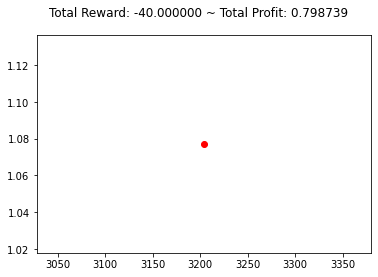

{'total_reward': -40.00000000001113, 'total_profit': 0.7985165480744009, 'position': 1}


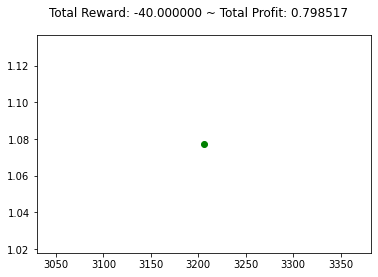

{'total_reward': -39.00000000001124, 'total_profit': 0.79829416136402, 'position': 1}


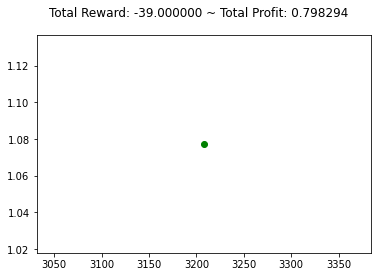

{'total_reward': -35.00000000001168, 'total_profit': 0.7982200531054455, 'position': 1}


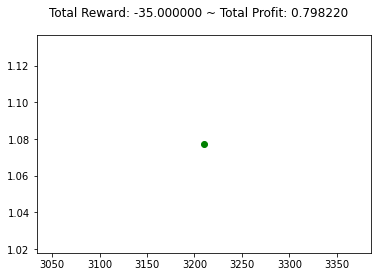

{'total_reward': -35.00000000001168, 'total_profit': 0.7979977489688584, 'position': 1}


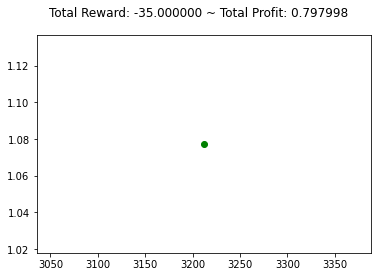

{'total_reward': -35.00000000001168, 'total_profit': 0.7979977489688584, 'position': 1}


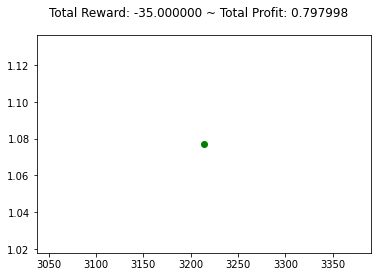

{'total_reward': -36.00000000001157, 'total_profit': 0.7979977489688584, 'position': 0}


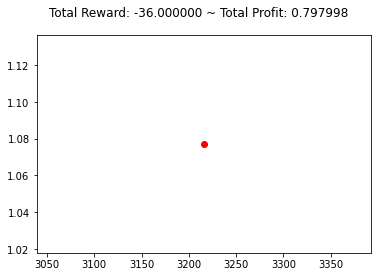

{'total_reward': -37.000000000011454, 'total_profit': 0.79770142600229, 'position': 1}


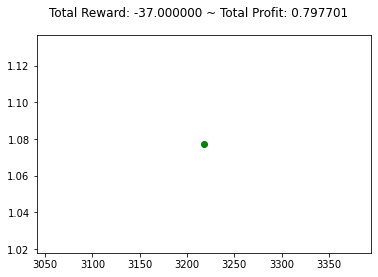

{'total_reward': -39.000000000011234, 'total_profit': 0.79770142600229, 'position': 0}


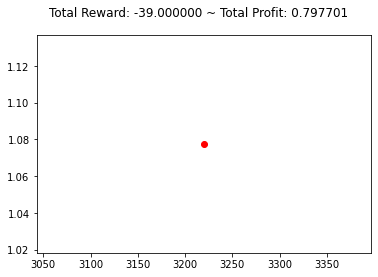

{'total_reward': -39.000000000011234, 'total_profit': 0.7974792250479719, 'position': 1}


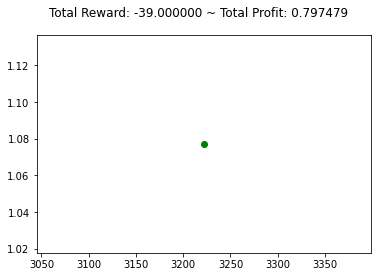

{'total_reward': -39.000000000011234, 'total_profit': 0.7974792250479719, 'position': 0}


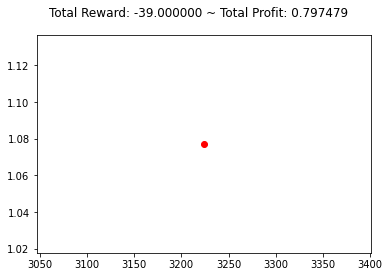

{'total_reward': -40.00000000001113, 'total_profit': 0.79725708598807, 'position': 0}


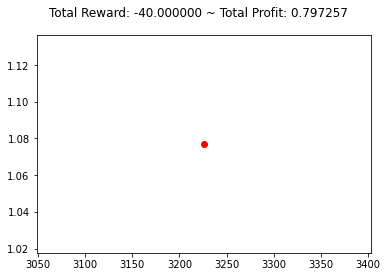

{'total_reward': -39.00000000001124, 'total_profit': 0.7971090070345062, 'position': 1}


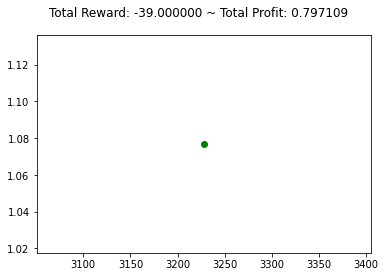

{'total_reward': -42.000000000010914, 'total_profit': 0.7971090070345062, 'position': 0}


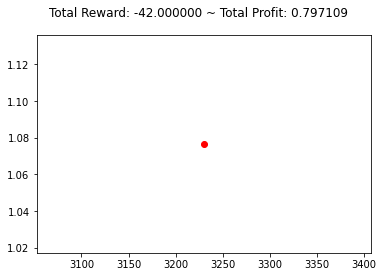

{'total_reward': -39.00000000001124, 'total_profit': 0.7968868679707716, 'position': 0}


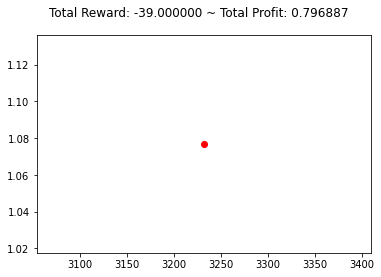

{'total_reward': -38.000000000011354, 'total_profit': 0.79673884403319, 'position': 1}


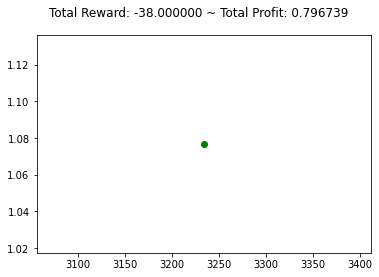

{'total_reward': -38.000000000011354, 'total_profit': 0.79673884403319, 'position': 1}


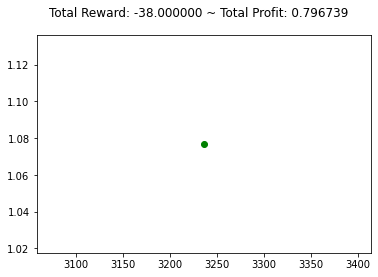

{'total_reward': -38.000000000011354, 'total_profit': 0.79673884403319, 'position': 0}


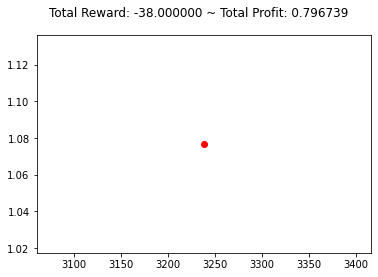

{'total_reward': -38.000000000011354, 'total_profit': 0.79673884403319, 'position': 0}


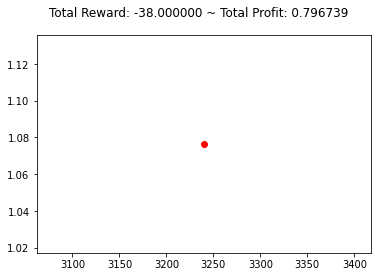

{'total_reward': -38.000000000011354, 'total_profit': 0.79673884403319, 'position': 0}


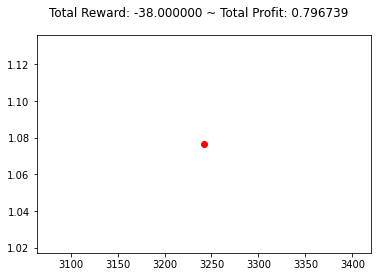

{'total_reward': -38.000000000011354, 'total_profit': 0.7965168493706006, 'position': 1}


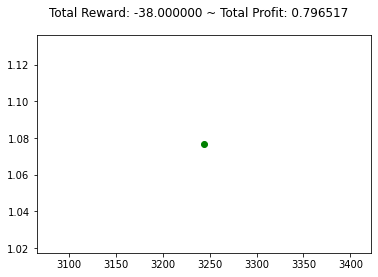

{'total_reward': -38.000000000011354, 'total_profit': 0.7965168493706006, 'position': 1}


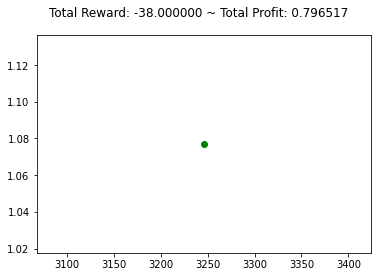

{'total_reward': -38.000000000011354, 'total_profit': 0.7965168493706006, 'position': 0}


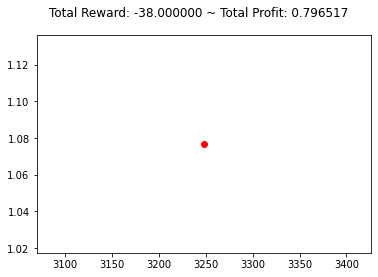

{'total_reward': -39.00000000001124, 'total_profit': 0.796220966439928, 'position': 1}


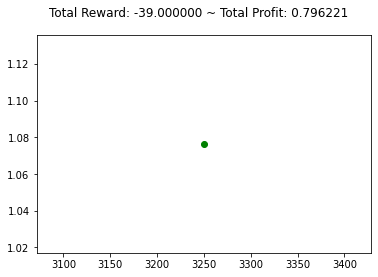

{'total_reward': -50.00000000001003, 'total_profit': 0.796220966439928, 'position': 0}


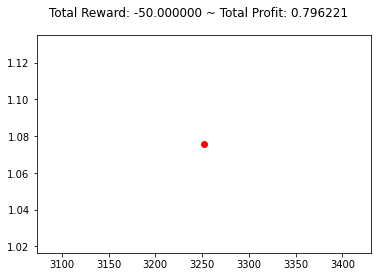

{'total_reward': -50.00000000001003, 'total_profit': 0.7959989098349899, 'position': 1}


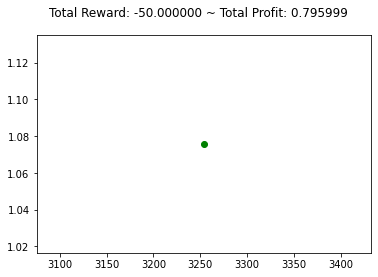

{'total_reward': -43.0000000000108, 'total_profit': 0.7959989098349899, 'position': 0}


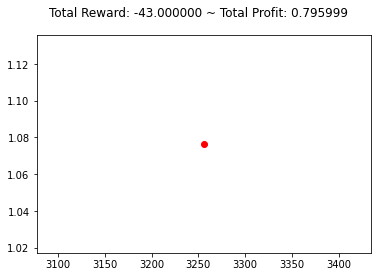

{'total_reward': -43.0000000000108, 'total_profit': 0.7959989098349899, 'position': 0}


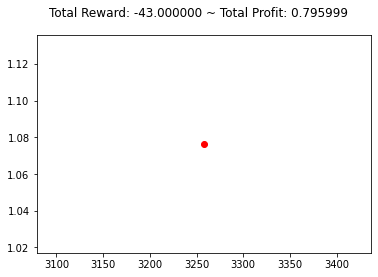

{'total_reward': -42.000000000010914, 'total_profit': 0.7958509958872365, 'position': 1}


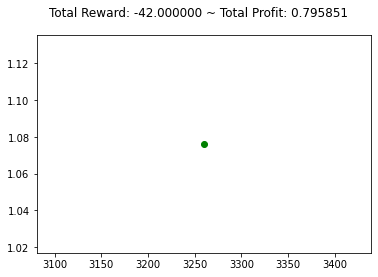

{'total_reward': -44.00000000001069, 'total_profit': 0.7955552229630007, 'position': 1}


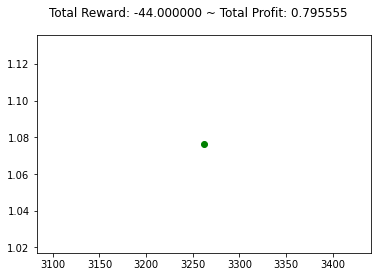

{'total_reward': -44.00000000001069, 'total_profit': 0.7955552229630007, 'position': 0}


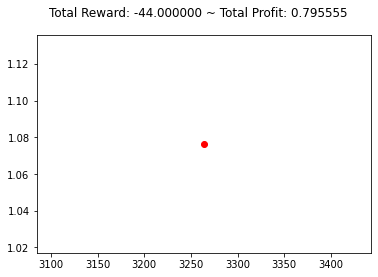

{'total_reward': -45.00000000001057, 'total_profit': 0.7953334757114083, 'position': 0}


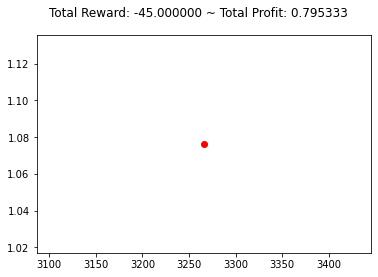

{'total_reward': -44.00000000001069, 'total_profit': 0.7951856579480571, 'position': 1}


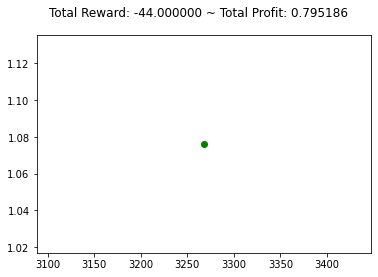

{'total_reward': -43.0000000000108, 'total_profit': 0.7948901597474075, 'position': 1}


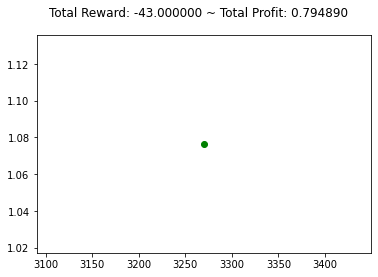

{'total_reward': -40.00000000001113, 'total_profit': 0.7948901597474075, 'position': 0}


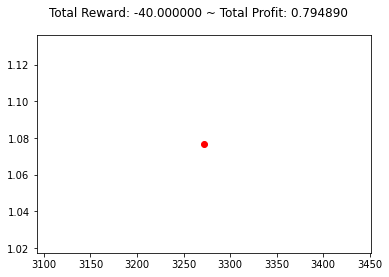

{'total_reward': -40.00000000001113, 'total_profit': 0.7948901597474075, 'position': 0}


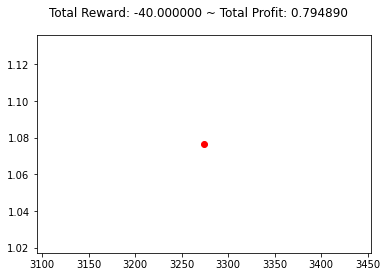

{'total_reward': -38.00000000001135, 'total_profit': 0.7946686801821394, 'position': 0}


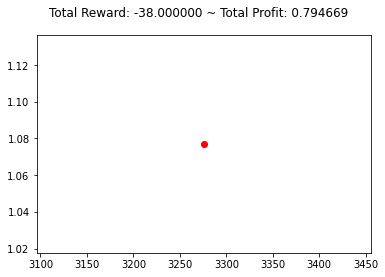

{'total_reward': -36.00000000001157, 'total_profit': 0.7945948742306039, 'position': 1}


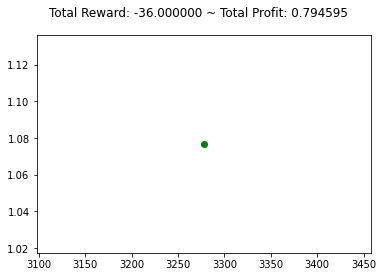

{'total_reward': -36.00000000001157, 'total_profit': 0.7945948742306039, 'position': 1}


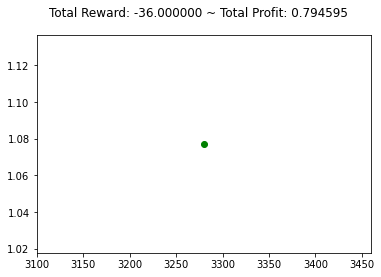

{'total_reward': -36.00000000001157, 'total_profit': 0.7945948742306039, 'position': 1}


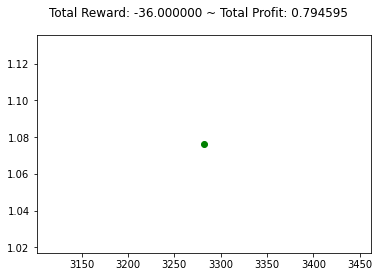

{'total_reward': -36.00000000001157, 'total_profit': 0.7945948742306039, 'position': 1}


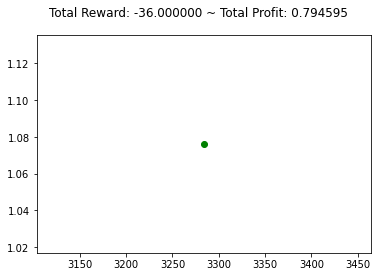

{'total_reward': -36.00000000001157, 'total_profit': 0.7945948742306039, 'position': 1}


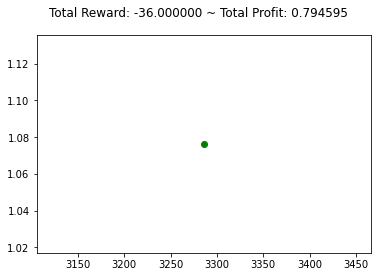

{'total_reward': -39.00000000001124, 'total_profit': 0.7945948742306039, 'position': 0}


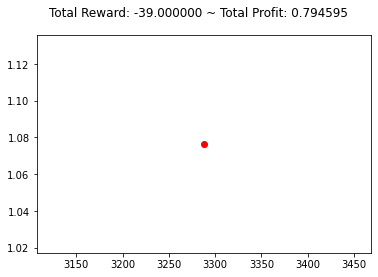

{'total_reward': -39.00000000001124, 'total_profit': 0.7945948742306039, 'position': 0}


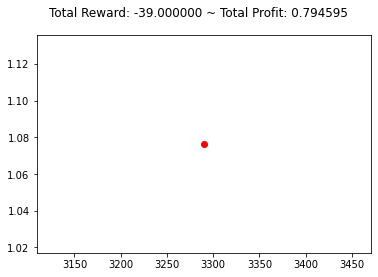

{'total_reward': -33.0000000000119, 'total_profit': 0.7948164567387552, 'position': 1}


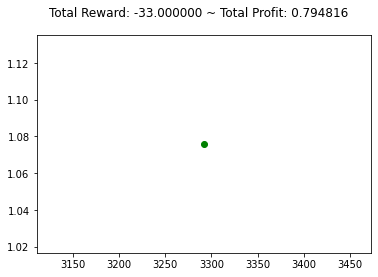

{'total_reward': -35.0000000000139, 'total_profit': 0.7948164567387552, 'position': 0}


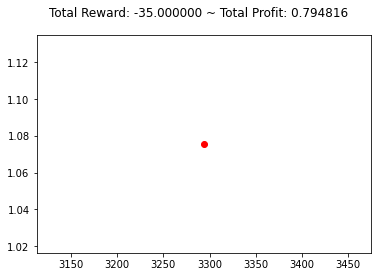

{'total_reward': -36.00000000001379, 'total_profit': 0.7946686526556798, 'position': 0}


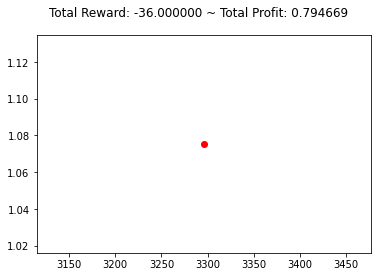

{'total_reward': -30.000000000014452, 'total_profit': 0.7948904825577889, 'position': 1}


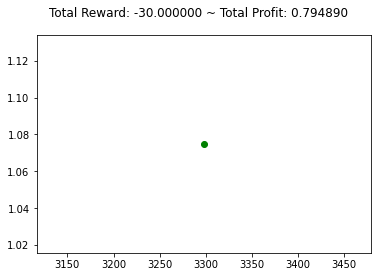

{'total_reward': -30.000000000014452, 'total_profit': 0.7948904825577889, 'position': 1}


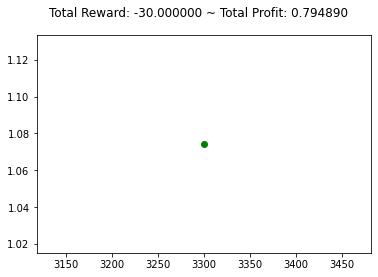

{'total_reward': -37.000000000013685, 'total_profit': 0.7944466576094038, 'position': 1}


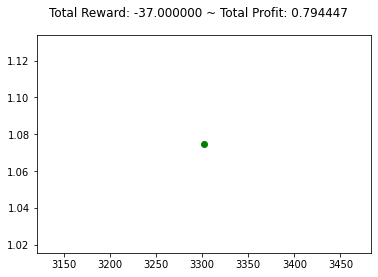

{'total_reward': -36.0000000000138, 'total_profit': 0.7944466576094038, 'position': 0}


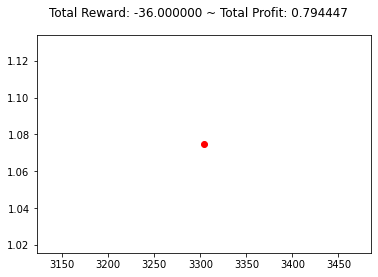

{'total_reward': -38.00000000001358, 'total_profit': 0.7940771131598693, 'position': 1}


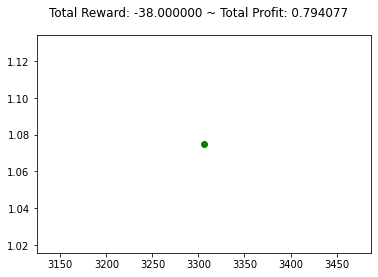

{'total_reward': -38.00000000001357, 'total_profit': 0.7940771131598693, 'position': 1}


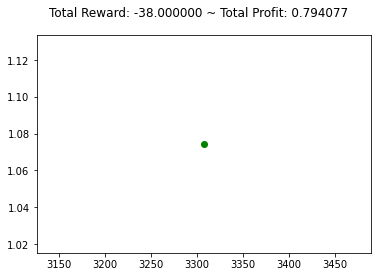

{'total_reward': -48.000000000014694, 'total_profit': 0.7940771131598693, 'position': 0}


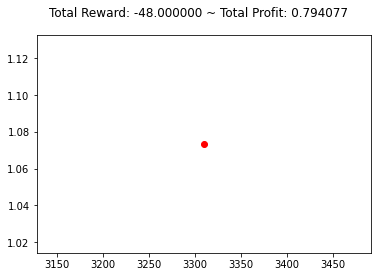

{'total_reward': -48.000000000014694, 'total_profit': 0.7940771131598693, 'position': 0}


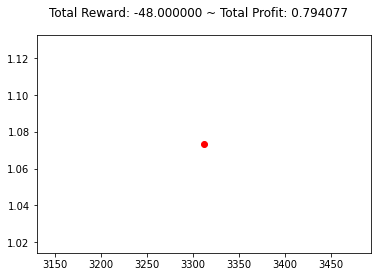

{'total_reward': -48.000000000014694, 'total_profit': 0.7938551592476846, 'position': 1}


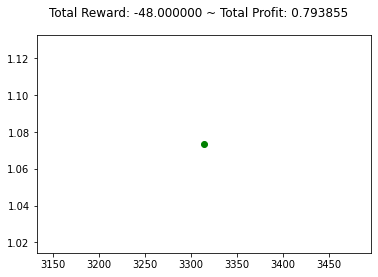

{'total_reward': -48.000000000014694, 'total_profit': 0.7938551592476846, 'position': 0}


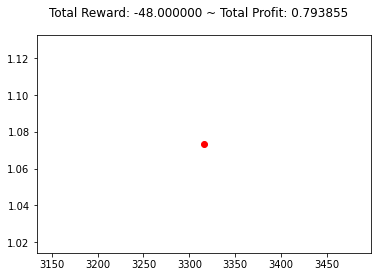

{'total_reward': -44.00000000001292, 'total_profit': 0.7936332673742341, 'position': 0}


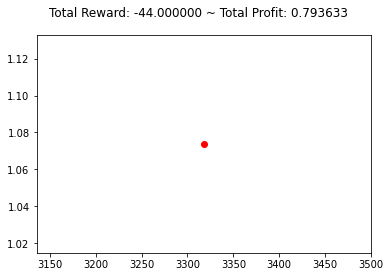

{'total_reward': -45.000000000012804, 'total_profit': 0.7933376319607962, 'position': 1}


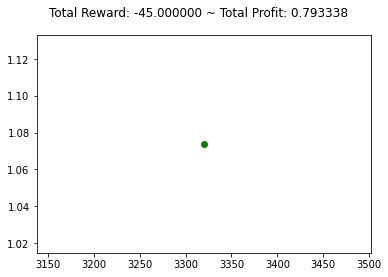

{'total_reward': -45.000000000012804, 'total_profit': 0.7933376319607962, 'position': 1}


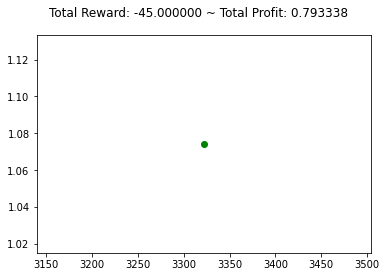

{'total_reward': -45.000000000012804, 'total_profit': 0.7933376319607962, 'position': 1}


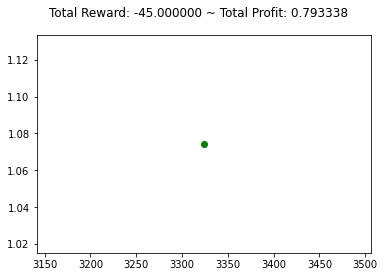

{'total_reward': -46.00000000001269, 'total_profit': 0.7933376319607962, 'position': 0}


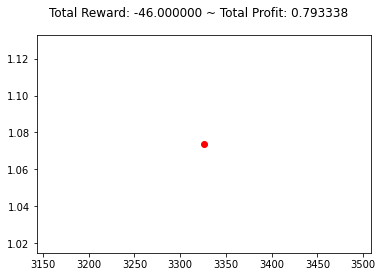

{'total_reward': -49.00000000001236, 'total_profit': 0.7928944265798126, 'position': 1}


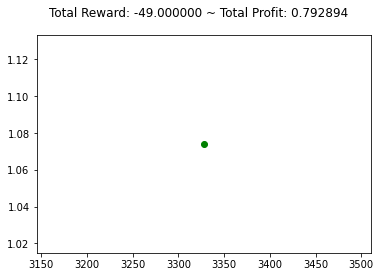

{'total_reward': -52.00000000001204, 'total_profit': 0.7928944265798126, 'position': 0}


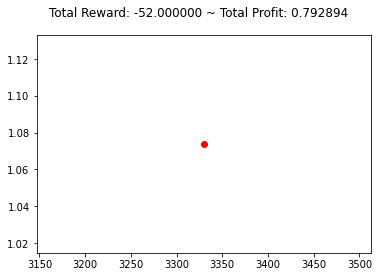

{'total_reward': -56.000000000011596, 'total_profit': 0.7923776906161166, 'position': 1}


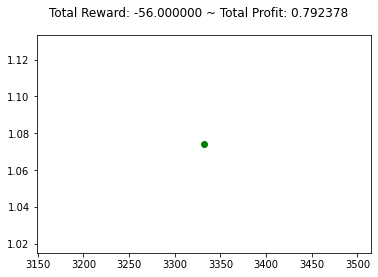

{'total_reward': -56.000000000011596, 'total_profit': 0.7923776906161166, 'position': 1}


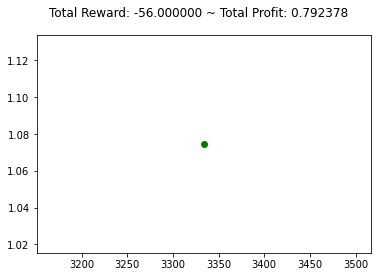

{'total_reward': -56.000000000011596, 'total_profit': 0.7923776906161166, 'position': 1}


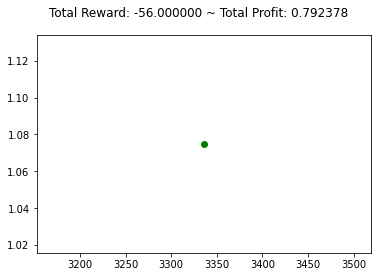

{'total_reward': -46.0000000000127, 'total_profit': 0.7924514481969243, 'position': 1}


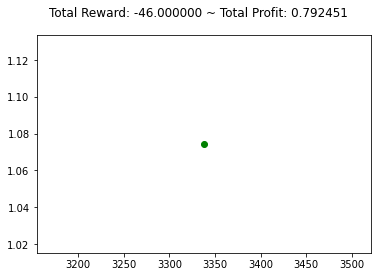

{'total_reward': -41.000000000013245, 'total_profit': 0.7924514481969243, 'position': 0}


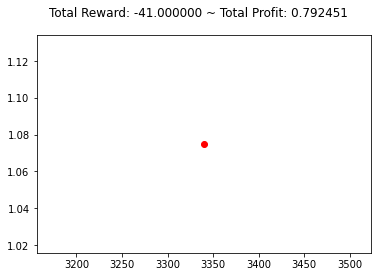

{'total_reward': -40.00000000001336, 'total_profit': 0.7923039742138226, 'position': 1}


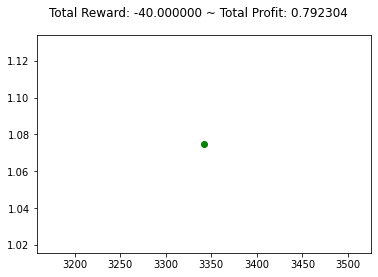

{'total_reward': -40.00000000001336, 'total_profit': 0.7923039742138226, 'position': 0}


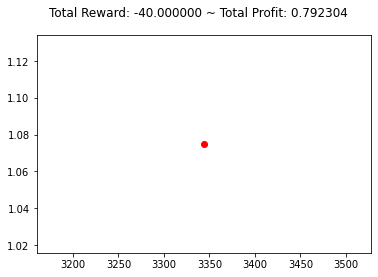

{'total_reward': -43.00000000001303, 'total_profit': 0.7918617580421684, 'position': 1}


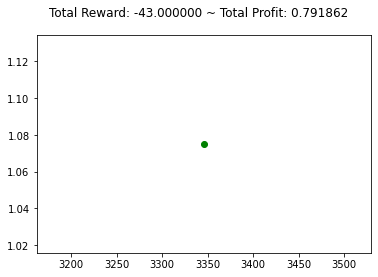

{'total_reward': -45.00000000001281, 'total_profit': 0.7918617580421684, 'position': 0}


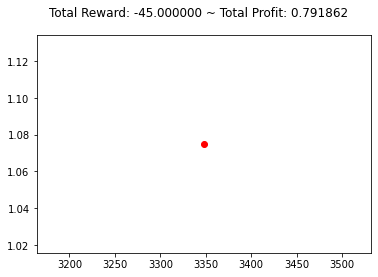

{'total_reward': -45.00000000001281, 'total_profit': 0.7918617580421684, 'position': 0}


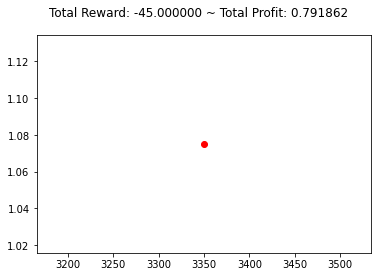

{'total_reward': -45.00000000001281, 'total_profit': 0.7918617580421684, 'position': 0}


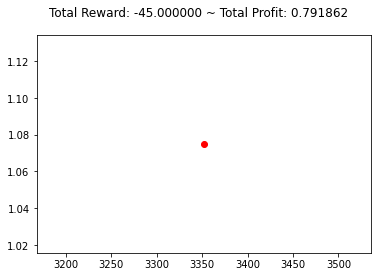

{'total_reward': -46.000000000012705, 'total_profit': 0.7915670843951158, 'position': 1}


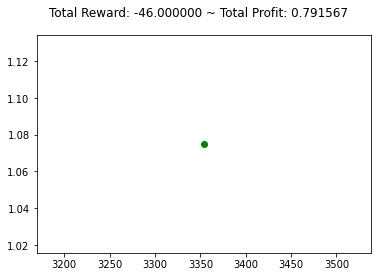

{'total_reward': -42.000000000013145, 'total_profit': 0.7915670843951158, 'position': 0}


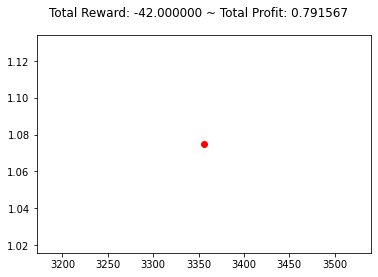

{'total_reward': -34.000000000014026, 'total_profit': 0.7919354264539316, 'position': 1}


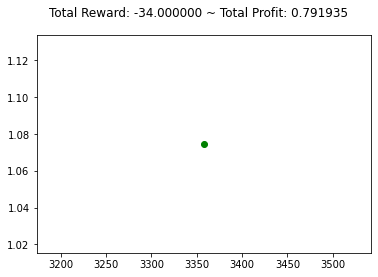

{'total_reward': -37.0000000000137, 'total_profit': 0.7919354264539316, 'position': 0}


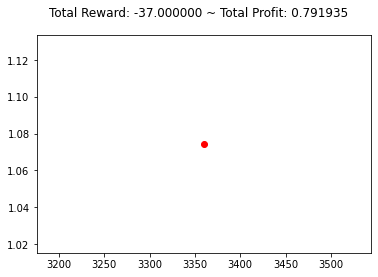

{'total_reward': -37.0000000000137, 'total_profit': 0.7919354264539316, 'position': 0}


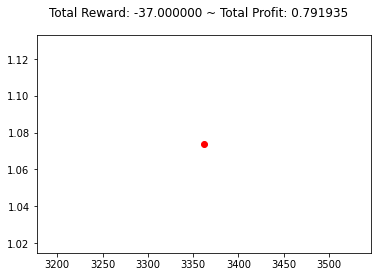

{'total_reward': -37.0000000000137, 'total_profit': 0.7919354264539316, 'position': 0}


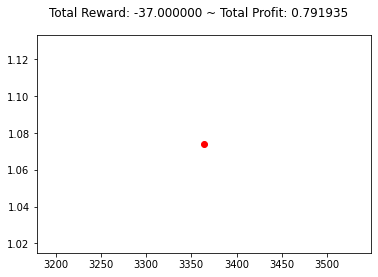

{'total_reward': -34.000000000014026, 'total_profit': 0.7919354264539316, 'position': 1}


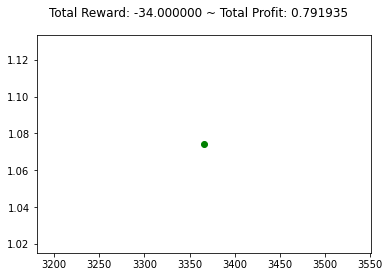

{'total_reward': -32.000000000014246, 'total_profit': 0.7919354264539316, 'position': 0}


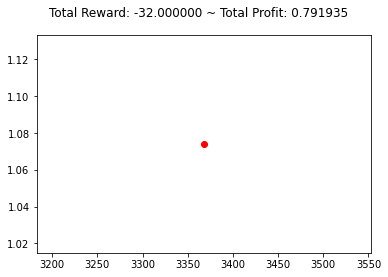

{'total_reward': -21.000000000015458, 'total_profit': 0.7917142360359666, 'position': 0}


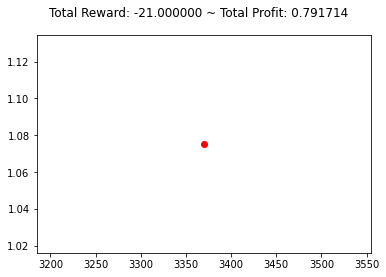

{'total_reward': -21.000000000015458, 'total_profit': 0.7917142360359666, 'position': 0}


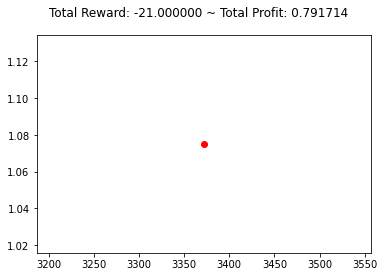

{'total_reward': -23.000000000015238, 'total_profit': 0.7914933336263583, 'position': 0}


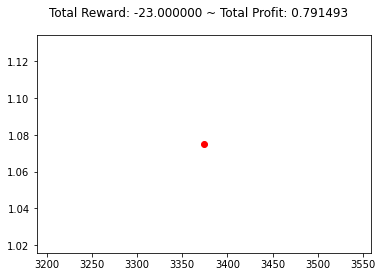

{'total_reward': -26.000000000014907, 'total_profit': 0.7910516931537686, 'position': 1}


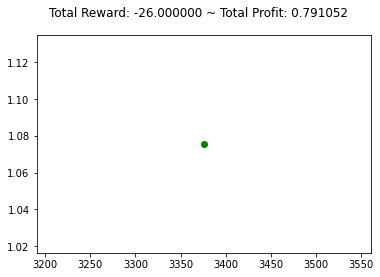

{'total_reward': -21.000000000015458, 'total_profit': 0.7911252793577829, 'position': 1}


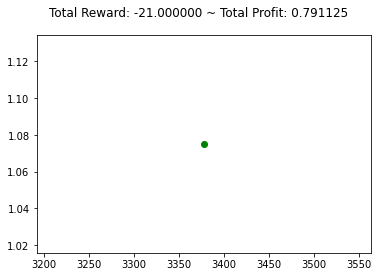

{'total_reward': -16.00000000001601, 'total_profit': 0.7911252793577829, 'position': 1}


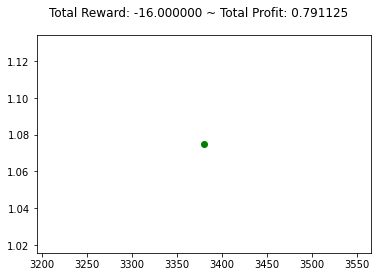

{'total_reward': -16.00000000001601, 'total_profit': 0.7911252793577829, 'position': 1}


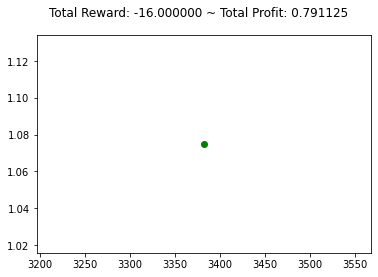

{'total_reward': -13.000000000016339, 'total_profit': 0.7911252793577829, 'position': 0}


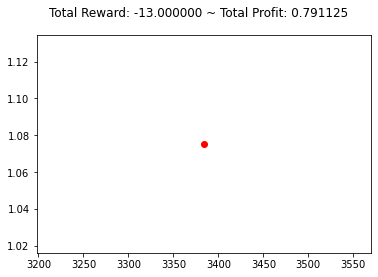

{'total_reward': -13.000000000016339, 'total_profit': 0.790904541277605, 'position': 0}


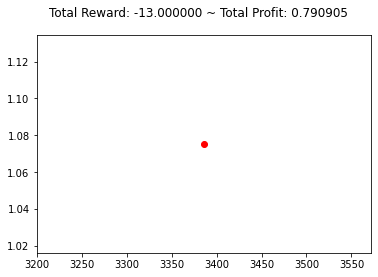

{'total_reward': -11.00000000001656, 'total_profit': 0.7906838647872931, 'position': 0}


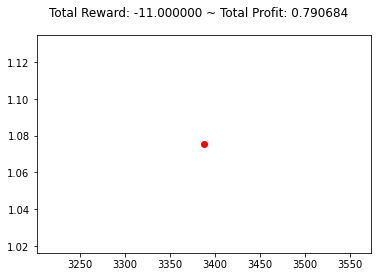

{'total_reward': -9.00000000001678, 'total_profit': 0.7905368018532678, 'position': 0}


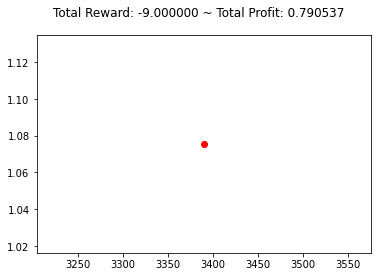

{'total_reward': -13.00000000001856, 'total_profit': 0.7900224165016249, 'position': 1}


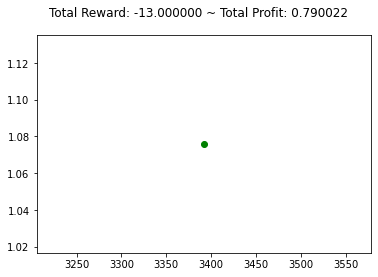

{'total_reward': -14.00000000002067, 'total_profit': 0.789875503918361, 'position': 1}


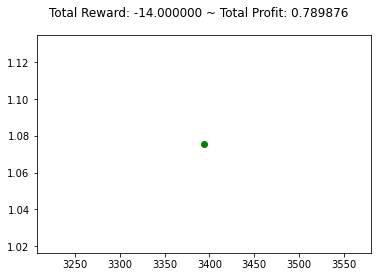

{'total_reward': -13.00000000002078, 'total_profit': 0.789875503918361, 'position': 0}


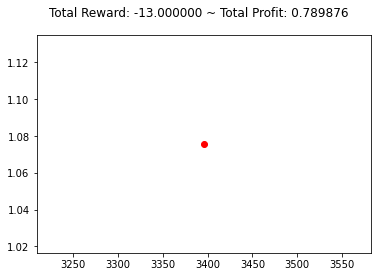

{'total_reward': -13.00000000002078, 'total_profit': 0.789875503918361, 'position': 0}


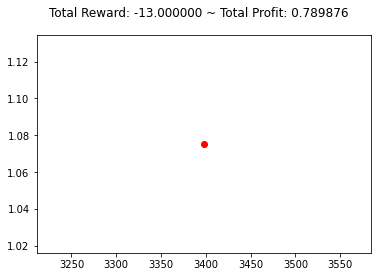

{'total_reward': -13.00000000002078, 'total_profit': 0.789875503918361, 'position': 0}


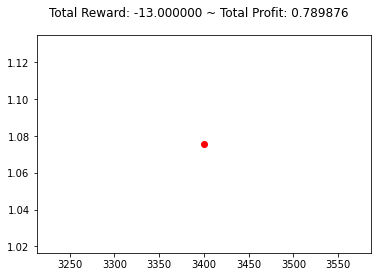

{'total_reward': -14.00000000002289, 'total_profit': 0.7895817880109821, 'position': 1}


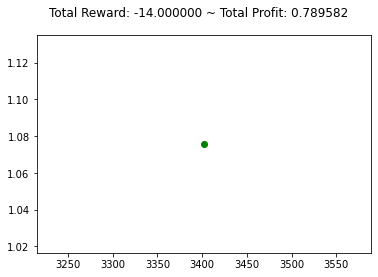

{'total_reward': -13.00000000002078, 'total_profit': 0.789434971018046, 'position': 1}


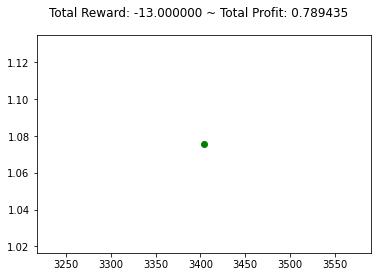

{'total_reward': -11.00000000001878, 'total_profit': 0.789434971018046, 'position': 0}


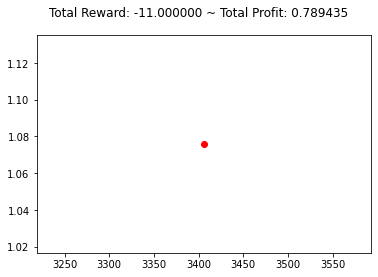

{'total_reward': -8.00000000001467, 'total_profit': 0.7893615761713544, 'position': 0}


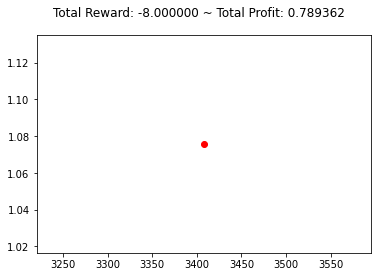

{'total_reward': -5.000000000015, 'total_profit': 0.7891414325691871, 'position': 0}


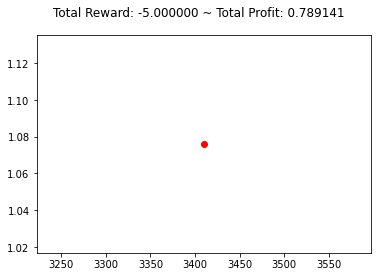

{'total_reward': -5.000000000015, 'total_profit': 0.7891414325691871, 'position': 0}


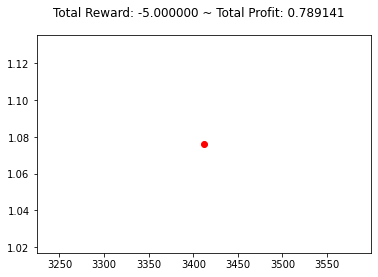

{'total_reward': -7.000000000014779, 'total_profit': 0.7887747993074472, 'position': 1}


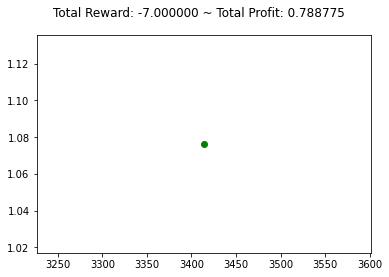

{'total_reward': -7.000000000014779, 'total_profit': 0.7887747993074472, 'position': 1}


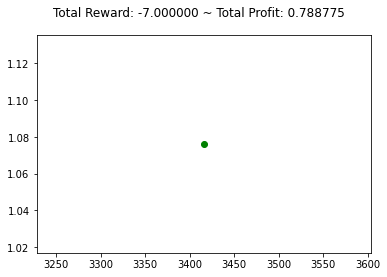

{'total_reward': -10.000000000012228, 'total_profit': 0.7887014590192738, 'position': 1}


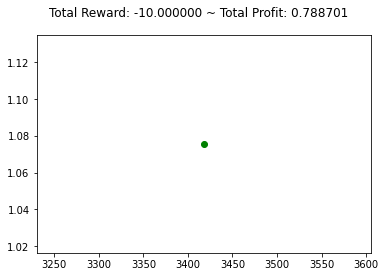

{'total_reward': -8.000000000010228, 'total_profit': 0.7887014590192738, 'position': 0}


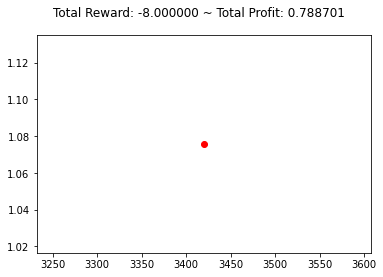

{'total_reward': -7.000000000008118, 'total_profit': 0.7885548057171134, 'position': 1}


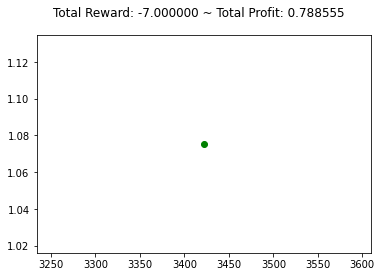

{'total_reward': -7.000000000008118, 'total_profit': 0.7885548057171134, 'position': 0}


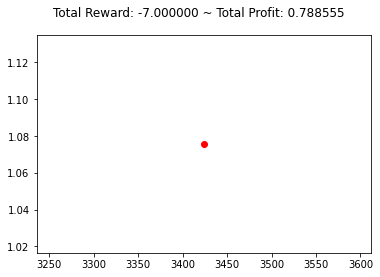

{'total_reward': -8.000000000010228, 'total_profit': 0.7882615809125332, 'position': 1}


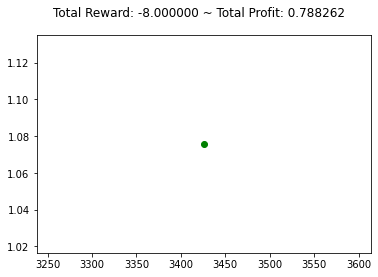

{'total_reward': -9.000000000010118, 'total_profit': 0.7879684923901639, 'position': 1}


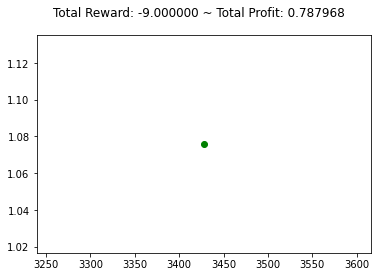

{'total_reward': -8.000000000010228, 'total_profit': 0.7878219889984394, 'position': 1}


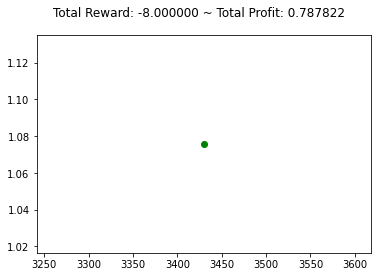

{'total_reward': -8.000000000010228, 'total_profit': 0.7878219889984394, 'position': 1}


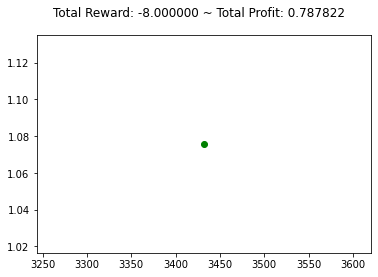

{'total_reward': -7.000000000010338, 'total_profit': 0.7878219889984394, 'position': 0}


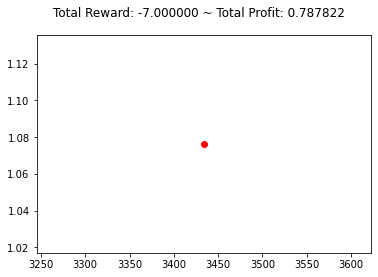

{'total_reward': -7.000000000010338, 'total_profit': 0.7878219889984394, 'position': 0}


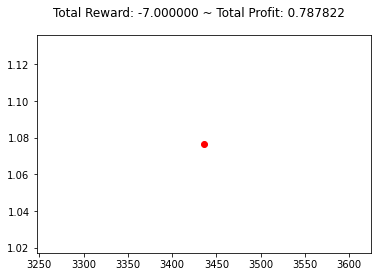

{'total_reward': -7.000000000010338, 'total_profit': 0.7878219889984394, 'position': 0}


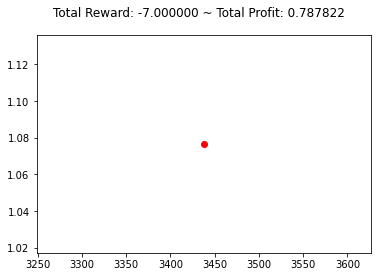

{'total_reward': -14.000000000009567, 'total_profit': 0.78709015250146, 'position': 1}


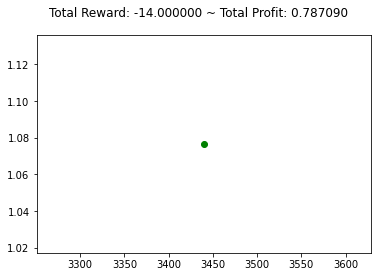

{'total_reward': -14.000000000009567, 'total_profit': 0.78709015250146, 'position': 0}


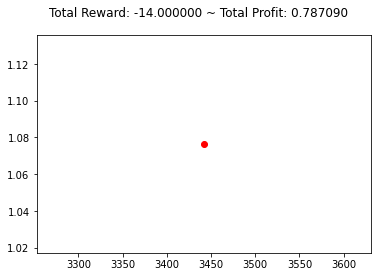

{'total_reward': -14.000000000009567, 'total_profit': 0.7868708055012273, 'position': 1}


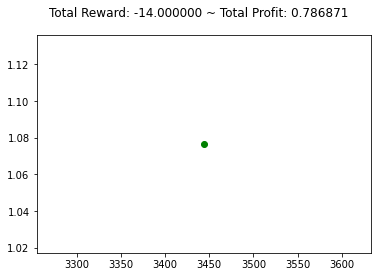

{'total_reward': -14.000000000009567, 'total_profit': 0.7868708055012273, 'position': 0}


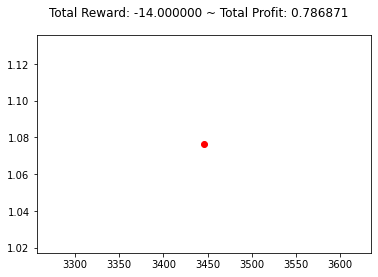

{'total_reward': -13.000000000009678, 'total_profit': 0.7867246013381836, 'position': 1}


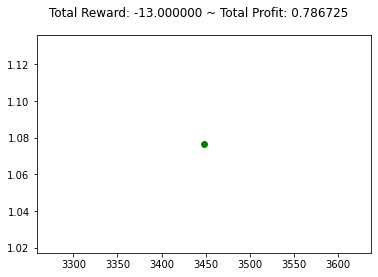

{'total_reward': -16.000000000009347, 'total_profit': 0.7862132193891292, 'position': 1}


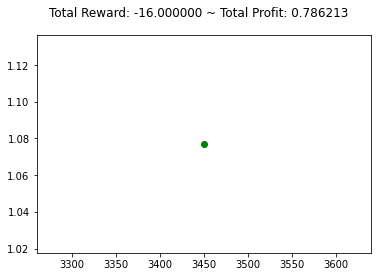

{'total_reward': -15.000000000009457, 'total_profit': 0.7862132193891292, 'position': 0}


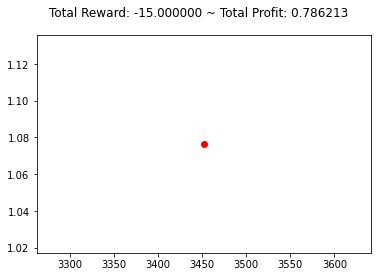

{'total_reward': -13.000000000009678, 'total_profit': 0.7861402055314594, 'position': 1}


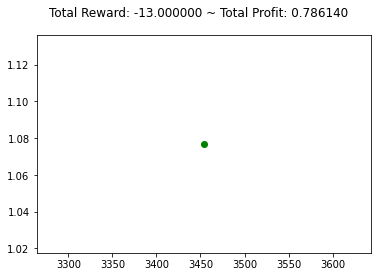

{'total_reward': -12.000000000009788, 'total_profit': 0.7861402055314594, 'position': 0}


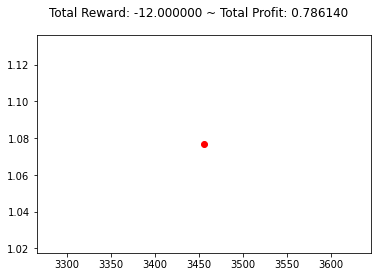

{'total_reward': -12.000000000009788, 'total_profit': 0.7861402055314594, 'position': 0}


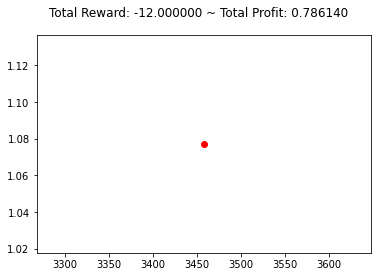

{'total_reward': -12.000000000009788, 'total_profit': 0.7859212046384708, 'position': 1}


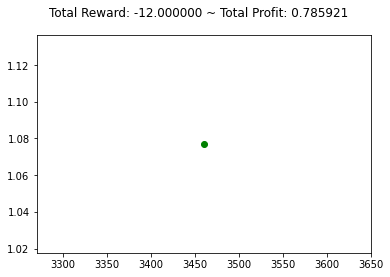

{'total_reward': -12.000000000009788, 'total_profit': 0.7859212046384708, 'position': 0}


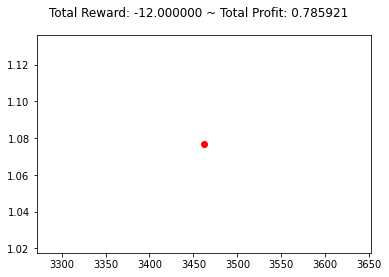

{'total_reward': -11.000000000009898, 'total_profit': 0.7857752311606405, 'position': 0}


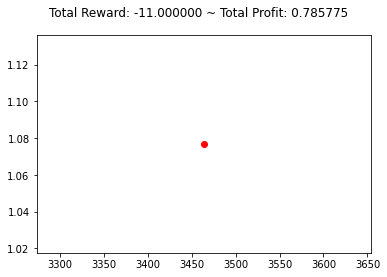

{'total_reward': -8.000000000010228, 'total_profit': 0.7857752311606405, 'position': 0}


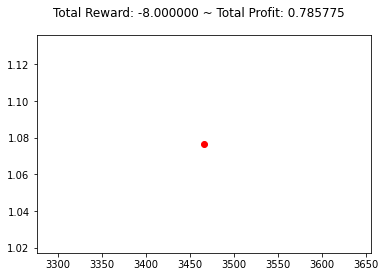

{'total_reward': -8.000000000010228, 'total_profit': 0.7857752311606405, 'position': 0}


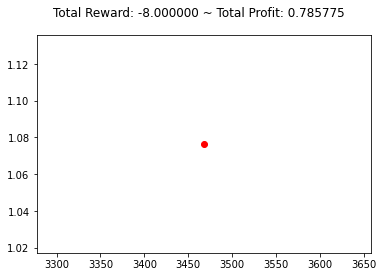

{'total_reward': -8.000000000010228, 'total_profit': 0.7857752311606405, 'position': 0}


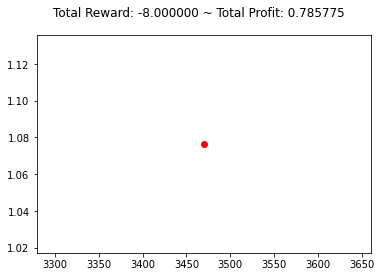

{'total_reward': -8.000000000010228, 'total_profit': 0.7857752311606405, 'position': 0}


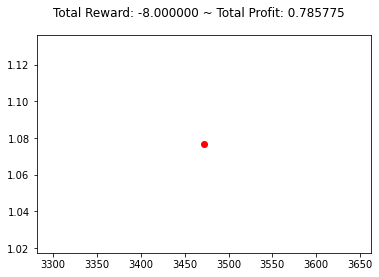

{'total_reward': -8.000000000010228, 'total_profit': 0.7857752311606405, 'position': 0}


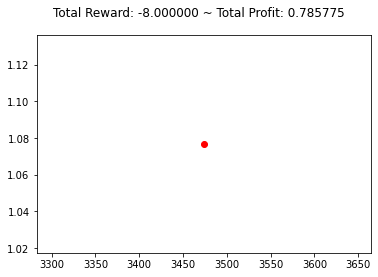

{'total_reward': -12.000000000009788, 'total_profit': 0.7852644663154252, 'position': 0}


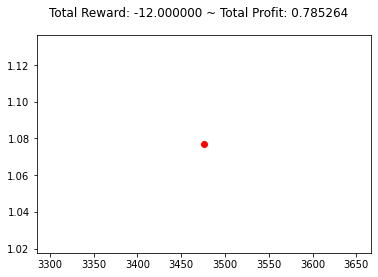

{'total_reward': -11.000000000009898, 'total_profit': 0.785118614817224, 'position': 1}


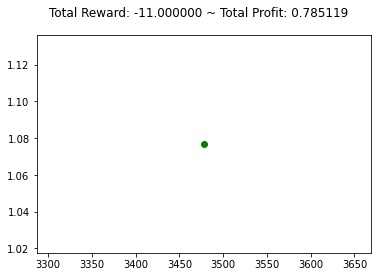

{'total_reward': -9.000000000010118, 'total_profit': 0.785118614817224, 'position': 0}


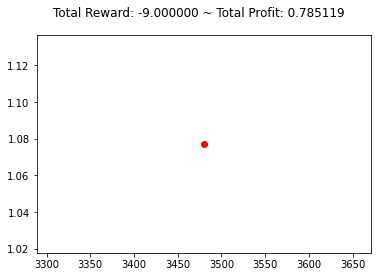

{'total_reward': -12.000000000009788, 'total_profit': 0.7848270472321095, 'position': 0}


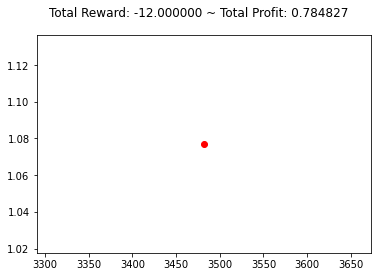

{'total_reward': -9.000000000010118, 'total_profit': 0.7847541553358309, 'position': 0}


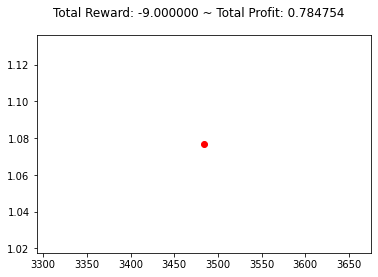

{'total_reward': -6.0000000000104485, 'total_profit': 0.7847541553358309, 'position': 1}


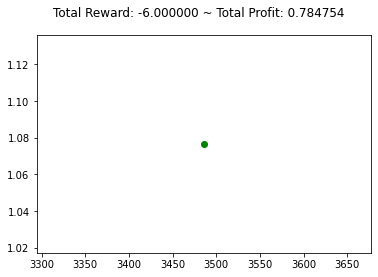

{'total_reward': -6.0000000000104485, 'total_profit': 0.7847541553358309, 'position': 0}


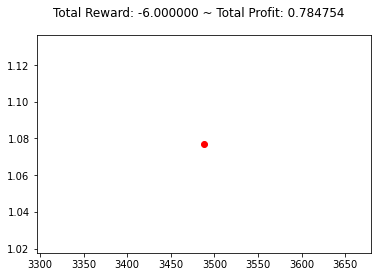

{'total_reward': -6.0000000000104485, 'total_profit': 0.7845354593334151, 'position': 1}


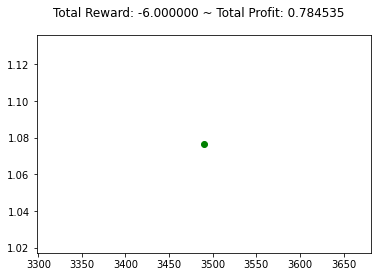

{'total_reward': -3.000000000010779, 'total_profit': 0.7845354593334151, 'position': 0}


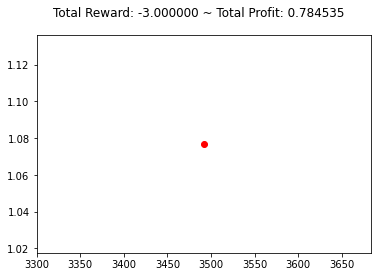

{'total_reward': -3.000000000010779, 'total_profit': 0.7843168851898416, 'position': 1}


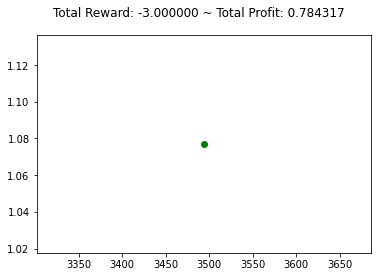

{'total_reward': 2.9999999999885603, 'total_profit': 0.7843168851898416, 'position': 0}


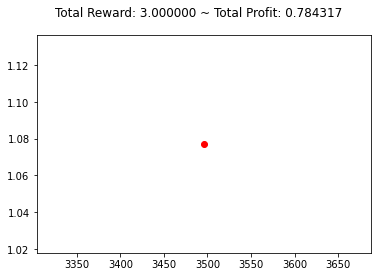

{'total_reward': 7.99999999998801, 'total_profit': 0.7844625471612762, 'position': 1}


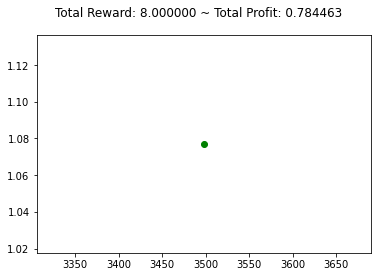

{'total_reward': 7.99999999998801, 'total_profit': 0.7842440136259912, 'position': 1}


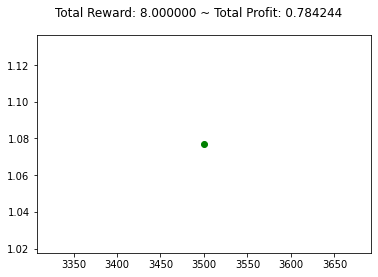

{'total_reward': 7.99999999998801, 'total_profit': 0.7842440136259912, 'position': 0}


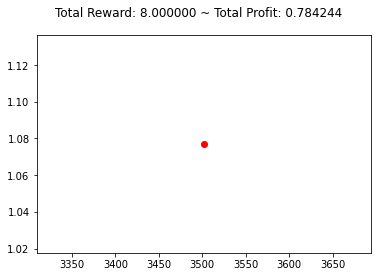

{'total_reward': 10.99999999998768, 'total_profit': 0.7841711758797643, 'position': 0}


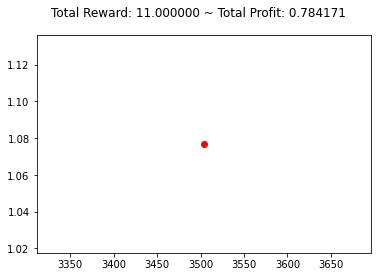

{'total_reward': 6.99999999998812, 'total_profit': 0.7836615956503586, 'position': 1}


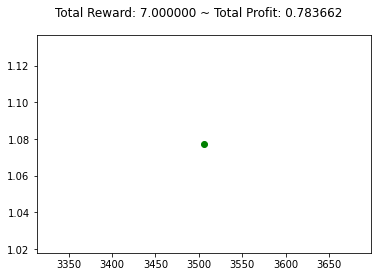

{'total_reward': 2.9999999999885603, 'total_profit': 0.7836615956503586, 'position': 0}


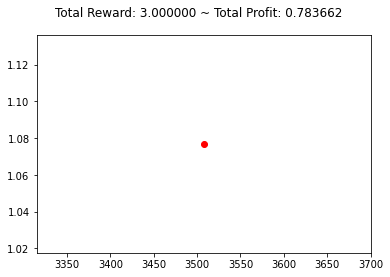

{'total_reward': 1.9999999999886704, 'total_profit': 0.7833705151059626, 'position': 1}


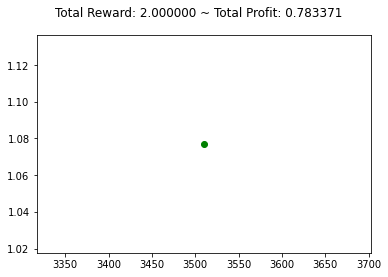

{'total_reward': 4.99999999998834, 'total_profit': 0.7832977652438613, 'position': 1}


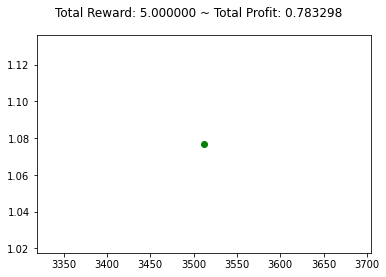

{'total_reward': 4.99999999998834, 'total_profit': 0.7832977652438613, 'position': 1}


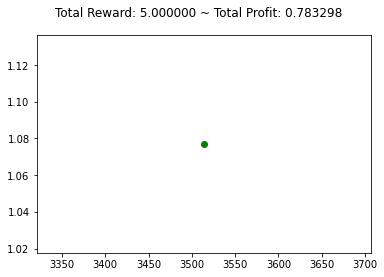

{'total_reward': 5.99999999998823, 'total_profit': 0.7830795561904922, 'position': 1}


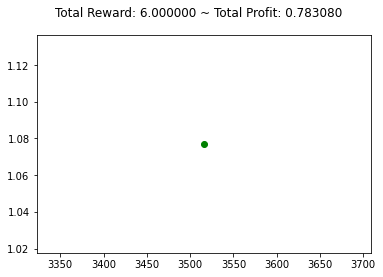

{'total_reward': 27.999999999988027, 'total_profit': 0.7830795561904922, 'position': 0}


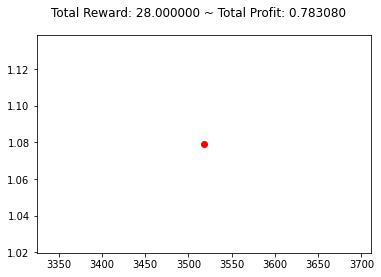

{'total_reward': 28.999999999987917, 'total_profit': 0.7829344070605218, 'position': 1}


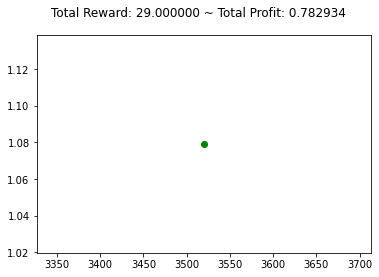

{'total_reward': 32.99999999998748, 'total_profit': 0.7829344070605218, 'position': 0}


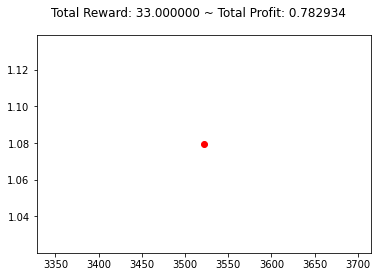

{'total_reward': 37.999999999986926, 'total_profit': 0.7830795427370554, 'position': 1}


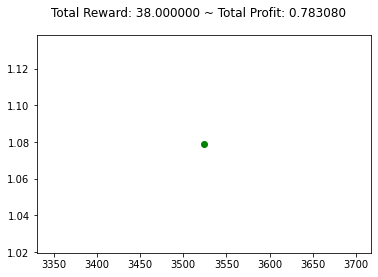

{'total_reward': 37.999999999986926, 'total_profit': 0.7830795427370554, 'position': 1}


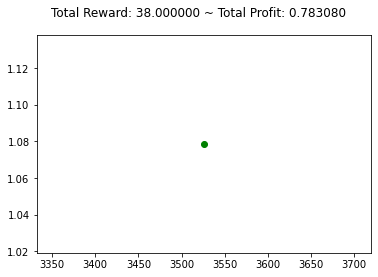

{'total_reward': 33.99999999998737, 'total_profit': 0.7830795427370554, 'position': 0}


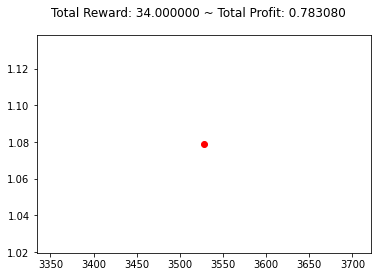

{'total_reward': 28.999999999987917, 'total_profit': 0.7824989462271484, 'position': 1}


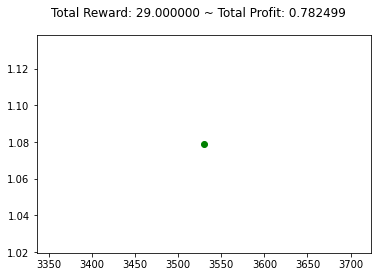

{'total_reward': 28.999999999987917, 'total_profit': 0.7824989462271484, 'position': 1}


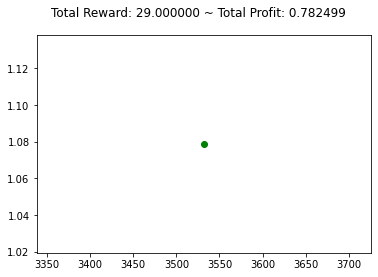

{'total_reward': 23.999999999988468, 'total_profit': 0.7824989462271484, 'position': 0}


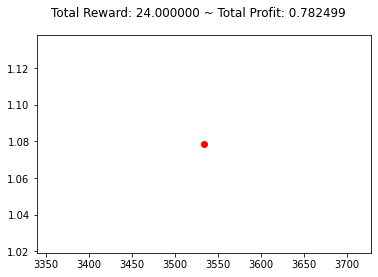

{'total_reward': 21.999999999988688, 'total_profit': 0.7821362416075939, 'position': 1}


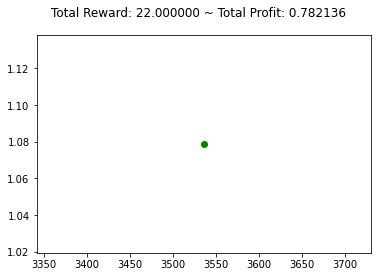

{'total_reward': 19.99999999998891, 'total_profit': 0.7821362416075939, 'position': 0}


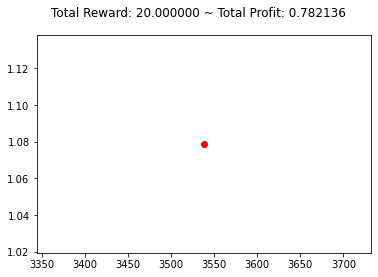

{'total_reward': 22.999999999988578, 'total_profit': 0.7821362416075939, 'position': 1}


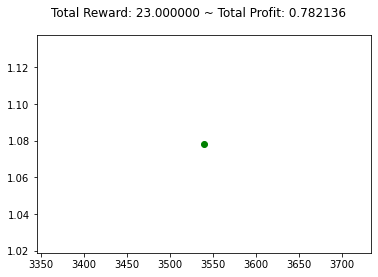

{'total_reward': 20.9999999999888, 'total_profit': 0.7817011574754184, 'position': 1}


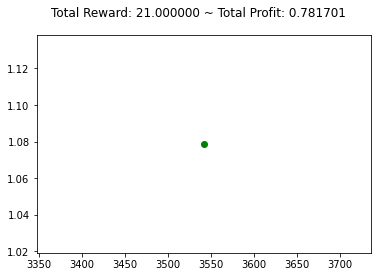

{'total_reward': 17.99999999998913, 'total_profit': 0.7817011574754184, 'position': 0}


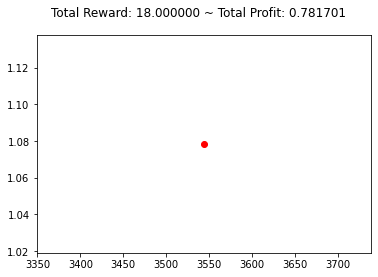

{'total_reward': 16.99999999998924, 'total_profit': 0.7814112089748712, 'position': 1}


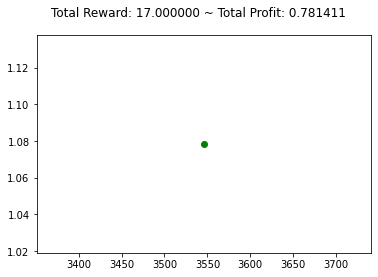

{'total_reward': 16.99999999998924, 'total_profit': 0.7814112089748712, 'position': 1}


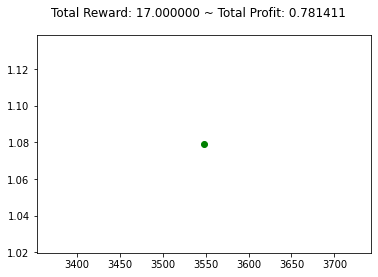

{'total_reward': 23.999999999988468, 'total_profit': 0.7814112089748712, 'position': 0}


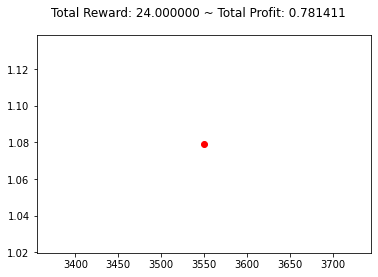

{'total_reward': 21.999999999988688, 'total_profit': 0.7810492098972399, 'position': 1}


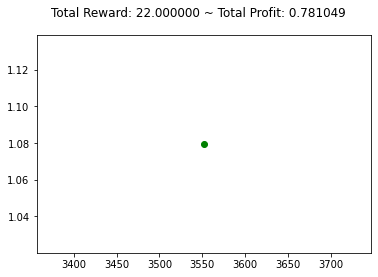

{'total_reward': 23.99999999999069, 'total_profit': 0.7806153338432279, 'position': 1}


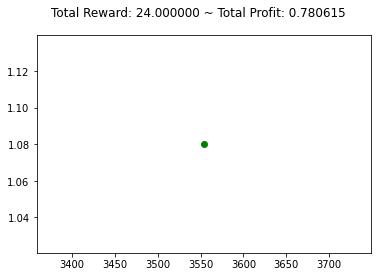

{'total_reward': 23.99999999999069, 'total_profit': 0.7806153338432279, 'position': 1}


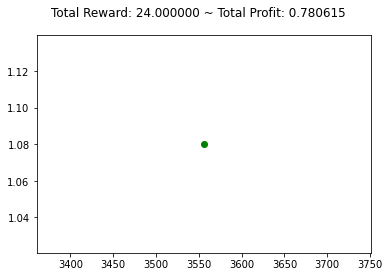

{'total_reward': 23.99999999999069, 'total_profit': 0.7806153338432279, 'position': 1}


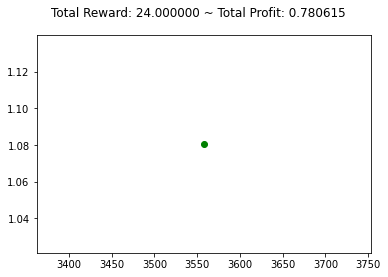

{'total_reward': 22.9999999999908, 'total_profit': 0.7804707486730402, 'position': 1}


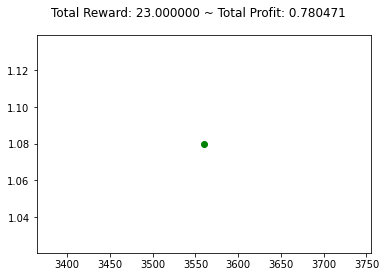

{'total_reward': 22.9999999999908, 'total_profit': 0.7804707486730402, 'position': 1}


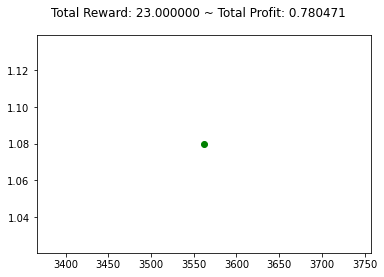

{'total_reward': 25.999999999990468, 'total_profit': 0.7803262036691189, 'position': 1}


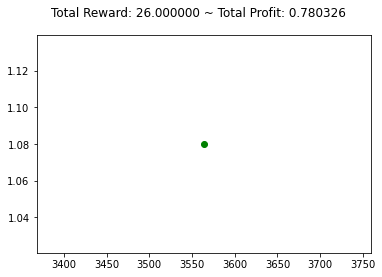

{'total_reward': 22.999999999988578, 'total_profit': 0.7803262036691189, 'position': 0}


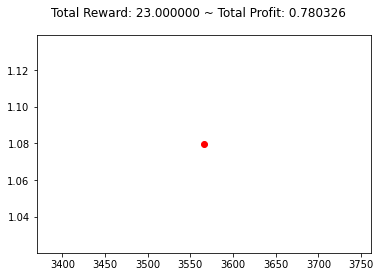

{'total_reward': 22.999999999988578, 'total_profit': 0.7801093660801038, 'position': 1}


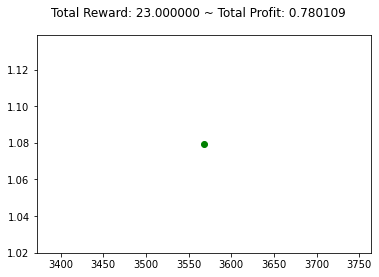

{'total_reward': 17.99999999998913, 'total_profit': 0.7801093660801038, 'position': 0}


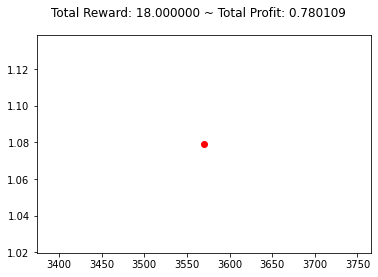

{'total_reward': 17.99999999998913, 'total_profit': 0.7801093660801038, 'position': 0}


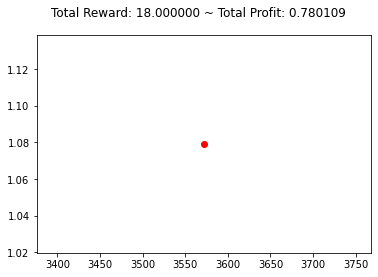

{'total_reward': 20.9999999999888, 'total_profit': 0.7800370600863991, 'position': 0}


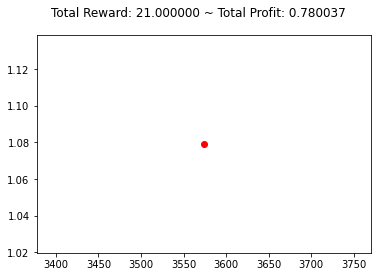

{'total_reward': 18.99999999998902, 'total_profit': 0.7797479165185791, 'position': 0}


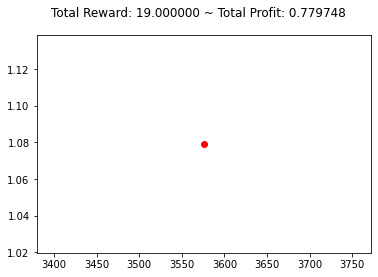

{'total_reward': 17.99999999998913, 'total_profit': 0.7794588801302856, 'position': 1}


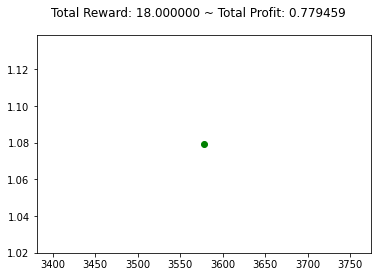

{'total_reward': 17.99999999998913, 'total_profit': 0.7794588801302856, 'position': 0}


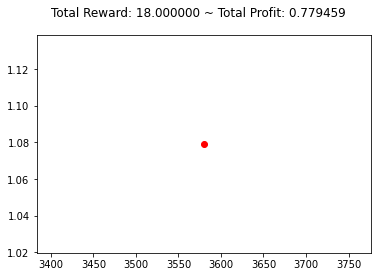

{'total_reward': 17.99999999998913, 'total_profit': 0.7792421831939137, 'position': 1}


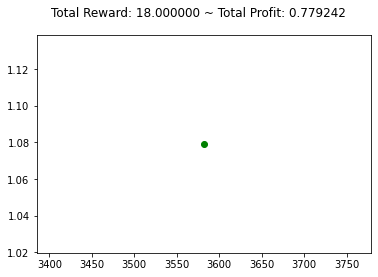

{'total_reward': 18.99999999998902, 'total_profit': 0.7792421831939137, 'position': 0}


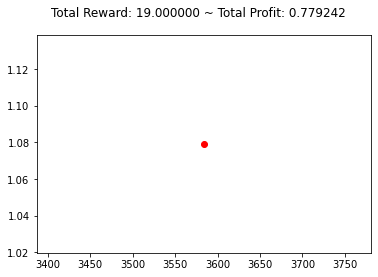

{'total_reward': 21.999999999988688, 'total_profit': 0.7792421831939137, 'position': 1}


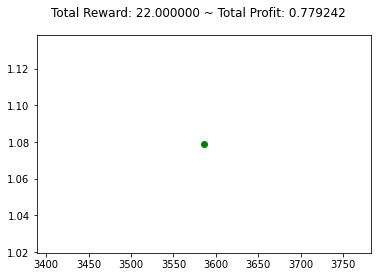

{'total_reward': 19.99999999998891, 'total_profit': 0.7792421831939137, 'position': 0}


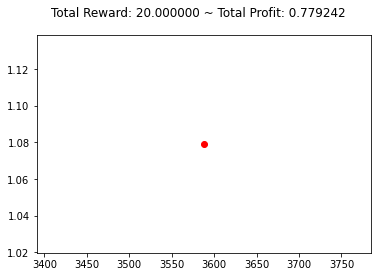

{'total_reward': 15.999999999989349, 'total_profit': 0.7787366975779043, 'position': 1}


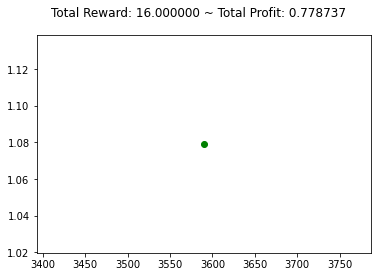

{'total_reward': 15.999999999989349, 'total_profit': 0.7787366975779043, 'position': 1}


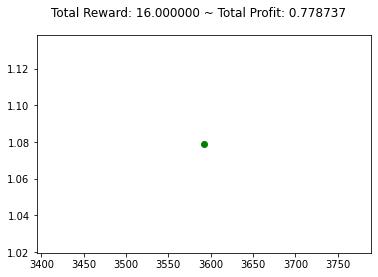

{'total_reward': 15.999999999989349, 'total_profit': 0.7787366975779043, 'position': 1}


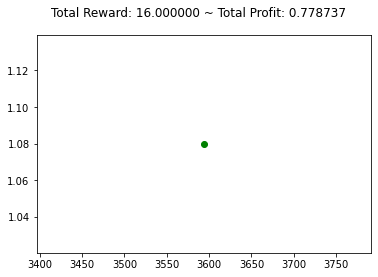

{'total_reward': 14.999999999987239, 'total_profit': 0.7782318673423935, 'position': 1}


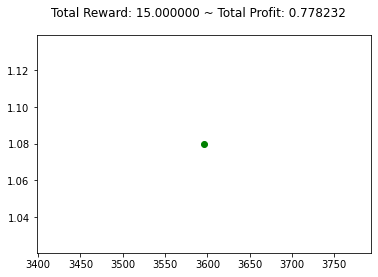

{'total_reward': 14.999999999987239, 'total_profit': 0.7782318673423935, 'position': 1}


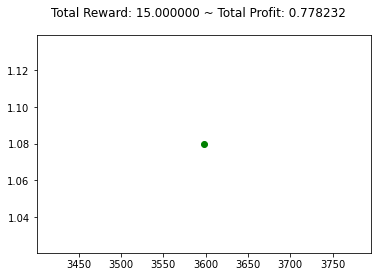

{'total_reward': 15.999999999984908, 'total_profit': 0.7782318673423935, 'position': 1}


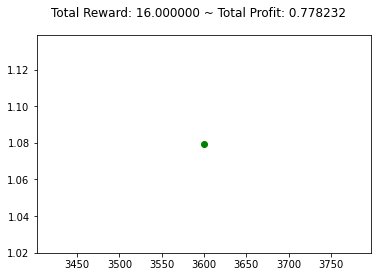

{'total_reward': 19.999999999986688, 'total_profit': 0.7782318673423935, 'position': 0}


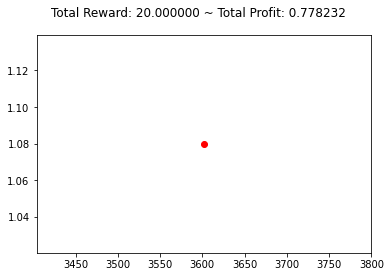

{'total_reward': 24.999999999988358, 'total_profit': 0.7782318673423936, 'position': 0}


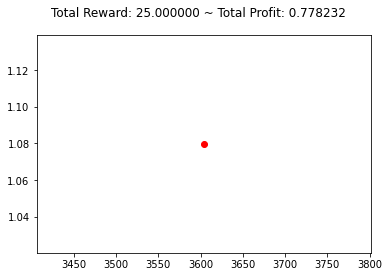

{'total_reward': 24.999999999988358, 'total_profit': 0.7782318673423936, 'position': 0}


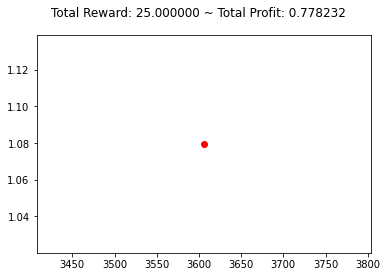

{'total_reward': 24.999999999988358, 'total_profit': 0.7782318673423936, 'position': 0}


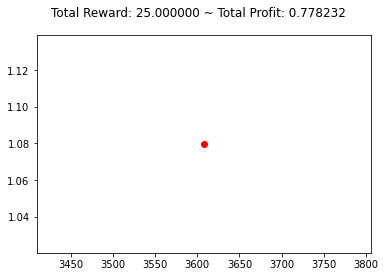

{'total_reward': 24.999999999988358, 'total_profit': 0.7780156117290158, 'position': 0}


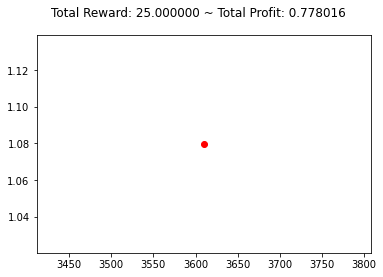

{'total_reward': 22.999999999986358, 'total_profit': 0.7775833408085254, 'position': 0}


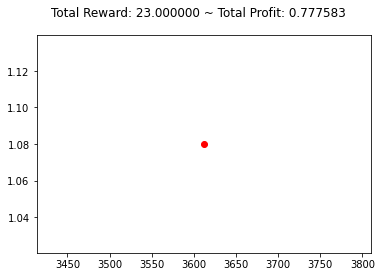

{'total_reward': 24.999999999986137, 'total_profit': 0.777511329015526, 'position': 1}


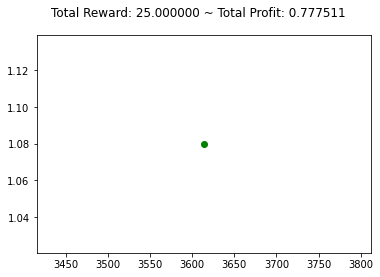

{'total_reward': 29.999999999985587, 'total_profit': 0.777511329015526, 'position': 0}


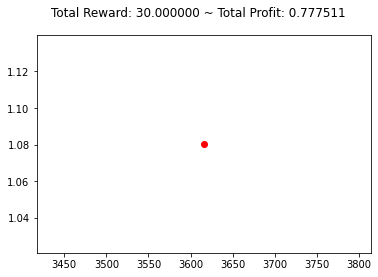

{'total_reward': 23.999999999986247, 'total_profit': 0.7767920770922925, 'position': 0}


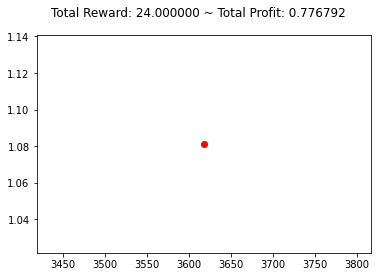

{'total_reward': 22.999999999986358, 'total_profit': 0.7765046956357287, 'position': 1}


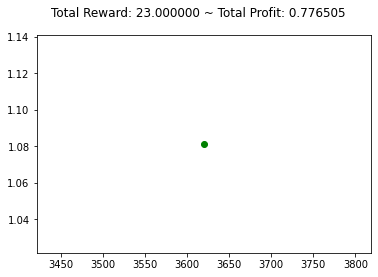

{'total_reward': 18.999999999986798, 'total_profit': 0.7762891595433058, 'position': 1}


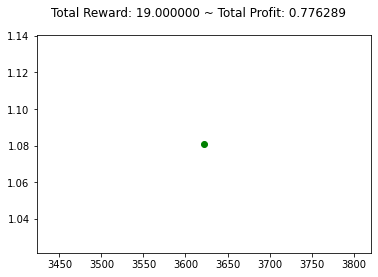

{'total_reward': 20.999999999986578, 'total_profit': 0.7762891595433058, 'position': 0}


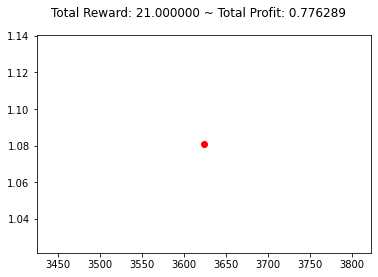

{'total_reward': 24.999999999986137, 'total_profit': 0.7762173341214383, 'position': 0}


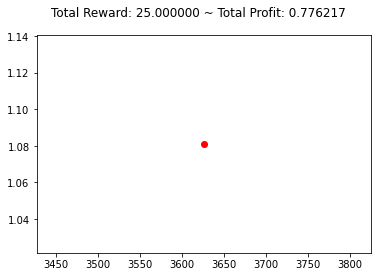

{'total_reward': 21.999999999986468, 'total_profit': 0.7762173341214383, 'position': 0}


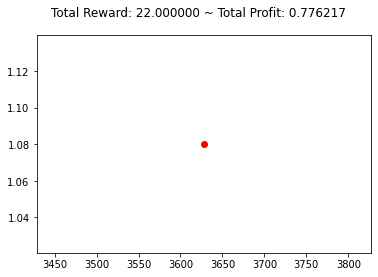

{'total_reward': 24.999999999986137, 'total_profit': 0.776145455490628, 'position': 0}


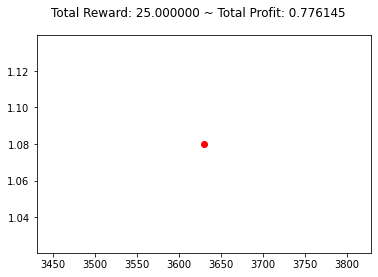

{'total_reward': 23.999999999986247, 'total_profit': 0.7758580208251376, 'position': 1}


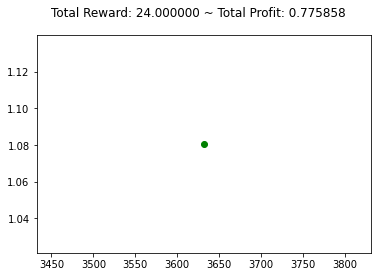

{'total_reward': 28.999999999985697, 'total_profit': 0.7758580208251376, 'position': 0}


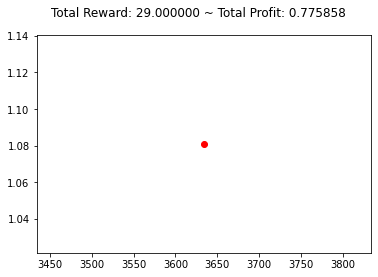

{'total_reward': 30.999999999985477, 'total_profit': 0.7755708521304675, 'position': 0}


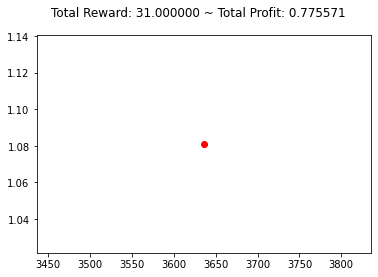

{'total_reward': 34.999999999985036, 'total_profit': 0.775714409900413, 'position': 0}


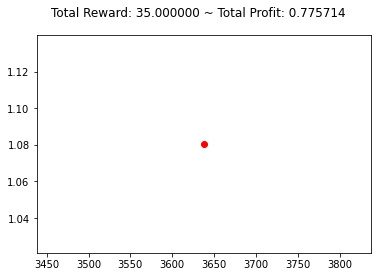

{'total_reward': 34.999999999985036, 'total_profit': 0.775714409900413, 'position': 0}


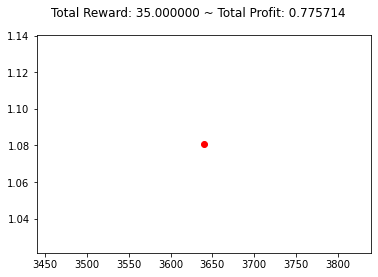

{'total_reward': 34.999999999985036, 'total_profit': 0.775714409900413, 'position': 0}


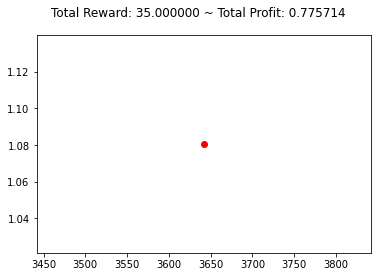

{'total_reward': 30.999999999985477, 'total_profit': 0.775212004194519, 'position': 1}


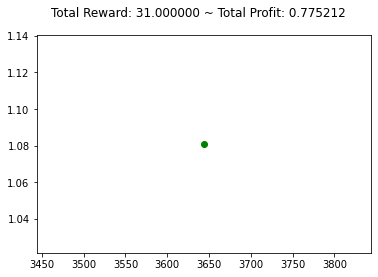

{'total_reward': 29.999999999985587, 'total_profit': 0.775212004194519, 'position': 0}


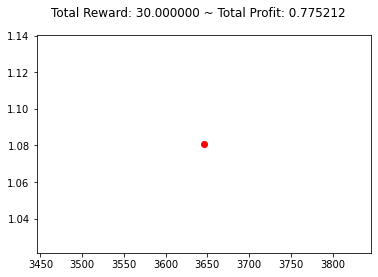

{'total_reward': 27.999999999985807, 'total_profit': 0.7749968070063461, 'position': 0}


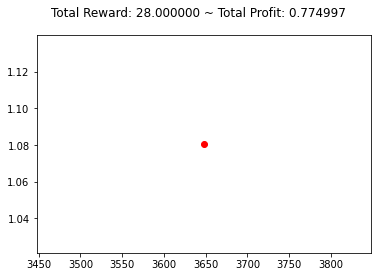

{'total_reward': 29.999999999985587, 'total_profit': 0.7749250679702444, 'position': 1}


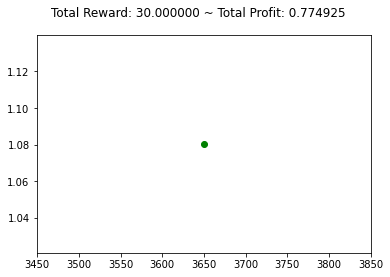

{'total_reward': 28.999999999985697, 'total_profit': 0.7745665055660383, 'position': 1}


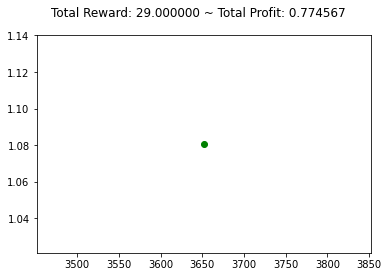

{'total_reward': 28.999999999985697, 'total_profit': 0.7745665055660383, 'position': 1}


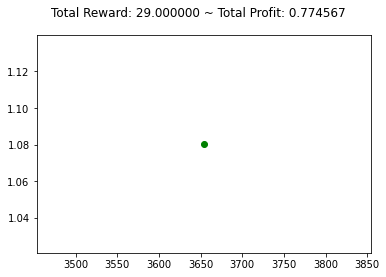

{'total_reward': 23.999999999986247, 'total_profit': 0.7741364695677598, 'position': 1}


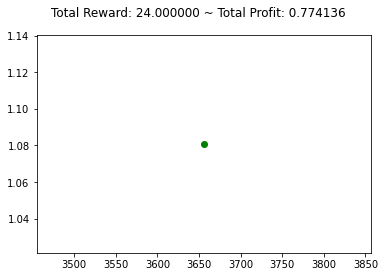

{'total_reward': 21.999999999986468, 'total_profit': 0.7741364695677598, 'position': 0}


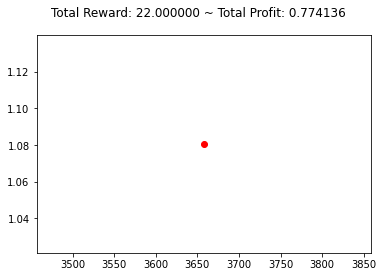

{'total_reward': 21.999999999986468, 'total_profit': 0.7741364695677598, 'position': 0}


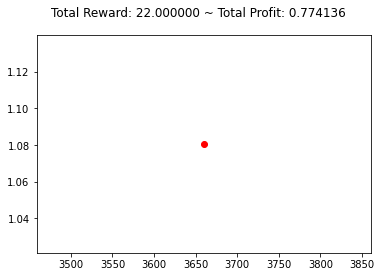

{'total_reward': 23.999999999986247, 'total_profit': 0.7740648101704103, 'position': 1}


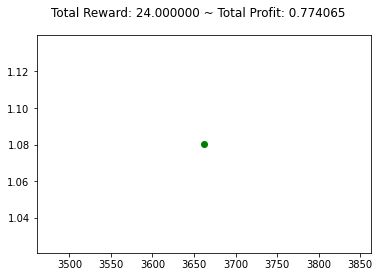

{'total_reward': 22.999999999986358, 'total_profit': 0.7737782256423946, 'position': 1}


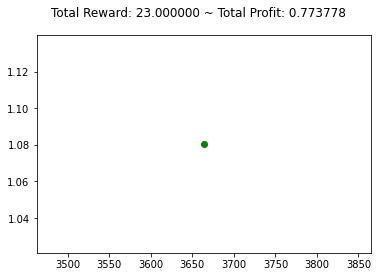

{'total_reward': 24.999999999986137, 'total_profit': 0.7737782256423946, 'position': 0}


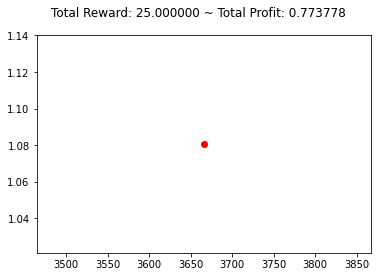

{'total_reward': 32.999999999985256, 'total_profit': 0.7737066060361708, 'position': 0}


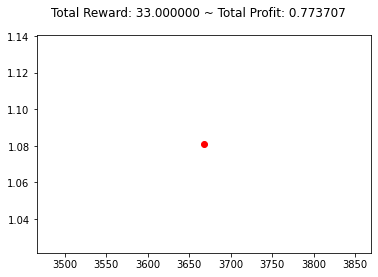

{'total_reward': 32.999999999985256, 'total_profit': 0.7737066060361708, 'position': 0}


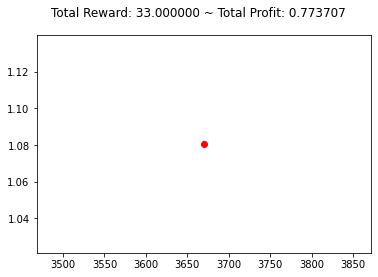

{'total_reward': 38.999999999984595, 'total_profit': 0.7739214449678727, 'position': 1}


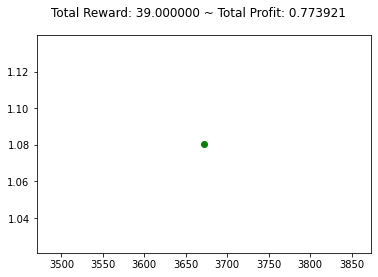

{'total_reward': 38.999999999984595, 'total_profit': 0.7739214449678727, 'position': 1}


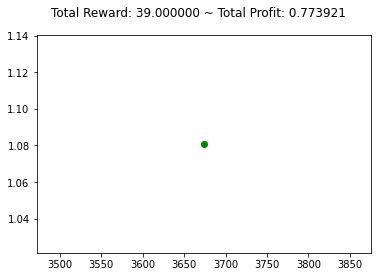

{'total_reward': 37.99999999998471, 'total_profit': 0.7739214449678727, 'position': 0}


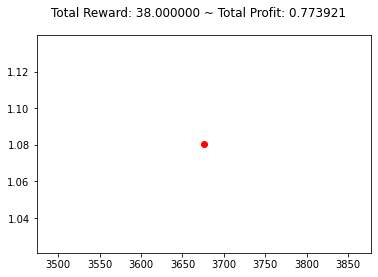

{'total_reward': 36.99999999998482, 'total_profit': 0.7736349135184215, 'position': 1}


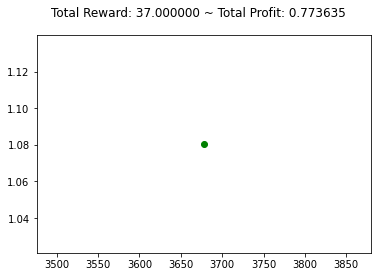

{'total_reward': 35.99999999998493, 'total_profit': 0.7735632740227721, 'position': 1}


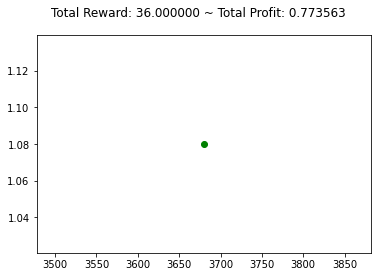

{'total_reward': 33.99999999998515, 'total_profit': 0.7735632740227721, 'position': 0}


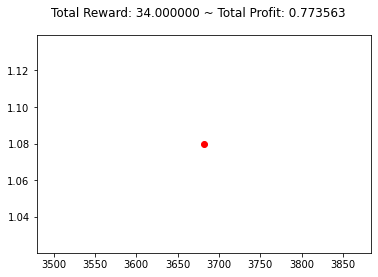

{'total_reward': 29.99999999998559, 'total_profit': 0.7730619368393484, 'position': 1}


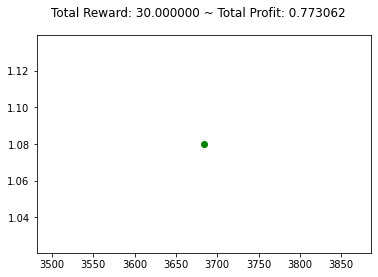

{'total_reward': 24.99999999998614, 'total_profit': 0.7727040377945154, 'position': 1}


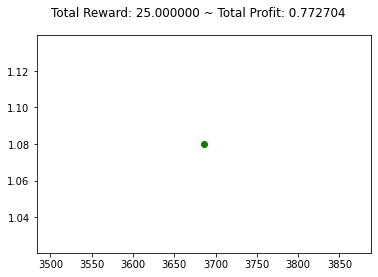

{'total_reward': 21.99999999998647, 'total_profit': 0.7722034428602663, 'position': 1}


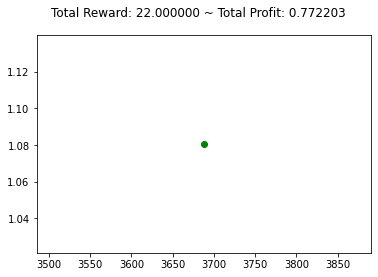

{'total_reward': 21.99999999998647, 'total_profit': 0.7722034428602663, 'position': 1}


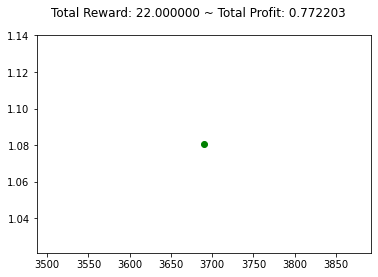

{'total_reward': 21.99999999998647, 'total_profit': 0.7722034428602663, 'position': 0}


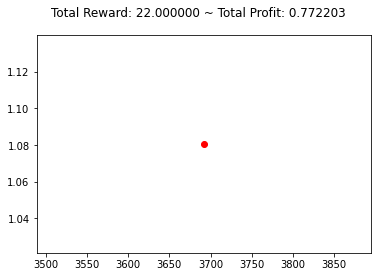

{'total_reward': 21.99999999998647, 'total_profit': 0.7722034428602663, 'position': 0}


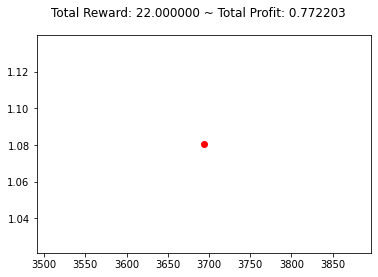

{'total_reward': 20.99999999998658, 'total_profit': 0.7719176003865073, 'position': 0}


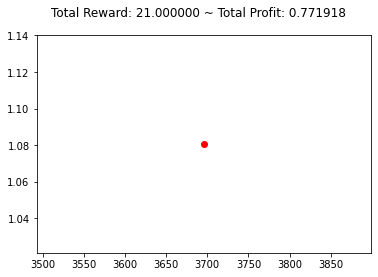

{'total_reward': 20.99999999998658, 'total_profit': 0.771703297887788, 'position': 1}


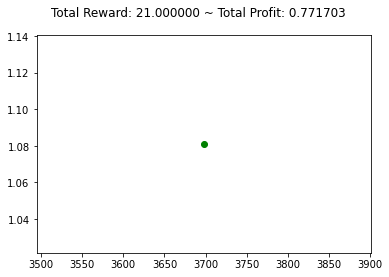

{'total_reward': 19.99999999998669, 'total_profit': 0.7715604295553086, 'position': 1}


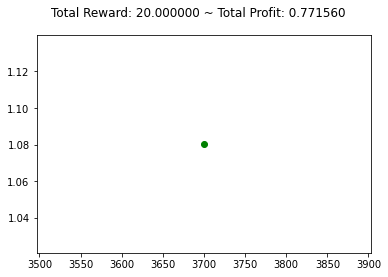

{'total_reward': 17.999999999986912, 'total_profit': 0.7715604295553086, 'position': 0}


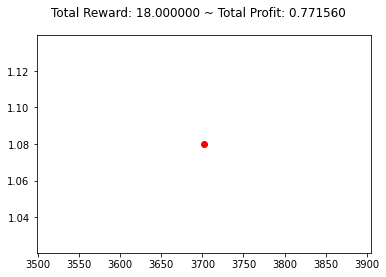

{'total_reward': 22.99999999998858, 'total_profit': 0.771703364055041, 'position': 1}


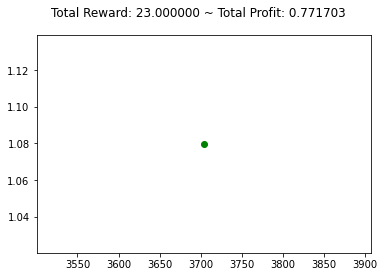

{'total_reward': 22.99999999998858, 'total_profit': 0.771703364055041, 'position': 1}


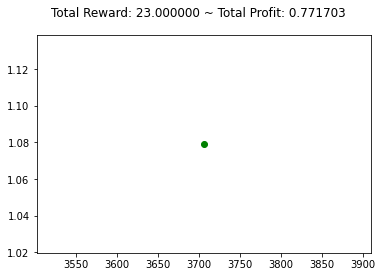

{'total_reward': 16.999999999989242, 'total_profit': 0.771703364055041, 'position': 0}


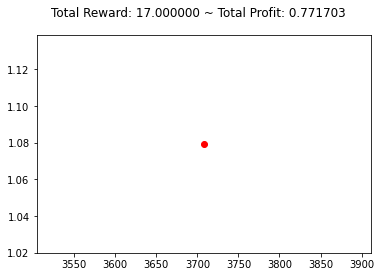

{'total_reward': 16.999999999989242, 'total_profit': 0.771703364055041, 'position': 0}


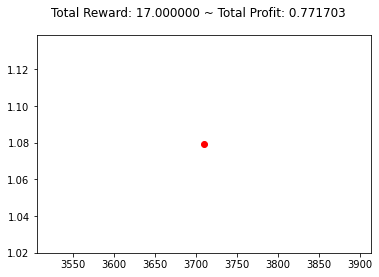

{'total_reward': 14.999999999989463, 'total_profit': 0.7713458291384108, 'position': 1}


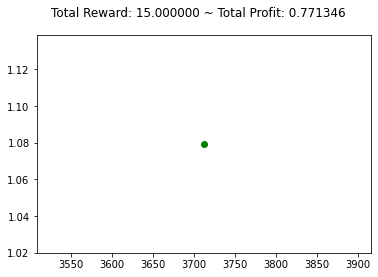

{'total_reward': 21.999999999990912, 'total_profit': 0.7713458291384108, 'position': 0}


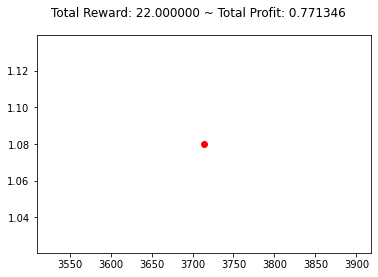

{'total_reward': 21.999999999990912, 'total_profit': 0.7711315465671158, 'position': 1}


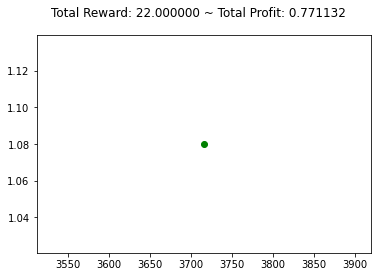

{'total_reward': 22.999999999990802, 'total_profit': 0.7711315465671158, 'position': 0}


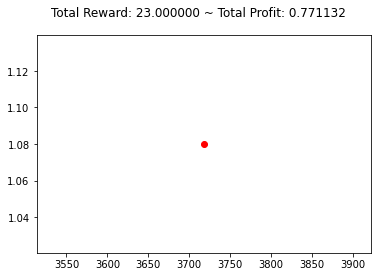

{'total_reward': 22.999999999990802, 'total_profit': 0.770917343359736, 'position': 1}


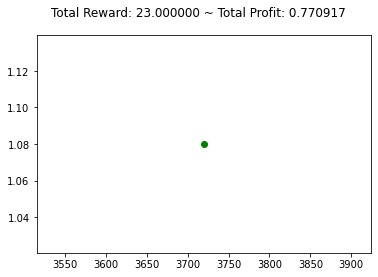

{'total_reward': 15.999999999989353, 'total_profit': 0.770917343359736, 'position': 0}


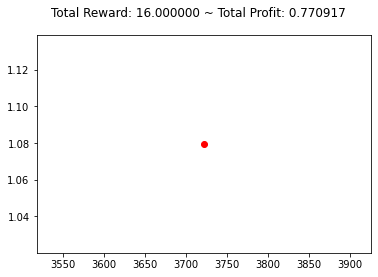

{'total_reward': 15.999999999989353, 'total_profit': 0.770917343359736, 'position': 0}


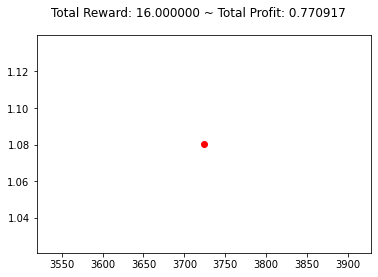

{'total_reward': 3.9999999999884537, 'total_profit': 0.7698471203009303, 'position': 1}


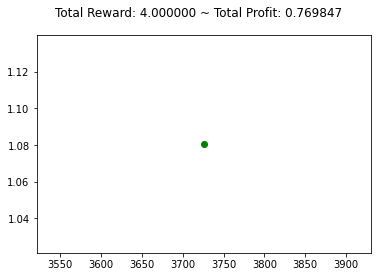

{'total_reward': 3.9999999999884537, 'total_profit': 0.7698471203009303, 'position': 1}


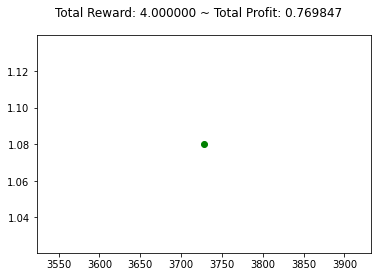

{'total_reward': -2.0000000000108855, 'total_profit': 0.7694908085725674, 'position': 1}


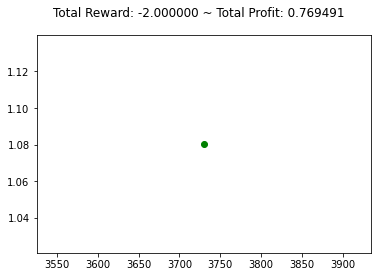

{'total_reward': -1.0000000000109956, 'total_profit': 0.7694908085725674, 'position': 1}


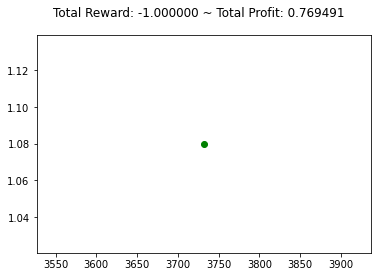

{'total_reward': -9.000000000010115, 'total_profit': 0.76863645164225, 'position': 1}


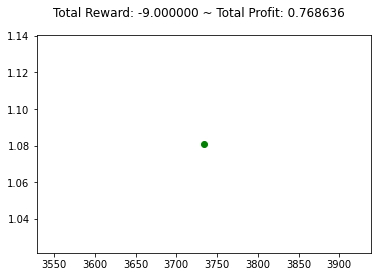

{'total_reward': -9.000000000010115, 'total_profit': 0.76863645164225, 'position': 1}


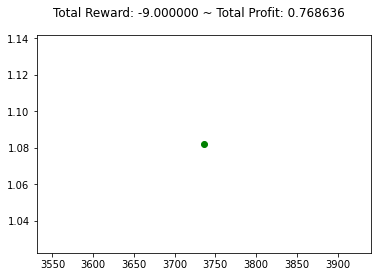

{'total_reward': 2.9999999999907843, 'total_profit': 0.76863645164225, 'position': 0}


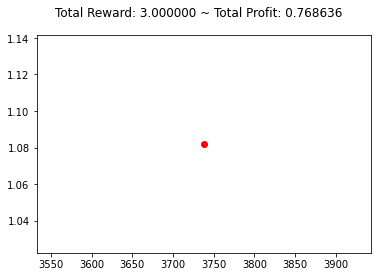

{'total_reward': 2.9999999999907843, 'total_profit': 0.76863645164225, 'position': 0}


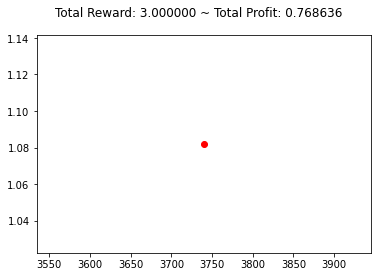

{'total_reward': 5.999999999992674, 'total_profit': 0.768778594305522, 'position': 0}


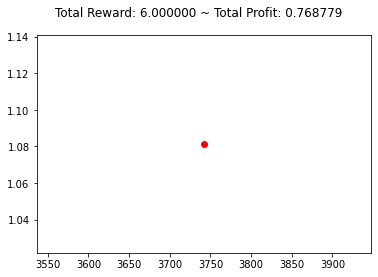

{'total_reward': 6.999999999992564, 'total_profit': 0.7686363859084991, 'position': 1}


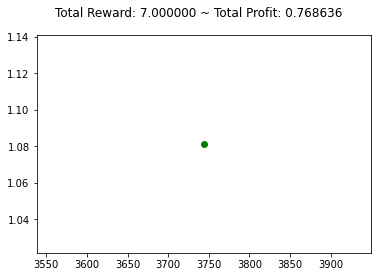

{'total_reward': 8.999999999992344, 'total_profit': 0.7685652817099877, 'position': 1}


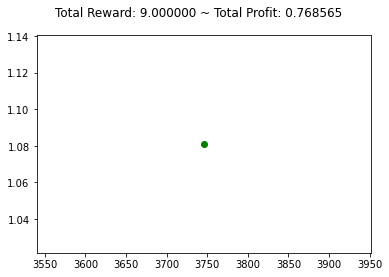

{'total_reward': 6.999999999992564, 'total_profit': 0.7683519493779069, 'position': 1}


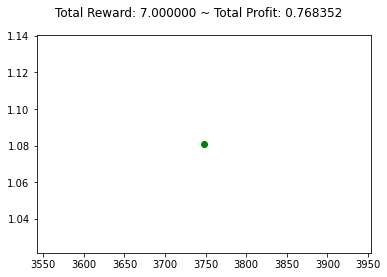

{'total_reward': 6.999999999992564, 'total_profit': 0.7683519493779069, 'position': 0}


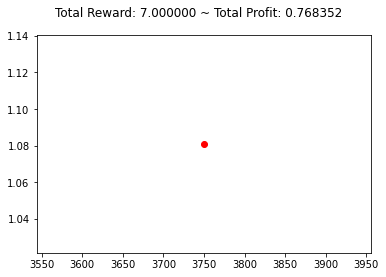

{'total_reward': 6.999999999992564, 'total_profit': 0.7683519493779069, 'position': 0}


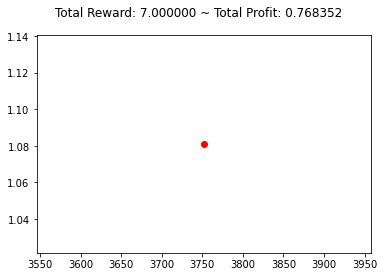

{'total_reward': 7.999999999992454, 'total_profit': 0.7682097541434518, 'position': 1}


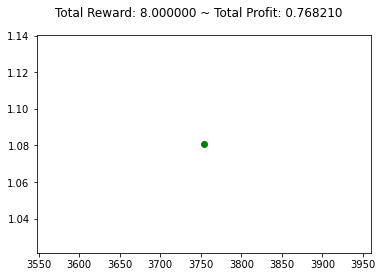

{'total_reward': 7.999999999992454, 'total_profit': 0.7682097541434518, 'position': 1}


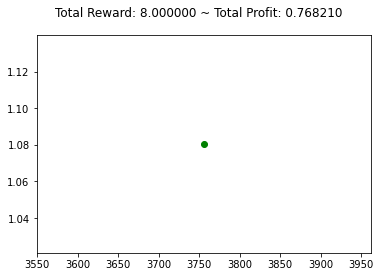

{'total_reward': 7.999999999992454, 'total_profit': 0.7682097541434518, 'position': 1}


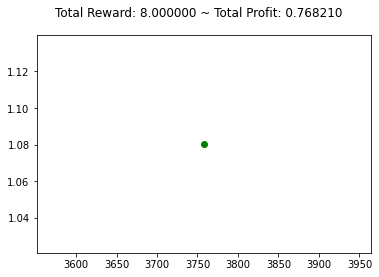

{'total_reward': 7.999999999992454, 'total_profit': 0.7682097541434518, 'position': 0}


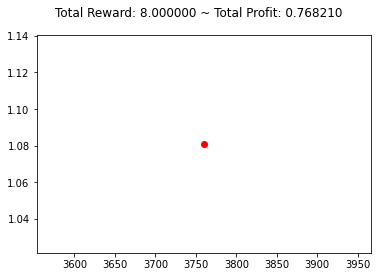

{'total_reward': 1.9999999999931148, 'total_profit': 0.7675703490026684, 'position': 1}


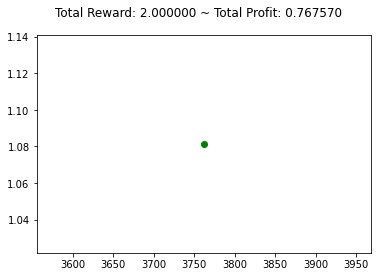

{'total_reward': 0.999999999993225, 'total_profit': 0.7675703490026684, 'position': 0}


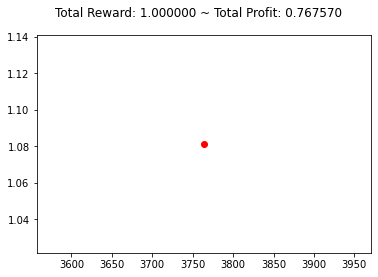

{'total_reward': 0.999999999993225, 'total_profit': 0.7675703490026684, 'position': 0}


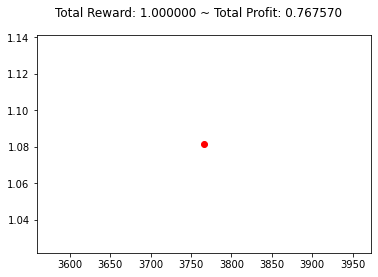

{'total_reward': 1.9999999999931148, 'total_profit': 0.7674283509730685, 'position': 1}


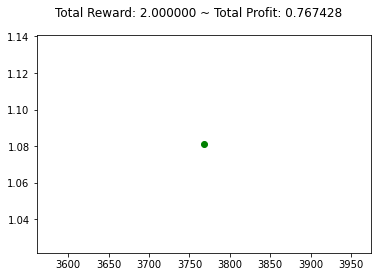

{'total_reward': 7.9999999999946745, 'total_profit': 0.7674283509730685, 'position': 0}


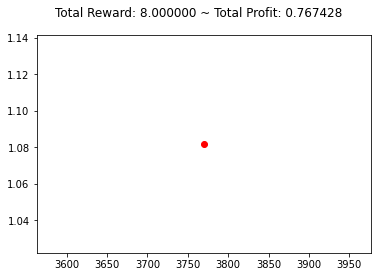

{'total_reward': 0.999999999993225, 'total_profit': 0.7670736840209598, 'position': 0}


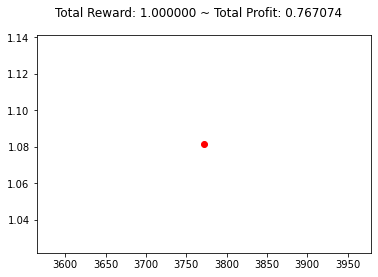

{'total_reward': 2.9999999999930047, 'total_profit': 0.767002737509304, 'position': 1}


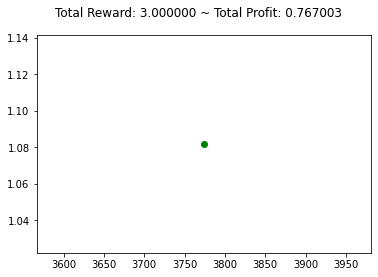

{'total_reward': 2.9999999999930047, 'total_profit': 0.767002737509304, 'position': 1}


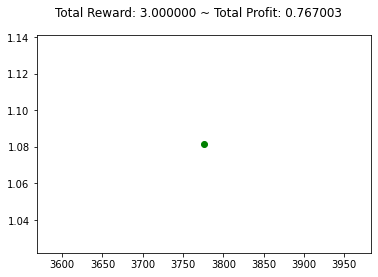

{'total_reward': 2.9999999999930047, 'total_profit': 0.767002737509304, 'position': 0}


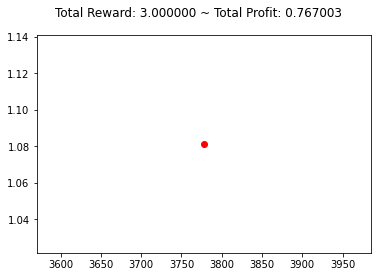

{'total_reward': 2.9999999999930047, 'total_profit': 0.767002737509304, 'position': 0}


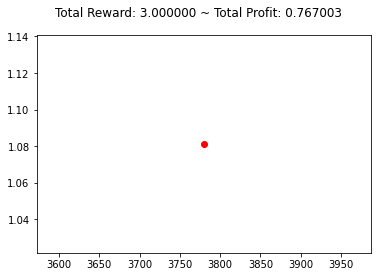

{'total_reward': 6.999999999992564, 'total_profit': 0.7670737037137367, 'position': 1}


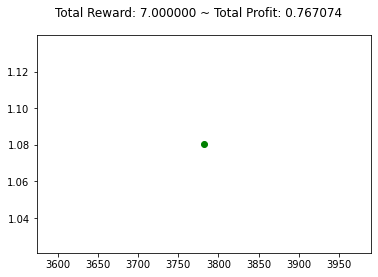

{'total_reward': 6.999999999992564, 'total_profit': 0.7670737037137367, 'position': 1}


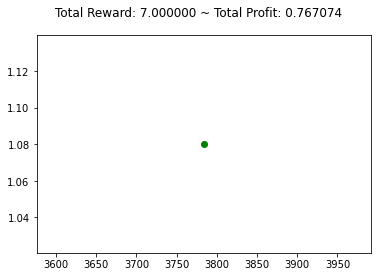

{'total_reward': 6.999999999992564, 'total_profit': 0.7670737037137367, 'position': 1}


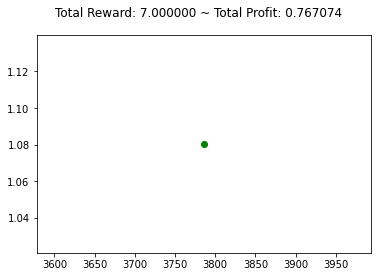

{'total_reward': 6.999999999992564, 'total_profit': 0.7670737037137367, 'position': 1}


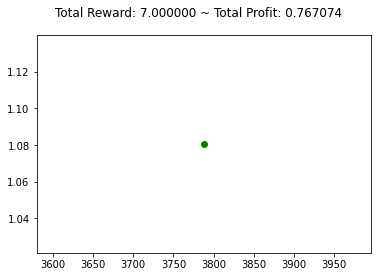

{'total_reward': 1.9999999999931148, 'total_profit': 0.7670737037137367, 'position': 0}


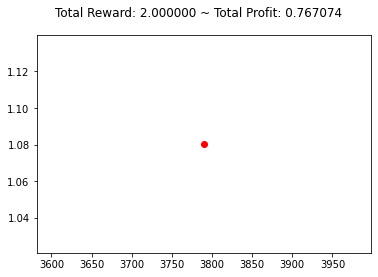

{'total_reward': 1.9999999999931148, 'total_profit': 0.7670737037137367, 'position': 0}


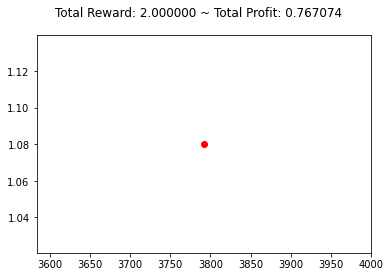

{'total_reward': 3.9999999999928946, 'total_profit': 0.7670026849466121, 'position': 1}


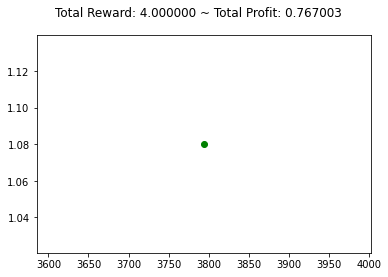

{'total_reward': 3.9999999999928946, 'total_profit': 0.7670026849466121, 'position': 1}


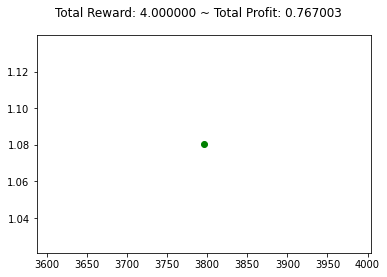

{'total_reward': 3.9999999999928946, 'total_profit': 0.7670026849466121, 'position': 1}


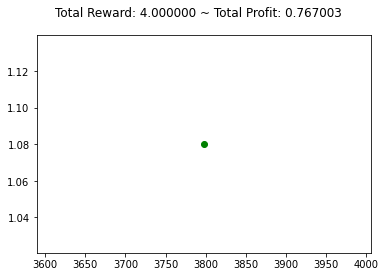

{'total_reward': 3.9999999999928946, 'total_profit': 0.7670026849466121, 'position': 0}


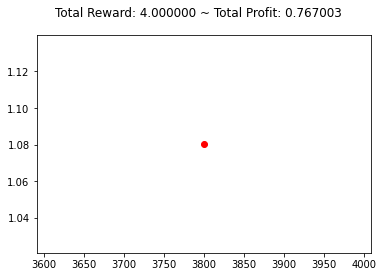

{'total_reward': -2.0000000000064446, 'total_profit': 0.766434850273322, 'position': 0}


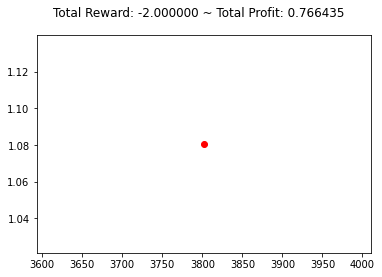

{'total_reward': -2.0000000000064446, 'total_profit': 0.766434850273322, 'position': 0}


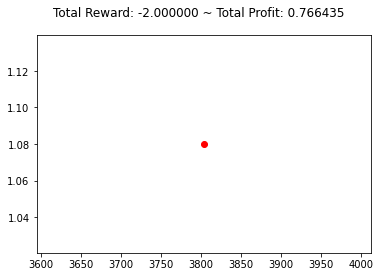

{'total_reward': -2.0000000000064446, 'total_profit': 0.766434850273322, 'position': 0}


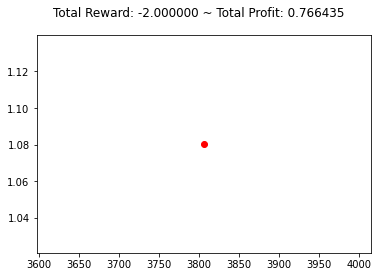

{'total_reward': -6.66489086142974e-12, 'total_profit': 0.7663639037908381, 'position': 1}


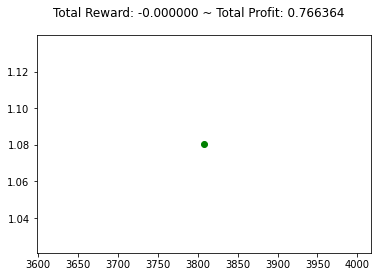

{'total_reward': 0.999999999993225, 'total_profit': 0.7663639037908381, 'position': 0}


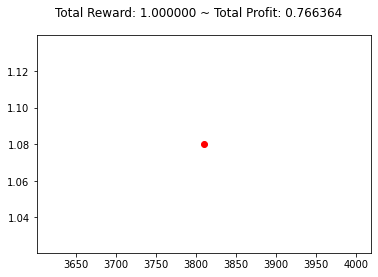

{'total_reward': -6.66489086142974e-12, 'total_profit': 0.7660801966538494, 'position': 1}


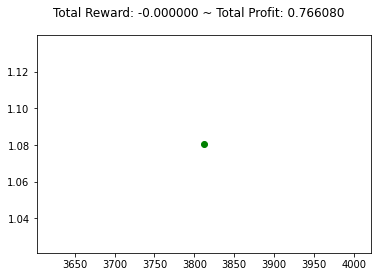

{'total_reward': -5.000000000006114, 'total_profit': 0.7660801966538494, 'position': 0}


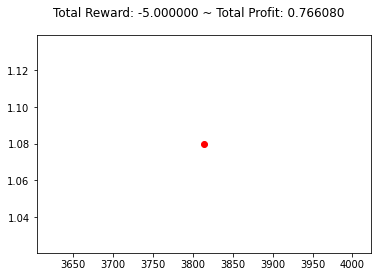

{'total_reward': -5.000000000006114, 'total_profit': 0.7658673965992234, 'position': 1}


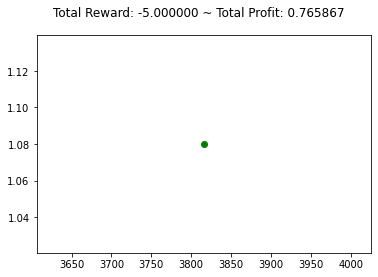

{'total_reward': -9.000000000005674, 'total_profit': 0.7653004024133274, 'position': 1}


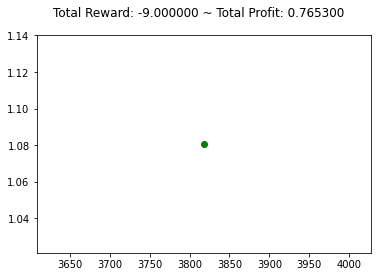

{'total_reward': -9.000000000005674, 'total_profit': 0.7653004024133274, 'position': 1}


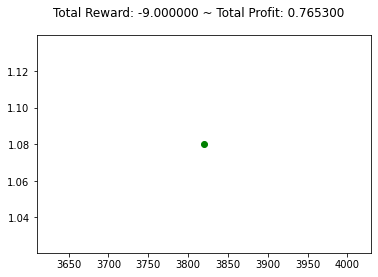

{'total_reward': -16.000000000004903, 'total_profit': 0.7653004024133274, 'position': 0}


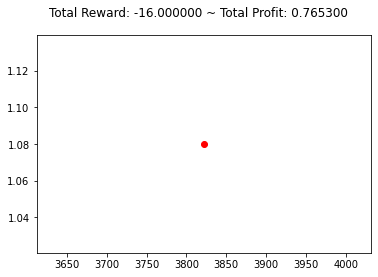

{'total_reward': -20.000000000004462, 'total_profit': 0.7648045121220294, 'position': 1}


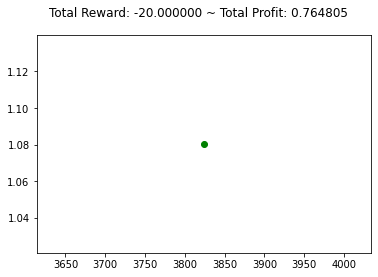

{'total_reward': -22.000000000004242, 'total_profit': 0.7648045121220294, 'position': 0}


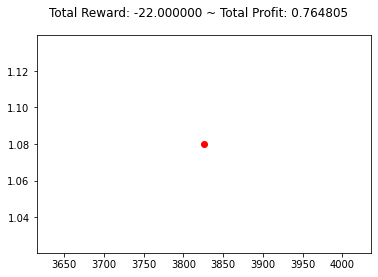

{'total_reward': -20.000000000004462, 'total_profit': 0.7646628816568216, 'position': 0}


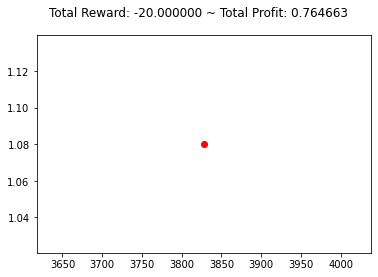

{'total_reward': -20.000000000004462, 'total_profit': 0.7646628816568216, 'position': 0}


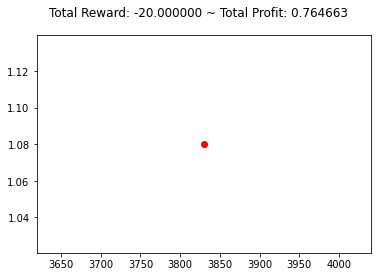

{'total_reward': -20.000000000004462, 'total_profit': 0.7644504949662402, 'position': 1}


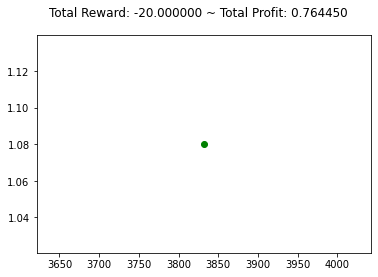

{'total_reward': -20.000000000004462, 'total_profit': 0.7644504949662402, 'position': 0}


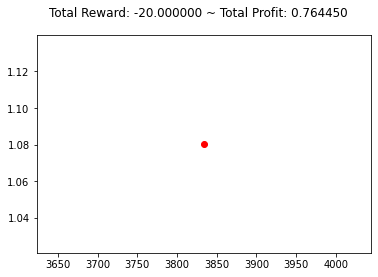

{'total_reward': -22.000000000004242, 'total_profit': 0.7640966809817145, 'position': 1}


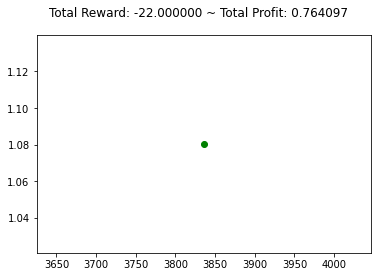

{'total_reward': -25.00000000000391, 'total_profit': 0.7640966809817145, 'position': 0}


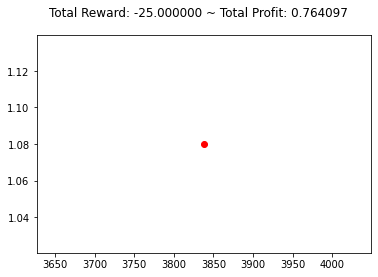

{'total_reward': -24.00000000000402, 'total_profit': 0.7638137084121444, 'position': 0}


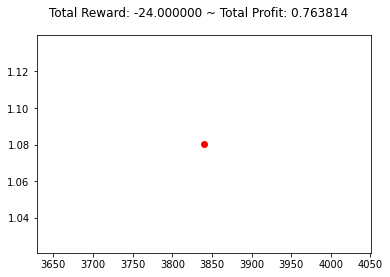

{'total_reward': -24.00000000000402, 'total_profit': 0.7636015968574618, 'position': 1}


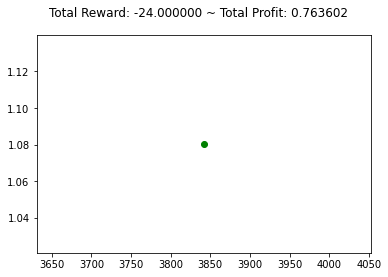

{'total_reward': -25.00000000000391, 'total_profit': 0.76346018915434, 'position': 1}


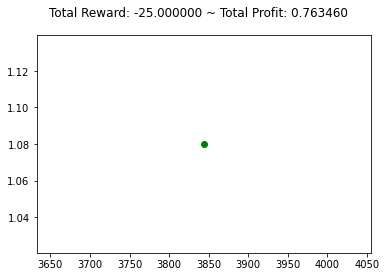

{'total_reward': -25.00000000000391, 'total_profit': 0.76346018915434, 'position': 1}


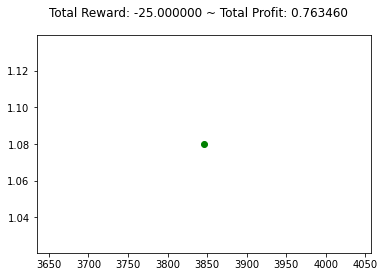

{'total_reward': -27.00000000000369, 'total_profit': 0.76346018915434, 'position': 0}


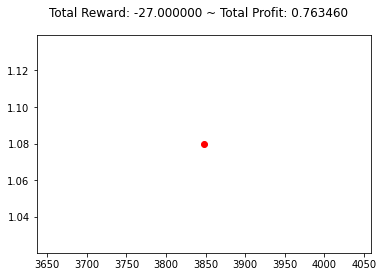

{'total_reward': -27.00000000000369, 'total_profit': 0.76346018915434, 'position': 0}


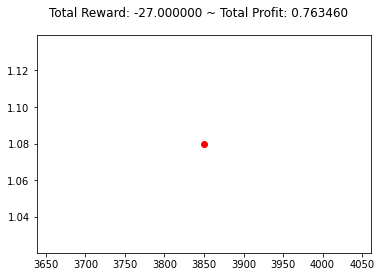

{'total_reward': -27.00000000000369, 'total_profit': 0.76346018915434, 'position': 0}


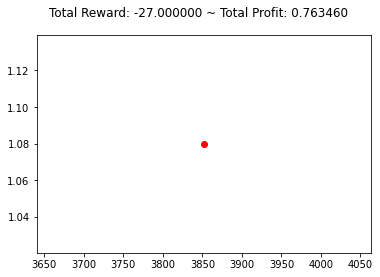

{'total_reward': -27.00000000000369, 'total_profit': 0.7632480775996574, 'position': 0}


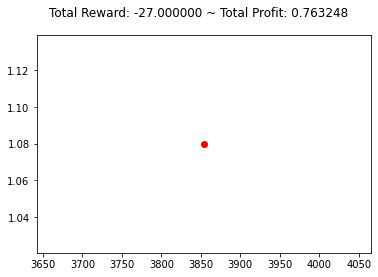

{'total_reward': -27.00000000000369, 'total_profit': 0.7632480775996574, 'position': 0}


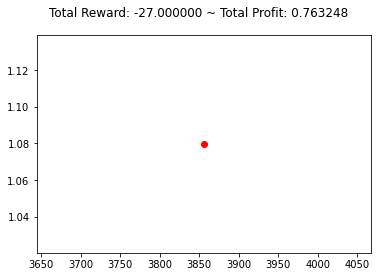

{'total_reward': -23.00000000000191, 'total_profit': 0.7633187880015104, 'position': 1}


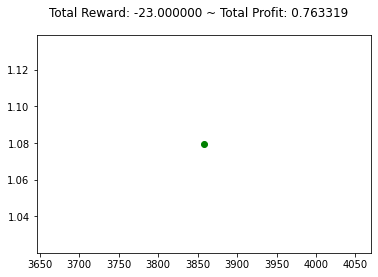

{'total_reward': -16.99999999999813, 'total_profit': 0.7633187880015107, 'position': 1}


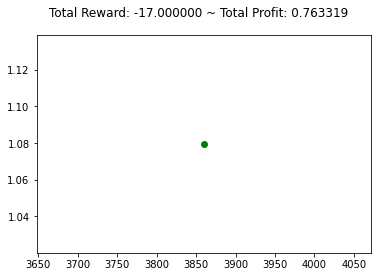

{'total_reward': -19.9999999999978, 'total_profit': 0.7633187880015107, 'position': 0}


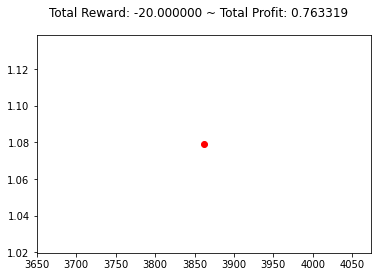

{'total_reward': -19.9999999999978, 'total_profit': 0.7633187880015107, 'position': 0}


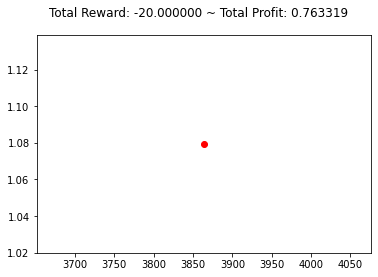

{'total_reward': -19.9999999999978, 'total_profit': 0.7633187880015107, 'position': 0}


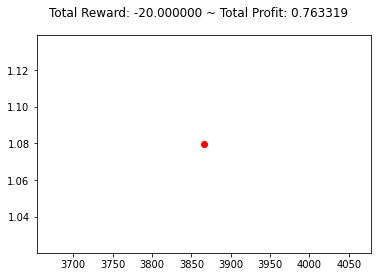

{'total_reward': -20.99999999999769, 'total_profit': 0.7630358677687451, 'position': 1}


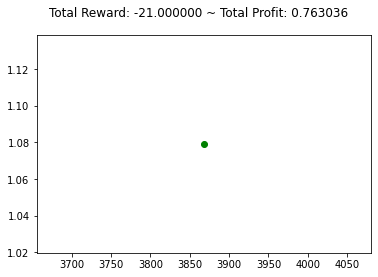

{'total_reward': -21.99999999999758, 'total_profit': 0.7630358677687451, 'position': 0}


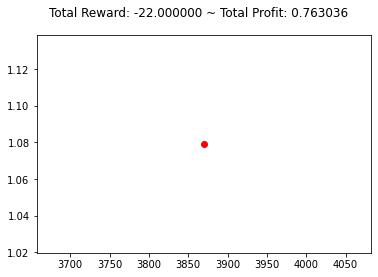

{'total_reward': -24.99999999999725, 'total_profit': 0.7626117233175118, 'position': 1}


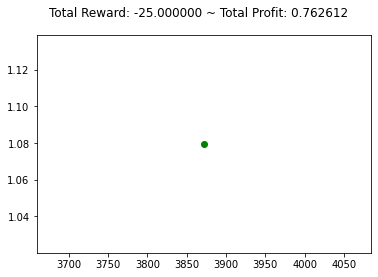

{'total_reward': -24.99999999999725, 'total_profit': 0.7626117233175118, 'position': 1}


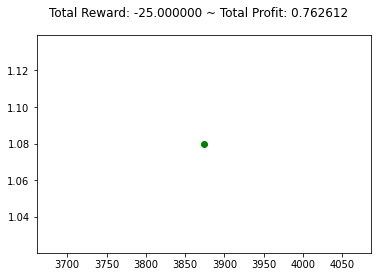

{'total_reward': -23.99999999999736, 'total_profit': 0.7624704073306097, 'position': 1}


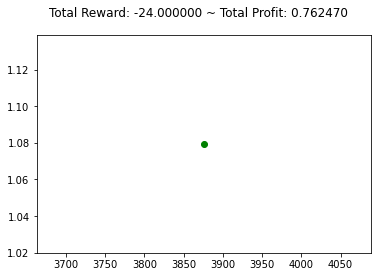

{'total_reward': -23.99999999999736, 'total_profit': 0.7624704073306097, 'position': 1}


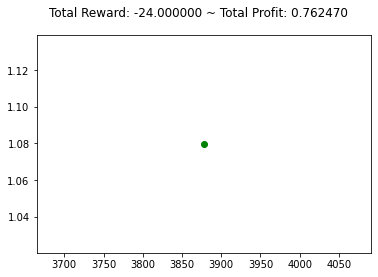

{'total_reward': -17.9999999999958, 'total_profit': 0.7624704073306097, 'position': 0}


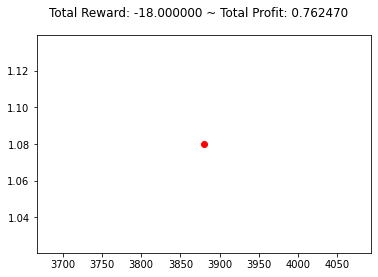

{'total_reward': -21.99999999999536, 'total_profit': 0.7621174444534082, 'position': 0}


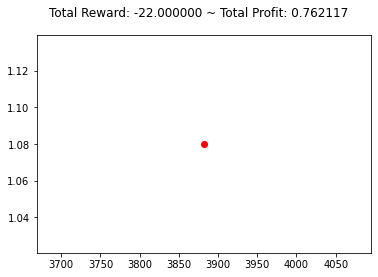

{'total_reward': -20.99999999999547, 'total_profit': 0.7619762854527686, 'position': 1}


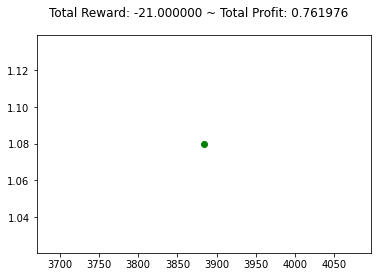

{'total_reward': -19.99999999999558, 'total_profit': 0.7619762854527686, 'position': 0}


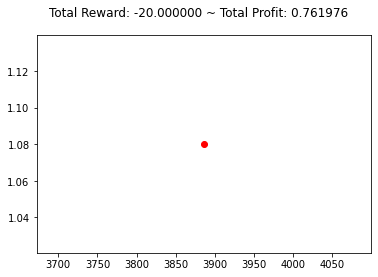

{'total_reward': -21.99999999999536, 'total_profit': 0.7617646057735059, 'position': 0}


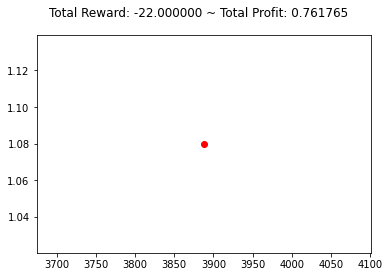

{'total_reward': -21.99999999999536, 'total_profit': 0.7617646057735059, 'position': 0}


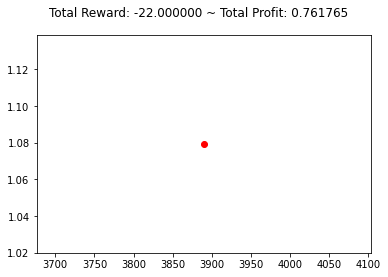

{'total_reward': -16.99999999999369, 'total_profit': 0.7619057778650133, 'position': 1}


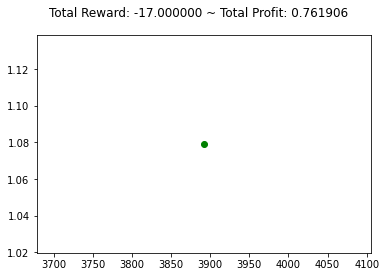

{'total_reward': -17.99999999999358, 'total_profit': 0.7619057778650133, 'position': 0}


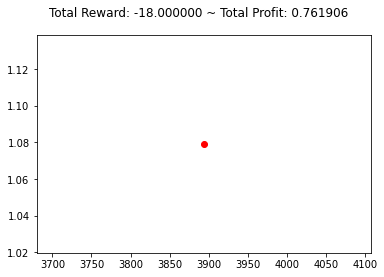

{'total_reward': -15.9999999999938, 'total_profit': 0.7617645534390884, 'position': 0}


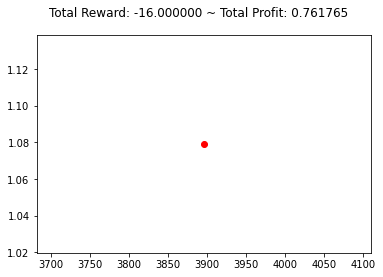

{'total_reward': -16.99999999999369, 'total_profit': 0.7614822092754713, 'position': 1}


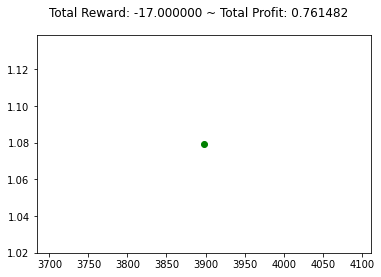

{'total_reward': -16.99999999999369, 'total_profit': 0.7612705296398313, 'position': 1}


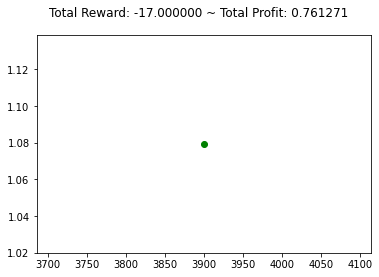

{'total_reward': -19.99999999999336, 'total_profit': 0.7612705296398313, 'position': 0}


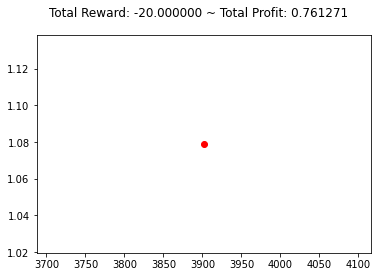

{'total_reward': -19.99999999999336, 'total_profit': 0.7612705296398313, 'position': 0}


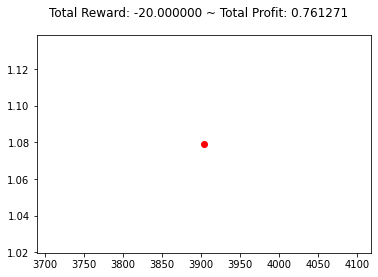

{'total_reward': -20.99999999999325, 'total_profit': 0.760988316283153, 'position': 1}


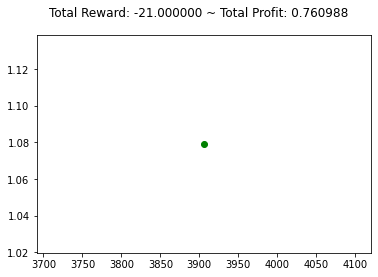

{'total_reward': -21.99999999999314, 'total_profit': 0.7606357783806778, 'position': 1}


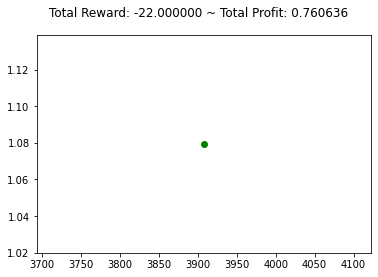

{'total_reward': -21.99999999999314, 'total_profit': 0.7606357783806778, 'position': 1}


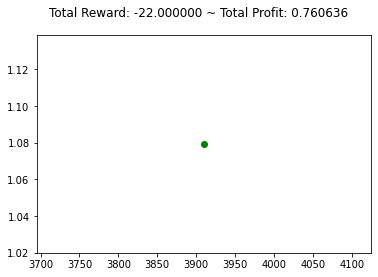

{'total_reward': -21.99999999999314, 'total_profit': 0.7606357783806778, 'position': 1}


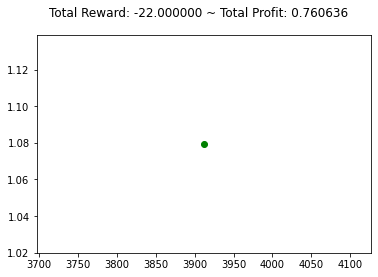

{'total_reward': -21.99999999999314, 'total_profit': 0.7604243536299002, 'position': 1}


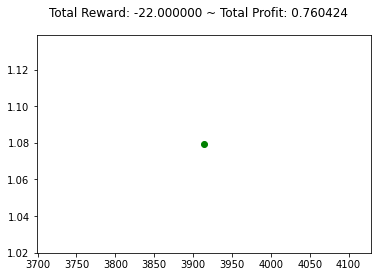

{'total_reward': -20.99999999999325, 'total_profit': 0.7604243536299002, 'position': 0}


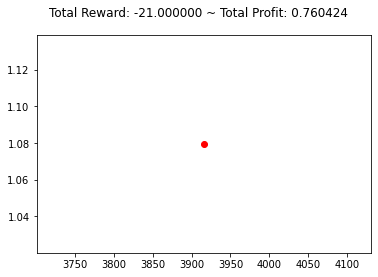

{'total_reward': -26.99999999999703, 'total_profit': 0.7600017782736179, 'position': 0}


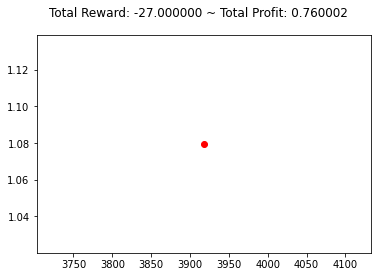

{'total_reward': -26.99999999999703, 'total_profit': 0.7600017782736179, 'position': 0}


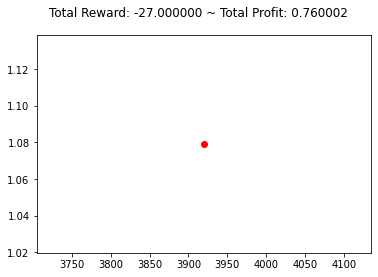

{'total_reward': -20.99999999999769, 'total_profit': 0.7600017782736179, 'position': 0}


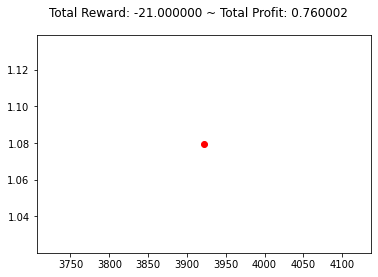

{'total_reward': -20.99999999999769, 'total_profit': 0.7600017782736179, 'position': 0}


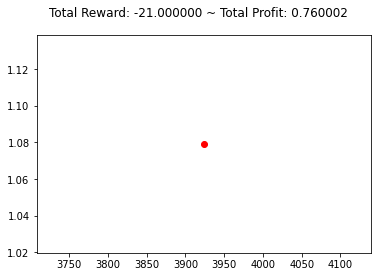

{'total_reward': -18.99999999999791, 'total_profit': 0.7599313555736296, 'position': 1}


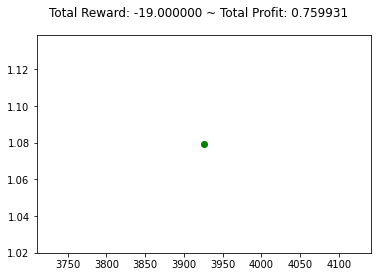

{'total_reward': -17.99999999999802, 'total_profit': 0.7599313555736296, 'position': 0}


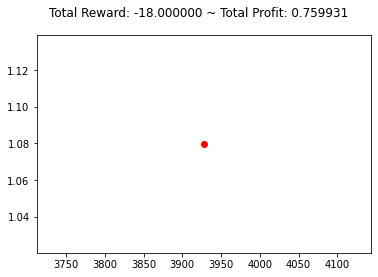

{'total_reward': -20.99999999999769, 'total_profit': 0.7595090150647891, 'position': 1}


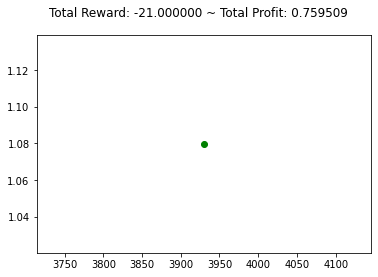

{'total_reward': -20.99999999999769, 'total_profit': 0.7595090150647891, 'position': 1}


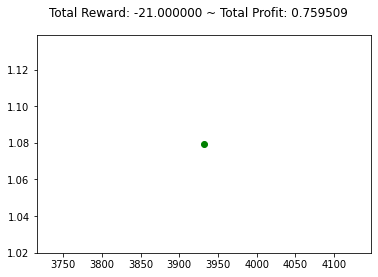

{'total_reward': -24.99999999999725, 'total_profit': 0.7591572602412133, 'position': 1}


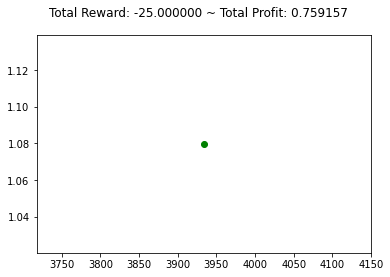

{'total_reward': -24.99999999999725, 'total_profit': 0.7591572602412133, 'position': 0}


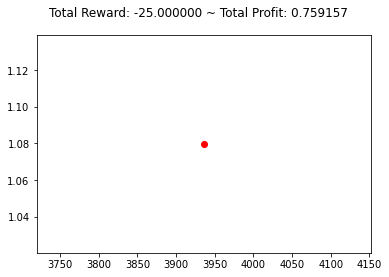

{'total_reward': -29.00000000000125, 'total_profit': 0.758805733449103, 'position': 0}


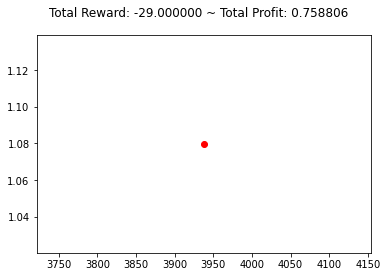

{'total_reward': -29.00000000000125, 'total_profit': 0.758805733449103, 'position': 0}


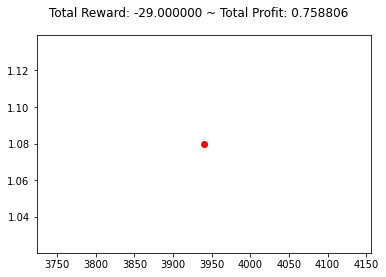

{'total_reward': -29.00000000000125, 'total_profit': 0.7585948759833427, 'position': 1}


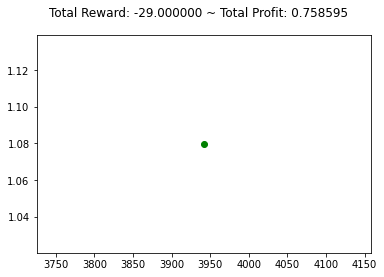

{'total_reward': -29.00000000000125, 'total_profit': 0.7585948759833427, 'position': 1}


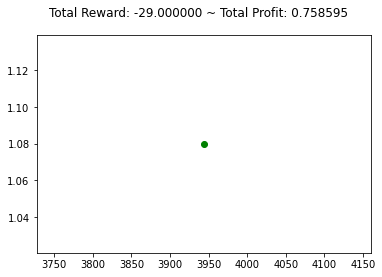

{'total_reward': -33.00000000000081, 'total_profit': 0.7582435445291082, 'position': 1}


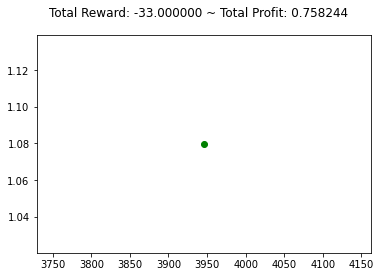

{'total_reward': -31.00000000000103, 'total_profit': 0.7581732977675251, 'position': 1}


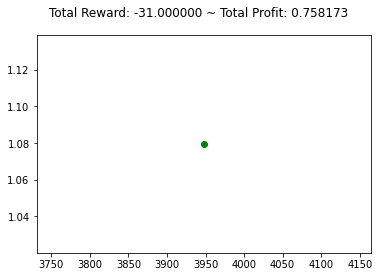

{'total_reward': -31.00000000000103, 'total_profit': 0.7581732977675251, 'position': 1}


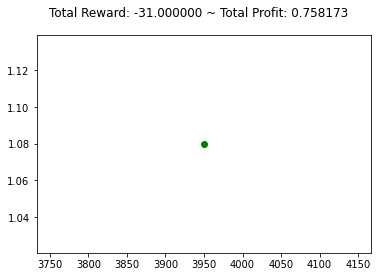

{'total_reward': -27.99999999999914, 'total_profit': 0.75796263555642, 'position': 1}


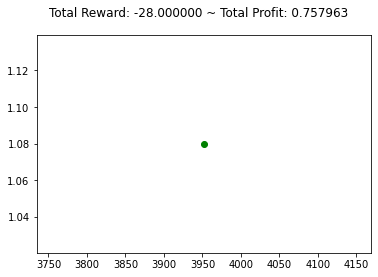

{'total_reward': -27.99999999999914, 'total_profit': 0.75796263555642, 'position': 1}


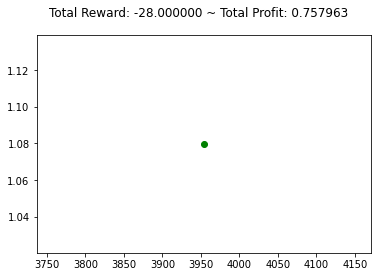

{'total_reward': -27.00000000000147, 'total_profit': 0.7578924148193849, 'position': 1}


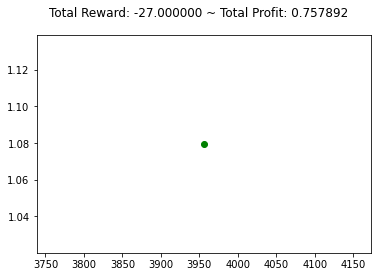

{'total_reward': -26.0000000000038, 'total_profit': 0.7576116359308714, 'position': 1}


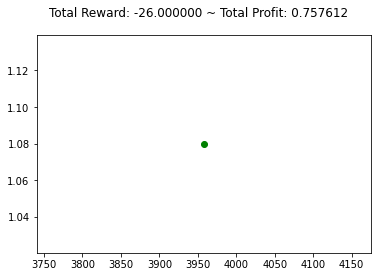

{'total_reward': -26.0000000000038, 'total_profit': 0.7576116359308714, 'position': 0}


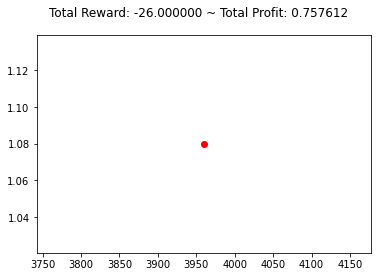

{'total_reward': -26.0000000000038, 'total_profit': 0.7574011297802933, 'position': 1}


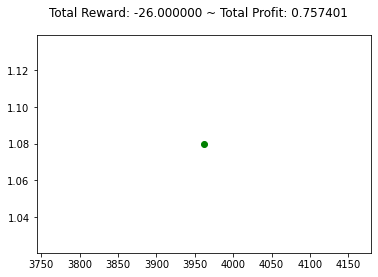

{'total_reward': -29.00000000000569, 'total_profit': 0.7571906236297151, 'position': 1}


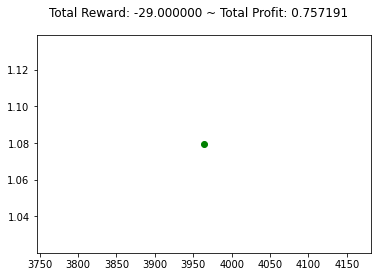

{'total_reward': -31.00000000000547, 'total_profit': 0.7568399425331842, 'position': 1}


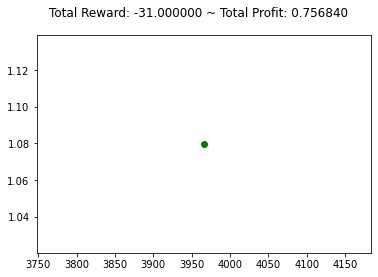

{'total_reward': -31.00000000000547, 'total_profit': 0.7568399425331842, 'position': 1}


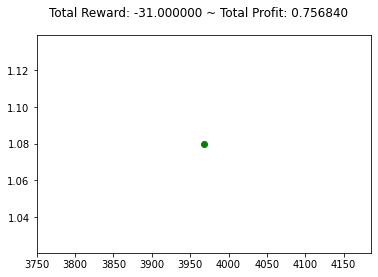

{'total_reward': -29.00000000000347, 'total_profit': 0.7568399425331842, 'position': 0}


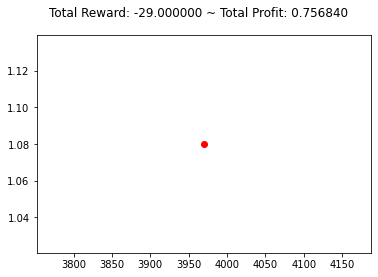

{'total_reward': -29.00000000000347, 'total_profit': 0.7568399425331842, 'position': 0}


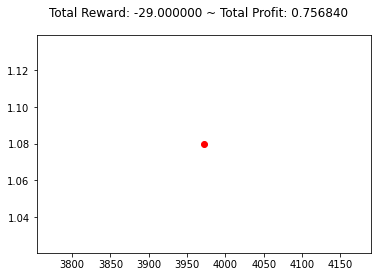

{'total_reward': -29.00000000000347, 'total_profit': 0.7568399425331842, 'position': 0}


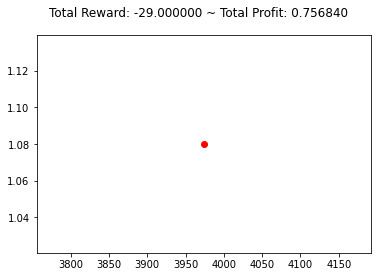

{'total_reward': -32.00000000000314, 'total_profit': 0.7564895536709003, 'position': 0}


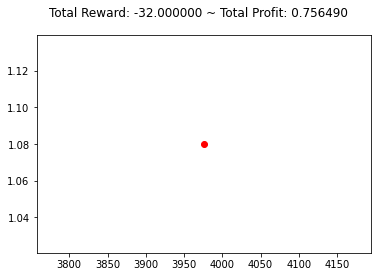

{'total_reward': -32.00000000000314, 'total_profit': 0.7564895536709003, 'position': 0}


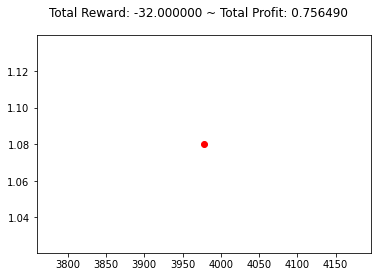

{'total_reward': -32.00000000000314, 'total_profit': 0.7564895536709003, 'position': 0}


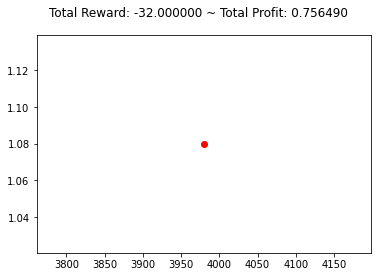

{'total_reward': -32.00000000000314, 'total_profit': 0.756279398224932, 'position': 1}


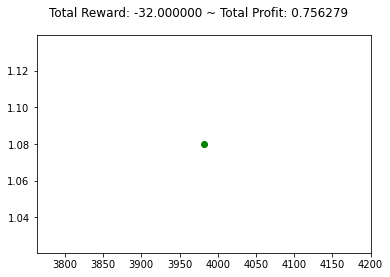

{'total_reward': -30.00000000000336, 'total_profit': 0.756279398224932, 'position': 0}


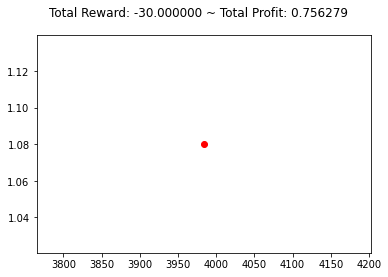

{'total_reward': -29.00000000000347, 'total_profit': 0.75613934648452, 'position': 1}


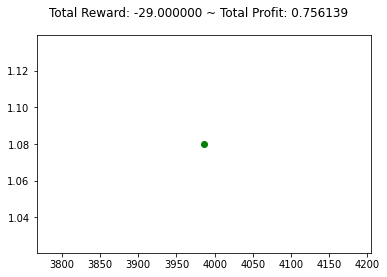

{'total_reward': -29.00000000000347, 'total_profit': 0.75613934648452, 'position': 1}


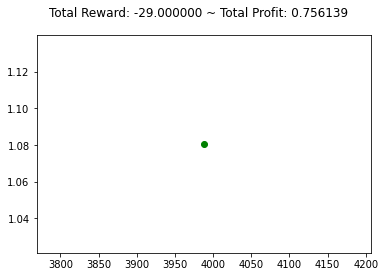

{'total_reward': -29.00000000000347, 'total_profit': 0.75613934648452, 'position': 1}


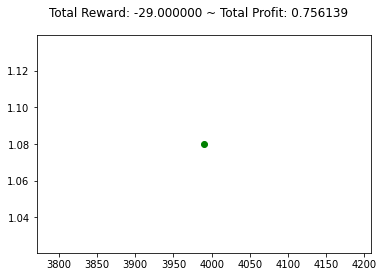

{'total_reward': -29.00000000000347, 'total_profit': 0.7559293077771632, 'position': 1}


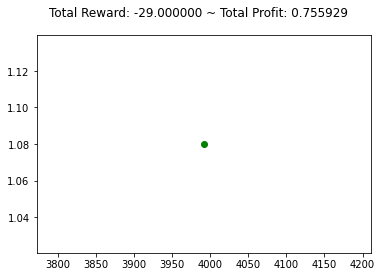

{'total_reward': -29.00000000000347, 'total_profit': 0.7559293077771632, 'position': 1}


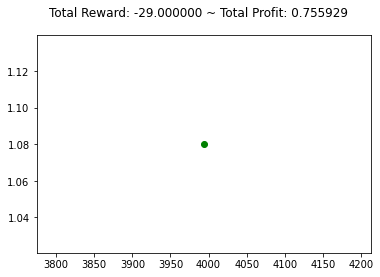

{'total_reward': -29.00000000000347, 'total_profit': 0.7559293077771632, 'position': 1}


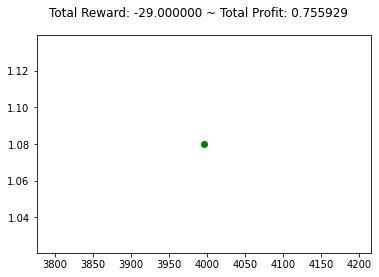

{'total_reward': -30.00000000000336, 'total_profit': 0.7556493598805696, 'position': 1}


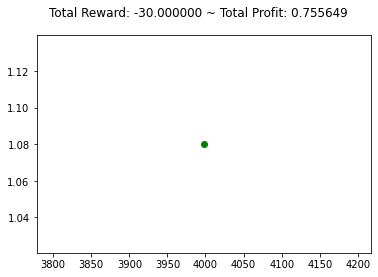

{'total_reward': -28.00000000000358, 'total_profit': 0.7554395155706888, 'position': 1}


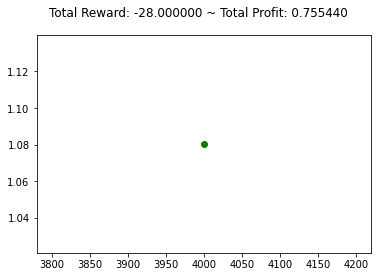

{'total_reward': -30.00000000000336, 'total_profit': 0.7554395155706888, 'position': 0}


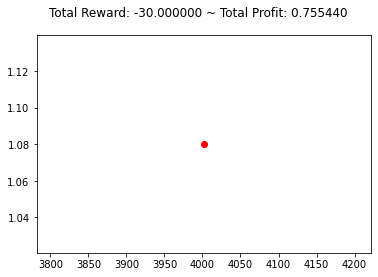

{'total_reward': -30.00000000000336, 'total_profit': 0.7554395155706888, 'position': 0}


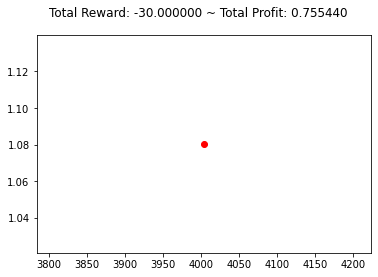

{'total_reward': -29.00000000000347, 'total_profit': 0.7552996193641016, 'position': 1}


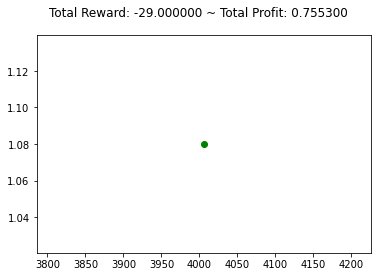

{'total_reward': -28.00000000000358, 'total_profit': 0.7552996193641016, 'position': 0}


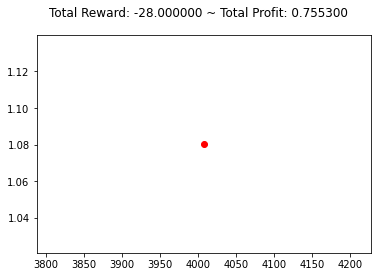

{'total_reward': -28.00000000000358, 'total_profit': 0.7552996193641016, 'position': 0}


{'total_reward': -29.00000000000347, 'total_profit': 0.7550898333389102, 'position': 0}


{'total_reward': -29.00000000000347, 'total_profit': 0.7548800861629827, 'position': 1}


{'total_reward': -28.00000000000358, 'total_profit': 0.7548800861629827, 'position': 0}


{'total_reward': -28.00000000000358, 'total_profit': 0.7546704166640023, 'position': 0}


{'total_reward': -28.00000000000358, 'total_profit': 0.7544608054011569, 'position': 1}


{'total_reward': -32.00000000000314, 'total_profit': 0.7539720293125121, 'position': 1}


{'total_reward': -33.00000000000303, 'total_profit': 0.7537626701781232, 'position': 1}


{'total_reward': -32.00000000000314, 'total_profit': 0.7537626701781232, 'position': 0}


{'total_reward': -33.00000000000303, 'total_profit': 0.7534836538278814, 'position': 1}


{'total_reward': -35.00000000000281, 'total_profit': 0.7534836538278814, 'position': 0}


{'total_reward': -38.00000000000247, 'total_profit': 0.7530653229383684, 'position': 1}


{'total_reward': -38.00000000000247, 'total_profit': 0.7530653229383684, 'position': 0}


{'total_reward': -38.00000000000247, 'total_profit': 0.7528562736213688, 'position': 1}


{'total_reward': -35.0000000000028, 'total_profit': 0.7528562736213688, 'position': 0}


{'total_reward': -35.0000000000028, 'total_profit': 0.7528562736213688, 'position': 0}


{'total_reward': -35.0000000000028, 'total_profit': 0.7526473403354423, 'position': 0}


{'total_reward': -33.00000000000302, 'total_profit': 0.7525777023505852, 'position': 1}


{'total_reward': -33.00000000000302, 'total_profit': 0.7525777023505852, 'position': 1}


{'total_reward': -29.00000000000346, 'total_profit': 0.7525777023505852, 'position': 0}


{'total_reward': -30.00000000000335, 'total_profit': 0.7522993049761838, 'position': 1}


{'total_reward': -30.00000000000335, 'total_profit': 0.7522993049761838, 'position': 1}


{'total_reward': -31.00000000000324, 'total_profit': 0.7522993049761838, 'position': 0}


{'total_reward': -30.00000000000335, 'total_profit': 0.7521601320402896, 'position': 1}


{'total_reward': -30.00000000000335, 'total_profit': 0.7521601320402896, 'position': 1}


{'total_reward': -26.00000000000379, 'total_profit': 0.7519514884530385, 'position': 1}


{'total_reward': -26.00000000000379, 'total_profit': 0.7518124055919541, 'position': 1}


{'total_reward': -28.00000000000357, 'total_profit': 0.7516037813003275, 'position': 1}


{'total_reward': -28.00000000000357, 'total_profit': 0.7516037813003275, 'position': 1}


{'total_reward': -28.00000000000357, 'total_profit': 0.7516037813003275, 'position': 1}


{'total_reward': -26.00000000000379, 'total_profit': 0.7514647370340616, 'position': 1}


{'total_reward': -26.00000000000379, 'total_profit': 0.7514647370340616, 'position': 1}


{'total_reward': -17.00000000000256, 'total_profit': 0.7514647370340616, 'position': 0}


{'total_reward': -15.000000000002782, 'total_profit': 0.7513952727396417, 'position': 1}


{'total_reward': -15.000000000002782, 'total_profit': 0.7513952727396417, 'position': 1}


{'total_reward': -14.000000000002892, 'total_profit': 0.7513952727396417, 'position': 0}


{'total_reward': -13.000000000003002, 'total_profit': 0.7511869183798839, 'position': 0}


{'total_reward': -11.000000000003222, 'total_profit': 0.7510480539897593, 'position': 0}


{'total_reward': -11.000000000003222, 'total_profit': 0.7510480539897593, 'position': 0}


{'total_reward': -11.000000000003222, 'total_profit': 0.7508398151577843, 'position': 1}


{'total_reward': -11.000000000003222, 'total_profit': 0.7508398151577843, 'position': 1}


{'total_reward': -14.000000000002892, 'total_profit': 0.7508398151577843, 'position': 0}


{'total_reward': -14.000000000002892, 'total_profit': 0.7508398151577843, 'position': 0}


{'total_reward': -14.000000000002892, 'total_profit': 0.7508398151577843, 'position': 0}


{'total_reward': -14.000000000002892, 'total_profit': 0.7508398151577843, 'position': 0}


{'total_reward': -17.00000000000256, 'total_profit': 0.7504234529682329, 'position': 1}


{'total_reward': -17.00000000000256, 'total_profit': 0.7504234529682329, 'position': 1}


{'total_reward': -17.00000000000256, 'total_profit': 0.7504234529682329, 'position': 1}


{'total_reward': -17.00000000000256, 'total_profit': 0.7504234529682329, 'position': 1}


{'total_reward': -18.00000000000245, 'total_profit': 0.7504234529682329, 'position': 0}


{'total_reward': -19.00000000000234, 'total_profit': 0.750146032098374, 'position': 0}


{'total_reward': -16.00000000000267, 'total_profit': 0.7499380433648902, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.749453184557875, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7492454839062654, 'position': 1}


{'total_reward': -20.00000000000223, 'total_profit': 0.7492454839062654, 'position': 0}


{'total_reward': -20.00000000000223, 'total_profit': 0.7492454839062654, 'position': 0}


{'total_reward': -27.00000000000146, 'total_profit': 0.7487612517589712, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7487612517589712, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.748553781198772, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7483463681255665, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.748139012523426, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7479317143764258, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7477244736686463, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7477244736686463, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7477244736686463, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7475172903841717, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7475172903841717, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7475172903841717, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7473101645070911, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7471030960214976, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.746896084911489, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.746896084911489, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.746896084911489, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.746896084911489, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.746896084911489, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7466891311611671, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7466891311611671, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7466891311611671, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7466891311611671, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7464822347546387, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7464822347546387, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7462753956760145, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7460686139094099, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7458618894389446, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7458618894389446, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7458618894389446, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7458618894389446, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7458618894389446, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7458618894389446, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7456552222487427, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7456552222487427, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7454486123229326, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7452420596456473, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7452420596456473, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7450355642010239, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7450355642010239, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7450355642010239, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7448291259732043, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7448291259732043, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7448291259732043, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7446227449463344, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7446227449463344, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7446227449463344, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7446227449463344, 'position': 0}


{'total_reward': -15.000000000002782, 'total_profit': 0.7448980213769985, 'position': 1}


{'total_reward': -15.000000000002782, 'total_profit': 0.7448980213769985, 'position': 1}


{'total_reward': -15.000000000002782, 'total_profit': 0.7448980213769985, 'position': 1}


{'total_reward': -15.000000000002782, 'total_profit': 0.7448980213769985, 'position': 1}


{'total_reward': -12.000000000003112, 'total_profit': 0.744691544978206, 'position': 1}


{'total_reward': -12.000000000003112, 'total_profit': 0.744691544978206, 'position': 1}


{'total_reward': -12.000000000003112, 'total_profit': 0.744691544978206, 'position': 1}


{'total_reward': -14.000000000002892, 'total_profit': 0.744691544978206, 'position': 0}


{'total_reward': -14.000000000002892, 'total_profit': 0.7444850876604965, 'position': 1}


{'total_reward': -15.000000000002782, 'total_profit': 0.7444850876604965, 'position': 0}


{'total_reward': -15.000000000002782, 'total_profit': 0.744278668504953, 'position': 0}


{'total_reward': -15.000000000002782, 'total_profit': 0.744278668504953, 'position': 0}


{'total_reward': -15.000000000002782, 'total_profit': 0.7440723065820773, 'position': 1}


{'total_reward': -14.000000000002892, 'total_profit': 0.7440723065820773, 'position': 0}


{'total_reward': -14.000000000002892, 'total_profit': 0.7438660209412173, 'position': 1}


{'total_reward': -13.000000000003002, 'total_profit': 0.7437285226009325, 'position': 1}


{'total_reward': -13.000000000003002, 'total_profit': 0.7437285226009325, 'position': 0}


{'total_reward': -13.000000000003002, 'total_profit': 0.7437285226009325, 'position': 0}


{'total_reward': -14.000000000002892, 'total_profit': 0.7434536021600856, 'position': 1}


{'total_reward': -14.000000000002892, 'total_profit': 0.7434536021600856, 'position': 0}


{'total_reward': -14.000000000002892, 'total_profit': 0.7434536021600856, 'position': 0}


{'total_reward': -13.000000000003002, 'total_profit': 0.7433161800524775, 'position': 1}


{'total_reward': -14.000000000002892, 'total_profit': 0.7431100659439501, 'position': 1}


{'total_reward': -13.000000000003002, 'total_profit': 0.7431100659439501, 'position': 0}


{'total_reward': -14.000000000002892, 'total_profit': 0.7428353741165982, 'position': 0}


{'total_reward': -17.00000000000256, 'total_profit': 0.7424236028449149, 'position': 1}


{'total_reward': -17.00000000000256, 'total_profit': 0.7424236028449149, 'position': 1}


{'total_reward': -17.00000000000256, 'total_profit': 0.7424236028449149, 'position': 0}


{'total_reward': -16.00000000000267, 'total_profit': 0.7422178313363659, 'position': 0}


{'total_reward': -15.000000000002782, 'total_profit': 0.7420806883520096, 'position': 1}


{'total_reward': -15.000000000002782, 'total_profit': 0.7420806883520096, 'position': 1}


{'total_reward': -21.00000000000212, 'total_profit': 0.7420806883520096, 'position': 0}


{'total_reward': -21.00000000000212, 'total_profit': 0.7420806883520096, 'position': 0}


{'total_reward': -23.0000000000019, 'total_profit': 0.7417377675163571, 'position': 1}


{'total_reward': -24.00000000000179, 'total_profit': 0.7415320910857676, 'position': 1}


{'total_reward': -25.00000000000168, 'total_profit': 0.7415320910857676, 'position': 0}


{'total_reward': -24.00000000000179, 'total_profit': 0.7413949861414973, 'position': 1}


{'total_reward': -24.00000000000179, 'total_profit': 0.7411893667499448, 'position': 1}


{'total_reward': -24.00000000000179, 'total_profit': 0.7409838043851257, 'position': 1}


{'total_reward': -25.00000000000168, 'total_profit': 0.7407098225754067, 'position': 1}


{'total_reward': -25.00000000000168, 'total_profit': 0.7405044121975434, 'position': 1}


{'total_reward': -26.00000000000157, 'total_profit': 0.7402990397988569, 'position': 1}


{'total_reward': -26.00000000000157, 'total_profit': 0.7402990397988569, 'position': 1}


{'total_reward': -25.00000000000168, 'total_profit': 0.7402990397988569, 'position': 0}


{'total_reward': -24.00000000000179, 'total_profit': 0.7401621628385538, 'position': 1}


{'total_reward': -24.00000000000179, 'total_profit': 0.7401621628385538, 'position': 0}


{'total_reward': -24.00000000000179, 'total_profit': 0.7399568853597228, 'position': 0}


{'total_reward': -20.9999999999999, 'total_profit': 0.7399568853597229, 'position': 1}


{'total_reward': -20.9999999999999, 'total_profit': 0.7399568853597229, 'position': 0}


{'total_reward': -21.99999999999979, 'total_profit': 0.7396832073623638, 'position': 0}


{'total_reward': -21.99999999999979, 'total_profit': 0.7396832073623638, 'position': 0}


{'total_reward': -21.99999999999979, 'total_profit': 0.7394780247805712, 'position': 0}


{'total_reward': -24.00000000000179, 'total_profit': 0.7391362118819945, 'position': 1}


{'total_reward': -22.00000000000201, 'total_profit': 0.7391362118819945, 'position': 0}


{'total_reward': -22.00000000000201, 'total_profit': 0.7391362118819945, 'position': 0}


{'total_reward': -20.00000000000223, 'total_profit': 0.7390678809018816, 'position': 1}


{'total_reward': -20.00000000000223, 'total_profit': 0.7390678809018816, 'position': 1}


{'total_reward': -18.00000000000245, 'total_profit': 0.7387946832747114, 'position': 1}


{'total_reward': -18.00000000000245, 'total_profit': 0.7387946832747114, 'position': 1}


{'total_reward': -15.000000000002782, 'total_profit': 0.7385899175642694, 'position': 1}


{'total_reward': -15.000000000002782, 'total_profit': 0.7383852086070731, 'position': 1}


{'total_reward': -18.00000000000245, 'total_profit': 0.7383852086070731, 'position': 0}


{'total_reward': -18.00000000000245, 'total_profit': 0.7383852086070731, 'position': 0}


{'total_reward': -20.00000000000223, 'total_profit': 0.7380440900592551, 'position': 1}


{'total_reward': -20.00000000000223, 'total_profit': 0.7380440900592551, 'position': 0}


{'total_reward': -20.00000000000223, 'total_profit': 0.7378395134843518, 'position': 1}


{'total_reward': -11.000000000003222, 'total_profit': 0.7377713716748316, 'position': 1}


{'total_reward': -12.000000000003112, 'total_profit': 0.7377713716748316, 'position': 0}


{'total_reward': -11.000000000003222, 'total_profit': 0.7376350754672435, 'position': 1}


{'total_reward': -11.000000000003222, 'total_profit': 0.7376350754672435, 'position': 0}


{'total_reward': -12.000000000003112, 'total_profit': 0.7373625585833542, 'position': 1}


{'total_reward': -12.000000000003112, 'total_profit': 0.7373625585833542, 'position': 1}


{'total_reward': -11.000000000003222, 'total_profit': 0.7373625585833542, 'position': 0}


{'total_reward': -16.00000000000267, 'total_profit': 0.7368180279391499, 'position': 1}


{'total_reward': -21.00000000000212, 'total_profit': 0.7368180279391499, 'position': 0}


{'total_reward': -21.00000000000212, 'total_profit': 0.7366138855228387, 'position': 1}


{'total_reward': -21.00000000000212, 'total_profit': 0.7366138855228387, 'position': 0}


{'total_reward': -29.00000000000124, 'total_profit': 0.7361378610399492, 'position': 0}


{'total_reward': -31.00000000000102, 'total_profit': 0.7357980005316205, 'position': 1}


{'total_reward': -33.000000000000796, 'total_profit': 0.7357980005316205, 'position': 0}


{'total_reward': -36.00000000000047, 'total_profit': 0.7353903938468094, 'position': 0}


{'total_reward': -36.00000000000047, 'total_profit': 0.7353903938468094, 'position': 0}


{'total_reward': -35.00000000000058, 'total_profit': 0.735254587679894, 'position': 0}


{'total_reward': -36.00000000000047, 'total_profit': 0.7349830505779903, 'position': 1}


{'total_reward': -38.00000000000024, 'total_profit': 0.7347116137575387, 'position': 1}


{'total_reward': -36.00000000000047, 'total_profit': 0.7345759454695214, 'position': 1}


{'total_reward': -37.000000000000355, 'total_profit': 0.7345759454695214, 'position': 0}


{'total_reward': -37.000000000000355, 'total_profit': 0.7345759454695214, 'position': 0}


{'total_reward': -37.000000000000355, 'total_profit': 0.7345759454695214, 'position': 0}


{'total_reward': -39.00000000000013, 'total_profit': 0.7343046589971849, 'position': 0}


{'total_reward': -41.9999999999998, 'total_profit': 0.7339657074374558, 'position': 0}


{'total_reward': -40.999999999999915, 'total_profit': 0.7338301643705237, 'position': 1}


{'total_reward': -40.999999999999915, 'total_profit': 0.7338301643705237, 'position': 1}


{'total_reward': -40.999999999999915, 'total_profit': 0.7338301643705237, 'position': 1}


{'total_reward': -42.999999999999694, 'total_profit': 0.7338301643705237, 'position': 0}


{'total_reward': -42.999999999999694, 'total_profit': 0.7336268497701256, 'position': 1}


{'total_reward': -42.999999999999694, 'total_profit': 0.7336268497701256, 'position': 0}


{'total_reward': -44.999999999999474, 'total_profit': 0.7332881485467784, 'position': 0}


{'total_reward': -44.999999999999474, 'total_profit': 0.7332881485467784, 'position': 0}


{'total_reward': -44.999999999999474, 'total_profit': 0.7332881485467784, 'position': 0}


{'total_reward': -41.9999999999998, 'total_profit': 0.7332881485467784, 'position': 1}


{'total_reward': -41.9999999999998, 'total_profit': 0.7332881485467784, 'position': 0}


{'total_reward': -41.9999999999998, 'total_profit': 0.7332881485467784, 'position': 0}


{'total_reward': -41.9999999999998, 'total_profit': 0.7330849653523903, 'position': 1}


{'total_reward': -42.99999999999969, 'total_profit': 0.7330849653523903, 'position': 0}


{'total_reward': -44.99999999999947, 'total_profit': 0.7327464517924751, 'position': 1}


{'total_reward': -44.999999999999474, 'total_profit': 0.7326110838907954, 'position': 1}


{'total_reward': -45.99999999999936, 'total_profit': 0.7323404231042836, 'position': 1}


{'total_reward': -45.99999999999936, 'total_profit': 0.7321375025104615, 'position': 1}


{'total_reward': -45.99999999999936, 'total_profit': 0.7321375025104615, 'position': 1}


{'total_reward': -45.99999999999936, 'total_profit': 0.7321375025104615, 'position': 1}


{'total_reward': -45.99999999999936, 'total_profit': 0.7321375025104615, 'position': 1}


{'total_reward': -47.99999999999914, 'total_profit': 0.7321375025104615, 'position': 0}


{'total_reward': -48.999999999999034, 'total_profit': 0.7318669917022181, 'position': 0}


{'total_reward': -48.999999999999034, 'total_profit': 0.7316641835574642, 'position': 1}


{'total_reward': -48.999999999999034, 'total_profit': 0.7316641835574642, 'position': 1}


{'total_reward': -51.99999999999871, 'total_profit': 0.7313938226582283, 'position': 1}


{'total_reward': -51.99999999999871, 'total_profit': 0.7313938226582283, 'position': 1}


{'total_reward': -51.99999999999871, 'total_profit': 0.7313938226582283, 'position': 0}


{'total_reward': -49.99999999999893, 'total_profit': 0.7313262449235283, 'position': 1}


{'total_reward': -49.99999999999893, 'total_profit': 0.7313262449235283, 'position': 1}


{'total_reward': -49.99999999999893, 'total_profit': 0.7313262449235283, 'position': 1}


{'total_reward': -47.99999999999915, 'total_profit': 0.7313262449235283, 'position': 0}


{'total_reward': -47.99999999999915, 'total_profit': 0.7313262449235283, 'position': 0}


{'total_reward': -47.99999999999915, 'total_profit': 0.7310560338594516, 'position': 0}


{'total_reward': -47.99999999999915, 'total_profit': 0.7310560338594516, 'position': 0}


{'total_reward': -46.99999999999926, 'total_profit': 0.7309209782463241, 'position': 1}


{'total_reward': -46.99999999999926, 'total_profit': 0.7309209782463241, 'position': 1}


{'total_reward': -44.99999999999948, 'total_profit': 0.7309209782463241, 'position': 0}


{'total_reward': -44.99999999999948, 'total_profit': 0.7309209782463241, 'position': 0}


{'total_reward': -44.99999999999948, 'total_profit': 0.7309209782463241, 'position': 0}


{'total_reward': -44.99999999999948, 'total_profit': 0.7307184696635074, 'position': 1}


{'total_reward': -42.9999999999997, 'total_profit': 0.7307184696635074, 'position': 0}


{'total_reward': -44.99999999999948, 'total_profit': 0.7303811734718237, 'position': 0}


{'total_reward': -44.99999999999948, 'total_profit': 0.7303811734718237, 'position': 0}


{'total_reward': -44.99999999999948, 'total_profit': 0.7303811734718237, 'position': 0}


{'total_reward': -44.99999999999948, 'total_profit': 0.7301788891734102, 'position': 1}


{'total_reward': -44.99999999999948, 'total_profit': 0.7301788891734102, 'position': 0}


{'total_reward': -44.99999999999948, 'total_profit': 0.7299766608990823, 'position': 1}


{'total_reward': -44.99999999999948, 'total_profit': 0.7299766608990823, 'position': 1}


{'total_reward': -44.99999999999948, 'total_profit': 0.7297744886333237, 'position': 1}


{'total_reward': -42.9999999999997, 'total_profit': 0.7296397444515229, 'position': 1}


{'total_reward': -40.99999999999993, 'total_profit': 0.729505025148633, 'position': 1}


{'total_reward': -40.99999999999993, 'total_profit': 0.729505025148633, 'position': 1}


{'total_reward': -39.00000000000015, 'total_profit': 0.729505025148633, 'position': 0}


{'total_reward': -38.000000000000256, 'total_profit': 0.7293030208034746, 'position': 0}


{'total_reward': -38.000000000000256, 'total_profit': 0.729101091033063, 'position': 1}


{'total_reward': -38.000000000000256, 'total_profit': 0.729101091033063, 'position': 0}


{'total_reward': -38.000000000000256, 'total_profit': 0.728899217173063, 'position': 0}


{'total_reward': -38.000000000000256, 'total_profit': 0.7286973992079944, 'position': 0}


{'total_reward': -37.00000000000037, 'total_profit': 0.7285628787355544, 'position': 0}


{'total_reward': -37.00000000000037, 'total_profit': 0.7283611352764251, 'position': 1}


{'total_reward': -37.00000000000037, 'total_profit': 0.7283611352764251, 'position': 0}


{'total_reward': -37.00000000000037, 'total_profit': 0.7281594476812775, 'position': 0}


{'total_reward': -38.000000000000256, 'total_profit': 0.7278906301648285, 'position': 1}


{'total_reward': -39.00000000000014, 'total_profit': 0.7278906301648285, 'position': 0}


{'total_reward': -39.00000000000014, 'total_profit': 0.7276890728553864, 'position': 1}


{'total_reward': -39.00000000000014, 'total_profit': 0.7276890728553864, 'position': 0}


{'total_reward': -39.00000000000014, 'total_profit': 0.7274875713583802, 'position': 1}


{'total_reward': -38.000000000000256, 'total_profit': 0.7272861442504822, 'position': 1}


{'total_reward': -38.000000000000256, 'total_profit': 0.7272861442504822, 'position': 1}


{'total_reward': -37.00000000000037, 'total_profit': 0.7271518843013868, 'position': 1}


{'total_reward': -37.00000000000037, 'total_profit': 0.7271518843013868, 'position': 0}


{'total_reward': -37.00000000000037, 'total_profit': 0.7271518843013868, 'position': 0}


{'total_reward': -45.000000000001705, 'total_profit': 0.7264141356639292, 'position': 1}


{'total_reward': -43.000000000001926, 'total_profit': 0.7264141356639292, 'position': 0}


{'total_reward': -43.000000000001926, 'total_profit': 0.7262131726975891, 'position': 1}


{'total_reward': -41.000000000002146, 'total_profit': 0.7262131726975891, 'position': 0}


{'total_reward': -41.000000000002146, 'total_profit': 0.7262131726975891, 'position': 0}


{'total_reward': -40.00000000000226, 'total_profit': 0.7260792468012871, 'position': 1}


{'total_reward': -39.00000000000237, 'total_profit': 0.7260792468012871, 'position': 0}


{'total_reward': -39.00000000000237, 'total_profit': 0.7258784135226218, 'position': 1}


{'total_reward': -41.00000000000215, 'total_profit': 0.7258784135226218, 'position': 0}


{'total_reward': -41.00000000000215, 'total_profit': 0.7256775987641778, 'position': 1}


{'total_reward': -40.00000000000226, 'total_profit': 0.7254768580729567, 'position': 1}


{'total_reward': -40.00000000000226, 'total_profit': 0.7254768580729567, 'position': 0}


{'total_reward': -40.00000000000226, 'total_profit': 0.7254768580729567, 'position': 0}


{'total_reward': -39.00000000000237, 'total_profit': 0.7253430556277202, 'position': 0}


{'total_reward': -40.00000000000226, 'total_profit': 0.725075524763496, 'position': 1}


{'total_reward': -42.00000000000204, 'total_profit': 0.7247412961635313, 'position': 1}


{'total_reward': -43.00000000000193, 'total_profit': 0.7247412961635313, 'position': 0}


{'total_reward': -43.00000000000193, 'total_profit': 0.7247412961635313, 'position': 0}


{'total_reward': -43.00000000000193, 'total_profit': 0.7245408329615683, 'position': 1}


{'total_reward': -43.00000000000193, 'total_profit': 0.7245408329615683, 'position': 1}


{'total_reward': -42.000000000002046, 'total_profit': 0.7243404436835297, 'position': 1}


{'total_reward': -40.00000000000227, 'total_profit': 0.7242736534167078, 'position': 1}


{'total_reward': -39.00000000000237, 'total_profit': 0.7240733195645734, 'position': 1}


{'total_reward': -39.00000000000237, 'total_profit': 0.7238730411247161, 'position': 1}


{'total_reward': -38.00000000000249, 'total_profit': 0.7236728365406492, 'position': 1}


{'total_reward': -38.00000000000249, 'total_profit': 0.7236728365406492, 'position': 0}


{'total_reward': -38.00000000000249, 'total_profit': 0.7236728365406492, 'position': 0}


{'total_reward': -41.00000000000216, 'total_profit': 0.7232726487969401, 'position': 1}


{'total_reward': -41.00000000000216, 'total_profit': 0.7232726487969401, 'position': 1}


{'total_reward': -41.00000000000216, 'total_profit': 0.7232726487969401, 'position': 0}


{'total_reward': -42.000000000002046, 'total_profit': 0.723006029075699, 'position': 1}


{'total_reward': -45.00000000000172, 'total_profit': 0.7228060827181007, 'position': 1}


{'total_reward': -47.00000000000149, 'total_profit': 0.7225395613011693, 'position': 1}


{'total_reward': -47.00000000000149, 'total_profit': 0.7225395613011693, 'position': 1}


{'total_reward': -47.00000000000149, 'total_profit': 0.7225395613011693, 'position': 1}


{'total_reward': -50.000000000001165, 'total_profit': 0.7225395613011693, 'position': 0}


{'total_reward': -51.00000000000105, 'total_profit': 0.722206501671179, 'position': 0}


{'total_reward': -50.000000000001165, 'total_profit': 0.7220733392296428, 'position': 1}


{'total_reward': -50.000000000001165, 'total_profit': 0.7220733392296428, 'position': 1}


{'total_reward': -50.000000000001165, 'total_profit': 0.7220733392296428, 'position': 1}


{'total_reward': -47.00000000000149, 'total_profit': 0.7218071861374094, 'position': 1}


{'total_reward': -45.00000000000171, 'total_profit': 0.7218071861374094, 'position': 0}


{'total_reward': -45.00000000000171, 'total_profit': 0.7218071861374094, 'position': 0}


{'total_reward': -45.00000000000171, 'total_profit': 0.7218071861374094, 'position': 0}


{'total_reward': -45.00000000000171, 'total_profit': 0.7218071861374094, 'position': 0}


{'total_reward': -33.000000000003034, 'total_profit': 0.7220068009565844, 'position': 0}


{'total_reward': -36.000000000004924, 'total_profit': 0.7216077919480424, 'position': 1}


{'total_reward': -36.000000000004924, 'total_profit': 0.7216077919480424, 'position': 1}


{'total_reward': -33.00000000000526, 'total_profit': 0.7214748746903618, 'position': 1}


{'total_reward': -30.00000000000559, 'total_profit': 0.7214748746903618, 'position': 0}


{'total_reward': -30.00000000000559, 'total_profit': 0.7214748746903618, 'position': 0}


{'total_reward': -23.00000000000414, 'total_profit': 0.7217407581894186, 'position': 1}


{'total_reward': -25.00000000000392, 'total_profit': 0.7217407581894186, 'position': 0}


{'total_reward': -26.00000000000381, 'total_profit': 0.721474752197273, 'position': 1}


{'total_reward': -26.00000000000381, 'total_profit': 0.721474752197273, 'position': 1}


{'total_reward': -18.00000000000247, 'total_profit': 0.721474752197273, 'position': 0}


{'total_reward': -15.0000000000028, 'total_profit': 0.721474752197273, 'position': 0}


{'total_reward': -14.00000000000291, 'total_profit': 0.7213418472046973, 'position': 1}


{'total_reward': -12.00000000000313, 'total_profit': 0.7213418472046973, 'position': 0}


{'total_reward': -12.00000000000313, 'total_profit': 0.7213418472046973, 'position': 0}


{'total_reward': -12.00000000000313, 'total_profit': 0.7212089789329705, 'position': 0}


{'total_reward': -12.00000000000313, 'total_profit': 0.7212089789329705, 'position': 0}


{'total_reward': -12.00000000000313, 'total_profit': 0.7212089789329705, 'position': 0}


{'total_reward': -9.00000000000124, 'total_profit': 0.7212089789329706, 'position': 0}


{'total_reward': -12.00000000000313, 'total_profit': 0.7208104108318746, 'position': 1}


{'total_reward': -10.00000000000335, 'total_profit': 0.7206112735970928, 'position': 1}


{'total_reward': -11.00000000000324, 'total_profit': 0.7206112735970928, 'position': 0}


{'total_reward': -11.00000000000324, 'total_profit': 0.7206112735970928, 'position': 0}


{'total_reward': -14.00000000000513, 'total_profit': 0.72041217304259, 'position': 0}


{'total_reward': -20.00000000000669, 'total_profit': 0.7199477762094286, 'position': 0}


{'total_reward': -17.0000000000048, 'total_profit': 0.7199477762094287, 'position': 1}


{'total_reward': -16.00000000000491, 'total_profit': 0.7199477762094287, 'position': 0}


{'total_reward': -15.00000000000502, 'total_profit': 0.7200141247281099, 'position': 0}


{'total_reward': -17.0000000000048, 'total_profit': 0.7198150057776873, 'position': 0}


{'total_reward': -21.00000000000436, 'total_profit': 0.7193506089997662, 'position': 1}


{'total_reward': -20.00000000000447, 'total_profit': 0.7193506089997662, 'position': 0}


{'total_reward': -17.0000000000048, 'total_profit': 0.7193506089997662, 'position': 0}


{'total_reward': -17.0000000000048, 'total_profit': 0.7191516735437375, 'position': 1}


{'total_reward': -18.00000000000469, 'total_profit': 0.7191516735437375, 'position': 0}


{'total_reward': -19.00000000000458, 'total_profit': 0.718952774767981, 'position': 0}


{'total_reward': -19.00000000000458, 'total_profit': 0.718952774767981, 'position': 0}


{'total_reward': -13.00000000000524, 'total_profit': 0.7191517469381197, 'position': 1}


{'total_reward': -14.00000000000513, 'total_profit': 0.7187538759854569, 'position': 1}


{'total_reward': -12.00000000000535, 'total_profit': 0.7187538759854569, 'position': 0}


{'total_reward': -10.00000000000557, 'total_profit': 0.7186876008470535, 'position': 1}


{'total_reward': -10.00000000000557, 'total_profit': 0.7186876008470535, 'position': 1}


{'total_reward': -10.00000000000557, 'total_profit': 0.7186876008470535, 'position': 0}


{'total_reward': -9.00000000000568, 'total_profit': 0.7185550505702466, 'position': 1}


{'total_reward': -11.00000000000546, 'total_profit': 0.7183562251550363, 'position': 1}


{'total_reward': -11.00000000000546, 'total_profit': 0.7183562251550363, 'position': 1}


{'total_reward': -13.00000000000524, 'total_profit': 0.7183562251550363, 'position': 0}


{'total_reward': -13.00000000000524, 'total_profit': 0.7183562251550363, 'position': 0}


{'total_reward': -13.00000000000524, 'total_profit': 0.7183562251550363, 'position': 0}


{'total_reward': -14.00000000000513, 'total_profit': 0.7180911735084521, 'position': 1}


{'total_reward': -17.0000000000048, 'total_profit': 0.7180911735084521, 'position': 0}


{'total_reward': -17.0000000000048, 'total_profit': 0.7180911735084521, 'position': 0}


{'total_reward': -17.0000000000048, 'total_profit': 0.7178261707688974, 'position': 0}


{'total_reward': -17.0000000000048, 'total_profit': 0.7176275103895333, 'position': 1}


{'total_reward': -13.00000000000524, 'total_profit': 0.7176275103895333, 'position': 0}


{'total_reward': -13.00000000000524, 'total_profit': 0.7176275103895333, 'position': 0}


{'total_reward': -10.00000000000557, 'total_profit': 0.7176275103895333, 'position': 1}


{'total_reward': -6.000000000006011, 'total_profit': 0.7176275103895333, 'position': 0}


{'total_reward': -7.000000000005901, 'total_profit': 0.7173628496812946, 'position': 1}


{'total_reward': -8.000000000005791, 'total_profit': 0.7173628496812946, 'position': 0}


{'total_reward': -10.00000000000557, 'total_profit': 0.7170321762924861, 'position': 1}


{'total_reward': -10.00000000000557, 'total_profit': 0.7170321762924861, 'position': 0}


{'total_reward': -9.00000000000568, 'total_profit': 0.7168999557178424, 'position': 1}


{'total_reward': -10.00000000000557, 'total_profit': 0.7168999557178424, 'position': 0}


{'total_reward': -10.00000000000557, 'total_profit': 0.7167016431436466, 'position': 1}


{'total_reward': -10.00000000000557, 'total_profit': 0.7167016431436466, 'position': 1}


{'total_reward': -9.00000000000568, 'total_profit': 0.7167016431436466, 'position': 0}


{'total_reward': -13.00000000000524, 'total_profit': 0.7162392549867798, 'position': 1}


{'total_reward': -15.00000000000502, 'total_profit': 0.7162392549867798, 'position': 0}


{'total_reward': -13.00000000000524, 'total_profit': 0.7161071928027682, 'position': 0}


{'total_reward': -10.00000000000557, 'total_profit': 0.7161071928027682, 'position': 1}


{'total_reward': -9.00000000000568, 'total_profit': 0.715909117790929, 'position': 1}


{'total_reward': -10.00000000000557, 'total_profit': 0.715909117790929, 'position': 0}


{'total_reward': -7.000000000005901, 'total_profit': 0.7156450908251201, 'position': 0}


{'total_reward': -7.000000000005901, 'total_profit': 0.7156450908251201, 'position': 0}


{'total_reward': -7.000000000005901, 'total_profit': 0.7156450908251201, 'position': 0}


{'total_reward': 1.9999999999931077, 'total_profit': 0.71604116780556, 'position': 1}


{'total_reward': 1.9999999999931077, 'total_profit': 0.71604116780556, 'position': 1}


{'total_reward': 2.9999999999929976, 'total_profit': 0.71604116780556, 'position': 0}


{'total_reward': 4.999999999992777, 'total_profit': 0.7159751123472754, 'position': 0}


{'total_reward': 3.9999999999928875, 'total_profit': 0.7157109392590558, 'position': 1}


{'total_reward': 8.999999999992337, 'total_profit': 0.7157109392590558, 'position': 0}


{'total_reward': 6.999999999992557, 'total_profit': 0.7153810577420671, 'position': 1}


{'total_reward': 10.999999999992117, 'total_profit': 0.7153810577420671, 'position': 0}


{'total_reward': 9.999999999992227, 'total_profit': 0.7151832929822785, 'position': 0}


{'total_reward': 12.999999999991896, 'total_profit': 0.7151832929822785, 'position': 1}


{'total_reward': 10.999999999992117, 'total_profit': 0.7148537154279088, 'position': 1}


{'total_reward': 9.999999999992227, 'total_profit': 0.7147877999170348, 'position': 1}


{'total_reward': 8.999999999992337, 'total_profit': 0.7147877999170348, 'position': 0}


{'total_reward': 8.999999999992337, 'total_profit': 0.7145900533844131, 'position': 1}


{'total_reward': 12.999999999991896, 'total_profit': 0.7145241561091102, 'position': 1}


{'total_reward': 12.999999999991896, 'total_profit': 0.7145241561091102, 'position': 1}


{'total_reward': 12.999999999991896, 'total_profit': 0.7145241561091102, 'position': 1}


{'total_reward': 20.999999999991015, 'total_profit': 0.7145241561091102, 'position': 0}


{'total_reward': 21.999999999990905, 'total_profit': 0.7143924587252546, 'position': 1}


{'total_reward': 20.999999999991015, 'total_profit': 0.7143924587252546, 'position': 0}


{'total_reward': 22.999999999990795, 'total_profit': 0.714326603963204, 'position': 1}


{'total_reward': 24.999999999990575, 'total_profit': 0.714129094303122, 'position': 1}


{'total_reward': 24.999999999990575, 'total_profit': 0.7138658694250155, 'position': 1}


{'total_reward': 23.999999999990685, 'total_profit': 0.7138658694250155, 'position': 0}


{'total_reward': 21.999999999990905, 'total_profit': 0.7135369899127032, 'position': 1}


{'total_reward': 21.999999999990905, 'total_profit': 0.7135369899127032, 'position': 1}


{'total_reward': 21.999999999990905, 'total_profit': 0.7134054744781971, 'position': 1}


{'total_reward': 21.999999999990905, 'total_profit': 0.7132082376868014, 'position': 1}


{'total_reward': 21.999999999990905, 'total_profit': 0.7132082376868014, 'position': 0}


{'total_reward': 21.999999999990905, 'total_profit': 0.7130110554258983, 'position': 1}


{'total_reward': 21.999999999990905, 'total_profit': 0.7130110554258983, 'position': 1}


{'total_reward': 23.999999999990685, 'total_profit': 0.7130110554258983, 'position': 0}


{'total_reward': 24.999999999990575, 'total_profit': 0.7128796490389786, 'position': 1}


{'total_reward': 24.999999999990575, 'total_profit': 0.7128796490389786, 'position': 1}


{'total_reward': 18.999999999991235, 'total_profit': 0.7128796490389786, 'position': 0}


{'total_reward': 18.999999999991235, 'total_profit': 0.7126824667646732, 'position': 1}


{'total_reward': 16.999999999991456, 'total_profit': 0.7122883566448034, 'position': 1}


{'total_reward': 16.999999999991456, 'total_profit': 0.7122883566448034, 'position': 0}


{'total_reward': 16.999999999991456, 'total_profit': 0.7122883566448034, 'position': 0}


{'total_reward': 14.999999999991676, 'total_profit': 0.7119601736570386, 'position': 1}


{'total_reward': 14.999999999991676, 'total_profit': 0.7119601736570386, 'position': 1}


{'total_reward': 16.999999999991456, 'total_profit': 0.7119601736570386, 'position': 0}


{'total_reward': 18.999999999991235, 'total_profit': 0.7118289730353382, 'position': 0}


{'total_reward': 18.999999999991235, 'total_profit': 0.7116322264977387, 'position': 1}


{'total_reward': 16.999999999991456, 'total_profit': 0.7116322264977387, 'position': 0}


{'total_reward': 16.999999999991456, 'total_profit': 0.7116322264977387, 'position': 0}


{'total_reward': 17.999999999991346, 'total_profit': 0.7115010621393391, 'position': 1}


{'total_reward': 17.999999999991346, 'total_profit': 0.7115010621393391, 'position': 1}


{'total_reward': 19.999999999991125, 'total_profit': 0.7115010621393391, 'position': 0}


{'total_reward': 19.999999999991125, 'total_profit': 0.7113043881149754, 'position': 1}


{'total_reward': 19.999999999991125, 'total_profit': 0.7113043881149754, 'position': 1}


{'total_reward': 19.999999999991125, 'total_profit': 0.7113043881149754, 'position': 1}


{'total_reward': 17.999999999991346, 'total_profit': 0.7113043881149754, 'position': 0}


{'total_reward': 13.999999999991786, 'total_profit': 0.7109111850259126, 'position': 0}


{'total_reward': 14.999999999991676, 'total_profit': 0.710780165640541, 'position': 1}


{'total_reward': 16.999999999991456, 'total_profit': 0.710780165640541, 'position': 0}


{'total_reward': 16.999999999991456, 'total_profit': 0.7105837089888991, 'position': 1}


{'total_reward': 13.999999999989566, 'total_profit': 0.7101910128247714, 'position': 1}


{'total_reward': 13.999999999989566, 'total_profit': 0.7101910128247714, 'position': 0}


{'total_reward': 8.999999999990116, 'total_profit': 0.709667948186344, 'position': 1}


{'total_reward': 8.999999999990116, 'total_profit': 0.709667948186344, 'position': 1}


{'total_reward': 6.999999999990337, 'total_profit': 0.7094719073166794, 'position': 1}


{'total_reward': 6.999999999990337, 'total_profit': 0.7094719073166794, 'position': 1}


{'total_reward': 8.999999999990116, 'total_profit': 0.7094719073166794, 'position': 0}


{'total_reward': 9.999999999990006, 'total_profit': 0.7093412615368586, 'position': 1}


{'total_reward': 9.999999999990006, 'total_profit': 0.7093412615368586, 'position': 1}


{'total_reward': 6.999999999990337, 'total_profit': 0.7093412615368586, 'position': 0}


{'total_reward': 6.999999999990337, 'total_profit': 0.7093412615368586, 'position': 0}


{'total_reward': 10.999999999992117, 'total_profit': 0.7094066145183897, 'position': 1}


{'total_reward': 8.999999999992337, 'total_profit': 0.7092105013739411, 'position': 1}


{'total_reward': 8.999999999992337, 'total_profit': 0.7092105013739411, 'position': 0}


{'total_reward': 8.999999999992337, 'total_profit': 0.7092105013739411, 'position': 0}


{'total_reward': 8.999999999992337, 'total_profit': 0.7092105013739411, 'position': 0}


{'total_reward': 8.999999999992337, 'total_profit': 0.7092105013739411, 'position': 0}


{'total_reward': 19.999999999991125, 'total_profit': 0.7097338556780636, 'position': 1}


{'total_reward': 19.999999999991125, 'total_profit': 0.7097338556780636, 'position': 1}


{'total_reward': 16.999999999991456, 'total_profit': 0.7094065480523127, 'position': 1}


{'total_reward': 19.999999999991125, 'total_profit': 0.7094065480523127, 'position': 0}


{'total_reward': 18.999999999991235, 'total_profit': 0.709210308343308, 'position': 0}


{'total_reward': 15.999999999991566, 'total_profit': 0.7088180098414126, 'position': 1}


{'total_reward': 16.999999999991456, 'total_profit': 0.708687303957245, 'position': 1}


{'total_reward': 16.999999999991456, 'total_profit': 0.708687303957245, 'position': 1}


{'total_reward': 14.999999999991676, 'total_profit': 0.7086219268996844, 'position': 1}


{'total_reward': 12.999999999991896, 'total_profit': 0.7086219268996844, 'position': 0}


{'total_reward': 11.999999999992006, 'total_profit': 0.7083604186694419, 'position': 1}


{'total_reward': 12.999999999991896, 'total_profit': 0.7083604186694419, 'position': 0}


{'total_reward': 14.999999999991676, 'total_profit': 0.7080990551721005, 'position': 0}


{'total_reward': 14.999999999991676, 'total_profit': 0.7079031590852768, 'position': 1}


{'total_reward': 15.999999999991566, 'total_profit': 0.7077073352515049, 'position': 1}


{'total_reward': 15.999999999991566, 'total_profit': 0.7077073352515049, 'position': 1}


{'total_reward': 15.999999999991566, 'total_profit': 0.7077073352515049, 'position': 1}


{'total_reward': 18.999999999991235, 'total_profit': 0.7077073352515049, 'position': 0}


{'total_reward': 18.999999999991235, 'total_profit': 0.7077073352515049, 'position': 0}


{'total_reward': 16.999999999991456, 'total_profit': 0.7073812028389467, 'position': 0}


{'total_reward': 17.999999999991346, 'total_profit': 0.7071856135662723, 'position': 0}


{'total_reward': 17.999999999991346, 'total_profit': 0.7068598116619296, 'position': 0}


{'total_reward': 13.999999999987345, 'total_profit': 0.7065342798337716, 'position': 0}


{'total_reward': 10.999999999985455, 'total_profit': 0.7061438575019422, 'position': 1}


{'total_reward': 9.999999999985565, 'total_profit': 0.7061438575019422, 'position': 0}


{'total_reward': 8.999999999985675, 'total_profit': 0.7058837197758409, 'position': 1}


{'total_reward': 11.999999999985345, 'total_profit': 0.7057537108026802, 'position': 1}


{'total_reward': 10.999999999985455, 'total_profit': 0.7057537108026802, 'position': 0}


{'total_reward': 11.999999999985345, 'total_profit': 0.7056237018295195, 'position': 1}


{'total_reward': 11.999999999985345, 'total_profit': 0.7056237018295195, 'position': 1}


{'total_reward': 9.999999999983345, 'total_profit': 0.7056237018295195, 'position': 0}


{'total_reward': 9.999999999983345, 'total_profit': 0.7056237018295195, 'position': 0}


{'total_reward': 6.999999999981455, 'total_profit': 0.705233782672126, 'position': 1}


{'total_reward': 5.999999999981565, 'total_profit': 0.705233782672126, 'position': 0}


{'total_reward': 5.999999999981565, 'total_profit': 0.705233782672126, 'position': 0}


{'total_reward': 8.999999999983455, 'total_profit': 0.7052337826721261, 'position': 1}


{'total_reward': 13.999999999985125, 'total_profit': 0.7052337826721261, 'position': 0}


{'total_reward': 15.999999999984905, 'total_profit': 0.7051688260742932, 'position': 1}


{'total_reward': 15.999999999984905, 'total_profit': 0.7051688260742932, 'position': 1}


{'total_reward': 15.999999999984905, 'total_profit': 0.7051688260742932, 'position': 0}


{'total_reward': 19.999999999986684, 'total_profit': 0.7052338006275113, 'position': 1}


{'total_reward': 19.999999999986684, 'total_profit': 0.7052338006275113, 'position': 1}


{'total_reward': 11.999999999987566, 'total_profit': 0.704843845526252, 'position': 1}


{'total_reward': 10.999999999987676, 'total_profit': 0.7046489578270282, 'position': 1}


{'total_reward': 10.999999999987676, 'total_profit': 0.7046489578270282, 'position': 1}


{'total_reward': 10.999999999987676, 'total_profit': 0.7046489578270282, 'position': 0}


{'total_reward': 10.999999999987676, 'total_profit': 0.7044541240138041, 'position': 1}


{'total_reward': 11.999999999987566, 'total_profit': 0.7044541240138041, 'position': 0}


{'total_reward': 10.999999999987676, 'total_profit': 0.7041944652876657, 'position': 0}


{'total_reward': 9.999999999987786, 'total_profit': 0.7039349261868503, 'position': 1}


{'total_reward': 9.999999999987786, 'total_profit': 0.7039349261868503, 'position': 1}


{'total_reward': 11.999999999987566, 'total_profit': 0.7039349261868503, 'position': 0}


{'total_reward': 12.999999999987455, 'total_profit': 0.7038052164160401, 'position': 1}


{'total_reward': 12.999999999987455, 'total_profit': 0.7038052164160401, 'position': 1}


{'total_reward': 12.999999999987455, 'total_profit': 0.7038052164160401, 'position': 1}


{'total_reward': 11.999999999987566, 'total_profit': 0.7038052164160401, 'position': 0}


{'total_reward': 7.999999999985786, 'total_profit': 0.7033514412926254, 'position': 1}


{'total_reward': 7.999999999985786, 'total_profit': 0.7033514412926254, 'position': 1}


{'total_reward': 5.999999999983785, 'total_profit': 0.7033514412926254, 'position': 0}


{'total_reward': 5.999999999983785, 'total_profit': 0.703157055818293, 'position': 1}


{'total_reward': 7.999999999985786, 'total_profit': 0.703157055818293, 'position': 0}


{'total_reward': 7.999999999985786, 'total_profit': 0.703157055818293, 'position': 0}


{'total_reward': 8.999999999985675, 'total_profit': 0.702962759864765, 'position': 0}


{'total_reward': 11.999999999987566, 'total_profit': 0.7029627598647652, 'position': 0}


{'total_reward': 11.999999999987566, 'total_profit': 0.7027684818104497, 'position': 1}


{'total_reward': 11.999999999987566, 'total_profit': 0.7027684818104497, 'position': 1}


{'total_reward': 13.999999999989566, 'total_profit': 0.7027684818104497, 'position': 0}


{'total_reward': 14.999999999991676, 'total_profit': 0.7027037403565751, 'position': 0}


{'total_reward': 10.999999999989896, 'total_profit': 0.7022507171310735, 'position': 1}


{'total_reward': 10.999999999989896, 'total_profit': 0.7022507171310735, 'position': 1}


{'total_reward': 10.999999999989896, 'total_profit': 0.7022507171310735, 'position': 1}


{'total_reward': 10.999999999989896, 'total_profit': 0.7022507171310735, 'position': 1}


{'total_reward': 9.999999999990006, 'total_profit': 0.7022507171310735, 'position': 0}


{'total_reward': 13.999999999991786, 'total_profit': 0.702315422808502, 'position': 1}


{'total_reward': 13.999999999991786, 'total_profit': 0.702315422808502, 'position': 1}


{'total_reward': 10.999999999992117, 'total_profit': 0.702315422808502, 'position': 0}


{'total_reward': 10.999999999992117, 'total_profit': 0.702315422808502, 'position': 0}


{'total_reward': 10.999999999992117, 'total_profit': 0.7021212342123339, 'position': 1}


{'total_reward': 10.999999999992117, 'total_profit': 0.7021212342123339, 'position': 1}


{'total_reward': 10.999999999992117, 'total_profit': 0.7021212342123339, 'position': 1}


{'total_reward': 9.999999999992227, 'total_profit': 0.7018624115290006, 'position': 1}


{'total_reward': 6.999999999992557, 'total_profit': 0.7018624115290006, 'position': 0}


{'total_reward': 4.999999999992777, 'total_profit': 0.7015389726296786, 'position': 1}


{'total_reward': 4.999999999992777, 'total_profit': 0.7015389726296786, 'position': 1}


{'total_reward': 4.999999999992777, 'total_profit': 0.7015389726296786, 'position': 1}


{'total_reward': 1.9999999999931077, 'total_profit': 0.7015389726296786, 'position': 0}


{'total_reward': 7.999999999992447, 'total_profit': 0.7017331075727548, 'position': 0}


{'total_reward': 11.999999999992006, 'total_profit': 0.7017978610199793, 'position': 1}


{'total_reward': 12.999999999991896, 'total_profit': 0.7014095553056562, 'position': 1}


{'total_reward': 12.999999999991896, 'total_profit': 0.7014095553056562, 'position': 0}


{'total_reward': 11.999999999992006, 'total_profit': 0.7011508519196514, 'position': 1}


{'total_reward': 11.999999999992006, 'total_profit': 0.7011508519196514, 'position': 0}


{'total_reward': 12.999999999991896, 'total_profit': 0.7010215360118831, 'position': 1}


{'total_reward': 9.999999999992227, 'total_profit': 0.7008921843122777, 'position': 1}


{'total_reward': 9.999999999992227, 'total_profit': 0.7008921843122777, 'position': 0}


{'total_reward': 9.999999999992227, 'total_profit': 0.7008921843122777, 'position': 0}


{'total_reward': 9.999999999992227, 'total_profit': 0.7006981925646131, 'position': 1}


{'total_reward': 10.999999999992117, 'total_profit': 0.7006981925646131, 'position': 0}


{'total_reward': 10.999999999992117, 'total_profit': 0.7006981925646131, 'position': 0}


{'total_reward': 11.999999999992006, 'total_profit': 0.7005689005279743, 'position': 1}


{'total_reward': 11.999999999992006, 'total_profit': 0.7005689005279743, 'position': 1}


{'total_reward': 11.999999999992006, 'total_profit': 0.7005689005279743, 'position': 1}


{'total_reward': 11.999999999992006, 'total_profit': 0.7005689005279743, 'position': 1}


{'total_reward': 9.999999999992227, 'total_profit': 0.7005689005279743, 'position': 0}


{'total_reward': 14.999999999993896, 'total_profit': 0.7006982522452063, 'position': 0}


{'total_reward': 13.999999999994007, 'total_profit': 0.7004395249296907, 'position': 1}


{'total_reward': 13.999999999994007, 'total_profit': 0.7004395249296907, 'position': 1}


{'total_reward': 13.999999999994007, 'total_profit': 0.7004395249296907, 'position': 1}


{'total_reward': 24.999999999995016, 'total_profit': 0.7004395249296907, 'position': 0}


{'total_reward': 30.999999999994355, 'total_profit': 0.7004395249296907, 'position': 0}


{'total_reward': 32.99999999999413, 'total_profit': 0.7003749206569616, 'position': 1}


{'total_reward': 35.999999999993804, 'total_profit': 0.7003749206569616, 'position': 0}


{'total_reward': 35.999999999993804, 'total_profit': 0.7003749206569616, 'position': 0}


{'total_reward': 39.99999999999336, 'total_profit': 0.7004395249296907, 'position': 1}


{'total_reward': 42.99999999999304, 'total_profit': 0.7004395249296907, 'position': 0}


{'total_reward': 42.99999999999304, 'total_profit': 0.7004395249296907, 'position': 0}


{'total_reward': 45.99999999999271, 'total_profit': 0.7004395249296907, 'position': 1}


{'total_reward': 45.99999999999271, 'total_profit': 0.7004395249296907, 'position': 1}


{'total_reward': 45.99999999999271, 'total_profit': 0.7004395249296907, 'position': 1}


{'total_reward': 45.99999999999271, 'total_profit': 0.7004395249296907, 'position': 1}


{'total_reward': 45.99999999999271, 'total_profit': 0.7004395249296907, 'position': 1}


{'total_reward': 45.99999999999271, 'total_profit': 0.7004395249296907, 'position': 1}


{'total_reward': 42.99999999999304, 'total_profit': 0.7004395249296907, 'position': 0}


{'total_reward': 42.99999999999304, 'total_profit': 0.7002456405806606, 'position': 1}


{'total_reward': 44.999999999992816, 'total_profit': 0.7002456405806606, 'position': 0}


{'total_reward': 44.999999999992816, 'total_profit': 0.7000518456616808, 'position': 1}


{'total_reward': 44.999999999992816, 'total_profit': 0.7000518456616808, 'position': 1}


{'total_reward': 43.99999999999292, 'total_profit': 0.7000518456616808, 'position': 0}


{'total_reward': 45.9999999999927, 'total_profit': 0.6999872473553542, 'position': 1}


{'total_reward': 45.9999999999927, 'total_profit': 0.6999872473553542, 'position': 1}


{'total_reward': 42.99999999999081, 'total_profit': 0.6997934166610524, 'position': 1}


{'total_reward': 43.999999999990706, 'total_profit': 0.6997934166610524, 'position': 0}


{'total_reward': 47.99999999999248, 'total_profit': 0.6996642319801107, 'position': 0}


{'total_reward': 50.99999999999437, 'total_profit': 0.6996642319801109, 'position': 1}


{'total_reward': 49.999999999994486, 'total_profit': 0.6996642319801109, 'position': 0}


{'total_reward': 49.999999999994486, 'total_profit': 0.6996642319801109, 'position': 0}


{'total_reward': 50.99999999999437, 'total_profit': 0.6995350472991692, 'position': 0}


{'total_reward': 51.99999999999426, 'total_profit': 0.6994058745455362, 'position': 1}


{'total_reward': 52.999999999994145, 'total_profit': 0.6994058745455362, 'position': 0}


{'total_reward': 52.999999999994145, 'total_profit': 0.6994058745455362, 'position': 0}


{'total_reward': 55.99999999999382, 'total_profit': 0.6994704668871085, 'position': 0}


{'total_reward': 55.99999999999382, 'total_profit': 0.6994704668871085, 'position': 0}


{'total_reward': 55.99999999999382, 'total_profit': 0.6994704668871085, 'position': 0}


{'total_reward': 56.999999999993705, 'total_profit': 0.699341246405511, 'position': 1}


{'total_reward': 56.999999999993705, 'total_profit': 0.699341246405511, 'position': 1}


{'total_reward': 55.99999999999382, 'total_profit': 0.699341246405511, 'position': 0}


{'total_reward': 48.999999999994586, 'total_profit': 0.698953728167754, 'position': 0}


{'total_reward': 47.9999999999947, 'total_profit': 0.6986954542728191, 'position': 1}


{'total_reward': 47.9999999999947, 'total_profit': 0.6986954542728191, 'position': 1}


{'total_reward': 45.99999999999492, 'total_profit': 0.6986954542728191, 'position': 0}


{'total_reward': 44.999999999995026, 'total_profit': 0.6984372519615579, 'position': 1}


{'total_reward': 43.99999999999514, 'total_profit': 0.6984372519615579, 'position': 0}


{'total_reward': 43.99999999999514, 'total_profit': 0.6982436539059463, 'position': 1}


{'total_reward': 46.99999999999481, 'total_profit': 0.6981146362315366, 'position': 1}


{'total_reward': 43.99999999999514, 'total_profit': 0.6981146362315366, 'position': 0}


{'total_reward': 43.99999999999514, 'total_profit': 0.6979210918355756, 'position': 1}


{'total_reward': 43.99999999999514, 'total_profit': 0.6979210918355756, 'position': 1}


{'total_reward': 43.99999999999514, 'total_profit': 0.6979210918355756, 'position': 0}


{'total_reward': 41.99999999999536, 'total_profit': 0.6975986668647564, 'position': 1}


{'total_reward': 42.999999999995254, 'total_profit': 0.6975986668647564, 'position': 0}


{'total_reward': 43.99999999999514, 'total_profit': 0.6974697564578701, 'position': 1}


{'total_reward': 43.99999999999514, 'total_profit': 0.6974697564578701, 'position': 0}


{'total_reward': 43.99999999999514, 'total_profit': 0.6974697564578701, 'position': 0}


{'total_reward': 43.99999999999514, 'total_profit': 0.6972764265798905, 'position': 1}


{'total_reward': 43.99999999999514, 'total_profit': 0.6972764265798905, 'position': 0}


{'total_reward': 42.999999999995254, 'total_profit': 0.6970187486691071, 'position': 1}


{'total_reward': 42.999999999995254, 'total_profit': 0.6970187486691071, 'position': 0}


{'total_reward': 42.999999999995254, 'total_profit': 0.6970187486691071, 'position': 0}


{'total_reward': 42.999999999995254, 'total_profit': 0.6970187486691071, 'position': 0}


{'total_reward': 39.99999999999558, 'total_profit': 0.6966324816983844, 'position': 1}


{'total_reward': 38.99999999999569, 'total_profit': 0.6963108600540178, 'position': 1}


{'total_reward': 38.99999999999569, 'total_profit': 0.6963108600540178, 'position': 1}


{'total_reward': 38.99999999999569, 'total_profit': 0.6963108600540178, 'position': 1}


{'total_reward': 34.99999999999613, 'total_profit': 0.6963108600540178, 'position': 0}


{'total_reward': 33.999999999996234, 'total_profit': 0.6960536102673534, 'position': 1}


{'total_reward': 34.99999999999612, 'total_profit': 0.6960536102673534, 'position': 0}


{'total_reward': 30.99999999999656, 'total_profit': 0.6957322558766482, 'position': 0}


{'total_reward': 30.99999999999656, 'total_profit': 0.6957322558766482, 'position': 0}


{'total_reward': 31.99999999999645, 'total_profit': 0.6956037378650335, 'position': 1}


{'total_reward': 31.99999999999645, 'total_profit': 0.6956037378650335, 'position': 1}


{'total_reward': 31.99999999999645, 'total_profit': 0.6956037378650335, 'position': 1}


{'total_reward': 31.99999999999645, 'total_profit': 0.6956037378650335, 'position': 1}


{'total_reward': 31.99999999999645, 'total_profit': 0.6956037378650335, 'position': 1}


{'total_reward': 32.99999999999634, 'total_profit': 0.6956037378650335, 'position': 0}


{'total_reward': 30.99999999999656, 'total_profit': 0.6952825911716517, 'position': 1}


{'total_reward': 30.99999999999656, 'total_profit': 0.6952825911716517, 'position': 1}


{'total_reward': 31.99999999999645, 'total_profit': 0.6950258635463691, 'position': 1}


{'total_reward': 31.99999999999645, 'total_profit': 0.6950258635463691, 'position': 1}


{'total_reward': 30.99999999999656, 'total_profit': 0.6948333711543234, 'position': 1}


{'total_reward': 30.99999999999656, 'total_profit': 0.6948333711543234, 'position': 1}


{'total_reward': 30.99999999999656, 'total_profit': 0.6948333711543234, 'position': 1}


{'total_reward': 29.99999999999667, 'total_profit': 0.6948333711543234, 'position': 0}


{'total_reward': 30.99999999999656, 'total_profit': 0.6946409143069905, 'position': 0}


{'total_reward': 31.99999999999645, 'total_profit': 0.6945126452802511, 'position': 1}


{'total_reward': 26.999999999997, 'total_profit': 0.6941920023230581, 'position': 1}


{'total_reward': 26.999999999997, 'total_profit': 0.6941920023230581, 'position': 1}


{'total_reward': 26.999999999997, 'total_profit': 0.6941920023230581, 'position': 1}


{'total_reward': 24.999999999997222, 'total_profit': 0.6941920023230581, 'position': 0}


{'total_reward': 24.999999999997222, 'total_profit': 0.6941920023230581, 'position': 0}


{'total_reward': 19.999999999997772, 'total_profit': 0.6936793524551929, 'position': 1}


{'total_reward': 19.999999999997772, 'total_profit': 0.6936793524551929, 'position': 0}


{'total_reward': 19.999999999997772, 'total_profit': 0.6934872507236904, 'position': 1}


{'total_reward': 18.999999999997883, 'total_profit': 0.6934872507236904, 'position': 0}


{'total_reward': 18.999999999997883, 'total_profit': 0.6934872507236904, 'position': 0}


{'total_reward': 19.999999999997772, 'total_profit': 0.6933591947268806, 'position': 1}


KeyboardInterrupt: 

In [50]:
start_window = 1
end_window = 1000

window_size = 2
results_dict = dict()


env = gym.make('forex-v0',
             df = df,
             window_size = window_size,
             frame_bound = (window_size, df.shape[0]),
             unit_side = 'left'
            )

observation = env.reset()
t = 0
while True:
    t += 1
    env.render()
    action = env.action_space.sample()
    observation, reward, done, info = env.step(action)
    action = env.action_space.sample()
    observation, reward, done, info = env.step(action)
    print(info)
    if done:
        print("Finished after {} timesteps".format(t+1))
        break

In [ ]:
results_dict

TypeError: unsupported operand type(s) for +=: 'NoneType' and 'int'

In [ ]:
obser

In [42]:
def test_returns(num_tests=10, window_min=1, window_max=1000):
    max_profits_dict = dict()
    profits_dict = dict()
    for x in range(0,num_tests):
        for y in range(window_min, window_max):
            env = gym.make('forex-v0',
                     df = df,
                     window_size = y,
                     frame_bound = (y, df.shape[0]),
                     unit_side = 'left'
                    )
            observation = env.reset()
            i = 0
            while True:
                action = env.action_space.sample()
                observation, reward, done, info = env.step(action)
        #         if i % window_size == 0:
        #             print("info {}:".format(i), info)
                i += 1
                if done:
        #             print("final info:", info)
                    break
                profits_dict[y] = info['total_profit']
        max_profits_dict[max(profits_dict, key=profits_dict.get)] = profits_dict[max(profits_dict, key=profits_dict.get)]
        print("test:{}: best window val: {}, profit: {}".format(x, max(profits_dict, key=profits_dict.get), profits_dict[max(profits_dict, key=profits_dict.get)]))
    return max_profits_dict, info

In [43]:
test = test_returns(1,1,100)


test:0: best window val: 88, profit: 0.5631561560930929


AssertionError: 

In [44]:
test

({88: 0.5631561560930929},
 {'total_reward': 60.99999999995566,
  'total_profit': 0.5533511743111873,
  'position': 1})

In [26]:
info

NameError: name 'info' is not defined

In [27]:
for x in range(1,10):
    print(env.action_space.sample())

0
0
0
0
1
0
1
1
1
